# CoV-19 Preprocessing & Prediction 

## Mehrdad Heshmat

### Section 1: Importing Required Libraries

In [1]:
import pandas as pd
from scipy.stats import ttest_rel
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
from matplotlib.ticker import FormatStrFormatter

%matplotlib inline
pd.set_option("display.max_rows",None,"display.max_columns",None)


### Initializing output-paths:

In [2]:
import os
if not os.path.isdir(".\\output") or not os.path.isdir(".\\output\\charts"):
    try:
        os.makedirs(".\\output\\charts")
        os.makedirs(".\\output\\preprocessed_Dataframe")
        
    except FileExistsError:
        print(FileExistsError)

### Section 2: Loading the Data & Exploring It

In [3]:
df  = pd.read_csv(".\SARS-CoV-2_Dataset_main.csv")

In [4]:
df.shape

(136993, 12)

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 136993 entries, 0 to 136992
Data columns (total 12 columns):
 #   Column                   Non-Null Count   Dtype  
---  ------                   --------------   -----  
 0   iso_code                 136993 non-null  object 
 1   continent                128272 non-null  object 
 2   location                 136993 non-null  object 
 3   date                     136993 non-null  object 
 4   total_cases              129343 non-null  float64
 5   total_deaths             118074 non-null  float64
 6   total_vaccinations       35518 non-null   float64
 7   people_vaccinated        33930 non-null   float64
 8   people_fully_vaccinated  30968 non-null   float64
 9   new_cases                129338 non-null  float64
 10  new_deaths               118270 non-null  float64
 11  population               136013 non-null  float64
dtypes: float64(8), object(4)
memory usage: 12.5+ MB


# Preprocessing 

### Task1:


In [4]:
df['total_vaccinations']=df['total_vaccinations'].fillna(0)
df['people_vaccinated']=df['people_vaccinated'].fillna(0)
df['people_fully_vaccinated']=df['people_fully_vaccinated'].fillna(0)
df['new_cases']=df['new_cases'].fillna(0)
df['new_deaths']=df['new_deaths'].fillna(0)


In [5]:
df = df[df.location != 'International']
df = df[df.location !=  'Northern Cyprus']

In [6]:
countries_set = set(df.location)
for cont in countries_set:
    df.loc[(df.location == cont) ,'people_fully_vaccinated' ]=df.loc[(df.location == cont)]['people_fully_vaccinated'].replace(0 ,method='ffill')
    df.loc[(df.location == cont) ,'total_vaccinations' ]=df.loc[(df.location == cont)]['total_vaccinations'].replace(0 ,method='ffill')


### Task3:

In [7]:
df.date = pd.to_datetime(df.date, format='%m/%d/%Y')

### Task2 (not in this project):

### Saving Preprocessed DataFrame

In [8]:
df['total_deaths']=df['total_deaths'].fillna(method="ffill")
df['total_cases']=df['total_cases'].fillna(method="ffill")

# countries_set = set(df.location)
# for cont in countries_set:
#     df.loc[(df.location == cont) ,'total_cases' ]=df.loc[(df.location == cont)]['total_cases'].fillna(method='ffill')
#     df.loc[(df.location == cont) ,'total_deaths' ]=df.loc[(df.location == cont)]['total_deaths'].fillna(method='ffill')


In [9]:
df.to_csv('output\\preprocessed_Dataframe\\' + 'preprocessed_SARS-CoV-2_Dataset_main.csv')

# Prediction

### Importing Required Libraries

In [10]:
from sklearn.tree import DecisionTreeRegressor
from sklearn import tree
from sklearn.model_selection import train_test_split # Import train_test_split function
from sklearn import metrics # Import scikit-learn metrics module for accuracy calculation

# Libraries required for making, displaying, and exporting the image of decision tree. 
from six import StringIO  
from IPython.display import Image  
from sklearn.tree import export_graphviz
import pydotplus

#others

import datetime

from sklearn.ensemble import RandomForestRegressor

In [11]:
required_countries = ['Austria','Malaysia','Canada','Argentina']

In [12]:
df  = pd.read_csv(".\\output\\preprocessed_Dataframe\preprocessed_SARS-CoV-2_Dataset_main.csv")

In [13]:
from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import r2_score






def get_evaluation(y_true, y_pred, model):
    models=['lstm','dt','rf']

    evaluation = pd.DataFrame({'MSE':[None,None,None],
                              'RMSE':[None,None,None],
                              'R2':[None,None,None],
                              'MAE':[None,None,None],
                              'RAE':[None,None,None],
                              'RRSE':[None,None,None],
                              'models':models})


    evaluation.set_index('models',drop=True,inplace=True)


    EPSILON = 1e-10
    actual = y_true
    predicted = y_pred
    
    evaluation.loc[model,'MSE'] = mean_squared_error(y_true, y_pred)
    
    """ Relative Absolute Error (aka Approximation Error) """
    evaluation.loc[model,'RAE'] = np.sum(np.abs(actual - predicted)) / (np.sum(np.abs(actual - np.mean(actual))) + EPSILON)
    
    """ Root Relative Squared Error """
    evaluation.loc[model,'RRSE'] = np.sqrt(np.sum(np.square(actual - predicted)) / np.sum(np.square(actual - np.mean(actual))))
  
    evaluation.loc[model,'MAE'] = mean_absolute_error(y_true, y_pred)

    evaluation.loc[model,'R2'] = r2_score(y_true, y_pred)

    evaluation.loc[model,'RMSE'] = mean_squared_error(y_true, y_pred, squared=False)
    
    return evaluation
    


In [119]:
def tree_predict_1(country,targ,day):
    
    current_df = df[df.location==country].copy()
    current_df['date'] = pd.to_datetime(current_df['date'])  
    feature_cols = ['total_cases','total_deaths','total_vaccinations','people_fully_vaccinated','new_cases','new_deaths','population']
    feature_cols = set(feature_cols) - set([targ])

    
    train_start_date = current_df.date.iloc[0]
    train_end_date = datetime.datetime(2021,10,31)
    
    
    test_start_date =  datetime.datetime(2021,11,1)
    test_end_date = datetime.datetime(2021,10,31) + datetime.timedelta(days=day)

    
    
    
    train_mask = (current_df['date'] > train_start_date) & (current_df['date'] <= train_end_date)
    test_mask = (current_df['date'] > test_start_date) & (current_df['date'] <= test_end_date)
    
    train_df = current_df.loc[train_mask]
    test_df = current_df.loc[test_mask]
    
    predicted_df = test_df.copy()
    predicted_df = predicted_df.drop(targ,axis=1)
    x_test = test_df[feature_cols]
    y_test =  test_df[targ]
    

    
    X = train_df[feature_cols] # Features
    Y = train_df[targ] # Target variable
    
    
    
    tree = DecisionTreeRegressor(criterion='squared_error', max_depth=12)
    
    tree = tree.fit(X,Y)
    y_pred = tree.predict(x_test)
    
    
    predicted_df[targ] = y_pred
    predicted_df['actual'] = y_test


    print(get_evaluation(y_test, y_pred, 'dt'))
    
    fig = predicted_df.plot(x='date',y=[targ,'actual'], title=f"Location: {country}   Target: {targ}   Days: {day}   Model: Decision Tree")
    fig.xaxis.set_major_locator(mdates.DayLocator(interval=1))
    fig.yaxis.set_major_formatter(FormatStrFormatter('%d'))

    plt.gcf().autofmt_xdate()
    plt.show()
    
    
    
    
    tree = RandomForestRegressor(criterion='squared_error', max_depth=12)
    
    
    tree = tree.fit(X,Y)
    y_pred = tree.predict(x_test)
    
    
    predicted_df[targ] = y_pred
    
    print(get_evaluation(y_test, y_pred, 'rf'))

    predicted_df['actual'] = y_test
    
    fig = predicted_df.plot(x='date',y=[targ,'actual'], title=f"Country: {country}   Target: {targ}   Days: {day}   Model: Random Forrest")
    
    
    fig.xaxis.set_major_locator(mdates.DayLocator(interval=1))
    fig.yaxis.set_major_formatter(FormatStrFormatter('%d'))

    plt.gcf().autofmt_xdate()
    plt.show()
    
    
    

                      MSE         RMSE        R2      MAE       RAE      RRSE
models                                                                       
lstm                 None         None      None     None      None      None
dt      1157407838.666667  34020.69721 -4.103394  30506.0  2.279459  2.259069
rf                   None         None      None     None      None      None


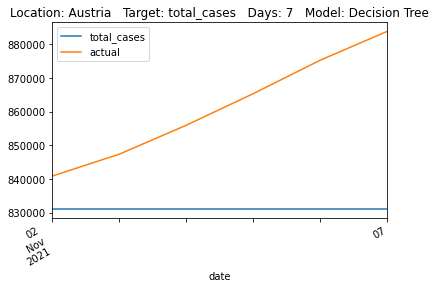

                      MSE          RMSE        R2           MAE       RAE  \
models                                                                      
lstm                 None          None      None          None      None   
dt                   None          None      None          None      None   
rf      1510337299.808015  38863.058292 -5.659576  35704.281667  2.667883   

            RRSE  
models            
lstm        None  
dt          None  
rf      2.580615  


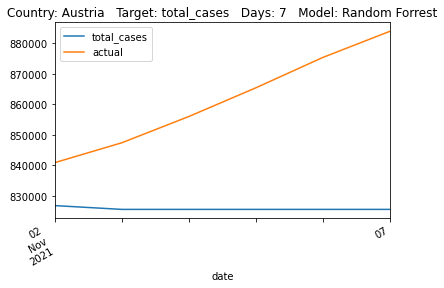

                      MSE          RMSE        R2           MAE       RAE  \
models                                                                      
lstm                 None          None      None          None      None   
dt      5493616722.461538  74118.936328 -3.016773  64233.538462  2.031572   
rf                   None          None      None          None      None   

            RRSE  
models            
lstm        None  
dt      2.004189  
rf          None  


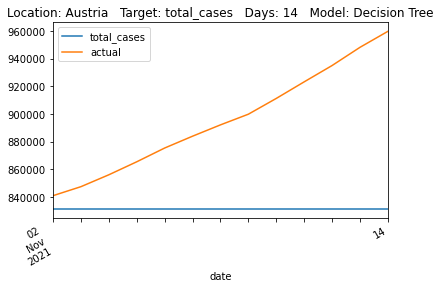

                      MSE          RMSE       R2       MAE       RAE      RRSE
models                                                                        
lstm                 None          None     None      None      None      None
dt                   None          None     None      None      None      None
rf      6026387777.563959  77629.812428 -3.40632  68158.79  2.155719  2.099124


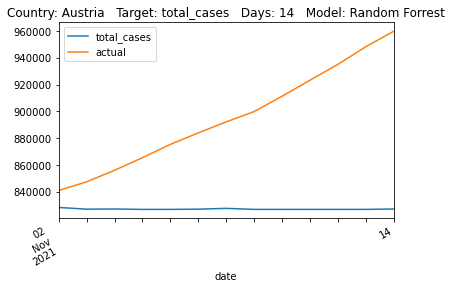

                       MSE           RMSE        R2        MAE      RAE  \
models                                                                    
lstm                  None           None      None       None     None   
dt      15403720573.549999  124111.726173 -2.568041  105292.85  1.85057   
rf                    None           None      None       None     None   

            RRSE  
models            
lstm        None  
dt      1.888926  
rf          None  


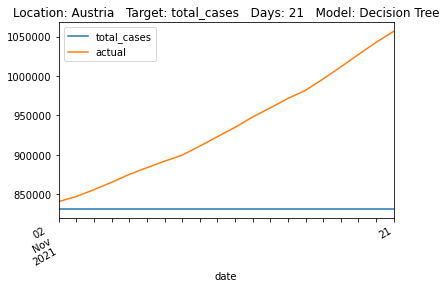

                       MSE           RMSE        R2         MAE       RAE  \
models                                                                      
lstm                  None           None      None        None      None   
dt                    None           None      None        None      None   
rf      16467809103.593067  128326.961717 -2.814521  110162.436  1.936155   

           RRSE  
models           
lstm       None  
dt         None  
rf      1.95308  


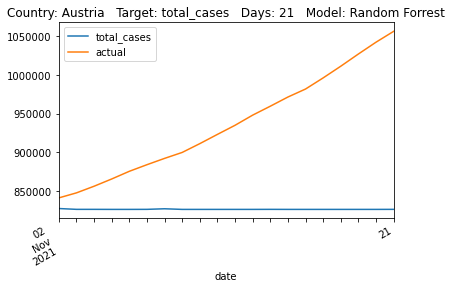

                       MSE           RMSE       R2            MAE       RAE  \
models                                                                        
lstm                  None           None     None           None      None   
dt      36632158154.333336  191395.292926 -3.07748  164911.814815  1.988474   
rf                    None           None     None           None      None   

            RRSE  
models            
lstm        None  
dt      2.019277  
rf          None  


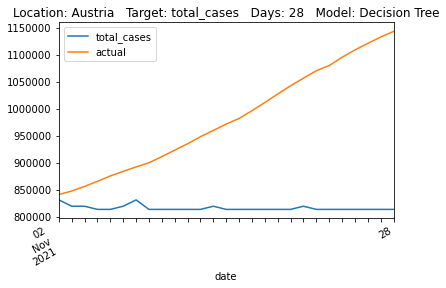

                       MSE           RMSE        R2            MAE       RAE  \
models                                                                         
lstm                  None           None      None           None      None   
dt                    None           None      None           None      None   
rf      32918778117.164238  181435.327644 -2.664148  154635.955926  1.864569   

            RRSE  
models            
lstm        None  
dt          None  
rf      1.914196  


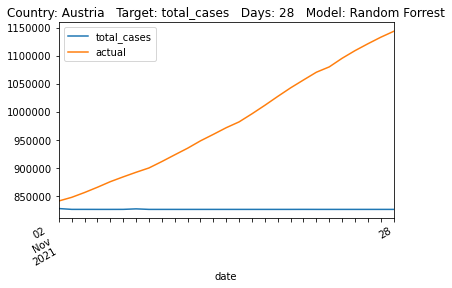

                       MSE           RMSE        R2            MAE       RAE  \
models                                                                         
lstm                  None           None      None           None      None   
dt      40408530201.965515  201018.730973 -2.908766  172913.689655  1.929174   
rf                    None           None      None           None      None   

           RRSE  
models           
lstm       None  
dt      1.97706  
rf         None  


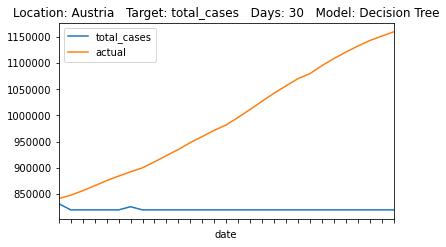

                       MSE           RMSE        R2        MAE       RAE  \
models                                                                     
lstm                  None           None      None       None      None   
dt                    None           None      None       None      None   
rf      38137235616.788925  195287.571588 -2.689061  166666.29  1.859473   

            RRSE  
models            
lstm        None  
dt          None  
rf      1.920693  


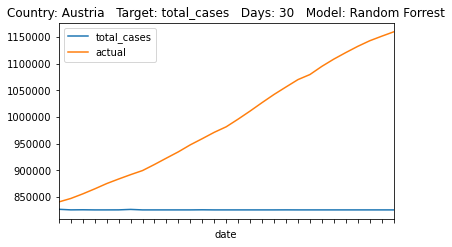

           MSE       RMSE        R2   MAE       RAE     RRSE
models                                                      
lstm      None       None      None  None      None     None
dt      8618.0  92.833184 -3.550158  82.0  2.084746  2.13311
rf        None       None      None  None      None     None


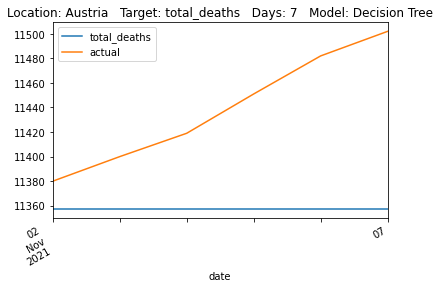

                 MSE       RMSE        R2   MAE       RAE      RRSE
models                                                             
lstm            None       None      None  None      None      None
dt              None       None      None  None      None      None
rf      10867.491233  104.24726 -4.737852  94.1  2.392373  2.395381


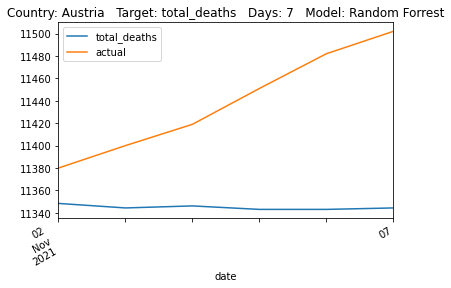

                 MSE        RMSE        R2         MAE       RAE     RRSE
models                                                                   
lstm            None        None      None        None      None     None
dt      41238.307692  203.072174 -2.895412  175.076923  1.977279  1.97368
rf              None        None      None        None      None     None


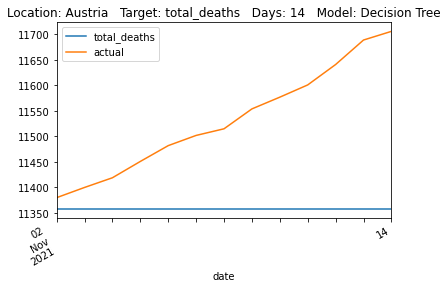

                 MSE        RMSE        R2         MAE       RAE      RRSE
models                                                                    
lstm            None        None      None        None      None      None
dt              None        None      None        None      None      None
rf      45280.032669  212.791054 -3.277198  185.968462  2.100285  2.068139


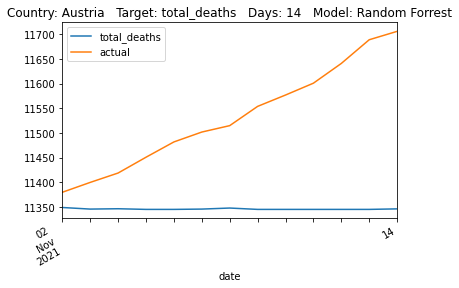

             MSE        RMSE        R2    MAE       RAE      RRSE
models                                                           
lstm        None        None      None   None      None      None
dt      138327.8  371.924455 -2.478492  313.4  1.814708  1.865072
rf          None        None      None   None      None      None


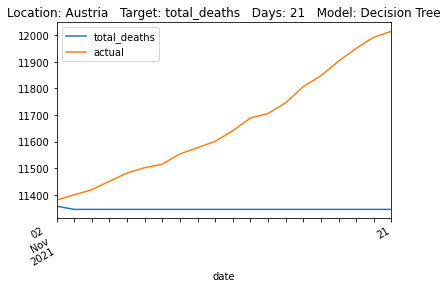

                  MSE        RMSE        R2       MAE       RAE      RRSE
models                                                                   
lstm             None        None      None      None      None      None
dt               None        None      None      None      None      None
rf      138476.496405  372.124302 -2.482231  314.0725  1.818602  1.866074


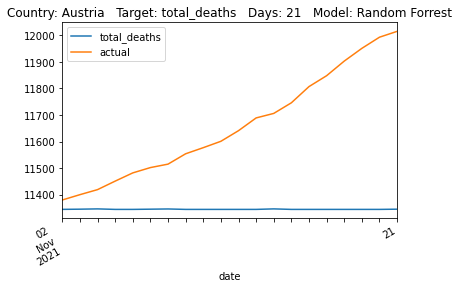

                  MSE        RMSE       R2         MAE       RAE      RRSE
models                                                                    
lstm             None        None     None        None      None      None
dt      296768.333333  544.764475 -2.12713  449.296296  1.673173  1.768369
rf               None        None     None        None      None      None


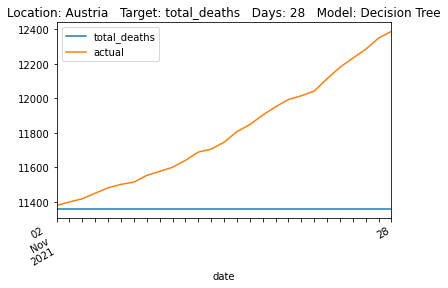

                  MSE        RMSE        R2         MAE       RAE      RRSE
models                                                                     
lstm             None        None      None        None      None      None
dt               None        None      None        None      None      None
rf      310332.813111  557.075231 -2.270063  463.682222  1.726746  1.808332


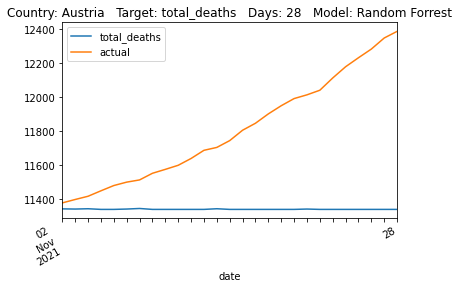

                  MSE        RMSE        R2        MAE       RAE      RRSE
models                                                                    
lstm             None        None      None       None      None      None
dt      384016.896552  619.690969 -2.317746  516.62069  1.741116  1.821468
rf               None        None      None       None      None      None


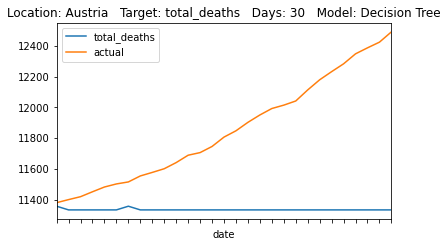

                  MSE        RMSE        R2         MAE      RAE      RRSE
models                                                                    
lstm             None        None      None        None     None      None
dt               None        None      None        None     None      None
rf      374066.037583  611.609383 -2.231774  507.972759  1.71197  1.797714


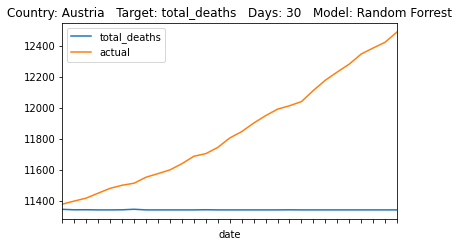

                  MSE           RMSE        R2            MAE       RAE  \
models                                                                    
lstm             None           None      None           None      None   
dt      37739296083.5  194266.044597 -4.789604  173983.166667  2.356995   
rf               None           None      None           None      None   

           RRSE  
models           
lstm       None  
dt      2.40616  
rf         None  


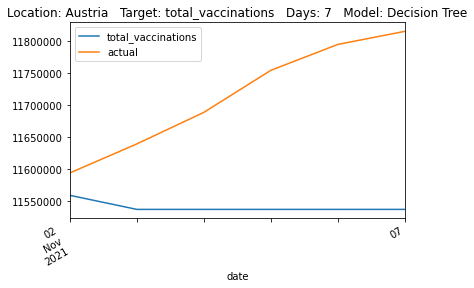

                       MSE           RMSE        R2            MAE       RAE  \
models                                                                         
lstm                  None           None      None           None      None   
dt                    None           None      None           None      None   
rf      36232666021.859283  190348.800947 -4.558471  171382.578333  2.321764   

            RRSE  
models            
lstm        None  
dt          None  
rf      2.357641  


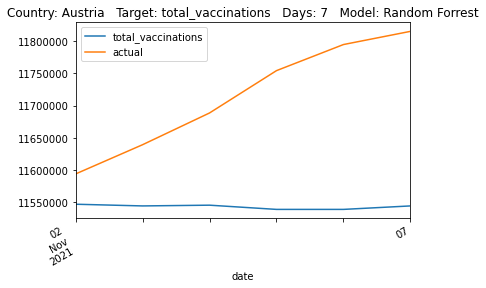

                        MSE           RMSE        R2            MAE       RAE  \
models                                                                          
lstm                   None           None      None           None      None   
dt      181612271236.538452  426159.912752 -2.498848  360147.153846  1.824852   
rf                     None           None      None           None      None   

            RRSE  
models            
lstm        None  
dt      1.870521  
rf          None  


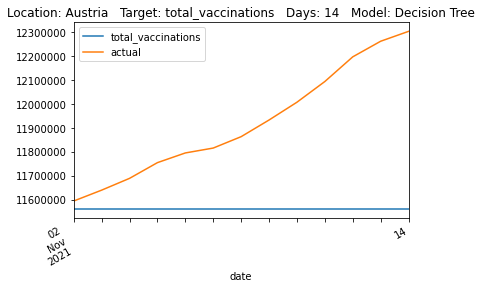

                        MSE           RMSE        R2            MAE     RAE  \
models                                                                        
lstm                   None           None      None           None    None   
dt                     None           None      None           None    None   
rf      191077536353.845673  437124.165831 -2.681201  372550.608462  1.8877   

            RRSE  
models            
lstm        None  
dt          None  
rf      1.918646  


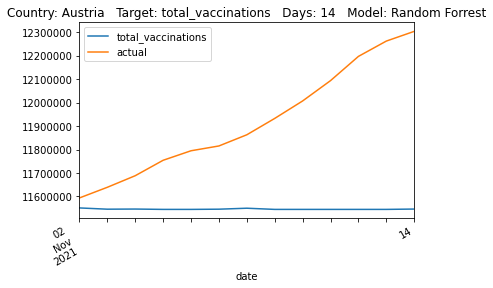

                    MSE           RMSE        R2        MAE       RAE     RRSE
models                                                                        
lstm               None           None      None       None      None     None
dt      642420860200.75  801511.609523 -2.448747  668616.15  1.799627  1.85708
rf                 None           None      None       None      None     None


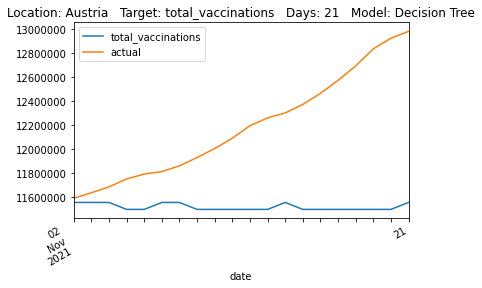

                       MSE           RMSE        R2          MAE       RAE  \
models                                                                       
lstm                  None           None      None         None      None   
dt                    None           None      None         None      None   
rf      599268803029.50415  774124.539741 -2.217091  642199.0575  1.728523   

            RRSE  
models            
lstm        None  
dt          None  
rf      1.793625  


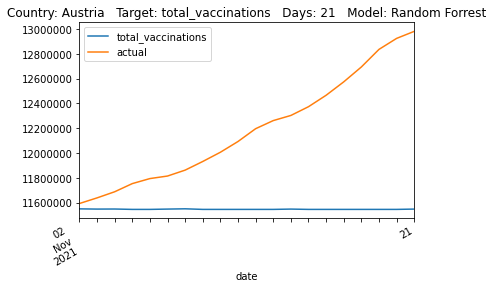

                         MSE            RMSE        R2            MAE  \
models                                                                  
lstm                    None            None      None           None   
dt      1463234050556.148193  1209642.116725 -2.236176  997287.925926   
rf                      None            None      None           None   

             RAE      RRSE  
models                      
lstm        None      None  
dt      1.701463  1.798937  
rf          None      None  


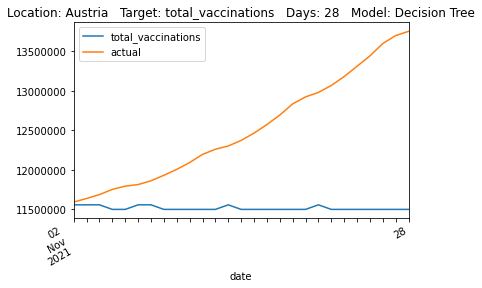

                        MSE            RMSE        R2            MAE  \
models                                                                 
lstm                   None            None      None           None   
dt                     None            None      None           None   
rf      1396278517253.08374  1181642.296659 -2.088093  970935.126667   

             RAE      RRSE  
models                      
lstm        None      None  
dt          None      None  
rf      1.656503  1.757297  


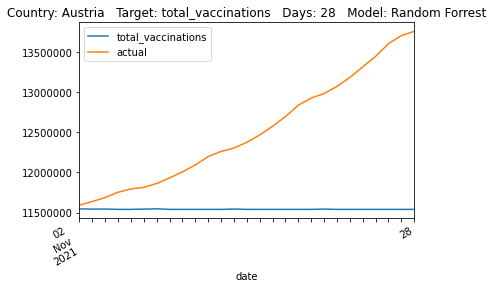

                         MSE            RMSE        R2             MAE  \
models                                                                   
lstm                    None            None      None            None   
dt      1652535353505.827637  1285509.764065 -2.044327  1053295.689655   
rf                      None            None      None            None   

             RAE    RRSE  
models                    
lstm        None    None  
dt      1.629823  1.7448  
rf          None    None  


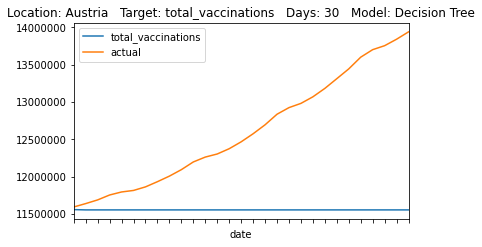

                         MSE            RMSE        R2             MAE  \
models                                                                   
lstm                    None            None      None            None   
dt                      None            None      None            None   
rf      1672287213039.034668  1293169.444829 -2.080714  1062231.893448   

             RAE      RRSE  
models                      
lstm        None      None  
dt          None      None  
rf      1.643651  1.755196  


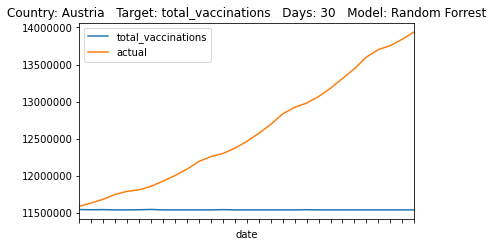

                      MSE          RMSE        R2      MAE       RAE      RRSE
models                                                                        
lstm                 None          None      None     None      None      None
dt      1143896403.333333  33821.537566 -4.693431  30708.0  2.387869  2.386091
rf                   None          None      None     None      None      None


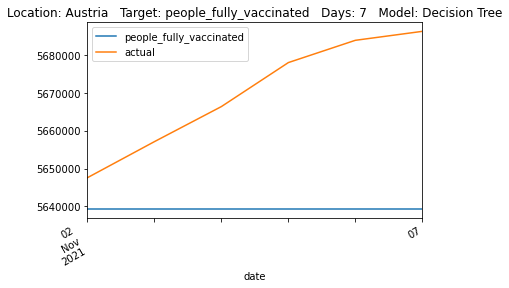

                      MSE          RMSE        R2           MAE       RAE  \
models                                                                      
lstm                 None          None      None          None      None   
dt                   None          None      None          None      None   
rf      1335699776.475498  36547.226659 -5.648079  33479.023333  2.603346   

            RRSE  
models            
lstm        None  
dt          None  
rf      2.578387  


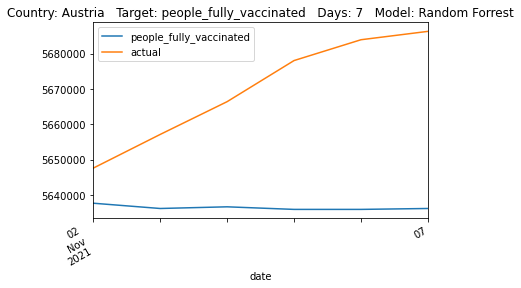

                      MSE          RMSE        R2           MAE    RAE  \
models                                                                   
lstm                 None          None      None          None   None   
dt      6321044013.461538  79504.993639 -4.764097  70669.923077  2.496   
rf                   None          None      None          None   None   

            RRSE  
models            
lstm        None  
dt      2.400853  
rf          None  


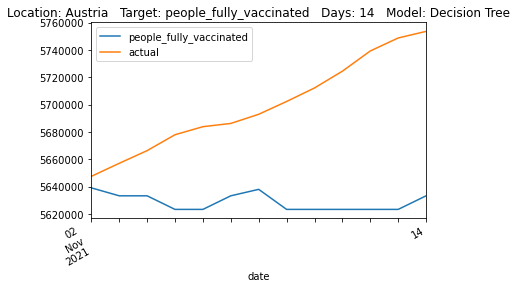

                      MSE          RMSE        R2           MAE       RAE  \
models                                                                      
lstm                 None          None      None          None      None   
dt                   None          None      None          None      None   
rf      5088422602.804651  71333.180238 -3.640082  63117.316923  2.229249   

            RRSE  
models            
lstm        None  
dt          None  
rf      2.154085  


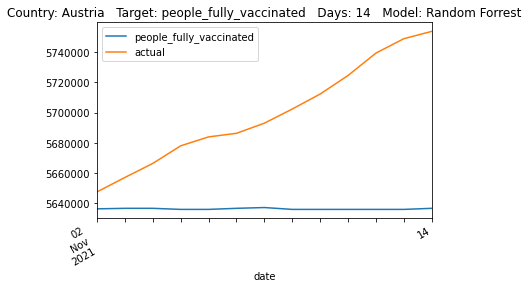

                  MSE           RMSE        R2       MAE       RAE      RRSE
models                                                                      
lstm             None           None      None      None      None      None
dt      15502382854.9  124508.565388 -3.512867  108432.7  2.138491  2.124351
rf               None           None      None      None      None      None


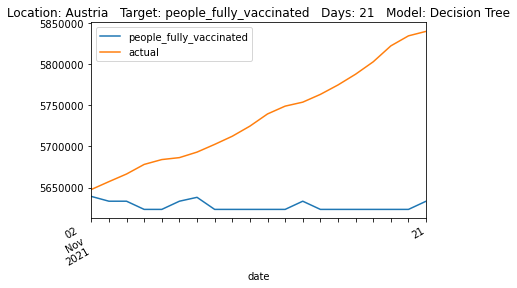

                       MSE           RMSE        R2         MAE       RAE  \
models                                                                      
lstm                  None           None      None        None      None   
dt                    None           None      None        None      None   
rf      13468838202.176132  116055.323886 -2.920886  100039.762  1.972967   

            RRSE  
models            
lstm        None  
dt          None  
rf      1.980123  


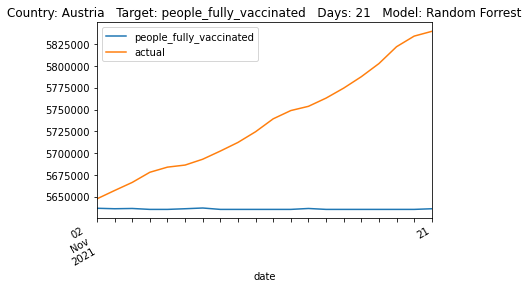

                       MSE           RMSE        R2            MAE       RAE  \
models                                                                         
lstm                  None           None      None           None      None   
dt      30376183613.703705  174287.646188 -3.038649  149102.888889  1.976969   
rf                    None           None      None           None      None   

            RRSE  
models            
lstm        None  
dt      2.009639  
rf          None  


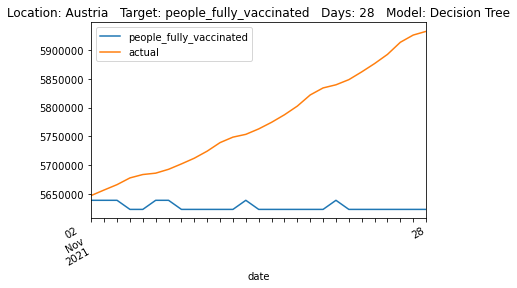

                      MSE           RMSE        R2        MAE       RAE  \
models                                                                    
lstm                 None           None      None       None      None   
dt                   None           None      None       None      None   
rf      27421977729.80064  165595.826426 -2.645874  140968.26  1.869111   

            RRSE  
models            
lstm        None  
dt          None  
rf      1.909417  


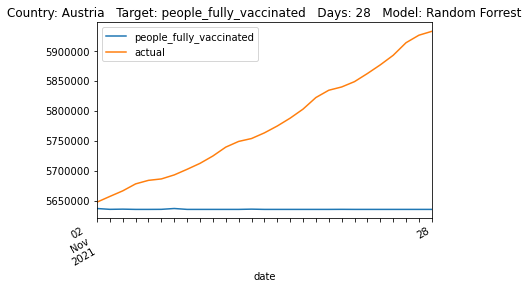

                       MSE           RMSE        R2            MAE       RAE  \
models                                                                         
lstm                  None           None      None           None      None   
dt      31294062519.379311  176901.279021 -2.492915  149448.206897  1.806466   
rf                    None           None      None           None      None   

            RRSE  
models            
lstm        None  
dt      1.868934  
rf          None  


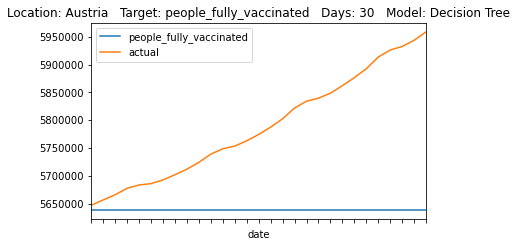

                       MSE           RMSE        R2            MAE       RAE  \
models                                                                         
lstm                  None           None      None           None      None   
dt                    None           None      None           None      None   
rf      32563170174.786537  180452.681262 -2.634568  153502.498621  1.855472   

            RRSE  
models            
lstm        None  
dt          None  
rf      1.906454  


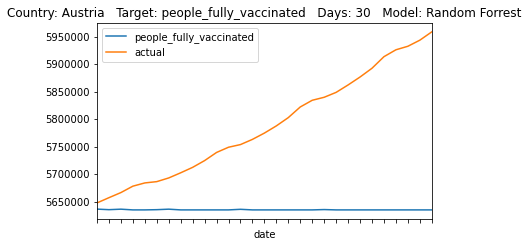

                   MSE         RMSE        R2          MAE      RAE      RRSE
models                                                                       
lstm              None         None      None         None     None      None
dt      8220196.166667  2867.088448 -2.215298  2475.166667  1.75807  1.793125
rf                None         None      None         None     None      None


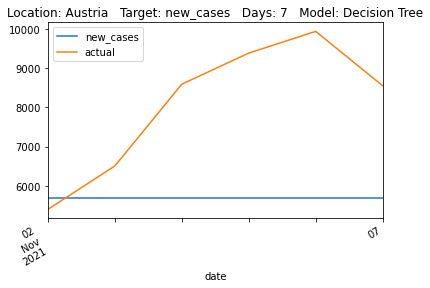

                    MSE         RMSE        R2      MAE       RAE      RRSE
models                                                                     
lstm               None         None      None     None      None      None
dt                 None         None      None     None      None      None
rf      11881318.626633  3446.928869 -3.647331  2853.26  2.026623  2.155767


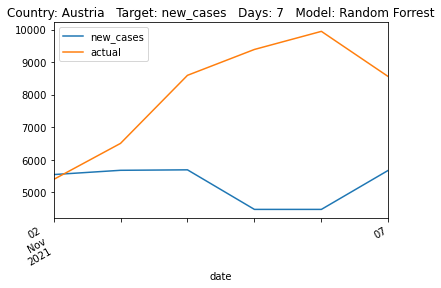

                    MSE         RMSE        R2          MAE       RAE  \
models                                                                  
lstm               None         None      None         None      None   
dt      19958916.769231  4467.540349 -2.980518  3909.846154  2.030047   
rf                 None         None      None         None      None   

            RRSE  
models            
lstm        None  
dt      1.995124  
rf          None  


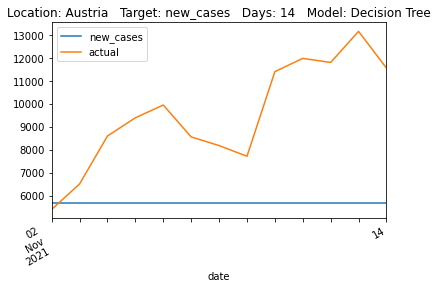

                    MSE         RMSE        R2          MAE       RAE  \
models                                                                  
lstm               None         None      None         None      None   
dt                 None         None      None         None      None   
rf      25279617.025569  5027.883951 -4.041655  4385.021538  2.276765   

            RRSE  
models            
lstm        None  
dt          None  
rf      2.245363  


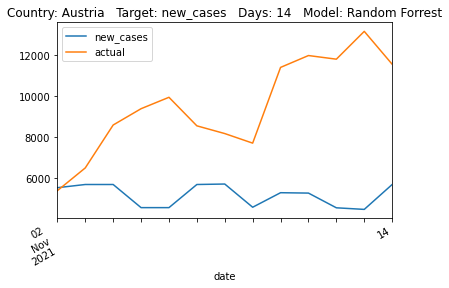

                MSE         RMSE        R2      MAE       RAE      RRSE
models                                                                 
lstm           None         None      None     None      None      None
dt      37520044.35  6125.360753 -3.328785  5400.05  2.171918  2.080573
rf             None         None      None     None      None      None


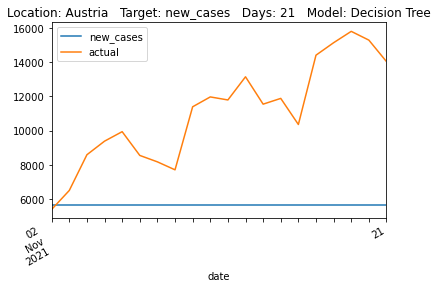

                    MSE         RMSE        R2        MAE      RAE      RRSE
models                                                                      
lstm               None         None      None       None     None      None
dt                 None         None      None       None     None      None
rf      48264864.157805  6947.291858 -4.568443  6121.0095  2.46189  2.359755


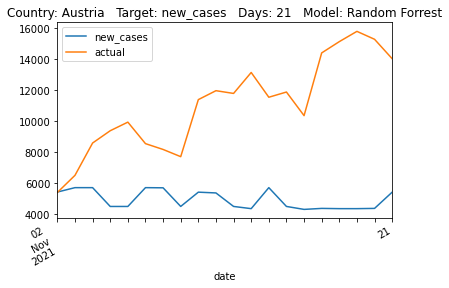

                    MSE         RMSE       R2          MAE      RAE      RRSE
models                                                                       
lstm               None         None     None         None     None      None
dt      40339280.111111  6351.321131 -4.25558  5736.407407  2.51714  2.292505
rf                 None         None     None         None     None      None


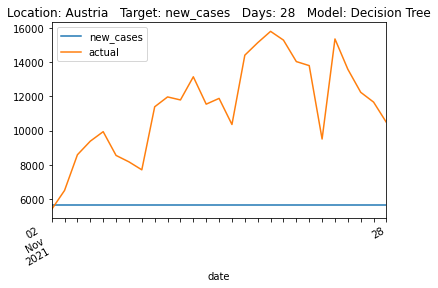

                    MSE         RMSE        R2          MAE       RAE  \
models                                                                  
lstm               None         None      None         None      None   
dt                 None         None      None         None      None   
rf      52191898.095919  7224.396037 -5.799791  6549.407407  2.873885   

            RRSE  
models            
lstm        None  
dt          None  
rf      2.607641  


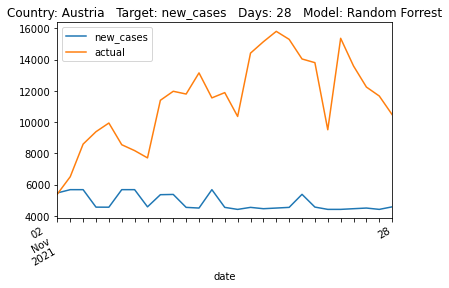

               MSE         RMSE        R2          MAE       RAE      RRSE
models                                                                    
lstm          None         None      None         None      None      None
dt      38051639.0  6168.601057 -3.914444  5525.068966  2.347822  2.216854
rf            None         None      None         None      None      None


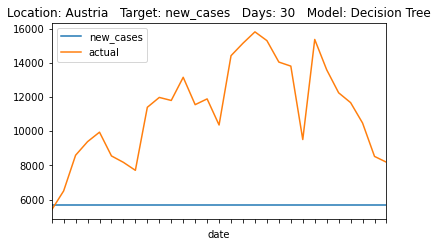

                    MSE         RMSE        R2         MAE       RAE      RRSE
models                                                                        
lstm               None         None      None        None      None      None
dt                 None         None      None        None      None      None
rf      48545524.950169  6967.461873 -5.269749  6287.27069  2.671711  2.503947


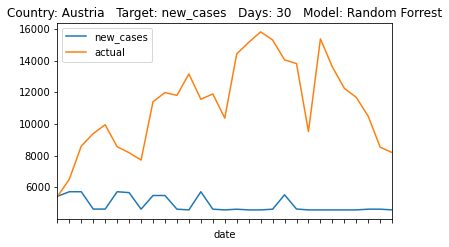

          MSE       RMSE        R2   MAE     RAE      RRSE
models                                                    
lstm     None       None      None  None    None      None
dt      156.5  12.509996 -1.945112  10.5  1.6875  1.716133
rf       None       None      None  None    None      None


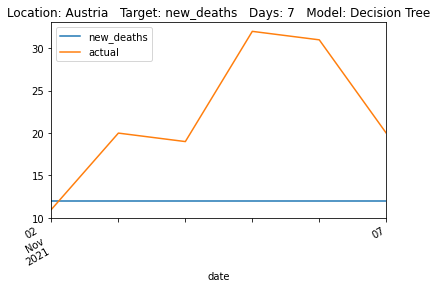

               MSE       RMSE        R2       MAE       RAE      RRSE
models                                                               
lstm          None       None      None      None      None      None
dt            None       None      None      None      None      None
rf      128.794098  11.348749 -1.423726  9.486667  1.524643  1.556832


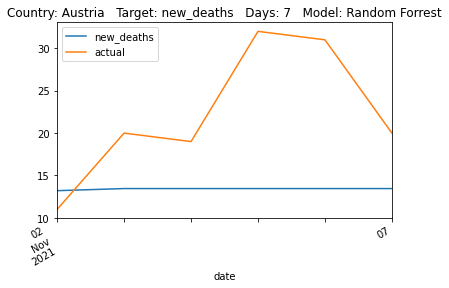

               MSE       RMSE        R2        MAE       RAE      RRSE
models                                                                
lstm          None       None      None       None      None      None
dt      310.692308  17.626466 -1.659121  14.076923  1.515287  1.630681
rf            None       None      None       None      None      None


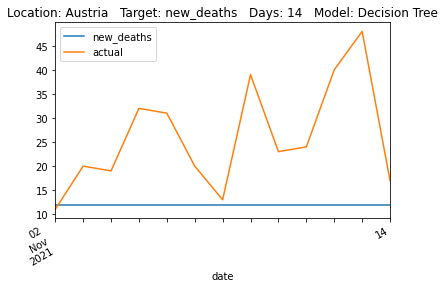

               MSE       RMSE        R2        MAE       RAE      RRSE
models                                                                
lstm          None       None      None       None      None      None
dt            None       None      None       None      None      None
rf      291.967754  17.087064 -1.498863  13.496923  1.452854  1.580779


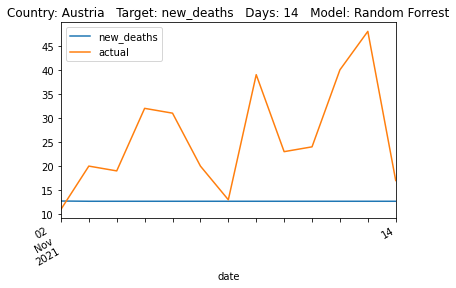

          MSE       RMSE        R2   MAE       RAE      RRSE
models                                                      
lstm     None       None      None  None      None      None
dt      610.5  24.708298 -2.076962  20.4  1.654501  1.754127
rf       None       None      None  None      None      None


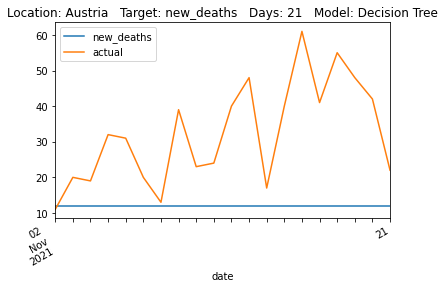

               MSE      RMSE       R2      MAE       RAE      RRSE
models                                                            
lstm          None      None     None     None      None      None
dt            None      None     None     None      None      None
rf      564.698725  23.76339 -1.84612  19.3595  1.570114  1.687045


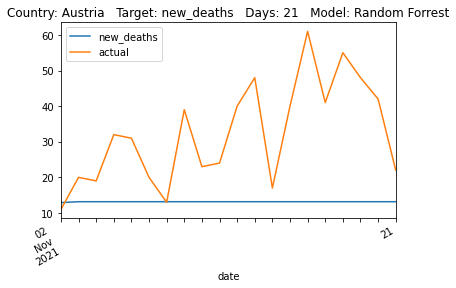

               MSE       RMSE        R2        MAE       RAE      RRSE
models                                                                
lstm          None       None      None       None      None      None
dt      951.518519  30.846694 -2.293218  25.814815  1.797421  1.814722
rf            None       None      None       None      None      None


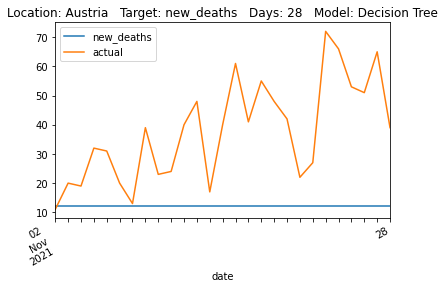

               MSE       RMSE        R2        MAE       RAE      RRSE
models                                                                
lstm          None       None      None       None      None      None
dt            None       None      None       None      None      None
rf      883.296656  29.720307 -2.057101  24.569259  1.710696  1.748457


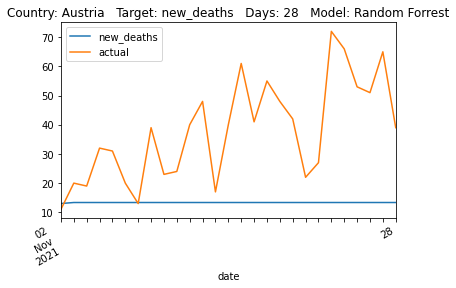

                MSE       RMSE        R2        MAE       RAE    RRSE
models                                                               
lstm           None       None      None       None      None    None
dt      1011.758621  31.808153 -2.399966  26.793103  1.873067  1.8439
rf             None       None      None       None      None    None


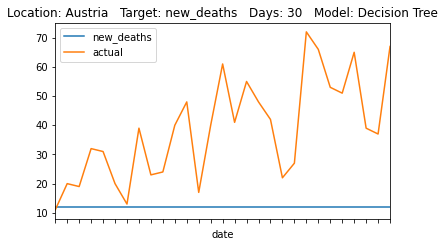

               MSE       RMSE        R2        MAE      RAE      RRSE
models                                                               
lstm          None       None      None       None     None      None
dt            None       None      None       None     None      None
rf      952.086014  30.855891 -2.199439  25.731034  1.79882  1.788697


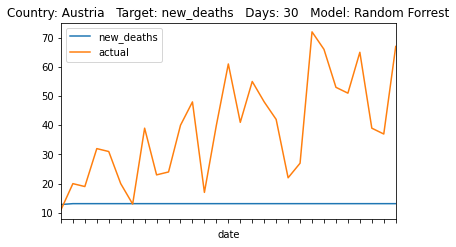

                MSE          RMSE         R2           MAE       RAE     RRSE
models                                                                       
lstm           None          None       None          None      None     None
dt      160990519.0  12688.203931 -11.838679  12170.333333  3.851778  3.58311
rf             None          None       None          None      None     None


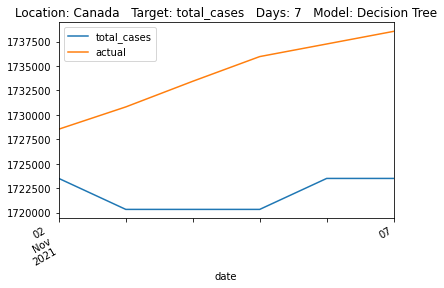

                     MSE          RMSE         R2        MAE       RAE  \
models                                                                   
lstm                None          None       None       None      None   
dt                  None          None       None       None      None   
rf      164046549.777251  12808.065809 -12.082391  12423.195  3.931806   

            RRSE  
models            
lstm        None  
dt          None  
rf      3.616959  


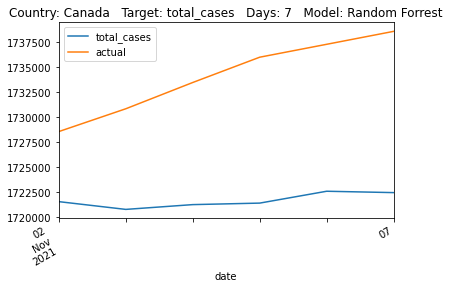

                     MSE          RMSE        R2           MAE       RAE  \
models                                                                     
lstm                None          None      None          None      None   
dt      456752892.230769  21371.777938 -4.523643  19340.692308  2.393643   
rf                  None          None      None          None      None   

            RRSE  
models            
lstm        None  
dt      2.350243  
rf          None  


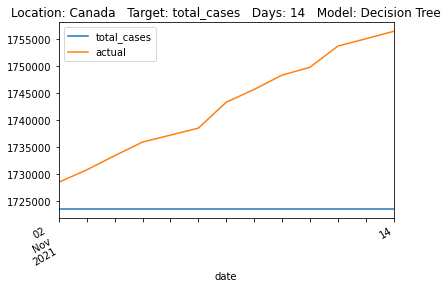

                     MSE          RMSE        R2           MAE       RAE  \
models                                                                     
lstm                None          None      None          None      None   
dt                  None          None      None          None      None   
rf      552035920.798193  23495.444682 -5.675928  21714.605385  2.687443   

            RRSE  
models            
lstm        None  
dt          None  
rf      2.583782  


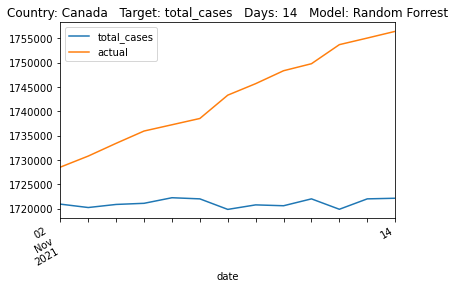

                  MSE          RMSE        R2       MAE       RAE      RRSE
models                                                                     
lstm             None          None      None      None      None      None
dt      1082376684.65  32899.493684 -4.367204  29775.85  2.408143  2.316723
rf               None          None      None      None      None      None


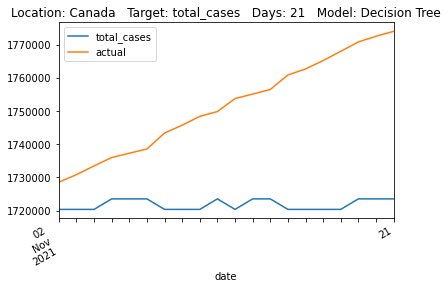

                      MSE          RMSE        R2        MAE       RAE  \
models                                                                   
lstm                 None          None      None       None      None   
dt                   None          None      None       None      None   
rf      1118279322.793029  33440.683647 -4.545235  30322.056  2.452318   

            RRSE  
models            
lstm        None  
dt          None  
rf      2.354832  


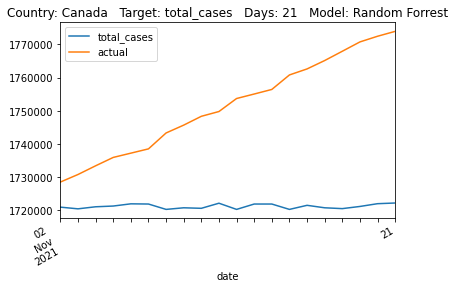

                      MSE         RMSE        R2          MAE       RAE  \
models                                                                    
lstm                 None         None      None         None      None   
dt      1777318333.962963  42158.25345 -3.488631  37166.62963  2.165166   
rf                   None         None      None         None      None   

            RRSE  
models            
lstm        None  
dt      2.118639  
rf          None  


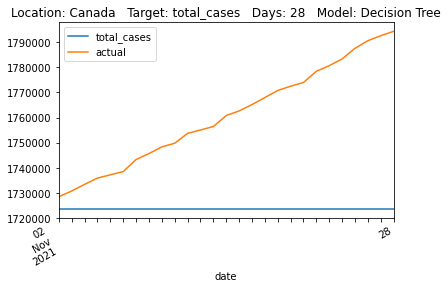

                      MSE          RMSE        R2           MAE       RAE  \
models                                                                      
lstm                 None          None      None          None      None   
dt                   None          None      None          None      None   
rf      1931352579.990182  43947.156677 -3.877646  39215.502593  2.284525   

            RRSE  
models            
lstm        None  
dt          None  
rf      2.208539  


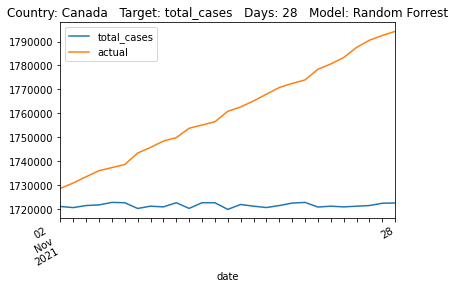

                      MSE          RMSE       R2           MAE       RAE  \
models                                                                     
lstm                 None          None     None          None      None   
dt      2225919495.137931  47179.651282 -3.77151  42137.689655  2.263065   
rf                   None          None     None          None      None   

            RRSE  
models            
lstm        None  
dt      2.184379  
rf          None  


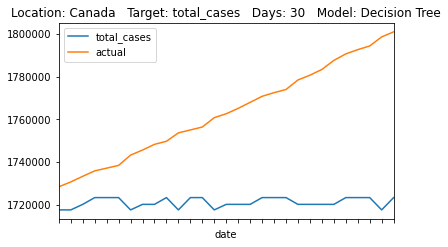

                      MSE          RMSE        R2           MAE       RAE  \
models                                                                      
lstm                 None          None      None          None      None   
dt                   None          None      None          None      None   
rf      2228961575.661965  47211.879603 -3.778031  41999.952414  2.255668   

            RRSE  
models            
lstm        None  
dt          None  
rf      2.185871  


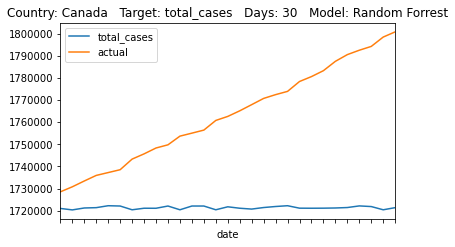

                 MSE       RMSE         R2    MAE       RAE      RRSE
models                                                               
lstm            None       None       None   None      None      None
dt      22285.333333  149.28273 -21.990371  146.0  5.688312  4.794828
rf              None       None       None   None      None      None


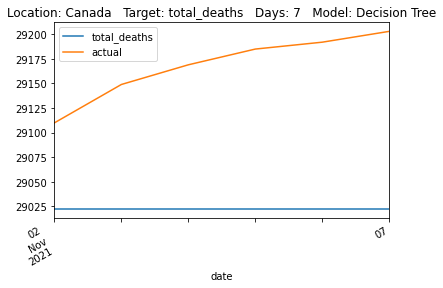

                 MSE        RMSE         R2         MAE       RAE      RRSE
models                                                                     
lstm            None        None       None        None      None      None
dt              None        None       None        None      None      None
rf      27357.359733  165.400604 -27.222861  163.456667  6.368442  5.312519


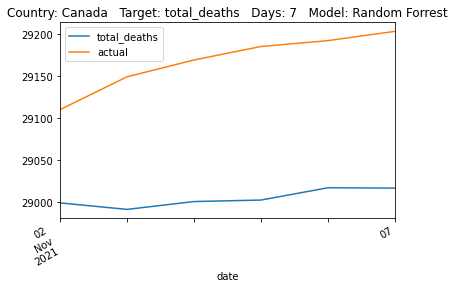

                 MSE        RMSE        R2         MAE       RAE      RRSE
models                                                                    
lstm            None        None      None        None      None      None
dt      67549.307692  259.902497 -7.727541  244.692308  3.138509  2.954241
rf              None        None      None        None      None      None


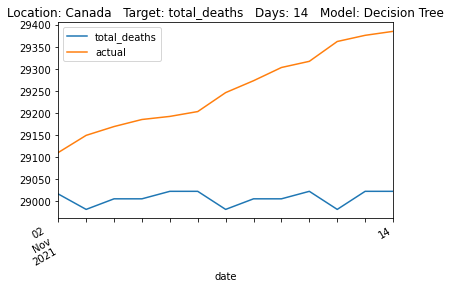

                 MSE        RMSE        R2     MAE     RAE      RRSE
models                                                              
lstm            None        None      None    None    None      None
dt              None        None      None    None    None      None
rf      68455.668169  261.640341 -7.844645  246.36  3.1599  2.973995


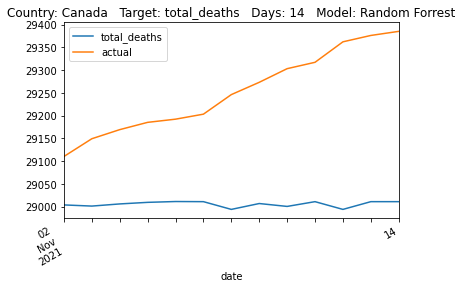

              MSE        RMSE        R2     MAE       RAE      RRSE
models                                                             
lstm         None        None      None    None      None      None
dt      131268.15  362.309467 -5.565853  331.85  2.659054  2.562392
rf           None        None      None    None      None      None


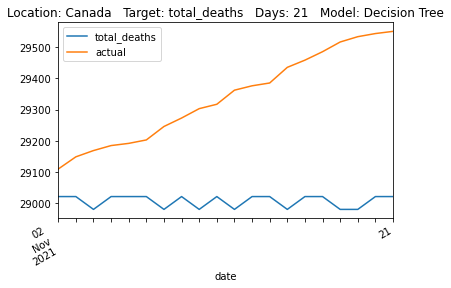

                 MSE        RMSE        R2     MAE       RAE      RRSE
models                                                                
lstm            None        None      None    None      None      None
dt              None        None      None    None      None      None
rf      134579.87174  366.851294 -5.731501  338.71  2.714022  2.594514


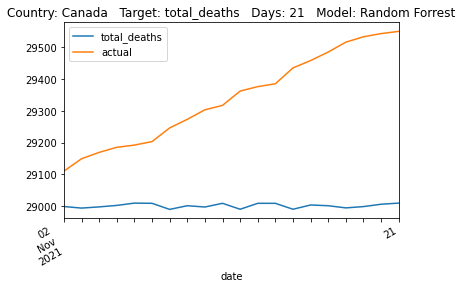

                  MSE        RMSE        R2         MAE      RAE     RRSE
models                                                                   
lstm             None        None      None        None     None     None
dt      197754.407407  444.695859 -4.976703  407.222222  2.52974  2.44473
rf               None        None      None        None     None     None


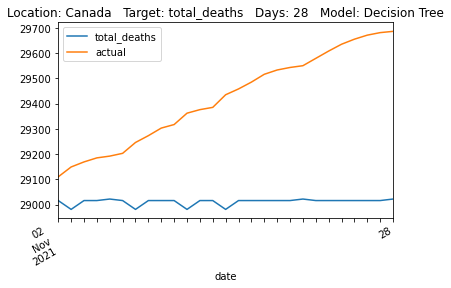

                  MSE        RMSE        R2     MAE       RAE      RRSE
models                                                                 
lstm             None        None      None    None      None      None
dt               None        None      None    None      None      None
rf      203480.525074  451.088157 -5.149763  413.24  2.567124  2.479871


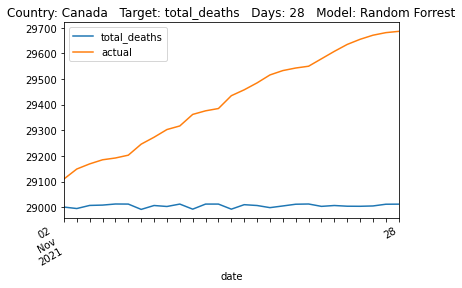

                  MSE        RMSE        R2         MAE       RAE      RRSE
models                                                                     
lstm             None        None      None        None      None      None
dt      228372.482759  477.883336 -5.163425  435.172414  2.567236  2.482625
rf               None        None      None        None      None      None


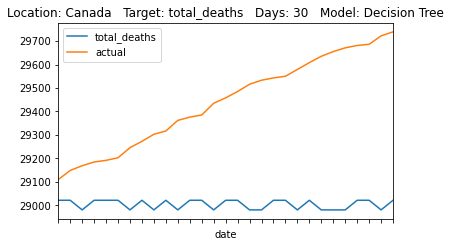

                  MSE        RMSE        R2         MAE       RAE      RRSE
models                                                                     
lstm             None        None      None        None      None      None
dt               None        None      None        None      None      None
rf      226820.342976  476.256594 -5.121535  435.561034  2.569528  2.474174


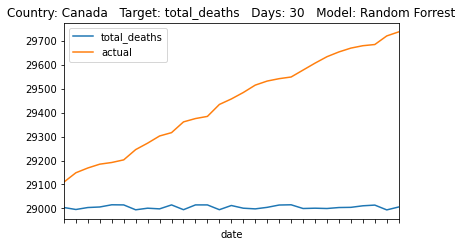

                        MSE           RMSE         R2       MAE       RAE  \
models                                                                      
lstm                   None           None       None      None      None   
dt      129968911037.833328  360512.012335 -12.352947  346221.5  3.973513   
rf                     None           None       None      None      None   

            RRSE  
models            
lstm        None  
dt      3.654168  
rf          None  


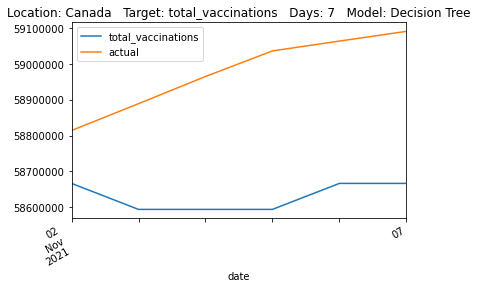

                        MSE           RMSE         R2        MAE      RAE  \
models                                                                      
lstm                   None           None       None       None     None   
dt                     None           None       None       None     None   
rf      141589332098.017975  376283.579363 -13.546824  367748.09  4.22057   

           RRSE  
models           
lstm       None  
dt         None  
rf      3.81403  


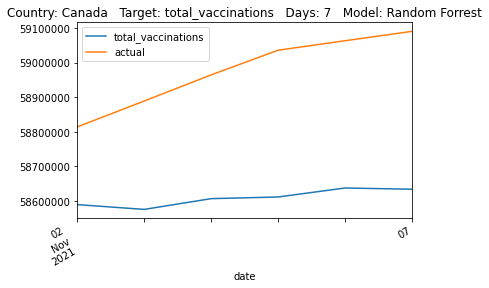

                        MSE           RMSE        R2            MAE       RAE  \
models                                                                          
lstm                   None           None      None           None      None   
dt      337235307920.615356  580719.646577 -5.176921  531638.307692  2.582232   
rf                     None           None      None           None      None   

            RRSE  
models            
lstm        None  
dt      2.485341  
rf          None  


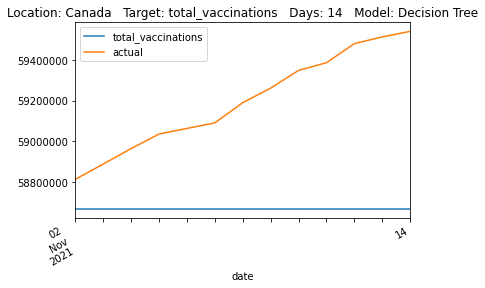

                        MSE           RMSE       R2            MAE       RAE  \
models                                                                         
lstm                   None           None     None           None      None   
dt                     None           None     None           None      None   
rf      403044727980.842407  634858.037659 -6.38231  590787.963077  2.869529   

            RRSE  
models            
lstm        None  
dt          None  
rf      2.717041  


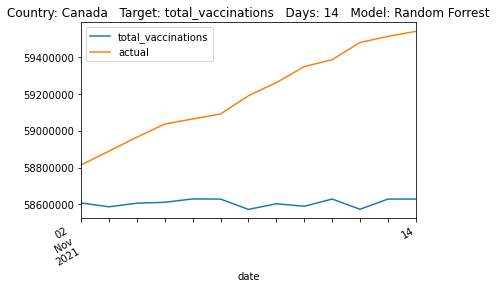

                        MSE           RMSE        R2       MAE       RAE  \
models                                                                     
lstm                   None           None      None      None      None   
dt      773717765967.099976  879612.281615 -4.916872  803566.9  2.556766   
rf                     None           None      None      None      None   

            RRSE  
models            
lstm        None  
dt      2.432462  
rf          None  


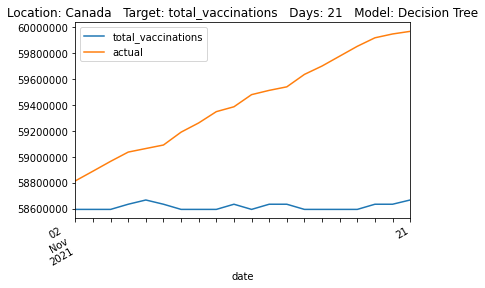

                        MSE           RMSE        R2         MAE       RAE  \
models                                                                       
lstm                   None           None      None        None      None   
dt                     None           None      None        None      None   
rf      792341751743.764893  890135.805225 -5.059296  813989.049  2.589927   

            RRSE  
models            
lstm        None  
dt          None  
rf      2.461564  


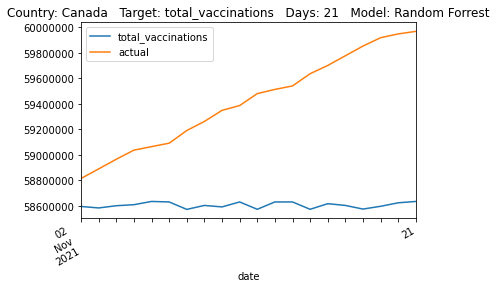

                         MSE            RMSE        R2           MAE  \
models                                                                 
lstm                    None            None      None          None   
dt      1160003161778.703613  1077034.429245 -4.045212  964407.37037   
rf                      None            None      None          None   

             RAE      RRSE  
models                      
lstm        None      None  
dt      2.314167  2.246155  
rf          None      None  


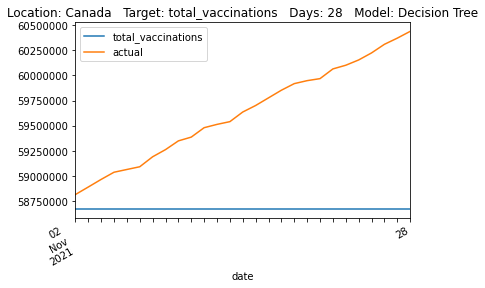

                         MSE            RMSE        R2             MAE  \
models                                                                   
lstm                    None            None      None            None   
dt                      None            None      None            None   
rf      1300444972865.863037  1140370.541914 -4.656037  1034534.481481   

             RAE      RRSE  
models                      
lstm        None      None  
dt          None      None  
rf      2.482442  2.378242  


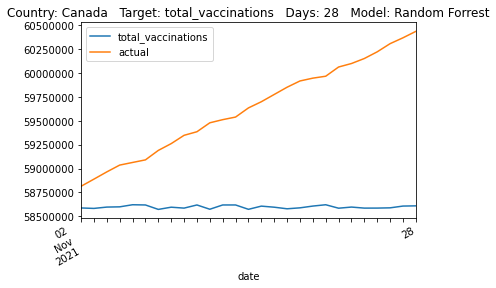

                         MSE            RMSE        R2             MAE  \
models                                                                   
lstm                    None            None      None            None   
dt      1449610955392.241455  1203997.905061 -4.183399  1079041.689655   
rf                      None            None      None            None   

             RAE      RRSE  
models                      
lstm        None      None  
dt      2.372133  2.276708  
rf          None      None  


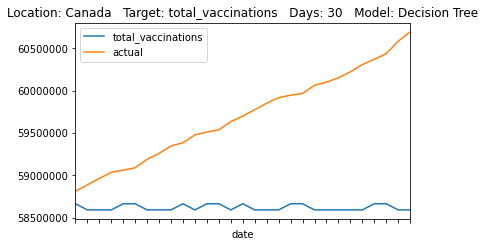

                         MSE            RMSE        R2             MAE  \
models                                                                   
lstm                    None            None      None            None   
dt                      None            None      None            None   
rf      1460669512251.315918  1208581.611746 -4.222941  1087105.077931   

            RAE      RRSE  
models                     
lstm       None      None  
dt         None      None  
rf      2.38986  2.285376  


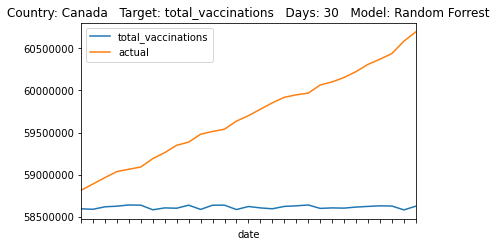

                       MSE           RMSE         R2            MAE       RAE  \
models                                                                          
lstm                  None           None       None           None      None   
dt      37268340607.833336  193050.098699 -16.346437  192185.833333  4.694578   
rf                    None           None       None           None      None   

            RRSE  
models            
lstm        None  
dt      4.164905  
rf          None  


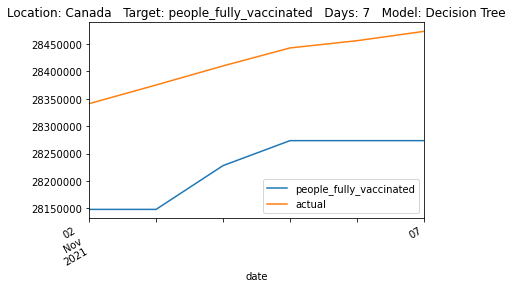

                       MSE           RMSE         R2            MAE       RAE  \
models                                                                          
lstm                  None           None       None           None      None   
dt                    None           None       None           None      None   
rf      31321744405.644131  176979.502784 -13.578611  173578.131667  4.240042   

            RRSE  
models            
lstm        None  
dt          None  
rf      3.818195  


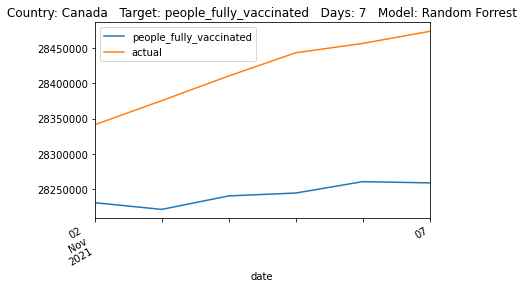

                       MSE           RMSE        R2            MAE       RAE  \
models                                                                         
lstm                  None           None      None           None      None   
dt      81340839792.692307  285203.155299 -6.526533  265933.307692  2.920838   
rf                    None           None      None           None      None   

            RRSE  
models            
lstm        None  
dt      2.743453  
rf          None  


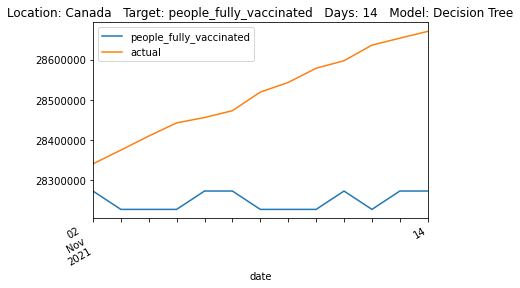

                       MSE           RMSE        R2            MAE       RAE  \
models                                                                         
lstm                  None           None      None           None      None   
dt                    None           None      None           None      None   
rf      84581087142.671127  290828.277756 -6.826356  272485.708462  2.992805   

            RRSE  
models            
lstm        None  
dt          None  
rf      2.797563  


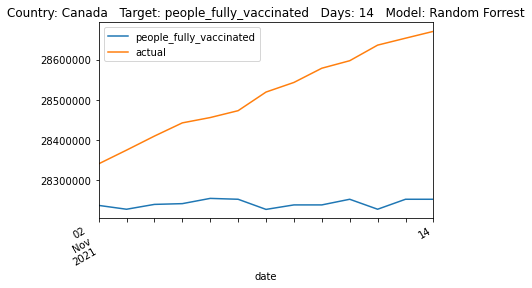

                        MSE           RMSE        R2        MAE       RAE  \
models                                                                      
lstm                   None           None      None       None      None   
dt      160623582500.450012  400778.720119 -5.500639  371462.55  2.721899   
rf                     None           None      None       None      None   

            RRSE  
models            
lstm        None  
dt      2.549635  
rf          None  


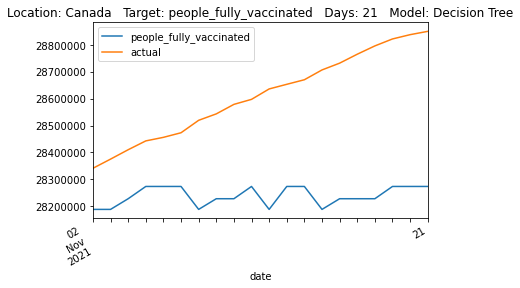

                        MSE           RMSE        R2         MAE       RAE  \
models                                                                       
lstm                   None           None      None        None      None   
dt                     None           None      None        None      None   
rf      160802142758.773987  401001.424884 -5.507865  369362.552  2.706511   

            RRSE  
models            
lstm        None  
dt          None  
rf      2.551052  


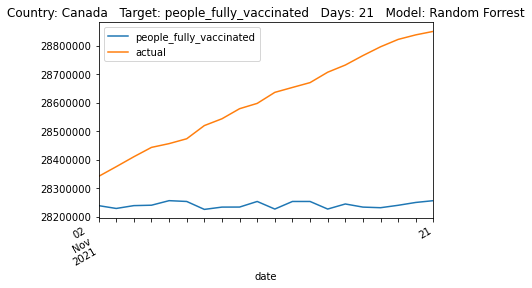

                        MSE           RMSE        R2            MAE       RAE  \
models                                                                          
lstm                   None           None      None           None      None   
dt      216455333155.851837  465247.604138 -4.535007  421127.925926  2.433086   
rf                     None           None      None           None      None   

           RRSE  
models           
lstm       None  
dt      2.35266  
rf         None  


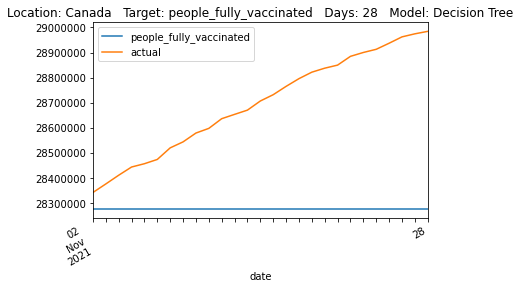

                        MSE           RMSE        R2            MAE       RAE  \
models                                                                          
lstm                   None           None      None           None      None   
dt                     None           None      None           None      None   
rf      241714738361.644135  491644.931187 -5.180919  450579.491481  2.603244   

            RRSE  
models            
lstm        None  
dt          None  
rf      2.486145  


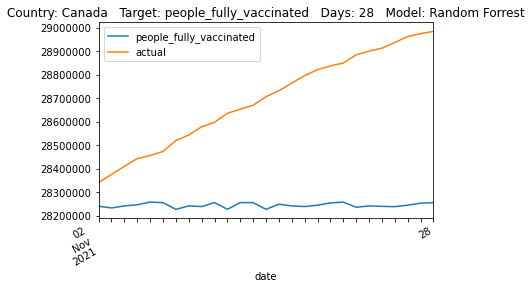

                        MSE           RMSE        R2           MAE       RAE  \
models                                                                         
lstm                   None           None      None          None      None   
dt      252427981705.275848  502422.115064 -4.867335  460885.62069  2.536425   
rf                     None           None      None          None      None   

            RRSE  
models            
lstm        None  
dt      2.422258  
rf          None  


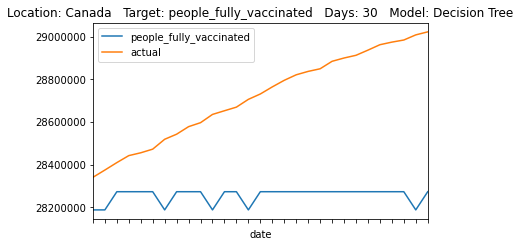

                        MSE           RMSE        R2        MAE       RAE  \
models                                                                      
lstm                   None           None      None       None      None   
dt                     None           None      None       None      None   
rf      268423973972.449097  518096.490986 -5.239139  474691.16  2.612402   

            RRSE  
models            
lstm        None  
dt          None  
rf      2.497827  


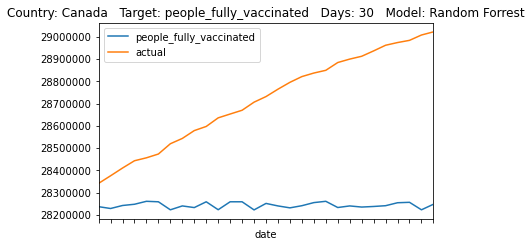

                 MSE        RMSE        R2         MAE       RAE     RRSE
models                                                                   
lstm            None        None      None        None      None     None
dt      45866.541667  214.164754  0.845087  167.416667  0.331409  0.39359
rf              None        None      None        None      None     None


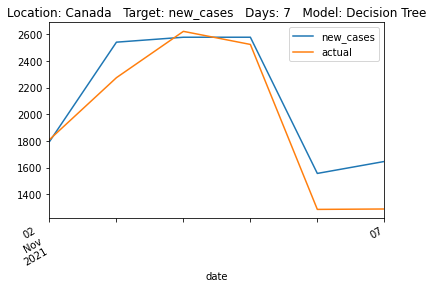

                  MSE        RMSE        R2         MAE       RAE      RRSE
models                                                                     
lstm             None        None      None        None      None      None
dt               None        None      None        None      None      None
rf      105581.327033  324.932804  0.643402  292.139123  0.578302  0.597158


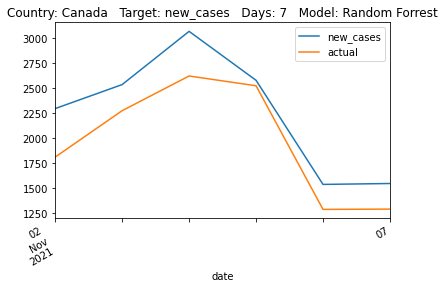

                  MSE        RMSE       R2         MAE       RAE     RRSE
models                                                                   
lstm             None        None     None        None      None     None
dt      556020.096154  745.667551  0.48026  427.115385  0.537296  0.72093
rf               None        None     None        None      None     None


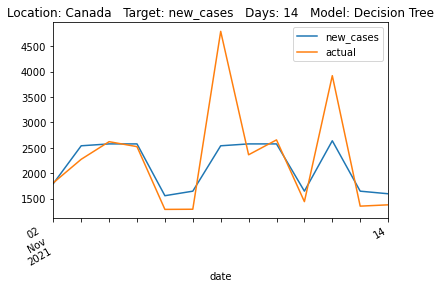

                  MSE        RMSE        R2         MAE       RAE     RRSE
models                                                                    
lstm             None        None      None        None      None     None
dt               None        None      None        None      None     None
rf      442819.189411  665.446609  0.586075  461.883958  0.581034  0.64337


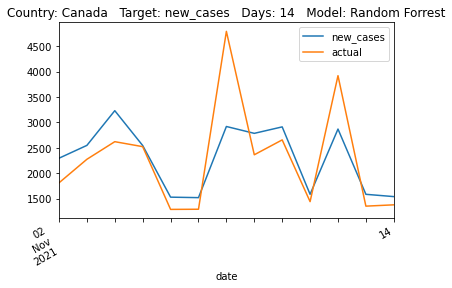

               MSE        RMSE        R2    MAE       RAE      RRSE
models                                                             
lstm          None        None      None   None      None      None
dt      612010.425  782.310952  0.386332  501.2  0.644423  0.783369
rf            None        None      None   None      None      None


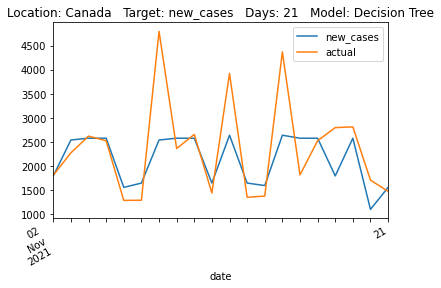

                 MSE        RMSE        R2         MAE       RAE     RRSE
models                                                                   
lstm            None        None      None        None      None     None
dt              None        None      None        None      None     None
rf      408149.00738  638.865406  0.590746  434.211809  0.558292  0.63973


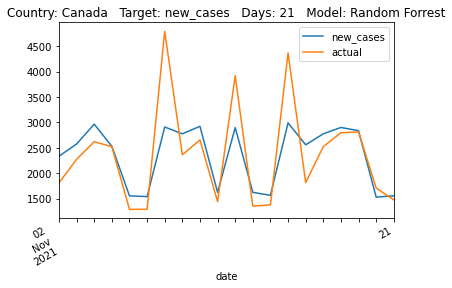

                  MSE        RMSE        R2         MAE       RAE      RRSE
models                                                                     
lstm             None        None      None        None      None      None
dt      698122.611111  835.537319  0.336517  568.740741  0.704533  0.814545
rf               None        None      None        None      None      None


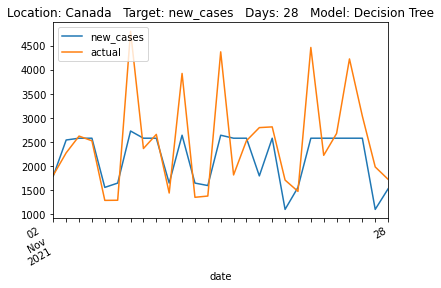

                  MSE        RMSE        R2         MAE      RAE      RRSE
models                                                                    
lstm             None        None      None        None     None      None
dt               None        None      None        None     None      None
rf      493757.845131  702.679048  0.530741  487.293835  0.60364  0.685024


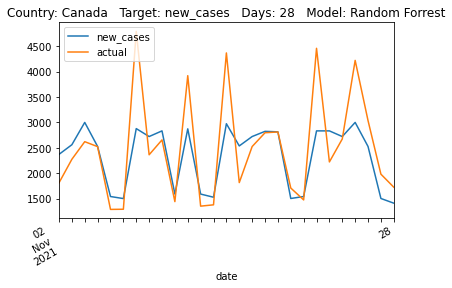

                  MSE        RMSE        R2        MAE       RAE      RRSE
models                                                                    
lstm             None        None      None       None      None      None
dt      883578.189655  939.988399  0.182105  627.62069  0.763052  0.904376
rf               None        None      None       None      None      None


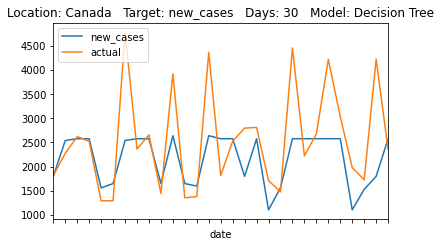

                  MSE        RMSE        R2         MAE       RAE      RRSE
models                                                                     
lstm             None        None      None        None      None      None
dt               None        None      None        None      None      None
rf      591890.104607  769.343944  0.452109  532.647365  0.647585  0.740196


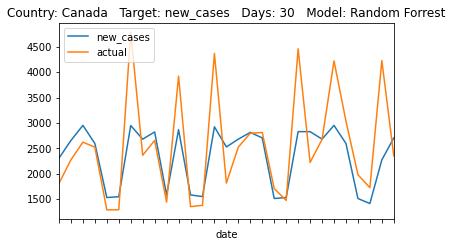

         MSE      RMSE        R2       MAE       RAE      RRSE
models                                                        
lstm    None      None      None      None      None      None
dt      19.0  4.358899  0.855696  3.666667  0.366667  0.379873
rf      None      None      None      None      None      None


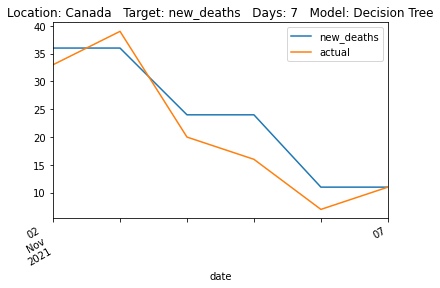

               MSE       RMSE        R2       MAE       RAE      RRSE
models                                                               
lstm          None       None      None      None      None      None
dt            None       None      None      None      None      None
rf      110.078384  10.491825  0.163962  9.291944  0.929194  0.914351


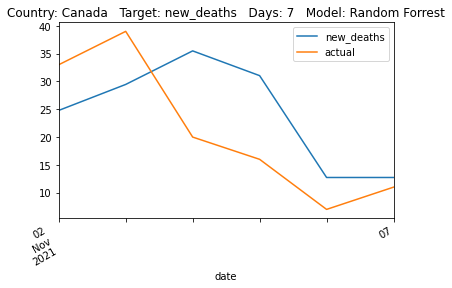

         MSE      RMSE        R2       MAE       RAE      RRSE
models                                                        
lstm    None      None      None      None      None      None
dt      75.0  8.660254  0.538957  5.923077  0.514388  0.679002
rf      None      None      None      None      None      None


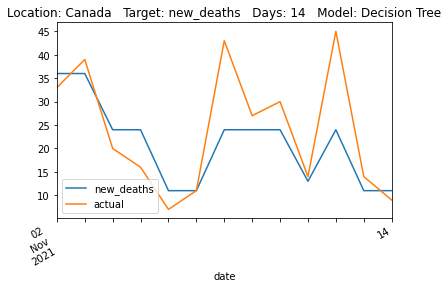

              MSE      RMSE        R2       MAE       RAE      RRSE
models                                                             
lstm         None      None      None      None      None      None
dt           None      None      None      None      None      None
rf      82.969343  9.108751  0.489967  7.158189  0.621652  0.714166


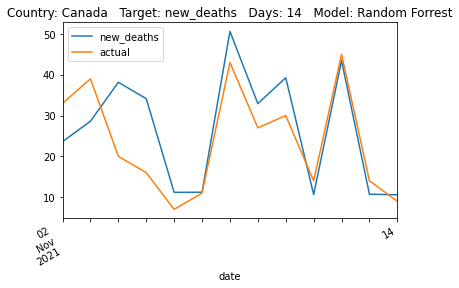

           MSE       RMSE        R2   MAE       RAE      RRSE
models                                                       
lstm      None       None      None  None      None      None
dt      131.95  11.486949  0.219819  8.25  0.735622  0.883278
rf        None       None      None  None      None      None


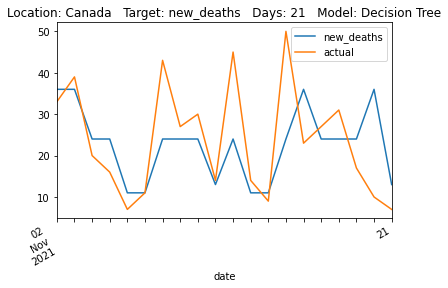

              MSE      RMSE        R2       MAE       RAE      RRSE
models                                                             
lstm         None      None      None      None      None      None
dt           None      None      None      None      None      None
rf      63.306548  7.956541  0.625687  6.213083  0.553998  0.611811


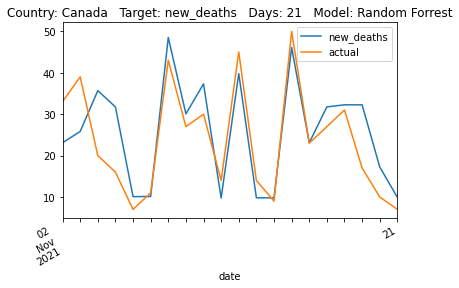

               MSE       RMSE        R2       MAE     RAE      RRSE
models                                                             
lstm          None       None      None      None    None      None
dt      164.407407  12.822145 -0.102948  9.222222  0.8907  1.050214
rf            None       None      None      None    None      None


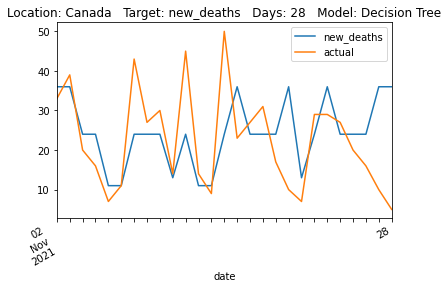

              MSE      RMSE        R2      MAE       RAE      RRSE
models                                                            
lstm         None      None      None     None      None      None
dt           None      None      None     None      None      None
rf      91.689858  9.575482  0.384887  7.87502  0.760584  0.784292


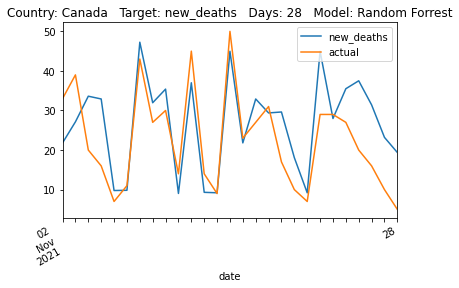

               MSE       RMSE        R2       MAE       RAE      RRSE
models                                                               
lstm          None       None      None      None      None      None
dt      159.724138  12.638202 -0.093965  9.241379  0.896838  1.045928
rf            None       None      None      None      None      None


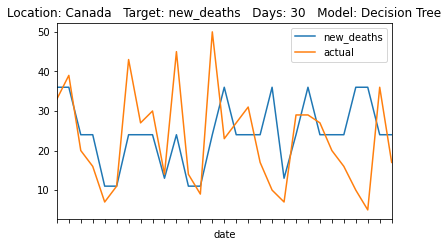

               MSE       RMSE        R2       MAE       RAE      RRSE
models                                                               
lstm          None       None      None      None      None      None
dt            None       None      None      None      None      None
rf      129.028653  11.359078  0.116271  9.076358  0.880824  0.940069


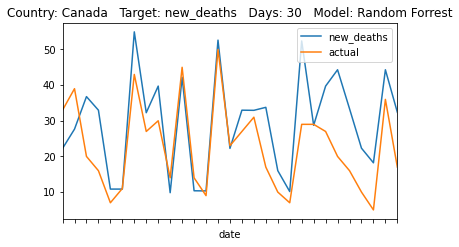

                     MSE          RMSE        R2      MAE       RAE      RRSE
models                                                                       
lstm                None          None      None     None      None      None
dt      626003057.833333  25020.053114 -7.489699  23496.5  3.117073  2.913709
rf                  None          None      None     None      None      None


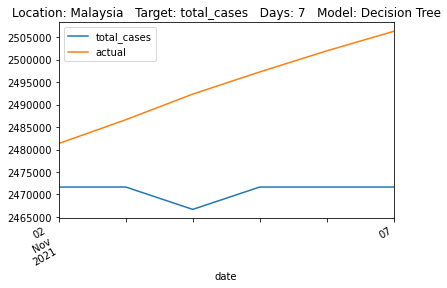

                     MSE          RMSE         R2           MAE       RAE  \
models                                                                      
lstm                None          None       None          None      None   
dt                  None          None       None          None      None   
rf      835619522.258319  28907.084292 -10.332466  27786.111667  3.686138   

            RRSE  
models            
lstm        None  
dt          None  
rf      3.366373  


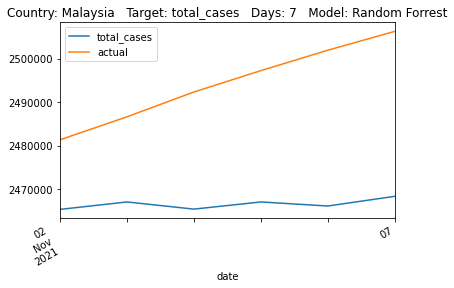

                      MSE        RMSE        R2           MAE       RAE  \
models                                                                    
lstm                 None        None      None          None      None   
dt      2683138939.153846  51799.0245 -5.579036  45944.692308  2.625361   
rf                   None        None      None          None      None   

            RRSE  
models            
lstm        None  
dt      2.564963  
rf          None  


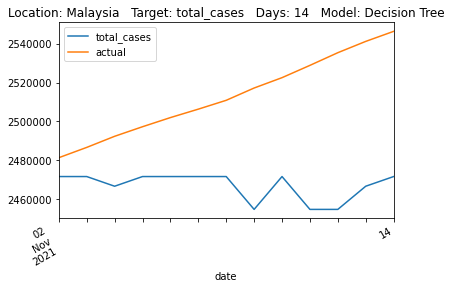

                      MSE          RMSE        R2           MAE       RAE  \
models                                                                      
lstm                 None          None      None          None      None   
dt                   None          None      None          None      None   
rf      2678953320.548353  51758.606246 -5.568773  47491.918462  2.713773   

            RRSE  
models            
lstm        None  
dt          None  
rf      2.562962  


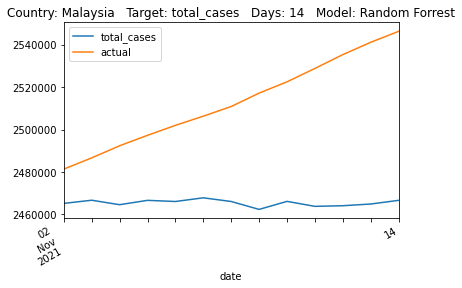

                 MSE         RMSE        R2      MAE       RAE      RRSE
models                                                                  
lstm            None         None      None     None      None      None
dt      5274275169.3  72624.20512 -4.075666  65251.6  2.318668  2.252924
rf              None         None      None     None      None      None


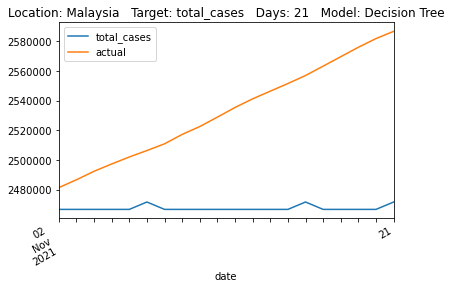

                      MSE          RMSE        R2        MAE      RAE  \
models                                                                  
lstm                 None          None      None       None     None   
dt                   None          None      None       None     None   
rf      5515335818.576546  74265.306965 -4.307649  66803.413  2.37381   

            RRSE  
models            
lstm        None  
dt          None  
rf      2.303834  


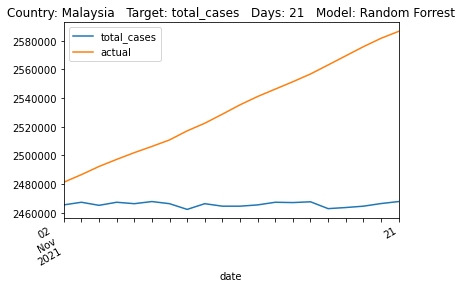

                      MSE          RMSE        R2           MAE       RAE  \
models                                                                      
lstm                 None          None      None          None      None   
dt      8978958581.444445  94757.366898 -3.724828  84507.666667  2.226327   
rf                   None          None      None          None      None   

            RRSE  
models            
lstm        None  
dt      2.173667  
rf          None  


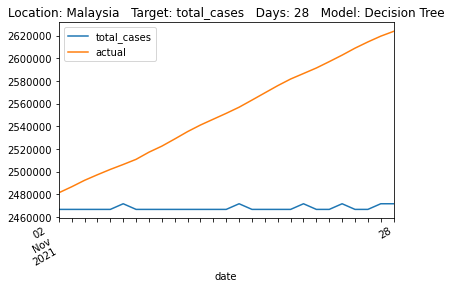

                      MSE          RMSE        R2           MAE       RAE  \
models                                                                      
lstm                 None          None      None          None      None   
dt                   None          None      None          None      None   
rf      9606939124.888836  98014.994388 -4.055278  87956.051852  2.317173   

            RRSE  
models            
lstm        None  
dt          None  
rf      2.248395  


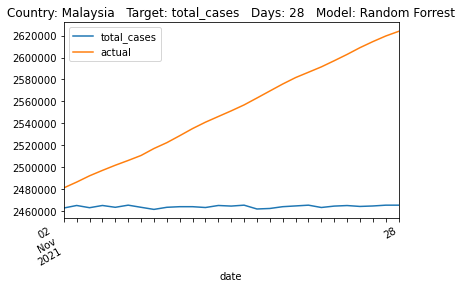

                      MSE          RMSE        R2           MAE       RAE  \
models                                                                      
lstm                 None          None      None          None      None   
dt      9560288759.758621  97776.729132 -3.423945  86018.931034  2.119028   
rf                   None          None      None          None      None   

            RRSE  
models            
lstm        None  
dt      2.103318  
rf          None  


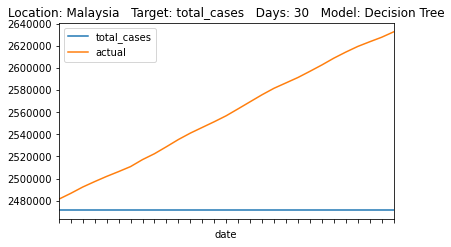

                      MSE          RMSE        R2           MAE       RAE  \
models                                                                      
lstm                 None          None      None          None      None   
dt                   None          None      None          None      None   
rf      10943397636.08707  104610.69561 -4.063968  93846.160345  2.311847   

            RRSE  
models            
lstm        None  
dt          None  
rf      2.250326  


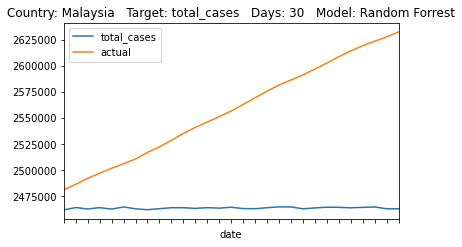

                 MSE        RMSE       R2         MAE       RAE      RRSE
models                                                                   
lstm            None        None     None        None      None      None
dt      75809.333333  275.334948 -9.08878  261.333333  3.423581  3.176284
rf              None        None     None        None      None      None


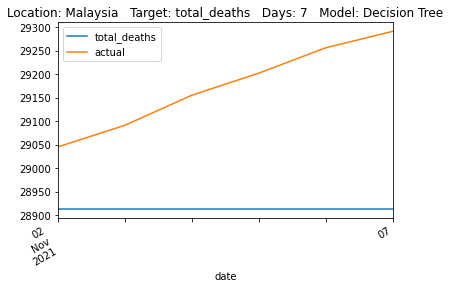

                 MSE        RMSE         R2         MAE       RAE      RRSE
models                                                                     
lstm            None        None       None        None      None      None
dt              None        None       None        None      None      None
rf      93410.851767  305.631889 -11.431207  293.886667  3.850044  3.525792


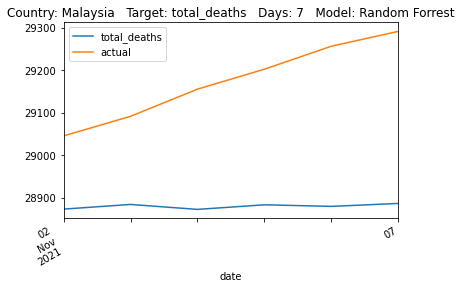

                  MSE        RMSE      R2         MAE       RAE      RRSE
models                                                                   
lstm             None        None    None        None      None      None
dt      283800.615385  532.729402 -6.0262  494.153846  2.786892  2.650698
rf               None        None    None        None      None      None


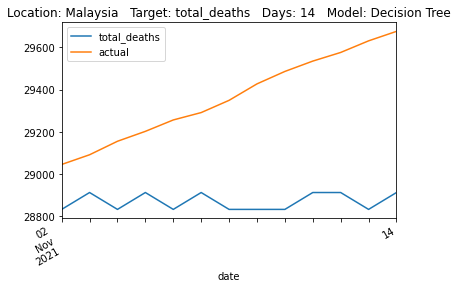

                  MSE        RMSE        R2         MAE       RAE      RRSE
models                                                                     
lstm             None        None      None        None      None      None
dt               None        None      None        None      None      None
rf      309162.636785  556.023953 -6.654101  518.301538  2.923078  2.766605


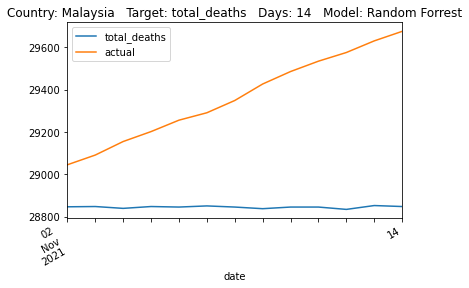

             MSE        RMSE        R2    MAE       RAE      RRSE
models                                                           
lstm        None        None      None   None      None      None
dt      527938.6  726.593834 -4.882379  655.2  2.524855  2.425362
rf          None        None      None   None      None      None


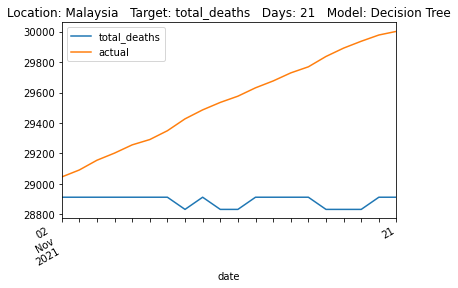

                 MSE        RMSE        R2      MAE       RAE      RRSE
models                                                                 
lstm            None        None      None     None      None      None
dt              None        None      None     None      None      None
rf      566179.38609  752.448926 -5.308464  690.049  2.659148  2.511666


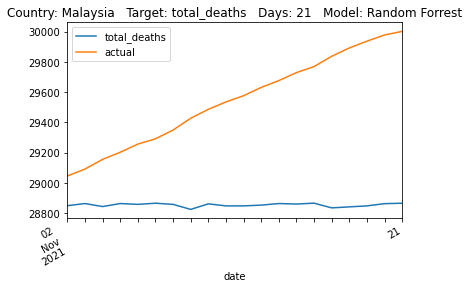

                  MSE        RMSE        R2         MAE       RAE      RRSE
models                                                                     
lstm             None        None      None        None      None      None
dt      788192.148148  887.801863 -4.284916  799.407407  2.383236  2.298895
rf               None        None      None        None      None      None


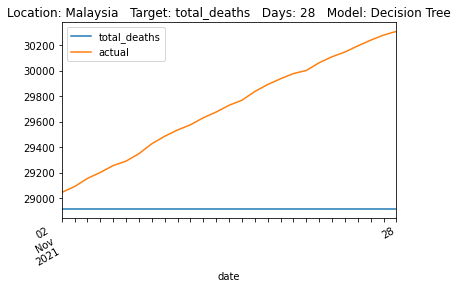

                  MSE        RMSE        R2         MAE       RAE      RRSE
models                                                                     
lstm             None        None      None        None      None      None
dt               None        None      None        None      None      None
rf      866433.576052  930.824138 -4.809534  848.091852  2.528377  2.410297


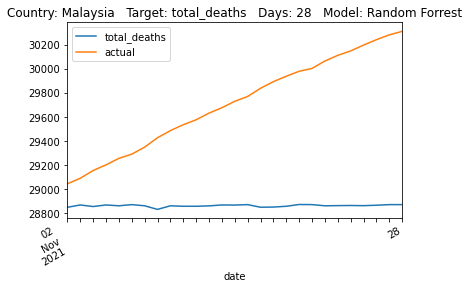

                  MSE        RMSE        R2         MAE       RAE      RRSE
models                                                                     
lstm             None        None      None        None      None      None
dt      964970.275862  982.329006 -4.705448  888.689655  2.490945  2.388608
rf               None        None      None        None      None      None


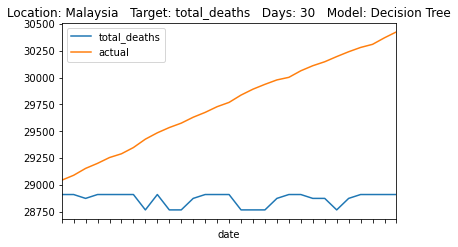

                  MSE        RMSE       R2         MAE       RAE      RRSE
models                                                                    
lstm             None        None     None        None      None      None
dt               None        None     None        None      None      None
rf      972195.805634  985.999901 -4.74817  896.857241  2.513838  2.397534


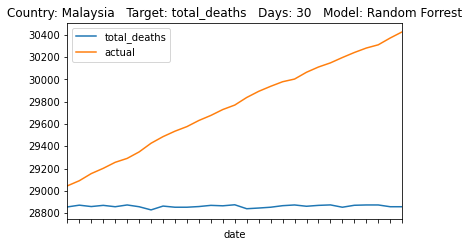

                   MSE           RMSE         R2            MAE       RAE  \
models                                                                      
lstm              None           None       None           None      None   
dt      193170817284.5  439512.021775 -14.661338  425248.833333  4.369481   
rf                None           None       None           None      None   

            RRSE  
models            
lstm        None  
dt      3.957441  
rf          None  


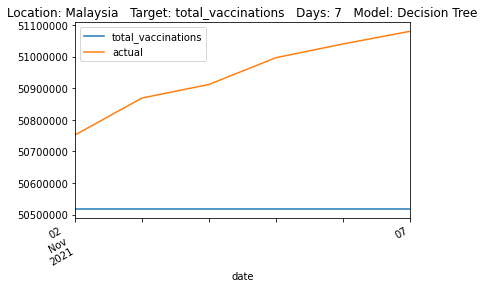

                        MSE           RMSE         R2            MAE      RAE  \
models                                                                          
lstm                   None           None       None           None     None   
dt                     None           None       None           None     None   
rf      253466818972.870331  503454.882758 -19.549841  491019.228333  5.04528   

            RRSE  
models            
lstm        None  
dt          None  
rf      4.533193  


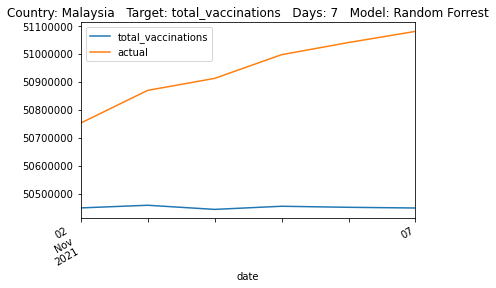

                        MSE           RMSE        R2            MAE       RAE  \
models                                                                          
lstm                   None           None      None           None      None   
dt      680432068451.076904  824883.063501 -4.636739  748143.230769  2.417801   
rf                     None           None      None           None      None   

            RRSE  
models            
lstm        None  
dt      2.374182  
rf          None  


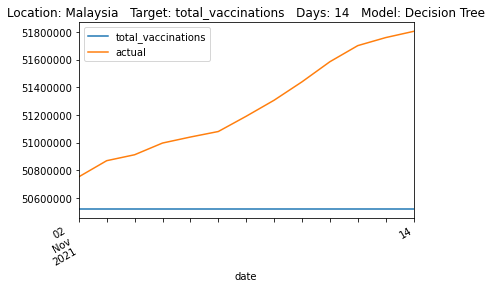

                        MSE           RMSE       R2            MAE       RAE  \
models                                                                         
lstm                   None           None     None           None      None   
dt                     None           None     None           None      None   
rf      844442334551.632935  918935.435464 -5.99541  850115.540769  2.747348   

            RRSE  
models            
lstm        None  
dt          None  
rf      2.644884  


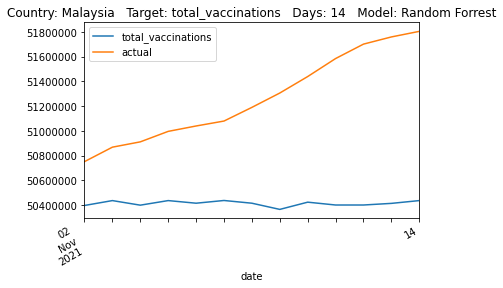

                         MSE            RMSE        R2         MAE       RAE  \
models                                                                         
lstm                    None            None      None        None      None   
dt      1820478677637.350098  1349251.154395 -4.954143  1211477.55  2.489138   
rf                      None            None      None        None      None   

            RRSE  
models            
lstm        None  
dt      2.440111  
rf          None  


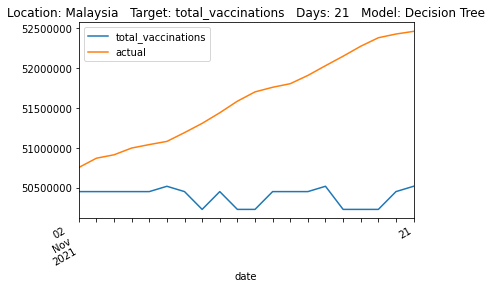

                         MSE            RMSE        R2           MAE  \
models                                                                 
lstm                    None            None      None          None   
dt                      None            None      None          None   
rf      1731208888459.734131  1315754.113982 -4.662173  1190332.0115   

             RAE      RRSE  
models                      
lstm        None      None  
dt          None      None  
rf      2.445692  2.379532  


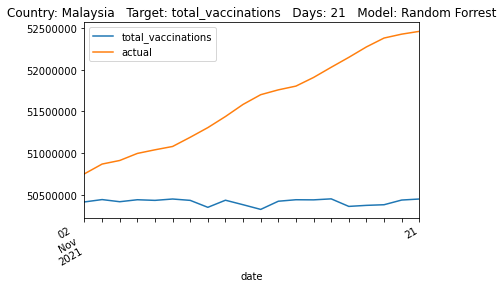

                         MSE            RMSE        R2             MAE  \
models                                                                   
lstm                    None            None      None            None   
dt      2635107028154.518555  1623301.274611 -3.538291  1433341.703704   
rf                      None            None      None            None   

            RAE      RRSE  
models                     
lstm       None      None  
dt      2.16239  2.130327  
rf         None      None  


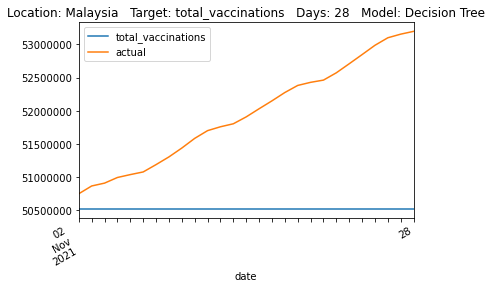

                         MSE           RMSE        R2            MAE  \
models                                                                 
lstm                    None           None      None           None   
dt                      None           None      None           None   
rf      2945416343847.197754  1716221.53111 -4.072719  1539173.42037   

             RAE     RRSE  
models                     
lstm        None     None  
dt          None     None  
rf      2.322052  2.25227  


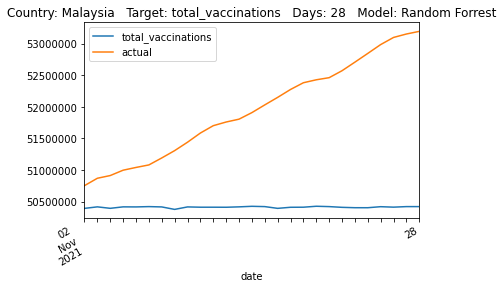

                         MSE            RMSE        R2             MAE  \
models                                                                   
lstm                    None            None      None            None   
dt      3252125455236.965332  1803365.036602 -3.848583  1601518.827586   
rf                      None            None      None            None   

             RAE     RRSE  
models                     
lstm        None     None  
dt      2.246247  2.20195  
rf          None     None  


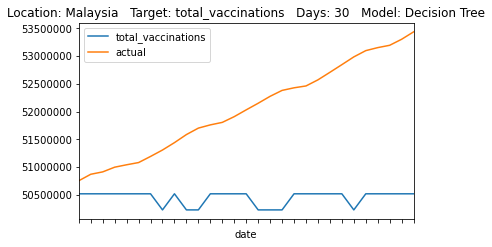

                         MSE            RMSE        R2             MAE  \
models                                                                   
lstm                    None            None      None            None   
dt                      None            None      None            None   
rf      3284665540664.482422  1812364.626852 -3.897097  1618287.817241   

             RAE      RRSE  
models                      
lstm        None      None  
dt          None      None  
rf      2.269767  2.212939  


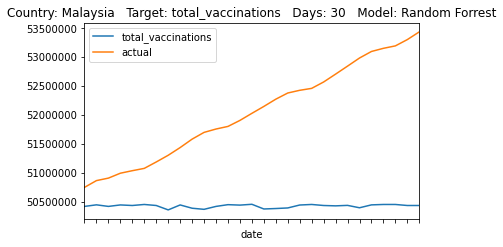

                       MSE           RMSE         R2            MAE       RAE  \
models                                                                          
lstm                  None           None       None           None      None   
dt      65397689912.666664  255729.720433 -35.354233  252633.666667  6.831507   
rf                    None           None       None           None      None   

            RRSE  
models            
lstm        None  
dt      6.029447  
rf          None  


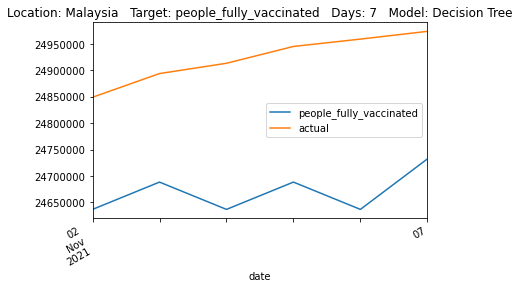

                       MSE           RMSE         R2        MAE      RAE  \
models                                                                     
lstm                  None           None       None       None     None   
dt                    None           None       None       None     None   
rf      79410640957.019791  281798.937111 -43.143959  279046.13  7.54573   

            RRSE  
models            
lstm        None  
dt          None  
rf      6.644092  


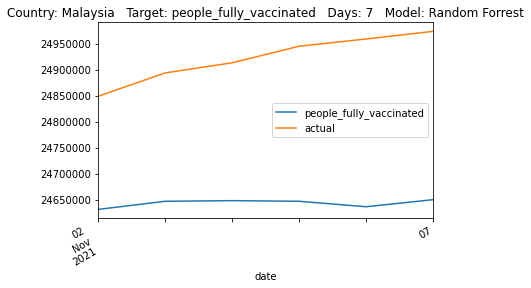

                        MSE           RMSE        R2            MAE       RAE  \
models                                                                          
lstm                   None           None      None           None      None   
dt      140326071483.461548  374601.216607 -9.986003  338363.461538  3.382994   
rf                     None           None      None           None      None   

            RRSE  
models            
lstm        None  
dt      3.314514  
rf          None  


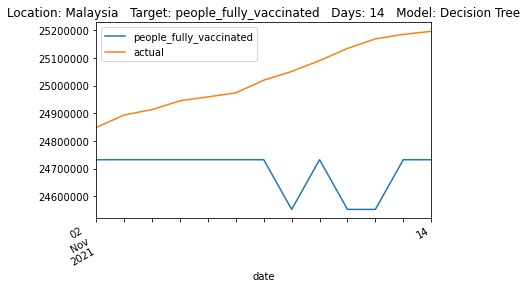

                        MSE           RMSE        R2            MAE       RAE  \
models                                                                          
lstm                   None           None      None           None      None   
dt                     None           None      None           None      None   
rf      140349326492.146423  374632.255008 -9.987824  357414.900769  3.573473   

            RRSE  
models            
lstm        None  
dt          None  
rf      3.314789  


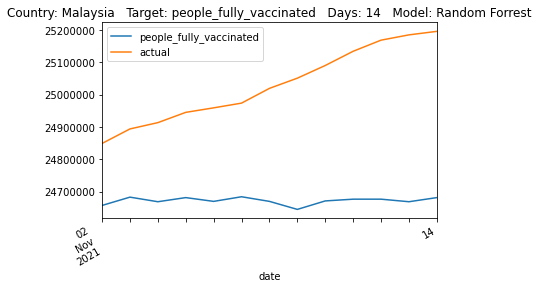

                        MSE           RMSE       R2       MAE       RAE  \
models                                                                    
lstm                   None           None     None      None      None   
dt      172050372194.899994  414789.551694 -6.37908  385661.0  2.824573   
rf                     None           None     None      None      None   

            RRSE  
models            
lstm        None  
dt      2.716446  
rf          None  


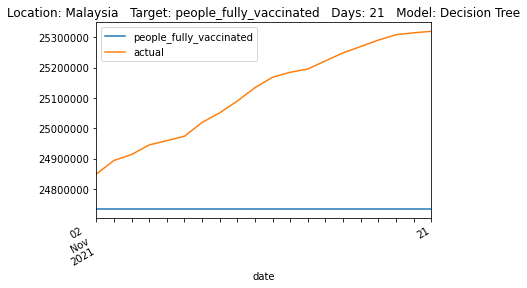

                        MSE           RMSE        R2          MAE       RAE  \
models                                                                        
lstm                   None           None      None         None      None   
dt                     None           None      None         None      None   
rf      240579115320.911224  490488.649533 -9.318214  466967.2445  3.420058   

            RRSE  
models            
lstm        None  
dt          None  
rf      3.212198  


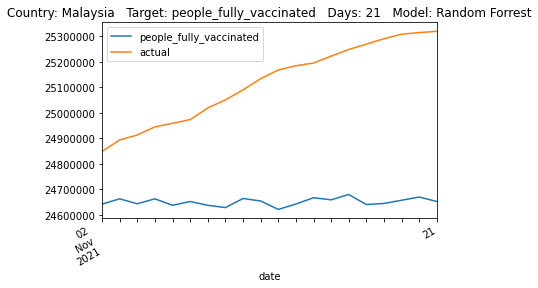

                        MSE           RMSE        R2            MAE       RAE  \
models                                                                          
lstm                   None           None      None           None      None   
dt      257382482660.851837  507328.771765 -8.137193  482687.148148  3.297543   
rf                     None           None      None           None      None   

            RRSE  
models            
lstm        None  
dt      3.022779  
rf          None  


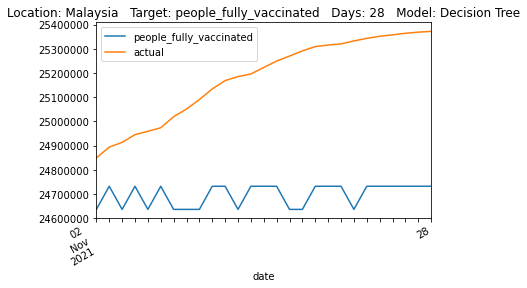

                        MSE           RMSE        R2            MAE       RAE  \
models                                                                          
lstm                   None           None      None           None      None   
dt                     None           None      None           None      None   
rf      275302126138.757324  524692.410979 -8.773348  497831.338148  3.401003   

            RRSE  
models            
lstm        None  
dt          None  
rf      3.126235  


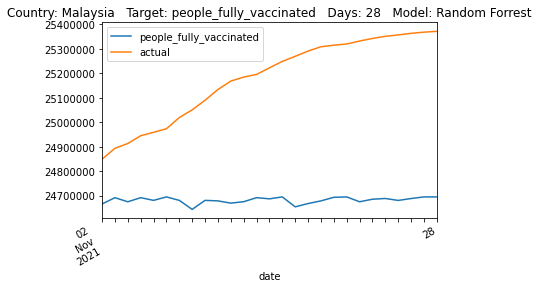

                        MSE           RMSE       R2            MAE       RAE  \
models                                                                         
lstm                   None           None     None           None      None   
dt      266669245360.655182  516400.276298 -8.23388  484376.103448  3.283891   
rf                     None           None     None           None      None   

           RRSE  
models           
lstm       None  
dt      3.03873  
rf         None  


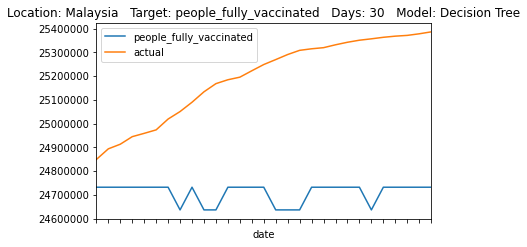

                        MSE           RMSE        R2            MAE       RAE  \
models                                                                          
lstm                   None           None      None           None      None   
dt                     None           None      None           None      None   
rf      332777464209.665405  576868.671545 -10.52299  551950.211379  3.742018   

            RRSE  
models            
lstm        None  
dt          None  
rf      3.394553  


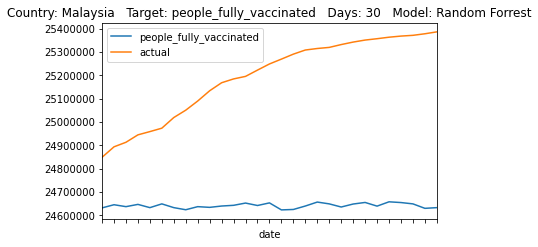

             MSE        RMSE        R2    MAE   RAE      RRSE
models                                                       
lstm        None        None      None   None  None      None
dt      188265.5  433.895725 -0.004132  351.5   1.0  1.002064
rf          None        None      None   None  None      None


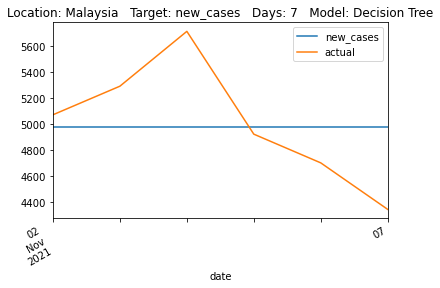

                  MSE        RMSE        R2      MAE       RAE      RRSE
models                                                                  
lstm             None        None      None     None      None      None
dt               None        None      None     None      None      None
rf      317627.093317  563.584149 -0.694094  465.135  1.323286  1.301574


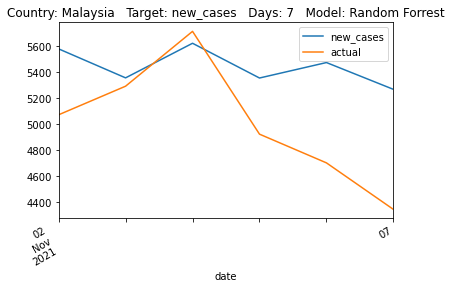

                  MSE        RMSE       R2         MAE       RAE      RRSE
models                                                                    
lstm             None        None     None        None      None      None
dt      625733.692308  791.033307 -0.36432  625.230769  1.085425  1.168041
rf               None        None     None        None      None      None


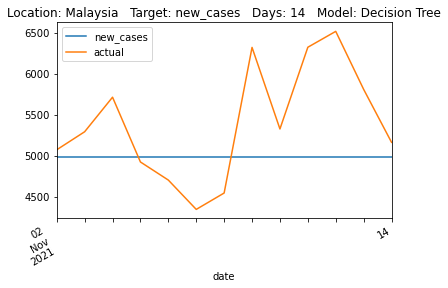

                  MSE        RMSE       R2         MAE       RAE      RRSE
models                                                                    
lstm             None        None     None        None      None      None
dt               None        None     None        None      None      None
rf      420794.353408  648.686637  0.08252  552.181538  0.958609  0.957852


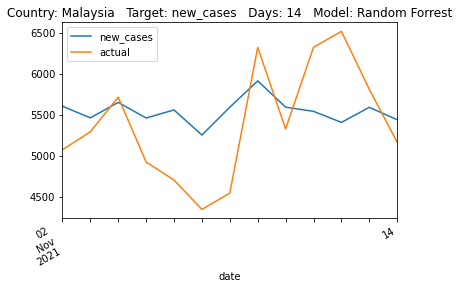

             MSE        RMSE        R2    MAE       RAE      RRSE
models                                                           
lstm        None        None      None   None      None      None
dt      468389.3  684.389728 -0.049245  584.0  0.987295  1.024327
rf          None        None      None   None      None      None


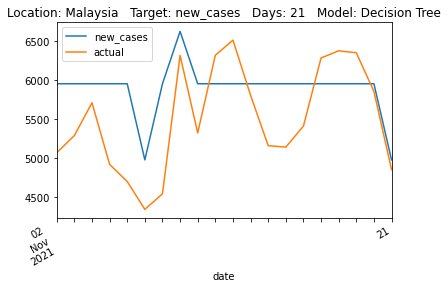

                  MSE        RMSE        R2      MAE      RAE      RRSE
models                                                                 
lstm             None        None      None     None     None      None
dt               None        None      None     None     None      None
rf      410657.146314  640.825363  0.080082  554.238  0.93698  0.959124


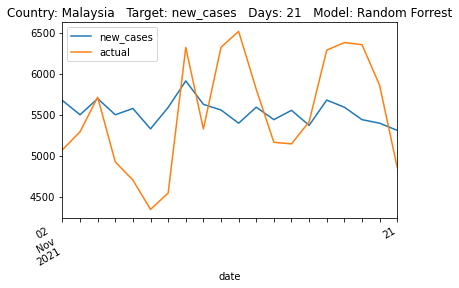

                  MSE       RMSE       R2    MAE       RAE      RRSE
models                                                              
lstm             None       None     None   None      None      None
dt      662590.481481  813.99661 -0.55302  661.0  1.187051  1.246202
rf               None       None     None   None      None      None


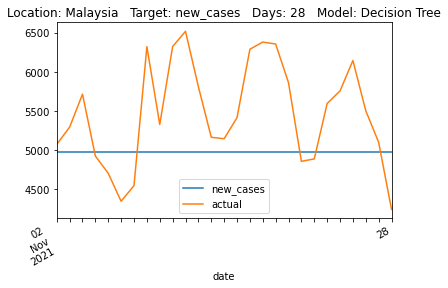

                  MSE        RMSE        R2         MAE       RAE     RRSE
models                                                                    
lstm             None        None      None        None      None     None
dt               None        None      None        None      None     None
rf      395066.899081  628.543474  0.074018  538.314074  0.966726  0.96228


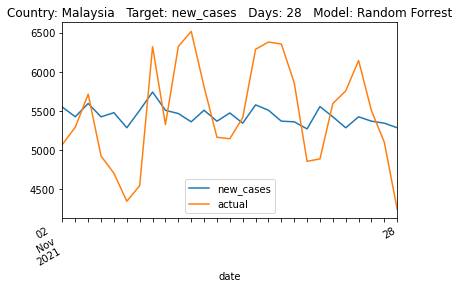

                  MSE        RMSE        R2        MAE       RAE      RRSE
models                                                                    
lstm             None        None      None       None      None      None
dt      644676.103448  802.917246 -0.371875  649.62069  1.119567  1.171271
rf               None        None      None       None      None      None


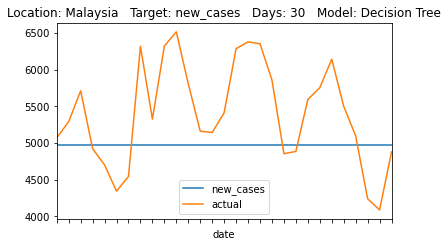

                  MSE        RMSE        R2         MAE       RAE      RRSE
models                                                                     
lstm             None        None      None        None      None      None
dt               None        None      None        None      None      None
rf      463714.364679  680.965759  0.013213  567.718966  0.978417  0.993372


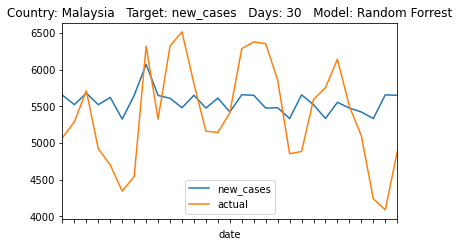

               MSE      RMSE        R2   MAE   RAE      RRSE
models                                                      
lstm          None      None      None  None  None      None
dt      414.333333  20.35518 -2.034174  17.0   1.7  1.741888
rf            None      None      None  None  None      None


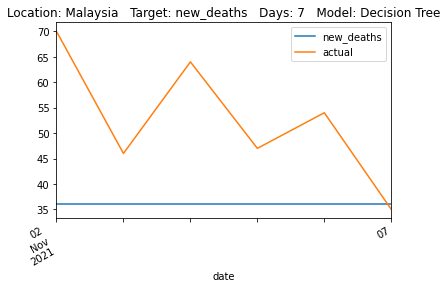

              MSE       RMSE        R2     MAE     RAE      RRSE
models                                                          
lstm         None       None      None    None    None      None
dt           None       None      None    None    None      None
rf      184.71115  13.590848 -0.352645  10.205  1.0205  1.163033


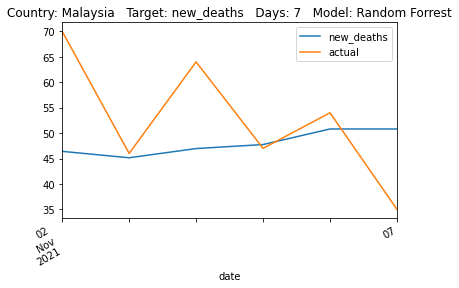

               MSE       RMSE        R2        MAE       RAE      RRSE
models                                                                
lstm          None       None      None       None      None      None
dt      660.538462  25.700943 -3.983972  21.769231  2.337357  2.232481
rf            None       None      None       None      None      None


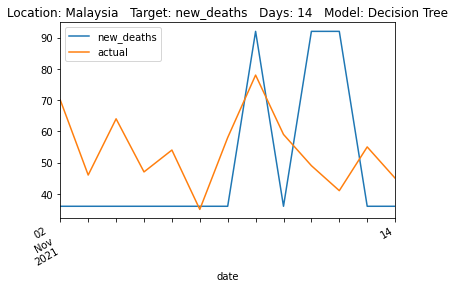

               MSE       RMSE        R2       MAE       RAE      RRSE
models                                                               
lstm          None       None      None      None      None      None
dt            None       None      None      None      None      None
rf      253.843141  15.932456 -0.915327  11.84734  1.272046  1.383953


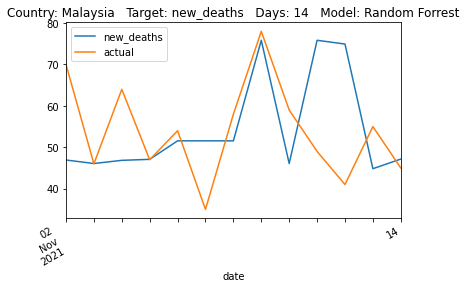

           MSE       RMSE        R2    MAE       RAE      RRSE
models                                                        
lstm      None       None      None   None      None      None
dt      660.75  25.705058 -3.226704  21.45  2.134328  2.055895
rf        None       None      None   None      None      None


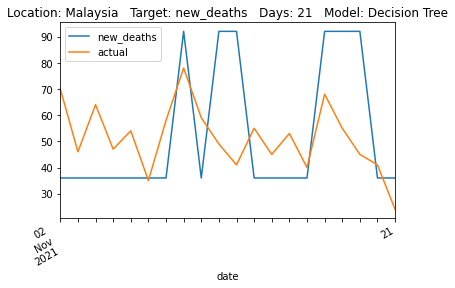

               MSE       RMSE        R2        MAE       RAE      RRSE
models                                                                
lstm          None       None      None       None      None      None
dt            None       None      None       None      None      None
rf      264.414861  16.260838 -0.691416  12.648941  1.258601  1.300545


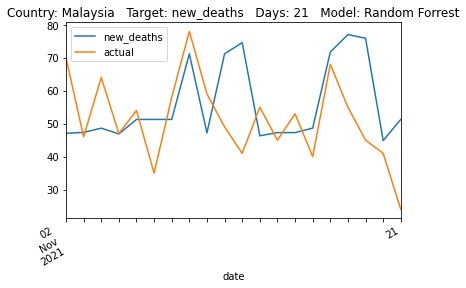

               MSE       RMSE        R2        MAE      RAE    RRSE
models                                                             
lstm          None       None      None       None     None    None
dt      527.851852  22.975027 -2.543054  18.444444  1.89327  1.8823
rf            None       None      None       None     None    None


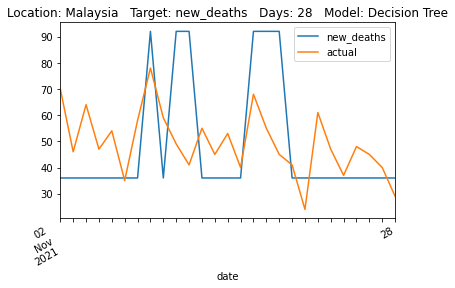

               MSE      RMSE        R2        MAE       RAE      RRSE
models                                                               
lstm          None      None      None       None      None      None
dt            None      None      None       None      None      None
rf      208.052918  14.42404 -0.396495  11.133406  1.142812  1.181734


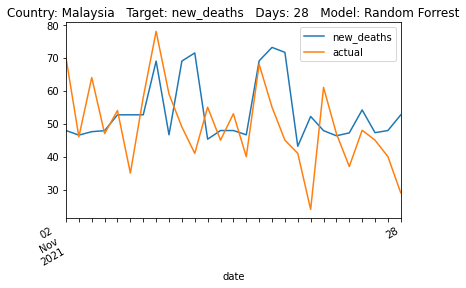

               MSE       RMSE      R2        MAE       RAE      RRSE
models                                                              
lstm          None       None    None       None      None      None
dt      525.448276  22.922659 -2.6472  18.689655  1.921986  1.909764
rf            None       None    None       None      None      None


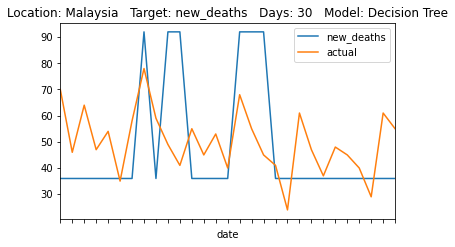

               MSE       RMSE        R2        MAE       RAE      RRSE
models                                                                
lstm          None       None      None       None      None      None
dt            None       None      None       None      None      None
rf      192.489899  13.874073 -0.336096  10.857845  1.116587  1.155896


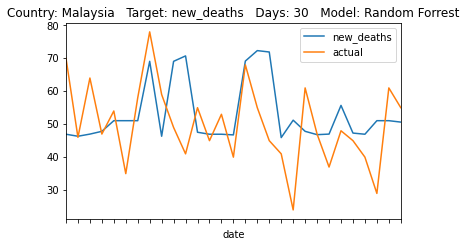

               MSE         RMSE        R2     MAE       RAE      RRSE
models                                                               
lstm          None         None      None    None      None      None
dt      34450203.0  5869.429529 -8.032617  5535.0  3.191428  3.005431
rf            None         None      None    None      None      None


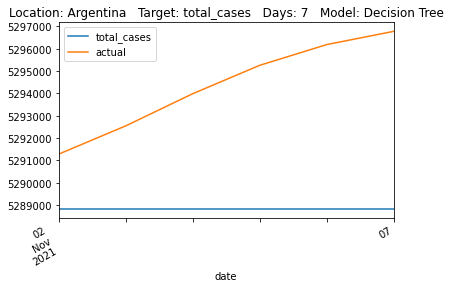

                    MSE         RMSE         R2          MAE       RAE  \
models                                                                   
lstm               None         None       None         None      None   
dt                 None         None       None         None      None   
rf      44672102.920899  6683.719243 -10.712732  6437.766667  3.711955   

            RRSE  
models            
lstm        None  
dt          None  
rf      3.422387  


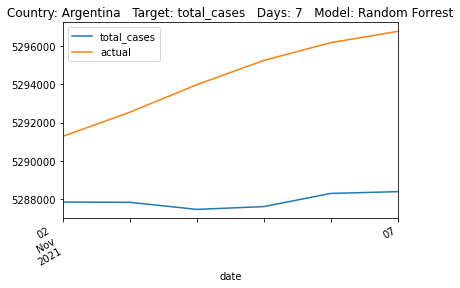

                     MSE         RMSE        R2           MAE       RAE  \
models                                                                    
lstm                None         None      None          None      None   
dt      134197495.538462  11584.36427 -5.302311  10643.230769  2.646137   
rf                  None         None      None          None      None   

           RRSE  
models           
lstm       None  
dt      2.51044  
rf         None  


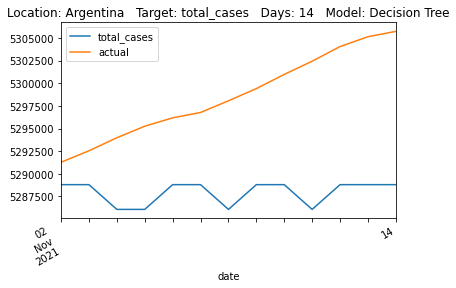

                     MSE          RMSE        R2           MAE       RAE  \
models                                                                     
lstm                None          None      None          None      None   
dt                  None          None      None          None      None   
rf      137355132.079822  11719.860583 -5.450603  10816.053077  2.689104   

            RRSE  
models            
lstm        None  
dt          None  
rf      2.539804  


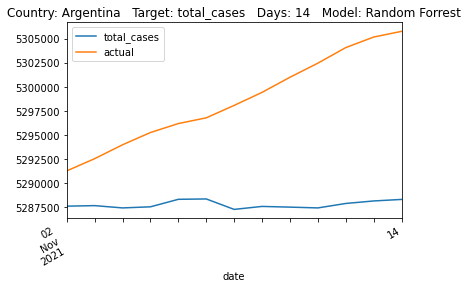

                 MSE          RMSE      R2       MAE      RAE      RRSE
models                                                                 
lstm            None          None    None      None     None      None
dt      310914003.35  17632.753709 -4.5735  15821.95  2.43409  2.360826
rf              None          None    None      None     None      None


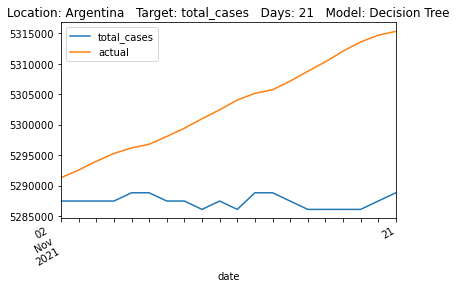

                     MSE          RMSE       R2        MAE     RAE      RRSE
models                                                                      
lstm                None          None     None       None    None      None
dt                  None          None     None       None    None      None
rf      293657682.363331  17136.443107 -4.26416  15432.007  2.3741  2.294376


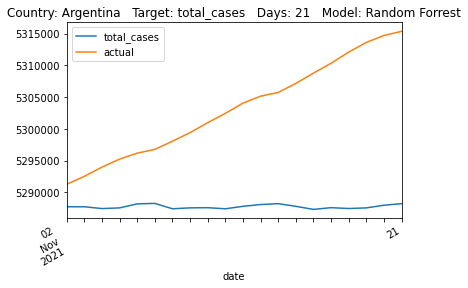

                     MSE          RMSE        R2           MAE       RAE  \
models                                                                     
lstm                None          None      None          None      None   
dt      478178689.962963  21867.297272 -3.332497  19178.333333  2.109833   
rf                  None          None      None          None      None   

            RRSE  
models            
lstm        None  
dt      2.081465  
rf          None  


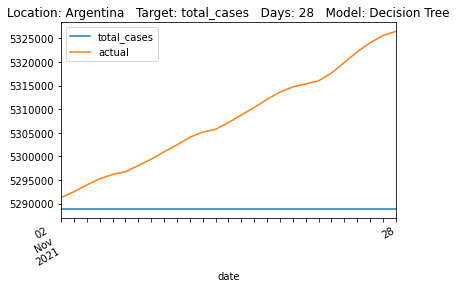

                     MSE          RMSE        R2           MAE       RAE  \
models                                                                     
lstm                None          None      None          None      None   
dt                  None          None      None          None      None   
rf      524556840.524762  22903.205901 -3.752703  20324.334815  2.235906   

            RRSE  
models            
lstm        None  
dt          None  
rf      2.180069  


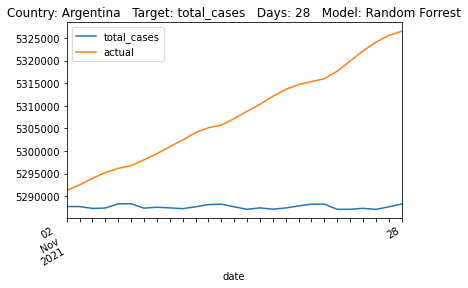

                     MSE          RMSE        R2           MAE      RAE  \
models                                                                    
lstm                None          None      None          None     None   
dt      620959331.862069  24919.055597 -3.675882  21968.965517  2.20816   
rf                  None          None      None          None     None   

            RRSE  
models            
lstm        None  
dt      2.162379  
rf          None  


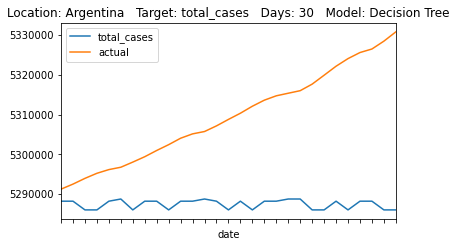

                     MSE          RMSE       R2           MAE       RAE  \
models                                                                    
lstm                None          None     None          None      None   
dt                  None          None     None          None      None   
rf      606305892.444337  24623.279482 -3.56554  21736.616897  2.184806   

            RRSE  
models            
lstm        None  
dt          None  
rf      2.136712  


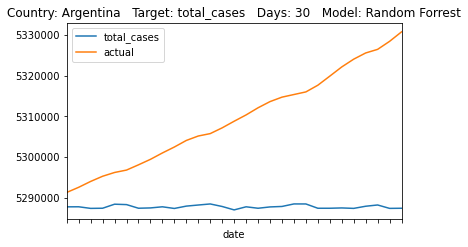

            MSE       RMSE         R2    MAE       RAE      RRSE
models                                                          
lstm       None       None       None   None      None      None
dt      13692.0  117.01282 -10.926829  112.0  3.652174  3.453524
rf         None       None       None   None      None      None


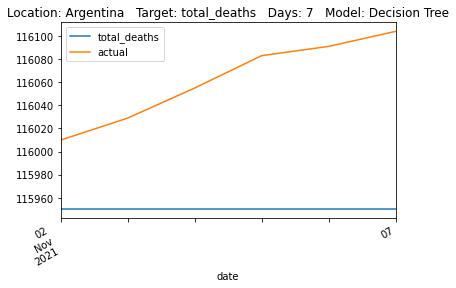

                 MSE        RMSE         R2         MAE       RAE      RRSE
models                                                                     
lstm            None        None       None        None      None      None
dt              None        None       None        None      None      None
rf      18141.755317  134.691333 -14.802923  130.981667  4.271141  3.975289


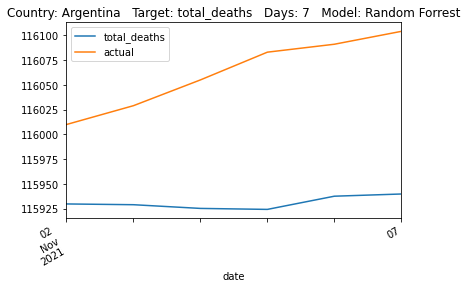

                 MSE        RMSE        R2         MAE       RAE      RRSE
models                                                                    
lstm            None        None      None        None      None      None
dt      44772.230769  211.594496 -6.937256  195.461538  2.900685  2.817314
rf              None        None      None        None      None      None


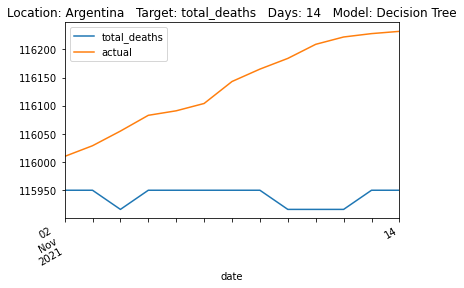

                 MSE        RMSE        R2         MAE      RAE      RRSE
models                                                                   
lstm            None        None      None        None     None      None
dt              None        None      None        None     None      None
rf      45719.570371  213.821352 -7.105201  200.389744  2.97382  2.846964


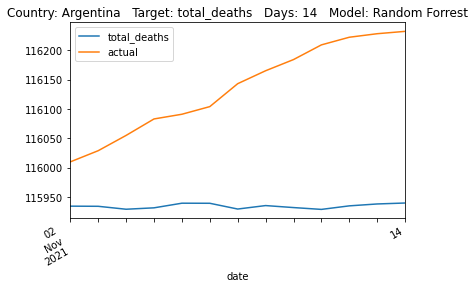

            MSE        RMSE        R2    MAE       RAE      RRSE
models                                                          
lstm       None        None      None   None      None      None
dt      84589.2  290.842225 -5.525907  267.8  2.775705  2.554586
rf         None        None      None   None      None      None


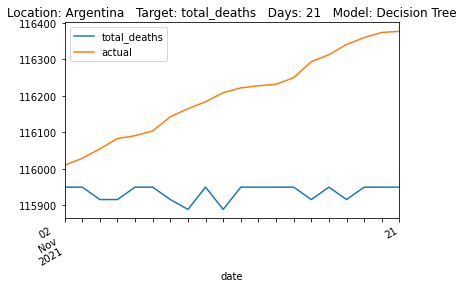

                 MSE        RMSE        R2       MAE       RAE      RRSE
models                                                                  
lstm            None        None      None      None      None      None
dt              None        None      None      None      None      None
rf      85574.267145  292.530797 -5.601903  269.5625  2.793973  2.569417


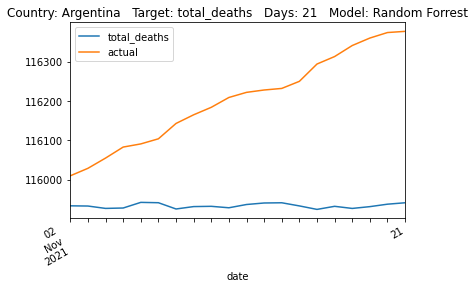

                  MSE        RMSE       R2         MAE       RAE      RRSE
models                                                                    
lstm             None        None     None        None      None      None
dt      137488.666667  370.794642 -4.75819  336.074074  2.512027  2.399623
rf               None        None     None        None      None      None


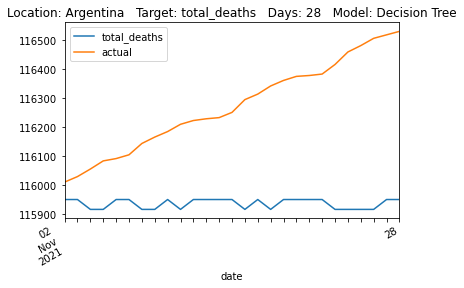

                  MSE       RMSE        R2         MAE       RAE      RRSE
models                                                                    
lstm             None       None      None        None      None      None
dt               None       None      None        None      None      None
rf      137755.521781  371.15431 -4.769367  337.345556  2.521531  2.401951


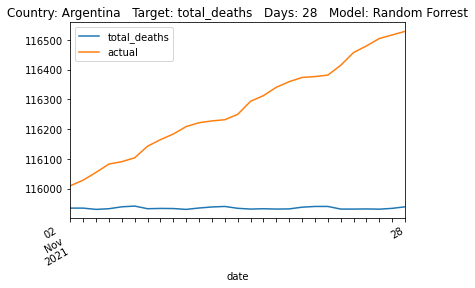

                  MSE        RMSE        R2         MAE       RAE      RRSE
models                                                                     
lstm             None        None      None        None      None      None
dt      165144.172414  406.379345 -4.897473  367.758621  2.545262  2.428471
rf               None        None      None        None      None      None


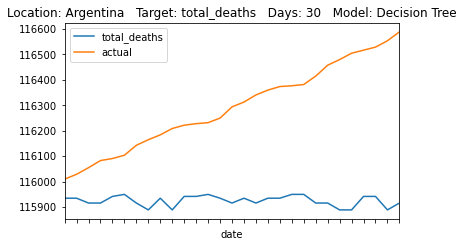

                  MSE        RMSE        R2         MAE       RAE      RRSE
models                                                                     
lstm             None        None      None        None      None      None
dt               None        None      None        None      None      None
rf      156648.640734  395.788631 -4.594088  358.172759  2.478918  2.365183


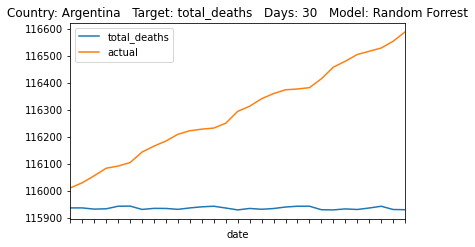

                    MSE            RMSE        R2            MAE       RAE  \
models                                                                       
lstm               None            None      None           None      None   
dt      1055919464693.0  1027579.420139 -4.670935  932588.333333  2.607791   
rf                 None            None      None           None      None   

            RRSE  
models            
lstm        None  
dt      2.381373  
rf          None  


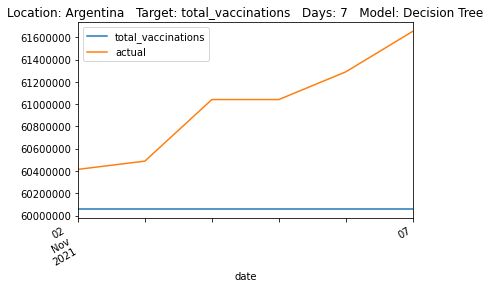

                         MSE           RMSE        R2          MAE       RAE  \
models                                                                         
lstm                    None           None      None         None      None   
dt                      None           None      None         None      None   
rf      1637320349596.485596  1279578.19206 -7.793415  1222832.105  3.419398   

            RRSE  
models            
lstm        None  
dt          None  
rf      2.965369  


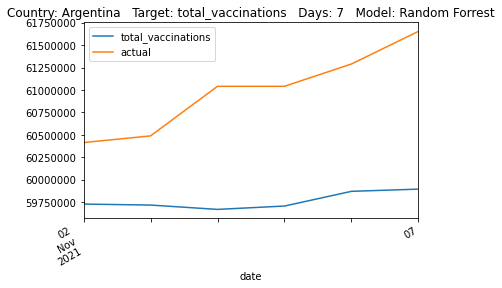

                         MSE            RMSE        R2             MAE  \
models                                                                   
lstm                    None            None      None            None   
dt      3521957868671.692383  1876688.005149 -4.282457  1689742.769231   
rf                      None            None      None            None   

             RAE     RRSE  
models                     
lstm        None     None  
dt      2.417677  2.29836  
rf          None     None  


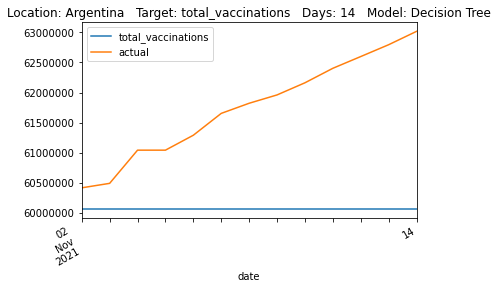

                         MSE            RMSE       R2         MAE       RAE  \
models                                                                        
lstm                    None            None     None        None      None   
dt                      None            None     None        None      None   
rf      4781674625687.670898  2186704.055351 -6.17186  2038364.22  2.916483   

            RRSE  
models            
lstm        None  
dt          None  
rf      2.678033  


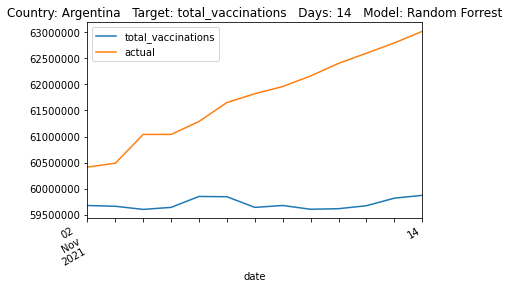

                          MSE            RMSE       R2         MAE       RAE  \
models                                                                         
lstm                     None            None     None        None      None   
dt      11547509237002.150391  3398162.626627 -2.57457  2883929.35  1.848325   
rf                       None            None     None        None      None   

            RRSE  
models            
lstm        None  
dt      1.890653  
rf          None  


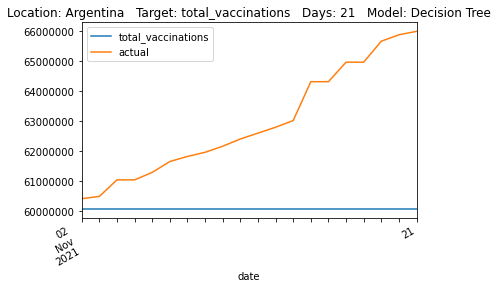

                          MSE            RMSE        R2           MAE  \
models                                                                  
lstm                     None            None      None          None   
dt                       None            None      None          None   
rf      13771110099572.689453  3710944.637093 -3.262894  3241608.3935   

             RAE      RRSE  
models                      
lstm        None      None  
dt          None      None  
rf      2.077564  2.064678  


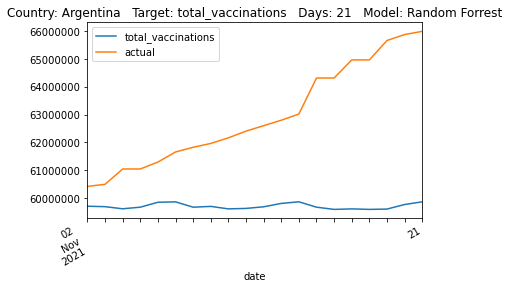

                     MSE            RMSE        R2             MAE       RAE  \
models                                                                         
lstm                None            None      None            None      None   
dt      20944662752901.0  4576533.923495 -2.765572  3922055.074074  1.824522   
rf                  None            None      None            None      None   

            RRSE  
models            
lstm        None  
dt      1.940508  
rf          None  


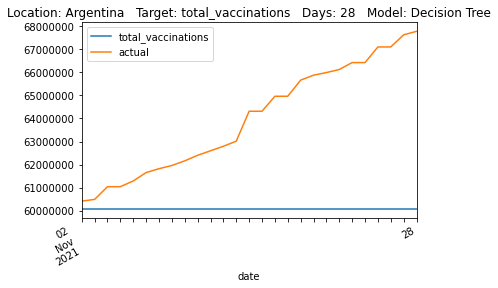

                          MSE            RMSE        R2             MAE  \
models                                                                    
lstm                     None            None      None            None   
dt                       None            None      None            None   
rf      23441162277271.453125  4841607.406355 -3.214409  4223142.489259   

             RAE      RRSE  
models                      
lstm        None      None  
dt          None      None  
rf      1.964587  2.052903  


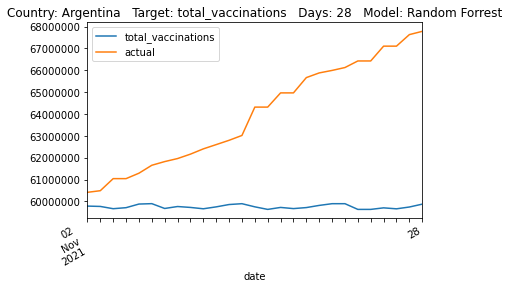

                          MSE            RMSE        R2             MAE  \
models                                                                    
lstm                     None            None      None            None   
dt      29357694489939.070312  5418274.124658 -3.593813  4681218.655172   
rf                       None            None      None            None   

             RAE      RRSE  
models                      
lstm        None      None  
dt      2.062414  2.143318  
rf          None      None  


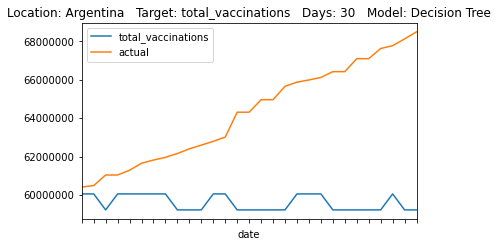

                          MSE            RMSE        R2             MAE  \
models                                                                    
lstm                     None            None      None            None   
dt                       None            None      None            None   
rf      27559610912013.222656  5249724.841552 -3.312454  4576063.334828   

             RAE      RRSE  
models                      
lstm        None      None  
dt          None      None  
rf      2.016086  2.076645  


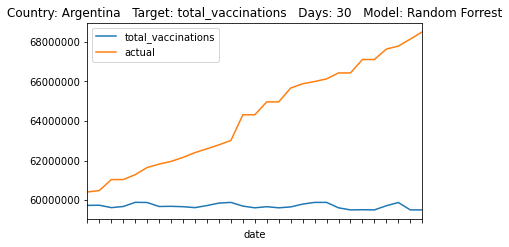

                        MSE           RMSE        R2            MAE       RAE  \
models                                                                          
lstm                   None           None      None           None      None   
dt      182122734088.166656  426758.402481 -3.070224  370644.833333  2.062856   
rf                     None           None      None           None      None   

           RRSE  
models           
lstm       None  
dt      2.01748  
rf         None  


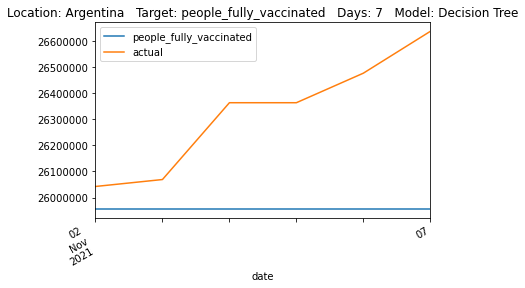

                        MSE          RMSE        R2            MAE       RAE  \
models                                                                         
lstm                   None          None      None           None      None   
dt                     None          None      None           None      None   
rf      260741003128.069702  510628.04773 -4.827247  471179.858333  2.622393   

            RRSE  
models            
lstm        None  
dt          None  
rf      2.413969  


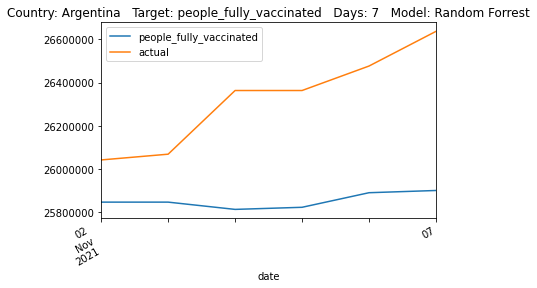

                        MSE           RMSE        R2            MAE       RAE  \
models                                                                          
lstm                   None           None      None           None      None   
dt      769816937733.076904  877392.123131 -3.902172  786134.615385  2.346059   
rf                     None           None      None           None      None   

            RRSE  
models            
lstm        None  
dt      2.214085  
rf          None  


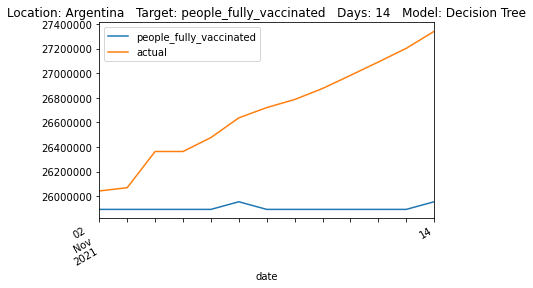

                       MSE           RMSE       R2            MAE       RAE  \
models                                                                        
lstm                  None           None     None           None      None   
dt                    None           None     None           None      None   
rf      838284358769.81958  915578.701571 -4.33817  829581.929231  2.475718   

            RRSE  
models            
lstm        None  
dt          None  
rf      2.310448  


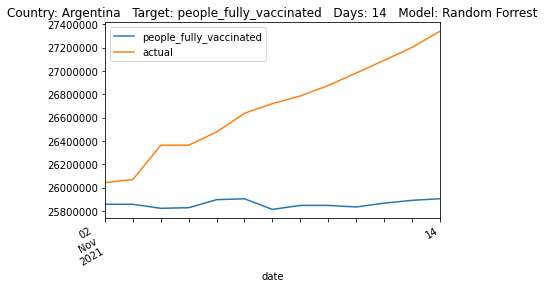

                         MSE            RMSE        R2         MAE       RAE  \
models                                                                         
lstm                    None            None      None        None      None   
dt      2210788364684.850098  1486872.006827 -3.232211  1264498.15  2.079035   
rf                      None            None      None        None      None   

            RRSE  
models            
lstm        None  
dt      2.057234  
rf          None  


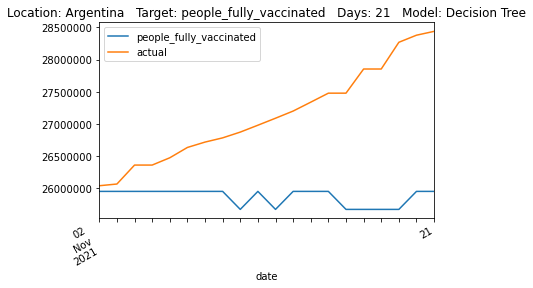

                         MSE            RMSE        R2           MAE  \
models                                                                 
lstm                    None            None      None          None   
dt                      None            None      None          None   
rf      2200212263365.295898  1483311.249659 -3.211965  1295689.4825   

             RAE      RRSE  
models                      
lstm        None      None  
dt          None      None  
rf      2.130318  2.052307  


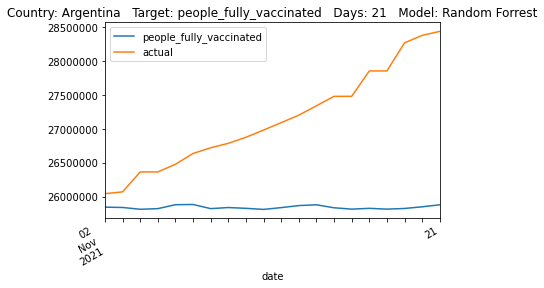

                         MSE            RMSE        R2             MAE  \
models                                                                   
lstm                    None            None      None            None   
dt      3971717987858.185059  1992916.954581 -2.931286  1725067.592593   
rf                      None            None      None            None   

             RAE      RRSE  
models                      
lstm        None      None  
dt      1.940088  1.982747  
rf          None      None  


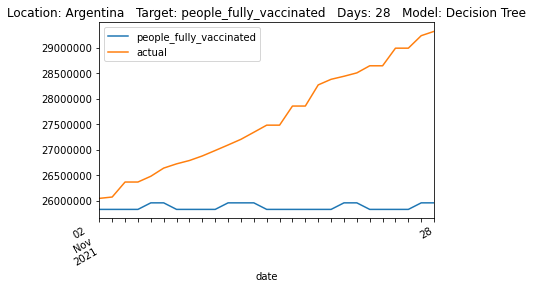

                         MSE            RMSE        R2             MAE  \
models                                                                   
lstm                    None            None      None            None   
dt                      None            None      None            None   
rf      4128250376323.214844  2031809.630926 -3.086225  1759964.366296   

             RAE      RRSE  
models                      
lstm        None      None  
dt          None      None  
rf      1.979334  2.021441  


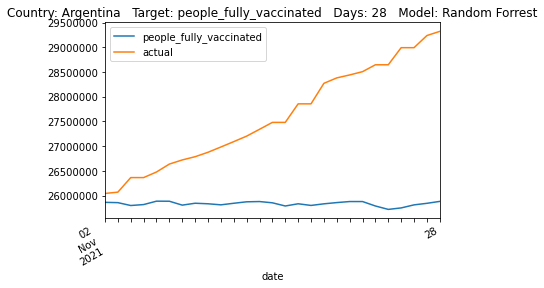

                        MSE            RMSE        R2             MAE  \
models                                                                  
lstm                   None            None      None            None   
dt      4399354092393.03418  2097463.728505 -2.657994  1787136.965517   
rf                     None            None      None            None   

             RAE      RRSE  
models                      
lstm        None      None  
dt      1.839012  1.912588  
rf          None      None  


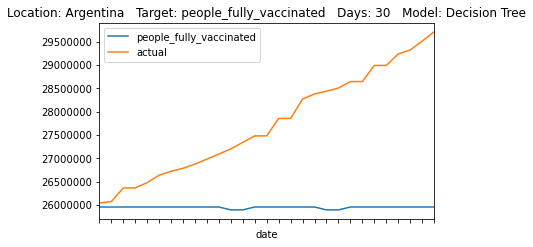

                         MSE            RMSE        R2             MAE  \
models                                                                   
lstm                    None            None      None            None   
dt                      None            None      None            None   
rf      4757880271972.412109  2181256.580958 -2.956103  1883108.439655   

             RAE      RRSE  
models                      
lstm        None      None  
dt          None      None  
rf      1.937769  1.988995  


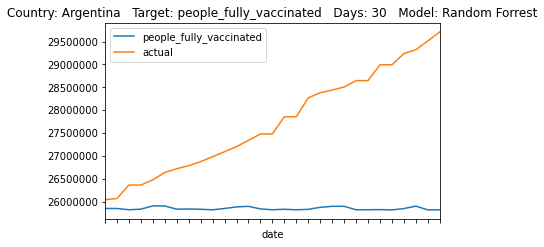

             MSE        RMSE        R2         MAE       RAE      RRSE
models                                                                
lstm        None        None      None        None      None      None
dt      159396.5  399.244912 -0.887513  301.833333  1.195117  1.373868
rf          None        None      None        None      None      None


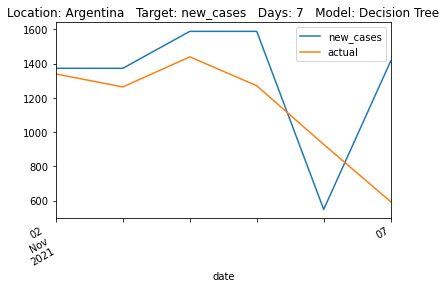

                 MSE        RMSE        R2         MAE       RAE      RRSE
models                                                                    
lstm            None        None      None        None      None      None
dt              None        None      None        None      None      None
rf      34151.458428  184.801132  0.595591  140.299333  0.555519  0.635931


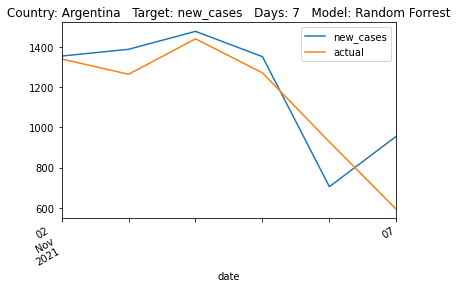

                  MSE       RMSE        R2         MAE     RAE      RRSE
models                                                                  
lstm             None       None      None        None    None      None
dt      114983.615385  339.09234 -0.139354  266.230769  1.0446  1.067405
rf               None       None      None        None    None      None


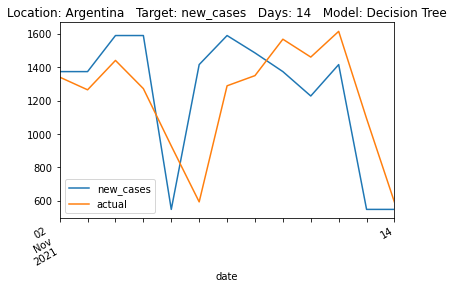

                 MSE       RMSE        R2         MAE       RAE      RRSE
models                                                                   
lstm            None       None      None        None      None      None
dt              None       None      None        None      None      None
rf      69949.845091  264.48033  0.306878  182.914808  0.717696  0.832539


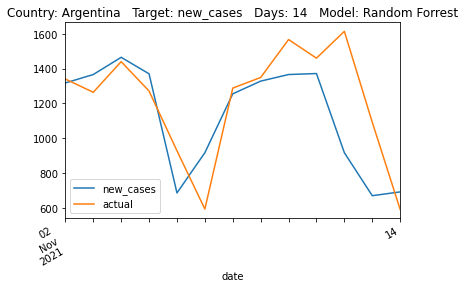

             MSE        RMSE       R2     MAE       RAE      RRSE
models                                                           
lstm        None        None     None    None      None      None
dt      83547.25  289.045412  0.27141  214.65  0.800321  0.853575
rf          None        None     None    None      None      None


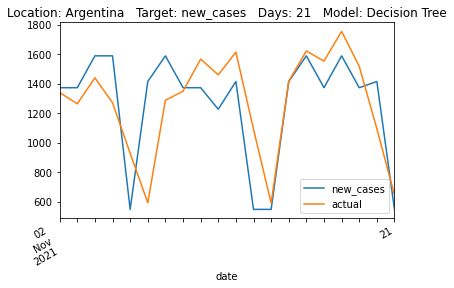

                MSE        RMSE        R2         MAE       RAE      RRSE
models                                                                   
lstm           None        None      None        None      None      None
dt             None        None      None        None      None      None
rf      65529.54982  255.987402  0.428537  189.954643  0.708244  0.755952


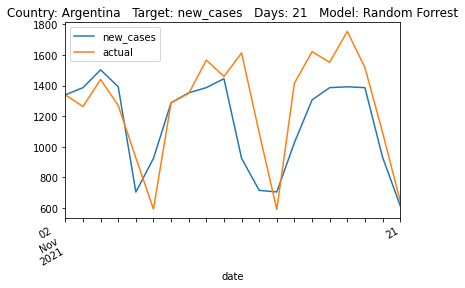

                 MSE       RMSE        R2         MAE       RAE      RRSE
models                                                                   
lstm            None       None      None        None      None      None
dt      130059.37037  360.63745  0.321824  272.259259  0.800847  0.823514
rf              None       None      None        None      None      None


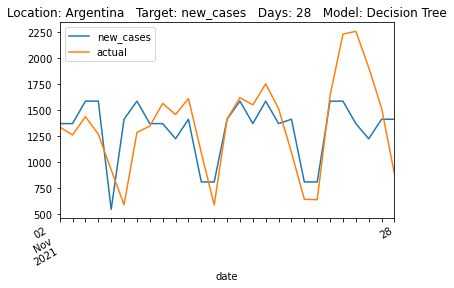

                  MSE        RMSE        R2        MAE       RAE      RRSE
models                                                                    
lstm             None        None      None       None      None      None
dt               None        None      None       None      None      None
rf      136686.974588  369.712016  0.287266  264.12463  0.776919  0.844236


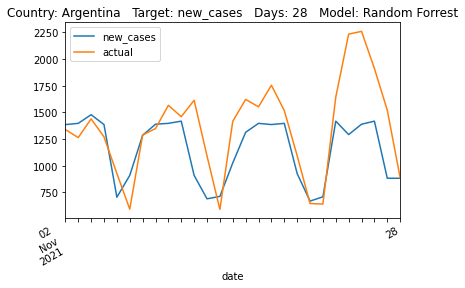

                  MSE        RMSE        R2         MAE       RAE      RRSE
models                                                                     
lstm             None        None      None        None      None      None
dt      163333.413793  404.145288  0.263365  301.758621  0.824788  0.858274
rf               None        None      None        None      None      None


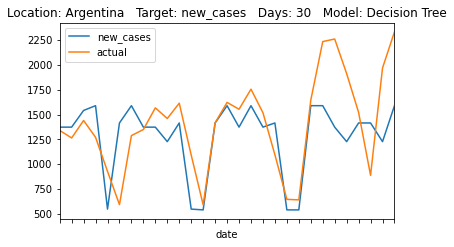

                  MSE        RMSE       R2         MAE      RAE      RRSE
models                                                                   
lstm             None        None     None        None     None      None
dt               None        None     None        None     None      None
rf      158245.963574  397.801412  0.28631  289.129655  0.79027  0.844802


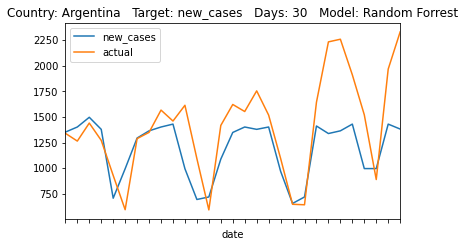

              MSE      RMSE       R2       MAE       RAE      RRSE
models                                                            
lstm         None      None     None      None      None      None
dt      57.166667  7.560864 -0.17937  6.166667  1.057143  1.085988
rf           None      None     None      None      None      None


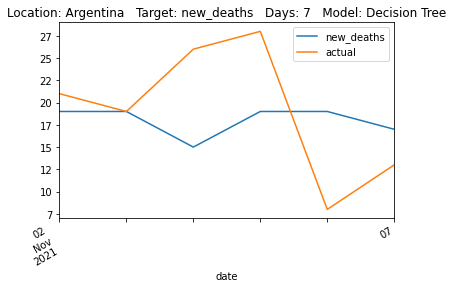

              MSE      RMSE        R2       MAE    RAE      RRSE
models                                                          
lstm         None      None      None      None   None      None
dt           None      None      None      None   None      None
rf      33.913454  5.823526  0.300353  4.229167  0.725  0.836449


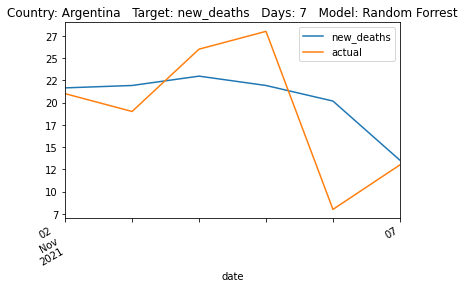

               MSE       RMSE        R2       MAE       RAE      RRSE
models                                                               
lstm          None       None      None      None      None      None
dt      104.153846  10.205579 -0.162462  8.461538  1.111975  1.078175
rf            None       None      None      None      None      None


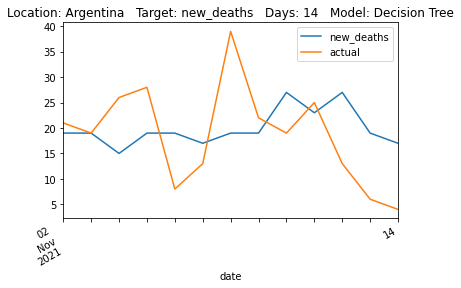

              MSE      RMSE        R2       MAE       RAE      RRSE
models                                                             
lstm         None      None      None      None      None      None
dt           None      None      None      None      None      None
rf      78.945277  8.885115  0.118891  6.927692  0.910404  0.938674


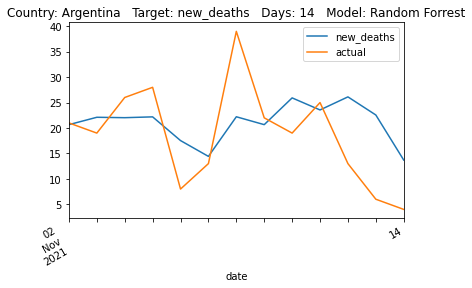

         MSE      RMSE        R2   MAE       RAE      RRSE
models                                                    
lstm    None      None      None  None      None      None
dt      91.1  9.544632  0.152873   7.8  1.002571  0.920395
rf      None      None      None  None      None      None


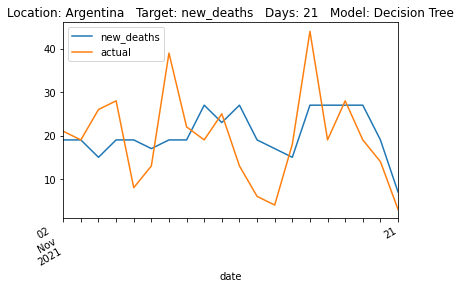

              MSE      RMSE        R2       MAE       RAE      RRSE
models                                                             
lstm         None      None      None      None      None      None
dt           None      None      None      None      None      None
rf      89.321189  9.450989  0.169414  7.709567  0.990947  0.911365


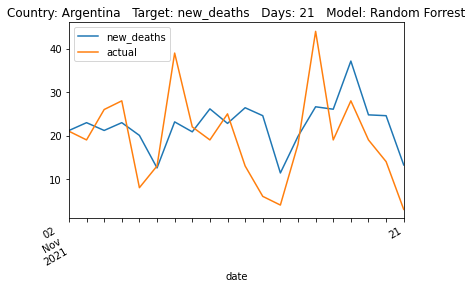

              MSE      RMSE        R2       MAE      RAE      RRSE
models                                                            
lstm         None      None      None      None     None      None
dt      86.592593  9.305514  0.277949  7.555556  0.87931  0.849736
rf           None      None      None      None     None      None


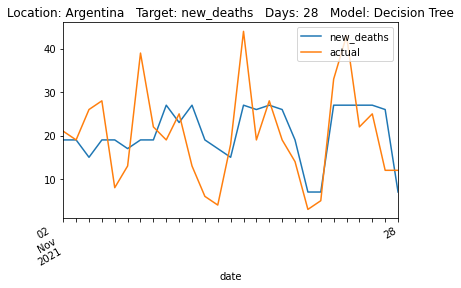

              MSE       RMSE        R2        MAE       RAE      RRSE
models                                                               
lstm         None       None      None       None      None      None
dt           None       None      None       None      None      None
rf      639.60853  25.290483 -4.333363  13.663333  1.590129  2.309408


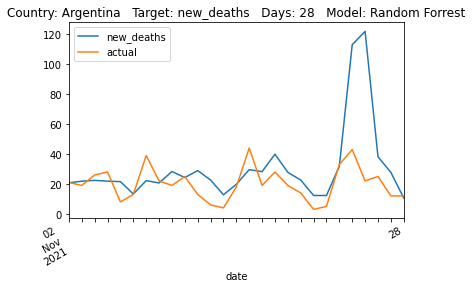

         MSE      RMSE        R2       MAE       RAE      RRSE
models                                                        
lstm    None      None      None      None      None      None
dt      85.0  9.219544  0.290486  7.482759  0.858761  0.842327
rf      None      None      None      None      None      None


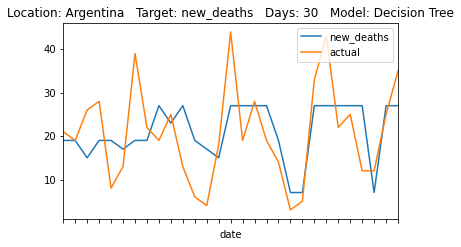

               MSE       RMSE        R2        MAE       RAE      RRSE
models                                                                
lstm          None       None      None       None      None      None
dt            None       None      None       None      None      None
rf      880.778241  29.677908 -6.352058  16.937759  1.943867  2.711468


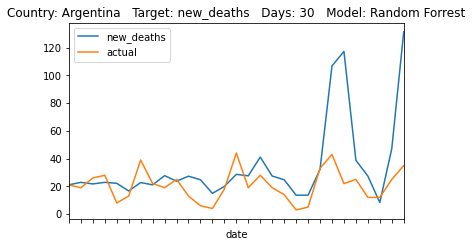

In [122]:
days = [7,14,21,28,30]
for country in set(required_countries):
    for target in ['total_cases','total_deaths','total_vaccinations','people_fully_vaccinated','new_cases','new_deaths']:
        for day in days:
            tree_predict_1(country,target,day)
        



                         MSE            RMSE        R2             MAE  \
models                                                                   
lstm                    None            None      None            None   
dt      1777908850673.166748  1333382.484763 -7.453041  1264687.166667   
rf                      None            None      None            None   

             RAE      RRSE  
models                      
lstm        None      None  
dt      3.126124  2.907411  
rf          None      None  


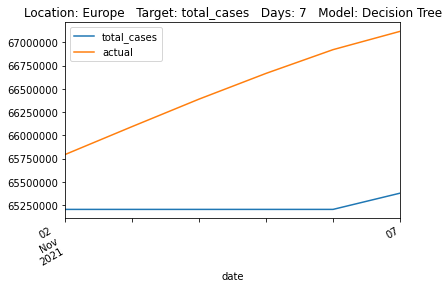

                         MSE            RMSE        R2             MAE  \
models                                                                   
lstm                    None            None      None            None   
dt                      None            None      None            None   
rf      2191596251905.584961  1480404.083994 -9.419911  1416258.591667   

             RAE      RRSE  
models                      
lstm        None      None  
dt          None      None  
rf      3.500787  3.227989  


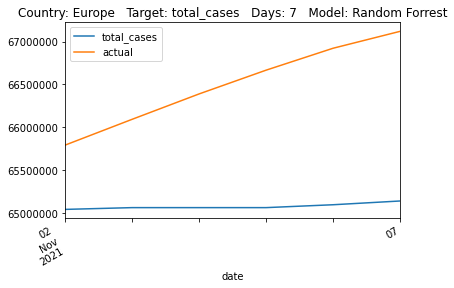

                         MSE            RMSE        R2             MAE  \
models                                                                   
lstm                    None            None      None            None   
dt      6816807540036.461914  2610901.671844 -5.396978  2410642.923077   
rf                      None            None      None            None   

             RAE      RRSE  
models                      
lstm        None      None  
dt      2.701394  2.529225  
rf          None      None  


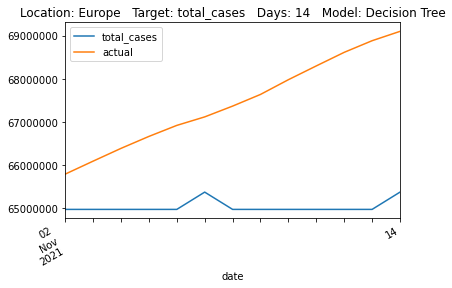

                         MSE            RMSE        R2             MAE  \
models                                                                   
lstm                    None            None      None            None   
dt                      None            None      None            None   
rf      6654718733981.436523  2579674.152675 -5.244872  2365876.031538   

             RAE      RRSE  
models                      
lstm        None      None  
dt          None      None  
rf      2.651227  2.498974  


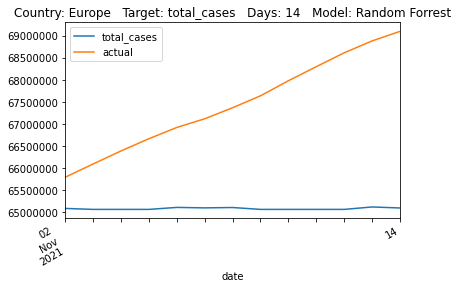

                     MSE            RMSE        R2        MAE       RAE  \
models                                                                    
lstm                None            None      None       None      None   
dt      12608525533989.5  3550848.565342 -3.364637  3117648.8  2.122215   
rf                  None            None      None       None      None   

            RRSE  
models            
lstm        None  
dt      2.089171  
rf          None  


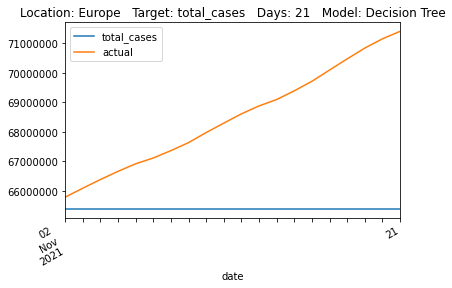

                          MSE            RMSE       R2           MAE  \
models                                                                 
lstm                     None            None     None          None   
dt                       None            None     None          None   
rf      14324043488479.005859  3784711.810492 -3.95849  3380431.5925   

             RAE      RRSE  
models                      
lstm        None      None  
dt          None      None  
rf      2.301093  2.226767  


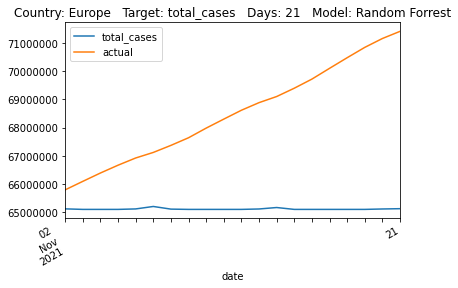

                         MSE            RMSE        R2             MAE  \
models                                                                   
lstm                    None            None      None            None   
dt      27612386133880.40625  5254748.912544 -3.568786  4626146.037037   
rf                      None            None      None            None   

             RAE      RRSE  
models                      
lstm        None      None  
dt      2.172521  2.137472  
rf          None      None  


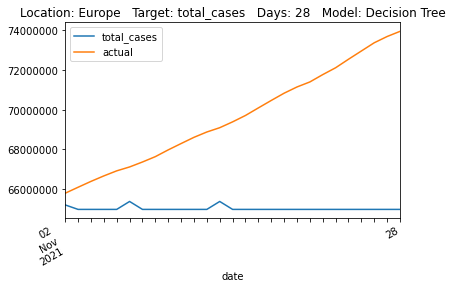

                          MSE            RMSE        R2             MAE  \
models                                                                    
lstm                     None            None      None            None   
dt                       None            None      None            None   
rf      27172502135009.871094  5212725.020084 -3.496002  4594120.562593   

             RAE      RRSE  
models                      
lstm        None      None  
dt          None      None  
rf      2.157482  2.120378  


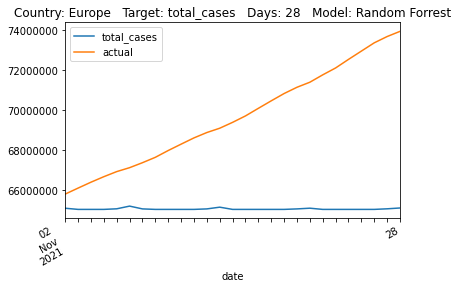

                          MSE            RMSE       R2             MAE  \
models                                                                   
lstm                     None            None     None            None   
dt      31791002283785.964844  5638351.025237 -3.44762  4962376.586207   
rf                       None            None     None            None   

             RAE      RRSE  
models                      
lstm        None      None  
dt      2.134743  2.108938  
rf          None      None  


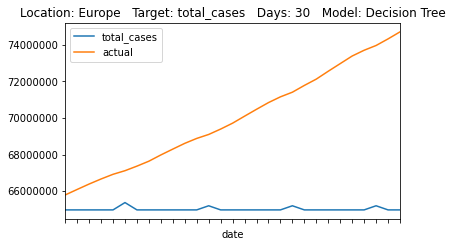

                          MSE            RMSE        R2             MAE  \
models                                                                    
lstm                     None            None      None            None   
dt                       None            None      None            None   
rf      30931210920146.265625  5561583.490351 -3.327333  4874295.013448   

             RAE      RRSE  
models                      
lstm        None      None  
dt          None      None  
rf      2.096852  2.080224  


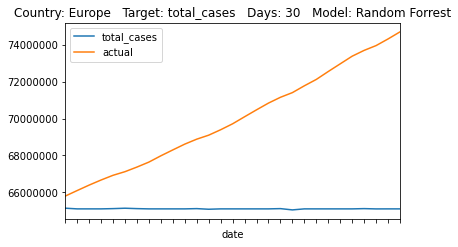

                     MSE          RMSE       R2      MAE       RAE      RRSE
models                                                                      
lstm                None          None     None     None      None      None
dt      295920401.833333  17202.337104 -6.95287  16084.5  2.981464  2.820083
rf                  None          None     None     None      None      None


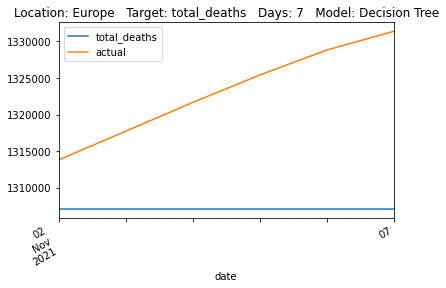

                   MSE          RMSE        R2           MAE       RAE  \
models                                                                   
lstm              None          None      None          None      None   
dt                None          None      None          None      None   
rf      463335672.5711  21525.233392 -11.45216  20774.106667  3.850741   

            RRSE  
models            
lstm        None  
dt          None  
rf      3.528762  


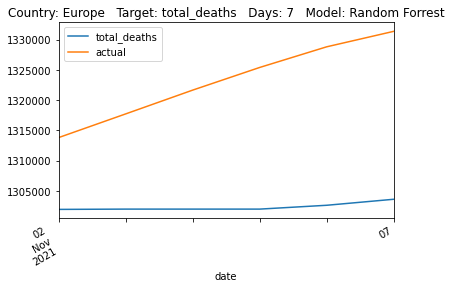

                      MSE          RMSE        R2           MAE       RAE  \
models                                                                      
lstm                 None          None      None          None      None   
dt      1302649164.846154  36092.231364 -5.870956  33516.384615  2.791576   
rf                   None          None      None          None      None   

            RRSE  
models            
lstm        None  
dt      2.621251  
rf          None  


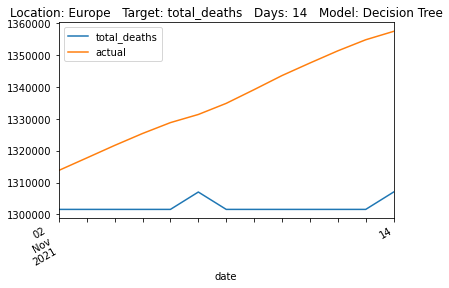

                      MSE          RMSE       R2           MAE       RAE  \
models                                                                     
lstm                 None          None     None          None      None   
dt                   None          None     None          None      None   
rf      1295477946.413547  35992.748525 -5.83313  33318.054615  2.775057   

            RRSE  
models            
lstm        None  
dt          None  
rf      2.614026  


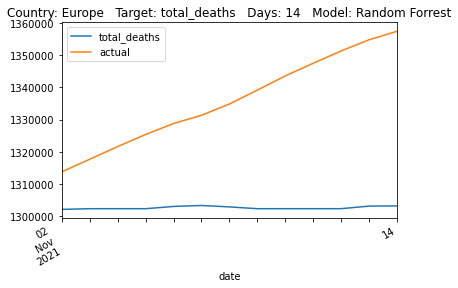

                 MSE          RMSE       R2      MAE       RAE      RRSE
models                                                                  
lstm            None          None     None     None      None      None
dt      2423080406.3  49224.794629 -4.14388  44245.1  2.353162  2.268012
rf              None          None     None     None      None      None


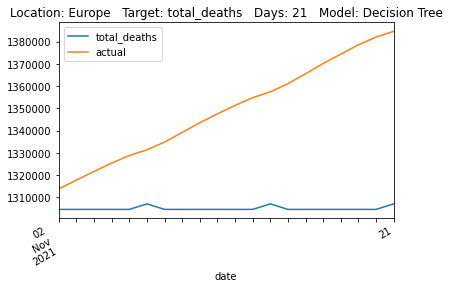

                      MSE          RMSE        R2        MAE       RAE  \
models                                                                   
lstm                 None          None      None       None      None   
dt                   None          None      None       None      None   
rf      2600825107.316325  50998.285337 -4.521208  46162.538  2.455141   

            RRSE  
models            
lstm        None  
dt          None  
rf      2.349725  


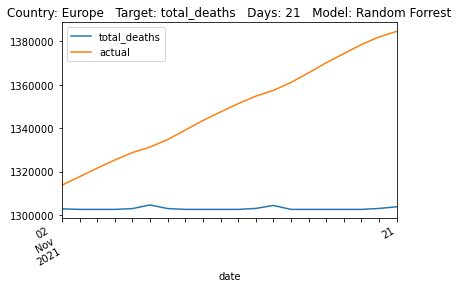

                      MSE          RMSE        R2           MAE       RAE  \
models                                                                      
lstm                 None          None      None          None      None   
dt      4203537191.740741  64834.691267 -3.769899  57687.666667  2.236158   
rf                   None          None      None          None      None   

           RRSE  
models           
lstm       None  
dt      2.18401  
rf         None  


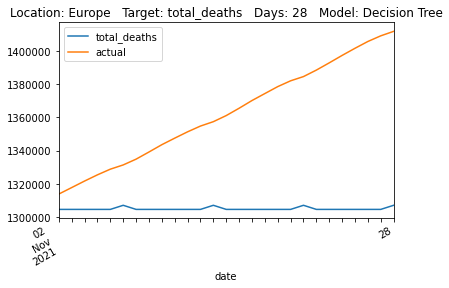

                      MSE          RMSE        R2          MAE       RAE  \
models                                                                     
lstm                 None          None      None         None      None   
dt                   None          None      None         None      None   
rf      4355206068.615565  65993.985094 -3.942002  58935.07037  2.284511   

            RRSE  
models            
lstm        None  
dt          None  
rf      2.223062  


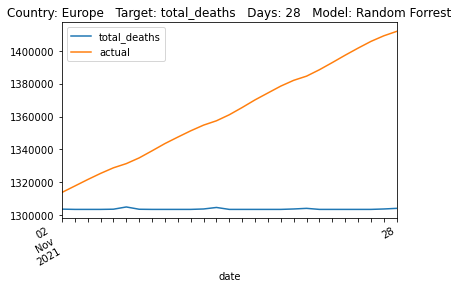

                      MSE          RMSE        R2           MAE       RAE  \
models                                                                      
lstm                 None          None      None          None      None   
dt      4544135446.275862  67410.202835 -3.468769  59390.827586  2.139368   
rf                   None          None      None          None      None   

            RRSE  
models            
lstm        None  
dt      2.113946  
rf          None  


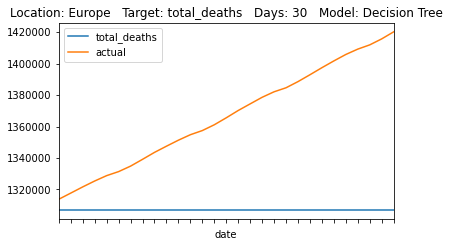

                      MSE         RMSE        R2           MAE       RAE  \
models                                                                     
lstm                 None         None      None          None      None   
dt                   None         None      None          None      None   
rf      5093408432.464698  71368.11916 -4.008933  63850.436897  2.300011   

            RRSE  
models            
lstm        None  
dt          None  
rf      2.238064  


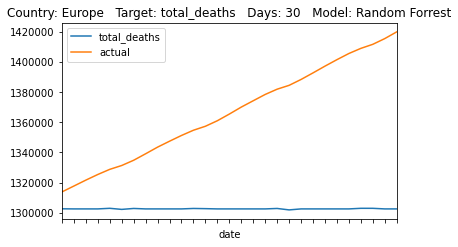

                          MSE             RMSE         R2              MAE  \
models                                                                       
lstm                     None             None       None             None   
dt      213116745904194.34375  14598518.620195 -10.703469  14128310.333333   
rf                       None             None       None             None   

            RAE      RRSE  
models                     
lstm       None      None  
dt      3.86814  3.421033  
rf         None      None  


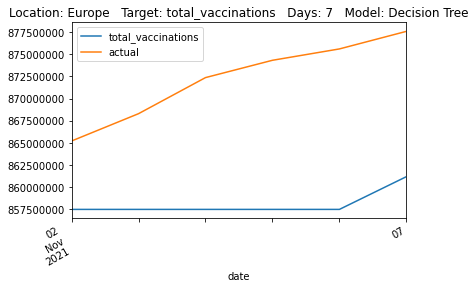

                          MSE             RMSE        R2              MAE  \
models                                                                      
lstm                     None             None      None             None   
dt                       None             None      None             None   
rf      205786981673198.59375  14345277.329951 -10.30095  13704003.488333   

            RAE      RRSE  
models                     
lstm       None      None  
dt         None      None  
rf      3.75197  3.361689  


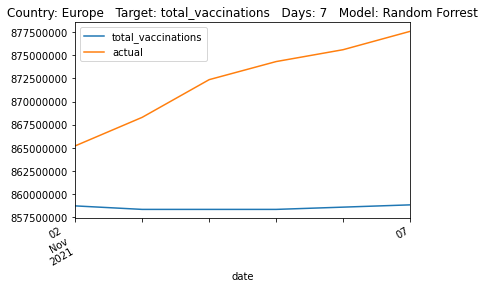

                        MSE             RMSE        R2              MAE  \
models                                                                    
lstm                   None             None      None             None   
dt      550818459968549.625  23469521.937367 -4.713165  21379697.461538   
rf                     None             None      None             None   

             RAE      RRSE  
models                      
lstm        None      None  
dt      2.502661  2.390223  
rf          None      None  


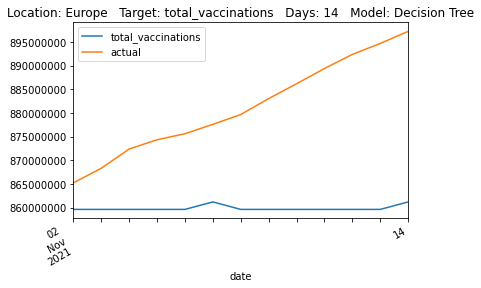

                      MSE             RMSE        R2              MAE  \
models                                                                  
lstm                 None             None      None             None   
dt                   None             None      None             None   
rf      611406733726093.5  24726640.162507 -5.341595  22711578.041538   

             RAE      RRSE  
models                      
lstm        None      None  
dt          None      None  
rf      2.658568  2.518252  


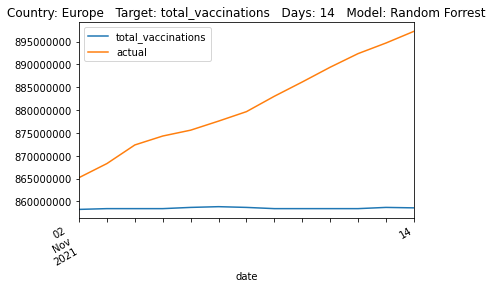

                       MSE             RMSE        R2          MAE       RAE  \
models                                                                         
lstm                  None             None      None         None      None   
dt      1274037767154314.5  35693665.644681 -3.639318  31658240.85  2.208438   
rf                    None             None      None         None      None   

            RRSE  
models            
lstm        None  
dt      2.153908  
rf          None  


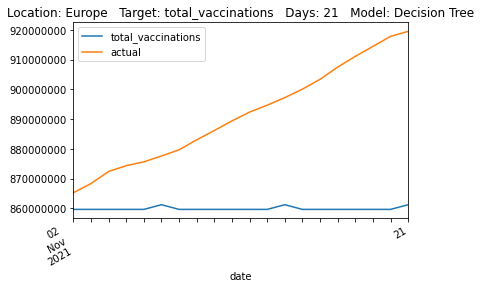

                       MSE             RMSE        R2            MAE  \
models                                                                 
lstm                  None             None      None           None   
dt                    None             None      None           None   
rf      1366550031631131.5  36966877.493658 -3.976195  33058730.8375   

             RAE      RRSE  
models                      
lstm        None      None  
dt          None      None  
rf      2.306134  2.230739  


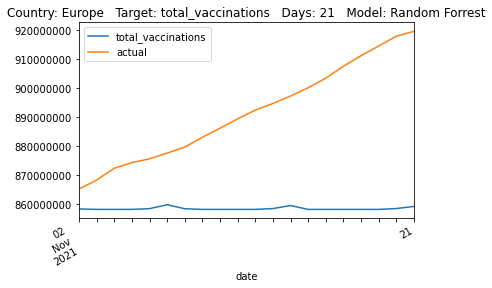

                       MSE             RMSE        R2              MAE  \
models                                                                   
lstm                  None             None      None             None   
dt      2308475734042516.5  48046599.609572 -2.976148  41567953.555556   
rf                    None             None      None             None   

             RAE      RRSE  
models                      
lstm        None      None  
dt      1.986592  1.994028  
rf          None      None  


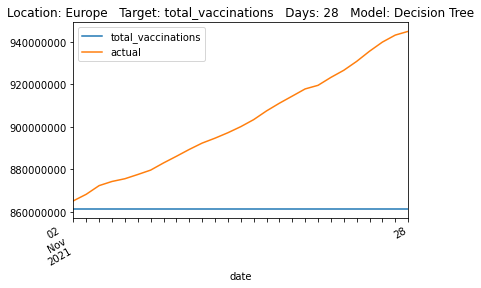

                       MSE             RMSE        R2              MAE  \
models                                                                   
lstm                  None             None      None             None   
dt                    None             None      None             None   
rf      2521100697728522.5  50210563.606959 -3.342376  44081261.397037   

             RAE      RRSE  
models                      
lstm        None      None  
dt          None      None  
rf      2.106706  2.083837  


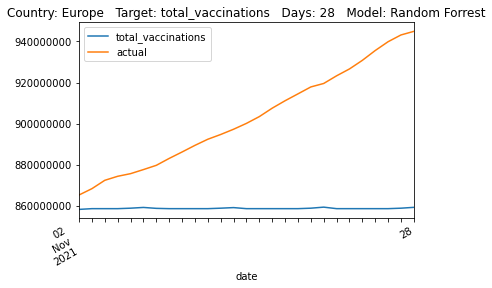

                       MSE             RMSE        R2              MAE  \
models                                                                   
lstm                  None             None      None             None   
dt      2703073210170272.5  51991087.795605 -2.924015  44880053.862069   
rf                    None             None      None             None   

             RAE      RRSE  
models                      
lstm        None      None  
dt      1.963036  1.980913  
rf          None      None  


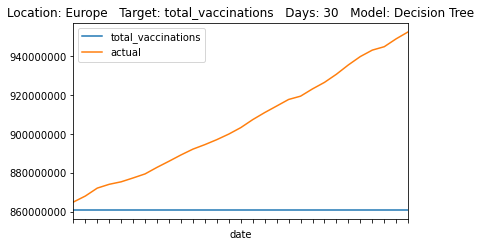

                       MSE             RMSE        R2              MAE  \
models                                                                   
lstm                  None             None      None             None   
dt                    None             None      None             None   
rf      3028568790805831.0  55032433.989474 -3.396532  48375377.834483   

            RAE      RRSE  
models                     
lstm       None      None  
dt         None      None  
rf      2.11592  2.096791  


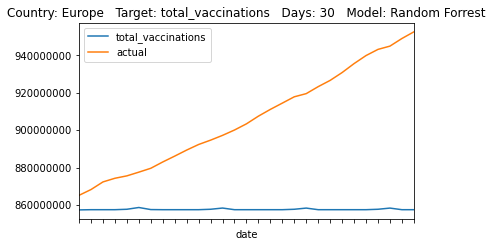

                     MSE            RMSE        R2             MAE       RAE  \
models                                                                         
lstm                None            None      None            None      None   
dt      17152399331606.5  4141545.524512 -8.476624  3865225.833333  3.287561   
rf                  None            None      None            None      None   

            RRSE  
models            
lstm        None  
dt      3.078413  
rf          None  


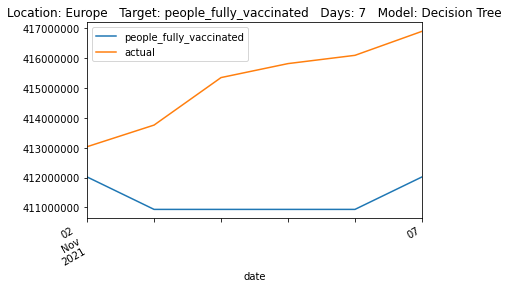

                          MSE            RMSE        R2          MAE  \
models                                                                 
lstm                     None            None      None         None   
dt                       None            None      None         None   
rf      17062231618276.523438  4130645.423935 -8.426806  3941650.955   

             RAE     RRSE  
models                     
lstm        None     None  
dt          None     None  
rf      3.352564  3.07031  


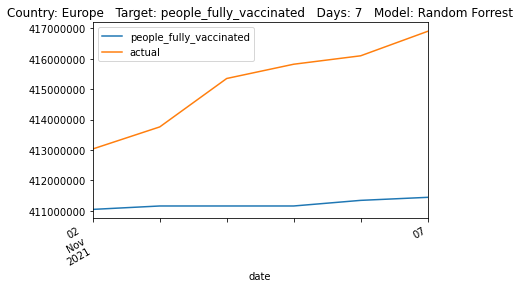

                          MSE            RMSE        R2             MAE  \
models                                                                    
lstm                     None            None      None            None   
dt      42077879197620.539062  6486746.426185 -5.327001  5974622.846154   
rf                       None            None      None            None   

             RAE      RRSE  
models                      
lstm        None      None  
dt      2.728663  2.515353  
rf          None      None  


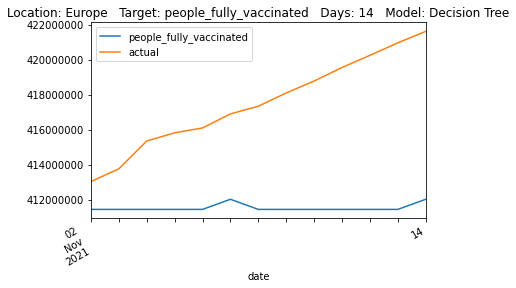

                       MSE            RMSE       R2             MAE       RAE  \
models                                                                          
lstm                  None            None     None            None      None   
dt                    None            None     None            None      None   
rf      50326585273475.375  7094123.291392 -6.56731  6621069.219231  3.023901   

            RRSE  
models            
lstm        None  
dt          None  
rf      2.750874  


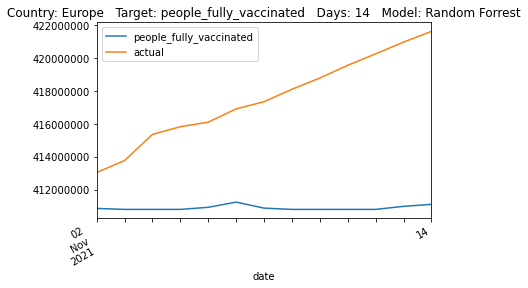

                          MSE            RMSE        R2        MAE       RAE  \
models                                                                         
lstm                     None            None      None       None      None   
dt      84095228599046.796875  9170345.064339 -3.602606  8113199.7  2.216948   
rf                       None            None      None       None      None   

            RRSE  
models            
lstm        None  
dt      2.145369  
rf          None  


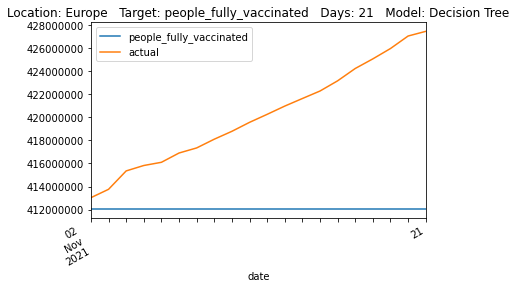

                          MSE            RMSE        R2           MAE  \
models                                                                  
lstm                     None            None      None          None   
dt                       None            None      None          None   
rf      99953736136189.203125  9997686.539204 -4.470556  9035934.0495   

             RAE      RRSE  
models                      
lstm        None      None  
dt          None      None  
rf      2.469087  2.338922  


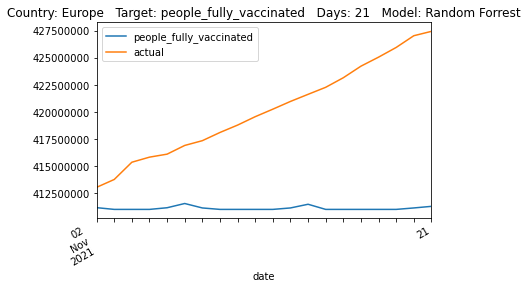

                          MSE             RMSE        R2              MAE  \
models                                                                      
lstm                     None             None      None             None   
dt      179047494169806.03125  13380862.982999 -3.892622  11891265.296296   
rf                       None             None      None             None   

             RAE      RRSE  
models                      
lstm        None      None  
dt      2.258006  2.211927  
rf          None      None  


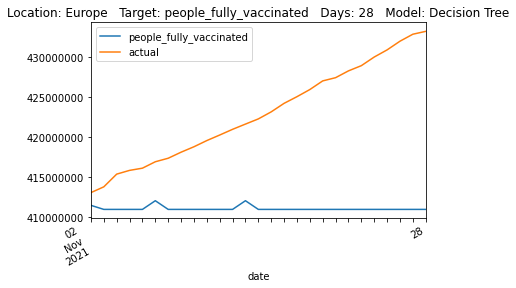

                        MSE             RMSE        R2              MAE  \
models                                                                    
lstm                   None             None      None             None   
dt                     None             None      None             None   
rf      177281011557243.125  13314691.568236 -3.844351  11868156.518148   

             RAE      RRSE  
models                      
lstm        None      None  
dt          None      None  
rf      2.253618  2.200989  


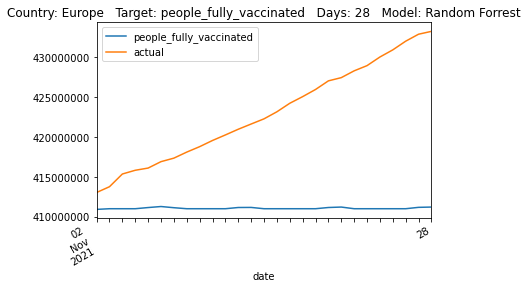

                        MSE            RMSE        R2              MAE  \
models                                                                   
lstm                   None            None      None             None   
dt      203053506746444.125  14249684.44375 -3.715915  12655955.931034   
rf                     None            None      None             None   

             RAE      RRSE  
models                      
lstm        None      None  
dt      2.208412  2.171616  
rf          None      None  


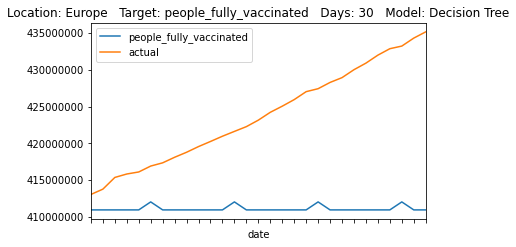

                         MSE           RMSE        R2              MAE  \
models                                                                   
lstm                    None           None      None             None   
dt                      None           None      None             None   
rf      203063323055194.8125  14250028.8791 -3.716143  12639494.515517   

            RAE      RRSE  
models                     
lstm       None      None  
dt         None      None  
rf      2.20554  2.171668  


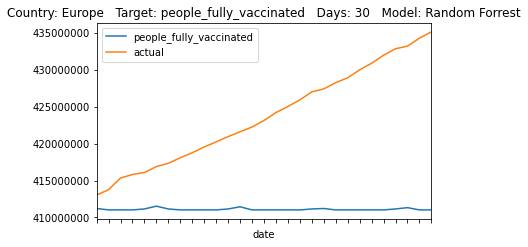

                     MSE          RMSE        R2      MAE       RAE      RRSE
models                                                                       
lstm                None          None      None     None      None      None
dt      778306388.166667  27898.143095  0.453913  25199.5  0.763918  0.738977
rf                  None          None      None     None      None      None


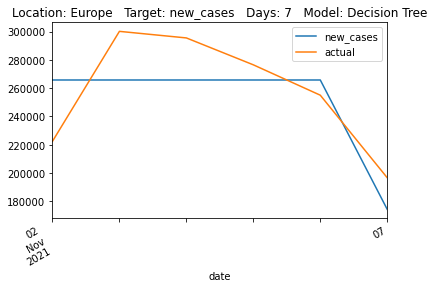

                     MSE          RMSE        R2           MAE       RAE  \
models                                                                     
lstm                None          None      None          None      None   
dt                  None          None      None          None      None   
rf      977750648.260733  31269.004593  0.313975  26800.343333  0.812448   

            RRSE  
models            
lstm        None  
dt          None  
rf      0.828266  


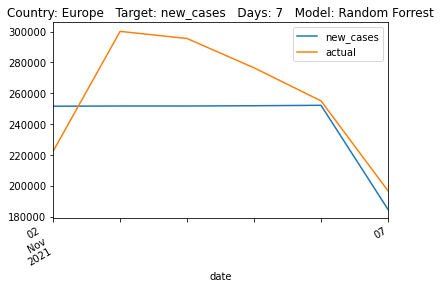

                      MSE         RMSE        R2      MAE       RAE      RRSE
models                                                                       
lstm                 None         None      None     None      None      None
dt      1347061192.615385  36702.33225  0.206967  30244.0  0.897792  0.890524
rf                   None         None      None     None      None      None


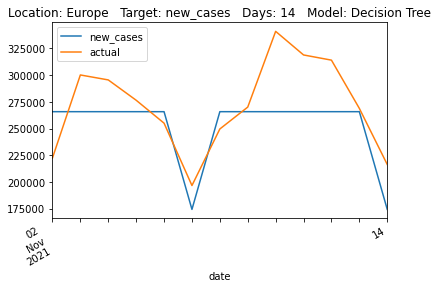

                    MSE          RMSE       R2       MAE       RAE      RRSE
models                                                                      
lstm               None          None     None      None      None      None
dt                 None          None     None      None      None      None
rf      1816606172.8693  42621.663188 -0.06946  33983.77  1.008807  1.034147


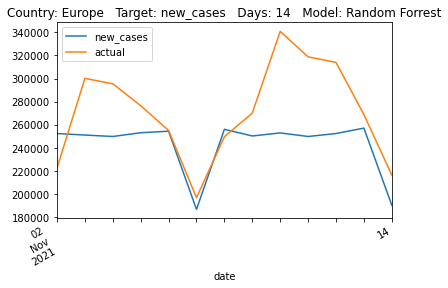

                  MSE          RMSE        R2       MAE       RAE      RRSE
models                                                                     
lstm             None          None      None      None      None      None
dt      3274722088.85  57225.187539 -0.282347  46540.75  1.120124  1.132407
rf               None          None      None      None      None      None


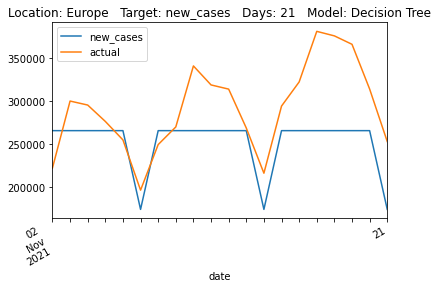

                     MSE          RMSE        R2       MAE       RAE      RRSE
models                                                                        
lstm                None          None      None      None      None      None
dt                  None          None      None      None      None      None
rf      4051833298.86096  63654.012433 -0.586655  51267.55  1.233887  1.259625


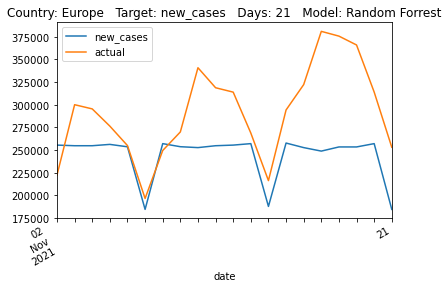

                      MSE          RMSE        R2           MAE       RAE  \
models                                                                      
lstm                 None          None      None          None      None   
dt      5982674658.555555  77347.751477 -0.588634  62833.222222  1.252964   
rf                   None          None      None          None      None   

           RRSE  
models           
lstm       None  
dt      1.26041  
rf         None  


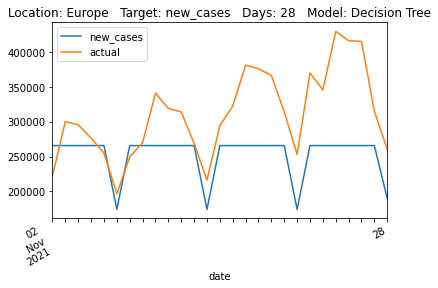

                      MSE          RMSE        R2           MAE       RAE  \
models                                                                      
lstm                 None          None      None          None      None   
dt                   None          None      None          None      None   
rf      8035274680.703978  89639.693667 -1.133679  73398.996296  1.463657   

            RRSE  
models            
lstm        None  
dt          None  
rf      1.460712  


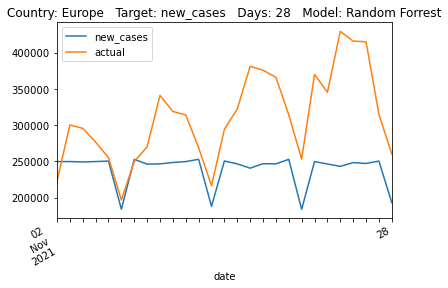

                      MSE          RMSE        R2           MAE       RAE  \
models                                                                      
lstm                 None          None      None          None      None   
dt      6359109329.344828  79744.023785 -0.691007  65824.241379  1.301303   
rf                   None          None      None          None      None   

            RRSE  
models            
lstm        None  
dt      1.300387  
rf          None  


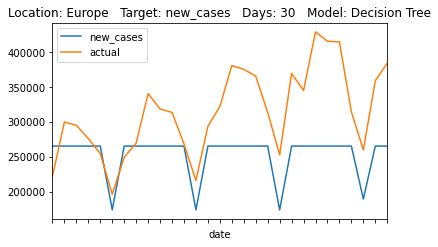

                      MSE         RMSE        R2           MAE       RAE  \
models                                                                     
lstm                 None         None      None          None      None   
dt                   None         None      None          None      None   
rf      8157570683.268826  90319.27083 -1.169252  75168.900345  1.486041   

            RRSE  
models            
lstm        None  
dt          None  
rf      1.472838  


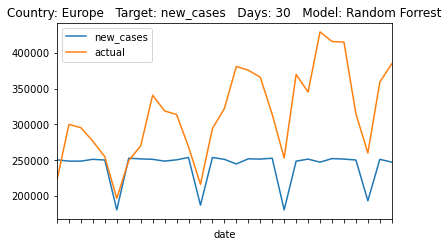

                  MSE        RMSE        R2    MAE       RAE     RRSE
models                                                               
lstm             None        None      None   None      None     None
dt      217207.166667  466.054897  0.076324  379.5  0.975021  0.96108
rf               None        None      None   None      None     None


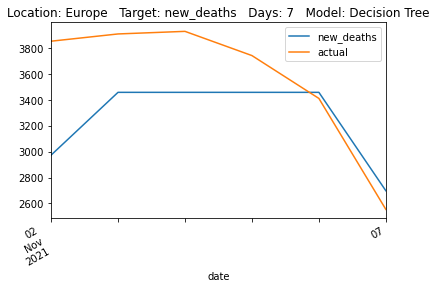

                 MSE        RMSE        R2         MAE       RAE      RRSE
models                                                                    
lstm            None        None      None        None      None      None
dt              None        None      None        None      None      None
rf      189047.99298  434.796496  0.196071  365.389444  0.938768  0.896621


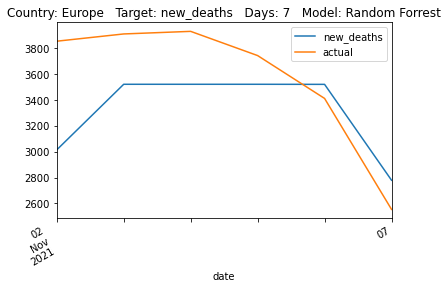

                  MSE        RMSE        R2         MAE       RAE      RRSE
models                                                                     
lstm             None        None      None        None      None      None
dt      261814.692308  511.678309  0.070587  407.153846  0.981471  0.964061
rf               None        None      None        None      None      None


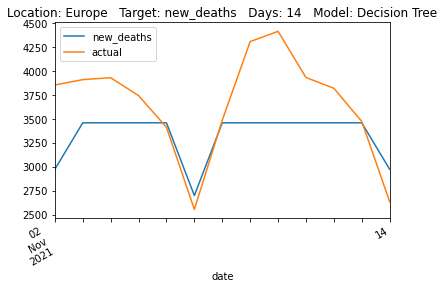

                  MSE        RMSE        R2         MAE       RAE      RRSE
models                                                                     
lstm             None        None      None        None      None      None
dt               None        None      None        None      None      None
rf      223342.626623  472.591395  0.207159  381.276154  0.919092  0.890416


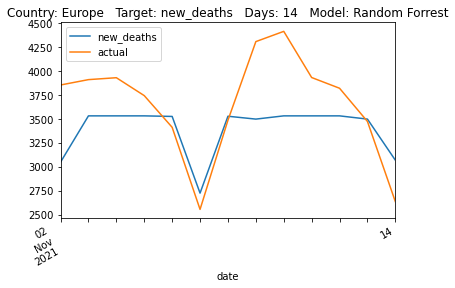

              MSE        RMSE        R2     MAE       RAE      RRSE
models                                                             
lstm         None        None      None    None      None      None
dt      384484.55  620.068182 -0.108713  503.55  1.101715  1.052954
rf           None        None      None    None      None      None


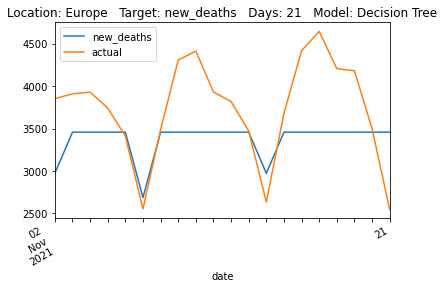

                  MSE        RMSE        R2      MAE       RAE      RRSE
models                                                                  
lstm             None        None      None     None      None      None
dt               None        None      None     None      None      None
rf      322119.559661  567.555777  0.071125  460.621  1.007791  0.963781


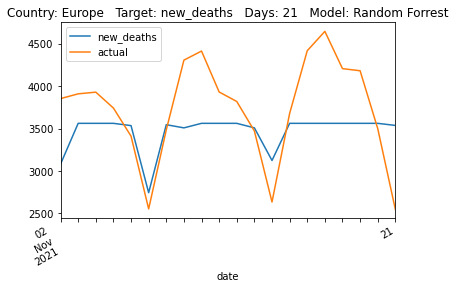

                  MSE        RMSE        R2         MAE       RAE      RRSE
models                                                                     
lstm             None        None      None        None      None      None
dt      424497.259259  651.534542 -0.203895  546.222222  1.155062  1.097222
rf               None        None      None        None      None      None


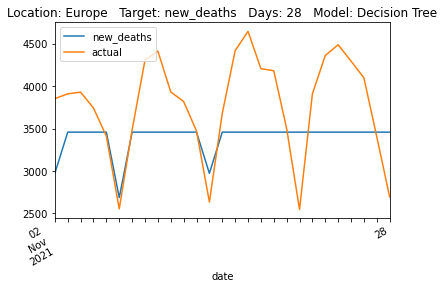

                  MSE        RMSE       R2         MAE       RAE      RRSE
models                                                                    
lstm             None        None     None        None      None      None
dt               None        None     None        None      None      None
rf      353491.696034  594.551677 -0.00252  497.233704  1.051469  1.001259


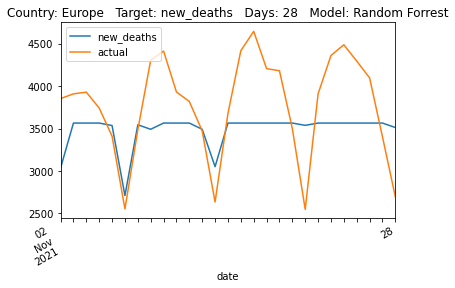

                  MSE        RMSE        R2         MAE       RAE      RRSE
models                                                                     
lstm             None        None      None        None      None      None
dt      434686.034483  659.307238 -0.261562  555.206897  1.208727  1.123193
rf               None        None      None        None      None      None


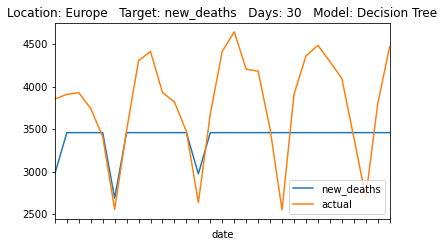

                  MSE        RMSE        R2         MAE       RAE      RRSE
models                                                                     
lstm             None        None      None        None      None      None
dt               None        None      None        None      None      None
rf      366809.621821  605.648101 -0.064569  508.904253  1.107923  1.031779


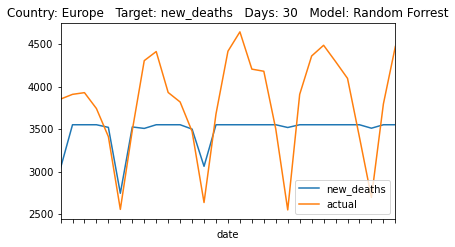

                     MSE          RMSE        R2           MAE       RAE  \
models                                                                     
lstm                None          None      None          None      None   
dt      720165734.833333  26835.903839 -7.884326  24960.833333  2.968171   
rf                  None          None      None          None      None   

            RRSE  
models            
lstm        None  
dt      2.980659  
rf          None  


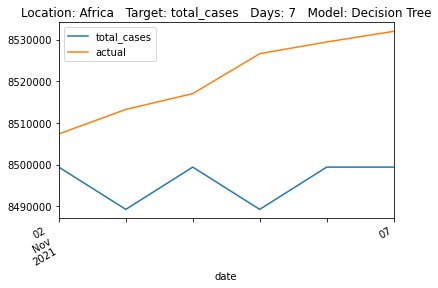

                     MSE          RMSE        R2           MAE       RAE  \
models                                                                     
lstm                None          None      None          None      None   
dt                  None          None      None          None      None   
rf      805458860.956927  28380.607128 -8.936545  27100.921667  3.222656   

            RRSE  
models            
lstm        None  
dt          None  
rf      3.152229  


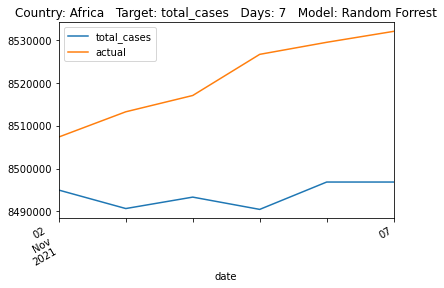

                      MSE          RMSE        R2           MAE       RAE  \
models                                                                      
lstm                 None          None      None          None      None   
dt      1623741977.076923  40295.681866 -5.008817  36790.153846  2.612478   
rf                   None          None      None          None      None   

            RRSE  
models            
lstm        None  
dt      2.451289  
rf          None  


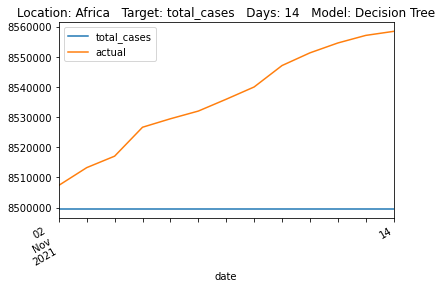

                      MSE          RMSE       R2           MAE       RAE  \
models                                                                     
lstm                 None          None     None          None      None   
dt                   None          None     None          None      None   
rf      1960823270.751331  44281.184162 -6.25622  41204.247692  2.925924   

            RRSE  
models            
lstm        None  
dt          None  
rf      2.693737  


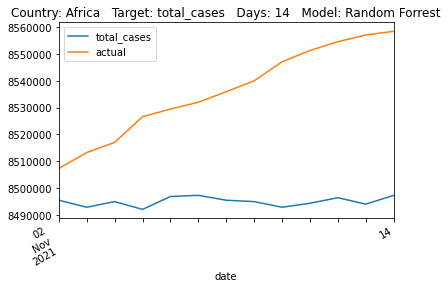

                 MSE         RMSE        R2      MAE       RAE      RRSE
models                                                                  
lstm            None         None      None     None      None      None
dt      3322301867.6  57639.41245 -5.550486  53633.7  2.763391  2.559392
rf              None         None      None     None      None      None


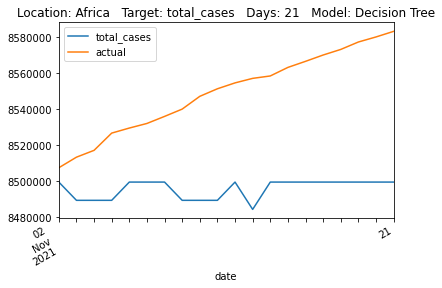

                     MSE          RMSE        R2        MAE       RAE  \
models                                                                  
lstm                None          None      None       None      None   
dt                  None          None      None       None      None   
rf      3434058361.46314  58600.839256 -5.770833  54375.632  2.801618   

            RRSE  
models            
lstm        None  
dt          None  
rf      2.602082  


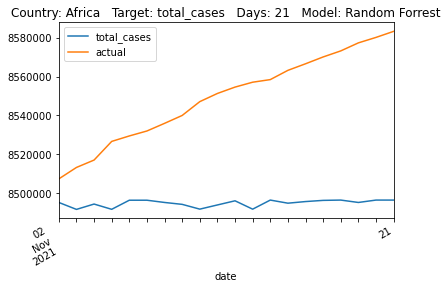

                      MSE          RMSE        R2           MAE       RAE  \
models                                                                      
lstm                 None          None      None          None      None   
dt      6281556123.925926  79256.268673 -3.664552  71198.296296  2.372702   
rf                   None          None      None          None      None   

            RRSE  
models            
lstm        None  
dt      2.159757  
rf          None  


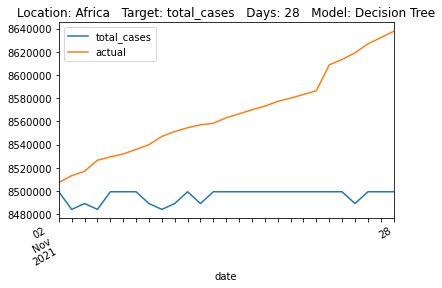

                      MSE         RMSE        R2           MAE      RAE  \
models                                                                    
lstm                 None         None      None          None     None   
dt                   None         None      None          None     None   
rf      6616967757.175533  81344.74634 -3.913622  72564.764815  2.41824   

            RRSE  
models            
lstm        None  
dt          None  
rf      2.216669  


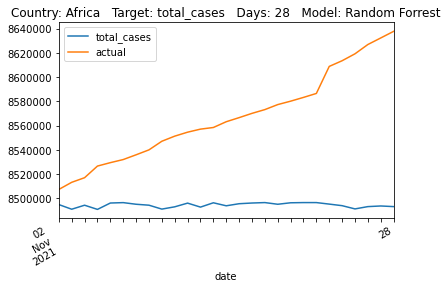

                 MSE          RMSE        R2           MAE       RAE      RRSE
models                                                                        
lstm            None          None      None          None      None      None
dt      7844289672.0  88567.994626 -3.666467  77098.689655  2.272747  2.160201
rf              None          None      None          None      None      None


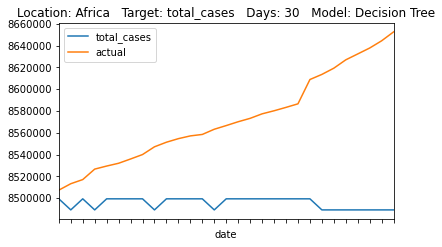

                      MSE          RMSE        R2           MAE       RAE  \
models                                                                      
lstm                 None          None      None          None      None   
dt                   None          None      None          None      None   
rf      7619127837.588707  87287.615603 -3.532521  77018.533448  2.270385   

            RRSE  
models            
lstm        None  
dt          None  
rf      2.128972  


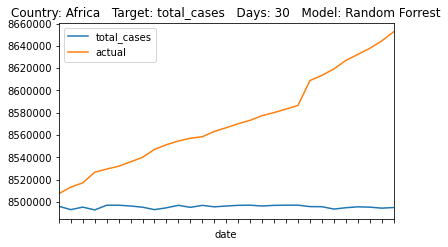

                  MSE        RMSE        R2    MAE       RAE      RRSE
models                                                                
lstm             None        None      None   None      None      None
dt      781949.166667  884.278896 -6.415853  822.5  2.824843  2.723206
rf               None        None      None   None      None      None


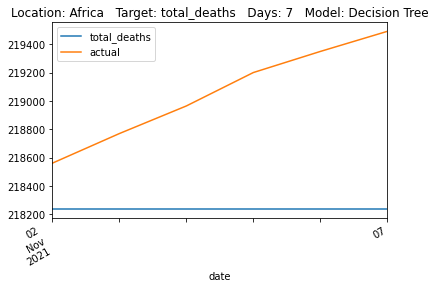

                   MSE         RMSE        R2         MAE       RAE      RRSE
models                                                                       
lstm              None         None      None        None      None      None
dt                None         None      None        None      None      None
rf      1035154.775183  1017.425562 -8.817205  969.748333  3.330561  3.133242


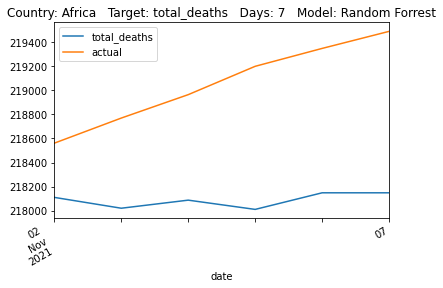

              MSE         RMSE        R2          MAE       RAE      RRSE
models                                                                   
lstm         None         None      None         None      None      None
dt      3357114.0  1832.242888 -5.666548  1691.538462  2.790119  2.581966
rf           None         None      None         None      None      None


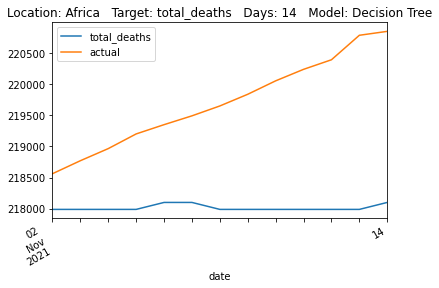

                   MSE         RMSE        R2          MAE       RAE      RRSE
models                                                                        
lstm              None         None      None         None      None      None
dt                None         None      None         None      None      None
rf      3238609.774708  1799.613785 -5.431222  1657.056923  2.733243  2.535985


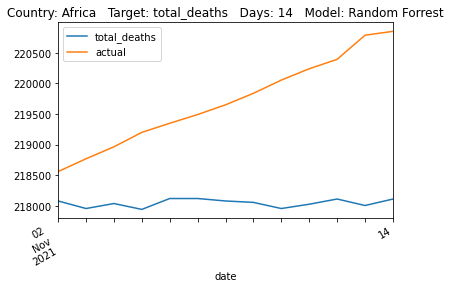

              MSE         RMSE        R2     MAE       RAE      RRSE
models                                                              
lstm         None         None      None    None      None      None
dt      5433762.1  2331.043136 -5.196238  2151.2  2.611821  2.489224
rf           None         None      None    None      None      None


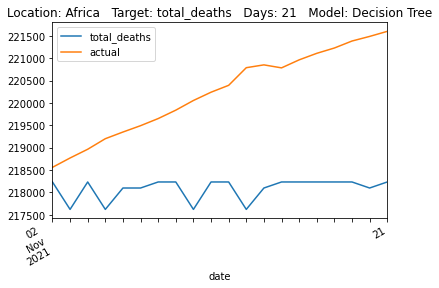

                 MSE         RMSE        R2      MAE       RAE      RRSE
models                                                                  
lstm            None         None      None     None      None      None
dt              None         None      None     None      None      None
rf      5499860.8548  2345.178214 -5.271612  2161.32  2.624108  2.504319


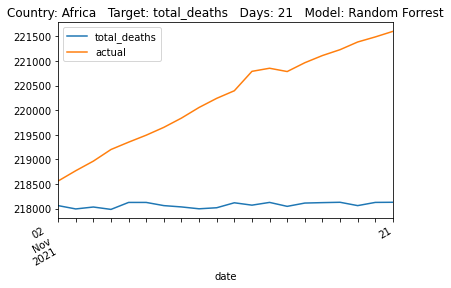

                   MSE         RMSE        R2          MAE       RAE      RRSE
models                                                                        
lstm              None         None      None         None      None      None
dt      7710545.740741  2776.786946 -4.466023  2509.962963  2.479549  2.337953
rf                None         None      None         None      None      None


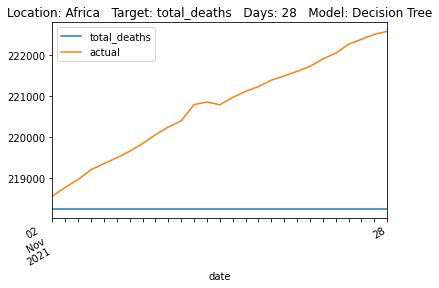

                   MSE         RMSE        R2          MAE       RAE      RRSE
models                                                                        
lstm              None         None      None         None      None      None
dt                None         None      None         None      None      None
rf      8335834.069826  2887.184454 -4.909292  2637.523333  2.605563  2.430903


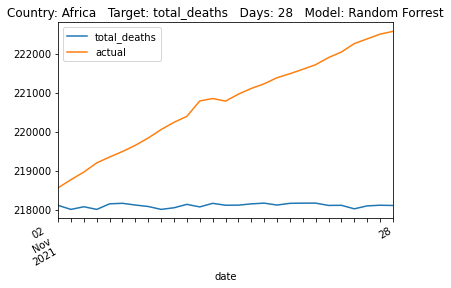

                   MSE         RMSE        R2          MAE       RAE     RRSE
models                                                                       
lstm              None         None      None         None      None     None
dt      9476776.103448  3078.437283 -4.969079  2844.862069  2.666692  2.44317
rf                None         None      None         None      None     None


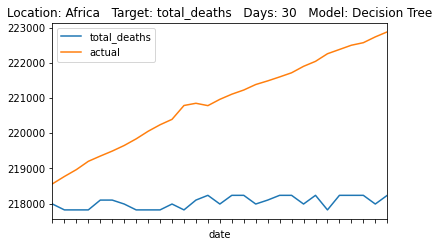

                   MSE         RMSE        R2          MAE       RAE      RRSE
models                                                                        
lstm              None         None      None         None      None      None
dt                None         None      None         None      None      None
rf      9325547.382145  3053.775922 -4.873826  2783.707586  2.609367  2.423598


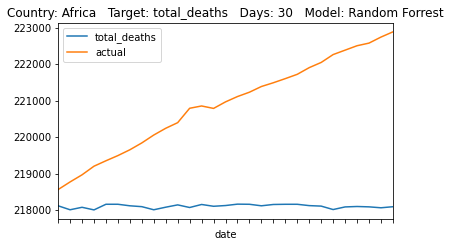

                     MSE            RMSE        R2        MAE       RAE  \
models                                                                    
lstm                None            None      None       None      None   
dt      40092417326758.5  6331857.336261 -6.179964  5874392.5  2.991204   
rf                  None            None      None       None      None   

            RRSE  
models            
lstm        None  
dt      2.679545  
rf          None  


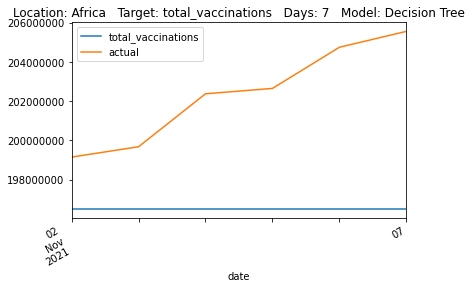

                        MSE            RMSE        R2         MAE       RAE  \
models                                                                        
lstm                   None            None      None        None      None   
dt                     None            None      None        None      None   
rf      70908149474255.6875  8420697.683343 -11.69861  8183845.77  4.167164   

            RRSE  
models            
lstm        None  
dt          None  
rf      3.563511  


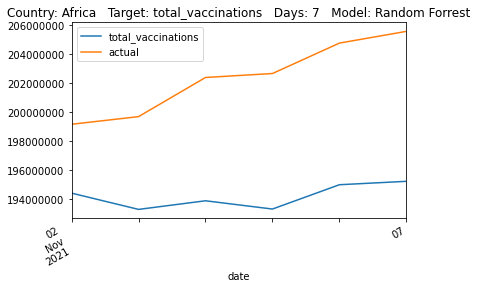

                          MSE             RMSE        R2              MAE  \
models                                                                      
lstm                     None             None      None             None   
dt      156301913214620.53125  12502076.356135 -3.634997  11071576.076923   
rf                       None             None      None             None   

            RAE      RRSE  
models                     
lstm       None      None  
dt      2.13318  2.152904  
rf         None      None  


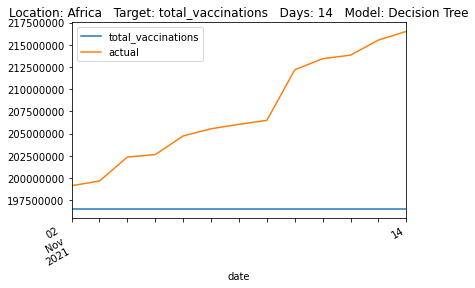

                          MSE             RMSE        R2          MAE  \
models                                                                  
lstm                     None             None      None         None   
dt                       None             None      None         None   
rf      210254430228173.46875  14500152.765684 -5.234912  13333995.17   

             RAE      RRSE  
models                      
lstm        None      None  
dt          None      None  
rf      2.569085  2.496981  


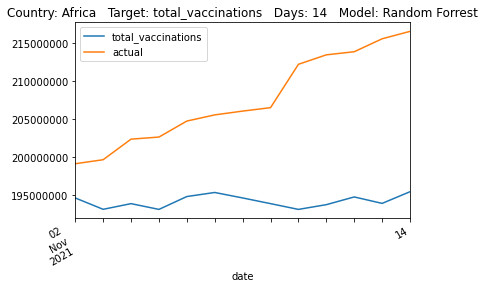

                        MSE             RMSE        R2          MAE       RAE  \
models                                                                          
lstm                   None             None      None         None      None   
dt      400331087784662.375  20008275.482526 -4.428359  18448688.65  2.476965   
rf                     None             None      None         None      None   

            RRSE  
models            
lstm        None  
dt      2.329884  
rf          None  


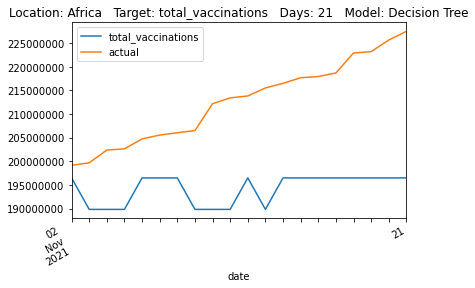

                      MSE             RMSE        R2           MAE       RAE  \
models                                                                         
lstm                 None             None      None          None      None   
dt                   None             None      None          None      None   
rf      397141475728974.5  19928408.760585 -4.385108  18160767.826  2.438308   

            RRSE  
models            
lstm        None  
dt          None  
rf      2.320584  


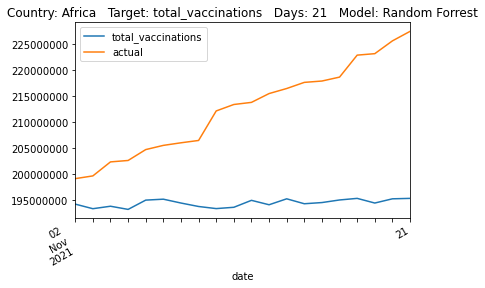

                      MSE             RMSE        R2              MAE  \
models                                                                  
lstm                 None             None      None             None   
dt      610681477256564.5  24711970.323237 -3.242411  21604043.333333   
rf                   None             None      None             None   

             RAE      RRSE  
models                      
lstm        None      None  
dt      2.121872  2.059711  
rf          None      None  


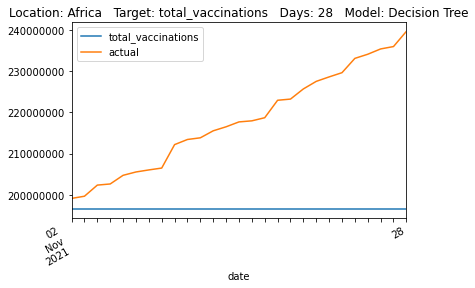

                      MSE             RMSE        R2              MAE  \
models                                                                  
lstm                 None             None      None             None   
dt                   None             None      None             None   
rf      702422361293124.5  26503251.900345 -3.879736  23718699.113333   

             RAE      RRSE  
models                      
lstm        None      None  
dt          None      None  
rf      2.329566  2.209013  


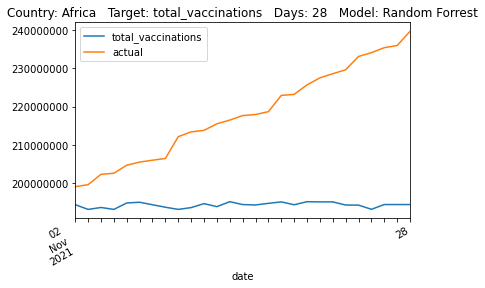

                        MSE             RMSE        R2              MAE  \
models                                                                    
lstm                   None             None      None             None   
dt      706024714422226.125  26571125.576878 -3.199763  23192975.344828   
rf                     None             None      None             None   

             RAE      RRSE  
models                      
lstm        None      None  
dt      2.072676  2.049332  
rf          None      None  


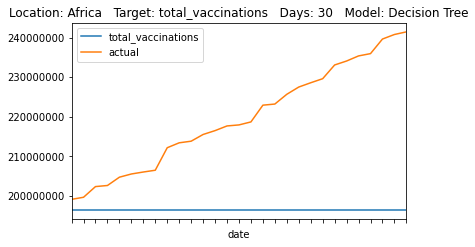

                        MSE             RMSE        R2              MAE  \
models                                                                    
lstm                   None             None      None             None   
dt                     None             None      None             None   
rf      802268897978317.625  28324351.677988 -3.772268  25203047.188621   

             RAE      RRSE  
models                      
lstm        None      None  
dt          None      None  
rf      2.252309  2.184552  


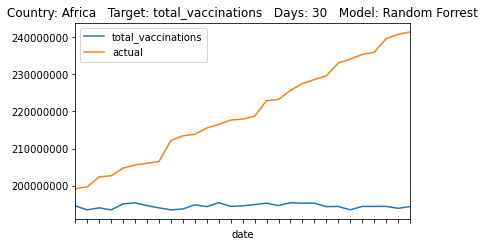

                         MSE            RMSE        R2        MAE       RAE  \
models                                                                        
lstm                    None            None      None       None      None   
dt      7410595375524.166992  2722240.873899 -7.849103  2563816.5  3.342442   
rf                      None            None      None       None      None   

            RRSE  
models            
lstm        None  
dt      2.974744  
rf          None  


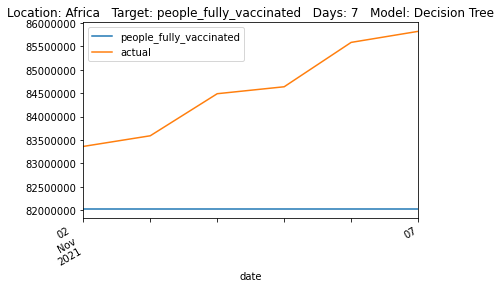

                          MSE            RMSE         R2             MAE  \
models                                                                     
lstm                     None            None       None            None   
dt                       None            None       None            None   
rf      13495419051171.880859  3673611.173106 -15.115081  3597221.666667   

             RAE      RRSE  
models                      
lstm        None      None  
dt          None      None  
rf      4.689691  4.014359  


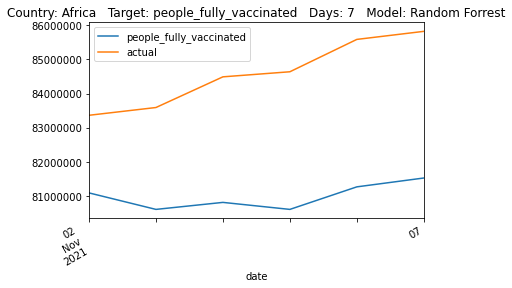

                          MSE            RMSE        R2             MAE  \
models                                                                    
lstm                     None            None      None            None   
dt      41863053413309.695312  6470166.413108 -5.918799  5994598.307692   
rf                       None            None      None            None   

             RAE      RRSE  
models                      
lstm        None      None  
dt      2.737063  2.630361  
rf          None      None  


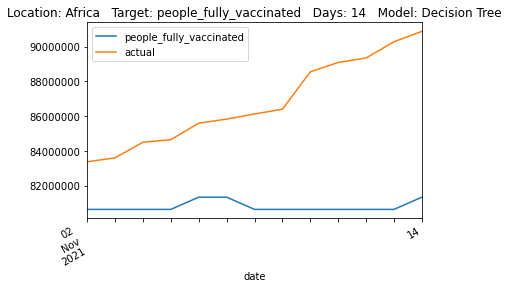

                          MSE            RMSE        R2         MAE       RAE  \
models                                                                          
lstm                     None            None      None        None      None   
dt                       None            None      None        None      None   
rf      39196761017599.632812  6260731.667912 -5.478135  5771933.82  2.635397   

            RRSE  
models            
lstm        None  
dt          None  
rf      2.545218  


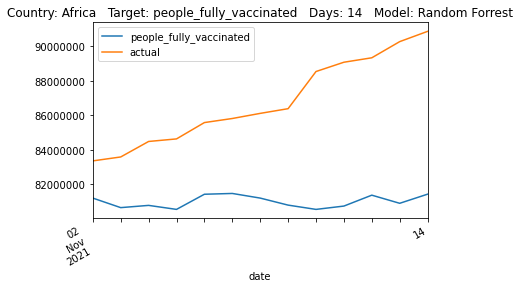

                     MSE            RMSE        R2        MAE       RAE  \
models                                                                    
lstm                None            None      None       None      None   
dt      75246070009174.0  8674449.262586 -4.200393  7935326.3  2.390404   
rf                  None            None      None       None      None   

            RRSE  
models            
lstm        None  
dt      2.280437  
rf          None  


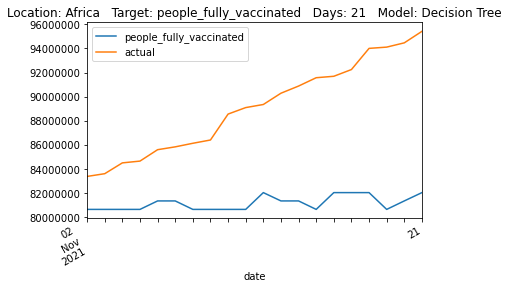

                        MSE           RMSE        R2           MAE       RAE  \
models                                                                         
lstm                   None           None      None          None      None   
dt                     None           None      None          None      None   
rf      78710181709262.5625  8871875.88446 -4.439804  8097802.5315  2.439347   

            RRSE  
models            
lstm        None  
dt          None  
rf      2.332339  


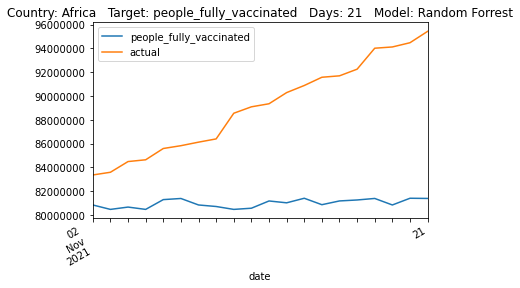

                        MSE             RMSE        R2              MAE  \
models                                                                    
lstm                   None             None      None             None   
dt      130797090678517.375  11436655.572261 -4.001344  10267712.925926   
rf                     None             None      None             None   

             RAE      RRSE  
models                      
lstm        None      None  
dt      2.316565  2.236369  
rf          None      None  


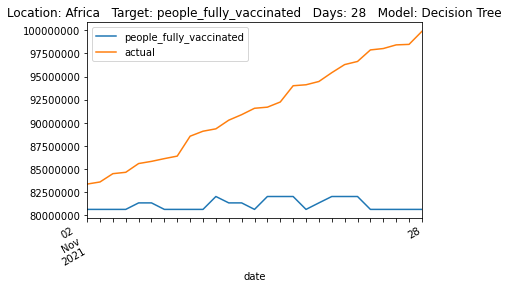

                          MSE             RMSE       R2              MAE  \
models                                                                     
lstm                     None             None     None             None   
dt                       None             None     None             None   
rf      131023727222094.96875  11446559.623839 -4.01001  10306001.853704   

             RAE      RRSE  
models                      
lstm        None      None  
dt          None      None  
rf      2.325204  2.238305  


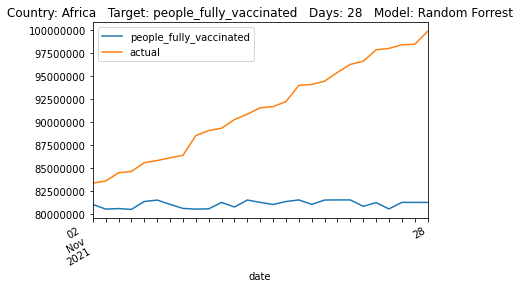

                           MSE             RMSE        R2             MAE  \
models                                                                      
lstm                      None             None      None            None   
dt      129687029338646.890625  11388021.309194 -3.359446  9996925.310345   
rf                        None             None      None            None   

             RAE      RRSE  
models                      
lstm        None      None  
dt      2.106029  2.087929  
rf          None      None  


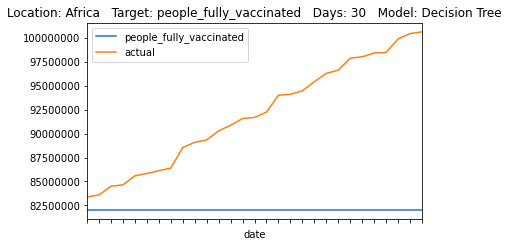

                         MSE             RMSE        R2              MAE  \
models                                                                     
lstm                    None             None      None             None   
dt                      None             None      None             None   
rf      151028236754824.4375  12289354.610997 -4.076833  11022072.092069   

             RAE      RRSE  
models                      
lstm        None      None  
dt          None      None  
rf      2.321995  2.253183  


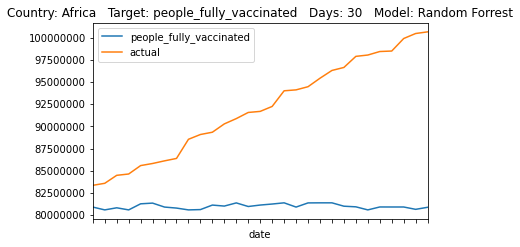

                   MSE         RMSE        R2     MAE       RAE      RRSE
models                                                                   
lstm              None         None      None    None      None      None
dt      4030539.333333  2007.620316  0.308024  1631.0  0.821203  0.831851
rf                None         None      None    None      None      None


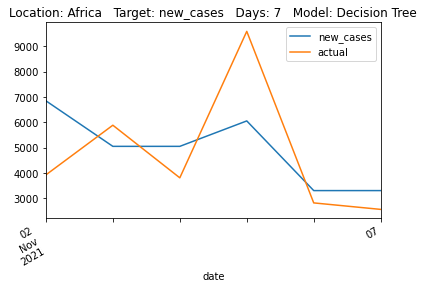

                   MSE         RMSE        R2          MAE       RAE      RRSE
models                                                                        
lstm              None         None      None         None      None      None
dt                None         None      None         None      None      None
rf      3796157.956233  1948.373156  0.348264  1427.346667  0.718664  0.807302


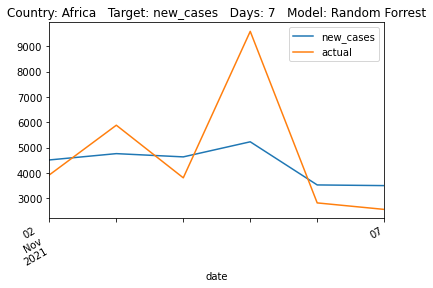

                    MSE         RMSE      R2          MAE       RAE      RRSE
models                                                                       
lstm               None         None    None         None      None      None
dt      13619039.153846  3690.398238 -2.0928  2407.923077  1.581734  1.758636
rf                 None         None    None         None      None      None


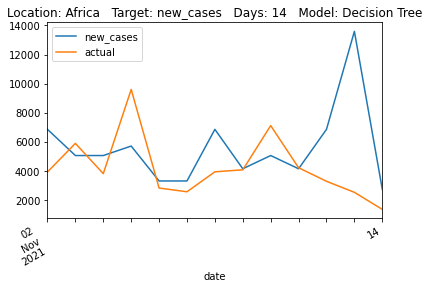

                   MSE         RMSE        R2          MAE       RAE      RRSE
models                                                                        
lstm              None         None      None         None      None      None
dt                None         None      None         None      None      None
rf      7629552.428374  2762.164446 -0.732625  1821.584615  1.196576  1.316292


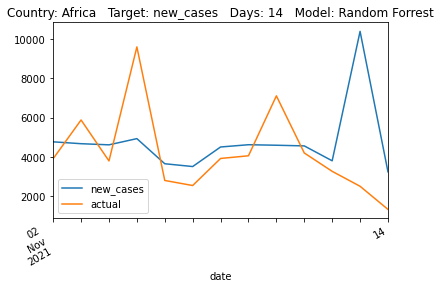

              MSE         RMSE        R2     MAE       RAE      RRSE
models                                                              
lstm         None         None      None    None      None      None
dt      9474659.7  3078.093517 -2.048993  1895.2  1.604144  1.746136
rf           None         None      None    None      None      None


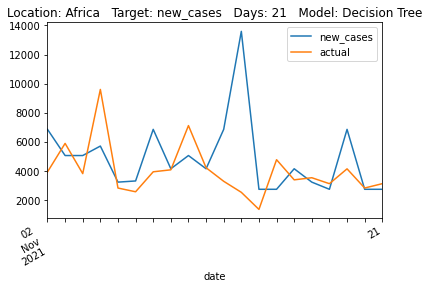

                  MSE         RMSE        R2          MAE      RAE      RRSE
models                                                                      
lstm             None         None      None         None     None      None
dt               None         None      None         None     None      None
rf      5066217.86857  2250.826041 -0.630334  1373.164233  1.16228  1.276845


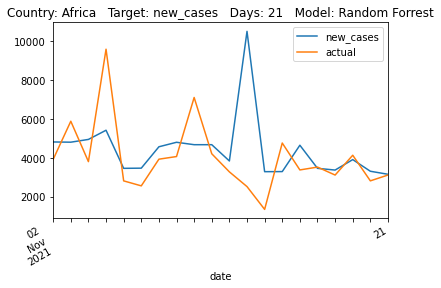

                  MSE         RMSE        R2          MAE       RAE     RRSE
models                                                                      
lstm             None         None      None         None      None     None
dt      5461278.37037  2336.937819 -0.810263  1714.814815  1.308674  1.34546
rf               None         None      None         None      None     None


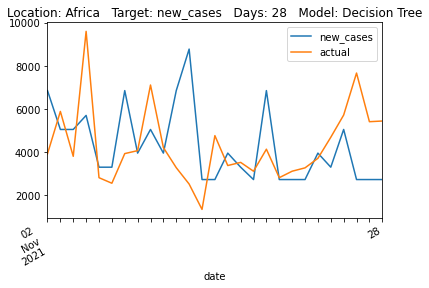

                   MSE         RMSE        R2         MAE       RAE      RRSE
models                                                                       
lstm              None         None      None        None      None      None
dt                None         None      None        None      None      None
rf      4818779.866722  2195.171945 -0.597293  1450.95209  1.107305  1.263841


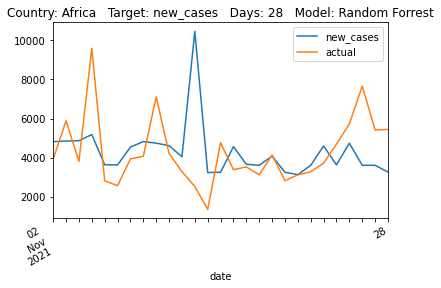

                   MSE         RMSE        R2          MAE       RAE     RRSE
models                                                                       
lstm              None         None      None         None      None     None
dt      8800819.793103  2966.617568 -1.532903  1943.862069  1.307322  1.59151
rf                None         None      None         None      None     None


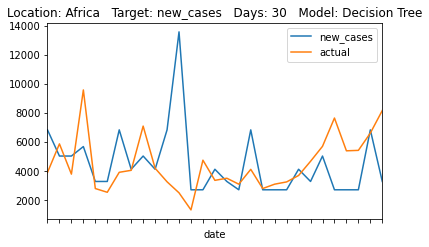

                   MSE         RMSE       R2          MAE      RAE      RRSE
models                                                                      
lstm              None         None     None         None     None      None
dt                None         None     None         None     None      None
rf      5087472.031084  2255.542514 -0.46419  1558.111126  1.04789  1.210037


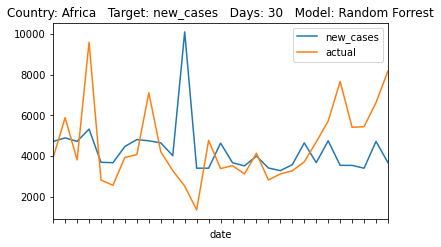

               MSE       RMSE       R2   MAE       RAE      RRSE
models                                                          
lstm          None       None     None  None      None      None
dt      753.333333  27.446918  0.33085  25.0  0.819672  0.818016
rf            None       None     None  None      None      None


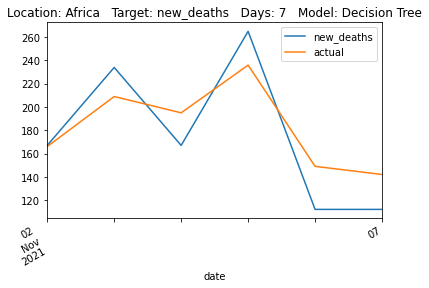

              MSE       RMSE        R2        MAE       RAE      RRSE
models                                                               
lstm         None       None      None       None      None      None
dt           None       None      None       None      None      None
rf      992.37739  31.502022  0.118518  24.011287  0.787255  0.938873


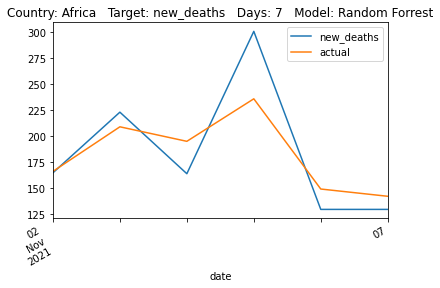

                MSE       RMSE        R2        MAE       RAE      RRSE
models                                                                 
lstm           None       None      None       None      None      None
dt      7034.538462  83.872155 -0.349703  48.692308  1.036398  1.161767
rf             None       None      None       None      None      None


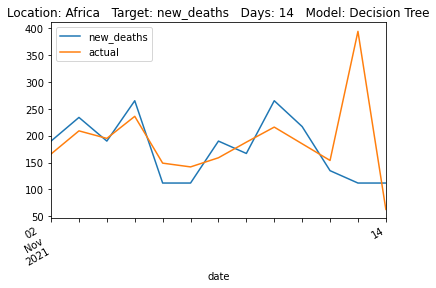

                MSE       RMSE        R2        MAE       RAE      RRSE
models                                                                 
lstm           None       None      None       None      None      None
dt             None       None      None       None      None      None
rf      6331.740501  79.572234 -0.214858  43.201543  0.919529  1.102206


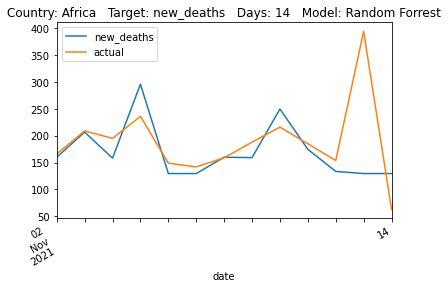

            MSE       RMSE       R2    MAE       RAE      RRSE
models                                                        
lstm       None       None     None   None      None      None
dt      8224.55  90.689305 -0.19309  49.45  0.940561  1.092287
rf         None       None     None   None      None      None


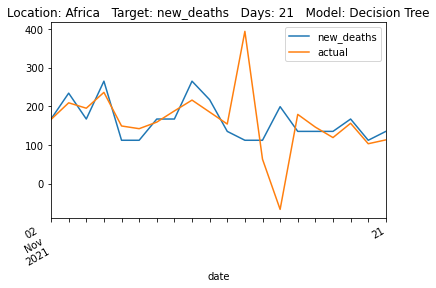

                MSE       RMSE        R2        MAE       RAE      RRSE
models                                                                 
lstm           None       None      None       None      None      None
dt             None       None      None       None      None      None
rf      7717.726253  87.850591 -0.119568  47.846049  0.910053  1.058096


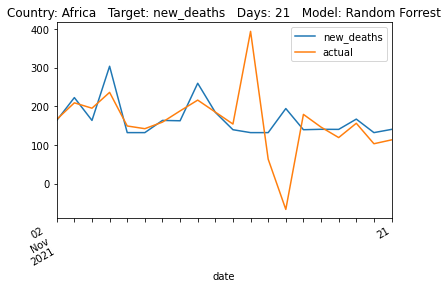

                MSE       RMSE        R2        MAE       RAE      RRSE
models                                                                 
lstm           None       None      None       None      None      None
dt      8471.489712  92.040696 -0.488517  56.617284  1.140166  1.220048
rf             None       None      None       None      None      None


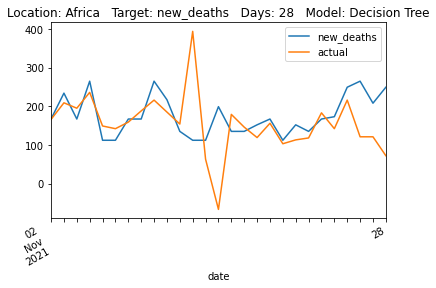

                MSE       RMSE        R2        MAE       RAE      RRSE
models                                                                 
lstm           None       None      None       None      None      None
dt             None       None      None       None      None      None
rf      7231.765273  85.039786 -0.270686  51.181684  1.030703  1.127247


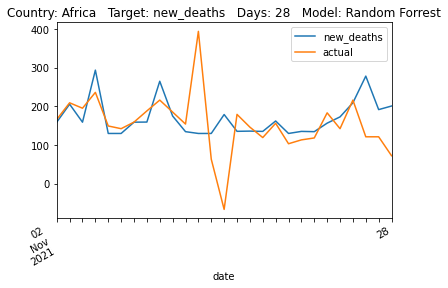

                 MSE        RMSE        R2        MAE       RAE      RRSE
models                                                                   
lstm            None        None      None       None      None      None
dt      10600.076628  102.956674 -0.997335  67.747126  1.441756  1.413271
rf              None        None      None       None      None      None


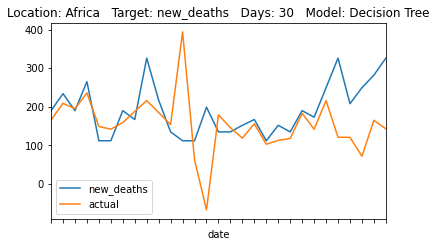

                MSE       RMSE        R2       MAE       RAE      RRSE
models                                                                
lstm           None       None      None      None      None      None
dt             None       None      None      None      None      None
rf      7060.131399  84.024588 -0.330315  51.83031  1.103024  1.153393


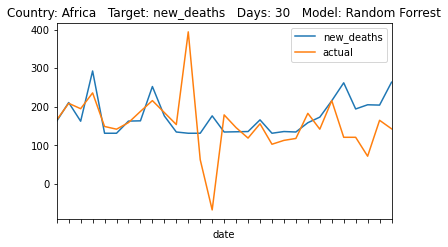

                        MSE           RMSE        R2            MAE       RAE  \
models                                                                          
lstm                   None           None      None           None      None   
dt      278881892170.833313  528092.692783 -9.163525  511341.166667  3.510596   
rf                     None           None      None           None      None   

            RRSE  
models            
lstm        None  
dt      3.188028  
rf          None  


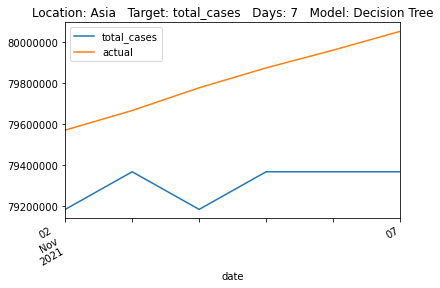

                       MSE           RMSE         R2            MAE       RAE  \
models                                                                          
lstm                  None           None       None           None      None   
dt                    None           None       None           None      None   
rf      377564774478.72345  614462.996834 -12.759908  595234.553333  4.086564   

            RRSE  
models            
lstm        None  
dt          None  
rf      3.709435  


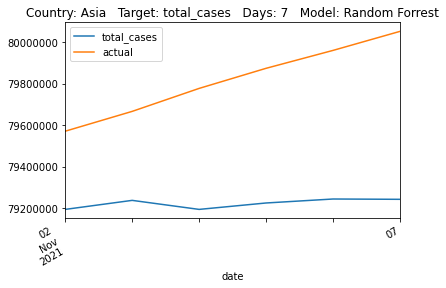

                        MSE           RMSE        R2            MAE       RAE  \
models                                                                          
lstm                   None           None      None           None      None   
dt      730799277397.153809  854867.988287 -4.896832  779017.615385  2.560466   
rf                     None           None      None           None      None   

            RRSE  
models            
lstm        None  
dt      2.428339  
rf          None  


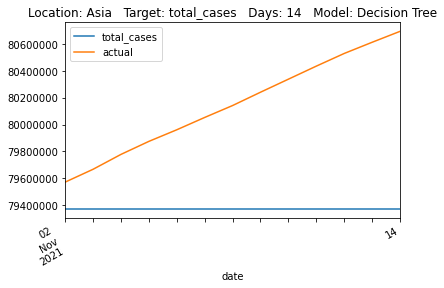

                         MSE            RMSE        R2            MAE  \
models                                                                  
lstm                    None            None      None           None   
dt                      None            None      None           None   
rf      1017639596234.414673  1008781.243003 -7.211351  947211.280769   

             RAE      RRSE  
models                      
lstm        None      None  
dt          None      None  
rf      3.113283  2.865546  


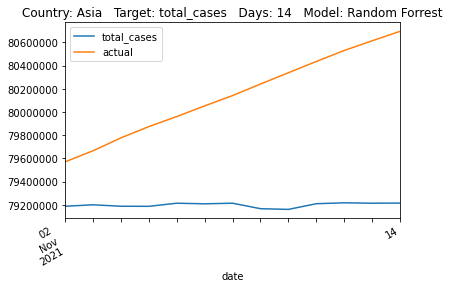

                         MSE            RMSE        R2         MAE       RAE  \
models                                                                         
lstm                    None            None      None        None      None   
dt      1472665214655.449951  1213534.183555 -4.339825  1094018.35  2.404112   
rf                      None            None      None        None      None   

            RRSE  
models            
lstm        None  
dt      2.310806  
rf          None  


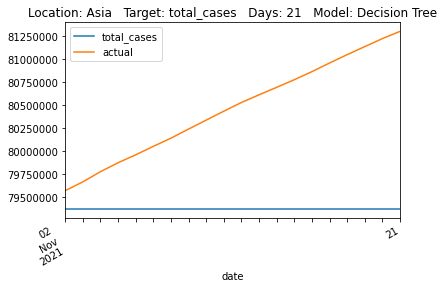

                         MSE            RMSE        R2          MAE       RAE  \
models                                                                          
lstm                    None            None      None         None      None   
dt                      None            None      None         None      None   
rf      1816790954734.629395  1347883.880286 -5.587611  1248864.432  2.744388   

            RRSE  
models            
lstm        None  
dt          None  
rf      2.566634  


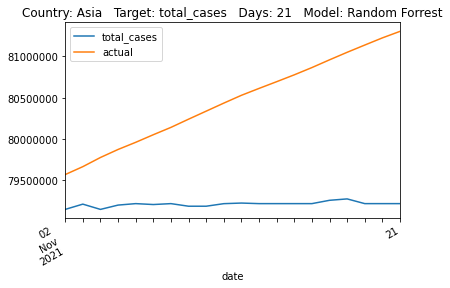

                         MSE            RMSE        R2             MAE  \
models                                                                   
lstm                    None            None      None            None   
dt      2579914385642.555664  1606211.189614 -4.173182  1440626.925926   
rf                      None            None      None            None   

             RAE      RRSE  
models                      
lstm        None      None  
dt      2.370331  2.274463  
rf          None      None  


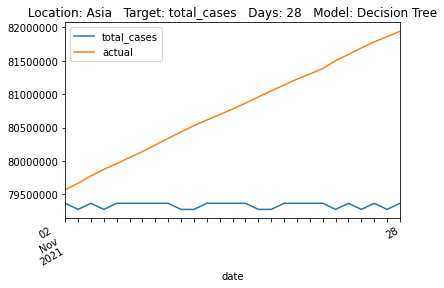

                         MSE            RMSE        R2         MAE       RAE  \
models                                                                         
lstm                    None            None      None        None      None   
dt                      None            None      None        None      None   
rf      2823390011902.347656  1680294.620566 -4.661393  1528014.97  2.514114   

            RRSE  
models            
lstm        None  
dt          None  
rf      2.379368  


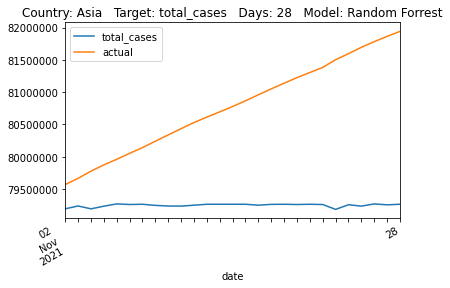

                         MSE           RMSE        R2             MAE  \
models                                                                  
lstm                    None           None      None            None   
dt      2856566864406.310547  1690138.11992 -4.001858  1518048.103448   
rf                      None           None      None            None   

             RAE      RRSE  
models                      
lstm        None      None  
dt      2.329608  2.236483  
rf          None      None  


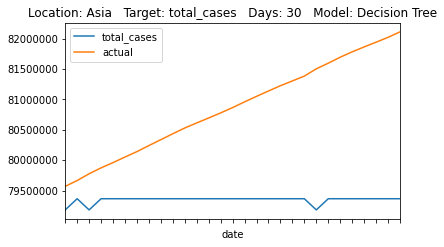

                         MSE            RMSE        R2             MAE  \
models                                                                   
lstm                    None            None      None            None   
dt                      None            None      None            None   
rf      3133785030903.271973  1770249.991076 -4.487268  1604228.776897   

             RAE      RRSE  
models                      
lstm        None      None  
dt          None      None  
rf      2.461861  2.342492  


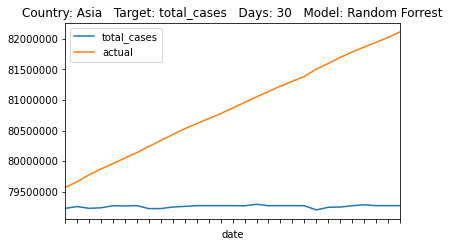

                    MSE         RMSE         R2          MAE       RAE  \
models                                                                   
lstm               None         None       None         None      None   
dt      71630822.166667  8463.499404 -10.590064  8173.166667  3.720996   
rf                 None         None       None         None      None   

            RRSE  
models            
lstm        None  
dt      3.404418  
rf          None  


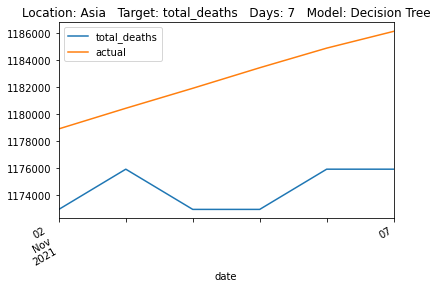

                    MSE         RMSE         R2      MAE       RAE      RRSE
models                                                                      
lstm               None         None       None     None      None      None
dt                 None         None       None     None      None      None
rf      80397094.137999  8966.442669 -12.008471  8676.49  3.950143  3.606726


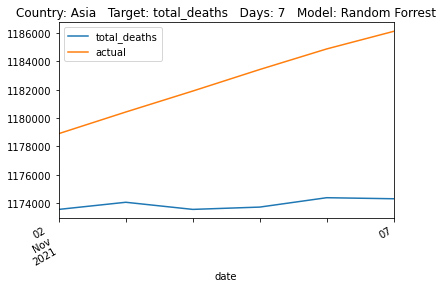

                     MSE          RMSE        R2           MAE       RAE  \
models                                                                     
lstm                None          None      None          None      None   
dt      163943673.692308  12804.049113 -4.754452  11638.461538  2.536613   
rf                  None          None      None          None      None   

            RRSE  
models            
lstm        None  
dt      2.398844  
rf          None  


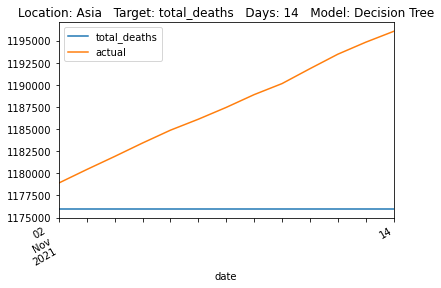

                     MSE          RMSE        R2           MAE      RAE  \
models                                                                    
lstm                None          None      None          None     None   
dt                  None          None      None          None     None   
rf      216279075.012662  14706.429717 -6.591433  13818.293846  3.01171   

            RRSE  
models            
lstm        None  
dt          None  
rf      2.755256  


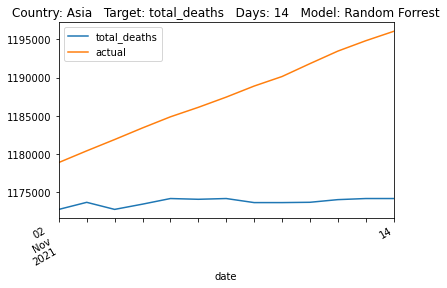

                 MSE          RMSE        R2       MAE       RAE      RRSE
models                                                                    
lstm            None          None      None      None      None      None
dt      343686516.05  18538.784104 -4.085617  16616.45  2.326436  2.255131
rf              None          None      None      None      None      None


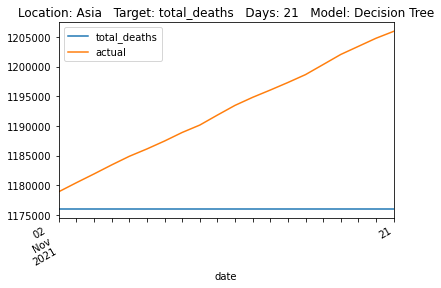

                     MSE          RMSE        R2        MAE       RAE  \
models                                                                  
lstm                None          None      None       None      None   
dt                  None          None      None       None      None   
rf      398820805.254542  19970.498373 -4.901453  18250.521  2.555219   

            RRSE  
models            
lstm        None  
dt          None  
rf      2.429291  


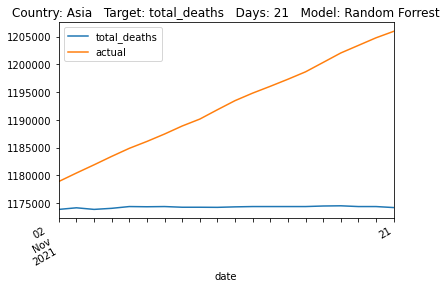

                     MSE          RMSE        R2           MAE       RAE  \
models                                                                     
lstm                None          None      None          None      None   
dt      592910860.925926  24349.761003 -3.759845  21641.296296  2.242464   
rf                  None          None      None          None      None   

            RRSE  
models            
lstm        None  
dt      2.181707  
rf          None  


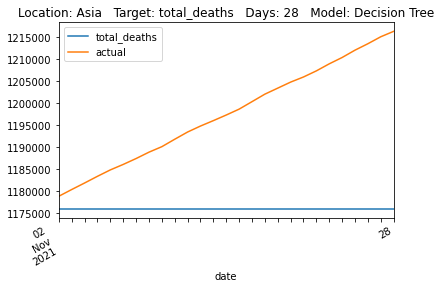

                     MSE          RMSE        R2           MAE       RAE  \
models                                                                     
lstm                None          None      None          None      None   
dt                  None          None      None          None      None   
rf      680912765.914602  26094.305239 -4.466318  23630.206296  2.448554   

            RRSE  
models            
lstm        None  
dt          None  
rf      2.338016  


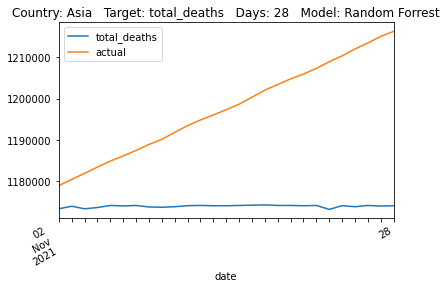

                     MSE          RMSE        R2           MAE       RAE  \
models                                                                     
lstm                None          None      None          None      None   
dt      674939801.413793  25979.603565 -3.714103  23060.034483  2.222033   
rf                  None          None      None          None      None   

            RRSE  
models            
lstm        None  
dt      2.171198  
rf          None  


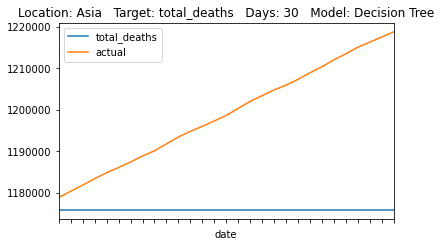

                     MSE          RMSE        R2           MAE       RAE  \
models                                                                     
lstm                None          None      None          None      None   
dt                  None          None      None          None      None   
rf      747508226.077021  27340.596666 -4.220955  24655.053793  2.375727   

            RRSE  
models            
lstm        None  
dt          None  
rf      2.284941  


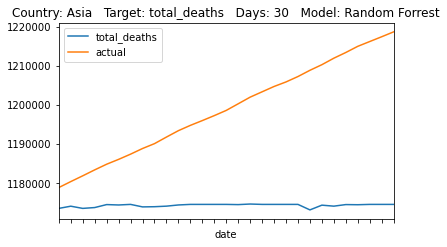

                       MSE             RMSE        R2         MAE       RAE  \
models                                                                        
lstm                  None             None      None        None      None   
dt      9242806345193434.0  96139515.003943 -6.727245  89703256.5  2.990488   
rf                    None             None      None        None      None   

            RRSE  
models            
lstm        None  
dt      2.779792  
rf          None  


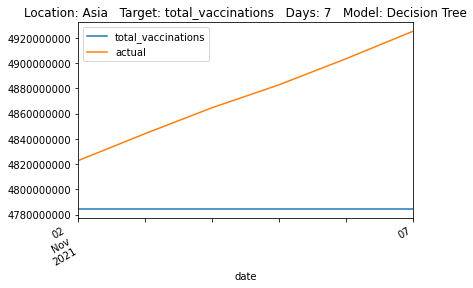

                        MSE              RMSE         R2               MAE  \
models                                                                       
lstm                   None              None       None              None   
dt                     None              None       None              None   
rf      15078295582878222.0  122793711.495655 -11.605878  119137454.738333   

             RAE      RRSE  
models                      
lstm        None      None  
dt          None      None  
rf      3.971753  3.550476  


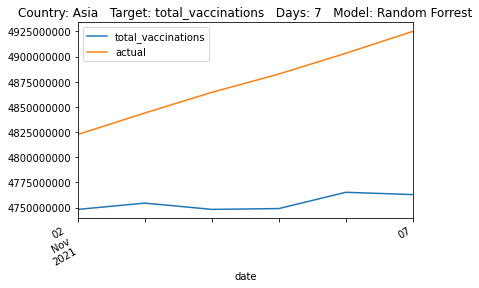

                        MSE              RMSE        R2               MAE  \
models                                                                      
lstm                   None              None      None              None   
dt      41632346330930072.0  204040060.603133 -4.832985  187588283.769231   
rf                     None              None      None              None   

             RAE      RRSE  
models                      
lstm        None      None  
dt      2.547607  2.415157  
rf          None      None  


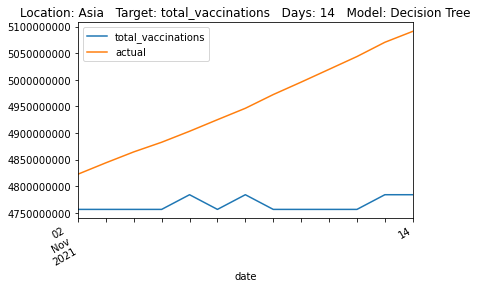

                        MSE              RMSE        R2               MAE  \
models                                                                      
lstm                   None              None      None              None   
dt                     None              None      None              None   
rf      45164032248734336.0  212518310.384622 -5.327799  196308317.526154   

             RAE      RRSE  
models                      
lstm        None      None  
dt          None      None  
rf      2.666032  2.515512  


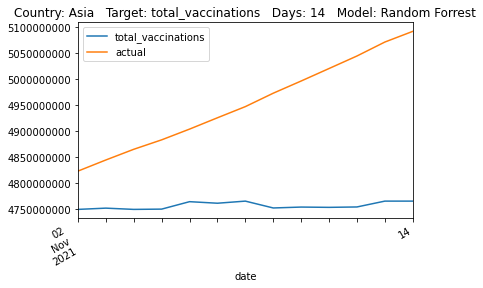

                        MSE              RMSE        R2          MAE  \
models                                                                 
lstm                   None              None      None         None   
dt      83177488937103152.0  288405077.862896 -4.149788  263864993.9   
rf                     None              None      None         None   

             RAE      RRSE  
models                      
lstm        None      None  
dt      2.368413  2.269314  
rf          None      None  


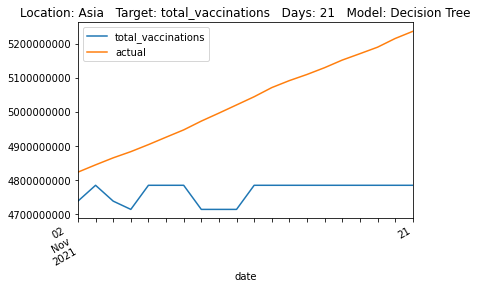

                        MSE              RMSE        R2             MAE  \
models                                                                    
lstm                   None              None      None            None   
dt                     None              None      None            None   
rf      89228759529229776.0  298711833.594235 -4.524441  272691503.6875   

             RAE      RRSE  
models                      
lstm        None      None  
dt          None      None  
rf      2.447639  2.350413  


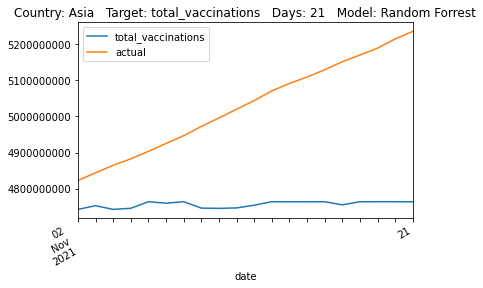

                         MSE              RMSE        R2               MAE  \
models                                                                       
lstm                    None              None      None              None   
dt      133115972644508192.0  364850616.889307 -3.520878  321980211.851852   
rf                      None              None      None              None   

             RAE      RRSE  
models                      
lstm        None      None  
dt      2.178296  2.126236  
rf          None      None  


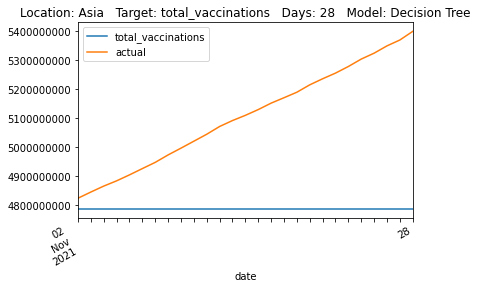

                         MSE              RMSE        R2               MAE  \
models                                                                       
lstm                    None              None      None              None   
dt                      None              None      None              None   
rf      149504809036443392.0  386658517.346306 -4.077475  347751507.568148   

             RAE      RRSE  
models                      
lstm        None      None  
dt          None      None  
rf      2.352647  2.253325  


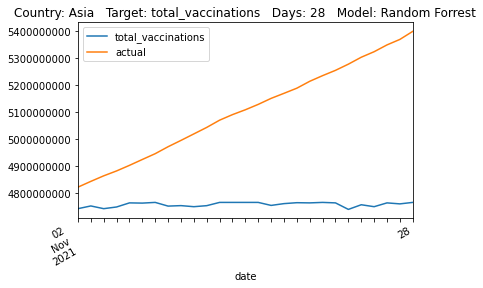

                         MSE              RMSE        R2               MAE  \
models                                                                       
lstm                    None              None      None              None   
dt      162256180938663968.0  402810353.564384 -3.736758  362045302.827586   
rf                      None              None      None              None   

             RAE      RRSE  
models                      
lstm        None      None  
dt      2.275433  2.176409  
rf          None      None  


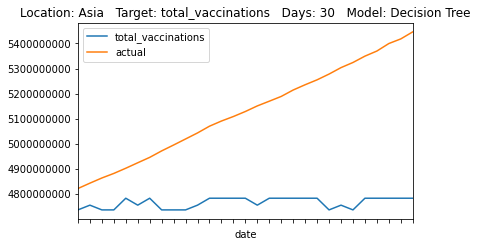

                         MSE              RMSE        R2               MAE  \
models                                                                       
lstm                    None              None      None              None   
dt                      None              None      None              None   
rf      169222524960436352.0  411366655.139228 -3.940127  368350053.987586   

             RAE     RRSE  
models                     
lstm        None     None  
dt          None     None  
rf      2.315058  2.22264  


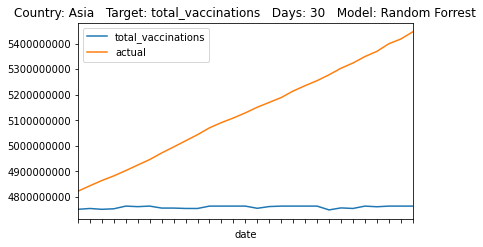

                        MSE             RMSE        R2         MAE       RAE  \
models                                                                         
lstm                   None             None      None        None      None   
dt      1146744759534131.25  33863620.000439 -8.370136  32005653.0  3.264294   
rf                     None             None      None        None      None   

            RRSE  
models            
lstm        None  
dt      3.061068  
rf          None  


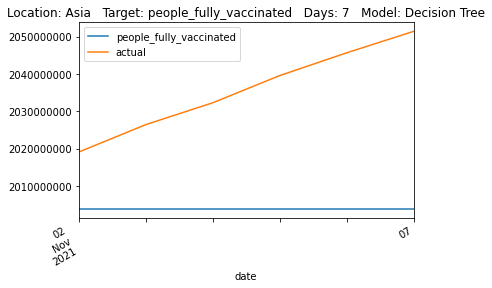

                       MSE             RMSE         R2              MAE  \
models                                                                    
lstm                  None             None       None             None   
dt                    None             None       None             None   
rf      2362796402415906.5  48608604.201478 -18.306584  47892432.671667   

             RAE      RRSE  
models                      
lstm        None      None  
dt          None      None  
rf      4.884605  4.393926  


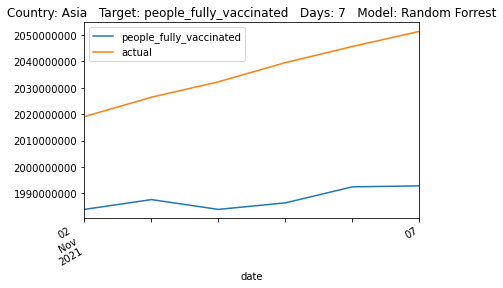

                       MSE             RMSE        R2              MAE  \
models                                                                   
lstm                  None             None      None             None   
dt      4550054071295417.0  67454088.618077 -3.803831  60024012.461538   
rf                    None             None      None             None   

             RAE      RRSE  
models                      
lstm        None      None  
dt      2.256149  2.191764  
rf          None      None  


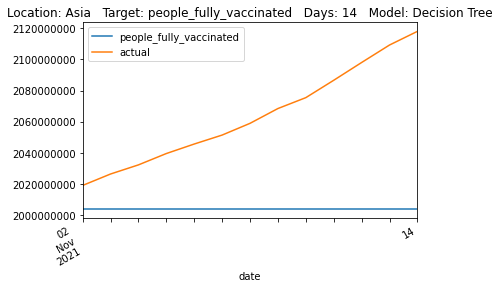

                       MSE             RMSE        R2              MAE  \
models                                                                   
lstm                  None             None      None             None   
dt                    None             None      None             None   
rf      6563950924695735.0  81018213.536807 -5.930052  75490450.721538   

             RAE      RRSE  
models                      
lstm        None      None  
dt          None      None  
rf      2.837493  2.632499  


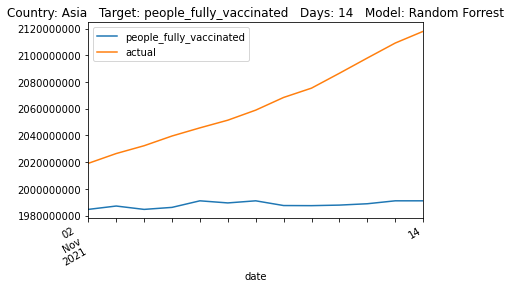

                        MSE              RMSE        R2         MAE       RAE  \
models                                                                          
lstm                   None              None      None        None      None   
dt      11500263144268426.0  107239279.857095 -3.639086  97262636.5  2.211325   
rf                     None              None      None        None      None   

            RRSE  
models            
lstm        None  
dt      2.153854  
rf          None  


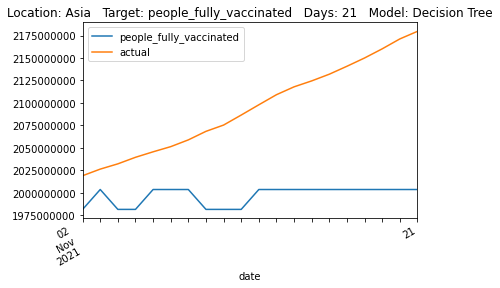

                        MSE              RMSE        R2            MAE  \
models                                                                   
lstm                   None              None      None           None   
dt                     None              None      None           None   
rf      13443141318363176.0  115944561.400538 -4.422823  105727660.603   

             RAE      RRSE  
models                      
lstm        None      None  
dt          None      None  
rf      2.403782  2.328696  


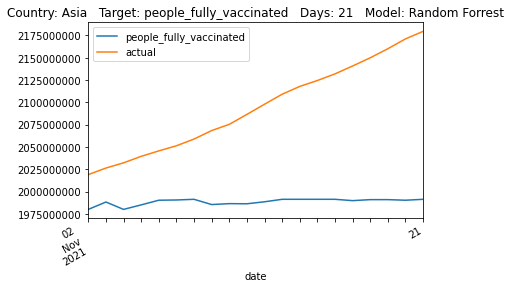

                        MSE              RMSE        R2               MAE  \
models                                                                      
lstm                   None              None      None              None   
dt      21203494417321544.0  145614197.169512 -3.432361  129550705.444444   
rf                     None              None      None              None   

             RAE      RRSE  
models                      
lstm        None      None  
dt      2.156673  2.105317  
rf          None      None  


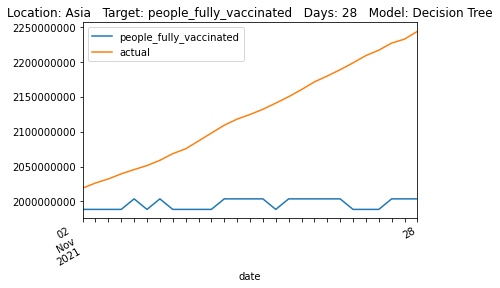

                        MSE              RMSE        R2               MAE  \
models                                                                      
lstm                   None              None      None              None   
dt                     None              None      None              None   
rf      23050158582803400.0  151822786.770641 -3.818386  135849742.095185   

             RAE      RRSE  
models                      
lstm        None      None  
dt          None      None  
rf      2.261535  2.195082  


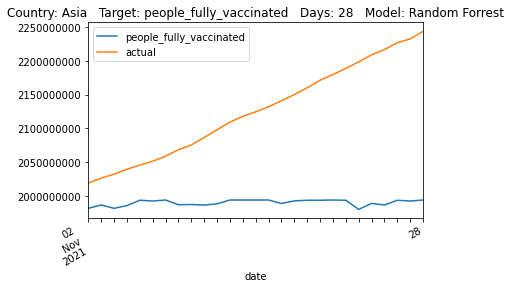

                        MSE              RMSE        R2               MAE  \
models                                                                      
lstm                   None              None      None              None   
dt      23985434619349512.0  154872317.149804 -2.895021  133519519.448276   
rf                     None              None      None              None   

             RAE      RRSE  
models                      
lstm        None      None  
dt      1.988888  1.973581  
rf          None      None  


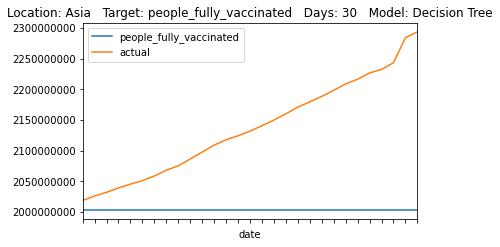

                        MSE              RMSE       R2               MAE  \
models                                                                     
lstm                   None              None     None              None   
dt                     None              None     None              None   
rf      28116623382535892.0  167680122.204559 -3.56589  148799997.899655   

             RAE      RRSE  
models                      
lstm        None      None  
dt          None      None  
rf      2.216504  2.136794  


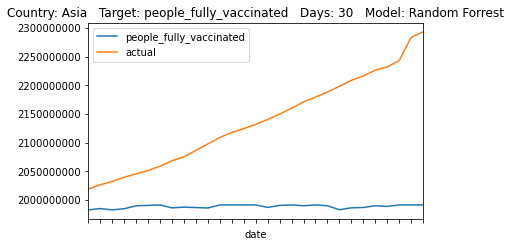

                MSE          RMSE        R2          MAE       RAE      RRSE
models                                                                      
lstm           None          None      None         None      None      None
dt      144557721.0  12023.215918 -0.631238  8986.333333  1.084113  1.277199
rf             None          None      None         None      None      None


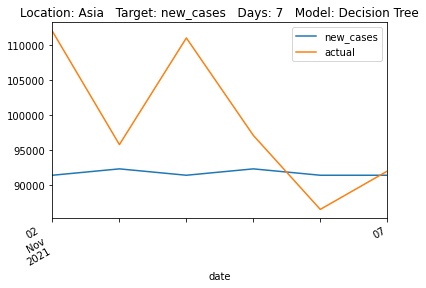

                     MSE         RMSE        R2          MAE       RAE  \
models                                                                   
lstm                None         None      None         None      None   
dt                  None         None      None         None      None   
rf      110989468.747067  10535.15395 -0.252442  8105.046667  0.977794   

            RRSE  
models            
lstm        None  
dt          None  
rf      1.119126  


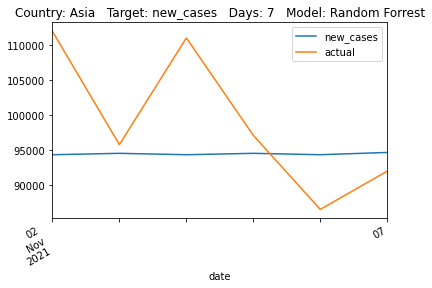

                    MSE         RMSE        R2          MAE       RAE  \
models                                                                  
lstm               None         None      None         None      None   
dt      91787183.153846  9580.562779 -0.178303  7607.307692  1.126185   
rf                 None         None      None         None      None   

            RRSE  
models            
lstm        None  
dt      1.085496  
rf          None  


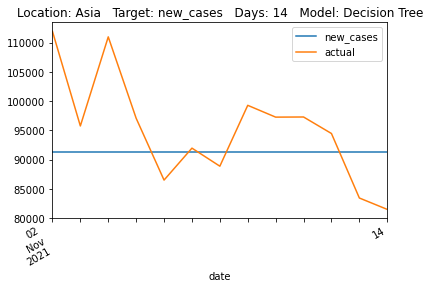

                    MSE         RMSE        R2      MAE       RAE      RRSE
models                                                                     
lstm               None         None      None     None      None      None
dt                 None         None      None     None      None      None
rf      79105767.148869  8894.142294 -0.015507  6795.15  1.005953  1.007724


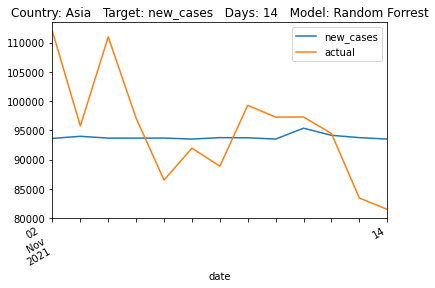

                MSE         RMSE        R2      MAE       RAE      RRSE
models                                                                 
lstm           None         None      None     None      None      None
dt      73471093.25  8571.528058 -0.011219  6700.45  0.995293  1.005594
rf             None         None      None     None      None      None


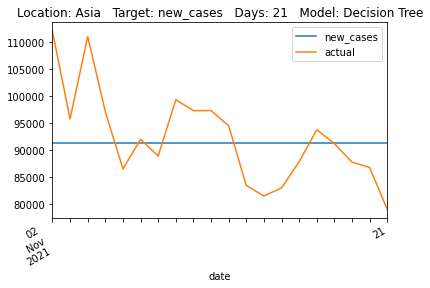

                    MSE         RMSE        R2        MAE       RAE      RRSE
models                                                                       
lstm               None         None      None       None      None      None
dt                 None         None      None       None      None      None
rf      73319853.588075  8562.701302 -0.009138  6763.8185  1.004706  1.004558


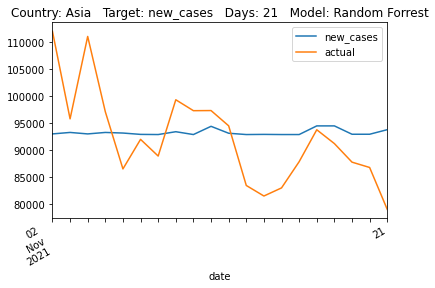

                     MSE          RMSE        R2          MAE       RAE  \
models                                                                    
lstm                None          None      None         None      None   
dt      102241935.222222  10111.475423 -0.003153  7793.074074  0.997313   
rf                  None          None      None         None      None   

            RRSE  
models            
lstm        None  
dt      1.001576  
rf          None  


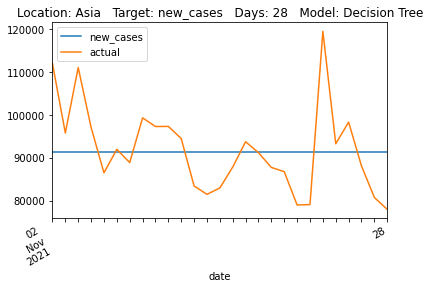

                     MSE          RMSE       R2          MAE       RAE  \
models                                                                   
lstm                None          None     None         None      None   
dt                  None          None     None         None      None   
rf      105837363.401274  10287.728778 -0.03843  8065.228889  1.032142   

            RRSE  
models            
lstm        None  
dt          None  
rf      1.019034  


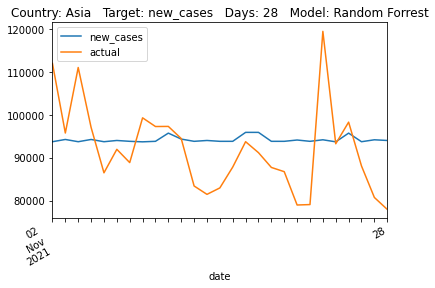

                    MSE         RMSE        R2          MAE       RAE  \
models                                                                  
lstm               None         None      None         None      None   
dt      99908083.827586  9995.403135 -0.000068  7701.206897  0.998896   
rf                 None         None      None         None      None   

            RRSE  
models            
lstm        None  
dt      1.000034  
rf          None  


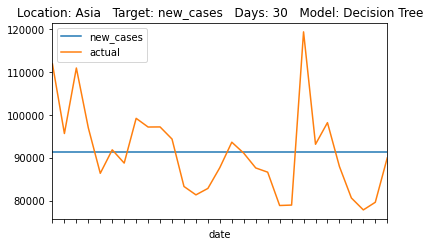

                     MSE          RMSE        R2          MAE       RAE  \
models                                                                    
lstm                None          None      None         None      None   
dt                  None          None      None         None      None   
rf      103936392.107607  10194.919917 -0.040391  8096.272414  1.050139   

            RRSE  
models            
lstm        None  
dt          None  
rf      1.019995  


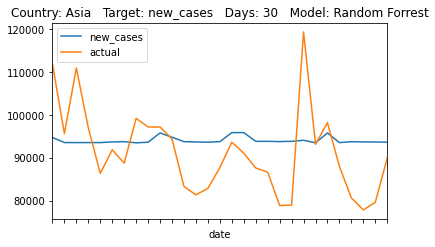

                 MSE        RMSE        R2    MAE       RAE      RRSE
models                                                               
lstm            None        None      None   None      None      None
dt      53541.666667  231.390723 -4.722301  211.0  3.028708  2.392133
rf              None        None      None   None      None      None


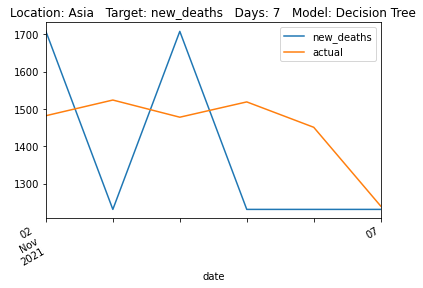

                 MSE        RMSE        R2         MAE       RAE      RRSE
models                                                                    
lstm            None        None      None        None      None      None
dt              None        None      None        None      None      None
rf      21698.730309  147.304889 -1.319066  121.290556  1.741013  1.522848


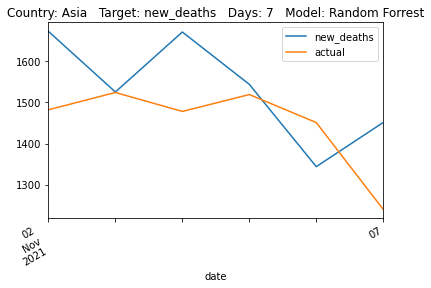

                 MSE        RMSE        R2    MAE       RAE      RRSE
models                                                               
lstm            None        None      None   None      None      None
dt      58748.076923  242.380026 -1.991187  199.0  1.706291  1.729505
rf              None        None      None   None      None      None


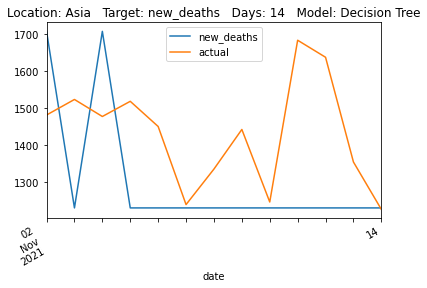

                 MSE        RMSE        R2         MAE       RAE      RRSE
models                                                                    
lstm            None        None      None        None      None      None
dt              None        None      None        None      None      None
rf      20611.300988  143.566364 -0.049434  119.156484  1.021687  1.024419


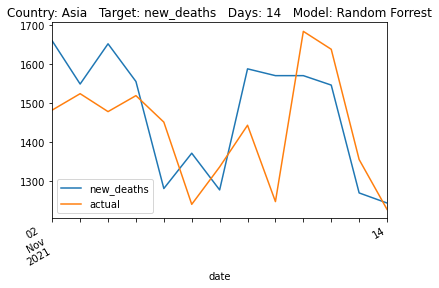

            MSE        RMSE        R2    MAE      RAE     RRSE
models                                                        
lstm       None        None      None   None     None     None
dt      64671.7  254.306311 -1.516316  207.2  1.52746  1.58629
rf         None        None      None   None     None     None


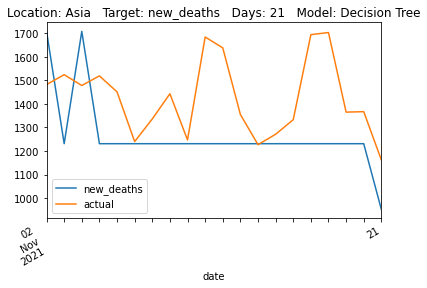

                 MSE        RMSE        R2        MAE      RAE      RRSE
models                                                                  
lstm            None        None      None       None     None      None
dt              None        None      None       None     None      None
rf      26694.914564  163.385784 -0.038674  126.66325  0.93375  1.019154


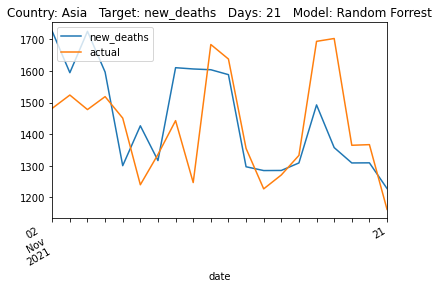

            MSE        RMSE        R2        MAE       RAE      RRSE
models                                                              
lstm       None        None      None       None      None      None
dt      82649.0  287.487391 -2.380153  232.62963  1.784037  1.838519
rf         None        None      None       None      None      None


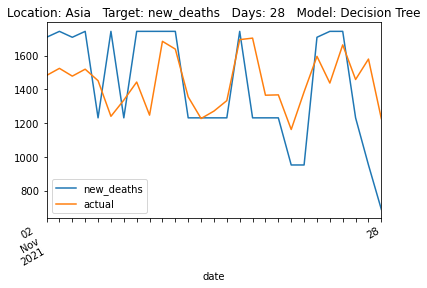

                MSE        RMSE        R2         MAE       RAE      RRSE
models                                                                   
lstm           None        None      None        None      None      None
dt             None        None      None        None      None      None
rf      25717.21621  160.365882 -0.051775  126.112778  0.967159  1.025561


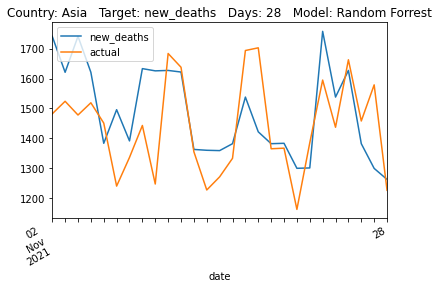

                 MSE        RMSE        R2         MAE       RAE      RRSE
models                                                                    
lstm            None        None      None        None      None      None
dt      87270.241379  295.415371 -2.443488  241.896552  1.785238  1.855664
rf              None        None      None        None      None      None


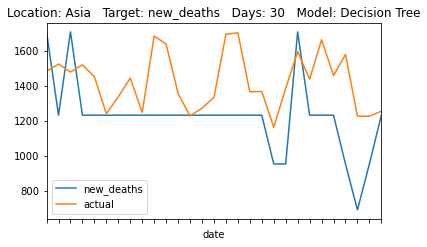

                 MSE        RMSE        R2         MAE       RAE      RRSE
models                                                                    
lstm            None        None      None        None      None      None
dt              None        None      None        None      None      None
rf      26869.444133  163.919017 -0.060208  127.150805  0.938395  1.029664


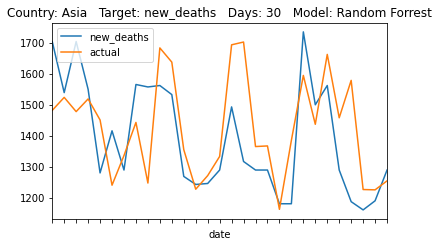

                        MSE           RMSE        R2       MAE       RAE  \
models                                                                     
lstm                   None           None      None      None      None   
dt      237119538448.166656  486949.215471 -11.84192  472952.5  3.869539   
rf                     None           None      None      None      None   

            RRSE  
models            
lstm        None  
dt      3.583563  
rf          None  


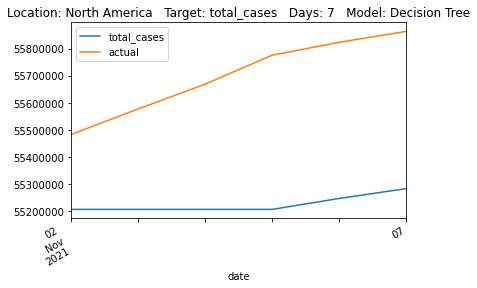

                        MSE           RMSE         R2         MAE       RAE  \
models                                                                        
lstm                   None           None       None        None      None   
dt                     None           None       None        None      None   
rf      247040459360.403107  497031.648248 -12.379218  480103.275  3.928045   

            RRSE  
models            
lstm        None  
dt          None  
rf      3.657761  


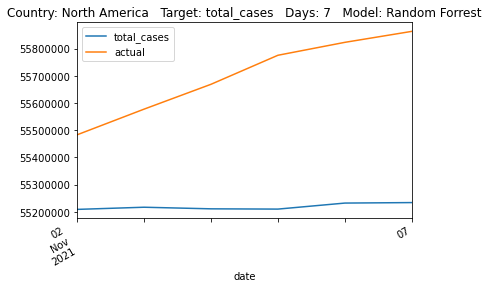

                        MSE           RMSE        R2            MAE       RAE  \
models                                                                          
lstm                   None           None      None           None      None   
dt      673142995795.153809  820452.921133 -5.446238  759792.846154  2.694005   
rf                     None           None      None           None      None   

            RRSE  
models            
lstm        None  
dt      2.538944  
rf          None  


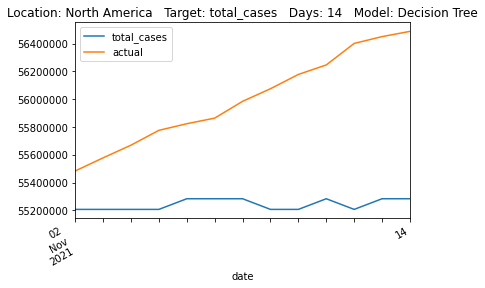

                        MSE          RMSE        R2            MAE       RAE  \
models                                                                         
lstm                   None          None      None           None      None   
dt                     None          None      None           None      None   
rf      708017595266.693604  841437.81426 -5.780208  777770.725385  2.757749   

            RRSE  
models            
lstm        None  
dt          None  
rf      2.603883  


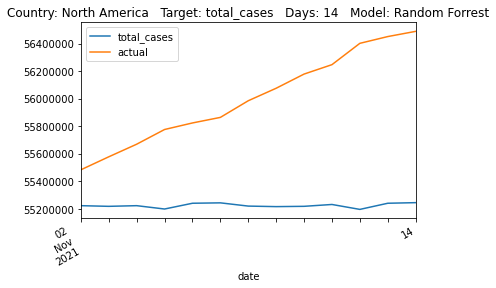

                         MSE            RMSE        R2        MAE       RAE  \
models                                                                        
lstm                    None            None      None       None      None   
dt      1423107280334.899902  1192940.602182 -3.959857  1068693.4  2.294541   
rf                      None            None      None       None      None   

            RRSE  
models            
lstm        None  
dt      2.227074  
rf          None  


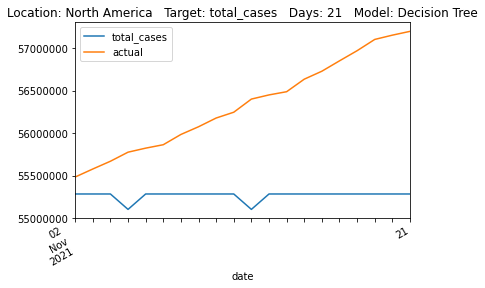

                         MSE            RMSE        R2          MAE       RAE  \
models                                                                          
lstm                    None            None      None         None      None   
dt                      None            None      None         None      None   
rf      1550016759150.340332  1244996.690417 -4.402166  1124458.479  2.414272   

            RRSE  
models            
lstm        None  
dt          None  
rf      2.324256  


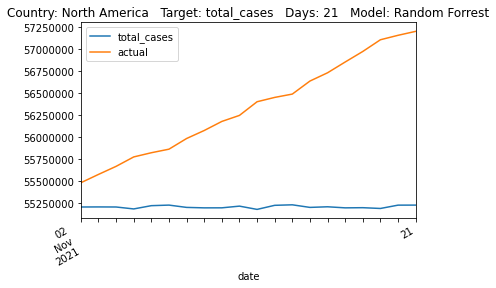

                         MSE            RMSE        R2             MAE  \
models                                                                   
lstm                    None            None      None            None   
dt      2569155175338.629395  1602858.438958 -3.902341  1434537.666667   
rf                      None            None      None            None   

             RAE      RRSE  
models                      
lstm        None      None  
dt      2.251193  2.214123  
rf          None      None  


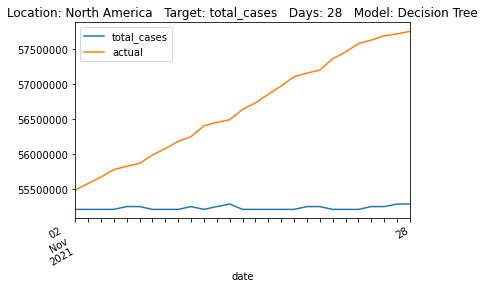

                         MSE            RMSE        R2             MAE  \
models                                                                   
lstm                    None            None      None            None   
dt                      None            None      None            None   
rf      2578309496022.437988  1605711.523289 -3.919809  1435367.578519   

             RAE      RRSE  
models                      
lstm        None      None  
dt          None      None  
rf      2.252495  2.218064  


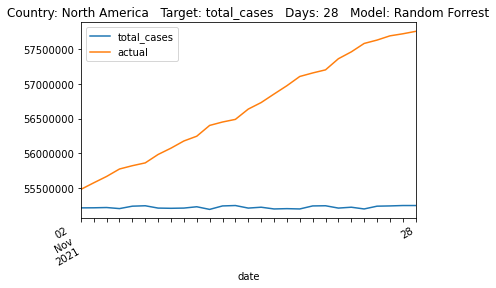

                         MSE            RMSE        R2             MAE  \
models                                                                   
lstm                    None            None      None            None   
dt      2919916869756.275879  1708776.424743 -3.798092  1523408.965517   
rf                      None            None      None            None   

             RAE      RRSE  
models                      
lstm        None      None  
dt      2.220004  2.190455  
rf          None      None  


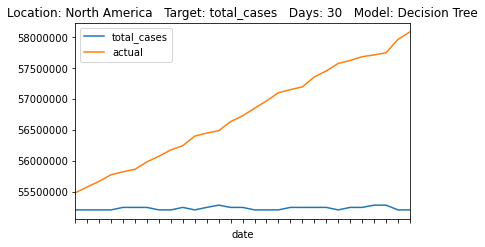

                         MSE           RMSE        R2             MAE  \
models                                                                  
lstm                    None           None      None            None   
dt                      None           None      None            None   
rf      2950243885711.401367  1717627.40014 -3.847927  1531622.194483   

             RAE      RRSE  
models                      
lstm        None      None  
dt          None      None  
rf      2.231972  2.201801  


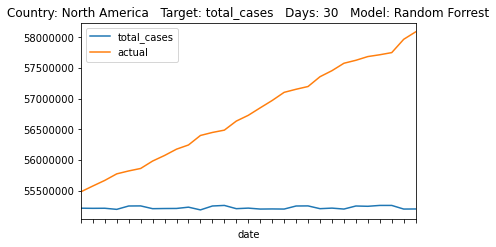

                    MSE         RMSE        R2          MAE       RAE  \
models                                                                  
lstm               None         None      None         None      None   
dt      81975417.833333  9054.027713 -9.336494  8449.166667  3.314482   
rf                 None         None      None         None      None   

            RRSE  
models            
lstm        None  
dt      3.215042  
rf          None  


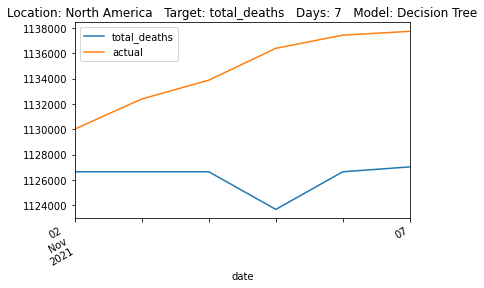

                    MSE         RMSE        R2      MAE       RAE      RRSE
models                                                                     
lstm               None         None      None     None      None      None
dt                 None         None      None     None      None      None
rf      81043817.608733  9002.433982 -9.219026  8600.61  3.373891  3.196721


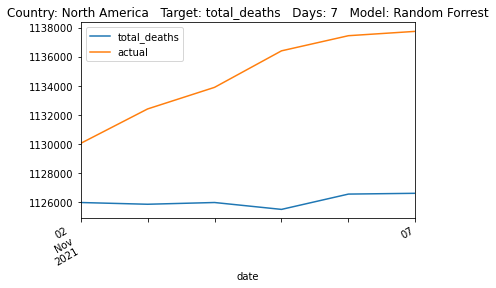

                     MSE          RMSE        R2           MAE      RAE  \
models                                                                    
lstm                None          None      None          None     None   
dt      229405617.076923  15146.141987 -5.931735  14013.692308  2.81928   
rf                  None          None      None          None     None   

            RRSE  
models            
lstm        None  
dt      2.632819  
rf          None  


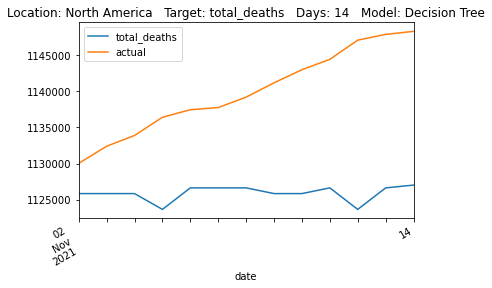

                     MSE          RMSE       R2           MAE       RAE  \
models                                                                    
lstm                None          None     None          None      None   
dt                  None          None     None          None      None   
rf      226714839.213384  15057.052806 -5.85043  13925.570769  2.801552   

            RRSE  
models            
lstm        None  
dt          None  
rf      2.617333  


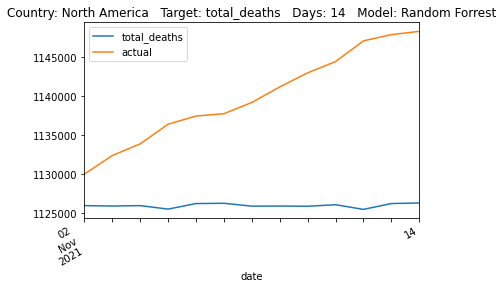

                MSE          RMSE        R2      MAE       RAE      RRSE
models                                                                  
lstm           None          None      None     None      None      None
dt      431585367.0  20774.632777 -4.894383  18954.5  2.538997  2.427835
rf             None          None      None     None      None      None


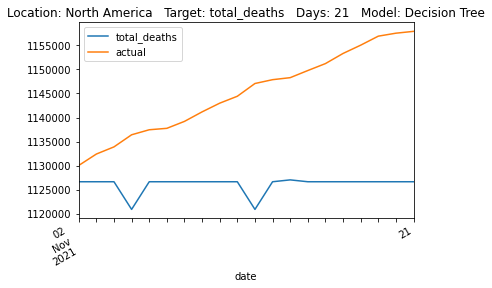

                     MSE          RMSE        R2         MAE       RAE  \
models                                                                   
lstm                None          None      None        None      None   
dt                  None          None      None        None      None   
rf      453763101.650756  21301.715932 -5.197276  19529.0445  2.615958   

            RRSE  
models            
lstm        None  
dt          None  
rf      2.489433  


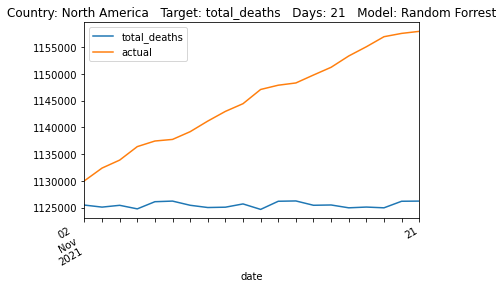

                     MSE          RMSE        R2           MAE       RAE  \
models                                                                     
lstm                None          None      None          None      None   
dt      663664187.814815  25761.680609 -4.652605  23444.407407  2.489214   
rf                  None          None      None          None      None   

            RRSE  
models            
lstm        None  
dt      2.377521  
rf          None  


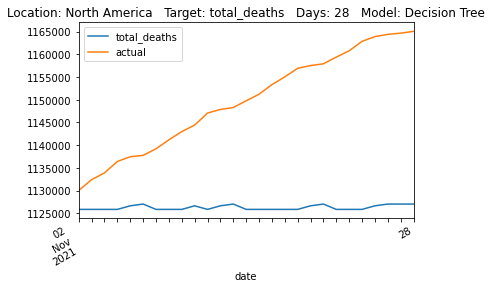

                     MSE          RMSE        R2           MAE       RAE  \
models                                                                     
lstm                None          None      None          None      None   
dt                  None          None      None          None      None   
rf      678400974.028742  26046.131652 -4.778122  23715.475185  2.517995   

            RRSE  
models            
lstm        None  
dt          None  
rf      2.403773  


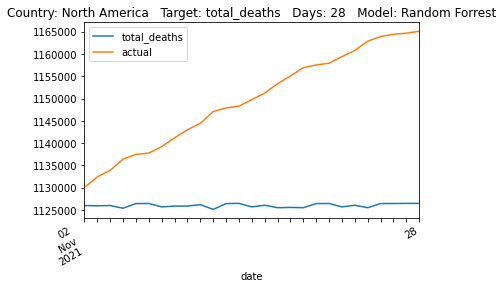

                     MSE          RMSE        R2           MAE       RAE  \
models                                                                     
lstm                None          None      None          None      None   
dt      737523966.241379  27157.392479 -4.633037  24669.896552  2.470912   
rf                  None          None      None          None      None   

            RRSE  
models            
lstm        None  
dt      2.373402  
rf          None  


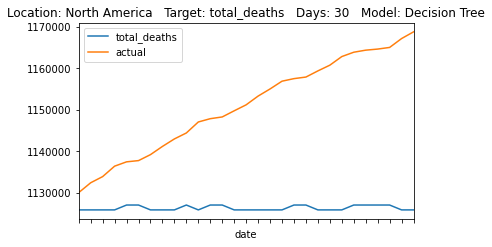

                     MSE          RMSE        R2           MAE       RAE  \
models                                                                     
lstm                None          None      None          None      None   
dt                  None          None      None          None      None   
rf      753130829.027362  27443.229202 -4.752238  24963.816897  2.500351   

            RRSE  
models            
lstm        None  
dt          None  
rf      2.398382  


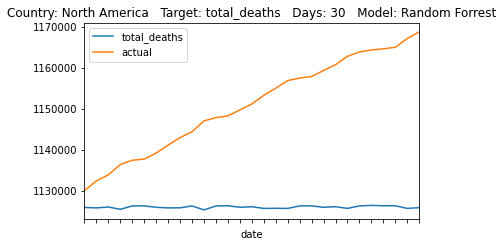

                           MSE             RMSE        R2        MAE  \
models                                                                 
lstm                      None             None      None       None   
dt      104204203017674.828125  10208045.994101 -7.150204  9622796.5   
rf                        None             None      None       None   

             RAE      RRSE  
models                      
lstm        None      None  
dt      2.961372  2.854856  
rf          None      None  


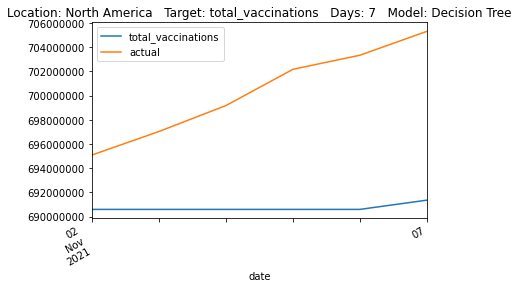

                       MSE             RMSE         R2              MAE  \
models                                                                    
lstm                  None             None       None             None   
dt                    None             None       None             None   
rf      185141825855791.25  13606683.132042 -13.480641  13337156.946667   

             RAE      RRSE  
models                      
lstm        None      None  
dt          None      None  
rf      4.104449  3.805344  


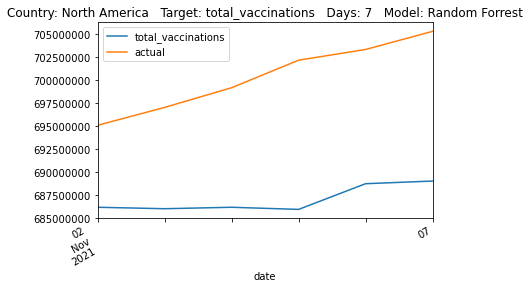

                      MSE             RMSE        R2              MAE  \
models                                                                  
lstm                 None             None      None             None   
dt      602558196532123.5  24547060.853229 -9.340677  23161636.538462   
rf                   None             None      None             None   

            RAE      RRSE  
models                     
lstm       None      None  
dt      3.51647  3.215692  
rf         None      None  


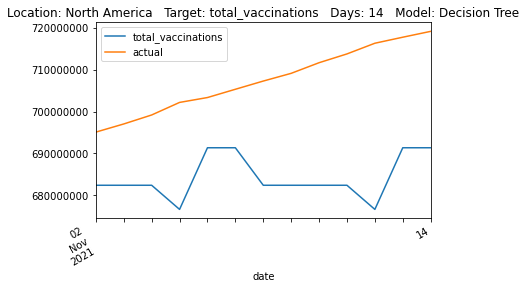

                        MSE             RMSE       R2              MAE  \
models                                                                   
lstm                   None             None     None             None   
dt                     None             None     None             None   
rf      471377698346817.125  21711234.381002 -7.08945  20473726.936923   

             RAE      RRSE  
models                      
lstm        None      None  
dt          None      None  
rf      3.108383  2.844196  


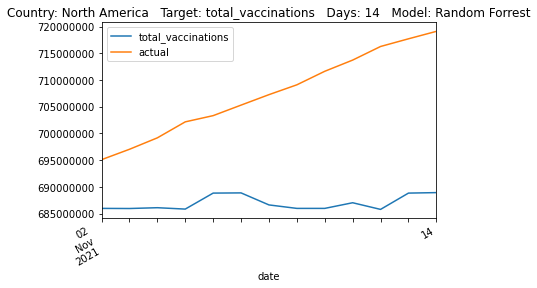

                         MSE             RMSE        R2         MAE       RAE  \
models                                                                          
lstm                    None             None      None        None      None   
dt      1058850654996833.625  32539985.479358 -5.860286  30227575.1  2.860847   
rf                      None             None      None        None      None   

            RRSE  
models            
lstm        None  
dt      2.619215  
rf          None  


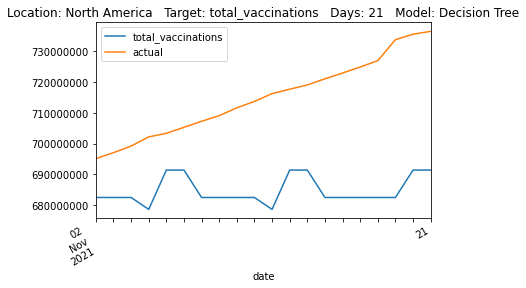

                      MSE             RMSE        R2            MAE       RAE  \
models                                                                          
lstm                 None             None      None           None      None   
dt                   None             None      None           None      None   
rf      904632544751542.0  30077109.980042 -4.861108  27519634.4985  2.604558   

            RRSE  
models            
lstm        None  
dt          None  
rf      2.420973  


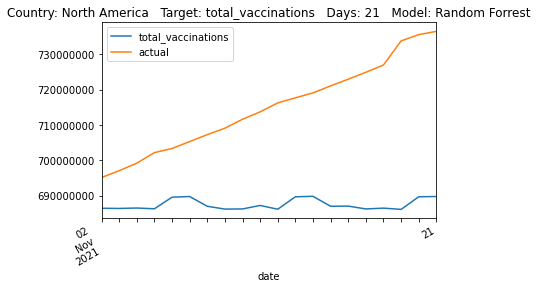

                       MSE             RMSE        R2              MAE  \
models                                                                   
lstm                  None             None      None             None   
dt      1214145754166623.0  34844594.332071 -3.580952  30807523.777778   
rf                    None             None      None             None   

             RAE      RRSE  
models                      
lstm        None      None  
dt      2.161467  2.140316  
rf          None      None  


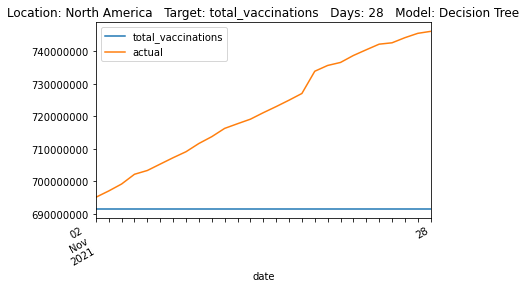

                        MSE             RMSE       R2              MAE  \
models                                                                   
lstm                   None             None     None             None   
dt                     None             None     None             None   
rf      1429621771069506.25  37810339.473079 -4.39394  34329804.496667   

             RAE      RRSE  
models                      
lstm        None      None  
dt          None      None  
rf      2.408591  2.322486  


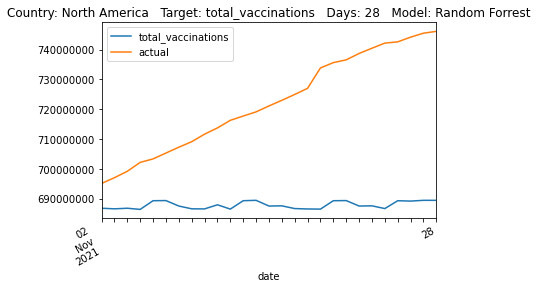

                        MSE             RMSE        R2              MAE  \
models                                                                    
lstm                   None             None      None             None   
dt      1343351692906916.75  36651762.480226 -3.694975  32515016.034483   
rf                     None             None      None             None   

             RAE      RRSE  
models                      
lstm        None      None  
dt      2.170429  2.166789  
rf          None      None  


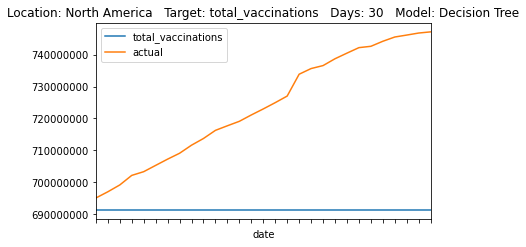

                        MSE             RMSE       R2          MAE      RAE  \
models                                                                        
lstm                   None             None     None         None     None   
dt                     None             None     None         None     None   
rf      1560144574425750.25  39498665.476516 -4.45266  35803042.91  2.38991   

            RRSE  
models            
lstm        None  
dt          None  
rf      2.335093  


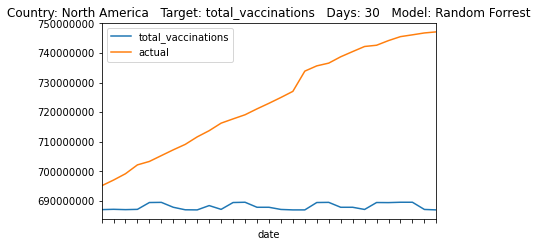

                          MSE           RMSE        R2        MAE      RAE  \
models                                                                       
lstm                     None           None      None       None     None   
dt      10601417944802.333984  3255981.87108 -5.106532  2977472.0  2.51333   
rf                       None           None      None       None     None   

           RRSE  
models           
lstm       None  
dt      2.47114  
rf         None  


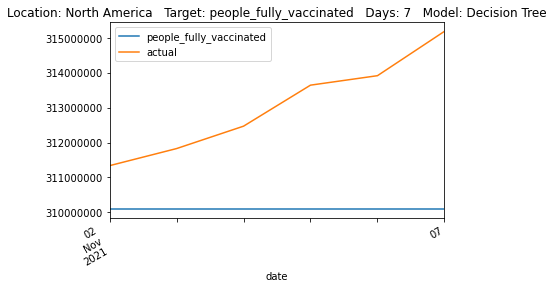

                          MSE            RMSE         R2             MAE  \
models                                                                     
lstm                     None            None       None            None   
dt                       None            None       None            None   
rf      21288272442064.519531  4613921.590368 -11.262276  4510861.796667   

             RAE      RRSE  
models                      
lstm        None      None  
dt          None      None  
rf      3.807687  3.501753  


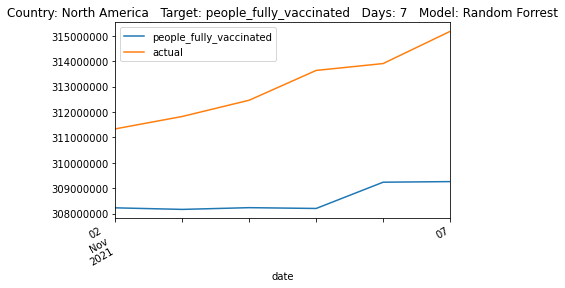

                          MSE            RMSE        R2        MAE      RAE  \
models                                                                        
lstm                     None            None      None       None     None   
dt      31372487307500.382812  5601114.827202 -3.953935  5003963.0  2.29878   
rf                       None            None      None       None     None   

            RRSE  
models            
lstm        None  
dt      2.225744  
rf          None  


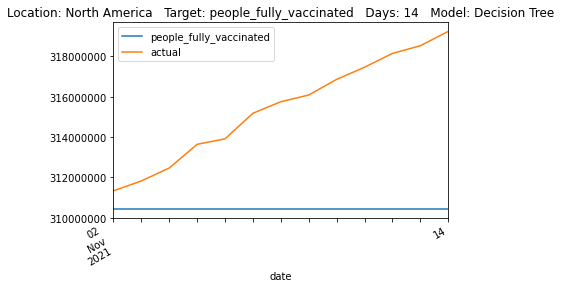

                       MSE            RMSE        R2             MAE  \
models                                                                 
lstm                  None            None      None            None   
dt                    None            None      None            None   
rf      47888960592098.875  6920185.011407 -6.562002  6499219.351538   

             RAE      RRSE  
models                      
lstm        None      None  
dt          None      None  
rf      2.985689  2.749909  


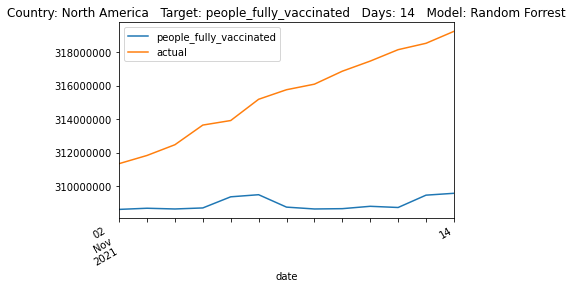

                     MSE            RMSE        R2        MAE       RAE  \
models                                                                    
lstm                None            None      None       None      None   
dt      66857192850021.0  8176624.783492 -3.629953  7239961.8  2.261062   
rf                  None            None      None       None      None   

            RRSE  
models            
lstm        None  
dt      2.151732  
rf          None  


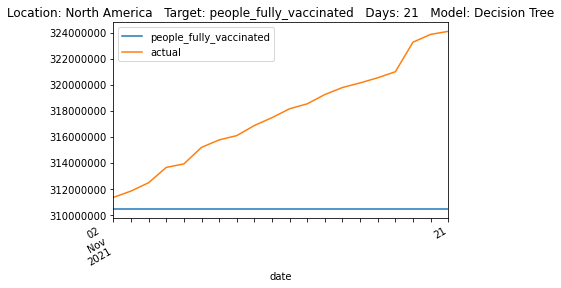

                        MSE           RMSE        R2          MAE       RAE  \
models                                                                        
lstm                   None           None      None         None      None   
dt                     None           None      None         None      None   
rf      94634826673915.0625  9728043.31168 -5.553592  9000666.703  2.810935   

            RRSE  
models            
lstm        None  
dt          None  
rf      2.559998  


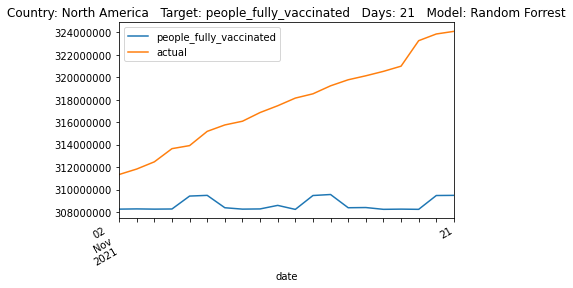

                          MSE             RMSE       R2             MAE  \
models                                                                    
lstm                     None             None     None            None   
dt      107998363270320.21875  10392226.097921 -3.82799  9253601.703704   
rf                       None             None     None            None   

             RAE      RRSE  
models                      
lstm        None      None  
dt      2.261253  2.197269  
rf          None      None  


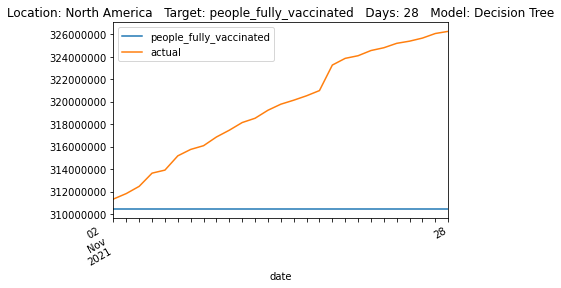

                         MSE             RMSE        R2              MAE  \
models                                                                     
lstm                    None             None      None             None   
dt                      None             None      None             None   
rf      136299482578802.8125  11674736.938313 -5.093171  10736116.134815   

             RAE      RRSE  
models                      
lstm        None      None  
dt          None      None  
rf      2.623527  2.468435  


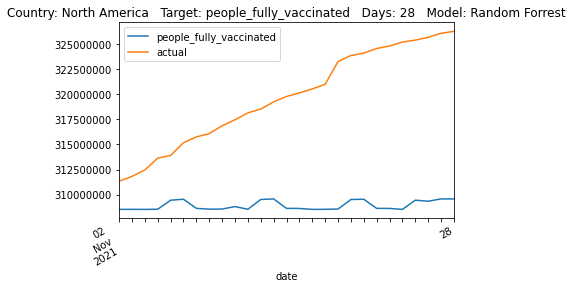

                           MSE             RMSE       R2             MAE  \
models                                                                     
lstm                      None             None     None            None   
dt      118460143820457.171875  10883939.719626 -3.96698  9726798.758621   
rf                        None             None     None            None   

             RAE      RRSE  
models                      
lstm        None      None  
dt      2.283428  2.228672  
rf          None      None  


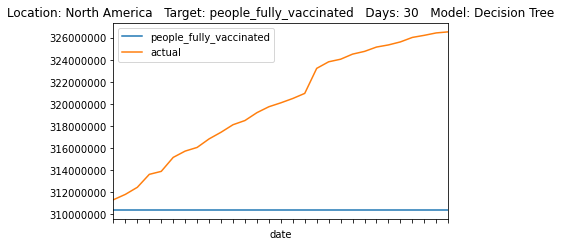

                         MSE             RMSE        R2              MAE  \
models                                                                     
lstm                    None             None      None             None   
dt                      None             None      None             None   
rf      150735182433853.9375  12277425.725039 -5.320258  11313002.056552   

           RAE      RRSE  
models                    
lstm      None      None  
dt        None      None  
rf      2.6558  2.514012  


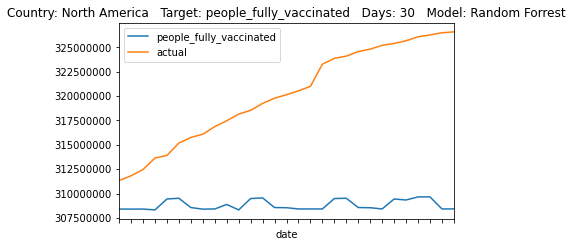

                MSE          RMSE        R2     MAE      RAE      RRSE
models                                                                
lstm           None          None      None    None     None      None
dt      122186919.0  11053.819204  0.796871  9447.0  0.43653  0.450699
rf             None          None      None    None     None      None


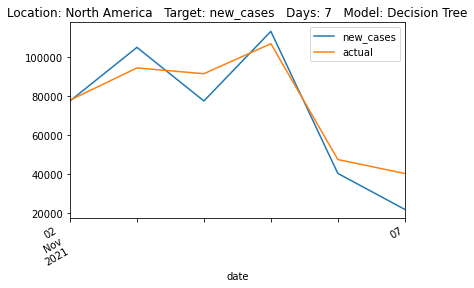

                     MSE          RMSE        R2        MAE       RAE  \
models                                                                  
lstm                None          None      None       None      None   
dt                  None          None      None       None      None   
rf      112338408.157263  10598.981468  0.813243  8698.3995  0.401939   

            RRSE  
models            
lstm        None  
dt          None  
rf      0.432154  


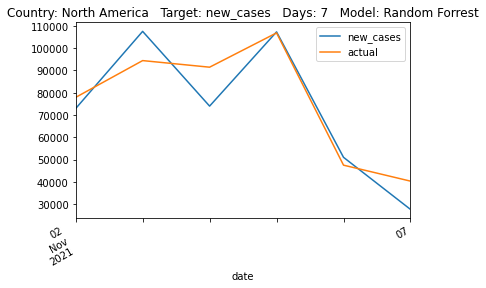

                     MSE          RMSE       R2           MAE       RAE  \
models                                                                    
lstm                None          None     None          None      None   
dt      495469286.923077  22259.139402  0.55076  17063.538462  0.620162   
rf                  None          None     None          None      None   

            RRSE  
models            
lstm        None  
dt      0.670254  
rf          None  


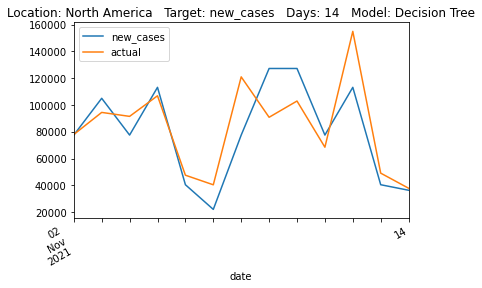

                     MSE          RMSE        R2        MAE       RAE  \
models                                                                  
lstm                None          None      None       None      None   
dt                  None          None      None       None      None   
rf      639973524.918344  25297.698016  0.419739  17626.225  0.640613   

            RRSE  
models            
lstm        None  
dt          None  
rf      0.761749  


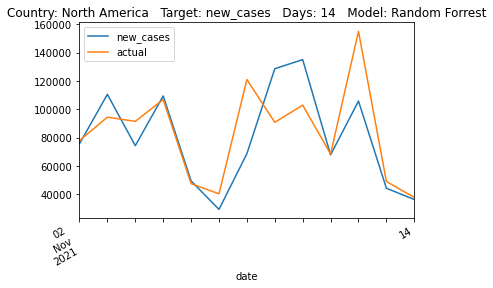

                 MSE          RMSE        R2       MAE       RAE      RRSE
models                                                                    
lstm            None          None      None      None      None      None
dt      697925321.55  26418.276279  0.455056  19707.75  0.653593  0.738203
rf              None          None      None      None      None      None


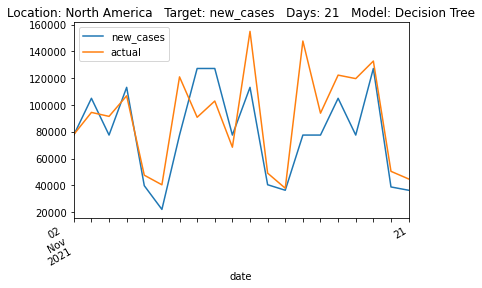

                     MSE          RMSE        R2           MAE       RAE  \
models                                                                     
lstm                None          None      None          None      None   
dt                  None          None      None          None      None   
rf      724422357.888291  26915.095354  0.434367  18965.658833  0.628982   

            RRSE  
models            
lstm        None  
dt          None  
rf      0.752086  


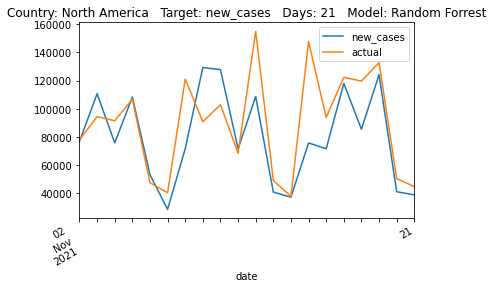

                     MSE          RMSE        R2          MAE       RAE  \
models                                                                    
lstm                None          None      None         None      None   
dt      811152985.888889  28480.747636  0.459654  19916.62963  0.593097   
rf                  None          None      None         None      None   

            RRSE  
models            
lstm        None  
dt      0.735082  
rf          None  


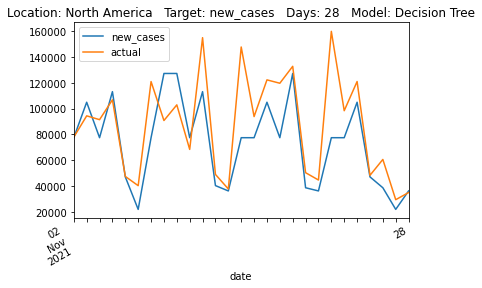

                     MSE          RMSE        R2           MAE       RAE  \
models                                                                     
lstm                None          None      None          None      None   
dt                  None          None      None          None      None   
rf      872614002.271154  29540.040661  0.418712  19397.818074  0.577648   

            RRSE  
models            
lstm        None  
dt          None  
rf      0.762422  


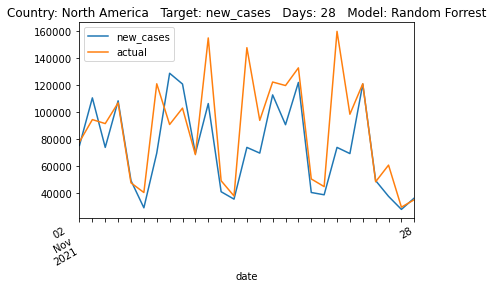

                     MSE          RMSE        R2           MAE       RAE  \
models                                                                     
lstm                None          None      None          None      None   
dt      968628029.482759  31122.789552  0.512875  22155.206897  0.612692   
rf                  None          None      None          None      None   

            RRSE  
models            
lstm        None  
dt      0.697943  
rf          None  


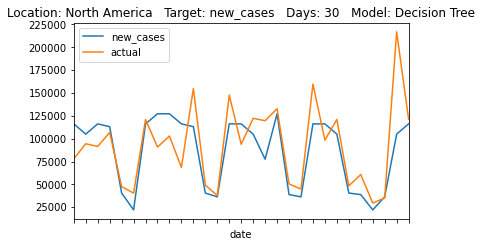

                      MSE          RMSE        R2           MAE       RAE  \
models                                                                      
lstm                 None          None      None          None      None   
dt                   None          None      None          None      None   
rf      1216780421.686393  34882.379817  0.388079  23107.934055  0.639039   

            RRSE  
models            
lstm        None  
dt          None  
rf      0.782254  


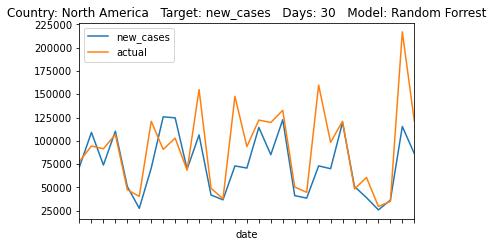

                  MSE        RMSE        R2    MAE       RAE     RRSE
models                                                               
lstm             None        None      None   None      None     None
dt      522573.666667  722.892569  0.089578  606.0  1.007947  0.95416
rf               None        None      None   None      None     None


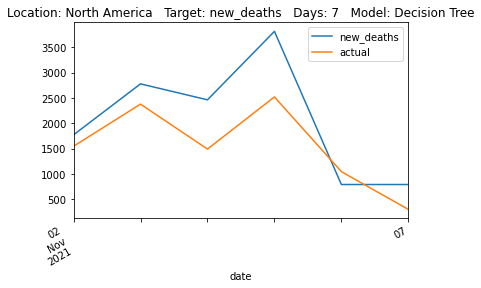

                  MSE        RMSE        R2         MAE       RAE      RRSE
models                                                                     
lstm             None        None      None        None      None      None
dt               None        None      None        None      None      None
rf      195107.751171  441.710031  0.660085  363.229167  0.604151  0.583022


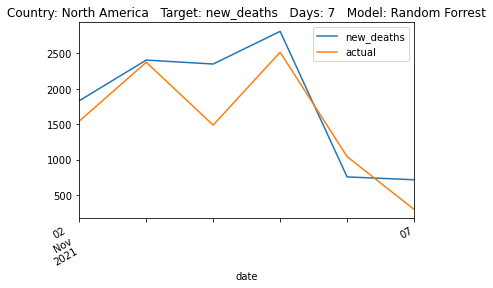

                  MSE        RMSE        R2    MAE       RAE      RRSE
models                                                                
lstm             None        None      None   None      None      None
dt      293264.769231  541.539259  0.437161  418.0  0.726859  0.750226
rf               None        None      None   None      None      None


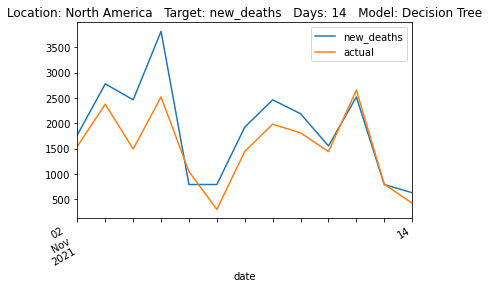

                  MSE        RMSE        R2         MAE       RAE      RRSE
models                                                                     
lstm             None        None      None        None      None      None
dt               None        None      None        None      None      None
rf      180556.211715  424.919065  0.653473  333.962308  0.580726  0.588665


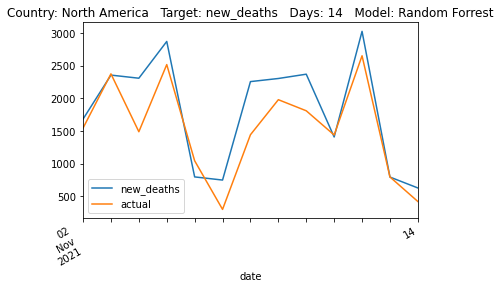

             MSE        RMSE        R2    MAE       RAE      RRSE
models                                                           
lstm        None        None      None   None      None      None
dt      556184.8  745.777983 -0.187789  541.0  1.007777  1.089857
rf          None        None      None   None      None      None


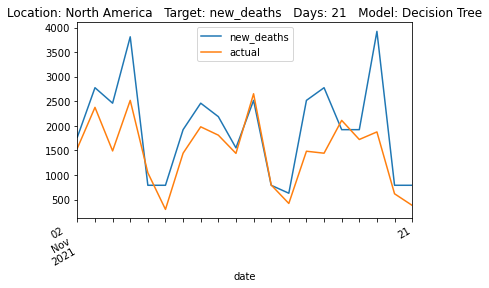

                  MSE        RMSE        R2       MAE       RAE     RRSE
models                                                                  
lstm             None        None      None      None      None     None
dt               None        None      None      None      None     None
rf      446265.551515  668.031101  0.046955  504.6891  0.940137  0.97624


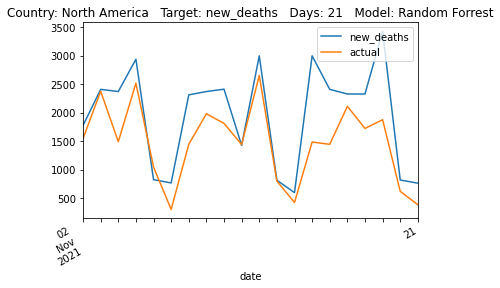

                  MSE        RMSE        R2        MAE      RAE     RRSE
models                                                                  
lstm             None        None      None       None     None     None
dt      478015.131687  691.386384  0.016471  517.37037  0.89636  0.99173
rf               None        None      None       None     None     None


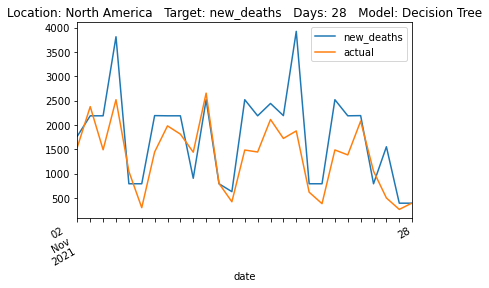

                  MSE        RMSE        R2         MAE       RAE      RRSE
models                                                                     
lstm             None        None      None        None      None      None
dt               None        None      None        None      None      None
rf      499181.095054  706.527491 -0.027078  537.443432  0.931137  1.013449


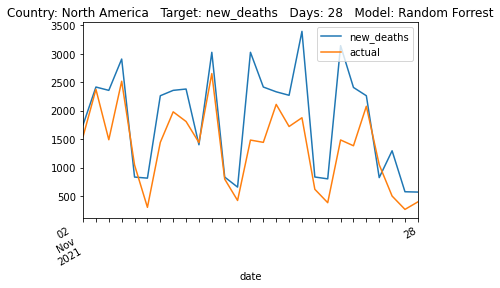

                  MSE        RMSE        R2         MAE       RAE      RRSE
models                                                                     
lstm             None        None      None        None      None      None
dt      562568.544061  750.045695 -0.184369  560.804598  0.996183  1.088287
rf               None        None      None        None      None      None


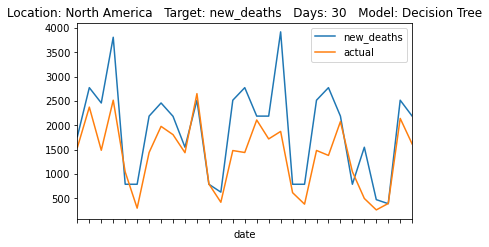

                  MSE        RMSE       R2         MAE       RAE      RRSE
models                                                                    
lstm             None        None     None        None      None      None
dt               None        None     None        None      None      None
rf      512452.143803  715.857628 -0.07886  552.314848  0.981102  1.038682


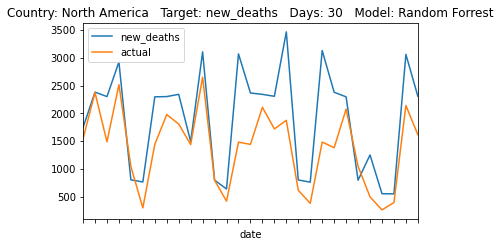

                    MSE        RMSE        R2          MAE       RAE      RRSE
models                                                                        
lstm               None        None      None         None      None      None
dt      75179702.333333  8670.62295 -6.163236  8042.666667  2.841597  2.676422
rf                 None        None      None         None      None      None


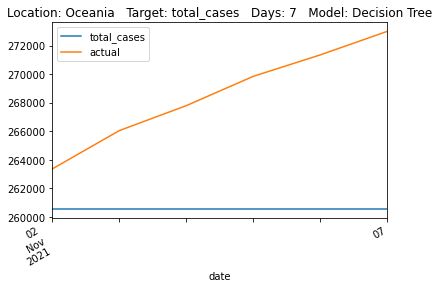

                  MSE          RMSE        R2           MAE      RAE      RRSE
models                                                                        
lstm             None          None      None          None     None      None
dt               None          None      None          None     None      None
rf      111877786.997  10577.229647 -9.659885  10121.413333  3.57605  3.264948


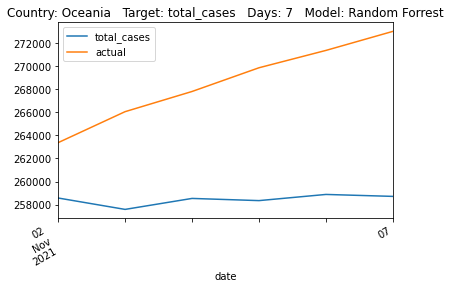

                     MSE          RMSE        R2           MAE       RAE  \
models                                                                     
lstm                None          None      None          None      None   
dt      245515719.923077  15668.941251 -4.598217  14200.692308  2.498217   
rf                  None          None      None          None      None   

            RRSE  
models            
lstm        None  
dt      2.366055  
rf          None  


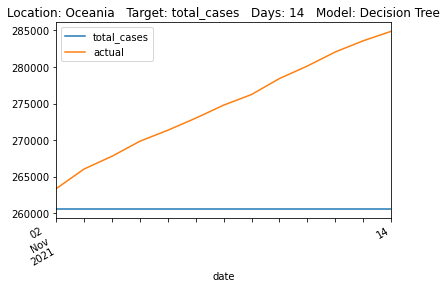

                     MSE          RMSE        R2       MAE       RAE      RRSE
models                                                                        
lstm                None          None      None      None      None      None
dt                  None          None      None      None      None      None
rf      293504374.461623  17131.969369 -5.692448  15876.63  2.793051  2.586977


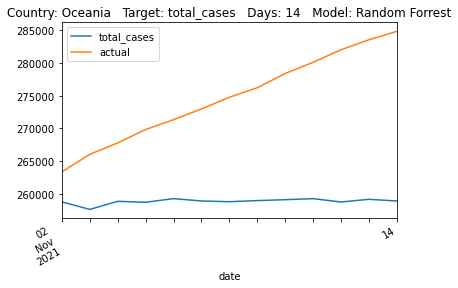

                MSE          RMSE        R2      MAE       RAE     RRSE
models                                                                 
lstm           None          None      None     None      None     None
dt      503931071.2  22448.409102 -4.261886  20413.8  2.417952  2.29388
rf             None          None      None     None      None     None


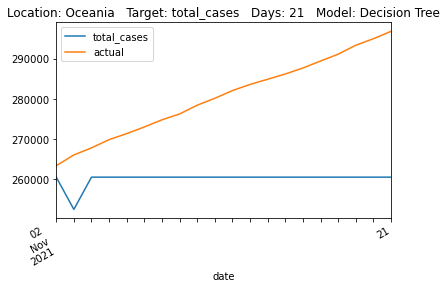

                     MSE          RMSE        R2         MAE       RAE  \
models                                                                   
lstm                None          None      None        None      None   
dt                  None          None      None        None      None   
rf      578532848.181425  24052.709789 -5.040854  22023.1465  2.608574   

            RRSE  
models            
lstm        None  
dt          None  
rf      2.457815  


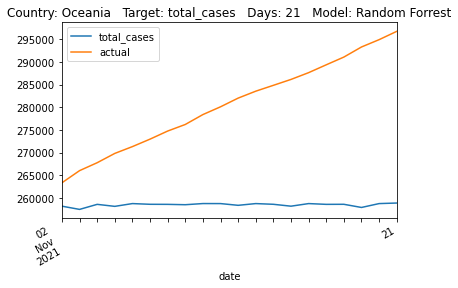

                     MSE          RMSE       R2           MAE      RAE  \
models                                                                   
lstm                None          None     None          None     None   
dt      899726539.407407  29995.441977 -4.18032  27164.666667  2.40249   
rf                  None          None     None          None     None   

            RRSE  
models            
lstm        None  
dt      2.276032  
rf          None  


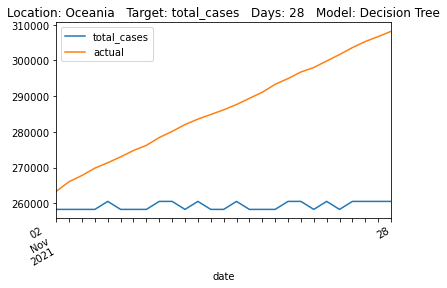

                     MSE          RMSE        R2           MAE       RAE  \
models                                                                     
lstm                None          None      None          None      None   
dt                  None          None      None          None      None   
rf      944505298.786326  30732.804929 -4.438141  27809.797778  2.459546   

            RRSE  
models            
lstm        None  
dt          None  
rf      2.331982  


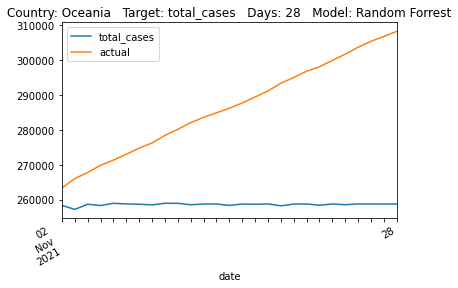

                     MSE         RMSE       R2          MAE      RAE      RRSE
models                                                                        
lstm                None         None     None         None     None      None
dt      958038986.344828  30952.20487 -3.83295  27564.62069  2.26981  2.198397
rf                  None         None     None         None     None      None


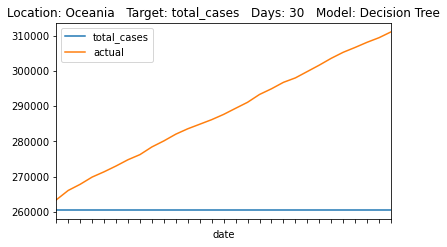

                      MSE          RMSE        R2           MAE      RAE  \
models                                                                     
lstm                 None          None      None          None     None   
dt                   None          None      None          None     None   
rf      1051504200.176538  32426.905498 -4.304448  29287.246897  2.41166   

            RRSE  
models            
lstm        None  
dt          None  
rf      2.303139  


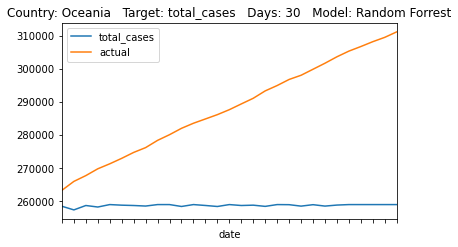

                 MSE        RMSE         R2   MAE       RAE      RRSE
models                                                               
lstm            None        None       None  None      None      None
dt      10002.166667  100.010833 -10.363229  95.5  3.537037  3.370939
rf              None        None       None  None      None      None


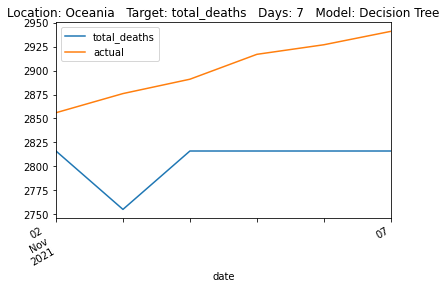

                 MSE        RMSE         R2     MAE   RAE      RRSE
models                                                             
lstm            None        None       None    None  None      None
dt              None        None       None    None  None      None
rf      10938.771867  104.588584 -11.427284  100.71  3.73  3.525235


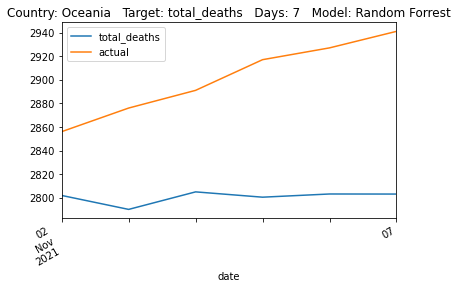

                 MSE        RMSE        R2         MAE       RAE      RRSE
models                                                                    
lstm            None        None      None        None      None      None
dt      24628.615385  156.935067 -6.534577  146.769231  2.954264  2.744918
rf              None        None      None        None      None      None


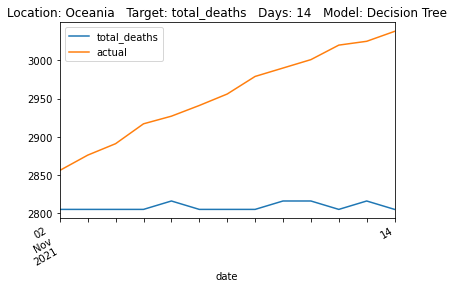

                 MSE        RMSE        R2         MAE       RAE      RRSE
models                                                                    
lstm            None        None      None        None      None      None
dt              None        None      None        None      None      None
rf      26336.202831  162.284327 -7.056975  152.755385  3.074757  2.838481


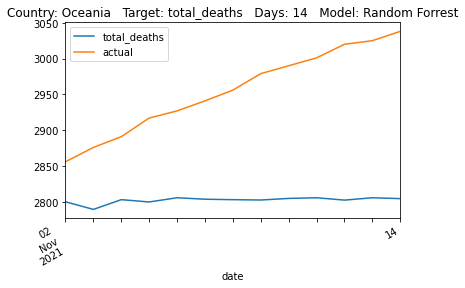

             MSE        RMSE       R2     MAE       RAE    RRSE
models                                                         
lstm        None        None     None    None      None    None
dt      47530.15  218.014105 -4.47607  198.75  2.538314  2.3401
rf          None        None     None    None      None    None


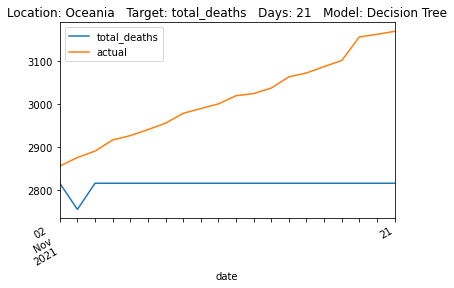

                 MSE        RMSE        R2       MAE       RAE      RRSE
models                                                                  
lstm            None        None      None      None      None      None
dt              None        None      None      None      None      None
rf      55043.077295  234.612611 -5.341653  215.8595  2.756826  2.518264


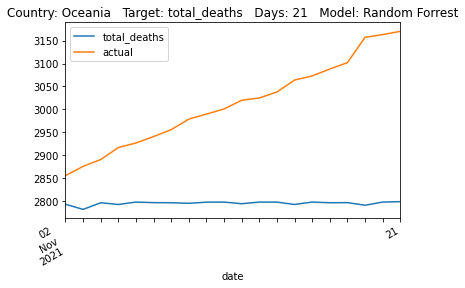

                 MSE        RMSE       R2         MAE       RAE      RRSE
models                                                                   
lstm            None        None     None        None      None      None
dt      88197.555556  296.980733 -3.79994  264.592593  2.249056  2.190877
rf              None        None     None        None      None      None


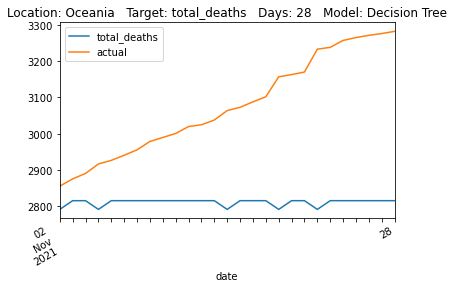

                 MSE        RMSE        R2         MAE       RAE      RRSE
models                                                                    
lstm            None        None      None        None      None      None
dt              None        None      None        None      None      None
rf      91228.902885  302.041227 -3.964914  270.595185  2.300078  2.228209


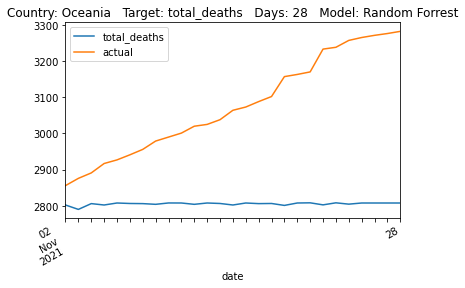

                 MSE        RMSE        R2        MAE       RAE      RRSE
models                                                                   
lstm            None        None      None       None      None      None
dt      97939.103448  312.952238 -3.852436  279.37931  2.228442  2.202824
rf              None        None      None       None      None      None


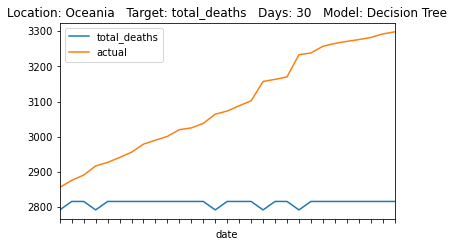

                  MSE        RMSE        R2         MAE      RAE      RRSE
models                                                                    
lstm             None        None      None        None     None      None
dt               None        None      None        None     None      None
rf      102703.620062  320.474055 -4.088496  287.988276  2.29711  2.255769


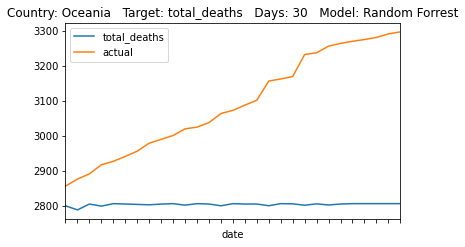

                         MSE            RMSE        R2        MAE       RAE  \
models                                                                        
lstm                    None            None      None       None      None   
dt      1129521597377.333252  1062789.535787 -9.829489  1012532.0  3.511148   
rf                      None            None      None       None      None   

            RRSE  
models            
lstm        None  
dt      3.290819  
rf          None  


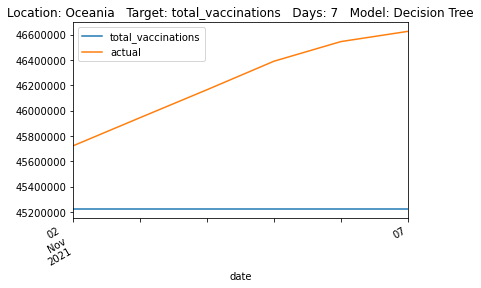

                         MSE            RMSE         R2             MAE  \
models                                                                    
lstm                    None            None       None            None   
dt                      None            None       None            None   
rf      1660761304842.730713  1288705.282383 -14.922844  1253623.266667   

             RAE      RRSE  
models                      
lstm        None      None  
dt          None      None  
rf      4.347178  3.990344  


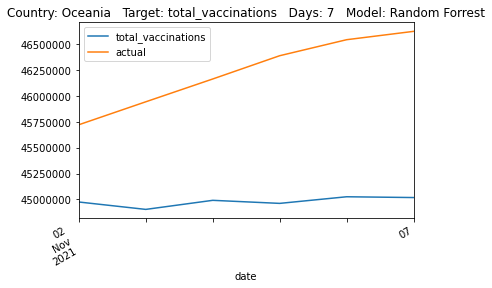

                         MSE            RMSE        R2             MAE  \
models                                                                   
lstm                    None            None      None            None   
dt      3272440957684.692383  1808988.932438 -6.792077  1695423.769231   
rf                      None            None      None            None   

             RAE      RRSE  
models                      
lstm        None      None  
dt      3.018542  2.791429  
rf          None      None  


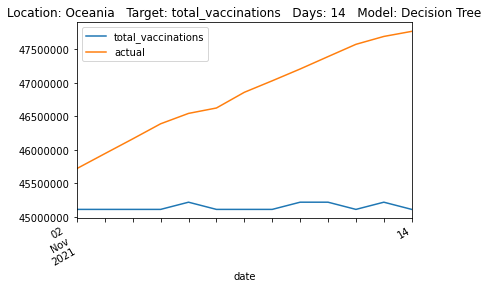

                         MSE            RMSE       R2             MAE  \
models                                                                  
lstm                    None            None     None            None   
dt                      None            None     None            None   
rf      3572742053289.163574  1890169.847736 -7.50713  1787523.167692   

             RAE      RRSE  
models                      
lstm        None      None  
dt          None      None  
rf      3.182516  2.916699  


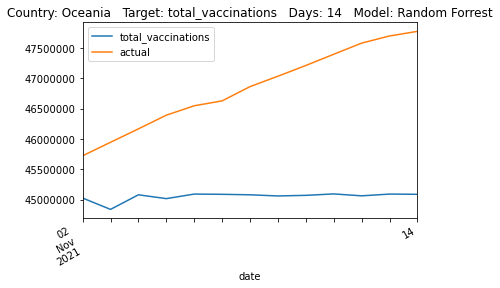

                     MSE            RMSE        R2         MAE       RAE  \
models                                                                     
lstm                None            None      None        None      None   
dt      6224607455621.25  2494916.322369 -6.291462  2328685.45  2.909259   
rf                  None            None      None        None      None   

            RRSE  
models            
lstm        None  
dt      2.700271  
rf          None  


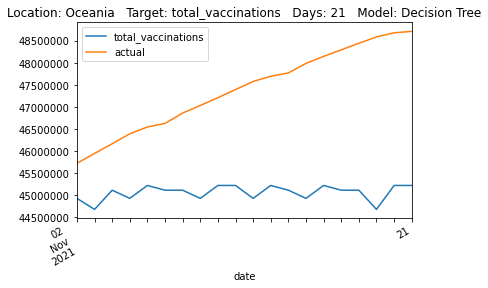

                         MSE            RMSE        R2          MAE       RAE  \
models                                                                          
lstm                    None            None      None         None      None   
dt                      None            None      None         None      None   
rf      6551677366908.662109  2559624.458179 -6.674589  2390757.233  2.986806   

            RRSE  
models            
lstm        None  
dt          None  
rf      2.770305  


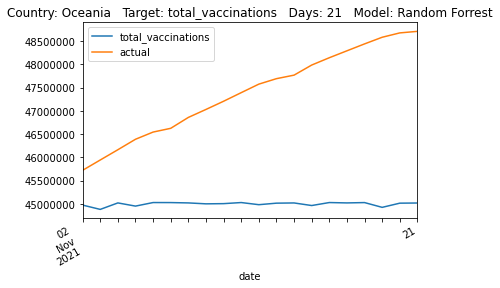

                         MSE            RMSE        R2             MAE  \
models                                                                   
lstm                    None            None      None            None   
dt      8994084725389.851562  2999013.958852 -5.416576  2756672.888889   
rf                      None            None      None            None   

             RAE      RRSE  
models                      
lstm        None      None  
dt      2.690493  2.533096  
rf          None      None  


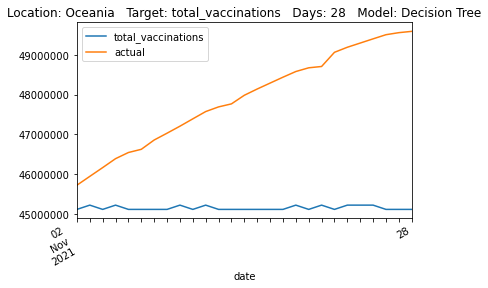

                         MSE            RMSE       R2             MAE  \
models                                                                  
lstm                    None            None     None            None   
dt                      None            None     None            None   
rf      9424957689248.839844  3070009.395629 -5.72397  2836662.337407   

             RAE      RRSE  
models                      
lstm        None      None  
dt          None      None  
rf      2.768562  2.593062  


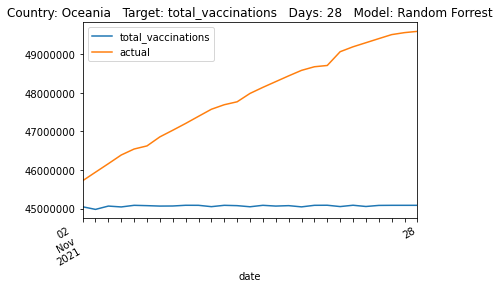

                         MSE            RMSE        R2             MAE  \
models                                                                   
lstm                    None            None      None            None   
dt      9812460812411.724609  3132484.766509 -5.236953  2881383.655172   
rf                      None            None      None            None   

             RAE      RRSE  
models                      
lstm        None      None  
dt      2.657732  2.497389  
rf          None      None  


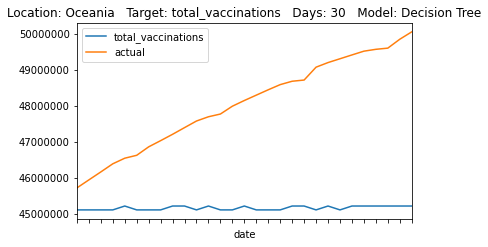

                          MSE            RMSE        R2             MAE  \
models                                                                    
lstm                     None            None      None            None   
dt                       None            None      None            None   
rf      10332983514211.757812  3214495.841374 -5.567805  2965751.654828   

             RAE      RRSE  
models                      
lstm        None      None  
dt          None      None  
rf      2.735551  2.562773  


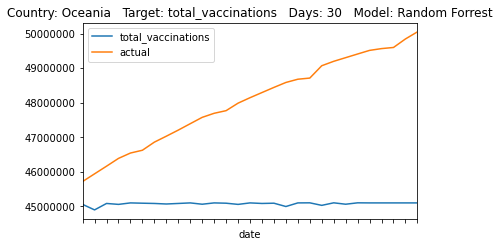

                        MSE           RMSE         R2            MAE  \
models                                                                 
lstm                   None           None       None           None   
dt      652998816425.333374  808083.421699 -13.026963  783029.666667   
rf                     None           None       None           None   

             RAE      RRSE  
models                      
lstm        None      None  
dt      4.062088  3.745259  
rf          None      None  


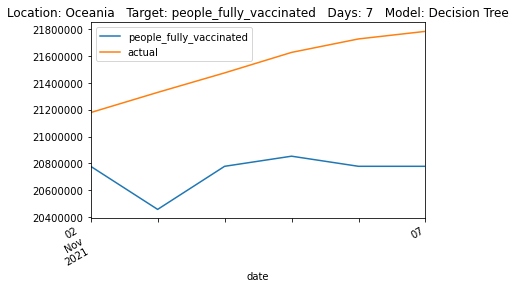

                       MSE           RMSE         R2         MAE       RAE  \
models                                                                       
lstm                  None           None       None        None      None   
dt                    None           None       None        None      None   
rf      732530788060.88916  855880.124819 -14.735377  833339.645  4.323078   

            RRSE  
models            
lstm        None  
dt          None  
rf      3.966784  


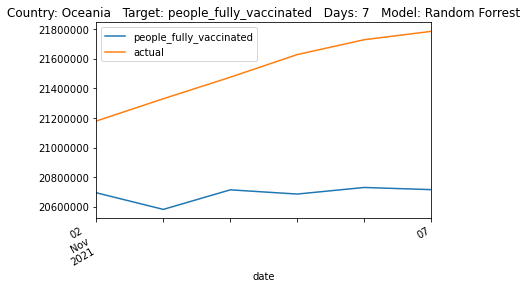

                    MSE            RMSE        R2             MAE       RAE  \
models                                                                        
lstm               None            None      None            None      None   
dt      1410758363739.0  1187753.494518 -7.073728  1110402.538462  3.072316   
rf                 None            None      None            None      None   

            RRSE  
models            
lstm        None  
dt      2.841431  
rf          None  


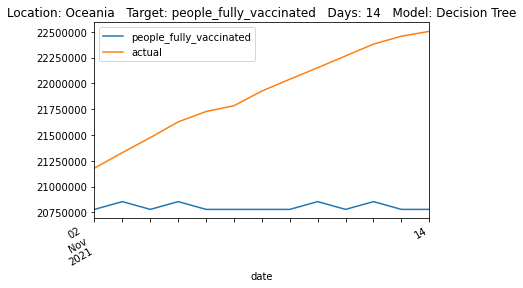

                         MSE            RMSE        R2             MAE  \
models                                                                   
lstm                    None            None      None            None   
dt                      None            None      None            None   
rf      1534463524902.259521  1238734.646687 -7.781689  1171538.659231   

            RAE      RRSE  
models                     
lstm       None      None  
dt         None      None  
rf      3.24147  2.963391  


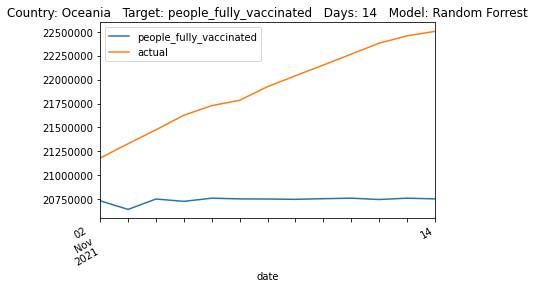

                    MSE            RMSE        R2        MAE       RAE  \
models                                                                   
lstm               None            None      None       None      None   
dt      2303145258096.5  1517611.695427 -5.765272  1400967.1  2.774223   
rf                 None            None      None       None      None   

            RRSE  
models            
lstm        None  
dt      2.601014  
rf          None  


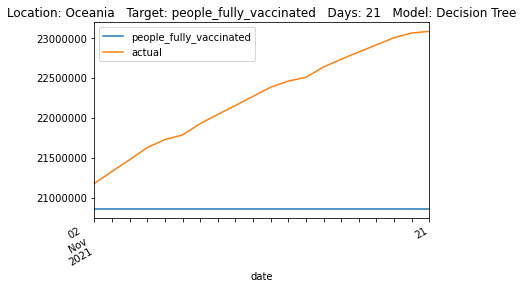

                         MSE           RMSE        R2           MAE       RAE  \
models                                                                          
lstm                    None           None      None          None      None   
dt                      None           None      None          None      None   
rf      2644167803248.493164  1626089.72792 -6.766994  1521270.0565  3.012449   

            RRSE  
models            
lstm        None  
dt          None  
rf      2.786933  


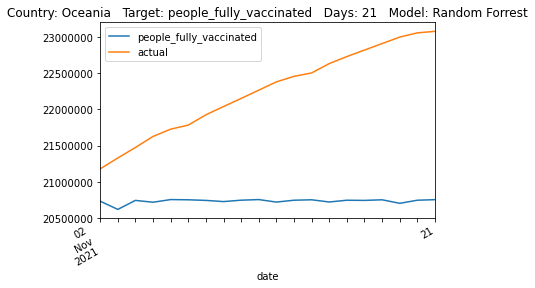

                         MSE            RMSE        R2             MAE  \
models                                                                   
lstm                    None            None      None            None   
dt      3461730754072.370605  1860572.695186 -5.516027  1711860.592593   
rf                      None            None      None            None   

             RAE      RRSE  
models                      
lstm        None      None  
dt      2.719505  2.552651  
rf          None      None  


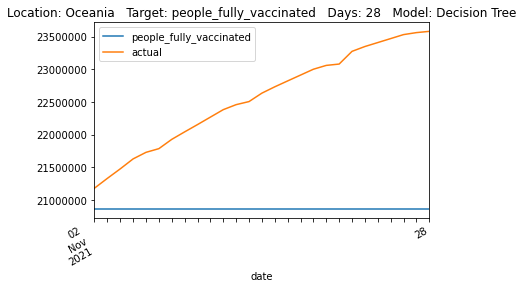

                         MSE            RMSE        R2             MAE  \
models                                                                   
lstm                    None            None      None            None   
dt                      None            None      None            None   
rf      4013038603812.418945  2003256.998943 -6.553755  1871127.774444   

            RAE     RRSE  
models                    
lstm       None     None  
dt         None     None  
rf      2.97252  2.74841  


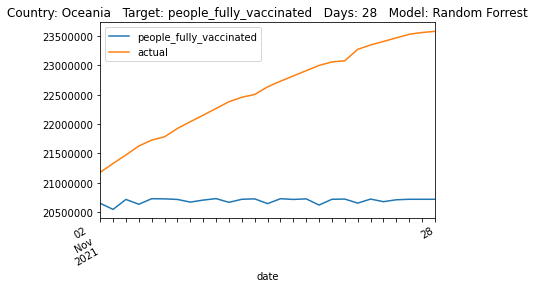

                         MSE            RMSE        R2             MAE  \
models                                                                   
lstm                    None            None      None            None   
dt      3924061886164.689453  1980924.502894 -5.687131  1831170.413793   
rf                      None            None      None            None   

             RAE      RRSE  
models                      
lstm        None      None  
dt      2.770302  2.585949  
rf          None      None  


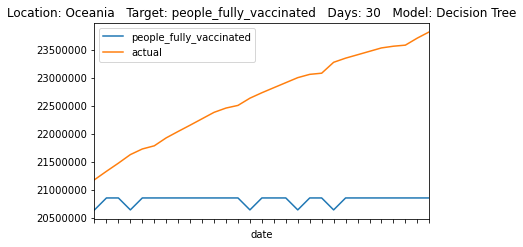

                         MSE            RMSE        R2             MAE  \
models                                                                   
lstm                    None            None      None            None   
dt                      None            None      None            None   
rf      4143775068704.526855  2035626.456083 -6.061551  1890315.197586   

            RAE      RRSE  
models                     
lstm       None      None  
dt         None      None  
rf      2.85978  2.657358  


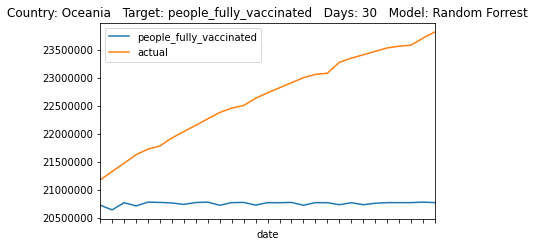

             MSE        RMSE        R2         MAE       RAE      RRSE
models                                                                
lstm        None        None      None        None      None      None
dt      333690.5  577.659502 -0.868516  541.166667  1.555573  1.366937
rf          None        None      None        None      None      None


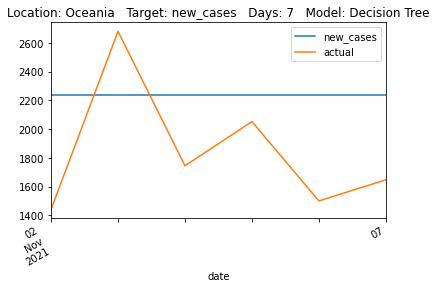

                  MSE        RMSE        R2         MAE       RAE      RRSE
models                                                                     
lstm             None        None      None        None      None      None
dt               None        None      None        None      None      None
rf      190737.993983  436.735611 -0.068047  364.978333  1.049123  1.033463


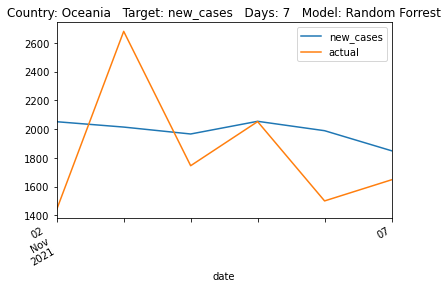

                  MSE        RMSE        R2         MAE       RAE      RRSE
models                                                                     
lstm             None        None      None        None      None      None
dt      355348.384615  596.111051 -1.730055  542.538462  1.962773  1.652288
rf               None        None      None        None      None      None


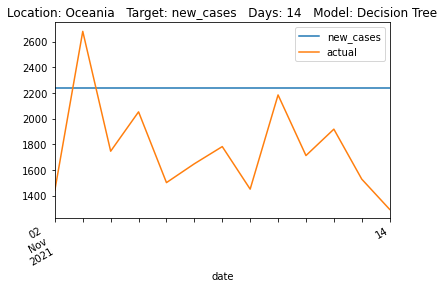

                  MSE        RMSE        R2     MAE       RAE      RRSE
models                                                                 
lstm             None        None      None    None      None      None
dt               None        None      None    None      None      None
rf      157318.952523  396.634533 -0.208643  339.66  1.228808  1.099383


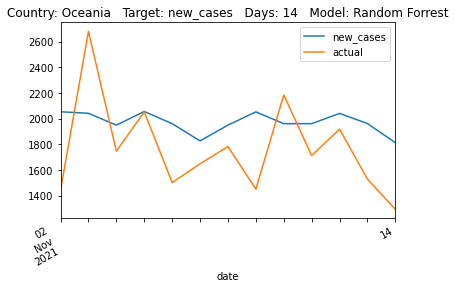

              MSE        RMSE       R2     MAE       RAE      RRSE
models                                                            
lstm         None        None     None    None      None      None
dt      357788.25  598.154035 -2.23119  541.25  2.177718  1.797551
rf           None        None     None    None      None      None


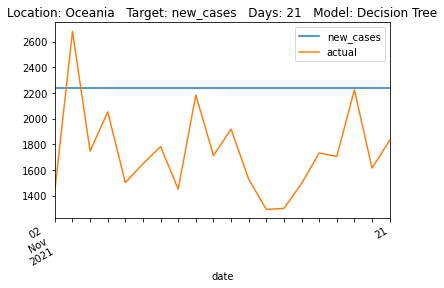

                 MSE        RMSE        R2      MAE       RAE     RRSE
models                                                                
lstm            None        None      None     None      None     None
dt              None        None      None     None      None     None
rf      213245.57152  461.785201 -0.925824  410.404  1.651259  1.38774


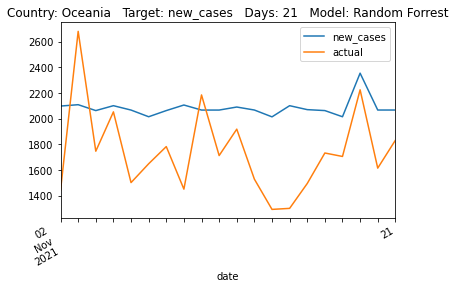

                  MSE        RMSE        R2         MAE       RAE      RRSE
models                                                                     
lstm             None        None      None        None      None      None
dt      376930.074074  613.946312 -2.798163  559.703704  2.376433  1.948888
rf               None        None      None        None      None      None


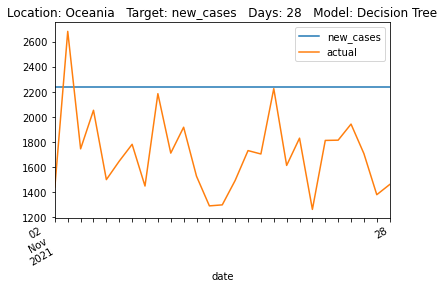

                  MSE        RMSE        R2         MAE       RAE      RRSE
models                                                                     
lstm             None        None      None        None      None      None
dt               None        None      None        None      None      None
rf      206672.636544  454.612623 -1.082551  383.137407  1.626754  1.443105


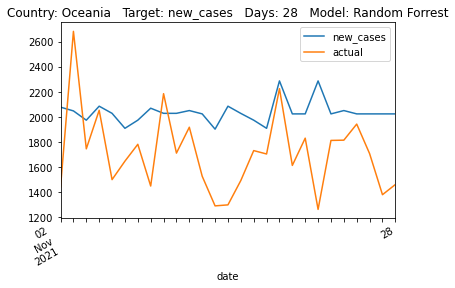

                  MSE        RMSE        R2         MAE       RAE      RRSE
models                                                                     
lstm             None        None      None        None      None      None
dt      392921.827586  626.834769 -3.009491  573.551724  2.438832  2.002371
rf               None        None      None        None      None      None


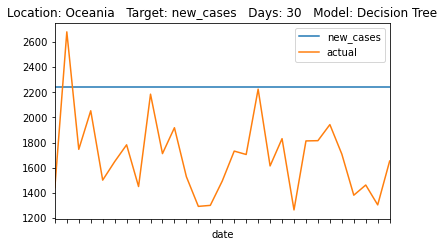

                  MSE        RMSE        R2        MAE       RAE     RRSE
models                                                                   
lstm             None        None      None       None      None     None
dt               None        None      None       None      None     None
rf      196585.713821  443.379875 -1.006019  372.74069  1.584952  1.41634


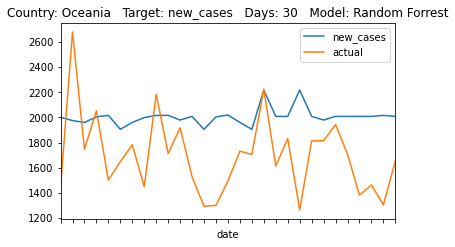

         MSE      RMSE        R2       MAE       RAE      RRSE
models                                                        
lstm    None      None      None      None      None      None
dt      86.0  9.273618 -1.192635  7.333333  1.294118  1.480755
rf      None      None      None      None      None      None


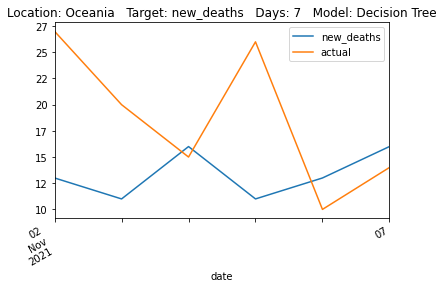

              MSE      RMSE        R2       MAE       RAE      RRSE
models                                                             
lstm         None      None      None      None      None      None
dt           None      None      None      None      None      None
rf      32.151937  5.670268  0.180262  4.953778  0.874196  0.905394


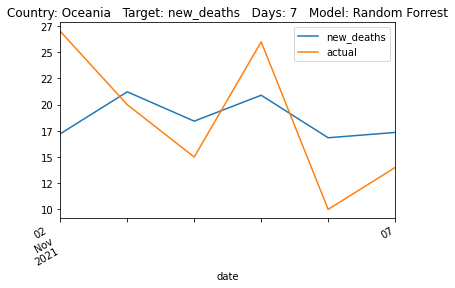

               MSE       RMSE       R2       MAE       RAE      RRSE
models                                                              
lstm          None       None     None      None      None      None
dt      138.076923  11.750614 -2.47247  7.769231  1.458889  1.863457
rf            None       None     None      None      None      None


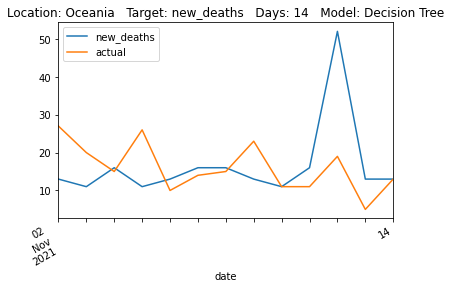

              MSE      RMSE       R2       MAE       RAE      RRSE
models                                                            
lstm         None      None     None      None      None      None
dt           None      None     None      None      None      None
rf      36.972308  6.080486  0.07019  4.632046  0.869795  0.964266


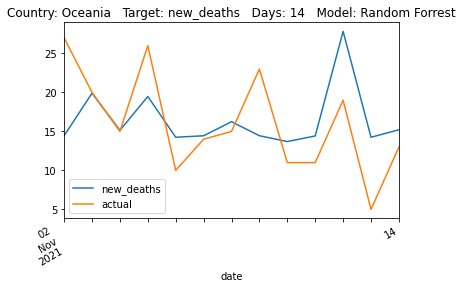

          MSE       RMSE        R2   MAE       RAE      RRSE
models                                                      
lstm     None       None      None  None      None      None
dt      199.4  14.120906 -0.696336   8.8  1.148076  1.302434
rf       None       None      None  None      None      None


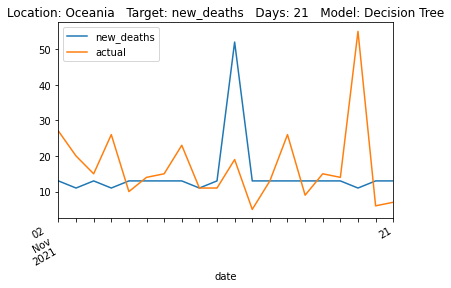

               MSE       RMSE        R2       MAE       RAE      RRSE
models                                                               
lstm          None       None      None      None      None      None
dt            None       None      None      None      None      None
rf      124.572632  11.161211 -0.059764  8.022567  1.046649  1.029448


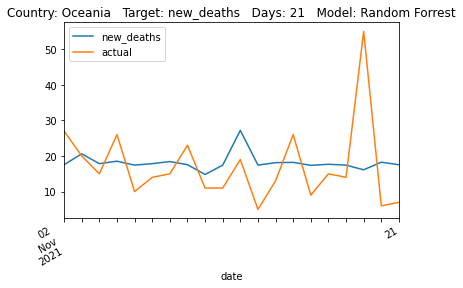

               MSE       RMSE        R2       MAE       RAE      RRSE
models                                                               
lstm          None       None      None      None      None      None
dt      250.333333  15.821926 -0.330337  9.814815  1.043307  1.153402
rf            None       None      None      None      None      None


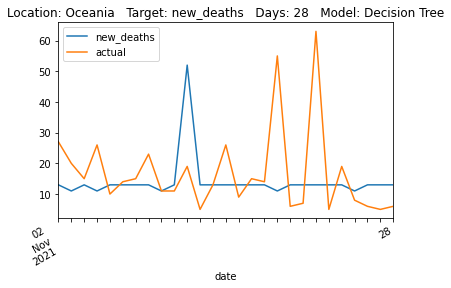

               MSE       RMSE        R2        MAE       RAE      RRSE
models                                                                
lstm          None       None      None       None      None      None
dt            None       None      None       None      None      None
rf      204.557887  14.302373 -0.087074  10.639841  1.131007  1.042629


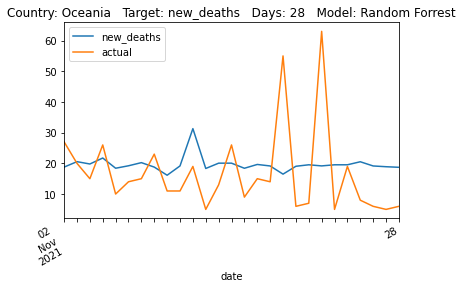

               MSE       RMSE        R2       MAE       RAE     RRSE
models                                                              
lstm          None       None      None      None      None     None
dt      235.068966  15.331959 -0.302909  9.482759  1.038141  1.14145
rf            None       None      None      None      None     None


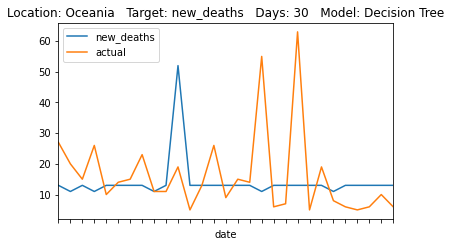

               MSE      RMSE        R2        MAE       RAE      RRSE
models                                                               
lstm          None      None      None       None      None      None
dt            None      None      None       None      None      None
rf      199.092957  14.11003 -0.103506  10.507155  1.150289  1.050479


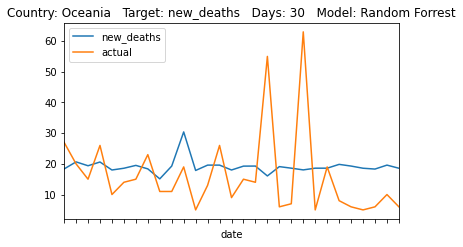

                      MSE          RMSE        R2           MAE       RAE  \
models                                                                      
lstm                 None          None      None          None      None   
dt      7378734204.833333  85899.558816 -4.422858  77576.166667  2.364779   
rf                   None          None      None          None      None   

            RRSE  
models            
lstm        None  
dt      2.328703  
rf          None  


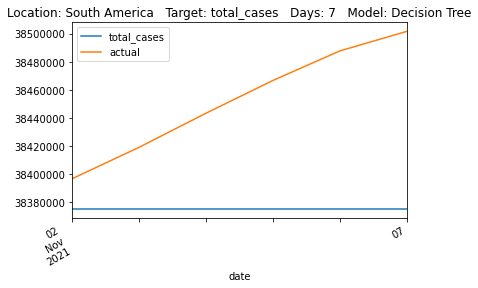

                     MSE           RMSE        R2        MAE       RAE  \
models                                                                   
lstm                None           None      None       None      None   
dt                  None           None      None       None      None   
rf      10992308816.6332  104844.212127 -7.078585  97460.775  2.970927   

            RRSE  
models            
lstm        None  
dt          None  
rf      2.842285  


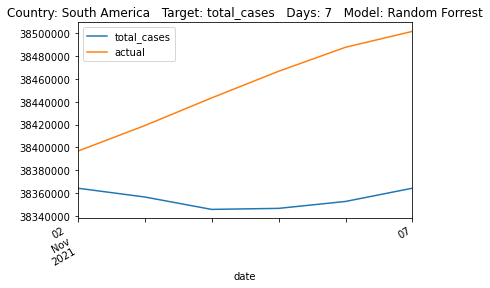

                       MSE           RMSE        R2            MAE       RAE  \
models                                                                         
lstm                  None           None      None           None      None   
dt      31506179616.076923  177499.801735 -4.358344  159658.384615  2.451872   
rf                    None           None      None           None      None   

           RRSE  
models           
lstm       None  
dt      2.31481  
rf         None  


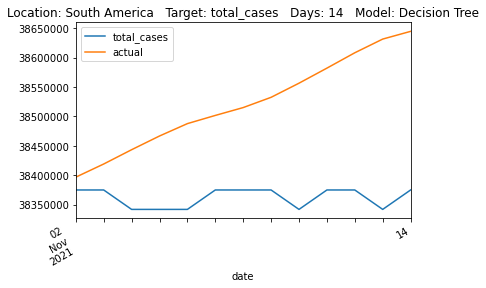

                       MSE           RMSE        R2            MAE       RAE  \
models                                                                         
lstm                  None           None      None           None      None   
dt                    None           None      None           None      None   
rf      34386547919.014107  185436.101984 -4.848216  168592.563077  2.589074   

            RRSE  
models            
lstm        None  
dt          None  
rf      2.418309  


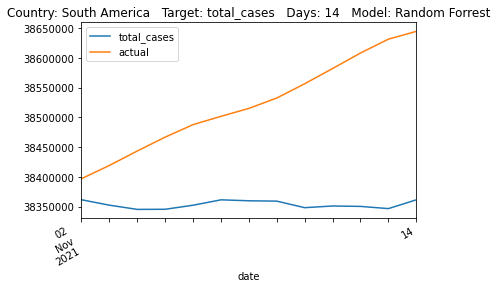

                       MSE           RMSE        R2        MAE      RAE  \
models                                                                    
lstm                  None           None      None       None     None   
dt      72627940309.350006  269495.714826 -4.595122  244535.35  2.45052   
rf                    None           None      None       None     None   

            RRSE  
models            
lstm        None  
dt      2.365401  
rf          None  


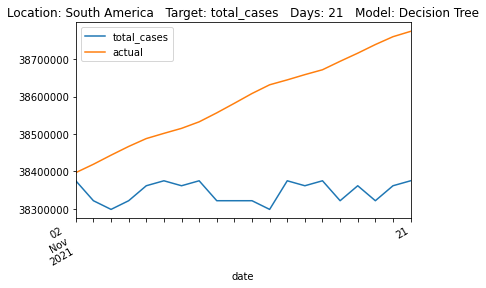

                      MSE           RMSE        R2          MAE       RAE  \
models                                                                      
lstm                 None           None      None         None      None   
dt                   None           None      None         None      None   
rf      68985205239.05928  262650.347875 -4.314492  236894.3465  2.373949   

            RRSE  
models            
lstm        None  
dt          None  
rf      2.305318  


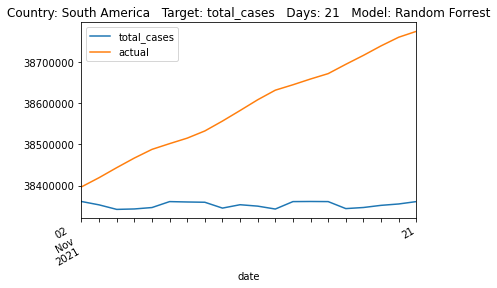

                        MSE           RMSE        R2           MAE       RAE  \
models                                                                         
lstm                   None           None      None          None      None   
dt      106938916653.962967  327015.162728 -3.630828  291995.37037  2.239098   
rf                     None           None      None          None      None   

            RRSE  
models            
lstm        None  
dt      2.151936  
rf          None  


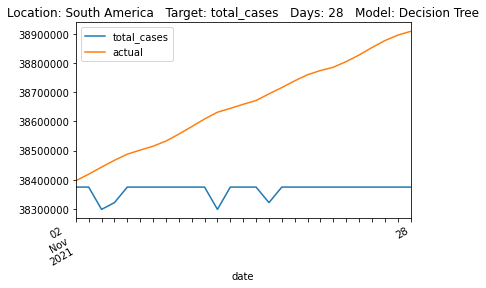

                        MSE           RMSE        R2            MAE       RAE  \
models                                                                          
lstm                   None           None      None           None      None   
dt                     None           None      None           None      None   
rf      113116239121.511154  336327.577105 -3.898327  300280.165185  2.302628   

            RRSE  
models            
lstm        None  
dt          None  
rf      2.213217  


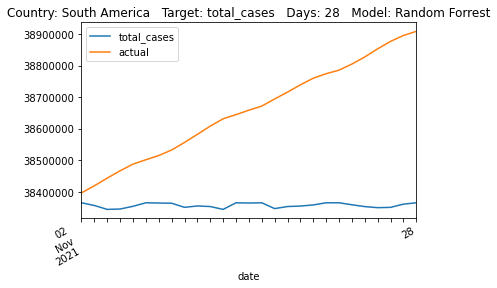

                        MSE           RMSE        R2            MAE       RAE  \
models                                                                          
lstm                   None           None      None           None      None   
dt      130050579130.413788  360625.261359 -3.937055  323354.206897  2.310795   
rf                     None           None      None           None      None   

            RRSE  
models            
lstm        None  
dt      2.221948  
rf          None  


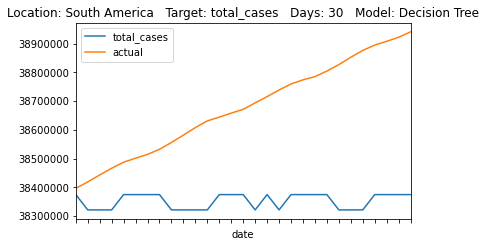

                        MSE           RMSE        R2            MAE       RAE  \
models                                                                          
lstm                   None           None      None           None      None   
dt                     None           None      None           None      None   
rf      129111004575.380325  359320.197839 -3.901386  320703.816207  2.291854   

            RRSE  
models            
lstm        None  
dt          None  
rf      2.213907  


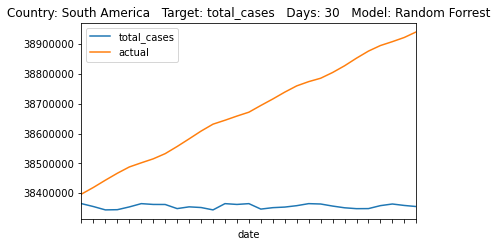

                   MSE         RMSE        R2     MAE       RAE      RRSE
models                                                                   
lstm              None         None      None    None      None      None
dt      4263119.166667  2064.732226 -6.276012  1850.5  2.661952  2.697408
rf                None         None      None    None      None      None


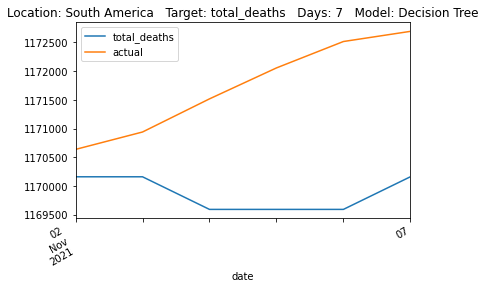

                   MSE         RMSE        R2       MAE       RAE      RRSE
models                                                                     
lstm              None         None      None      None      None      None
dt                None         None      None      None      None      None
rf      4708278.885517  2169.856881 -7.035781  2014.615  2.898032  2.834745


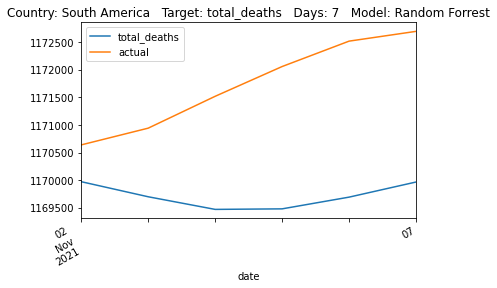

                    MSE         RMSE        R2          MAE       RAE  \
models                                                                  
lstm               None         None      None         None      None   
dt      12604250.615385  3550.246557 -4.891411  3214.461538  2.654866   
rf                 None         None      None         None      None   

            RRSE  
models            
lstm        None  
dt      2.427223  
rf          None  


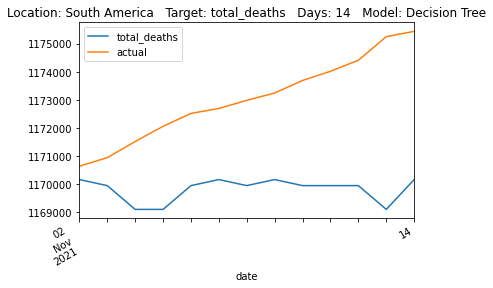

                    MSE         RMSE       R2      MAE       RAE      RRSE
models                                                                    
lstm               None         None     None     None      None      None
dt                 None         None     None     None      None      None
rf      12295892.109377  3506.549887 -4.74728  3182.31  2.628312  2.397348


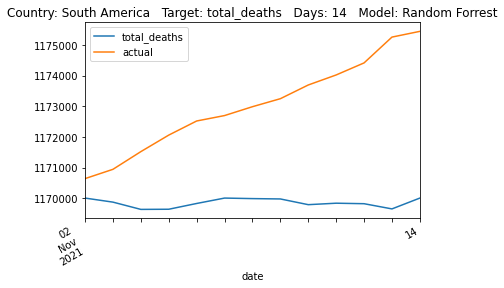

               MSE         RMSE        R2     MAE       RAE      RRSE
models                                                               
lstm          None         None      None    None      None      None
dt      24218565.9  4921.236217 -3.775424  4376.4  2.224289  2.185274
rf            None         None      None    None      None      None


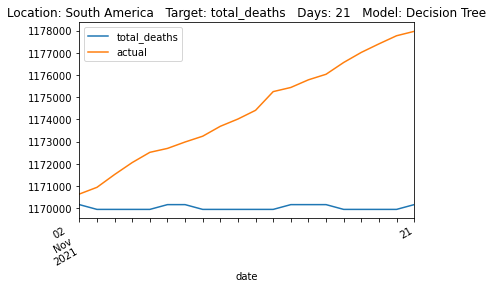

                    MSE         RMSE        R2        MAE       RAE      RRSE
models                                                                       
lstm               None         None      None       None      None      None
dt                 None         None      None       None      None      None
rf      26099075.861355  5108.725463 -4.146223  4591.8125  2.333772  2.268529


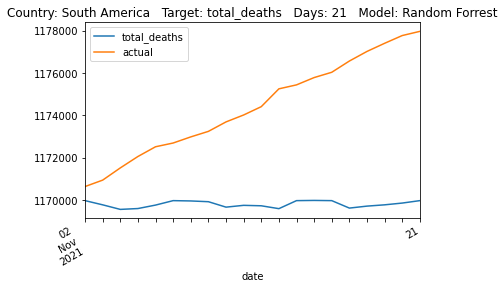

                    MSE        RMSE        R2          MAE      RAE      RRSE
models                                                                       
lstm               None        None      None         None     None      None
dt      41522097.703704  6443.76425 -3.569294  5734.740741  2.19976  2.137591
rf                 None        None      None         None     None      None


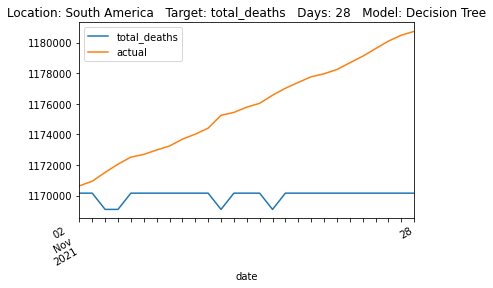

                    MSE         RMSE        R2          MAE       RAE  \
models                                                                  
lstm               None         None      None         None      None   
dt                 None         None      None         None      None   
rf      45108164.800566  6716.261222 -3.963922  6004.856667  2.303372   

            RRSE  
models            
lstm        None  
dt          None  
rf      2.227986  


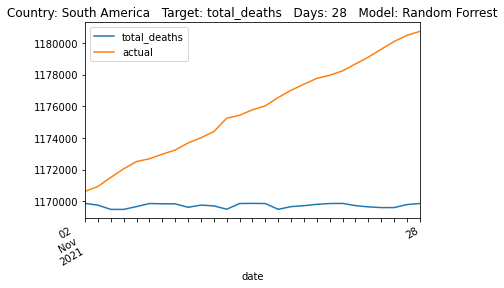

                    MSE         RMSE       R2          MAE       RAE      RRSE
models                                                                        
lstm               None         None     None         None      None      None
dt      49115990.931034  7008.280169 -3.66445  6241.068966  2.222479  2.159734
rf                 None         None     None         None      None      None


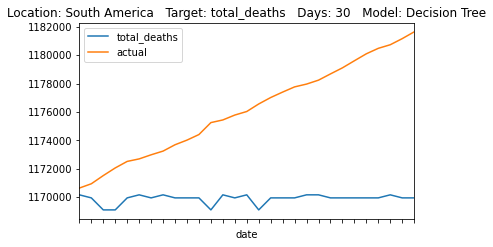

                    MSE         RMSE        R2          MAE       RAE  \
models                                                                  
lstm               None         None      None         None      None   
dt                 None         None      None         None      None   
rf      50423804.271965  7100.972065 -3.788651  6321.113793  2.250983   

            RRSE  
models            
lstm        None  
dt          None  
rf      2.188299  


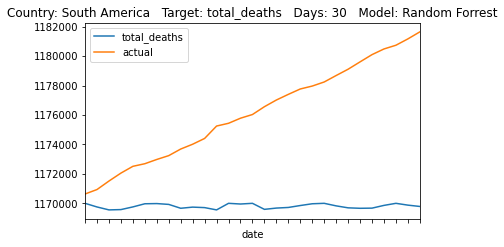

                          MSE             RMSE        R2         MAE  \
models                                                                 
lstm                     None             None      None        None   
dt      238805580222798.34375  15453335.569475 -3.376152  13330529.0   
rf                       None             None      None        None   

             RAE      RRSE  
models                      
lstm        None      None  
dt      1.858738  2.091925  
rf          None      None  


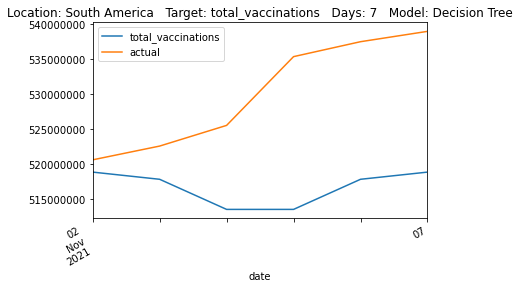

                          MSE             RMSE        R2              MAE  \
models                                                                      
lstm                     None             None      None             None   
dt                       None             None      None             None   
rf      230977257560469.15625  15197935.963823 -3.232697  13225030.786667   

             RAE      RRSE  
models                      
lstm        None      None  
dt          None      None  
rf      1.844028  2.057352  


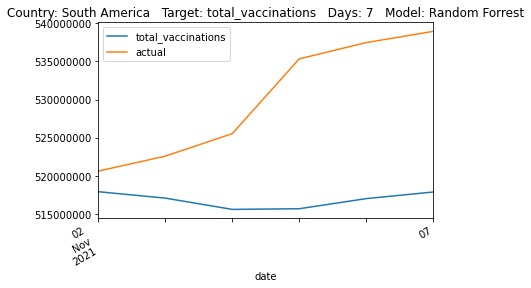

                        MSE             RMSE        R2              MAE  \
models                                                                    
lstm                   None             None      None             None   
dt      727545215370610.875  26973046.089951 -4.843208  24379979.230769   
rf                     None             None      None             None   

             RAE      RRSE  
models                      
lstm        None      None  
dt      2.613151  2.417273  
rf          None      None  


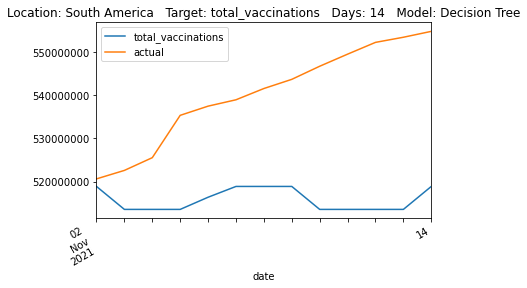

                        MSE             RMSE        R2              MAE  \
models                                                                    
lstm                   None             None      None             None   
dt                     None             None      None             None   
rf      669568123335557.375  25876014.440705 -4.377571  23336038.971538   

             RAE      RRSE  
models                      
lstm        None      None  
dt          None      None  
rf      2.501257  2.318959  


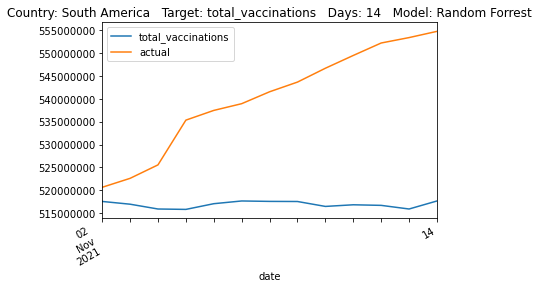

                       MSE             RMSE        R2          MAE       RAE  \
models                                                                         
lstm                  None             None      None         None      None   
dt      1243880661287664.5  35268692.367136 -4.685864  32094282.75  2.574746   
rf                    None             None      None         None      None   

            RRSE  
models            
lstm        None  
dt      2.384505  
rf          None  


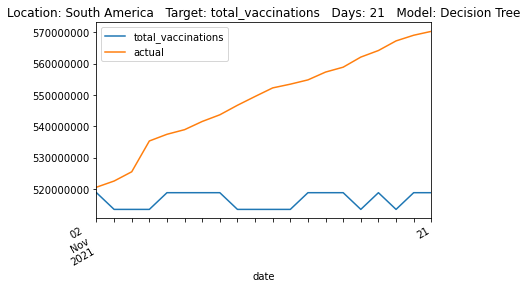

                       MSE             RMSE        R2          MAE       RAE  \
models                                                                         
lstm                  None             None      None         None      None   
dt                    None             None      None         None      None   
rf      1221792414908698.0  34954147.320578 -4.584897  31704189.65  2.543451   

            RRSE  
models            
lstm        None  
dt          None  
rf      2.363239  


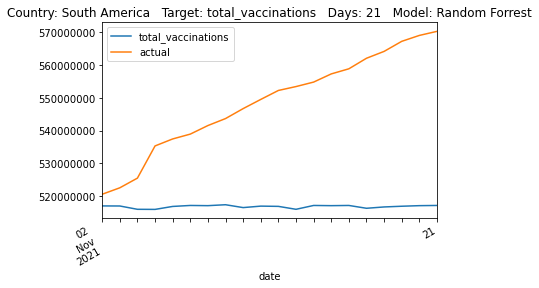

                       MSE             RMSE        R2              MAE  \
models                                                                   
lstm                  None             None      None             None   
dt      1729779316018752.0  41590615.720602 -4.186243  37366389.407407   
rf                    None             None      None             None   

             RAE      RRSE  
models                      
lstm        None      None  
dt      2.418605  2.277332  
rf          None      None  


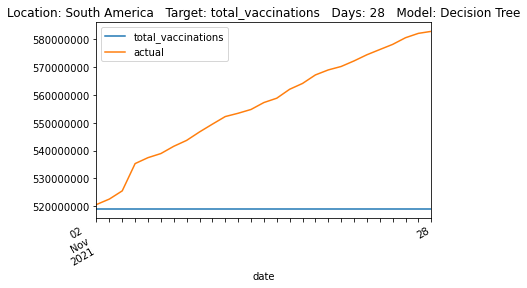

                        MSE             RMSE       R2              MAE  \
models                                                                   
lstm                   None             None     None             None   
dt                     None             None     None             None   
rf      1853321895691500.25  43050225.268766 -4.55665  39017610.072593   

             RAE      RRSE  
models                      
lstm        None      None  
dt          None      None  
rf      2.525483  2.357255  


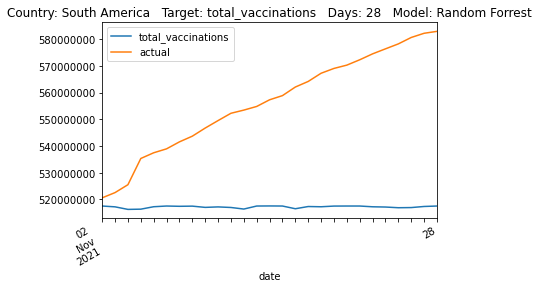

                        MSE             RMSE        R2              MAE  \
models                                                                    
lstm                   None             None      None             None   
dt      2039545874176133.25  45161331.625364 -4.405747  40923626.965517   
rf                     None             None      None             None   

             RAE      RRSE  
models                      
lstm        None      None  
dt      2.486697  2.325026  
rf          None      None  


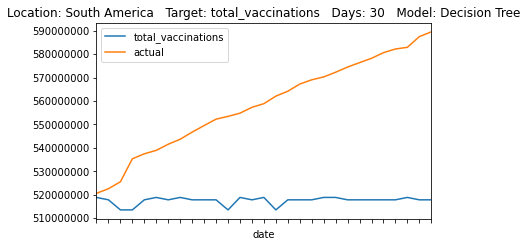

                       MSE             RMSE       R2              MAE  \
models                                                                  
lstm                  None             None     None             None   
dt                    None             None     None             None   
rf      2058154883814959.5  45366891.934702 -4.45507  41026191.447241   

             RAE      RRSE  
models                      
lstm        None      None  
dt          None      None  
rf      2.492929  2.335609  


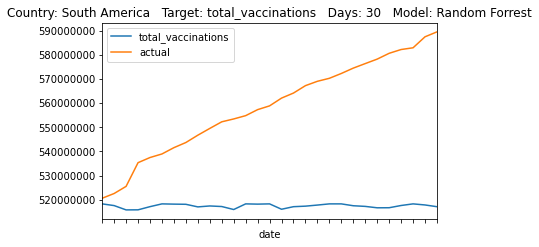

                     MSE           RMSE       R2             MAE       RAE  \
models                                                                       
lstm                None           None     None            None      None   
dt      47269432019361.0  6875276.86856 -2.97374  5910526.666667  1.765425   
rf                  None           None     None            None      None   

            RRSE  
models            
lstm        None  
dt      1.993424  
rf          None  


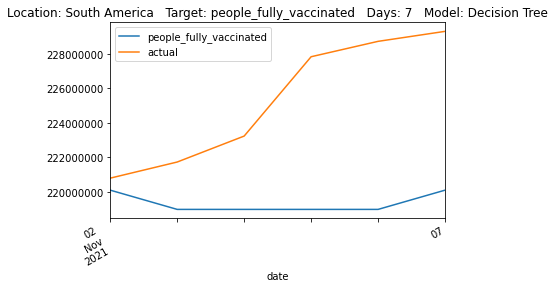

                          MSE            RMSE        R2          MAE  \
models                                                                 
lstm                     None            None      None         None   
dt                       None            None      None         None   
rf      48514231076575.664062  6965215.795406 -3.078385  6019931.695   

             RAE      RRSE  
models                      
lstm        None      None  
dt          None      None  
rf      1.798103  2.019501  


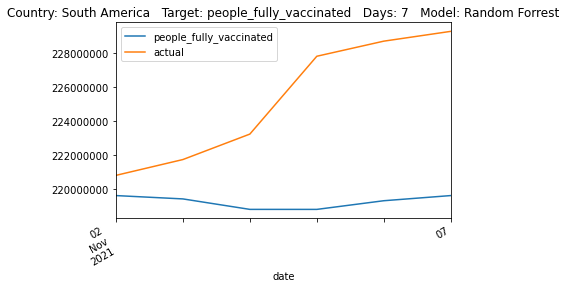

                          MSE             RMSE        R2              MAE  \
models                                                                      
lstm                     None             None      None             None   
dt      134398255322057.84375  11593026.150322 -3.714593  10284707.230769   
rf                       None             None      None             None   

             RAE      RRSE  
models                      
lstm        None      None  
dt      2.301714  2.171311  
rf          None      None  


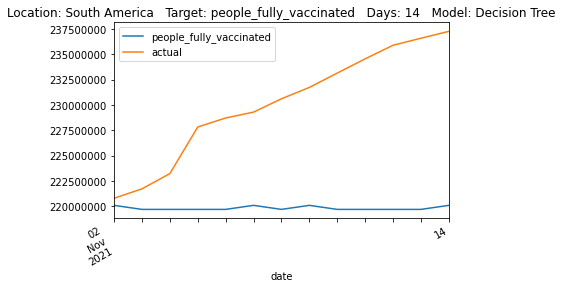

                          MSE             RMSE        R2              MAE  \
models                                                                      
lstm                     None             None      None             None   
dt                       None             None      None             None   
rf      150021110520182.21875  12248310.516973 -4.262631  11018789.985385   

             RAE      RRSE  
models                      
lstm        None      None  
dt          None      None  
rf      2.466002  2.294043  


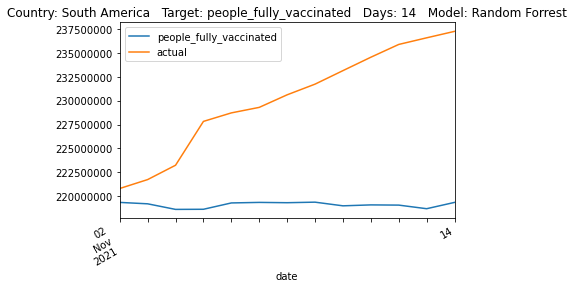

                         MSE             RMSE        R2         MAE       RAE  \
models                                                                          
lstm                    None             None      None        None      None   
dt      264079162299998.3125  16250512.678066 -4.355242  14642417.1  2.465843   
rf                      None             None      None        None      None   

           RRSE  
models           
lstm       None  
dt      2.31414  
rf         None  


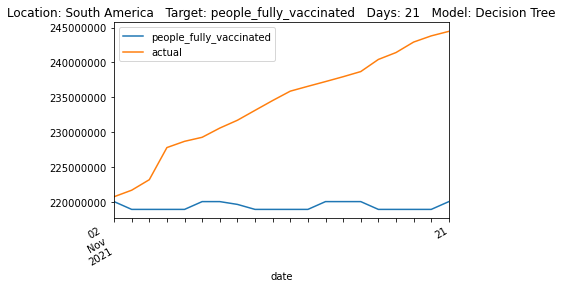

                          MSE             RMSE        R2          MAE  \
models                                                                  
lstm                     None             None      None         None   
dt                       None             None      None         None   
rf      267692358295043.34375  16361306.741671 -4.428514  14800069.68   

             RAE      RRSE  
models                      
lstm        None      None  
dt          None      None  
rf      2.492392  2.329917  


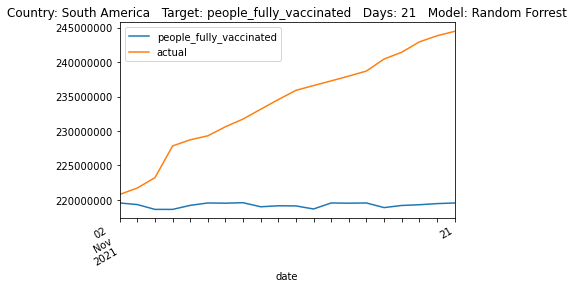

                        MSE             RMSE        R2              MAE  \
models                                                                    
lstm                   None             None      None             None   
dt      431265768783880.125  20766939.321524 -4.656254  18853838.037037   
rf                     None             None      None             None   

             RAE      RRSE  
models                      
lstm        None      None  
dt      2.564759  2.378288  
rf          None      None  


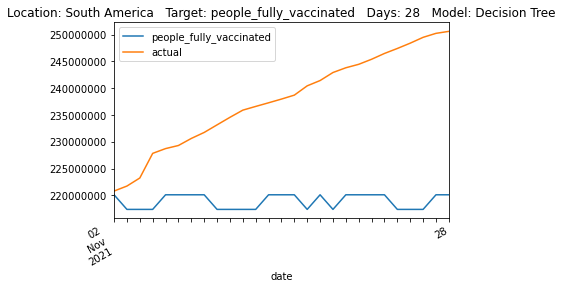

                        MSE             RMSE        R2              MAE  \
models                                                                    
lstm                   None             None      None             None   
dt                     None             None      None             None   
rf      417192394319843.125  20425288.108613 -4.471675  18482285.548889   

             RAE      RRSE  
models                      
lstm        None      None  
dt          None      None  
rf      2.514215  2.339161  


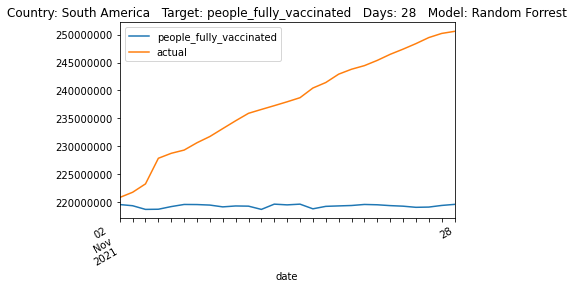

                        MSE             RMSE        R2              MAE  \
models                                                                    
lstm                   None             None      None             None   
dt      432877722471711.875  20805713.697725 -4.101001  18655197.517241   
rf                     None             None      None             None   

             RAE     RRSE  
models                     
lstm        None     None  
dt      2.388245  2.25854  
rf          None     None  


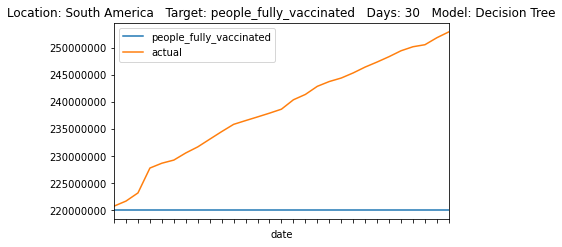

                        MSE             RMSE        R2              MAE  \
models                                                                    
lstm                   None             None      None             None   
dt                     None             None      None             None   
rf      462538986289539.125  21506719.561326 -4.450527  19461779.714138   

             RAE      RRSE  
models                      
lstm        None      None  
dt          None      None  
rf      2.491504  2.334636  


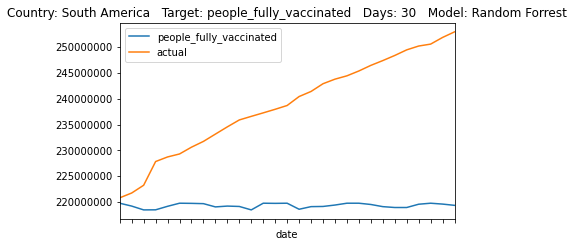

                    MSE         RMSE        R2          MAE       RAE  \
models                                                                  
lstm               None         None      None         None      None   
dt      17757546.177083  4213.970358  0.229057  3080.791667  0.701349   
rf                 None         None      None         None      None   

            RRSE  
models            
lstm        None  
dt      0.878034  
rf          None  


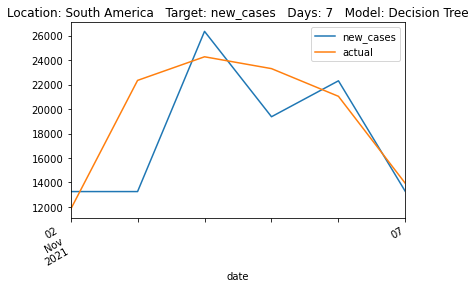

                    MSE         RMSE        R2          MAE       RAE  \
models                                                                  
lstm               None         None      None         None      None   
dt                 None         None      None         None      None   
rf      15456062.548097  3931.419915  0.328976  2636.690052  0.600248   

            RRSE  
models            
lstm        None  
dt          None  
rf      0.819161  


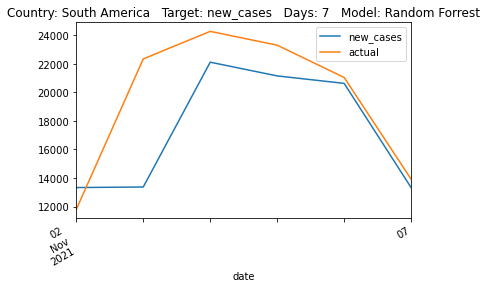

                    MSE         RMSE        R2          MAE       RAE  \
models                                                                  
lstm               None         None      None         None      None   
dt      27457871.509615  5240.025907 -0.071468  3626.692308  0.780597   
rf                 None         None      None         None      None   

            RRSE  
models            
lstm        None  
dt      1.035118  
rf          None  


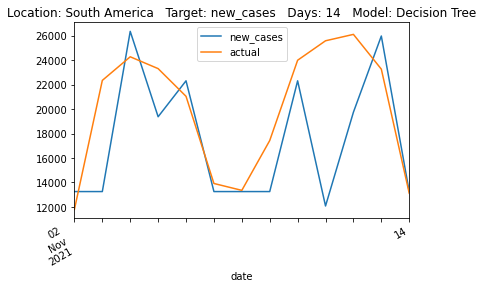

                    MSE         RMSE      R2          MAE       RAE      RRSE
models                                                                       
lstm               None         None    None         None      None      None
dt                 None         None    None         None      None      None
rf      24834526.504111  4983.425178  0.0309  3523.023335  0.758284  0.984429


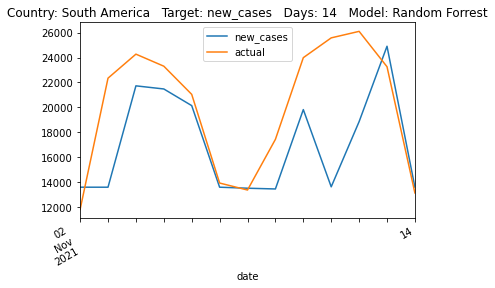

                  MSE         RMSE        R2     MAE       RAE      RRSE
models                                                                  
lstm             None         None      None    None      None      None
dt      18475487.7125  4298.312193  0.203856  2819.2  0.630536  0.892269
rf               None         None      None    None      None      None


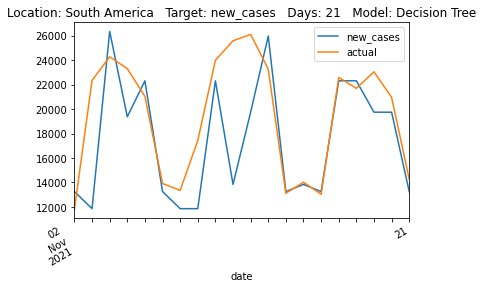

                    MSE         RMSE        R2          MAE       RAE     RRSE
models                                                                        
lstm               None         None      None         None      None     None
dt                 None         None      None         None      None     None
rf      17841657.786568  4223.938658  0.231169  2903.268708  0.649338  0.87683


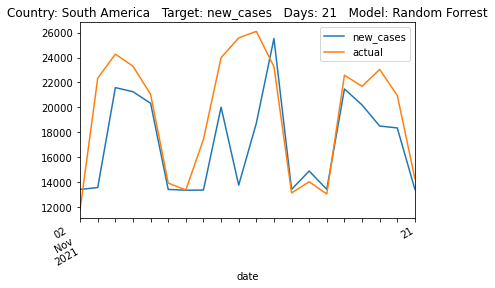

                    MSE         RMSE       R2          MAE       RAE      RRSE
models                                                                        
lstm               None         None     None         None      None      None
dt      15035188.497685  3877.523501  0.36284  2509.898148  0.570861  0.798223
rf                 None         None     None         None      None      None


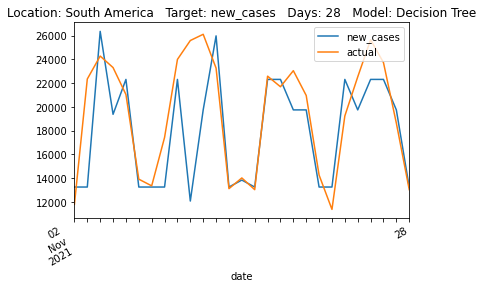

                    MSE         RMSE        R2          MAE       RAE  \
models                                                                  
lstm               None         None      None         None      None   
dt                 None         None      None         None      None   
rf      15898171.577699  3987.251131  0.326269  2789.732512  0.634507   

            RRSE  
models            
lstm        None  
dt          None  
rf      0.820811  


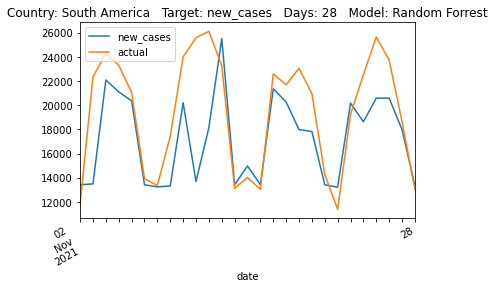

                    MSE         RMSE        R2          MAE       RAE  \
models                                                                  
lstm               None         None      None         None      None   
dt      13895224.793103  3727.629916  0.393412  2573.448276  0.597309   
rf                 None         None      None         None      None   

            RRSE  
models            
lstm        None  
dt      0.778837  
rf          None  


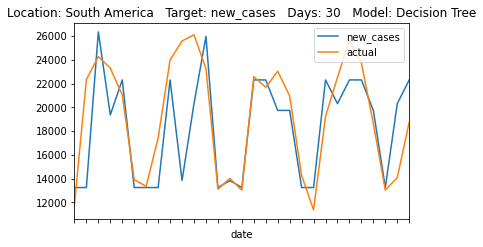

                    MSE         RMSE        R2          MAE       RAE  \
models                                                                  
lstm               None         None      None         None      None   
dt                 None         None      None         None      None   
rf      14759042.520378  3841.749929  0.355703  2703.735839  0.627549   

            RRSE  
models            
lstm        None  
dt          None  
rf      0.802681  


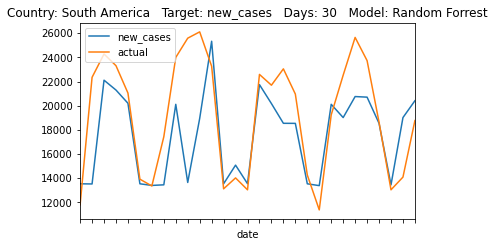

                 MSE        RMSE        R2   MAE      RAE      RRSE
models                                                             
lstm            None        None      None  None     None      None
dt      11270.833333  106.164181  0.518426  72.5  0.50173  0.693956
rf              None        None      None  None     None      None


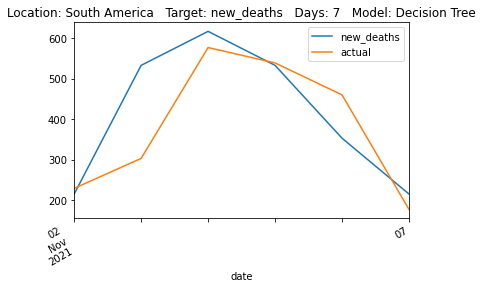

                MSE       RMSE        R2      MAE       RAE      RRSE
models                                                               
lstm           None       None      None     None      None      None
dt             None       None      None     None      None      None
rf      6424.612697  80.153682  0.725492  59.7275  0.413339  0.523935


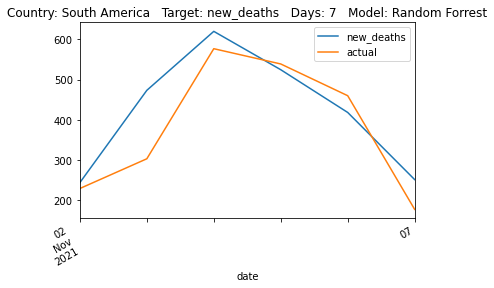

            MSE        RMSE        R2         MAE       RAE      RRSE
models                                                               
lstm       None        None      None        None      None      None
dt      22127.0  148.751471  0.315759  115.769231  0.803953  0.827189
rf         None        None      None        None      None      None


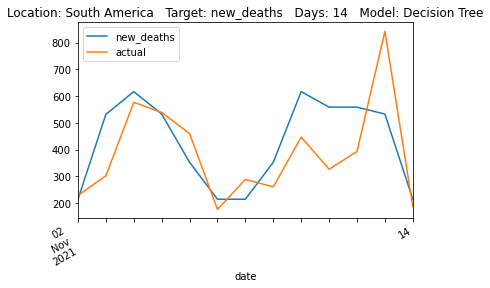

                 MSE        RMSE        R2         MAE       RAE      RRSE
models                                                                    
lstm            None        None      None        None      None      None
dt              None        None      None        None      None      None
rf      25300.396079  159.060982  0.217626  123.335051  0.856493  0.884519


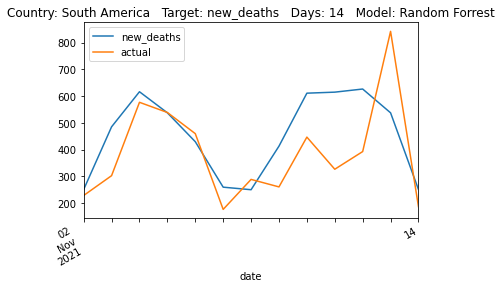

             MSE        RMSE        R2    MAE       RAE      RRSE
models                                                           
lstm        None        None      None   None      None      None
dt      16756.95  129.448638  0.330639  96.55  0.787874  0.818145
rf          None        None      None   None      None      None


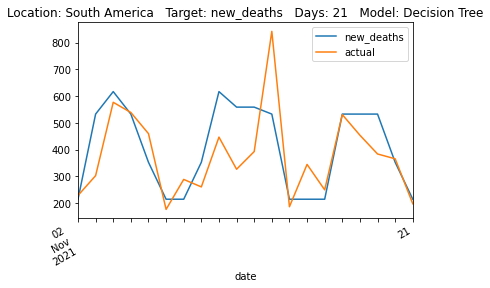

                MSE        RMSE        R2         MAE       RAE      RRSE
models                                                                   
lstm           None        None      None        None      None      None
dt             None        None      None        None      None      None
rf      19378.90292  139.208128  0.225904  103.378179  0.843594  0.879827


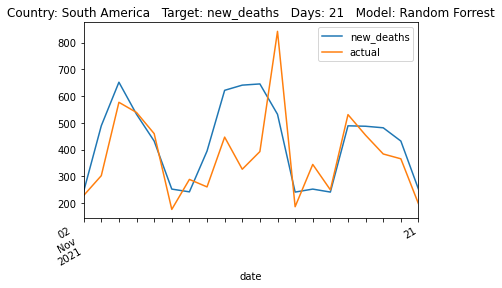

                 MSE        RMSE        R2        MAE       RAE      RRSE
models                                                                   
lstm            None        None      None       None      None      None
dt      16909.074074  130.034896  0.184494  99.666667  0.889489  0.903054
rf              None        None      None       None      None      None


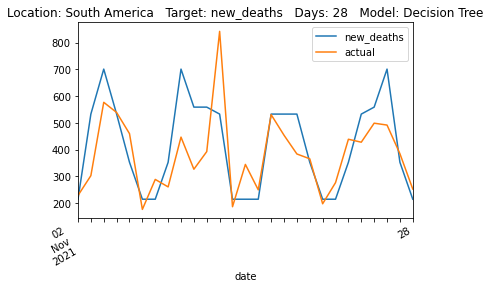

                MSE        RMSE       R2        MAE       RAE      RRSE
models                                                                 
lstm           None        None     None       None      None      None
dt             None        None     None       None      None      None
rf      13583.55895  116.548526  0.34488  86.008198  0.767592  0.809395


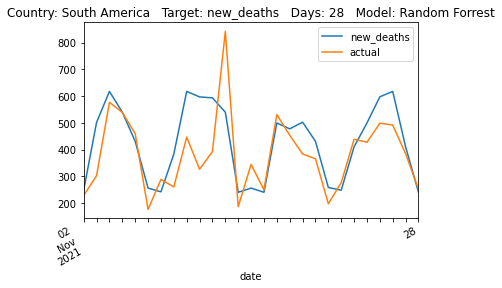

                 MSE        RMSE        R2        MAE       RAE      RRSE
models                                                                   
lstm            None        None      None       None      None      None
dt      15205.068966  123.308836  0.227029  95.827586  0.877878  0.879188
rf              None        None      None       None      None      None


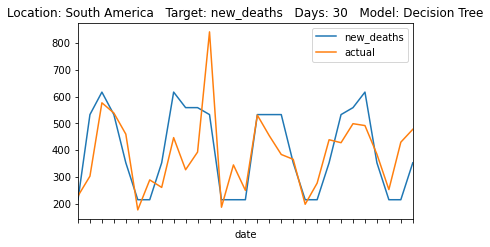

                 MSE        RMSE        R2        MAE       RAE      RRSE
models                                                                   
lstm            None        None      None       None      None      None
dt              None        None      None       None      None      None
rf      15543.146588  124.672156  0.209842  94.571638  0.866373  0.888908


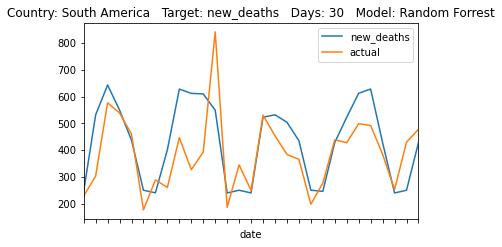

In [121]:
days = [7,14,21,28,30]
continents = {'Africa', 'Asia', 'Europe', 'North America', 'Oceania', 'South America'}
for continent in continents:
    for target in ['total_cases','total_deaths','total_vaccinations','people_fully_vaccinated','new_cases','new_deaths']:
        for day in days:
            tree_predict_1(continent,target,day)


In [ ]:
# def tree_predict_2(country,targ,day):
    
#     current_df = df[df.location==country].copy()
#     current_df['date'] = pd.to_datetime(current_df['date'])  
#     feature_cols = ['total_cases','total_deaths','total_vaccinations','people_fully_vaccinated','new_cases','new_deaths','population']
#     feature_cols = set(feature_cols) - set([targ])

    
#     train_start_date = current_df.date.iloc[0]
#     train_end_date = current_df.date.iloc[-1]
    

    
#     train_mask = (current_df['date'] > train_start_date) & (current_df['date'] <= train_end_date)
    
#     train_df = current_df.loc[train_mask]

    
#     predicted_df = train_df.drop(targ,axis=1)
    

    
#     X = train_df[feature_cols] # Features
#     Y = train_df[targ] # Target variable
    
    
    
#     tree = DecisionTreeRegressor(criterion='squared_error', max_depth=12)
    
#     tree = tree.fit(X,Y)
    
    
    
#     y_pred = tree.predict(x_test)
    
    
    
    
    
#     predicted_df[targ] = y_pred
    


#     print(get_evaluation(y_test, y_pred, 'dt'))
    
#     fig = predicted_df.plot(x='date',y=[targ], title=f"Location: {country}   Target: {targ}   Days: {day}   Model: Decision Tree")
#     fig.xaxis.set_major_locator(mdates.DayLocator(interval=1))
#     fig.yaxis.set_major_formatter(FormatStrFormatter('%d'))

#     plt.gcf().autofmt_xdate()
#     plt.show()
    
    
    
    
#     tree = RandomForestRegressor(criterion='squared_error', max_depth=12)
    
    
#     tree = tree.fit(X,Y)
    
    
    
#     y_pred = tree.predict(x_test)
    
    
#     predicted_df[targ] = y_pred
    
#     print(get_evaluation(y_test, y_pred, 'rf'))

    
#     fig = predicted_df.plot(x='date',y=[targ,'actual'], title=f"Country: {country}   Target: {targ}   Days: {day}   Model: Random Forrest")
    
    
    
    
#     fig.xaxis.set_major_locator(mdates.DayLocator(interval=1))
#     fig.yaxis.set_major_formatter(FormatStrFormatter('%d'))

#     plt.gcf().autofmt_xdate()
#     plt.show()
    
    
    

In [161]:
#     day=30
#     targ = 'new_cases'
#     current_df = df[df.location=='Iran'].copy()
#     current_df['date'] = pd.to_datetime(current_df['date'])  

    
#     train_start_date = current_df.date.iloc[0]
#     train_end_date = current_df.date.iloc[-1]
    
#     test_start_date =  datetime.datetime(2021,11,1)
#     test_end_date = datetime.datetime(2021,11,30) 

    
    
#     train_mask = (current_df['date'] > train_start_date) & (current_df['date'] <= train_end_date)
#     test_mask = (current_df['date'] > test_start_date) & (current_df['date'] <= test_end_date)
    
#     train_df = current_df.loc[train_mask]
#     test_df = current_df.loc[test_mask]
   
#     train_df = train_df[['date',targ]]
    
#     train_df['new -1'] = train_df['new_cases'].shift(3)
#     train_df.dropna(inplace=True)
# #     train_df.drop('date',axis=1,inplace=True)
# #     train_df
    
    
#     tree = RandomForestRegressor(criterion='squared_error', max_depth=12)
    
    
#     tree = tree.fit(X,Y)
    
    
    
#     y_pred = tree.predict(x_test)
    
    
#     predicted_df[targ] = y_pred
    
#     print(get_evaluation(y_test, y_pred, 'rf'))

    
#     fig = predicted_df.plot(x='date',y=[targ,'actual'], title=f"Country: {country}   Target: {targ}   Days: {day}   Model: Random Forrest")
    
      
    
    
    
    
    
    


In [162]:
# targ = 'new_cases'
# current_df = df[df.location=='Iran'].copy()
# current_df['date'] = pd.to_datetime(current_df['date'])  


# train_start_date = current_df.date.iloc[0]
# train_end_date = current_df.date.iloc[-1]

# test_start_date =  datetime.datetime(2021,11,1)
# test_end_date = datetime.datetime(2021,11,30) 



# train_mask = (current_df['date'] > train_start_date) & (current_df['date'] <= train_end_date)
# test_mask = (current_df['date'] > test_start_date) & (current_df['date'] <= test_end_date)

# train_df = current_df.loc[train_mask]
# test_df = current_df.loc[test_mask]

# train_df = train_df[['date',targ]]
# train_df.set_index('date',drop=True,inplace=True)
# train_df


In [14]:
from numpy import asarray
from pandas import read_csv
from pandas import DataFrame
from pandas import concat

In [15]:
# transform a time series dataset into a supervised learning dataset
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):
    n_vars = 1 if type(data) is list else data.shape[1]
    df = DataFrame(data)
    cols = list()
    # input sequence (t-n, ... t-1)
    for i in range(n_in, 0, -1):
        cols.append(df.shift(i))
    # forecast sequence (t, t+1, ... t+n)
    for i in range(0, n_out):
        cols.append(df.shift(-i))
    # put it all together
    agg = concat(cols, axis=1)
    # drop rows with NaN values
    if dropnan:
        agg.dropna(inplace=True)
    return agg.values

In [45]:
def future_randomforrest(country,target,day):
    forecasts=[]
    train_df = df[df.location==country].copy()
    train_df = train_df[[target]]
    # load the dataset
    values = train_df.values
    # transform the time series data into supervised learning
    train = series_to_supervised(values, n_in=7)
    # split into input and output columns
    trainX, trainy = train[:, :-1], train[:, -1]
    # fit model
    model = RandomForestRegressor(n_estimators=100)
    model.fit(trainX, trainy)

    for i in range(day):
        # construct an input for a new prediction
        row = values[-7:].flatten()
        # make a one-step prediction
        yhat = model.predict(asarray([row]))
        forecasts.append(yhat.tolist()[0])
        values= np.append(values,yhat)
        print('Input: %s, Predicted: %.3f' % (row, yhat))
    print(forecasts)
    plt.plot(forecasts)
    plt.xlabel(f'{country} - {target}')
    plt.show()

Input: [1108889. 1121134. 1132805. 1143283. 1151809. 1159995. 1159995.], Predicted: 1158003.540
Input: [1121134.   1132805.   1143283.   1151809.   1159995.   1159995.
 1158003.54], Predicted: 1158003.540
Input: [1132805.   1143283.   1151809.   1159995.   1159995.   1158003.54
 1158003.54], Predicted: 1158003.540
Input: [1143283.   1151809.   1159995.   1159995.   1158003.54 1158003.54
 1158003.54], Predicted: 1158003.540
Input: [1151809.   1159995.   1159995.   1158003.54 1158003.54 1158003.54
 1158003.54], Predicted: 1158003.540
Input: [1159995.   1159995.   1158003.54 1158003.54 1158003.54 1158003.54
 1158003.54], Predicted: 1158003.540
Input: [1159995.   1158003.54 1158003.54 1158003.54 1158003.54 1158003.54
 1158003.54], Predicted: 1158003.540
[1158003.54, 1158003.54, 1158003.54, 1158003.54, 1158003.54, 1158003.54, 1158003.54]


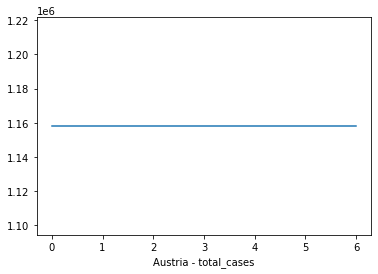

Input: [1108889. 1121134. 1132805. 1143283. 1151809. 1159995. 1159995.], Predicted: 1158256.710
Input: [1121134.   1132805.   1143283.   1151809.   1159995.   1159995.
 1158256.71], Predicted: 1158256.710
Input: [1132805.   1143283.   1151809.   1159995.   1159995.   1158256.71
 1158256.71], Predicted: 1158256.710
Input: [1143283.   1151809.   1159995.   1159995.   1158256.71 1158256.71
 1158256.71], Predicted: 1158256.710
Input: [1151809.   1159995.   1159995.   1158256.71 1158256.71 1158256.71
 1158256.71], Predicted: 1158256.710
Input: [1159995.   1159995.   1158256.71 1158256.71 1158256.71 1158256.71
 1158256.71], Predicted: 1158256.710
Input: [1159995.   1158256.71 1158256.71 1158256.71 1158256.71 1158256.71
 1158256.71], Predicted: 1158256.710
Input: [1158256.71 1158256.71 1158256.71 1158256.71 1158256.71 1158256.71
 1158256.71], Predicted: 1158256.710
Input: [1158256.71 1158256.71 1158256.71 1158256.71 1158256.71 1158256.71
 1158256.71], Predicted: 1158256.710
Input: [1158256.71

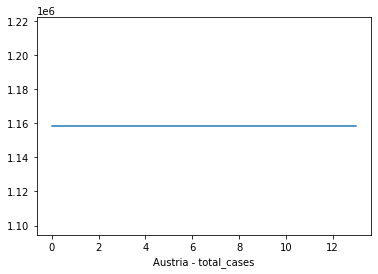

Input: [1108889. 1121134. 1132805. 1143283. 1151809. 1159995. 1159995.], Predicted: 1157964.120
Input: [1121134.   1132805.   1143283.   1151809.   1159995.   1159995.
 1157964.12], Predicted: 1157964.120
Input: [1132805.   1143283.   1151809.   1159995.   1159995.   1157964.12
 1157964.12], Predicted: 1157964.120
Input: [1143283.   1151809.   1159995.   1159995.   1157964.12 1157964.12
 1157964.12], Predicted: 1157964.120
Input: [1151809.   1159995.   1159995.   1157964.12 1157964.12 1157964.12
 1157964.12], Predicted: 1157964.120
Input: [1159995.   1159995.   1157964.12 1157964.12 1157964.12 1157964.12
 1157964.12], Predicted: 1157964.120
Input: [1159995.   1157964.12 1157964.12 1157964.12 1157964.12 1157964.12
 1157964.12], Predicted: 1157964.120
Input: [1157964.12 1157964.12 1157964.12 1157964.12 1157964.12 1157964.12
 1157964.12], Predicted: 1157964.120
Input: [1157964.12 1157964.12 1157964.12 1157964.12 1157964.12 1157964.12
 1157964.12], Predicted: 1157964.120
Input: [1157964.12

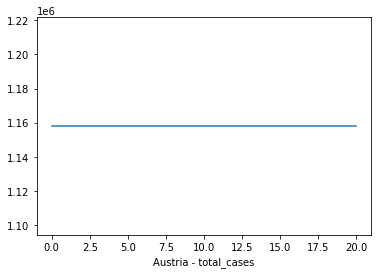

Input: [1108889. 1121134. 1132805. 1143283. 1151809. 1159995. 1159995.], Predicted: 1158042.580
Input: [1121134.   1132805.   1143283.   1151809.   1159995.   1159995.
 1158042.58], Predicted: 1158042.580
Input: [1132805.   1143283.   1151809.   1159995.   1159995.   1158042.58
 1158042.58], Predicted: 1158042.580
Input: [1143283.   1151809.   1159995.   1159995.   1158042.58 1158042.58
 1158042.58], Predicted: 1158042.580
Input: [1151809.   1159995.   1159995.   1158042.58 1158042.58 1158042.58
 1158042.58], Predicted: 1158042.580
Input: [1159995.   1159995.   1158042.58 1158042.58 1158042.58 1158042.58
 1158042.58], Predicted: 1158042.580
Input: [1159995.   1158042.58 1158042.58 1158042.58 1158042.58 1158042.58
 1158042.58], Predicted: 1158042.580
Input: [1158042.58 1158042.58 1158042.58 1158042.58 1158042.58 1158042.58
 1158042.58], Predicted: 1158042.580
Input: [1158042.58 1158042.58 1158042.58 1158042.58 1158042.58 1158042.58
 1158042.58], Predicted: 1158042.580
Input: [1158042.58

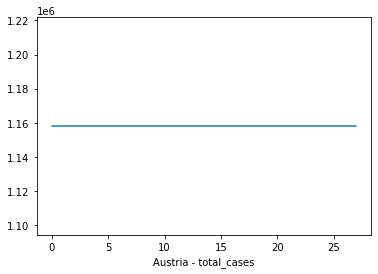

Input: [1108889. 1121134. 1132805. 1143283. 1151809. 1159995. 1159995.], Predicted: 1157575.510
Input: [1121134.   1132805.   1143283.   1151809.   1159995.   1159995.
 1157575.51], Predicted: 1157575.510
Input: [1132805.   1143283.   1151809.   1159995.   1159995.   1157575.51
 1157575.51], Predicted: 1157575.510
Input: [1143283.   1151809.   1159995.   1159995.   1157575.51 1157575.51
 1157575.51], Predicted: 1157575.510
Input: [1151809.   1159995.   1159995.   1157575.51 1157575.51 1157575.51
 1157575.51], Predicted: 1157575.510
Input: [1159995.   1159995.   1157575.51 1157575.51 1157575.51 1157575.51
 1157575.51], Predicted: 1157575.510
Input: [1159995.   1157575.51 1157575.51 1157575.51 1157575.51 1157575.51
 1157575.51], Predicted: 1157575.510
Input: [1157575.51 1157575.51 1157575.51 1157575.51 1157575.51 1157575.51
 1157575.51], Predicted: 1157575.510
Input: [1157575.51 1157575.51 1157575.51 1157575.51 1157575.51 1157575.51
 1157575.51], Predicted: 1157575.510
Input: [1157575.51

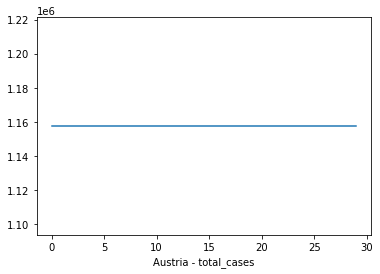

Input: [12233. 12284. 12349. 12388. 12425. 12492. 12492.], Predicted: 12479.020
Input: [12284.   12349.   12388.   12425.   12492.   12492.   12479.02], Predicted: 12479.020
Input: [12349.   12388.   12425.   12492.   12492.   12479.02 12479.02], Predicted: 12479.020
Input: [12388.   12425.   12492.   12492.   12479.02 12479.02 12479.02], Predicted: 12479.020
Input: [12425.   12492.   12492.   12479.02 12479.02 12479.02 12479.02], Predicted: 12479.020
Input: [12492.   12492.   12479.02 12479.02 12479.02 12479.02 12479.02], Predicted: 12479.020
Input: [12492.   12479.02 12479.02 12479.02 12479.02 12479.02 12479.02], Predicted: 12479.020
[12479.02, 12479.02, 12479.02, 12479.02, 12479.02, 12479.02, 12479.02]


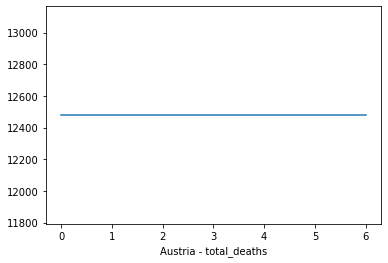

Input: [12233. 12284. 12349. 12388. 12425. 12492. 12492.], Predicted: 12478.600
Input: [12284.  12349.  12388.  12425.  12492.  12492.  12478.6], Predicted: 12478.600
Input: [12349.  12388.  12425.  12492.  12492.  12478.6 12478.6], Predicted: 12478.600
Input: [12388.  12425.  12492.  12492.  12478.6 12478.6 12478.6], Predicted: 12478.600
Input: [12425.  12492.  12492.  12478.6 12478.6 12478.6 12478.6], Predicted: 12478.600
Input: [12492.  12492.  12478.6 12478.6 12478.6 12478.6 12478.6], Predicted: 12478.600
Input: [12492.  12478.6 12478.6 12478.6 12478.6 12478.6 12478.6], Predicted: 12478.600
Input: [12478.6 12478.6 12478.6 12478.6 12478.6 12478.6 12478.6], Predicted: 12478.600
Input: [12478.6 12478.6 12478.6 12478.6 12478.6 12478.6 12478.6], Predicted: 12478.600
Input: [12478.6 12478.6 12478.6 12478.6 12478.6 12478.6 12478.6], Predicted: 12478.600
Input: [12478.6 12478.6 12478.6 12478.6 12478.6 12478.6 12478.6], Predicted: 12478.600
Input: [12478.6 12478.6 12478.6 12478.6 12478.6 12

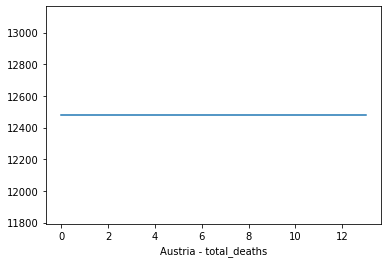

Input: [12233. 12284. 12349. 12388. 12425. 12492. 12492.], Predicted: 12474.070
Input: [12284.   12349.   12388.   12425.   12492.   12492.   12474.07], Predicted: 12474.070
Input: [12349.   12388.   12425.   12492.   12492.   12474.07 12474.07], Predicted: 12474.070
Input: [12388.   12425.   12492.   12492.   12474.07 12474.07 12474.07], Predicted: 12474.070
Input: [12425.   12492.   12492.   12474.07 12474.07 12474.07 12474.07], Predicted: 12474.070
Input: [12492.   12492.   12474.07 12474.07 12474.07 12474.07 12474.07], Predicted: 12474.070
Input: [12492.   12474.07 12474.07 12474.07 12474.07 12474.07 12474.07], Predicted: 12474.070
Input: [12474.07 12474.07 12474.07 12474.07 12474.07 12474.07 12474.07], Predicted: 12474.070
Input: [12474.07 12474.07 12474.07 12474.07 12474.07 12474.07 12474.07], Predicted: 12474.070
Input: [12474.07 12474.07 12474.07 12474.07 12474.07 12474.07 12474.07], Predicted: 12474.070
Input: [12474.07 12474.07 12474.07 12474.07 12474.07 12474.07 12474.07], P

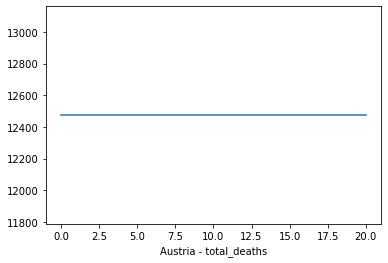

Input: [12233. 12284. 12349. 12388. 12425. 12492. 12492.], Predicted: 12472.780
Input: [12284.   12349.   12388.   12425.   12492.   12492.   12472.78], Predicted: 12472.780
Input: [12349.   12388.   12425.   12492.   12492.   12472.78 12472.78], Predicted: 12472.780
Input: [12388.   12425.   12492.   12492.   12472.78 12472.78 12472.78], Predicted: 12472.780
Input: [12425.   12492.   12492.   12472.78 12472.78 12472.78 12472.78], Predicted: 12472.780
Input: [12492.   12492.   12472.78 12472.78 12472.78 12472.78 12472.78], Predicted: 12472.780
Input: [12492.   12472.78 12472.78 12472.78 12472.78 12472.78 12472.78], Predicted: 12472.780
Input: [12472.78 12472.78 12472.78 12472.78 12472.78 12472.78 12472.78], Predicted: 12472.780
Input: [12472.78 12472.78 12472.78 12472.78 12472.78 12472.78 12472.78], Predicted: 12472.780
Input: [12472.78 12472.78 12472.78 12472.78 12472.78 12472.78 12472.78], Predicted: 12472.780
Input: [12472.78 12472.78 12472.78 12472.78 12472.78 12472.78 12472.78], P

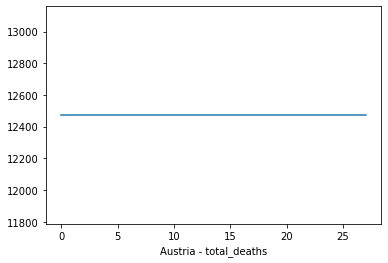

Input: [12233. 12284. 12349. 12388. 12425. 12492. 12492.], Predicted: 12481.350
Input: [12284.   12349.   12388.   12425.   12492.   12492.   12481.35], Predicted: 12481.350
Input: [12349.   12388.   12425.   12492.   12492.   12481.35 12481.35], Predicted: 12481.350
Input: [12388.   12425.   12492.   12492.   12481.35 12481.35 12481.35], Predicted: 12481.350
Input: [12425.   12492.   12492.   12481.35 12481.35 12481.35 12481.35], Predicted: 12481.350
Input: [12492.   12492.   12481.35 12481.35 12481.35 12481.35 12481.35], Predicted: 12481.350
Input: [12492.   12481.35 12481.35 12481.35 12481.35 12481.35 12481.35], Predicted: 12481.350
Input: [12481.35 12481.35 12481.35 12481.35 12481.35 12481.35 12481.35], Predicted: 12481.350
Input: [12481.35 12481.35 12481.35 12481.35 12481.35 12481.35 12481.35], Predicted: 12481.350
Input: [12481.35 12481.35 12481.35 12481.35 12481.35 12481.35 12481.35], Predicted: 12481.350
Input: [12481.35 12481.35 12481.35 12481.35 12481.35 12481.35 12481.35], P

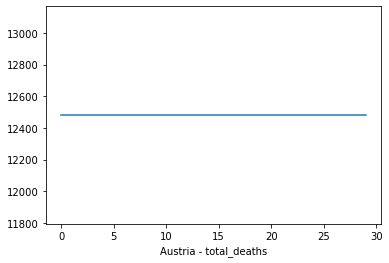

Input: [13443169. 13600059. 13700745. 13753952. 13840576. 13939111. 13939111.], Predicted: 13918166.770
Input: [13600059.   13700745.   13753952.   13840576.   13939111.   13939111.
 13918166.77], Predicted: 13918166.770
Input: [13700745.   13753952.   13840576.   13939111.   13939111.   13918166.77
 13918166.77], Predicted: 13918166.770
Input: [13753952.   13840576.   13939111.   13939111.   13918166.77 13918166.77
 13918166.77], Predicted: 13918166.770
Input: [13840576.   13939111.   13939111.   13918166.77 13918166.77 13918166.77
 13918166.77], Predicted: 13918166.770
Input: [13939111.   13939111.   13918166.77 13918166.77 13918166.77 13918166.77
 13918166.77], Predicted: 13918166.770
Input: [13939111.   13918166.77 13918166.77 13918166.77 13918166.77 13918166.77
 13918166.77], Predicted: 13918166.770
[13918166.77, 13918166.77, 13918166.77, 13918166.77, 13918166.77, 13918166.77, 13918166.77]


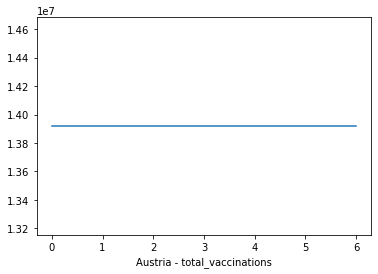

Input: [13443169. 13600059. 13700745. 13753952. 13840576. 13939111. 13939111.], Predicted: 13918523.900
Input: [13600059.  13700745.  13753952.  13840576.  13939111.  13939111.
 13918523.9], Predicted: 13918523.900
Input: [13700745.  13753952.  13840576.  13939111.  13939111.  13918523.9
 13918523.9], Predicted: 13918523.900
Input: [13753952.  13840576.  13939111.  13939111.  13918523.9 13918523.9
 13918523.9], Predicted: 13918523.900
Input: [13840576.  13939111.  13939111.  13918523.9 13918523.9 13918523.9
 13918523.9], Predicted: 13918523.900
Input: [13939111.  13939111.  13918523.9 13918523.9 13918523.9 13918523.9
 13918523.9], Predicted: 13918523.900
Input: [13939111.  13918523.9 13918523.9 13918523.9 13918523.9 13918523.9
 13918523.9], Predicted: 13918523.900
Input: [13918523.9 13918523.9 13918523.9 13918523.9 13918523.9 13918523.9
 13918523.9], Predicted: 13918523.900
Input: [13918523.9 13918523.9 13918523.9 13918523.9 13918523.9 13918523.9
 13918523.9], Predicted: 13918523.900
I

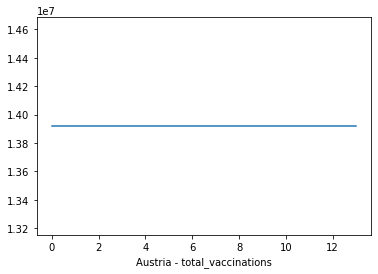

Input: [13443169. 13600059. 13700745. 13753952. 13840576. 13939111. 13939111.], Predicted: 13915501.850
Input: [13600059.   13700745.   13753952.   13840576.   13939111.   13939111.
 13915501.85], Predicted: 13915501.850
Input: [13700745.   13753952.   13840576.   13939111.   13939111.   13915501.85
 13915501.85], Predicted: 13915501.850
Input: [13753952.   13840576.   13939111.   13939111.   13915501.85 13915501.85
 13915501.85], Predicted: 13915501.850
Input: [13840576.   13939111.   13939111.   13915501.85 13915501.85 13915501.85
 13915501.85], Predicted: 13915501.850
Input: [13939111.   13939111.   13915501.85 13915501.85 13915501.85 13915501.85
 13915501.85], Predicted: 13915501.850
Input: [13939111.   13915501.85 13915501.85 13915501.85 13915501.85 13915501.85
 13915501.85], Predicted: 13915501.850
Input: [13915501.85 13915501.85 13915501.85 13915501.85 13915501.85 13915501.85
 13915501.85], Predicted: 13915501.850
Input: [13915501.85 13915501.85 13915501.85 13915501.85 13915501.

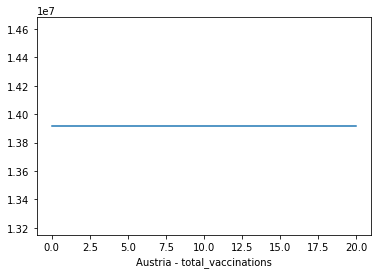

Input: [13443169. 13600059. 13700745. 13753952. 13840576. 13939111. 13939111.], Predicted: 13919705.700
Input: [13600059.  13700745.  13753952.  13840576.  13939111.  13939111.
 13919705.7], Predicted: 13919705.700
Input: [13700745.  13753952.  13840576.  13939111.  13939111.  13919705.7
 13919705.7], Predicted: 13919705.700
Input: [13753952.  13840576.  13939111.  13939111.  13919705.7 13919705.7
 13919705.7], Predicted: 13919705.700
Input: [13840576.  13939111.  13939111.  13919705.7 13919705.7 13919705.7
 13919705.7], Predicted: 13919705.700
Input: [13939111.  13939111.  13919705.7 13919705.7 13919705.7 13919705.7
 13919705.7], Predicted: 13919705.700
Input: [13939111.  13919705.7 13919705.7 13919705.7 13919705.7 13919705.7
 13919705.7], Predicted: 13919705.700
Input: [13919705.7 13919705.7 13919705.7 13919705.7 13919705.7 13919705.7
 13919705.7], Predicted: 13919705.700
Input: [13919705.7 13919705.7 13919705.7 13919705.7 13919705.7 13919705.7
 13919705.7], Predicted: 13919705.700
I

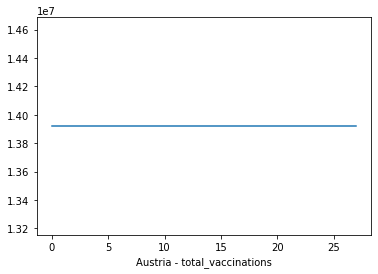

Input: [13443169. 13600059. 13700745. 13753952. 13840576. 13939111. 13939111.], Predicted: 13926658.780
Input: [13600059.   13700745.   13753952.   13840576.   13939111.   13939111.
 13926658.78], Predicted: 13926658.780
Input: [13700745.   13753952.   13840576.   13939111.   13939111.   13926658.78
 13926658.78], Predicted: 13926658.780
Input: [13753952.   13840576.   13939111.   13939111.   13926658.78 13926658.78
 13926658.78], Predicted: 13926658.780
Input: [13840576.   13939111.   13939111.   13926658.78 13926658.78 13926658.78
 13926658.78], Predicted: 13926658.780
Input: [13939111.   13939111.   13926658.78 13926658.78 13926658.78 13926658.78
 13926658.78], Predicted: 13926658.780
Input: [13939111.   13926658.78 13926658.78 13926658.78 13926658.78 13926658.78
 13926658.78], Predicted: 13926658.780
Input: [13926658.78 13926658.78 13926658.78 13926658.78 13926658.78 13926658.78
 13926658.78], Predicted: 13926658.780
Input: [13926658.78 13926658.78 13926658.78 13926658.78 13926658.

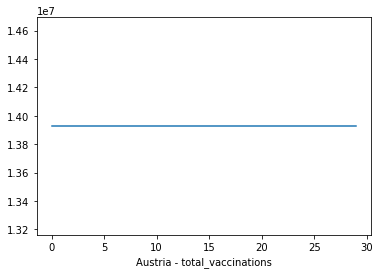

Input: [5892401. 5913439. 5925961. 5932371. 5943426. 5958554. 5958554.], Predicted: 5956575.630
Input: [5913439.   5925961.   5932371.   5943426.   5958554.   5958554.
 5956575.63], Predicted: 5956575.630
Input: [5925961.   5932371.   5943426.   5958554.   5958554.   5956575.63
 5956575.63], Predicted: 5956575.630
Input: [5932371.   5943426.   5958554.   5958554.   5956575.63 5956575.63
 5956575.63], Predicted: 5956575.630
Input: [5943426.   5958554.   5958554.   5956575.63 5956575.63 5956575.63
 5956575.63], Predicted: 5956575.630
Input: [5958554.   5958554.   5956575.63 5956575.63 5956575.63 5956575.63
 5956575.63], Predicted: 5956575.630
Input: [5958554.   5956575.63 5956575.63 5956575.63 5956575.63 5956575.63
 5956575.63], Predicted: 5956575.630
[5956575.63, 5956575.63, 5956575.63, 5956575.63, 5956575.63, 5956575.63, 5956575.63]


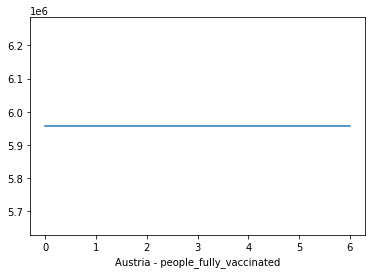

Input: [5892401. 5913439. 5925961. 5932371. 5943426. 5958554. 5958554.], Predicted: 5956604.720
Input: [5913439.   5925961.   5932371.   5943426.   5958554.   5958554.
 5956604.72], Predicted: 5956604.720
Input: [5925961.   5932371.   5943426.   5958554.   5958554.   5956604.72
 5956604.72], Predicted: 5956604.720
Input: [5932371.   5943426.   5958554.   5958554.   5956604.72 5956604.72
 5956604.72], Predicted: 5956604.720
Input: [5943426.   5958554.   5958554.   5956604.72 5956604.72 5956604.72
 5956604.72], Predicted: 5956604.720
Input: [5958554.   5958554.   5956604.72 5956604.72 5956604.72 5956604.72
 5956604.72], Predicted: 5956604.720
Input: [5958554.   5956604.72 5956604.72 5956604.72 5956604.72 5956604.72
 5956604.72], Predicted: 5956604.720
Input: [5956604.72 5956604.72 5956604.72 5956604.72 5956604.72 5956604.72
 5956604.72], Predicted: 5956604.720
Input: [5956604.72 5956604.72 5956604.72 5956604.72 5956604.72 5956604.72
 5956604.72], Predicted: 5956604.720
Input: [5956604.72

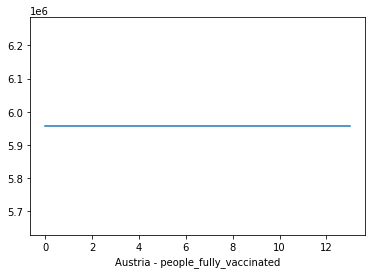

Input: [5892401. 5913439. 5925961. 5932371. 5943426. 5958554. 5958554.], Predicted: 5955226.460
Input: [5913439.   5925961.   5932371.   5943426.   5958554.   5958554.
 5955226.46], Predicted: 5955226.460
Input: [5925961.   5932371.   5943426.   5958554.   5958554.   5955226.46
 5955226.46], Predicted: 5955226.460
Input: [5932371.   5943426.   5958554.   5958554.   5955226.46 5955226.46
 5955226.46], Predicted: 5955226.460
Input: [5943426.   5958554.   5958554.   5955226.46 5955226.46 5955226.46
 5955226.46], Predicted: 5955226.460
Input: [5958554.   5958554.   5955226.46 5955226.46 5955226.46 5955226.46
 5955226.46], Predicted: 5955226.460
Input: [5958554.   5955226.46 5955226.46 5955226.46 5955226.46 5955226.46
 5955226.46], Predicted: 5955226.460
Input: [5955226.46 5955226.46 5955226.46 5955226.46 5955226.46 5955226.46
 5955226.46], Predicted: 5955226.460
Input: [5955226.46 5955226.46 5955226.46 5955226.46 5955226.46 5955226.46
 5955226.46], Predicted: 5955226.460
Input: [5955226.46

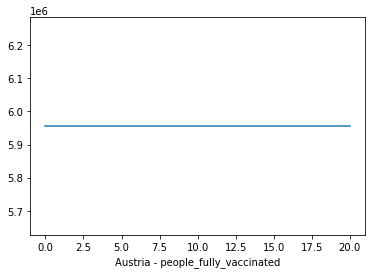

Input: [5892401. 5913439. 5925961. 5932371. 5943426. 5958554. 5958554.], Predicted: 5955624.190
Input: [5913439.   5925961.   5932371.   5943426.   5958554.   5958554.
 5955624.19], Predicted: 5955624.190
Input: [5925961.   5932371.   5943426.   5958554.   5958554.   5955624.19
 5955624.19], Predicted: 5955624.190
Input: [5932371.   5943426.   5958554.   5958554.   5955624.19 5955624.19
 5955624.19], Predicted: 5955624.190
Input: [5943426.   5958554.   5958554.   5955624.19 5955624.19 5955624.19
 5955624.19], Predicted: 5955624.190
Input: [5958554.   5958554.   5955624.19 5955624.19 5955624.19 5955624.19
 5955624.19], Predicted: 5955624.190
Input: [5958554.   5955624.19 5955624.19 5955624.19 5955624.19 5955624.19
 5955624.19], Predicted: 5955624.190
Input: [5955624.19 5955624.19 5955624.19 5955624.19 5955624.19 5955624.19
 5955624.19], Predicted: 5955624.190
Input: [5955624.19 5955624.19 5955624.19 5955624.19 5955624.19 5955624.19
 5955624.19], Predicted: 5955624.190
Input: [5955624.19

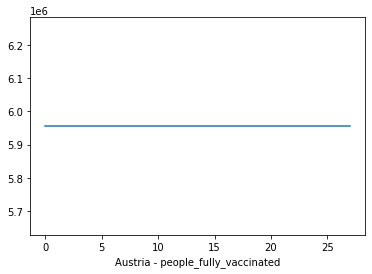

Input: [5892401. 5913439. 5925961. 5932371. 5943426. 5958554. 5958554.], Predicted: 5954626.110
Input: [5913439.   5925961.   5932371.   5943426.   5958554.   5958554.
 5954626.11], Predicted: 5954626.110
Input: [5925961.   5932371.   5943426.   5958554.   5958554.   5954626.11
 5954626.11], Predicted: 5954626.110
Input: [5932371.   5943426.   5958554.   5958554.   5954626.11 5954626.11
 5954626.11], Predicted: 5954626.110
Input: [5943426.   5958554.   5958554.   5954626.11 5954626.11 5954626.11
 5954626.11], Predicted: 5954626.110
Input: [5958554.   5958554.   5954626.11 5954626.11 5954626.11 5954626.11
 5954626.11], Predicted: 5954626.110
Input: [5958554.   5954626.11 5954626.11 5954626.11 5954626.11 5954626.11
 5954626.11], Predicted: 5954626.110
Input: [5954626.11 5954626.11 5954626.11 5954626.11 5954626.11 5954626.11
 5954626.11], Predicted: 5954626.110
Input: [5954626.11 5954626.11 5954626.11 5954626.11 5954626.11 5954626.11
 5954626.11], Predicted: 5954626.110
Input: [5954626.11

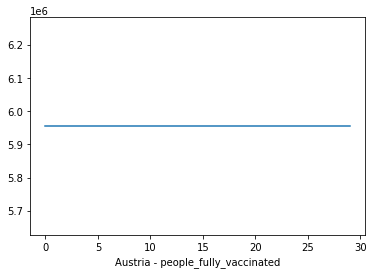

Input: [13592. 12245. 11671. 10478.  8526.  8186.     0.], Predicted: 1598.070
Input: [12245.   11671.   10478.    8526.    8186.       0.    1598.07], Predicted: 2248.590
Input: [11671.   10478.    8526.    8186.       0.    1598.07  2248.59], Predicted: 2738.130
Input: [10478.    8526.    8186.       0.    1598.07  2248.59  2738.13], Predicted: 2911.870
Input: [8526.   8186.      0.   1598.07 2248.59 2738.13 2911.87], Predicted: 3015.550
Input: [8186.      0.   1598.07 2248.59 2738.13 2911.87 3015.55], Predicted: 2841.010
Input: [   0.   1598.07 2248.59 2738.13 2911.87 3015.55 2841.01], Predicted: 2055.180
[1598.07, 2248.59, 2738.13, 2911.87, 3015.55, 2841.01, 2055.18]


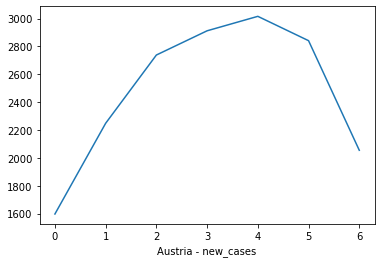

Input: [13592. 12245. 11671. 10478.  8526.  8186.     0.], Predicted: 1585.660
Input: [12245.   11671.   10478.    8526.    8186.       0.    1585.66], Predicted: 2405.080
Input: [11671.   10478.    8526.    8186.       0.    1585.66  2405.08], Predicted: 3128.810
Input: [10478.    8526.    8186.       0.    1585.66  2405.08  3128.81], Predicted: 3447.300
Input: [8526.   8186.      0.   1585.66 2405.08 3128.81 3447.3 ], Predicted: 3416.040
Input: [8186.      0.   1585.66 2405.08 3128.81 3447.3  3416.04], Predicted: 2932.610
Input: [   0.   1585.66 2405.08 3128.81 3447.3  3416.04 2932.61], Predicted: 2254.330
Input: [1585.66 2405.08 3128.81 3447.3  3416.04 2932.61 2254.33], Predicted: 2085.160
Input: [2405.08 3128.81 3447.3  3416.04 2932.61 2254.33 2085.16], Predicted: 2465.300
Input: [3128.81 3447.3  3416.04 2932.61 2254.33 2085.16 2465.3 ], Predicted: 2716.510
Input: [3447.3  3416.04 2932.61 2254.33 2085.16 2465.3  2716.51], Predicted: 2855.680
Input: [3416.04 2932.61 2254.33 2085.16 

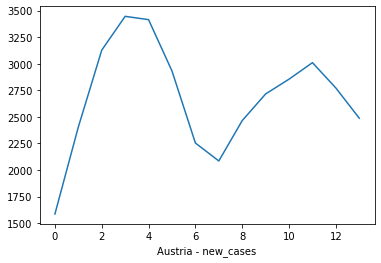

Input: [13592. 12245. 11671. 10478.  8526.  8186.     0.], Predicted: 1669.980
Input: [12245.   11671.   10478.    8526.    8186.       0.    1669.98], Predicted: 2197.290
Input: [11671.   10478.    8526.    8186.       0.    1669.98  2197.29], Predicted: 2762.690
Input: [10478.    8526.    8186.       0.    1669.98  2197.29  2762.69], Predicted: 2924.550
Input: [8526.   8186.      0.   1669.98 2197.29 2762.69 2924.55], Predicted: 3167.000
Input: [8186.      0.   1669.98 2197.29 2762.69 2924.55 3167.  ], Predicted: 3011.340
Input: [   0.   1669.98 2197.29 2762.69 2924.55 3167.   3011.34], Predicted: 2095.060
Input: [1669.98 2197.29 2762.69 2924.55 3167.   3011.34 2095.06], Predicted: 1988.860
Input: [2197.29 2762.69 2924.55 3167.   3011.34 2095.06 1988.86], Predicted: 2282.110
Input: [2762.69 2924.55 3167.   3011.34 2095.06 1988.86 2282.11], Predicted: 2283.880
Input: [2924.55 3167.   3011.34 2095.06 1988.86 2282.11 2283.88], Predicted: 2330.880
Input: [3167.   3011.34 2095.06 1988.86 

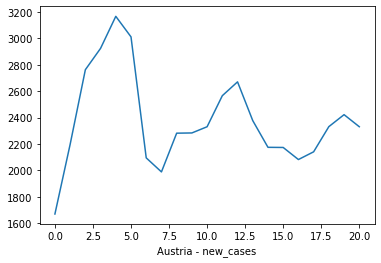

Input: [13592. 12245. 11671. 10478.  8526.  8186.     0.], Predicted: 1449.400
Input: [12245.  11671.  10478.   8526.   8186.      0.   1449.4], Predicted: 2212.390
Input: [11671.   10478.    8526.    8186.       0.    1449.4   2212.39], Predicted: 2786.540
Input: [10478.    8526.    8186.       0.    1449.4   2212.39  2786.54], Predicted: 2871.190
Input: [8526.   8186.      0.   1449.4  2212.39 2786.54 2871.19], Predicted: 3039.640
Input: [8186.      0.   1449.4  2212.39 2786.54 2871.19 3039.64], Predicted: 2997.240
Input: [   0.   1449.4  2212.39 2786.54 2871.19 3039.64 2997.24], Predicted: 2081.500
Input: [1449.4  2212.39 2786.54 2871.19 3039.64 2997.24 2081.5 ], Predicted: 1998.530
Input: [2212.39 2786.54 2871.19 3039.64 2997.24 2081.5  1998.53], Predicted: 2251.560
Input: [2786.54 2871.19 3039.64 2997.24 2081.5  1998.53 2251.56], Predicted: 2241.490
Input: [2871.19 3039.64 2997.24 2081.5  1998.53 2251.56 2241.49], Predicted: 2330.010
Input: [3039.64 2997.24 2081.5  1998.53 2251.56

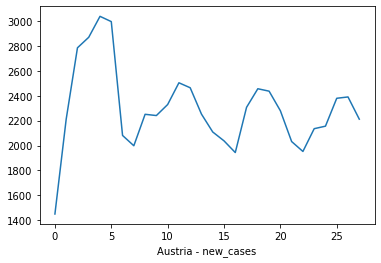

Input: [13592. 12245. 11671. 10478.  8526.  8186.     0.], Predicted: 1437.100
Input: [12245.  11671.  10478.   8526.   8186.      0.   1437.1], Predicted: 2272.110
Input: [11671.   10478.    8526.    8186.       0.    1437.1   2272.11], Predicted: 2921.760
Input: [10478.    8526.    8186.       0.    1437.1   2272.11  2921.76], Predicted: 3042.560
Input: [8526.   8186.      0.   1437.1  2272.11 2921.76 3042.56], Predicted: 3335.100
Input: [8186.      0.   1437.1  2272.11 2921.76 3042.56 3335.1 ], Predicted: 3033.260
Input: [   0.   1437.1  2272.11 2921.76 3042.56 3335.1  3033.26], Predicted: 2081.520
Input: [1437.1  2272.11 2921.76 3042.56 3335.1  3033.26 2081.52], Predicted: 2037.050
Input: [2272.11 2921.76 3042.56 3335.1  3033.26 2081.52 2037.05], Predicted: 2376.720
Input: [2921.76 3042.56 3335.1  3033.26 2081.52 2037.05 2376.72], Predicted: 2531.470
Input: [3042.56 3335.1  3033.26 2081.52 2037.05 2376.72 2531.47], Predicted: 2670.970
Input: [3335.1  3033.26 2081.52 2037.05 2376.72

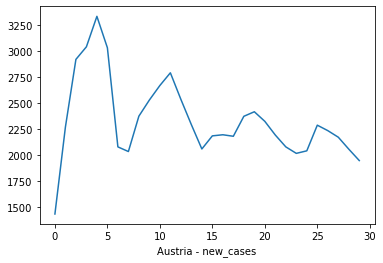

Input: [53. 51. 65. 39. 37. 67.  0.], Predicted: 40.090
Input: [51.   65.   39.   37.   67.    0.   40.09], Predicted: 51.170
Input: [65.   39.   37.   67.    0.   40.09 51.17], Predicted: 42.560
Input: [39.   37.   67.    0.   40.09 51.17 42.56], Predicted: 45.190
Input: [37.   67.    0.   40.09 51.17 42.56 45.19], Predicted: 47.910
Input: [67.    0.   40.09 51.17 42.56 45.19 47.91], Predicted: 45.820
Input: [ 0.   40.09 51.17 42.56 45.19 47.91 45.82], Predicted: 35.260
[40.09, 51.17, 42.56, 45.19, 47.91, 45.82, 35.26]


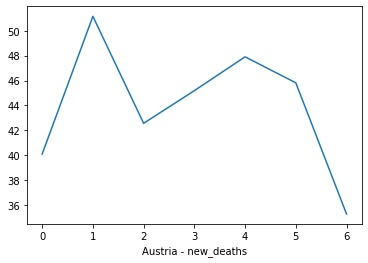

Input: [53. 51. 65. 39. 37. 67.  0.], Predicted: 41.810
Input: [51.   65.   39.   37.   67.    0.   41.81], Predicted: 52.950
Input: [65.   39.   37.   67.    0.   41.81 52.95], Predicted: 43.820
Input: [39.   37.   67.    0.   41.81 52.95 43.82], Predicted: 42.950
Input: [37.   67.    0.   41.81 52.95 43.82 42.95], Predicted: 50.120
Input: [67.    0.   41.81 52.95 43.82 42.95 50.12], Predicted: 53.320
Input: [ 0.   41.81 52.95 43.82 42.95 50.12 53.32], Predicted: 38.530
Input: [41.81 52.95 43.82 42.95 50.12 53.32 38.53], Predicted: 46.960
Input: [52.95 43.82 42.95 50.12 53.32 38.53 46.96], Predicted: 56.870
Input: [43.82 42.95 50.12 53.32 38.53 46.96 56.87], Predicted: 48.430
Input: [42.95 50.12 53.32 38.53 46.96 56.87 48.43], Predicted: 52.650
Input: [50.12 53.32 38.53 46.96 56.87 48.43 52.65], Predicted: 50.570
Input: [53.32 38.53 46.96 56.87 48.43 52.65 50.57], Predicted: 57.790
Input: [38.53 46.96 56.87 48.43 52.65 50.57 57.79], Predicted: 52.110
[41.81, 52.95, 43.82, 42.95, 50.12

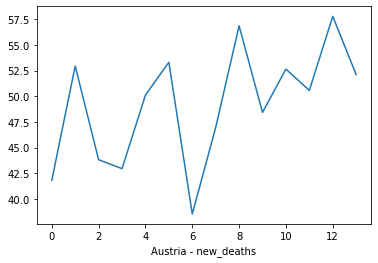

Input: [53. 51. 65. 39. 37. 67.  0.], Predicted: 40.380
Input: [51.   65.   39.   37.   67.    0.   40.38], Predicted: 49.820
Input: [65.   39.   37.   67.    0.   40.38 49.82], Predicted: 45.670
Input: [39.   37.   67.    0.   40.38 49.82 45.67], Predicted: 42.380
Input: [37.   67.    0.   40.38 49.82 45.67 42.38], Predicted: 50.640
Input: [67.    0.   40.38 49.82 45.67 42.38 50.64], Predicted: 50.770
Input: [ 0.   40.38 49.82 45.67 42.38 50.64 50.77], Predicted: 33.090
Input: [40.38 49.82 45.67 42.38 50.64 50.77 33.09], Predicted: 41.160
Input: [49.82 45.67 42.38 50.64 50.77 33.09 41.16], Predicted: 51.560
Input: [45.67 42.38 50.64 50.77 33.09 41.16 51.56], Predicted: 42.730
Input: [42.38 50.64 50.77 33.09 41.16 51.56 42.73], Predicted: 49.090
Input: [50.64 50.77 33.09 41.16 51.56 42.73 49.09], Predicted: 49.060
Input: [50.77 33.09 41.16 51.56 42.73 49.09 49.06], Predicted: 45.970
Input: [33.09 41.16 51.56 42.73 49.09 49.06 45.97], Predicted: 47.860
Input: [41.16 51.56 42.73 49.09 49

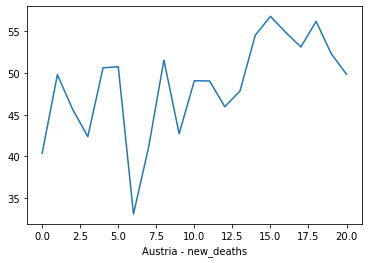

Input: [53. 51. 65. 39. 37. 67.  0.], Predicted: 38.820
Input: [51.   65.   39.   37.   67.    0.   38.82], Predicted: 44.300
Input: [65.   39.   37.   67.    0.   38.82 44.3 ], Predicted: 48.610
Input: [39.   37.   67.    0.   38.82 44.3  48.61], Predicted: 43.900
Input: [37.   67.    0.   38.82 44.3  48.61 43.9 ], Predicted: 51.000
Input: [67.    0.   38.82 44.3  48.61 43.9  51.  ], Predicted: 55.580
Input: [ 0.   38.82 44.3  48.61 43.9  51.   55.58], Predicted: 38.160
Input: [38.82 44.3  48.61 43.9  51.   55.58 38.16], Predicted: 46.940
Input: [44.3  48.61 43.9  51.   55.58 38.16 46.94], Predicted: 53.780
Input: [48.61 43.9  51.   55.58 38.16 46.94 53.78], Predicted: 47.440
Input: [43.9  51.   55.58 38.16 46.94 53.78 47.44], Predicted: 53.670
Input: [51.   55.58 38.16 46.94 53.78 47.44 53.67], Predicted: 52.490
Input: [55.58 38.16 46.94 53.78 47.44 53.67 52.49], Predicted: 58.460
Input: [38.16 46.94 53.78 47.44 53.67 52.49 58.46], Predicted: 50.310
Input: [46.94 53.78 47.44 53.67 52

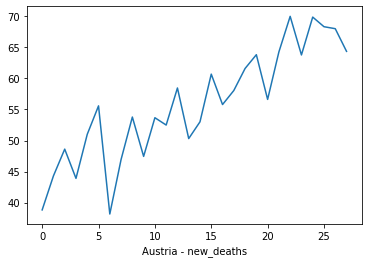

Input: [53. 51. 65. 39. 37. 67.  0.], Predicted: 40.710
Input: [51.   65.   39.   37.   67.    0.   40.71], Predicted: 50.730
Input: [65.   39.   37.   67.    0.   40.71 50.73], Predicted: 39.760
Input: [39.   37.   67.    0.   40.71 50.73 39.76], Predicted: 46.740
Input: [37.   67.    0.   40.71 50.73 39.76 46.74], Predicted: 46.450
Input: [67.    0.   40.71 50.73 39.76 46.74 46.45], Predicted: 42.830
Input: [ 0.   40.71 50.73 39.76 46.74 46.45 42.83], Predicted: 31.950
Input: [40.71 50.73 39.76 46.74 46.45 42.83 31.95], Predicted: 39.080
Input: [50.73 39.76 46.74 46.45 42.83 31.95 39.08], Predicted: 40.060
Input: [39.76 46.74 46.45 42.83 31.95 39.08 40.06], Predicted: 48.100
Input: [46.74 46.45 42.83 31.95 39.08 40.06 48.1 ], Predicted: 41.770
Input: [46.45 42.83 31.95 39.08 40.06 48.1  41.77], Predicted: 47.080
Input: [42.83 31.95 39.08 40.06 48.1  41.77 47.08], Predicted: 49.620
Input: [31.95 39.08 40.06 48.1  41.77 47.08 49.62], Predicted: 40.950
Input: [39.08 40.06 48.1  41.77 47

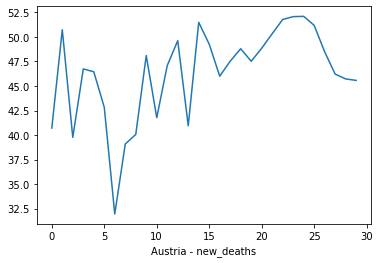

Input: [1787542. 1790579. 1792561. 1794286. 1798515. 1800867. 1800867.], Predicted: 1800392.080
Input: [1790579.   1792561.   1794286.   1798515.   1800867.   1800867.
 1800392.08], Predicted: 1800392.080
Input: [1792561.   1794286.   1798515.   1800867.   1800867.   1800392.08
 1800392.08], Predicted: 1800392.080
Input: [1794286.   1798515.   1800867.   1800867.   1800392.08 1800392.08
 1800392.08], Predicted: 1800392.080
Input: [1798515.   1800867.   1800867.   1800392.08 1800392.08 1800392.08
 1800392.08], Predicted: 1800392.080
Input: [1800867.   1800867.   1800392.08 1800392.08 1800392.08 1800392.08
 1800392.08], Predicted: 1800392.080
Input: [1800867.   1800392.08 1800392.08 1800392.08 1800392.08 1800392.08
 1800392.08], Predicted: 1800392.080
[1800392.08, 1800392.08, 1800392.08, 1800392.08, 1800392.08, 1800392.08, 1800392.08]


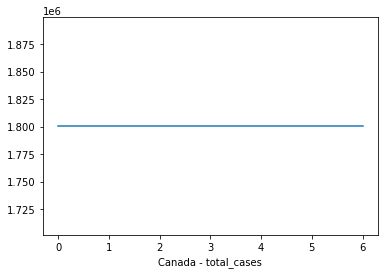

Input: [1787542. 1790579. 1792561. 1794286. 1798515. 1800867. 1800867.], Predicted: 1800370.080
Input: [1790579.   1792561.   1794286.   1798515.   1800867.   1800867.
 1800370.08], Predicted: 1800370.080
Input: [1792561.   1794286.   1798515.   1800867.   1800867.   1800370.08
 1800370.08], Predicted: 1800370.080
Input: [1794286.   1798515.   1800867.   1800867.   1800370.08 1800370.08
 1800370.08], Predicted: 1800370.080
Input: [1798515.   1800867.   1800867.   1800370.08 1800370.08 1800370.08
 1800370.08], Predicted: 1800370.080
Input: [1800867.   1800867.   1800370.08 1800370.08 1800370.08 1800370.08
 1800370.08], Predicted: 1800370.080
Input: [1800867.   1800370.08 1800370.08 1800370.08 1800370.08 1800370.08
 1800370.08], Predicted: 1800370.080
Input: [1800370.08 1800370.08 1800370.08 1800370.08 1800370.08 1800370.08
 1800370.08], Predicted: 1800370.080
Input: [1800370.08 1800370.08 1800370.08 1800370.08 1800370.08 1800370.08
 1800370.08], Predicted: 1800370.080
Input: [1800370.08

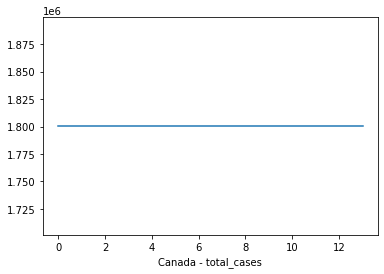

Input: [1787542. 1790579. 1792561. 1794286. 1798515. 1800867. 1800867.], Predicted: 1800575.490
Input: [1790579.   1792561.   1794286.   1798515.   1800867.   1800867.
 1800575.49], Predicted: 1800575.490
Input: [1792561.   1794286.   1798515.   1800867.   1800867.   1800575.49
 1800575.49], Predicted: 1800575.490
Input: [1794286.   1798515.   1800867.   1800867.   1800575.49 1800575.49
 1800575.49], Predicted: 1800575.490
Input: [1798515.   1800867.   1800867.   1800575.49 1800575.49 1800575.49
 1800575.49], Predicted: 1800575.490
Input: [1800867.   1800867.   1800575.49 1800575.49 1800575.49 1800575.49
 1800575.49], Predicted: 1800575.490
Input: [1800867.   1800575.49 1800575.49 1800575.49 1800575.49 1800575.49
 1800575.49], Predicted: 1800575.490
Input: [1800575.49 1800575.49 1800575.49 1800575.49 1800575.49 1800575.49
 1800575.49], Predicted: 1800575.490
Input: [1800575.49 1800575.49 1800575.49 1800575.49 1800575.49 1800575.49
 1800575.49], Predicted: 1800575.490
Input: [1800575.49

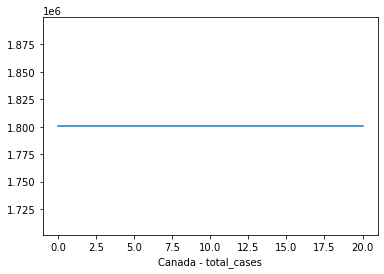

Input: [1787542. 1790579. 1792561. 1794286. 1798515. 1800867. 1800867.], Predicted: 1800305.440
Input: [1790579.   1792561.   1794286.   1798515.   1800867.   1800867.
 1800305.44], Predicted: 1800305.440
Input: [1792561.   1794286.   1798515.   1800867.   1800867.   1800305.44
 1800305.44], Predicted: 1800305.440
Input: [1794286.   1798515.   1800867.   1800867.   1800305.44 1800305.44
 1800305.44], Predicted: 1800305.440
Input: [1798515.   1800867.   1800867.   1800305.44 1800305.44 1800305.44
 1800305.44], Predicted: 1800305.440
Input: [1800867.   1800867.   1800305.44 1800305.44 1800305.44 1800305.44
 1800305.44], Predicted: 1800305.440
Input: [1800867.   1800305.44 1800305.44 1800305.44 1800305.44 1800305.44
 1800305.44], Predicted: 1800305.440
Input: [1800305.44 1800305.44 1800305.44 1800305.44 1800305.44 1800305.44
 1800305.44], Predicted: 1800305.440
Input: [1800305.44 1800305.44 1800305.44 1800305.44 1800305.44 1800305.44
 1800305.44], Predicted: 1800305.440
Input: [1800305.44

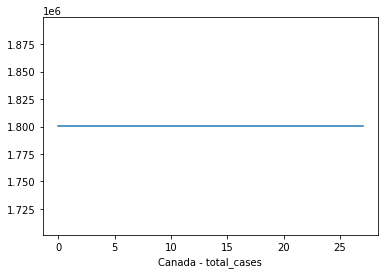

Input: [1787542. 1790579. 1792561. 1794286. 1798515. 1800867. 1800867.], Predicted: 1800154.390
Input: [1790579.   1792561.   1794286.   1798515.   1800867.   1800867.
 1800154.39], Predicted: 1800154.390
Input: [1792561.   1794286.   1798515.   1800867.   1800867.   1800154.39
 1800154.39], Predicted: 1800154.390
Input: [1794286.   1798515.   1800867.   1800867.   1800154.39 1800154.39
 1800154.39], Predicted: 1800154.390
Input: [1798515.   1800867.   1800867.   1800154.39 1800154.39 1800154.39
 1800154.39], Predicted: 1800154.390
Input: [1800867.   1800867.   1800154.39 1800154.39 1800154.39 1800154.39
 1800154.39], Predicted: 1800154.390
Input: [1800867.   1800154.39 1800154.39 1800154.39 1800154.39 1800154.39
 1800154.39], Predicted: 1800154.390
Input: [1800154.39 1800154.39 1800154.39 1800154.39 1800154.39 1800154.39
 1800154.39], Predicted: 1800154.390
Input: [1800154.39 1800154.39 1800154.39 1800154.39 1800154.39 1800154.39
 1800154.39], Predicted: 1800154.390
Input: [1800154.39

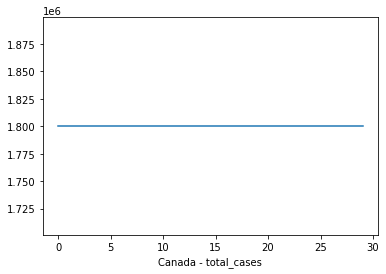

Input: [29655. 29671. 29681. 29686. 29722. 29739. 29739.], Predicted: 29732.280
Input: [29671.   29681.   29686.   29722.   29739.   29739.   29732.28], Predicted: 29732.280
Input: [29681.   29686.   29722.   29739.   29739.   29732.28 29732.28], Predicted: 29732.280
Input: [29686.   29722.   29739.   29739.   29732.28 29732.28 29732.28], Predicted: 29732.280
Input: [29722.   29739.   29739.   29732.28 29732.28 29732.28 29732.28], Predicted: 29732.280
Input: [29739.   29739.   29732.28 29732.28 29732.28 29732.28 29732.28], Predicted: 29732.280
Input: [29739.   29732.28 29732.28 29732.28 29732.28 29732.28 29732.28], Predicted: 29732.280
[29732.28, 29732.28, 29732.28, 29732.28, 29732.28, 29732.28, 29732.28]


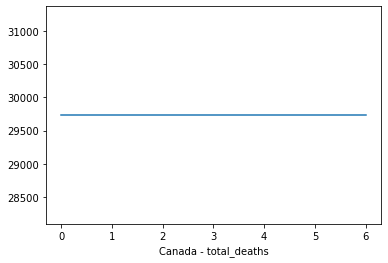

Input: [29655. 29671. 29681. 29686. 29722. 29739. 29739.], Predicted: 29736.000
Input: [29671. 29681. 29686. 29722. 29739. 29739. 29736.], Predicted: 29736.000
Input: [29681. 29686. 29722. 29739. 29739. 29736. 29736.], Predicted: 29736.000
Input: [29686. 29722. 29739. 29739. 29736. 29736. 29736.], Predicted: 29736.000
Input: [29722. 29739. 29739. 29736. 29736. 29736. 29736.], Predicted: 29736.000
Input: [29739. 29739. 29736. 29736. 29736. 29736. 29736.], Predicted: 29736.000
Input: [29739. 29736. 29736. 29736. 29736. 29736. 29736.], Predicted: 29736.000
Input: [29736. 29736. 29736. 29736. 29736. 29736. 29736.], Predicted: 29736.000
Input: [29736. 29736. 29736. 29736. 29736. 29736. 29736.], Predicted: 29736.000
Input: [29736. 29736. 29736. 29736. 29736. 29736. 29736.], Predicted: 29736.000
Input: [29736. 29736. 29736. 29736. 29736. 29736. 29736.], Predicted: 29736.000
Input: [29736. 29736. 29736. 29736. 29736. 29736. 29736.], Predicted: 29736.000
Input: [29736. 29736. 29736. 29736. 2973

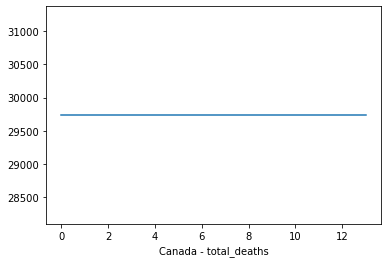

Input: [29655. 29671. 29681. 29686. 29722. 29739. 29739.], Predicted: 29735.010
Input: [29671.   29681.   29686.   29722.   29739.   29739.   29735.01], Predicted: 29735.010
Input: [29681.   29686.   29722.   29739.   29739.   29735.01 29735.01], Predicted: 29735.010
Input: [29686.   29722.   29739.   29739.   29735.01 29735.01 29735.01], Predicted: 29735.010
Input: [29722.   29739.   29739.   29735.01 29735.01 29735.01 29735.01], Predicted: 29735.010
Input: [29739.   29739.   29735.01 29735.01 29735.01 29735.01 29735.01], Predicted: 29735.010
Input: [29739.   29735.01 29735.01 29735.01 29735.01 29735.01 29735.01], Predicted: 29735.010
Input: [29735.01 29735.01 29735.01 29735.01 29735.01 29735.01 29735.01], Predicted: 29735.010
Input: [29735.01 29735.01 29735.01 29735.01 29735.01 29735.01 29735.01], Predicted: 29735.010
Input: [29735.01 29735.01 29735.01 29735.01 29735.01 29735.01 29735.01], Predicted: 29735.010
Input: [29735.01 29735.01 29735.01 29735.01 29735.01 29735.01 29735.01], P

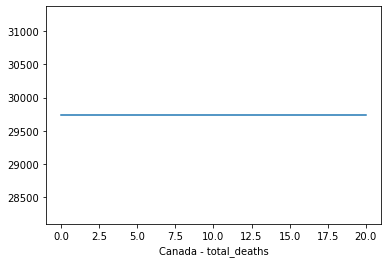

Input: [29655. 29671. 29681. 29686. 29722. 29739. 29739.], Predicted: 29734.410
Input: [29671.   29681.   29686.   29722.   29739.   29739.   29734.41], Predicted: 29734.410
Input: [29681.   29686.   29722.   29739.   29739.   29734.41 29734.41], Predicted: 29734.410
Input: [29686.   29722.   29739.   29739.   29734.41 29734.41 29734.41], Predicted: 29734.410
Input: [29722.   29739.   29739.   29734.41 29734.41 29734.41 29734.41], Predicted: 29734.410
Input: [29739.   29739.   29734.41 29734.41 29734.41 29734.41 29734.41], Predicted: 29734.410
Input: [29739.   29734.41 29734.41 29734.41 29734.41 29734.41 29734.41], Predicted: 29734.410
Input: [29734.41 29734.41 29734.41 29734.41 29734.41 29734.41 29734.41], Predicted: 29734.410
Input: [29734.41 29734.41 29734.41 29734.41 29734.41 29734.41 29734.41], Predicted: 29734.410
Input: [29734.41 29734.41 29734.41 29734.41 29734.41 29734.41 29734.41], Predicted: 29734.410
Input: [29734.41 29734.41 29734.41 29734.41 29734.41 29734.41 29734.41], P

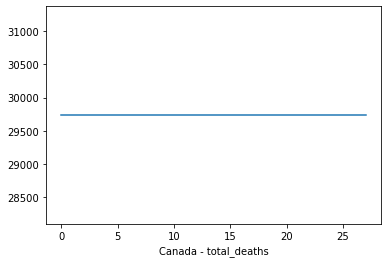

Input: [29655. 29671. 29681. 29686. 29722. 29739. 29739.], Predicted: 29735.580
Input: [29671.   29681.   29686.   29722.   29739.   29739.   29735.58], Predicted: 29735.580
Input: [29681.   29686.   29722.   29739.   29739.   29735.58 29735.58], Predicted: 29735.580
Input: [29686.   29722.   29739.   29739.   29735.58 29735.58 29735.58], Predicted: 29735.580
Input: [29722.   29739.   29739.   29735.58 29735.58 29735.58 29735.58], Predicted: 29735.580
Input: [29739.   29739.   29735.58 29735.58 29735.58 29735.58 29735.58], Predicted: 29735.580
Input: [29739.   29735.58 29735.58 29735.58 29735.58 29735.58 29735.58], Predicted: 29735.580
Input: [29735.58 29735.58 29735.58 29735.58 29735.58 29735.58 29735.58], Predicted: 29735.580
Input: [29735.58 29735.58 29735.58 29735.58 29735.58 29735.58 29735.58], Predicted: 29735.580
Input: [29735.58 29735.58 29735.58 29735.58 29735.58 29735.58 29735.58], Predicted: 29735.580
Input: [29735.58 29735.58 29735.58 29735.58 29735.58 29735.58 29735.58], P

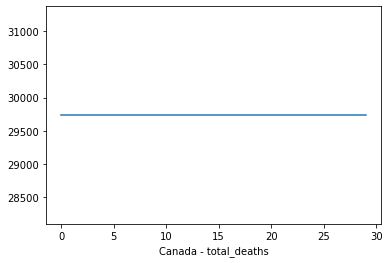

Input: [60223639. 60309236. 60370637. 60438189. 60584976. 60695270. 60695270.], Predicted: 60665194.220
Input: [60309236.   60370637.   60438189.   60584976.   60695270.   60695270.
 60665194.22], Predicted: 60665194.220
Input: [60370637.   60438189.   60584976.   60695270.   60695270.   60665194.22
 60665194.22], Predicted: 60665194.220
Input: [60438189.   60584976.   60695270.   60695270.   60665194.22 60665194.22
 60665194.22], Predicted: 60665194.220
Input: [60584976.   60695270.   60695270.   60665194.22 60665194.22 60665194.22
 60665194.22], Predicted: 60665194.220
Input: [60695270.   60695270.   60665194.22 60665194.22 60665194.22 60665194.22
 60665194.22], Predicted: 60665194.220
Input: [60695270.   60665194.22 60665194.22 60665194.22 60665194.22 60665194.22
 60665194.22], Predicted: 60665194.220
[60665194.22, 60665194.22, 60665194.22, 60665194.22, 60665194.22, 60665194.22, 60665194.22]


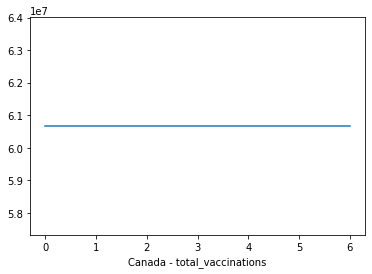

Input: [60223639. 60309236. 60370637. 60438189. 60584976. 60695270. 60695270.], Predicted: 60680939.930
Input: [60309236.   60370637.   60438189.   60584976.   60695270.   60695270.
 60680939.93], Predicted: 60680939.930
Input: [60370637.   60438189.   60584976.   60695270.   60695270.   60680939.93
 60680939.93], Predicted: 60680939.930
Input: [60438189.   60584976.   60695270.   60695270.   60680939.93 60680939.93
 60680939.93], Predicted: 60680939.930
Input: [60584976.   60695270.   60695270.   60680939.93 60680939.93 60680939.93
 60680939.93], Predicted: 60680939.930
Input: [60695270.   60695270.   60680939.93 60680939.93 60680939.93 60680939.93
 60680939.93], Predicted: 60680939.930
Input: [60695270.   60680939.93 60680939.93 60680939.93 60680939.93 60680939.93
 60680939.93], Predicted: 60680939.930
Input: [60680939.93 60680939.93 60680939.93 60680939.93 60680939.93 60680939.93
 60680939.93], Predicted: 60680939.930
Input: [60680939.93 60680939.93 60680939.93 60680939.93 60680939.

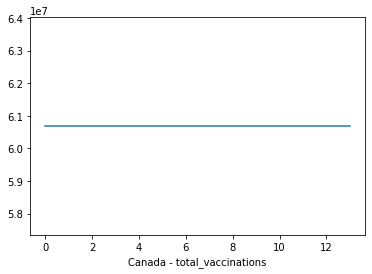

Input: [60223639. 60309236. 60370637. 60438189. 60584976. 60695270. 60695270.], Predicted: 60663664.740
Input: [60309236.   60370637.   60438189.   60584976.   60695270.   60695270.
 60663664.74], Predicted: 60663664.740
Input: [60370637.   60438189.   60584976.   60695270.   60695270.   60663664.74
 60663664.74], Predicted: 60663664.740
Input: [60438189.   60584976.   60695270.   60695270.   60663664.74 60663664.74
 60663664.74], Predicted: 60663664.740
Input: [60584976.   60695270.   60695270.   60663664.74 60663664.74 60663664.74
 60663664.74], Predicted: 60663664.740
Input: [60695270.   60695270.   60663664.74 60663664.74 60663664.74 60663664.74
 60663664.74], Predicted: 60663664.740
Input: [60695270.   60663664.74 60663664.74 60663664.74 60663664.74 60663664.74
 60663664.74], Predicted: 60663664.740
Input: [60663664.74 60663664.74 60663664.74 60663664.74 60663664.74 60663664.74
 60663664.74], Predicted: 60663664.740
Input: [60663664.74 60663664.74 60663664.74 60663664.74 60663664.

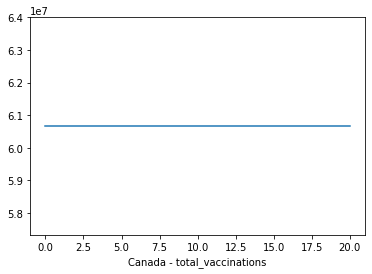

Input: [60223639. 60309236. 60370637. 60438189. 60584976. 60695270. 60695270.], Predicted: 60672543.730
Input: [60309236.   60370637.   60438189.   60584976.   60695270.   60695270.
 60672543.73], Predicted: 60672543.730
Input: [60370637.   60438189.   60584976.   60695270.   60695270.   60672543.73
 60672543.73], Predicted: 60672543.730
Input: [60438189.   60584976.   60695270.   60695270.   60672543.73 60672543.73
 60672543.73], Predicted: 60672543.730
Input: [60584976.   60695270.   60695270.   60672543.73 60672543.73 60672543.73
 60672543.73], Predicted: 60672543.730
Input: [60695270.   60695270.   60672543.73 60672543.73 60672543.73 60672543.73
 60672543.73], Predicted: 60672543.730
Input: [60695270.   60672543.73 60672543.73 60672543.73 60672543.73 60672543.73
 60672543.73], Predicted: 60672543.730
Input: [60672543.73 60672543.73 60672543.73 60672543.73 60672543.73 60672543.73
 60672543.73], Predicted: 60672543.730
Input: [60672543.73 60672543.73 60672543.73 60672543.73 60672543.

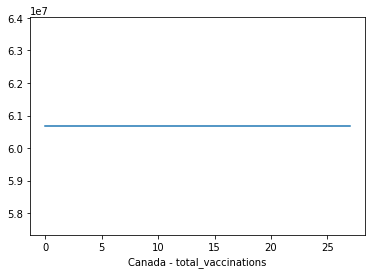

Input: [60223639. 60309236. 60370637. 60438189. 60584976. 60695270. 60695270.], Predicted: 60663052.940
Input: [60309236.   60370637.   60438189.   60584976.   60695270.   60695270.
 60663052.94], Predicted: 60663052.940
Input: [60370637.   60438189.   60584976.   60695270.   60695270.   60663052.94
 60663052.94], Predicted: 60663052.940
Input: [60438189.   60584976.   60695270.   60695270.   60663052.94 60663052.94
 60663052.94], Predicted: 60663052.940
Input: [60584976.   60695270.   60695270.   60663052.94 60663052.94 60663052.94
 60663052.94], Predicted: 60663052.940
Input: [60695270.   60695270.   60663052.94 60663052.94 60663052.94 60663052.94
 60663052.94], Predicted: 60663052.940
Input: [60695270.   60663052.94 60663052.94 60663052.94 60663052.94 60663052.94
 60663052.94], Predicted: 60663052.940
Input: [60663052.94 60663052.94 60663052.94 60663052.94 60663052.94 60663052.94
 60663052.94], Predicted: 60663052.940
Input: [60663052.94 60663052.94 60663052.94 60663052.94 60663052.

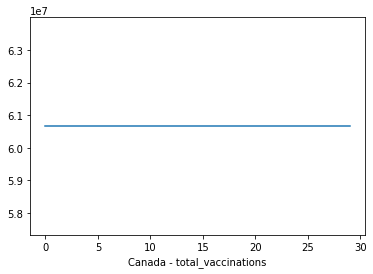

Input: [28937165. 28962557. 28974714. 28984579. 29008633. 29022810. 29022810.], Predicted: 29018562.070
Input: [28962557.   28974714.   28984579.   29008633.   29022810.   29022810.
 29018562.07], Predicted: 29018562.070
Input: [28974714.   28984579.   29008633.   29022810.   29022810.   29018562.07
 29018562.07], Predicted: 29018562.070
Input: [28984579.   29008633.   29022810.   29022810.   29018562.07 29018562.07
 29018562.07], Predicted: 29018562.070
Input: [29008633.   29022810.   29022810.   29018562.07 29018562.07 29018562.07
 29018562.07], Predicted: 29018562.070
Input: [29022810.   29022810.   29018562.07 29018562.07 29018562.07 29018562.07
 29018562.07], Predicted: 29018562.070
Input: [29022810.   29018562.07 29018562.07 29018562.07 29018562.07 29018562.07
 29018562.07], Predicted: 29018562.070
[29018562.07, 29018562.07, 29018562.07, 29018562.07, 29018562.07, 29018562.07, 29018562.07]


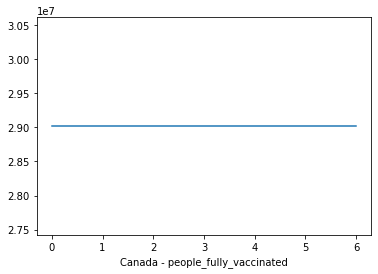

Input: [28937165. 28962557. 28974714. 28984579. 29008633. 29022810. 29022810.], Predicted: 29019204.880
Input: [28962557.   28974714.   28984579.   29008633.   29022810.   29022810.
 29019204.88], Predicted: 29019204.880
Input: [28974714.   28984579.   29008633.   29022810.   29022810.   29019204.88
 29019204.88], Predicted: 29019204.880
Input: [28984579.   29008633.   29022810.   29022810.   29019204.88 29019204.88
 29019204.88], Predicted: 29019204.880
Input: [29008633.   29022810.   29022810.   29019204.88 29019204.88 29019204.88
 29019204.88], Predicted: 29019204.880
Input: [29022810.   29022810.   29019204.88 29019204.88 29019204.88 29019204.88
 29019204.88], Predicted: 29019204.880
Input: [29022810.   29019204.88 29019204.88 29019204.88 29019204.88 29019204.88
 29019204.88], Predicted: 29019204.880
Input: [29019204.88 29019204.88 29019204.88 29019204.88 29019204.88 29019204.88
 29019204.88], Predicted: 29019204.880
Input: [29019204.88 29019204.88 29019204.88 29019204.88 29019204.

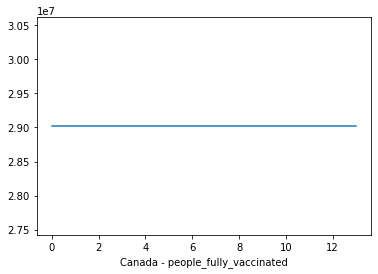

Input: [28937165. 28962557. 28974714. 28984579. 29008633. 29022810. 29022810.], Predicted: 29019906.300
Input: [28962557.  28974714.  28984579.  29008633.  29022810.  29022810.
 29019906.3], Predicted: 29019906.300
Input: [28974714.  28984579.  29008633.  29022810.  29022810.  29019906.3
 29019906.3], Predicted: 29019906.300
Input: [28984579.  29008633.  29022810.  29022810.  29019906.3 29019906.3
 29019906.3], Predicted: 29019906.300
Input: [29008633.  29022810.  29022810.  29019906.3 29019906.3 29019906.3
 29019906.3], Predicted: 29019906.300
Input: [29022810.  29022810.  29019906.3 29019906.3 29019906.3 29019906.3
 29019906.3], Predicted: 29019906.300
Input: [29022810.  29019906.3 29019906.3 29019906.3 29019906.3 29019906.3
 29019906.3], Predicted: 29019906.300
Input: [29019906.3 29019906.3 29019906.3 29019906.3 29019906.3 29019906.3
 29019906.3], Predicted: 29019906.300
Input: [29019906.3 29019906.3 29019906.3 29019906.3 29019906.3 29019906.3
 29019906.3], Predicted: 29019906.300
I

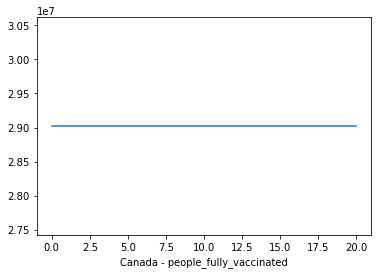

Input: [28937165. 28962557. 28974714. 28984579. 29008633. 29022810. 29022810.], Predicted: 29019323.850
Input: [28962557.   28974714.   28984579.   29008633.   29022810.   29022810.
 29019323.85], Predicted: 29019323.850
Input: [28974714.   28984579.   29008633.   29022810.   29022810.   29019323.85
 29019323.85], Predicted: 29019323.850
Input: [28984579.   29008633.   29022810.   29022810.   29019323.85 29019323.85
 29019323.85], Predicted: 29019323.850
Input: [29008633.   29022810.   29022810.   29019323.85 29019323.85 29019323.85
 29019323.85], Predicted: 29019323.850
Input: [29022810.   29022810.   29019323.85 29019323.85 29019323.85 29019323.85
 29019323.85], Predicted: 29019323.850
Input: [29022810.   29019323.85 29019323.85 29019323.85 29019323.85 29019323.85
 29019323.85], Predicted: 29019323.850
Input: [29019323.85 29019323.85 29019323.85 29019323.85 29019323.85 29019323.85
 29019323.85], Predicted: 29019323.850
Input: [29019323.85 29019323.85 29019323.85 29019323.85 29019323.

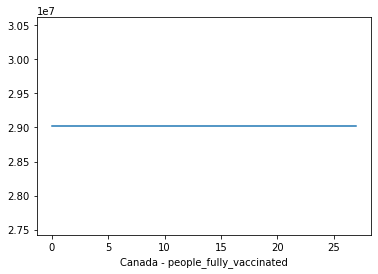

Input: [28937165. 28962557. 28974714. 28984579. 29008633. 29022810. 29022810.], Predicted: 29019672.580
Input: [28962557.   28974714.   28984579.   29008633.   29022810.   29022810.
 29019672.58], Predicted: 29019672.580
Input: [28974714.   28984579.   29008633.   29022810.   29022810.   29019672.58
 29019672.58], Predicted: 29019672.580
Input: [28984579.   29008633.   29022810.   29022810.   29019672.58 29019672.58
 29019672.58], Predicted: 29019672.580
Input: [29008633.   29022810.   29022810.   29019672.58 29019672.58 29019672.58
 29019672.58], Predicted: 29019672.580
Input: [29022810.   29022810.   29019672.58 29019672.58 29019672.58 29019672.58
 29019672.58], Predicted: 29019672.580
Input: [29022810.   29019672.58 29019672.58 29019672.58 29019672.58 29019672.58
 29019672.58], Predicted: 29019672.580
Input: [29019672.58 29019672.58 29019672.58 29019672.58 29019672.58 29019672.58
 29019672.58], Predicted: 29019672.580
Input: [29019672.58 29019672.58 29019672.58 29019672.58 29019672.

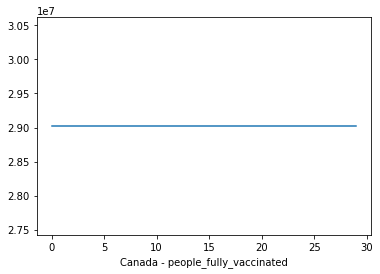

Input: [4223. 3037. 1982. 1725. 4229. 2352.    0.], Predicted: 5664.610
Input: [3037.   1982.   1725.   4229.   2352.      0.   5664.61], Predicted: 3289.010
Input: [1982.   1725.   4229.   2352.      0.   5664.61 3289.01], Predicted: 2236.220
Input: [1725.   4229.   2352.      0.   5664.61 3289.01 2236.22], Predicted: 2516.070
Input: [4229.   2352.      0.   5664.61 3289.01 2236.22 2516.07], Predicted: 3602.220
Input: [2352.      0.   5664.61 3289.01 2236.22 2516.07 3602.22], Predicted: 2849.190
Input: [   0.   5664.61 3289.01 2236.22 2516.07 3602.22 2849.19], Predicted: 1988.080
[5664.61, 3289.01, 2236.22, 2516.07, 3602.22, 2849.19, 1988.08]


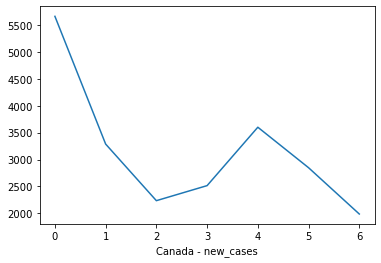

Input: [4223. 3037. 1982. 1725. 4229. 2352.    0.], Predicted: 5581.900
Input: [3037.  1982.  1725.  4229.  2352.     0.  5581.9], Predicted: 3339.180
Input: [1982.   1725.   4229.   2352.      0.   5581.9  3339.18], Predicted: 2192.370
Input: [1725.   4229.   2352.      0.   5581.9  3339.18 2192.37], Predicted: 2741.600
Input: [4229.   2352.      0.   5581.9  3339.18 2192.37 2741.6 ], Predicted: 3422.180
Input: [2352.      0.   5581.9  3339.18 2192.37 2741.6  3422.18], Predicted: 2917.340
Input: [   0.   5581.9  3339.18 2192.37 2741.6  3422.18 2917.34], Predicted: 2114.980
Input: [5581.9  3339.18 2192.37 2741.6  3422.18 2917.34 2114.98], Predicted: 3273.020
Input: [3339.18 2192.37 2741.6  3422.18 2917.34 2114.98 3273.02], Predicted: 3410.250
Input: [2192.37 2741.6  3422.18 2917.34 2114.98 3273.02 3410.25], Predicted: 2557.590
Input: [2741.6  3422.18 2917.34 2114.98 3273.02 3410.25 2557.59], Predicted: 2999.700
Input: [3422.18 2917.34 2114.98 3273.02 3410.25 2557.59 2999.7 ], Predicted

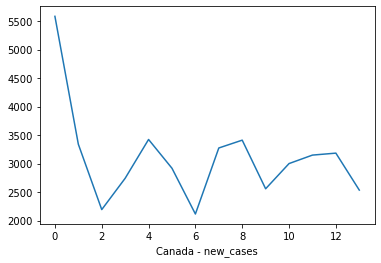

Input: [4223. 3037. 1982. 1725. 4229. 2352.    0.], Predicted: 6423.930
Input: [3037.   1982.   1725.   4229.   2352.      0.   6423.93], Predicted: 3218.880
Input: [1982.   1725.   4229.   2352.      0.   6423.93 3218.88], Predicted: 2112.960
Input: [1725.   4229.   2352.      0.   6423.93 3218.88 2112.96], Predicted: 3021.690
Input: [4229.   2352.      0.   6423.93 3218.88 2112.96 3021.69], Predicted: 3555.990
Input: [2352.      0.   6423.93 3218.88 2112.96 3021.69 3555.99], Predicted: 2785.860
Input: [   0.   6423.93 3218.88 2112.96 3021.69 3555.99 2785.86], Predicted: 2055.220
Input: [6423.93 3218.88 2112.96 3021.69 3555.99 2785.86 2055.22], Predicted: 2545.340
Input: [3218.88 2112.96 3021.69 3555.99 2785.86 2055.22 2545.34], Predicted: 3336.680
Input: [2112.96 3021.69 3555.99 2785.86 2055.22 2545.34 3336.68], Predicted: 2395.100
Input: [3021.69 3555.99 2785.86 2055.22 2545.34 3336.68 2395.1 ], Predicted: 2968.130
Input: [3555.99 2785.86 2055.22 2545.34 3336.68 2395.1  2968.13], Pr

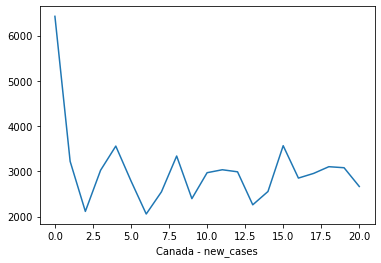

Input: [4223. 3037. 1982. 1725. 4229. 2352.    0.], Predicted: 5965.040
Input: [3037.   1982.   1725.   4229.   2352.      0.   5965.04], Predicted: 3760.580
Input: [1982.   1725.   4229.   2352.      0.   5965.04 3760.58], Predicted: 2033.740
Input: [1725.   4229.   2352.      0.   5965.04 3760.58 2033.74], Predicted: 2663.100
Input: [4229.   2352.      0.   5965.04 3760.58 2033.74 2663.1 ], Predicted: 3524.350
Input: [2352.      0.   5965.04 3760.58 2033.74 2663.1  3524.35], Predicted: 2967.150
Input: [   0.   5965.04 3760.58 2033.74 2663.1  3524.35 2967.15], Predicted: 2056.300
Input: [5965.04 3760.58 2033.74 2663.1  3524.35 2967.15 2056.3 ], Predicted: 3370.440
Input: [3760.58 2033.74 2663.1  3524.35 2967.15 2056.3  3370.44], Predicted: 3423.740
Input: [2033.74 2663.1  3524.35 2967.15 2056.3  3370.44 3423.74], Predicted: 2493.710
Input: [2663.1  3524.35 2967.15 2056.3  3370.44 3423.74 2493.71], Predicted: 2581.680
Input: [3524.35 2967.15 2056.3  3370.44 3423.74 2493.71 2581.68], Pr

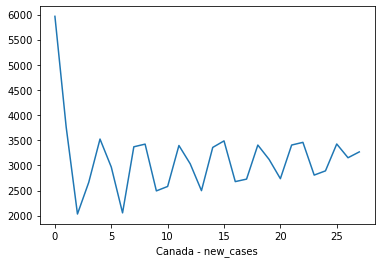

Input: [4223. 3037. 1982. 1725. 4229. 2352.    0.], Predicted: 6272.390
Input: [3037.   1982.   1725.   4229.   2352.      0.   6272.39], Predicted: 3257.880
Input: [1982.   1725.   4229.   2352.      0.   6272.39 3257.88], Predicted: 2151.120
Input: [1725.   4229.   2352.      0.   6272.39 3257.88 2151.12], Predicted: 2942.360
Input: [4229.   2352.      0.   6272.39 3257.88 2151.12 2942.36], Predicted: 3473.680
Input: [2352.      0.   6272.39 3257.88 2151.12 2942.36 3473.68], Predicted: 2884.020
Input: [   0.   6272.39 3257.88 2151.12 2942.36 3473.68 2884.02], Predicted: 1910.170
Input: [6272.39 3257.88 2151.12 2942.36 3473.68 2884.02 1910.17], Predicted: 2745.700
Input: [3257.88 2151.12 2942.36 3473.68 2884.02 1910.17 2745.7 ], Predicted: 3539.860
Input: [2151.12 2942.36 3473.68 2884.02 1910.17 2745.7  3539.86], Predicted: 2583.820
Input: [2942.36 3473.68 2884.02 1910.17 2745.7  3539.86 2583.82], Predicted: 3056.470
Input: [3473.68 2884.02 1910.17 2745.7  3539.86 2583.82 3056.47], Pr

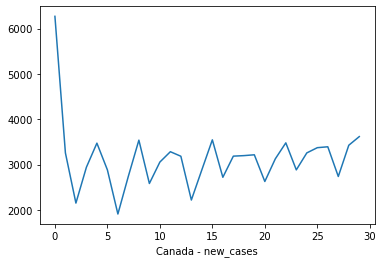

Input: [20. 16. 10.  5. 36. 17.  0.], Predicted: 17.660
Input: [16.   10.    5.   36.   17.    0.   17.66], Predicted: 23.360
Input: [10.    5.   36.   17.    0.   17.66 23.36], Predicted: 29.890
Input: [ 5.   36.   17.    0.   17.66 23.36 29.89], Predicted: 28.900
Input: [36.   17.    0.   17.66 23.36 29.89 28.9 ], Predicted: 25.850
Input: [17.    0.   17.66 23.36 29.89 28.9  25.85], Predicted: 20.340
Input: [ 0.   17.66 23.36 29.89 28.9  25.85 20.34], Predicted: 21.690
[17.66, 23.36, 29.89, 28.9, 25.85, 20.34, 21.69]


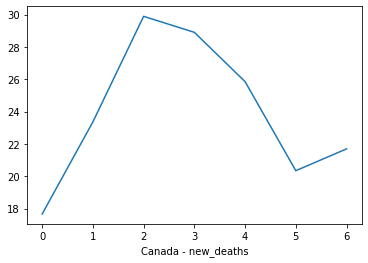

Input: [20. 16. 10.  5. 36. 17.  0.], Predicted: 17.630
Input: [16.   10.    5.   36.   17.    0.   17.63], Predicted: 24.650
Input: [10.    5.   36.   17.    0.   17.63 24.65], Predicted: 25.600
Input: [ 5.   36.   17.    0.   17.63 24.65 25.6 ], Predicted: 28.840
Input: [36.   17.    0.   17.63 24.65 25.6  28.84], Predicted: 22.480
Input: [17.    0.   17.63 24.65 25.6  28.84 22.48], Predicted: 19.990
Input: [ 0.   17.63 24.65 25.6  28.84 22.48 19.99], Predicted: 25.510
Input: [17.63 24.65 25.6  28.84 22.48 19.99 25.51], Predicted: 25.050
Input: [24.65 25.6  28.84 22.48 19.99 25.51 25.05], Predicted: 27.230
Input: [25.6  28.84 22.48 19.99 25.51 25.05 27.23], Predicted: 27.980
Input: [28.84 22.48 19.99 25.51 25.05 27.23 27.98], Predicted: 22.790
Input: [22.48 19.99 25.51 25.05 27.23 27.98 22.79], Predicted: 25.830
Input: [19.99 25.51 25.05 27.23 27.98 22.79 25.83], Predicted: 26.040
Input: [25.51 25.05 27.23 27.98 22.79 25.83 26.04], Predicted: 26.650
[17.63, 24.65, 25.6, 28.84, 22.48,

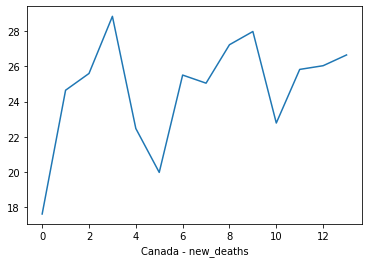

Input: [20. 16. 10.  5. 36. 17.  0.], Predicted: 14.920
Input: [16.   10.    5.   36.   17.    0.   14.92], Predicted: 26.940
Input: [10.    5.   36.   17.    0.   14.92 26.94], Predicted: 26.690
Input: [ 5.   36.   17.    0.   14.92 26.94 26.69], Predicted: 27.730
Input: [36.   17.    0.   14.92 26.94 26.69 27.73], Predicted: 28.060
Input: [17.    0.   14.92 26.94 26.69 27.73 28.06], Predicted: 21.760
Input: [ 0.   14.92 26.94 26.69 27.73 28.06 21.76], Predicted: 21.580
Input: [14.92 26.94 26.69 27.73 28.06 21.76 21.58], Predicted: 27.160
Input: [26.94 26.69 27.73 28.06 21.76 21.58 27.16], Predicted: 28.400
Input: [26.69 27.73 28.06 21.76 21.58 27.16 28.4 ], Predicted: 26.420
Input: [27.73 28.06 21.76 21.58 27.16 28.4  26.42], Predicted: 25.910
Input: [28.06 21.76 21.58 27.16 28.4  26.42 25.91], Predicted: 26.930
Input: [21.76 21.58 27.16 28.4  26.42 25.91 26.93], Predicted: 26.820
Input: [21.58 27.16 28.4  26.42 25.91 26.93 26.82], Predicted: 25.850
Input: [27.16 28.4  26.42 25.91 26

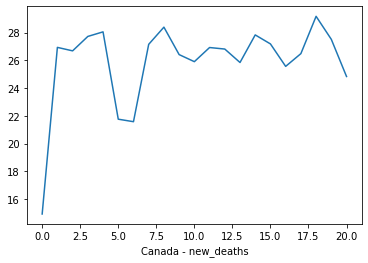

Input: [20. 16. 10.  5. 36. 17.  0.], Predicted: 19.600
Input: [16.  10.   5.  36.  17.   0.  19.6], Predicted: 28.120
Input: [10.    5.   36.   17.    0.   19.6  28.12], Predicted: 20.720
Input: [ 5.   36.   17.    0.   19.6  28.12 20.72], Predicted: 25.670
Input: [36.   17.    0.   19.6  28.12 20.72 25.67], Predicted: 26.430
Input: [17.    0.   19.6  28.12 20.72 25.67 26.43], Predicted: 18.530
Input: [ 0.   19.6  28.12 20.72 25.67 26.43 18.53], Predicted: 23.250
Input: [19.6  28.12 20.72 25.67 26.43 18.53 23.25], Predicted: 24.500
Input: [28.12 20.72 25.67 26.43 18.53 23.25 24.5 ], Predicted: 26.870
Input: [20.72 25.67 26.43 18.53 23.25 24.5  26.87], Predicted: 24.860
Input: [25.67 26.43 18.53 23.25 24.5  26.87 24.86], Predicted: 22.600
Input: [26.43 18.53 23.25 24.5  26.87 24.86 22.6 ], Predicted: 27.260
Input: [18.53 23.25 24.5  26.87 24.86 22.6  27.26], Predicted: 24.470
Input: [23.25 24.5  26.87 24.86 22.6  27.26 24.47], Predicted: 25.210
Input: [24.5  26.87 24.86 22.6  27.26 24.

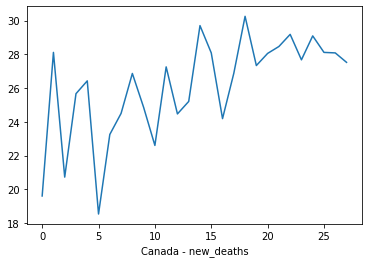

Input: [20. 16. 10.  5. 36. 17.  0.], Predicted: 19.990
Input: [16.   10.    5.   36.   17.    0.   19.99], Predicted: 22.220
Input: [10.    5.   36.   17.    0.   19.99 22.22], Predicted: 30.010
Input: [ 5.   36.   17.    0.   19.99 22.22 30.01], Predicted: 26.350
Input: [36.   17.    0.   19.99 22.22 30.01 26.35], Predicted: 24.400
Input: [17.    0.   19.99 22.22 30.01 26.35 24.4 ], Predicted: 20.790
Input: [ 0.   19.99 22.22 30.01 26.35 24.4  20.79], Predicted: 24.300
Input: [19.99 22.22 30.01 26.35 24.4  20.79 24.3 ], Predicted: 26.140
Input: [22.22 30.01 26.35 24.4  20.79 24.3  26.14], Predicted: 29.110
Input: [30.01 26.35 24.4  20.79 24.3  26.14 29.11], Predicted: 26.580
Input: [26.35 24.4  20.79 24.3  26.14 29.11 26.58], Predicted: 24.420
Input: [24.4  20.79 24.3  26.14 29.11 26.58 24.42], Predicted: 25.520
Input: [20.79 24.3  26.14 29.11 26.58 24.42 25.52], Predicted: 30.090
Input: [24.3  26.14 29.11 26.58 24.42 25.52 30.09], Predicted: 27.840
Input: [26.14 29.11 26.58 24.42 25

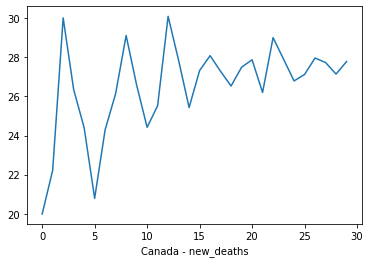

Input: [5319867. 5322127. 5324039. 5325560. 5326448. 5328416. 5330748.], Predicted: 5329533.410
Input: [5322127.   5324039.   5325560.   5326448.   5328416.   5330748.
 5329533.41], Predicted: 5329533.410
Input: [5324039.   5325560.   5326448.   5328416.   5330748.   5329533.41
 5329533.41], Predicted: 5329533.410
Input: [5325560.   5326448.   5328416.   5330748.   5329533.41 5329533.41
 5329533.41], Predicted: 5329533.410
Input: [5326448.   5328416.   5330748.   5329533.41 5329533.41 5329533.41
 5329533.41], Predicted: 5329533.410
Input: [5328416.   5330748.   5329533.41 5329533.41 5329533.41 5329533.41
 5329533.41], Predicted: 5329533.410
Input: [5330748.   5329533.41 5329533.41 5329533.41 5329533.41 5329533.41
 5329533.41], Predicted: 5329533.410
[5329533.41, 5329533.41, 5329533.41, 5329533.41, 5329533.41, 5329533.41, 5329533.41]


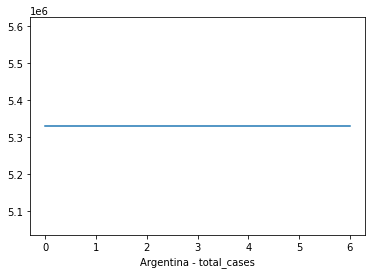

Input: [5319867. 5322127. 5324039. 5325560. 5326448. 5328416. 5330748.], Predicted: 5329766.310
Input: [5322127.   5324039.   5325560.   5326448.   5328416.   5330748.
 5329766.31], Predicted: 5329766.310
Input: [5324039.   5325560.   5326448.   5328416.   5330748.   5329766.31
 5329766.31], Predicted: 5329766.310
Input: [5325560.   5326448.   5328416.   5330748.   5329766.31 5329766.31
 5329766.31], Predicted: 5329766.310
Input: [5326448.   5328416.   5330748.   5329766.31 5329766.31 5329766.31
 5329766.31], Predicted: 5329766.310
Input: [5328416.   5330748.   5329766.31 5329766.31 5329766.31 5329766.31
 5329766.31], Predicted: 5329766.310
Input: [5330748.   5329766.31 5329766.31 5329766.31 5329766.31 5329766.31
 5329766.31], Predicted: 5329766.310
Input: [5329766.31 5329766.31 5329766.31 5329766.31 5329766.31 5329766.31
 5329766.31], Predicted: 5329766.310
Input: [5329766.31 5329766.31 5329766.31 5329766.31 5329766.31 5329766.31
 5329766.31], Predicted: 5329766.310
Input: [5329766.31

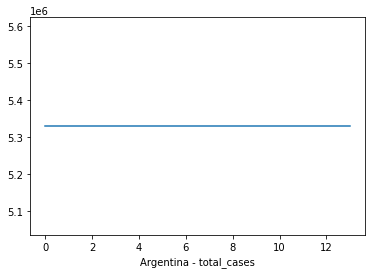

Input: [5319867. 5322127. 5324039. 5325560. 5326448. 5328416. 5330748.], Predicted: 5329540.170
Input: [5322127.   5324039.   5325560.   5326448.   5328416.   5330748.
 5329540.17], Predicted: 5329540.170
Input: [5324039.   5325560.   5326448.   5328416.   5330748.   5329540.17
 5329540.17], Predicted: 5329540.170
Input: [5325560.   5326448.   5328416.   5330748.   5329540.17 5329540.17
 5329540.17], Predicted: 5329540.170
Input: [5326448.   5328416.   5330748.   5329540.17 5329540.17 5329540.17
 5329540.17], Predicted: 5329540.170
Input: [5328416.   5330748.   5329540.17 5329540.17 5329540.17 5329540.17
 5329540.17], Predicted: 5329540.170
Input: [5330748.   5329540.17 5329540.17 5329540.17 5329540.17 5329540.17
 5329540.17], Predicted: 5329540.170
Input: [5329540.17 5329540.17 5329540.17 5329540.17 5329540.17 5329540.17
 5329540.17], Predicted: 5329540.170
Input: [5329540.17 5329540.17 5329540.17 5329540.17 5329540.17 5329540.17
 5329540.17], Predicted: 5329540.170
Input: [5329540.17

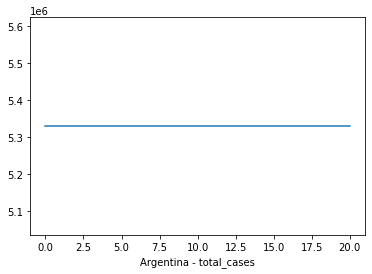

Input: [5319867. 5322127. 5324039. 5325560. 5326448. 5328416. 5330748.], Predicted: 5329669.110
Input: [5322127.   5324039.   5325560.   5326448.   5328416.   5330748.
 5329669.11], Predicted: 5329669.110
Input: [5324039.   5325560.   5326448.   5328416.   5330748.   5329669.11
 5329669.11], Predicted: 5329669.110
Input: [5325560.   5326448.   5328416.   5330748.   5329669.11 5329669.11
 5329669.11], Predicted: 5329669.110
Input: [5326448.   5328416.   5330748.   5329669.11 5329669.11 5329669.11
 5329669.11], Predicted: 5329669.110
Input: [5328416.   5330748.   5329669.11 5329669.11 5329669.11 5329669.11
 5329669.11], Predicted: 5329669.110
Input: [5330748.   5329669.11 5329669.11 5329669.11 5329669.11 5329669.11
 5329669.11], Predicted: 5329669.110
Input: [5329669.11 5329669.11 5329669.11 5329669.11 5329669.11 5329669.11
 5329669.11], Predicted: 5329669.110
Input: [5329669.11 5329669.11 5329669.11 5329669.11 5329669.11 5329669.11
 5329669.11], Predicted: 5329669.110
Input: [5329669.11

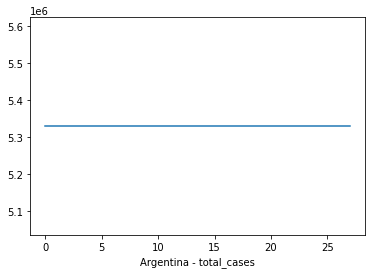

Input: [5319867. 5322127. 5324039. 5325560. 5326448. 5328416. 5330748.], Predicted: 5329332.890
Input: [5322127.   5324039.   5325560.   5326448.   5328416.   5330748.
 5329332.89], Predicted: 5329332.890
Input: [5324039.   5325560.   5326448.   5328416.   5330748.   5329332.89
 5329332.89], Predicted: 5329332.890
Input: [5325560.   5326448.   5328416.   5330748.   5329332.89 5329332.89
 5329332.89], Predicted: 5329332.890
Input: [5326448.   5328416.   5330748.   5329332.89 5329332.89 5329332.89
 5329332.89], Predicted: 5329332.890
Input: [5328416.   5330748.   5329332.89 5329332.89 5329332.89 5329332.89
 5329332.89], Predicted: 5329332.890
Input: [5330748.   5329332.89 5329332.89 5329332.89 5329332.89 5329332.89
 5329332.89], Predicted: 5329332.890
Input: [5329332.89 5329332.89 5329332.89 5329332.89 5329332.89 5329332.89
 5329332.89], Predicted: 5329332.890
Input: [5329332.89 5329332.89 5329332.89 5329332.89 5329332.89 5329332.89
 5329332.89], Predicted: 5329332.890
Input: [5329332.89

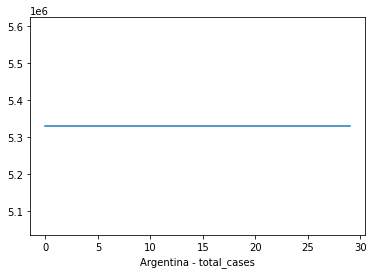

Input: [116458. 116480. 116505. 116517. 116529. 116554. 116589.], Predicted: 116573.760
Input: [116480.   116505.   116517.   116529.   116554.   116589.   116573.76], Predicted: 116573.760
Input: [116505.   116517.   116529.   116554.   116589.   116573.76 116573.76], Predicted: 116573.760
Input: [116517.   116529.   116554.   116589.   116573.76 116573.76 116573.76], Predicted: 116573.760
Input: [116529.   116554.   116589.   116573.76 116573.76 116573.76 116573.76], Predicted: 116573.760
Input: [116554.   116589.   116573.76 116573.76 116573.76 116573.76 116573.76], Predicted: 116573.760
Input: [116589.   116573.76 116573.76 116573.76 116573.76 116573.76 116573.76], Predicted: 116573.760
[116573.76, 116573.76, 116573.76, 116573.76, 116573.76, 116573.76, 116573.76]


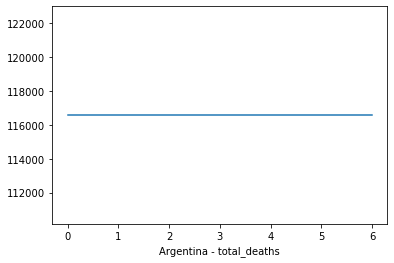

Input: [116458. 116480. 116505. 116517. 116529. 116554. 116589.], Predicted: 116575.640
Input: [116480.   116505.   116517.   116529.   116554.   116589.   116575.64], Predicted: 116575.640
Input: [116505.   116517.   116529.   116554.   116589.   116575.64 116575.64], Predicted: 116575.640
Input: [116517.   116529.   116554.   116589.   116575.64 116575.64 116575.64], Predicted: 116575.640
Input: [116529.   116554.   116589.   116575.64 116575.64 116575.64 116575.64], Predicted: 116575.640
Input: [116554.   116589.   116575.64 116575.64 116575.64 116575.64 116575.64], Predicted: 116575.640
Input: [116589.   116575.64 116575.64 116575.64 116575.64 116575.64 116575.64], Predicted: 116575.640
Input: [116575.64 116575.64 116575.64 116575.64 116575.64 116575.64 116575.64], Predicted: 116575.640
Input: [116575.64 116575.64 116575.64 116575.64 116575.64 116575.64 116575.64], Predicted: 116575.640
Input: [116575.64 116575.64 116575.64 116575.64 116575.64 116575.64 116575.64], Predicted: 11657

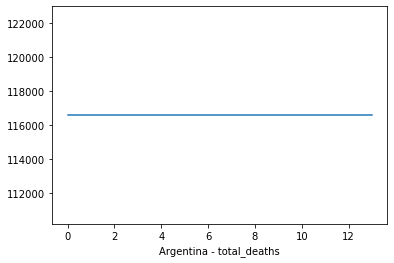

Input: [116458. 116480. 116505. 116517. 116529. 116554. 116589.], Predicted: 116571.000
Input: [116480. 116505. 116517. 116529. 116554. 116589. 116571.], Predicted: 116571.000
Input: [116505. 116517. 116529. 116554. 116589. 116571. 116571.], Predicted: 116571.000
Input: [116517. 116529. 116554. 116589. 116571. 116571. 116571.], Predicted: 116571.000
Input: [116529. 116554. 116589. 116571. 116571. 116571. 116571.], Predicted: 116571.000
Input: [116554. 116589. 116571. 116571. 116571. 116571. 116571.], Predicted: 116571.000
Input: [116589. 116571. 116571. 116571. 116571. 116571. 116571.], Predicted: 116571.000
Input: [116571. 116571. 116571. 116571. 116571. 116571. 116571.], Predicted: 116571.000
Input: [116571. 116571. 116571. 116571. 116571. 116571. 116571.], Predicted: 116571.000
Input: [116571. 116571. 116571. 116571. 116571. 116571. 116571.], Predicted: 116571.000
Input: [116571. 116571. 116571. 116571. 116571. 116571. 116571.], Predicted: 116571.000
Input: [116571. 116571. 116571. 

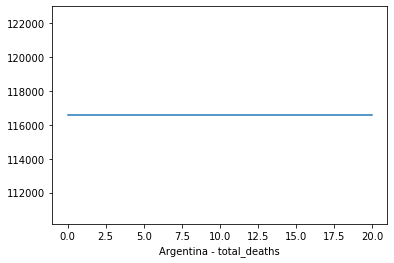

Input: [116458. 116480. 116505. 116517. 116529. 116554. 116589.], Predicted: 116571.870
Input: [116480.   116505.   116517.   116529.   116554.   116589.   116571.87], Predicted: 116571.870
Input: [116505.   116517.   116529.   116554.   116589.   116571.87 116571.87], Predicted: 116571.870
Input: [116517.   116529.   116554.   116589.   116571.87 116571.87 116571.87], Predicted: 116571.870
Input: [116529.   116554.   116589.   116571.87 116571.87 116571.87 116571.87], Predicted: 116571.870
Input: [116554.   116589.   116571.87 116571.87 116571.87 116571.87 116571.87], Predicted: 116571.870
Input: [116589.   116571.87 116571.87 116571.87 116571.87 116571.87 116571.87], Predicted: 116571.870
Input: [116571.87 116571.87 116571.87 116571.87 116571.87 116571.87 116571.87], Predicted: 116571.870
Input: [116571.87 116571.87 116571.87 116571.87 116571.87 116571.87 116571.87], Predicted: 116571.870
Input: [116571.87 116571.87 116571.87 116571.87 116571.87 116571.87 116571.87], Predicted: 11657

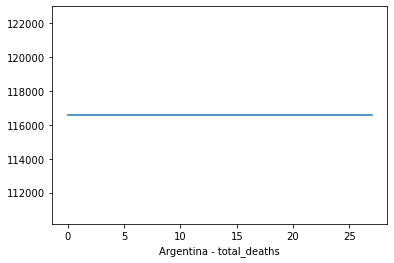

Input: [116458. 116480. 116505. 116517. 116529. 116554. 116589.], Predicted: 116570.490
Input: [116480.   116505.   116517.   116529.   116554.   116589.   116570.49], Predicted: 116570.490
Input: [116505.   116517.   116529.   116554.   116589.   116570.49 116570.49], Predicted: 116570.490
Input: [116517.   116529.   116554.   116589.   116570.49 116570.49 116570.49], Predicted: 116570.490
Input: [116529.   116554.   116589.   116570.49 116570.49 116570.49 116570.49], Predicted: 116570.490
Input: [116554.   116589.   116570.49 116570.49 116570.49 116570.49 116570.49], Predicted: 116570.490
Input: [116589.   116570.49 116570.49 116570.49 116570.49 116570.49 116570.49], Predicted: 116570.490
Input: [116570.49 116570.49 116570.49 116570.49 116570.49 116570.49 116570.49], Predicted: 116570.490
Input: [116570.49 116570.49 116570.49 116570.49 116570.49 116570.49 116570.49], Predicted: 116570.490
Input: [116570.49 116570.49 116570.49 116570.49 116570.49 116570.49 116570.49], Predicted: 11657

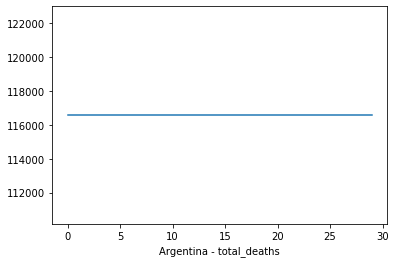

Input: [66426671. 67104574. 67104574. 67632308. 67781433. 68134307. 68501283.], Predicted: 68319113.160
Input: [67104574.   67104574.   67632308.   67781433.   68134307.   68501283.
 68319113.16], Predicted: 68319113.160
Input: [67104574.   67632308.   67781433.   68134307.   68501283.   68319113.16
 68319113.16], Predicted: 68319113.160
Input: [67632308.   67781433.   68134307.   68501283.   68319113.16 68319113.16
 68319113.16], Predicted: 68319113.160
Input: [67781433.   68134307.   68501283.   68319113.16 68319113.16 68319113.16
 68319113.16], Predicted: 68319113.160
Input: [68134307.   68501283.   68319113.16 68319113.16 68319113.16 68319113.16
 68319113.16], Predicted: 68319113.160
Input: [68501283.   68319113.16 68319113.16 68319113.16 68319113.16 68319113.16
 68319113.16], Predicted: 68319113.160
[68319113.16, 68319113.16, 68319113.16, 68319113.16, 68319113.16, 68319113.16, 68319113.16]


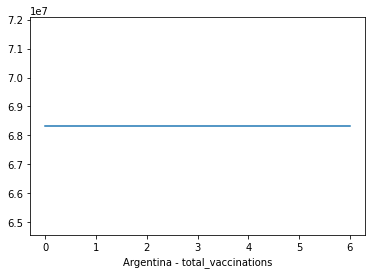

Input: [66426671. 67104574. 67104574. 67632308. 67781433. 68134307. 68501283.], Predicted: 68308526.940
Input: [67104574.   67104574.   67632308.   67781433.   68134307.   68501283.
 68308526.94], Predicted: 68308526.940
Input: [67104574.   67632308.   67781433.   68134307.   68501283.   68308526.94
 68308526.94], Predicted: 68308526.940
Input: [67632308.   67781433.   68134307.   68501283.   68308526.94 68308526.94
 68308526.94], Predicted: 68308526.940
Input: [67781433.   68134307.   68501283.   68308526.94 68308526.94 68308526.94
 68308526.94], Predicted: 68308526.940
Input: [68134307.   68501283.   68308526.94 68308526.94 68308526.94 68308526.94
 68308526.94], Predicted: 68308526.940
Input: [68501283.   68308526.94 68308526.94 68308526.94 68308526.94 68308526.94
 68308526.94], Predicted: 68308526.940
Input: [68308526.94 68308526.94 68308526.94 68308526.94 68308526.94 68308526.94
 68308526.94], Predicted: 68308526.940
Input: [68308526.94 68308526.94 68308526.94 68308526.94 68308526.

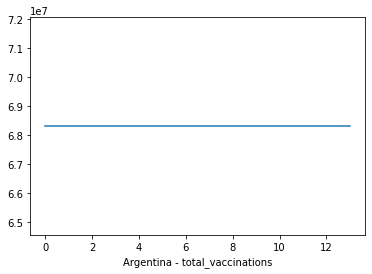

Input: [66426671. 67104574. 67104574. 67632308. 67781433. 68134307. 68501283.], Predicted: 68301617.330
Input: [67104574.   67104574.   67632308.   67781433.   68134307.   68501283.
 68301617.33], Predicted: 68301617.330
Input: [67104574.   67632308.   67781433.   68134307.   68501283.   68301617.33
 68301617.33], Predicted: 68301617.330
Input: [67632308.   67781433.   68134307.   68501283.   68301617.33 68301617.33
 68301617.33], Predicted: 68301617.330
Input: [67781433.   68134307.   68501283.   68301617.33 68301617.33 68301617.33
 68301617.33], Predicted: 68301617.330
Input: [68134307.   68501283.   68301617.33 68301617.33 68301617.33 68301617.33
 68301617.33], Predicted: 68301617.330
Input: [68501283.   68301617.33 68301617.33 68301617.33 68301617.33 68301617.33
 68301617.33], Predicted: 68301617.330
Input: [68301617.33 68301617.33 68301617.33 68301617.33 68301617.33 68301617.33
 68301617.33], Predicted: 68301617.330
Input: [68301617.33 68301617.33 68301617.33 68301617.33 68301617.

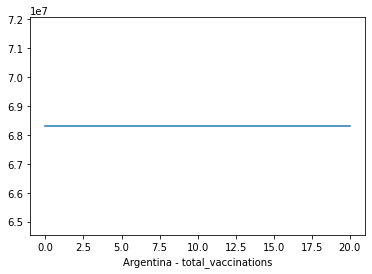

Input: [66426671. 67104574. 67104574. 67632308. 67781433. 68134307. 68501283.], Predicted: 68291958.280
Input: [67104574.   67104574.   67632308.   67781433.   68134307.   68501283.
 68291958.28], Predicted: 68291958.280
Input: [67104574.   67632308.   67781433.   68134307.   68501283.   68291958.28
 68291958.28], Predicted: 68291958.280
Input: [67632308.   67781433.   68134307.   68501283.   68291958.28 68291958.28
 68291958.28], Predicted: 68291958.280
Input: [67781433.   68134307.   68501283.   68291958.28 68291958.28 68291958.28
 68291958.28], Predicted: 68291958.280
Input: [68134307.   68501283.   68291958.28 68291958.28 68291958.28 68291958.28
 68291958.28], Predicted: 68291958.280
Input: [68501283.   68291958.28 68291958.28 68291958.28 68291958.28 68291958.28
 68291958.28], Predicted: 68291958.280
Input: [68291958.28 68291958.28 68291958.28 68291958.28 68291958.28 68291958.28
 68291958.28], Predicted: 68291958.280
Input: [68291958.28 68291958.28 68291958.28 68291958.28 68291958.

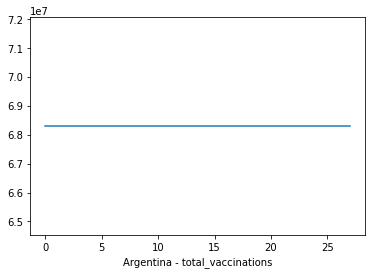

Input: [66426671. 67104574. 67104574. 67632308. 67781433. 68134307. 68501283.], Predicted: 68264102.040
Input: [67104574.   67104574.   67632308.   67781433.   68134307.   68501283.
 68264102.04], Predicted: 68264102.040
Input: [67104574.   67632308.   67781433.   68134307.   68501283.   68264102.04
 68264102.04], Predicted: 68264102.040
Input: [67632308.   67781433.   68134307.   68501283.   68264102.04 68264102.04
 68264102.04], Predicted: 68264102.040
Input: [67781433.   68134307.   68501283.   68264102.04 68264102.04 68264102.04
 68264102.04], Predicted: 68264102.040
Input: [68134307.   68501283.   68264102.04 68264102.04 68264102.04 68264102.04
 68264102.04], Predicted: 68264102.040
Input: [68501283.   68264102.04 68264102.04 68264102.04 68264102.04 68264102.04
 68264102.04], Predicted: 68264102.040
Input: [68264102.04 68264102.04 68264102.04 68264102.04 68264102.04 68264102.04
 68264102.04], Predicted: 68264102.040
Input: [68264102.04 68264102.04 68264102.04 68264102.04 68264102.

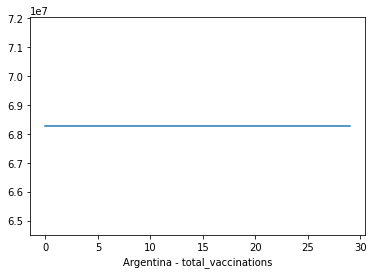

Input: [28645100. 28990917. 28990917. 29236347. 29320900. 29512760. 29710785.], Predicted: 29608428.590
Input: [28990917.   28990917.   29236347.   29320900.   29512760.   29710785.
 29608428.59], Predicted: 29608428.590
Input: [28990917.   29236347.   29320900.   29512760.   29710785.   29608428.59
 29608428.59], Predicted: 29608428.590
Input: [29236347.   29320900.   29512760.   29710785.   29608428.59 29608428.59
 29608428.59], Predicted: 29608428.590
Input: [29320900.   29512760.   29710785.   29608428.59 29608428.59 29608428.59
 29608428.59], Predicted: 29608428.590
Input: [29512760.   29710785.   29608428.59 29608428.59 29608428.59 29608428.59
 29608428.59], Predicted: 29608428.590
Input: [29710785.   29608428.59 29608428.59 29608428.59 29608428.59 29608428.59
 29608428.59], Predicted: 29608428.590
[29608428.59, 29608428.59, 29608428.59, 29608428.59, 29608428.59, 29608428.59, 29608428.59]


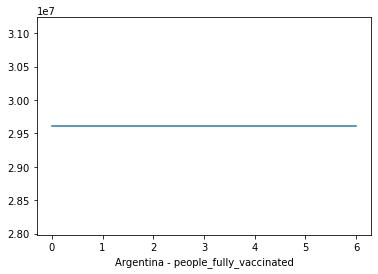

Input: [28645100. 28990917. 28990917. 29236347. 29320900. 29512760. 29710785.], Predicted: 29609150.910
Input: [28990917.   28990917.   29236347.   29320900.   29512760.   29710785.
 29609150.91], Predicted: 29609150.910
Input: [28990917.   29236347.   29320900.   29512760.   29710785.   29609150.91
 29609150.91], Predicted: 29609150.910
Input: [29236347.   29320900.   29512760.   29710785.   29609150.91 29609150.91
 29609150.91], Predicted: 29609150.910
Input: [29320900.   29512760.   29710785.   29609150.91 29609150.91 29609150.91
 29609150.91], Predicted: 29609150.910
Input: [29512760.   29710785.   29609150.91 29609150.91 29609150.91 29609150.91
 29609150.91], Predicted: 29609150.910
Input: [29710785.   29609150.91 29609150.91 29609150.91 29609150.91 29609150.91
 29609150.91], Predicted: 29609150.910
Input: [29609150.91 29609150.91 29609150.91 29609150.91 29609150.91 29609150.91
 29609150.91], Predicted: 29609150.910
Input: [29609150.91 29609150.91 29609150.91 29609150.91 29609150.

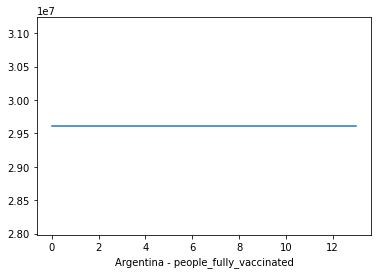

Input: [28645100. 28990917. 28990917. 29236347. 29320900. 29512760. 29710785.], Predicted: 29601209.270
Input: [28990917.   28990917.   29236347.   29320900.   29512760.   29710785.
 29601209.27], Predicted: 29601209.270
Input: [28990917.   29236347.   29320900.   29512760.   29710785.   29601209.27
 29601209.27], Predicted: 29601209.270
Input: [29236347.   29320900.   29512760.   29710785.   29601209.27 29601209.27
 29601209.27], Predicted: 29601209.270
Input: [29320900.   29512760.   29710785.   29601209.27 29601209.27 29601209.27
 29601209.27], Predicted: 29601209.270
Input: [29512760.   29710785.   29601209.27 29601209.27 29601209.27 29601209.27
 29601209.27], Predicted: 29601209.270
Input: [29710785.   29601209.27 29601209.27 29601209.27 29601209.27 29601209.27
 29601209.27], Predicted: 29601209.270
Input: [29601209.27 29601209.27 29601209.27 29601209.27 29601209.27 29601209.27
 29601209.27], Predicted: 29601209.270
Input: [29601209.27 29601209.27 29601209.27 29601209.27 29601209.

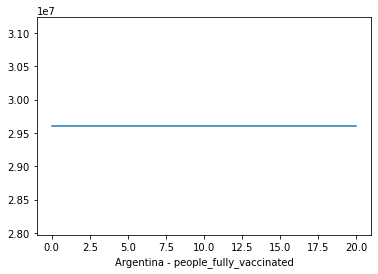

Input: [28645100. 28990917. 28990917. 29236347. 29320900. 29512760. 29710785.], Predicted: 29640938.970
Input: [28990917.   28990917.   29236347.   29320900.   29512760.   29710785.
 29640938.97], Predicted: 29640938.970
Input: [28990917.   29236347.   29320900.   29512760.   29710785.   29640938.97
 29640938.97], Predicted: 29640938.970
Input: [29236347.   29320900.   29512760.   29710785.   29640938.97 29640938.97
 29640938.97], Predicted: 29640938.970
Input: [29320900.   29512760.   29710785.   29640938.97 29640938.97 29640938.97
 29640938.97], Predicted: 29640938.970
Input: [29512760.   29710785.   29640938.97 29640938.97 29640938.97 29640938.97
 29640938.97], Predicted: 29640938.970
Input: [29710785.   29640938.97 29640938.97 29640938.97 29640938.97 29640938.97
 29640938.97], Predicted: 29640938.970
Input: [29640938.97 29640938.97 29640938.97 29640938.97 29640938.97 29640938.97
 29640938.97], Predicted: 29640938.970
Input: [29640938.97 29640938.97 29640938.97 29640938.97 29640938.

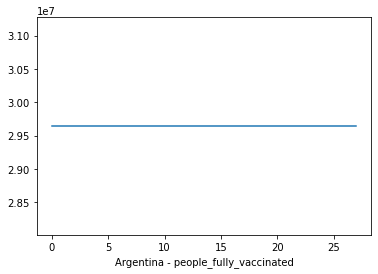

Input: [28645100. 28990917. 28990917. 29236347. 29320900. 29512760. 29710785.], Predicted: 29595791.490
Input: [28990917.   28990917.   29236347.   29320900.   29512760.   29710785.
 29595791.49], Predicted: 29595791.490
Input: [28990917.   29236347.   29320900.   29512760.   29710785.   29595791.49
 29595791.49], Predicted: 29595791.490
Input: [29236347.   29320900.   29512760.   29710785.   29595791.49 29595791.49
 29595791.49], Predicted: 29595791.490
Input: [29320900.   29512760.   29710785.   29595791.49 29595791.49 29595791.49
 29595791.49], Predicted: 29595791.490
Input: [29512760.   29710785.   29595791.49 29595791.49 29595791.49 29595791.49
 29595791.49], Predicted: 29595791.490
Input: [29710785.   29595791.49 29595791.49 29595791.49 29595791.49 29595791.49
 29595791.49], Predicted: 29595791.490
Input: [29595791.49 29595791.49 29595791.49 29595791.49 29595791.49 29595791.49
 29595791.49], Predicted: 29595791.490
Input: [29595791.49 29595791.49 29595791.49 29595791.49 29595791.

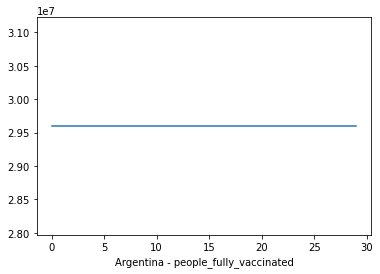

Input: [2234. 2260. 1912. 1521.  888. 1968. 2332.], Predicted: 2365.630
Input: [2260.   1912.   1521.    888.   1968.   2332.   2365.63], Predicted: 2391.500
Input: [1912.   1521.    888.   1968.   2332.   2365.63 2391.5 ], Predicted: 2325.000
Input: [1521.    888.   1968.   2332.   2365.63 2391.5  2325.  ], Predicted: 1971.050
Input: [ 888.   1968.   2332.   2365.63 2391.5  2325.   1971.05], Predicted: 1815.220
Input: [1968.   2332.   2365.63 2391.5  2325.   1971.05 1815.22], Predicted: 1938.050
Input: [2332.   2365.63 2391.5  2325.   1971.05 1815.22 1938.05], Predicted: 2085.900
[2365.63, 2391.5, 2325.0, 1971.05, 1815.22, 1938.05, 2085.9]


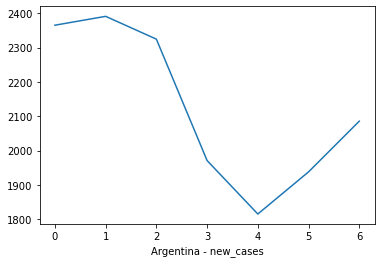

Input: [2234. 2260. 1912. 1521.  888. 1968. 2332.], Predicted: 2352.630
Input: [2260.   1912.   1521.    888.   1968.   2332.   2352.63], Predicted: 2355.930
Input: [1912.   1521.    888.   1968.   2332.   2352.63 2355.93], Predicted: 2301.370
Input: [1521.    888.   1968.   2332.   2352.63 2355.93 2301.37], Predicted: 1882.880
Input: [ 888.   1968.   2332.   2352.63 2355.93 2301.37 1882.88], Predicted: 1494.820
Input: [1968.   2332.   2352.63 2355.93 2301.37 1882.88 1494.82], Predicted: 1836.810
Input: [2332.   2352.63 2355.93 2301.37 1882.88 1494.82 1836.81], Predicted: 1974.550
Input: [2352.63 2355.93 2301.37 1882.88 1494.82 1836.81 1974.55], Predicted: 2112.160
Input: [2355.93 2301.37 1882.88 1494.82 1836.81 1974.55 2112.16], Predicted: 2122.190
Input: [2301.37 1882.88 1494.82 1836.81 1974.55 2112.16 2122.19], Predicted: 2138.950
Input: [1882.88 1494.82 1836.81 1974.55 2112.16 2122.19 2138.95], Predicted: 2197.610
Input: [1494.82 1836.81 1974.55 2112.16 2122.19 2138.95 2197.61], Pr

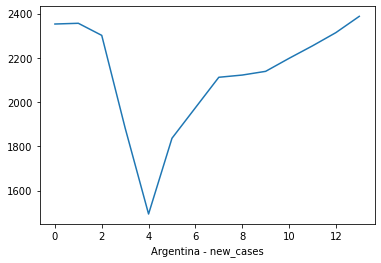

Input: [2234. 2260. 1912. 1521.  888. 1968. 2332.], Predicted: 2335.460
Input: [2260.   1912.   1521.    888.   1968.   2332.   2335.46], Predicted: 2333.990
Input: [1912.   1521.    888.   1968.   2332.   2335.46 2333.99], Predicted: 2318.200
Input: [1521.    888.   1968.   2332.   2335.46 2333.99 2318.2 ], Predicted: 1968.930
Input: [ 888.   1968.   2332.   2335.46 2333.99 2318.2  1968.93], Predicted: 1579.340
Input: [1968.   2332.   2335.46 2333.99 2318.2  1968.93 1579.34], Predicted: 1867.380
Input: [2332.   2335.46 2333.99 2318.2  1968.93 1579.34 1867.38], Predicted: 2016.730
Input: [2335.46 2333.99 2318.2  1968.93 1579.34 1867.38 2016.73], Predicted: 2065.130
Input: [2333.99 2318.2  1968.93 1579.34 1867.38 2016.73 2065.13], Predicted: 2042.700
Input: [2318.2  1968.93 1579.34 1867.38 2016.73 2065.13 2042.7 ], Predicted: 1974.380
Input: [1968.93 1579.34 1867.38 2016.73 2065.13 2042.7  1974.38], Predicted: 2055.470
Input: [1579.34 1867.38 2016.73 2065.13 2042.7  1974.38 2055.47], Pr

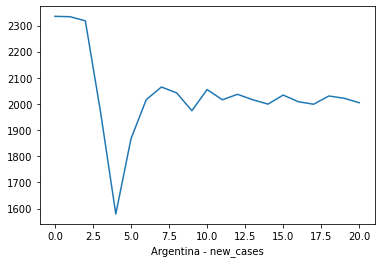

Input: [2234. 2260. 1912. 1521.  888. 1968. 2332.], Predicted: 2395.200
Input: [2260.  1912.  1521.   888.  1968.  2332.  2395.2], Predicted: 2413.910
Input: [1912.   1521.    888.   1968.   2332.   2395.2  2413.91], Predicted: 2332.270
Input: [1521.    888.   1968.   2332.   2395.2  2413.91 2332.27], Predicted: 1943.020
Input: [ 888.   1968.   2332.   2395.2  2413.91 2332.27 1943.02], Predicted: 1594.900
Input: [1968.   2332.   2395.2  2413.91 2332.27 1943.02 1594.9 ], Predicted: 1987.880
Input: [2332.   2395.2  2413.91 2332.27 1943.02 1594.9  1987.88], Predicted: 2089.090
Input: [2395.2  2413.91 2332.27 1943.02 1594.9  1987.88 2089.09], Predicted: 2067.250
Input: [2413.91 2332.27 1943.02 1594.9  1987.88 2089.09 2067.25], Predicted: 2038.860
Input: [2332.27 1943.02 1594.9  1987.88 2089.09 2067.25 2038.86], Predicted: 2081.590
Input: [1943.02 1594.9  1987.88 2089.09 2067.25 2038.86 2081.59], Predicted: 2119.340
Input: [1594.9  1987.88 2089.09 2067.25 2038.86 2081.59 2119.34], Predicted

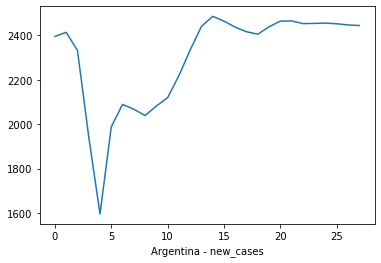

Input: [2234. 2260. 1912. 1521.  888. 1968. 2332.], Predicted: 2366.050
Input: [2260.   1912.   1521.    888.   1968.   2332.   2366.05], Predicted: 2309.510
Input: [1912.   1521.    888.   1968.   2332.   2366.05 2309.51], Predicted: 2297.500
Input: [1521.    888.   1968.   2332.   2366.05 2309.51 2297.5 ], Predicted: 1928.840
Input: [ 888.   1968.   2332.   2366.05 2309.51 2297.5  1928.84], Predicted: 1461.080
Input: [1968.   2332.   2366.05 2309.51 2297.5  1928.84 1461.08], Predicted: 1861.580
Input: [2332.   2366.05 2309.51 2297.5  1928.84 1461.08 1861.58], Predicted: 2019.330
Input: [2366.05 2309.51 2297.5  1928.84 1461.08 1861.58 2019.33], Predicted: 2036.820
Input: [2309.51 2297.5  1928.84 1461.08 1861.58 2019.33 2036.82], Predicted: 1969.320
Input: [2297.5  1928.84 1461.08 1861.58 2019.33 2036.82 1969.32], Predicted: 2028.680
Input: [1928.84 1461.08 1861.58 2019.33 2036.82 1969.32 2028.68], Predicted: 2045.960
Input: [1461.08 1861.58 2019.33 2036.82 1969.32 2028.68 2045.96], Pr

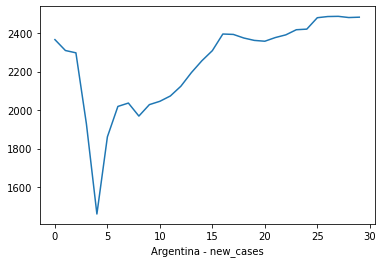

Input: [43. 22. 25. 12. 12. 25. 35.], Predicted: 36.040
Input: [22.   25.   12.   12.   25.   35.   36.04], Predicted: 28.650
Input: [25.   12.   12.   25.   35.   36.04 28.65], Predicted: 22.320
Input: [12.   12.   25.   35.   36.04 28.65 22.32], Predicted: 14.470
Input: [12.   25.   35.   36.04 28.65 22.32 14.47], Predicted: 13.030
Input: [25.   35.   36.04 28.65 22.32 14.47 13.03], Predicted: 31.280
Input: [35.   36.04 28.65 22.32 14.47 13.03 31.28], Predicted: 32.160
[36.04, 28.65, 22.32, 14.47, 13.03, 31.28, 32.16]


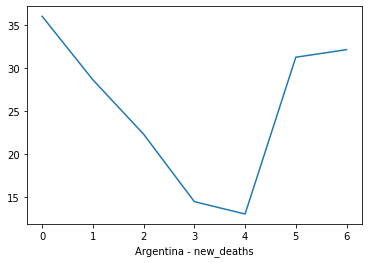

Input: [43. 22. 25. 12. 12. 25. 35.], Predicted: 36.660
Input: [22.   25.   12.   12.   25.   35.   36.66], Predicted: 27.320
Input: [25.   12.   12.   25.   35.   36.66 27.32], Predicted: 23.240
Input: [12.   12.   25.   35.   36.66 27.32 23.24], Predicted: 13.790
Input: [12.   25.   35.   36.66 27.32 23.24 13.79], Predicted: 11.420
Input: [25.   35.   36.66 27.32 23.24 13.79 11.42], Predicted: 30.350
Input: [35.   36.66 27.32 23.24 13.79 11.42 30.35], Predicted: 31.190
Input: [36.66 27.32 23.24 13.79 11.42 30.35 31.19], Predicted: 33.470
Input: [27.32 23.24 13.79 11.42 30.35 31.19 33.47], Predicted: 28.850
Input: [23.24 13.79 11.42 30.35 31.19 33.47 28.85], Predicted: 22.050
Input: [13.79 11.42 30.35 31.19 33.47 28.85 22.05], Predicted: 13.070
Input: [11.42 30.35 31.19 33.47 28.85 22.05 13.07], Predicted: 12.250
Input: [30.35 31.19 33.47 28.85 22.05 13.07 12.25], Predicted: 27.420
Input: [31.19 33.47 28.85 22.05 13.07 12.25 27.42], Predicted: 30.370
[36.66, 27.32, 23.24, 13.79, 11.42

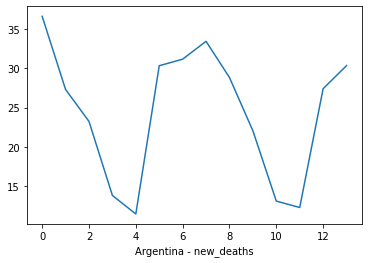

Input: [43. 22. 25. 12. 12. 25. 35.], Predicted: 34.770
Input: [22.   25.   12.   12.   25.   35.   34.77], Predicted: 28.520
Input: [25.   12.   12.   25.   35.   34.77 28.52], Predicted: 22.250
Input: [12.   12.   25.   35.   34.77 28.52 22.25], Predicted: 14.480
Input: [12.   25.   35.   34.77 28.52 22.25 14.48], Predicted: 13.400
Input: [25.   35.   34.77 28.52 22.25 14.48 13.4 ], Predicted: 28.720
Input: [35.   34.77 28.52 22.25 14.48 13.4  28.72], Predicted: 32.090
Input: [34.77 28.52 22.25 14.48 13.4  28.72 32.09], Predicted: 34.370
Input: [28.52 22.25 14.48 13.4  28.72 32.09 34.37], Predicted: 29.380
Input: [22.25 14.48 13.4  28.72 32.09 34.37 29.38], Predicted: 22.590
Input: [14.48 13.4  28.72 32.09 34.37 29.38 22.59], Predicted: 13.870
Input: [13.4  28.72 32.09 34.37 29.38 22.59 13.87], Predicted: 12.930
Input: [28.72 32.09 34.37 29.38 22.59 13.87 12.93], Predicted: 26.560
Input: [32.09 34.37 29.38 22.59 13.87 12.93 26.56], Predicted: 32.420
Input: [34.37 29.38 22.59 13.87 12

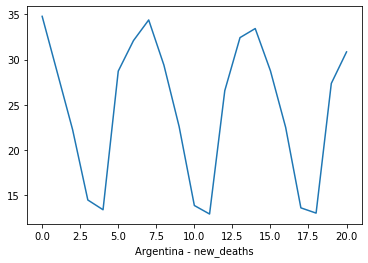

Input: [43. 22. 25. 12. 12. 25. 35.], Predicted: 36.570
Input: [22.   25.   12.   12.   25.   35.   36.57], Predicted: 28.840
Input: [25.   12.   12.   25.   35.   36.57 28.84], Predicted: 22.200
Input: [12.   12.   25.   35.   36.57 28.84 22.2 ], Predicted: 15.050
Input: [12.   25.   35.   36.57 28.84 22.2  15.05], Predicted: 14.450
Input: [25.   35.   36.57 28.84 22.2  15.05 14.45], Predicted: 29.790
Input: [35.   36.57 28.84 22.2  15.05 14.45 29.79], Predicted: 31.100
Input: [36.57 28.84 22.2  15.05 14.45 29.79 31.1 ], Predicted: 35.410
Input: [28.84 22.2  15.05 14.45 29.79 31.1  35.41], Predicted: 27.750
Input: [22.2  15.05 14.45 29.79 31.1  35.41 27.75], Predicted: 23.220
Input: [15.05 14.45 29.79 31.1  35.41 27.75 23.22], Predicted: 16.190
Input: [14.45 29.79 31.1  35.41 27.75 23.22 16.19], Predicted: 15.080
Input: [29.79 31.1  35.41 27.75 23.22 16.19 15.08], Predicted: 29.040
Input: [31.1  35.41 27.75 23.22 16.19 15.08 29.04], Predicted: 31.020
Input: [35.41 27.75 23.22 16.19 15

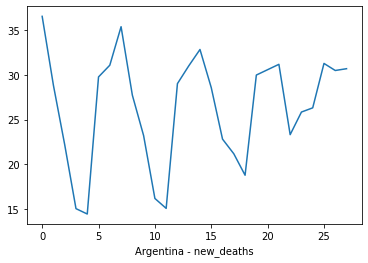

Input: [43. 22. 25. 12. 12. 25. 35.], Predicted: 34.710
Input: [22.   25.   12.   12.   25.   35.   34.71], Predicted: 29.370
Input: [25.   12.   12.   25.   35.   34.71 29.37], Predicted: 22.790
Input: [12.   12.   25.   35.   34.71 29.37 22.79], Predicted: 13.520
Input: [12.   25.   35.   34.71 29.37 22.79 13.52], Predicted: 12.930
Input: [25.   35.   34.71 29.37 22.79 13.52 12.93], Predicted: 29.690
Input: [35.   34.71 29.37 22.79 13.52 12.93 29.69], Predicted: 33.250
Input: [34.71 29.37 22.79 13.52 12.93 29.69 33.25], Predicted: 34.380
Input: [29.37 22.79 13.52 12.93 29.69 33.25 34.38], Predicted: 29.500
Input: [22.79 13.52 12.93 29.69 33.25 34.38 29.5 ], Predicted: 23.060
Input: [13.52 12.93 29.69 33.25 34.38 29.5  23.06], Predicted: 13.440
Input: [12.93 29.69 33.25 34.38 29.5  23.06 13.44], Predicted: 13.010
Input: [29.69 33.25 34.38 29.5  23.06 13.44 13.01], Predicted: 28.970
Input: [33.25 34.38 29.5  23.06 13.44 13.01 28.97], Predicted: 32.290
Input: [34.38 29.5  23.06 13.44 13

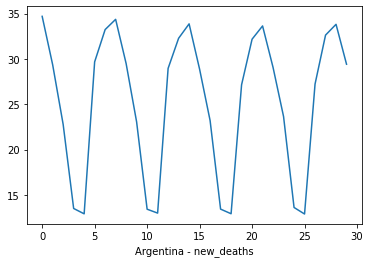

Input: [2608979. 2614480. 2619577. 2623816. 2627903. 2632782. 2632782.], Predicted: 2632037.920
Input: [2614480.   2619577.   2623816.   2627903.   2632782.   2632782.
 2632037.92], Predicted: 2632037.920
Input: [2619577.   2623816.   2627903.   2632782.   2632782.   2632037.92
 2632037.92], Predicted: 2632037.920
Input: [2623816.   2627903.   2632782.   2632782.   2632037.92 2632037.92
 2632037.92], Predicted: 2632037.920
Input: [2627903.   2632782.   2632782.   2632037.92 2632037.92 2632037.92
 2632037.92], Predicted: 2632037.920
Input: [2632782.   2632782.   2632037.92 2632037.92 2632037.92 2632037.92
 2632037.92], Predicted: 2632037.920
Input: [2632782.   2632037.92 2632037.92 2632037.92 2632037.92 2632037.92
 2632037.92], Predicted: 2632037.920
[2632037.92, 2632037.92, 2632037.92, 2632037.92, 2632037.92, 2632037.92, 2632037.92]


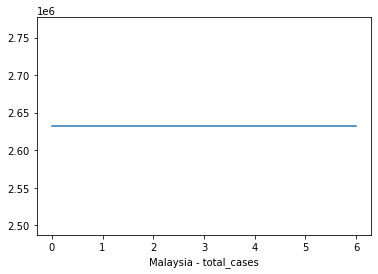

Input: [2608979. 2614480. 2619577. 2623816. 2627903. 2632782. 2632782.], Predicted: 2632236.120
Input: [2614480.   2619577.   2623816.   2627903.   2632782.   2632782.
 2632236.12], Predicted: 2632236.120
Input: [2619577.   2623816.   2627903.   2632782.   2632782.   2632236.12
 2632236.12], Predicted: 2632236.120
Input: [2623816.   2627903.   2632782.   2632782.   2632236.12 2632236.12
 2632236.12], Predicted: 2632236.120
Input: [2627903.   2632782.   2632782.   2632236.12 2632236.12 2632236.12
 2632236.12], Predicted: 2632236.120
Input: [2632782.   2632782.   2632236.12 2632236.12 2632236.12 2632236.12
 2632236.12], Predicted: 2632236.120
Input: [2632782.   2632236.12 2632236.12 2632236.12 2632236.12 2632236.12
 2632236.12], Predicted: 2632236.120
Input: [2632236.12 2632236.12 2632236.12 2632236.12 2632236.12 2632236.12
 2632236.12], Predicted: 2632236.120
Input: [2632236.12 2632236.12 2632236.12 2632236.12 2632236.12 2632236.12
 2632236.12], Predicted: 2632236.120
Input: [2632236.12

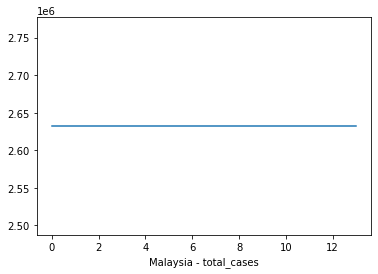

Input: [2608979. 2614480. 2619577. 2623816. 2627903. 2632782. 2632782.], Predicted: 2631623.090
Input: [2614480.   2619577.   2623816.   2627903.   2632782.   2632782.
 2631623.09], Predicted: 2631623.090
Input: [2619577.   2623816.   2627903.   2632782.   2632782.   2631623.09
 2631623.09], Predicted: 2631623.090
Input: [2623816.   2627903.   2632782.   2632782.   2631623.09 2631623.09
 2631623.09], Predicted: 2631623.090
Input: [2627903.   2632782.   2632782.   2631623.09 2631623.09 2631623.09
 2631623.09], Predicted: 2631623.090
Input: [2632782.   2632782.   2631623.09 2631623.09 2631623.09 2631623.09
 2631623.09], Predicted: 2631623.090
Input: [2632782.   2631623.09 2631623.09 2631623.09 2631623.09 2631623.09
 2631623.09], Predicted: 2631623.090
Input: [2631623.09 2631623.09 2631623.09 2631623.09 2631623.09 2631623.09
 2631623.09], Predicted: 2631623.090
Input: [2631623.09 2631623.09 2631623.09 2631623.09 2631623.09 2631623.09
 2631623.09], Predicted: 2631623.090
Input: [2631623.09

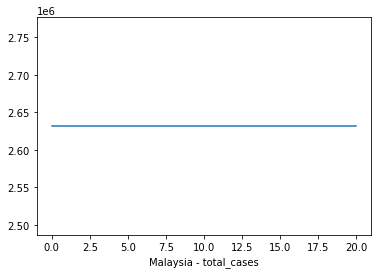

Input: [2608979. 2614480. 2619577. 2623816. 2627903. 2632782. 2632782.], Predicted: 2631571.120
Input: [2614480.   2619577.   2623816.   2627903.   2632782.   2632782.
 2631571.12], Predicted: 2631571.120
Input: [2619577.   2623816.   2627903.   2632782.   2632782.   2631571.12
 2631571.12], Predicted: 2631571.120
Input: [2623816.   2627903.   2632782.   2632782.   2631571.12 2631571.12
 2631571.12], Predicted: 2631571.120
Input: [2627903.   2632782.   2632782.   2631571.12 2631571.12 2631571.12
 2631571.12], Predicted: 2631571.120
Input: [2632782.   2632782.   2631571.12 2631571.12 2631571.12 2631571.12
 2631571.12], Predicted: 2631571.120
Input: [2632782.   2631571.12 2631571.12 2631571.12 2631571.12 2631571.12
 2631571.12], Predicted: 2631571.120
Input: [2631571.12 2631571.12 2631571.12 2631571.12 2631571.12 2631571.12
 2631571.12], Predicted: 2631571.120
Input: [2631571.12 2631571.12 2631571.12 2631571.12 2631571.12 2631571.12
 2631571.12], Predicted: 2631571.120
Input: [2631571.12

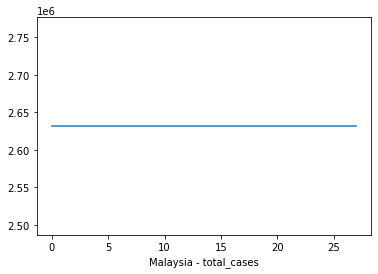

Input: [2608979. 2614480. 2619577. 2623816. 2627903. 2632782. 2632782.], Predicted: 2631762.540
Input: [2614480.   2619577.   2623816.   2627903.   2632782.   2632782.
 2631762.54], Predicted: 2631762.540
Input: [2619577.   2623816.   2627903.   2632782.   2632782.   2631762.54
 2631762.54], Predicted: 2631762.540
Input: [2623816.   2627903.   2632782.   2632782.   2631762.54 2631762.54
 2631762.54], Predicted: 2631762.540
Input: [2627903.   2632782.   2632782.   2631762.54 2631762.54 2631762.54
 2631762.54], Predicted: 2631762.540
Input: [2632782.   2632782.   2631762.54 2631762.54 2631762.54 2631762.54
 2631762.54], Predicted: 2631762.540
Input: [2632782.   2631762.54 2631762.54 2631762.54 2631762.54 2631762.54
 2631762.54], Predicted: 2631762.540
Input: [2631762.54 2631762.54 2631762.54 2631762.54 2631762.54 2631762.54
 2631762.54], Predicted: 2631762.540
Input: [2631762.54 2631762.54 2631762.54 2631762.54 2631762.54 2631762.54
 2631762.54], Predicted: 2631762.540
Input: [2631762.54

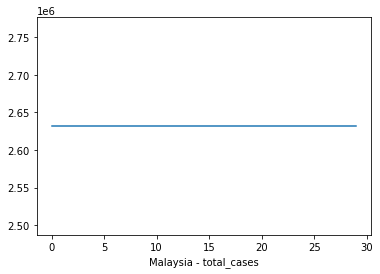

Input: [30195. 30240. 30280. 30309. 30370. 30425. 30425.], Predicted: 30408.550
Input: [30240.   30280.   30309.   30370.   30425.   30425.   30408.55], Predicted: 30408.550
Input: [30280.   30309.   30370.   30425.   30425.   30408.55 30408.55], Predicted: 30408.550
Input: [30309.   30370.   30425.   30425.   30408.55 30408.55 30408.55], Predicted: 30408.550
Input: [30370.   30425.   30425.   30408.55 30408.55 30408.55 30408.55], Predicted: 30408.550
Input: [30425.   30425.   30408.55 30408.55 30408.55 30408.55 30408.55], Predicted: 30408.550
Input: [30425.   30408.55 30408.55 30408.55 30408.55 30408.55 30408.55], Predicted: 30408.550
[30408.55, 30408.55, 30408.55, 30408.55, 30408.55, 30408.55, 30408.55]


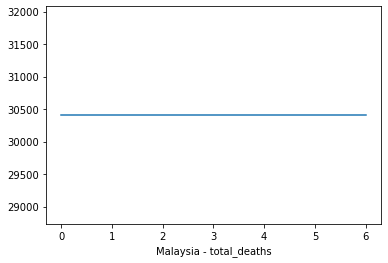

Input: [30195. 30240. 30280. 30309. 30370. 30425. 30425.], Predicted: 30410.990
Input: [30240.   30280.   30309.   30370.   30425.   30425.   30410.99], Predicted: 30410.990
Input: [30280.   30309.   30370.   30425.   30425.   30410.99 30410.99], Predicted: 30410.990
Input: [30309.   30370.   30425.   30425.   30410.99 30410.99 30410.99], Predicted: 30410.990
Input: [30370.   30425.   30425.   30410.99 30410.99 30410.99 30410.99], Predicted: 30410.990
Input: [30425.   30425.   30410.99 30410.99 30410.99 30410.99 30410.99], Predicted: 30410.990
Input: [30425.   30410.99 30410.99 30410.99 30410.99 30410.99 30410.99], Predicted: 30410.990
Input: [30410.99 30410.99 30410.99 30410.99 30410.99 30410.99 30410.99], Predicted: 30410.990
Input: [30410.99 30410.99 30410.99 30410.99 30410.99 30410.99 30410.99], Predicted: 30410.990
Input: [30410.99 30410.99 30410.99 30410.99 30410.99 30410.99 30410.99], Predicted: 30410.990
Input: [30410.99 30410.99 30410.99 30410.99 30410.99 30410.99 30410.99], P

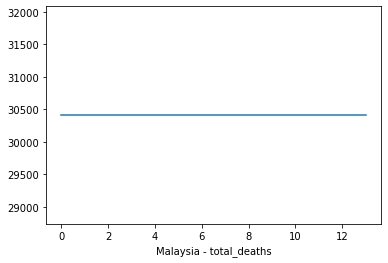

Input: [30195. 30240. 30280. 30309. 30370. 30425. 30425.], Predicted: 30411.950
Input: [30240.   30280.   30309.   30370.   30425.   30425.   30411.95], Predicted: 30411.950
Input: [30280.   30309.   30370.   30425.   30425.   30411.95 30411.95], Predicted: 30411.950
Input: [30309.   30370.   30425.   30425.   30411.95 30411.95 30411.95], Predicted: 30411.950
Input: [30370.   30425.   30425.   30411.95 30411.95 30411.95 30411.95], Predicted: 30411.950
Input: [30425.   30425.   30411.95 30411.95 30411.95 30411.95 30411.95], Predicted: 30411.950
Input: [30425.   30411.95 30411.95 30411.95 30411.95 30411.95 30411.95], Predicted: 30411.950
Input: [30411.95 30411.95 30411.95 30411.95 30411.95 30411.95 30411.95], Predicted: 30411.950
Input: [30411.95 30411.95 30411.95 30411.95 30411.95 30411.95 30411.95], Predicted: 30411.950
Input: [30411.95 30411.95 30411.95 30411.95 30411.95 30411.95 30411.95], Predicted: 30411.950
Input: [30411.95 30411.95 30411.95 30411.95 30411.95 30411.95 30411.95], P

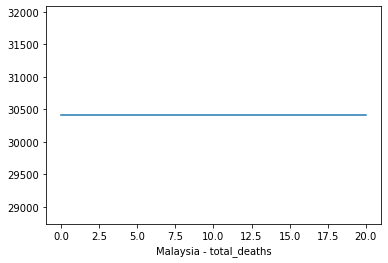

Input: [30195. 30240. 30280. 30309. 30370. 30425. 30425.], Predicted: 30413.270
Input: [30240.   30280.   30309.   30370.   30425.   30425.   30413.27], Predicted: 30413.270
Input: [30280.   30309.   30370.   30425.   30425.   30413.27 30413.27], Predicted: 30413.270
Input: [30309.   30370.   30425.   30425.   30413.27 30413.27 30413.27], Predicted: 30413.270
Input: [30370.   30425.   30425.   30413.27 30413.27 30413.27 30413.27], Predicted: 30413.270
Input: [30425.   30425.   30413.27 30413.27 30413.27 30413.27 30413.27], Predicted: 30413.270
Input: [30425.   30413.27 30413.27 30413.27 30413.27 30413.27 30413.27], Predicted: 30413.270
Input: [30413.27 30413.27 30413.27 30413.27 30413.27 30413.27 30413.27], Predicted: 30413.270
Input: [30413.27 30413.27 30413.27 30413.27 30413.27 30413.27 30413.27], Predicted: 30413.270
Input: [30413.27 30413.27 30413.27 30413.27 30413.27 30413.27 30413.27], Predicted: 30413.270
Input: [30413.27 30413.27 30413.27 30413.27 30413.27 30413.27 30413.27], P

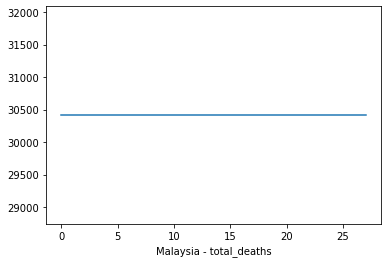

Input: [30195. 30240. 30280. 30309. 30370. 30425. 30425.], Predicted: 30418.220
Input: [30240.   30280.   30309.   30370.   30425.   30425.   30418.22], Predicted: 30418.220
Input: [30280.   30309.   30370.   30425.   30425.   30418.22 30418.22], Predicted: 30418.220
Input: [30309.   30370.   30425.   30425.   30418.22 30418.22 30418.22], Predicted: 30418.220
Input: [30370.   30425.   30425.   30418.22 30418.22 30418.22 30418.22], Predicted: 30418.220
Input: [30425.   30425.   30418.22 30418.22 30418.22 30418.22 30418.22], Predicted: 30418.220
Input: [30425.   30418.22 30418.22 30418.22 30418.22 30418.22 30418.22], Predicted: 30418.220
Input: [30418.22 30418.22 30418.22 30418.22 30418.22 30418.22 30418.22], Predicted: 30418.220
Input: [30418.22 30418.22 30418.22 30418.22 30418.22 30418.22 30418.22], Predicted: 30418.220
Input: [30418.22 30418.22 30418.22 30418.22 30418.22 30418.22 30418.22], Predicted: 30418.220
Input: [30418.22 30418.22 30418.22 30418.22 30418.22 30418.22 30418.22], P

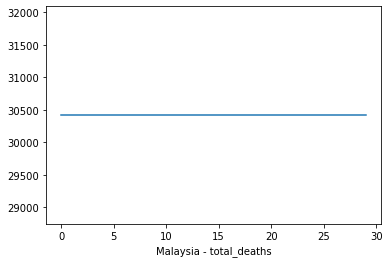

Input: [52986553. 53099599. 53154053. 53196067. 53304824. 53438354. 53438354.], Predicted: 53406952.900
Input: [53099599.  53154053.  53196067.  53304824.  53438354.  53438354.
 53406952.9], Predicted: 53406952.900
Input: [53154053.  53196067.  53304824.  53438354.  53438354.  53406952.9
 53406952.9], Predicted: 53406952.900
Input: [53196067.  53304824.  53438354.  53438354.  53406952.9 53406952.9
 53406952.9], Predicted: 53406952.900
Input: [53304824.  53438354.  53438354.  53406952.9 53406952.9 53406952.9
 53406952.9], Predicted: 53406952.900
Input: [53438354.  53438354.  53406952.9 53406952.9 53406952.9 53406952.9
 53406952.9], Predicted: 53406952.900
Input: [53438354.  53406952.9 53406952.9 53406952.9 53406952.9 53406952.9
 53406952.9], Predicted: 53406952.900
[53406952.9, 53406952.9, 53406952.9, 53406952.9, 53406952.9, 53406952.9, 53406952.9]


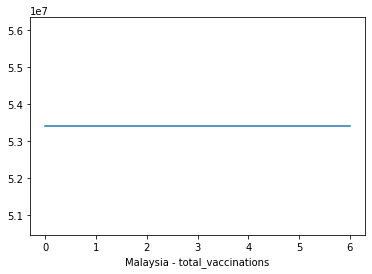

Input: [52986553. 53099599. 53154053. 53196067. 53304824. 53438354. 53438354.], Predicted: 53409326.690
Input: [53099599.   53154053.   53196067.   53304824.   53438354.   53438354.
 53409326.69], Predicted: 53409326.690
Input: [53154053.   53196067.   53304824.   53438354.   53438354.   53409326.69
 53409326.69], Predicted: 53409326.690
Input: [53196067.   53304824.   53438354.   53438354.   53409326.69 53409326.69
 53409326.69], Predicted: 53409326.690
Input: [53304824.   53438354.   53438354.   53409326.69 53409326.69 53409326.69
 53409326.69], Predicted: 53409326.690
Input: [53438354.   53438354.   53409326.69 53409326.69 53409326.69 53409326.69
 53409326.69], Predicted: 53409326.690
Input: [53438354.   53409326.69 53409326.69 53409326.69 53409326.69 53409326.69
 53409326.69], Predicted: 53409326.690
Input: [53409326.69 53409326.69 53409326.69 53409326.69 53409326.69 53409326.69
 53409326.69], Predicted: 53409326.690
Input: [53409326.69 53409326.69 53409326.69 53409326.69 53409326.

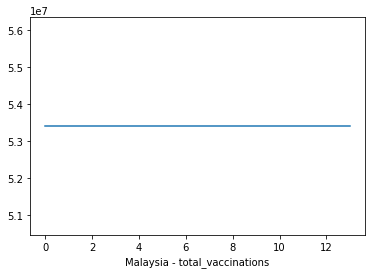

Input: [52986553. 53099599. 53154053. 53196067. 53304824. 53438354. 53438354.], Predicted: 53423741.020
Input: [53099599.   53154053.   53196067.   53304824.   53438354.   53438354.
 53423741.02], Predicted: 53423741.020
Input: [53154053.   53196067.   53304824.   53438354.   53438354.   53423741.02
 53423741.02], Predicted: 53423741.020
Input: [53196067.   53304824.   53438354.   53438354.   53423741.02 53423741.02
 53423741.02], Predicted: 53423741.020
Input: [53304824.   53438354.   53438354.   53423741.02 53423741.02 53423741.02
 53423741.02], Predicted: 53423741.020
Input: [53438354.   53438354.   53423741.02 53423741.02 53423741.02 53423741.02
 53423741.02], Predicted: 53423741.020
Input: [53438354.   53423741.02 53423741.02 53423741.02 53423741.02 53423741.02
 53423741.02], Predicted: 53423741.020
Input: [53423741.02 53423741.02 53423741.02 53423741.02 53423741.02 53423741.02
 53423741.02], Predicted: 53423741.020
Input: [53423741.02 53423741.02 53423741.02 53423741.02 53423741.

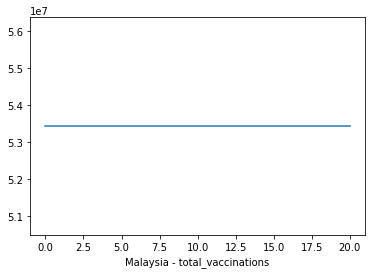

Input: [52986553. 53099599. 53154053. 53196067. 53304824. 53438354. 53438354.], Predicted: 53417312.250
Input: [53099599.   53154053.   53196067.   53304824.   53438354.   53438354.
 53417312.25], Predicted: 53417312.250
Input: [53154053.   53196067.   53304824.   53438354.   53438354.   53417312.25
 53417312.25], Predicted: 53417312.250
Input: [53196067.   53304824.   53438354.   53438354.   53417312.25 53417312.25
 53417312.25], Predicted: 53417312.250
Input: [53304824.   53438354.   53438354.   53417312.25 53417312.25 53417312.25
 53417312.25], Predicted: 53417312.250
Input: [53438354.   53438354.   53417312.25 53417312.25 53417312.25 53417312.25
 53417312.25], Predicted: 53417312.250
Input: [53438354.   53417312.25 53417312.25 53417312.25 53417312.25 53417312.25
 53417312.25], Predicted: 53417312.250
Input: [53417312.25 53417312.25 53417312.25 53417312.25 53417312.25 53417312.25
 53417312.25], Predicted: 53417312.250
Input: [53417312.25 53417312.25 53417312.25 53417312.25 53417312.

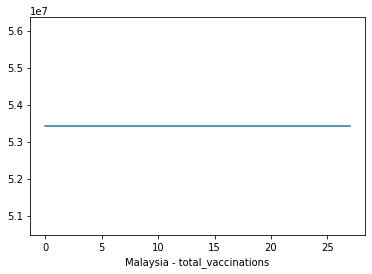

Input: [52986553. 53099599. 53154053. 53196067. 53304824. 53438354. 53438354.], Predicted: 53419735.120
Input: [53099599.   53154053.   53196067.   53304824.   53438354.   53438354.
 53419735.12], Predicted: 53419735.120
Input: [53154053.   53196067.   53304824.   53438354.   53438354.   53419735.12
 53419735.12], Predicted: 53419735.120
Input: [53196067.   53304824.   53438354.   53438354.   53419735.12 53419735.12
 53419735.12], Predicted: 53419735.120
Input: [53304824.   53438354.   53438354.   53419735.12 53419735.12 53419735.12
 53419735.12], Predicted: 53419735.120
Input: [53438354.   53438354.   53419735.12 53419735.12 53419735.12 53419735.12
 53419735.12], Predicted: 53419735.120
Input: [53438354.   53419735.12 53419735.12 53419735.12 53419735.12 53419735.12
 53419735.12], Predicted: 53419735.120
Input: [53419735.12 53419735.12 53419735.12 53419735.12 53419735.12 53419735.12
 53419735.12], Predicted: 53419735.120
Input: [53419735.12 53419735.12 53419735.12 53419735.12 53419735.

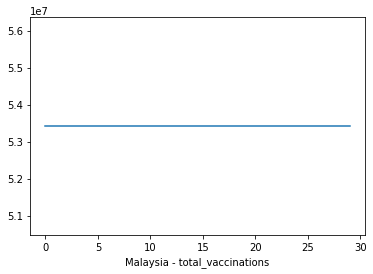

Input: [25357422. 25363873. 25368668. 25371908. 25378601. 25386777. 25386777.], Predicted: 25385742.450
Input: [25363873.   25368668.   25371908.   25378601.   25386777.   25386777.
 25385742.45], Predicted: 25385742.450
Input: [25368668.   25371908.   25378601.   25386777.   25386777.   25385742.45
 25385742.45], Predicted: 25385742.450
Input: [25371908.   25378601.   25386777.   25386777.   25385742.45 25385742.45
 25385742.45], Predicted: 25385742.450
Input: [25378601.   25386777.   25386777.   25385742.45 25385742.45 25385742.45
 25385742.45], Predicted: 25385742.450
Input: [25386777.   25386777.   25385742.45 25385742.45 25385742.45 25385742.45
 25385742.45], Predicted: 25385742.450
Input: [25386777.   25385742.45 25385742.45 25385742.45 25385742.45 25385742.45
 25385742.45], Predicted: 25385742.450
[25385742.45, 25385742.45, 25385742.45, 25385742.45, 25385742.45, 25385742.45, 25385742.45]


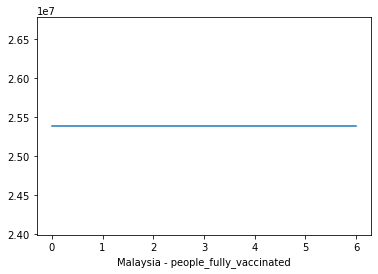

Input: [25357422. 25363873. 25368668. 25371908. 25378601. 25386777. 25386777.], Predicted: 25385794.550
Input: [25363873.   25368668.   25371908.   25378601.   25386777.   25386777.
 25385794.55], Predicted: 25385794.550
Input: [25368668.   25371908.   25378601.   25386777.   25386777.   25385794.55
 25385794.55], Predicted: 25385794.550
Input: [25371908.   25378601.   25386777.   25386777.   25385794.55 25385794.55
 25385794.55], Predicted: 25385794.550
Input: [25378601.   25386777.   25386777.   25385794.55 25385794.55 25385794.55
 25385794.55], Predicted: 25385794.550
Input: [25386777.   25386777.   25385794.55 25385794.55 25385794.55 25385794.55
 25385794.55], Predicted: 25385794.550
Input: [25386777.   25385794.55 25385794.55 25385794.55 25385794.55 25385794.55
 25385794.55], Predicted: 25385794.550
Input: [25385794.55 25385794.55 25385794.55 25385794.55 25385794.55 25385794.55
 25385794.55], Predicted: 25385794.550
Input: [25385794.55 25385794.55 25385794.55 25385794.55 25385794.

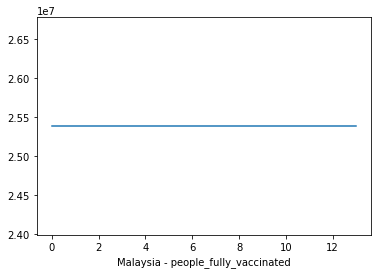

Input: [25357422. 25363873. 25368668. 25371908. 25378601. 25386777. 25386777.], Predicted: 25385252.260
Input: [25363873.   25368668.   25371908.   25378601.   25386777.   25386777.
 25385252.26], Predicted: 25385252.260
Input: [25368668.   25371908.   25378601.   25386777.   25386777.   25385252.26
 25385252.26], Predicted: 25385252.260
Input: [25371908.   25378601.   25386777.   25386777.   25385252.26 25385252.26
 25385252.26], Predicted: 25385252.260
Input: [25378601.   25386777.   25386777.   25385252.26 25385252.26 25385252.26
 25385252.26], Predicted: 25385252.260
Input: [25386777.   25386777.   25385252.26 25385252.26 25385252.26 25385252.26
 25385252.26], Predicted: 25385252.260
Input: [25386777.   25385252.26 25385252.26 25385252.26 25385252.26 25385252.26
 25385252.26], Predicted: 25385252.260
Input: [25385252.26 25385252.26 25385252.26 25385252.26 25385252.26 25385252.26
 25385252.26], Predicted: 25385252.260
Input: [25385252.26 25385252.26 25385252.26 25385252.26 25385252.

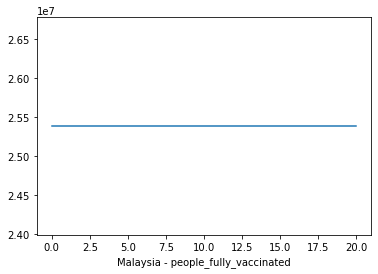

Input: [25357422. 25363873. 25368668. 25371908. 25378601. 25386777. 25386777.], Predicted: 25385364.640
Input: [25363873.   25368668.   25371908.   25378601.   25386777.   25386777.
 25385364.64], Predicted: 25385364.640
Input: [25368668.   25371908.   25378601.   25386777.   25386777.   25385364.64
 25385364.64], Predicted: 25385364.640
Input: [25371908.   25378601.   25386777.   25386777.   25385364.64 25385364.64
 25385364.64], Predicted: 25385364.640
Input: [25378601.   25386777.   25386777.   25385364.64 25385364.64 25385364.64
 25385364.64], Predicted: 25385364.640
Input: [25386777.   25386777.   25385364.64 25385364.64 25385364.64 25385364.64
 25385364.64], Predicted: 25385364.640
Input: [25386777.   25385364.64 25385364.64 25385364.64 25385364.64 25385364.64
 25385364.64], Predicted: 25385364.640
Input: [25385364.64 25385364.64 25385364.64 25385364.64 25385364.64 25385364.64
 25385364.64], Predicted: 25385364.640
Input: [25385364.64 25385364.64 25385364.64 25385364.64 25385364.

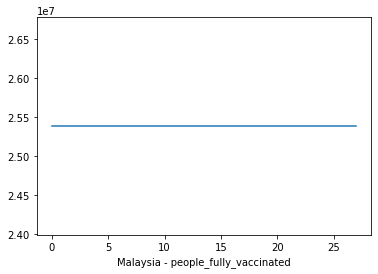

Input: [25357422. 25363873. 25368668. 25371908. 25378601. 25386777. 25386777.], Predicted: 25383984.150
Input: [25363873.   25368668.   25371908.   25378601.   25386777.   25386777.
 25383984.15], Predicted: 25383984.150
Input: [25368668.   25371908.   25378601.   25386777.   25386777.   25383984.15
 25383984.15], Predicted: 25383984.150
Input: [25371908.   25378601.   25386777.   25386777.   25383984.15 25383984.15
 25383984.15], Predicted: 25383984.150
Input: [25378601.   25386777.   25386777.   25383984.15 25383984.15 25383984.15
 25383984.15], Predicted: 25383984.150
Input: [25386777.   25386777.   25383984.15 25383984.15 25383984.15 25383984.15
 25383984.15], Predicted: 25383984.150
Input: [25386777.   25383984.15 25383984.15 25383984.15 25383984.15 25383984.15
 25383984.15], Predicted: 25383984.150
Input: [25383984.15 25383984.15 25383984.15 25383984.15 25383984.15 25383984.15
 25383984.15], Predicted: 25383984.150
Input: [25383984.15 25383984.15 25383984.15 25383984.15 25383984.

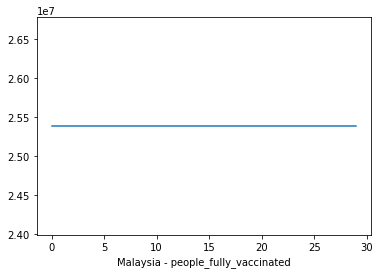

Input: [6144. 5501. 5097. 4239. 4087. 4879.    0.], Predicted: 2611.370
Input: [5501.   5097.   4239.   4087.   4879.      0.   2611.37], Predicted: 2182.550
Input: [5097.   4239.   4087.   4879.      0.   2611.37 2182.55], Predicted: 2569.630
Input: [4239.   4087.   4879.      0.   2611.37 2182.55 2569.63], Predicted: 2927.020
Input: [4087.   4879.      0.   2611.37 2182.55 2569.63 2927.02], Predicted: 2616.940
Input: [4879.      0.   2611.37 2182.55 2569.63 2927.02 2616.94], Predicted: 2852.060
Input: [   0.   2611.37 2182.55 2569.63 2927.02 2616.94 2852.06], Predicted: 2088.170
[2611.37, 2182.55, 2569.63, 2927.02, 2616.94, 2852.06, 2088.17]


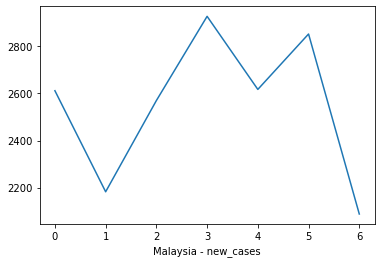

Input: [6144. 5501. 5097. 4239. 4087. 4879.    0.], Predicted: 2868.120
Input: [5501.   5097.   4239.   4087.   4879.      0.   2868.12], Predicted: 2172.890
Input: [5097.   4239.   4087.   4879.      0.   2868.12 2172.89], Predicted: 2672.100
Input: [4239.   4087.   4879.      0.   2868.12 2172.89 2672.1 ], Predicted: 2792.550
Input: [4087.   4879.      0.   2868.12 2172.89 2672.1  2792.55], Predicted: 2475.360
Input: [4879.      0.   2868.12 2172.89 2672.1  2792.55 2475.36], Predicted: 2716.130
Input: [   0.   2868.12 2172.89 2672.1  2792.55 2475.36 2716.13], Predicted: 2225.000
Input: [2868.12 2172.89 2672.1  2792.55 2475.36 2716.13 2225.  ], Predicted: 2627.490
Input: [2172.89 2672.1  2792.55 2475.36 2716.13 2225.   2627.49], Predicted: 2889.710
Input: [2672.1  2792.55 2475.36 2716.13 2225.   2627.49 2889.71], Predicted: 2723.590
Input: [2792.55 2475.36 2716.13 2225.   2627.49 2889.71 2723.59], Predicted: 2957.320
Input: [2475.36 2716.13 2225.   2627.49 2889.71 2723.59 2957.32], Pr

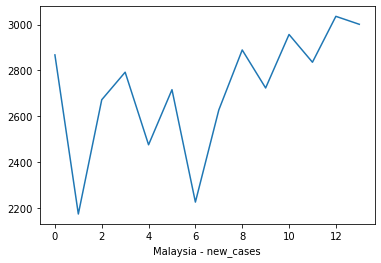

Input: [6144. 5501. 5097. 4239. 4087. 4879.    0.], Predicted: 2626.290
Input: [5501.   5097.   4239.   4087.   4879.      0.   2626.29], Predicted: 2426.740
Input: [5097.   4239.   4087.   4879.      0.   2626.29 2426.74], Predicted: 2707.840
Input: [4239.   4087.   4879.      0.   2626.29 2426.74 2707.84], Predicted: 2920.990
Input: [4087.   4879.      0.   2626.29 2426.74 2707.84 2920.99], Predicted: 2777.240
Input: [4879.      0.   2626.29 2426.74 2707.84 2920.99 2777.24], Predicted: 2836.260
Input: [   0.   2626.29 2426.74 2707.84 2920.99 2777.24 2836.26], Predicted: 2309.710
Input: [2626.29 2426.74 2707.84 2920.99 2777.24 2836.26 2309.71], Predicted: 2651.870
Input: [2426.74 2707.84 2920.99 2777.24 2836.26 2309.71 2651.87], Predicted: 2917.510
Input: [2707.84 2920.99 2777.24 2836.26 2309.71 2651.87 2917.51], Predicted: 2850.340
Input: [2920.99 2777.24 2836.26 2309.71 2651.87 2917.51 2850.34], Predicted: 3090.120
Input: [2777.24 2836.26 2309.71 2651.87 2917.51 2850.34 3090.12], Pr

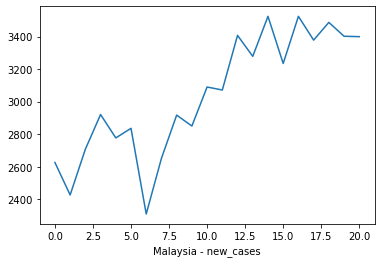

Input: [6144. 5501. 5097. 4239. 4087. 4879.    0.], Predicted: 2911.970
Input: [5501.   5097.   4239.   4087.   4879.      0.   2911.97], Predicted: 2302.760
Input: [5097.   4239.   4087.   4879.      0.   2911.97 2302.76], Predicted: 2780.310
Input: [4239.   4087.   4879.      0.   2911.97 2302.76 2780.31], Predicted: 2953.250
Input: [4087.   4879.      0.   2911.97 2302.76 2780.31 2953.25], Predicted: 2709.670
Input: [4879.      0.   2911.97 2302.76 2780.31 2953.25 2709.67], Predicted: 2893.720
Input: [   0.   2911.97 2302.76 2780.31 2953.25 2709.67 2893.72], Predicted: 2240.800
Input: [2911.97 2302.76 2780.31 2953.25 2709.67 2893.72 2240.8 ], Predicted: 2797.050
Input: [2302.76 2780.31 2953.25 2709.67 2893.72 2240.8  2797.05], Predicted: 2910.970
Input: [2780.31 2953.25 2709.67 2893.72 2240.8  2797.05 2910.97], Predicted: 2923.340
Input: [2953.25 2709.67 2893.72 2240.8  2797.05 2910.97 2923.34], Predicted: 3111.560
Input: [2709.67 2893.72 2240.8  2797.05 2910.97 2923.34 3111.56], Pr

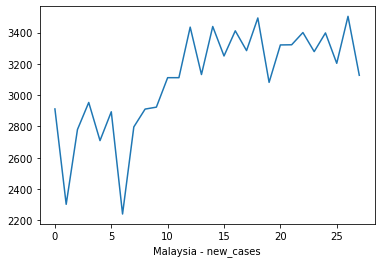

Input: [6144. 5501. 5097. 4239. 4087. 4879.    0.], Predicted: 2499.500
Input: [5501.  5097.  4239.  4087.  4879.     0.  2499.5], Predicted: 2366.110
Input: [5097.   4239.   4087.   4879.      0.   2499.5  2366.11], Predicted: 2772.310
Input: [4239.   4087.   4879.      0.   2499.5  2366.11 2772.31], Predicted: 2891.690
Input: [4087.   4879.      0.   2499.5  2366.11 2772.31 2891.69], Predicted: 2706.600
Input: [4879.      0.   2499.5  2366.11 2772.31 2891.69 2706.6 ], Predicted: 2736.500
Input: [   0.   2499.5  2366.11 2772.31 2891.69 2706.6  2736.5 ], Predicted: 2181.750
Input: [2499.5  2366.11 2772.31 2891.69 2706.6  2736.5  2181.75], Predicted: 2701.980
Input: [2366.11 2772.31 2891.69 2706.6  2736.5  2181.75 2701.98], Predicted: 2945.940
Input: [2772.31 2891.69 2706.6  2736.5  2181.75 2701.98 2945.94], Predicted: 2794.280
Input: [2891.69 2706.6  2736.5  2181.75 2701.98 2945.94 2794.28], Predicted: 3109.560
Input: [2706.6  2736.5  2181.75 2701.98 2945.94 2794.28 3109.56], Predicted

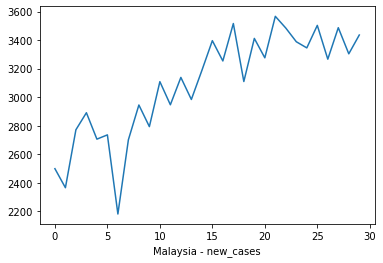

Input: [48. 45. 40. 29. 61. 55.  0.], Predicted: 47.080
Input: [45.   40.   29.   61.   55.    0.   47.08], Predicted: 43.150
Input: [40.   29.   61.   55.    0.   47.08 43.15], Predicted: 32.690
Input: [29.   61.   55.    0.   47.08 43.15 32.69], Predicted: 40.620
Input: [61.   55.    0.   47.08 43.15 32.69 40.62], Predicted: 51.290
Input: [55.    0.   47.08 43.15 32.69 40.62 51.29], Predicted: 48.010
Input: [ 0.   47.08 43.15 32.69 40.62 51.29 48.01], Predicted: 48.150
[47.08, 43.15, 32.69, 40.62, 51.29, 48.01, 48.15]


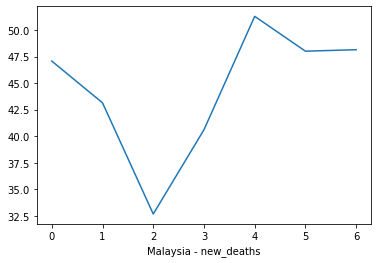

Input: [48. 45. 40. 29. 61. 55.  0.], Predicted: 45.120
Input: [45.   40.   29.   61.   55.    0.   45.12], Predicted: 43.120
Input: [40.   29.   61.   55.    0.   45.12 43.12], Predicted: 29.130
Input: [29.   61.   55.    0.   45.12 43.12 29.13], Predicted: 39.340
Input: [61.   55.    0.   45.12 43.12 29.13 39.34], Predicted: 53.180
Input: [55.    0.   45.12 43.12 29.13 39.34 53.18], Predicted: 27.820
Input: [ 0.   45.12 43.12 29.13 39.34 53.18 27.82], Predicted: 41.180
Input: [45.12 43.12 29.13 39.34 53.18 27.82 41.18], Predicted: 40.490
Input: [43.12 29.13 39.34 53.18 27.82 41.18 40.49], Predicted: 29.380
Input: [29.13 39.34 53.18 27.82 41.18 40.49 29.38], Predicted: 45.810
Input: [39.34 53.18 27.82 41.18 40.49 29.38 45.81], Predicted: 44.180
Input: [53.18 27.82 41.18 40.49 29.38 45.81 44.18], Predicted: 28.270
Input: [27.82 41.18 40.49 29.38 45.81 44.18 28.27], Predicted: 46.380
Input: [41.18 40.49 29.38 45.81 44.18 28.27 46.38], Predicted: 47.930
[45.12, 43.12, 29.13, 39.34, 53.18

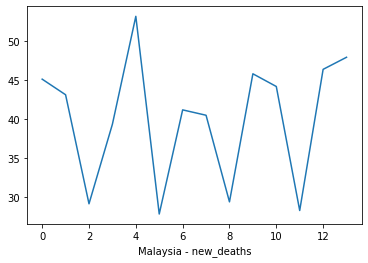

Input: [48. 45. 40. 29. 61. 55.  0.], Predicted: 44.480
Input: [45.   40.   29.   61.   55.    0.   44.48], Predicted: 41.550
Input: [40.   29.   61.   55.    0.   44.48 41.55], Predicted: 31.060
Input: [29.   61.   55.    0.   44.48 41.55 31.06], Predicted: 37.640
Input: [61.   55.    0.   44.48 41.55 31.06 37.64], Predicted: 53.860
Input: [55.    0.   44.48 41.55 31.06 37.64 53.86], Predicted: 34.240
Input: [ 0.   44.48 41.55 31.06 37.64 53.86 34.24], Predicted: 41.150
Input: [44.48 41.55 31.06 37.64 53.86 34.24 41.15], Predicted: 42.220
Input: [41.55 31.06 37.64 53.86 34.24 41.15 42.22], Predicted: 45.820
Input: [31.06 37.64 53.86 34.24 41.15 42.22 45.82], Predicted: 49.170
Input: [37.64 53.86 34.24 41.15 42.22 45.82 49.17], Predicted: 45.040
Input: [53.86 34.24 41.15 42.22 45.82 49.17 45.04], Predicted: 52.870
Input: [34.24 41.15 42.22 45.82 49.17 45.04 52.87], Predicted: 48.880
Input: [41.15 42.22 45.82 49.17 45.04 52.87 48.88], Predicted: 52.480
Input: [42.22 45.82 49.17 45.04 52

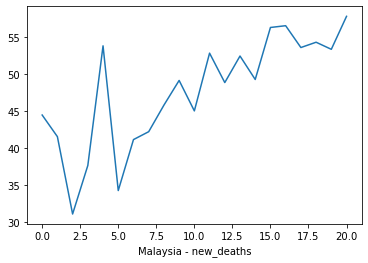

Input: [48. 45. 40. 29. 61. 55.  0.], Predicted: 41.990
Input: [45.   40.   29.   61.   55.    0.   41.99], Predicted: 40.640
Input: [40.   29.   61.   55.    0.   41.99 40.64], Predicted: 28.280
Input: [29.   61.   55.    0.   41.99 40.64 28.28], Predicted: 37.740
Input: [61.   55.    0.   41.99 40.64 28.28 37.74], Predicted: 49.390
Input: [55.    0.   41.99 40.64 28.28 37.74 49.39], Predicted: 29.050
Input: [ 0.   41.99 40.64 28.28 37.74 49.39 29.05], Predicted: 42.120
Input: [41.99 40.64 28.28 37.74 49.39 29.05 42.12], Predicted: 43.380
Input: [40.64 28.28 37.74 49.39 29.05 42.12 43.38], Predicted: 28.260
Input: [28.28 37.74 49.39 29.05 42.12 43.38 28.26], Predicted: 46.010
Input: [37.74 49.39 29.05 42.12 43.38 28.26 46.01], Predicted: 47.380
Input: [49.39 29.05 42.12 43.38 28.26 46.01 47.38], Predicted: 30.470
Input: [29.05 42.12 43.38 28.26 46.01 47.38 30.47], Predicted: 47.980
Input: [42.12 43.38 28.26 46.01 47.38 30.47 47.98], Predicted: 47.590
Input: [43.38 28.26 46.01 47.38 30

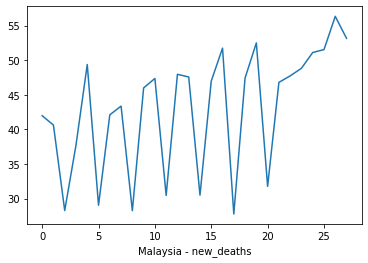

Input: [48. 45. 40. 29. 61. 55.  0.], Predicted: 42.990
Input: [45.   40.   29.   61.   55.    0.   42.99], Predicted: 41.670
Input: [40.   29.   61.   55.    0.   42.99 41.67], Predicted: 30.870
Input: [29.   61.   55.    0.   42.99 41.67 30.87], Predicted: 39.130
Input: [61.   55.    0.   42.99 41.67 30.87 39.13], Predicted: 51.320
Input: [55.    0.   42.99 41.67 30.87 39.13 51.32], Predicted: 29.800
Input: [ 0.   42.99 41.67 30.87 39.13 51.32 29.8 ], Predicted: 42.470
Input: [42.99 41.67 30.87 39.13 51.32 29.8  42.47], Predicted: 45.220
Input: [41.67 30.87 39.13 51.32 29.8  42.47 45.22], Predicted: 29.440
Input: [30.87 39.13 51.32 29.8  42.47 45.22 29.44], Predicted: 45.820
Input: [39.13 51.32 29.8  42.47 45.22 29.44 45.82], Predicted: 45.880
Input: [51.32 29.8  42.47 45.22 29.44 45.82 45.88], Predicted: 34.260
Input: [29.8  42.47 45.22 29.44 45.82 45.88 34.26], Predicted: 47.350
Input: [42.47 45.22 29.44 45.82 45.88 34.26 47.35], Predicted: 47.640
Input: [45.22 29.44 45.82 45.88 34

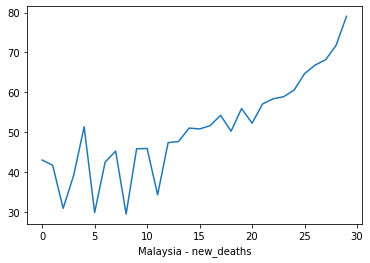

In [46]:
days = [7,14,21,28,30]
for country in set(required_countries):
    for target in ['total_cases','total_deaths','total_vaccinations','people_fully_vaccinated','new_cases','new_deaths']:
        for day in days:
            future_randomforrest(country, target, day)
            




Input: [38827244. 38852891. 38876619. 38895253. 38908293. 38922384. 38941153.], Predicted: 38930684.250
Input: [38852891.   38876619.   38895253.   38908293.   38922384.   38941153.
 38930684.25], Predicted: 38930684.250
Input: [38876619.   38895253.   38908293.   38922384.   38941153.   38930684.25
 38930684.25], Predicted: 38930684.250
Input: [38895253.   38908293.   38922384.   38941153.   38930684.25 38930684.25
 38930684.25], Predicted: 38930684.250
Input: [38908293.   38922384.   38941153.   38930684.25 38930684.25 38930684.25
 38930684.25], Predicted: 38930684.250
Input: [38922384.   38941153.   38930684.25 38930684.25 38930684.25 38930684.25
 38930684.25], Predicted: 38930684.250
Input: [38941153.   38930684.25 38930684.25 38930684.25 38930684.25 38930684.25
 38930684.25], Predicted: 38930684.250
[38930684.25, 38930684.25, 38930684.25, 38930684.25, 38930684.25, 38930684.25, 38930684.25]


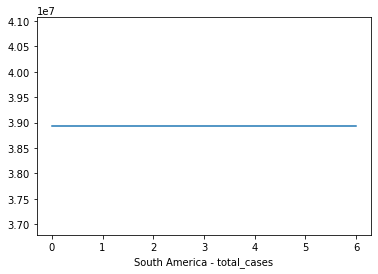

Input: [38827244. 38852891. 38876619. 38895253. 38908293. 38922384. 38941153.], Predicted: 38929730.040
Input: [38852891.   38876619.   38895253.   38908293.   38922384.   38941153.
 38929730.04], Predicted: 38929730.040
Input: [38876619.   38895253.   38908293.   38922384.   38941153.   38929730.04
 38929730.04], Predicted: 38929730.040
Input: [38895253.   38908293.   38922384.   38941153.   38929730.04 38929730.04
 38929730.04], Predicted: 38929730.040
Input: [38908293.   38922384.   38941153.   38929730.04 38929730.04 38929730.04
 38929730.04], Predicted: 38929730.040
Input: [38922384.   38941153.   38929730.04 38929730.04 38929730.04 38929730.04
 38929730.04], Predicted: 38929730.040
Input: [38941153.   38929730.04 38929730.04 38929730.04 38929730.04 38929730.04
 38929730.04], Predicted: 38929730.040
Input: [38929730.04 38929730.04 38929730.04 38929730.04 38929730.04 38929730.04
 38929730.04], Predicted: 38929730.040
Input: [38929730.04 38929730.04 38929730.04 38929730.04 38929730.

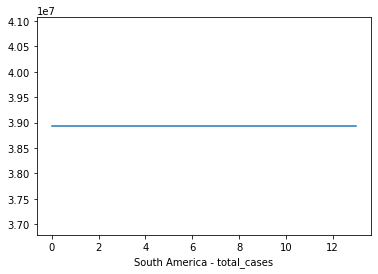

Input: [38827244. 38852891. 38876619. 38895253. 38908293. 38922384. 38941153.], Predicted: 38931304.080
Input: [38852891.   38876619.   38895253.   38908293.   38922384.   38941153.
 38931304.08], Predicted: 38931304.080
Input: [38876619.   38895253.   38908293.   38922384.   38941153.   38931304.08
 38931304.08], Predicted: 38931304.080
Input: [38895253.   38908293.   38922384.   38941153.   38931304.08 38931304.08
 38931304.08], Predicted: 38931304.080
Input: [38908293.   38922384.   38941153.   38931304.08 38931304.08 38931304.08
 38931304.08], Predicted: 38931304.080
Input: [38922384.   38941153.   38931304.08 38931304.08 38931304.08 38931304.08
 38931304.08], Predicted: 38931304.080
Input: [38941153.   38931304.08 38931304.08 38931304.08 38931304.08 38931304.08
 38931304.08], Predicted: 38931304.080
Input: [38931304.08 38931304.08 38931304.08 38931304.08 38931304.08 38931304.08
 38931304.08], Predicted: 38931304.080
Input: [38931304.08 38931304.08 38931304.08 38931304.08 38931304.

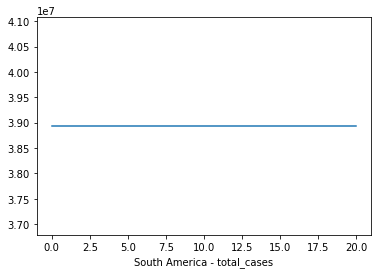

Input: [38827244. 38852891. 38876619. 38895253. 38908293. 38922384. 38941153.], Predicted: 38932137.320
Input: [38852891.   38876619.   38895253.   38908293.   38922384.   38941153.
 38932137.32], Predicted: 38932137.320
Input: [38876619.   38895253.   38908293.   38922384.   38941153.   38932137.32
 38932137.32], Predicted: 38932137.320
Input: [38895253.   38908293.   38922384.   38941153.   38932137.32 38932137.32
 38932137.32], Predicted: 38932137.320
Input: [38908293.   38922384.   38941153.   38932137.32 38932137.32 38932137.32
 38932137.32], Predicted: 38932137.320
Input: [38922384.   38941153.   38932137.32 38932137.32 38932137.32 38932137.32
 38932137.32], Predicted: 38932137.320
Input: [38941153.   38932137.32 38932137.32 38932137.32 38932137.32 38932137.32
 38932137.32], Predicted: 38932137.320
Input: [38932137.32 38932137.32 38932137.32 38932137.32 38932137.32 38932137.32
 38932137.32], Predicted: 38932137.320
Input: [38932137.32 38932137.32 38932137.32 38932137.32 38932137.

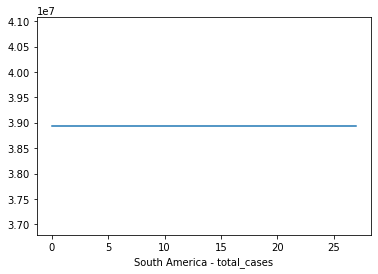

Input: [38827244. 38852891. 38876619. 38895253. 38908293. 38922384. 38941153.], Predicted: 38927930.140
Input: [38852891.   38876619.   38895253.   38908293.   38922384.   38941153.
 38927930.14], Predicted: 38927930.140
Input: [38876619.   38895253.   38908293.   38922384.   38941153.   38927930.14
 38927930.14], Predicted: 38927930.140
Input: [38895253.   38908293.   38922384.   38941153.   38927930.14 38927930.14
 38927930.14], Predicted: 38927930.140
Input: [38908293.   38922384.   38941153.   38927930.14 38927930.14 38927930.14
 38927930.14], Predicted: 38927930.140
Input: [38922384.   38941153.   38927930.14 38927930.14 38927930.14 38927930.14
 38927930.14], Predicted: 38927930.140
Input: [38941153.   38927930.14 38927930.14 38927930.14 38927930.14 38927930.14
 38927930.14], Predicted: 38927930.140
Input: [38927930.14 38927930.14 38927930.14 38927930.14 38927930.14 38927930.14
 38927930.14], Predicted: 38927930.140
Input: [38927930.14 38927930.14 38927930.14 38927930.14 38927930.

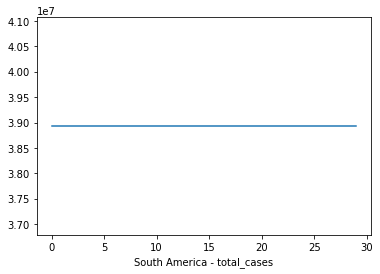

Input: [1179112. 1179611. 1180103. 1180488. 1180741. 1181171. 1181649.], Predicted: 1181340.590
Input: [1179611.   1180103.   1180488.   1180741.   1181171.   1181649.
 1181340.59], Predicted: 1181340.590
Input: [1180103.   1180488.   1180741.   1181171.   1181649.   1181340.59
 1181340.59], Predicted: 1181340.590
Input: [1180488.   1180741.   1181171.   1181649.   1181340.59 1181340.59
 1181340.59], Predicted: 1181340.590
Input: [1180741.   1181171.   1181649.   1181340.59 1181340.59 1181340.59
 1181340.59], Predicted: 1181340.590
Input: [1181171.   1181649.   1181340.59 1181340.59 1181340.59 1181340.59
 1181340.59], Predicted: 1181340.590
Input: [1181649.   1181340.59 1181340.59 1181340.59 1181340.59 1181340.59
 1181340.59], Predicted: 1181340.590
[1181340.59, 1181340.59, 1181340.59, 1181340.59, 1181340.59, 1181340.59, 1181340.59]


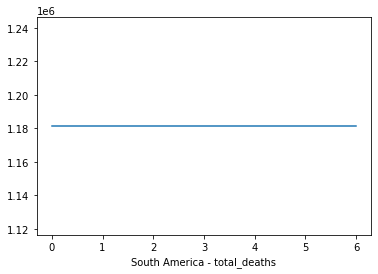

Input: [1179112. 1179611. 1180103. 1180488. 1180741. 1181171. 1181649.], Predicted: 1181353.680
Input: [1179611.   1180103.   1180488.   1180741.   1181171.   1181649.
 1181353.68], Predicted: 1181353.680
Input: [1180103.   1180488.   1180741.   1181171.   1181649.   1181353.68
 1181353.68], Predicted: 1181353.680
Input: [1180488.   1180741.   1181171.   1181649.   1181353.68 1181353.68
 1181353.68], Predicted: 1181353.680
Input: [1180741.   1181171.   1181649.   1181353.68 1181353.68 1181353.68
 1181353.68], Predicted: 1181353.680
Input: [1181171.   1181649.   1181353.68 1181353.68 1181353.68 1181353.68
 1181353.68], Predicted: 1181353.680
Input: [1181649.   1181353.68 1181353.68 1181353.68 1181353.68 1181353.68
 1181353.68], Predicted: 1181353.680
Input: [1181353.68 1181353.68 1181353.68 1181353.68 1181353.68 1181353.68
 1181353.68], Predicted: 1181353.680
Input: [1181353.68 1181353.68 1181353.68 1181353.68 1181353.68 1181353.68
 1181353.68], Predicted: 1181353.680
Input: [1181353.68

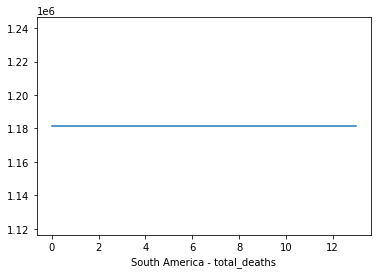

Input: [1179112. 1179611. 1180103. 1180488. 1180741. 1181171. 1181649.], Predicted: 1181435.190
Input: [1179611.   1180103.   1180488.   1180741.   1181171.   1181649.
 1181435.19], Predicted: 1181435.190
Input: [1180103.   1180488.   1180741.   1181171.   1181649.   1181435.19
 1181435.19], Predicted: 1181435.190
Input: [1180488.   1180741.   1181171.   1181649.   1181435.19 1181435.19
 1181435.19], Predicted: 1181435.190
Input: [1180741.   1181171.   1181649.   1181435.19 1181435.19 1181435.19
 1181435.19], Predicted: 1181435.190
Input: [1181171.   1181649.   1181435.19 1181435.19 1181435.19 1181435.19
 1181435.19], Predicted: 1181435.190
Input: [1181649.   1181435.19 1181435.19 1181435.19 1181435.19 1181435.19
 1181435.19], Predicted: 1181435.190
Input: [1181435.19 1181435.19 1181435.19 1181435.19 1181435.19 1181435.19
 1181435.19], Predicted: 1181435.190
Input: [1181435.19 1181435.19 1181435.19 1181435.19 1181435.19 1181435.19
 1181435.19], Predicted: 1181435.190
Input: [1181435.19

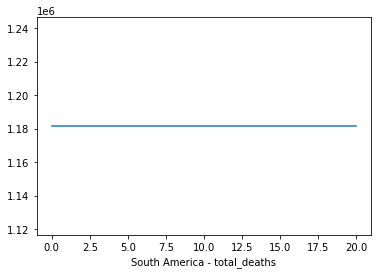

Input: [1179112. 1179611. 1180103. 1180488. 1180741. 1181171. 1181649.], Predicted: 1181395.410
Input: [1179611.   1180103.   1180488.   1180741.   1181171.   1181649.
 1181395.41], Predicted: 1181395.410
Input: [1180103.   1180488.   1180741.   1181171.   1181649.   1181395.41
 1181395.41], Predicted: 1181395.410
Input: [1180488.   1180741.   1181171.   1181649.   1181395.41 1181395.41
 1181395.41], Predicted: 1181395.410
Input: [1180741.   1181171.   1181649.   1181395.41 1181395.41 1181395.41
 1181395.41], Predicted: 1181395.410
Input: [1181171.   1181649.   1181395.41 1181395.41 1181395.41 1181395.41
 1181395.41], Predicted: 1181395.410
Input: [1181649.   1181395.41 1181395.41 1181395.41 1181395.41 1181395.41
 1181395.41], Predicted: 1181395.410
Input: [1181395.41 1181395.41 1181395.41 1181395.41 1181395.41 1181395.41
 1181395.41], Predicted: 1181395.410
Input: [1181395.41 1181395.41 1181395.41 1181395.41 1181395.41 1181395.41
 1181395.41], Predicted: 1181395.410
Input: [1181395.41

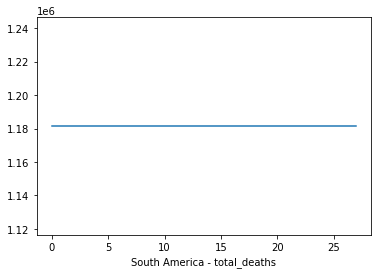

Input: [1179112. 1179611. 1180103. 1180488. 1180741. 1181171. 1181649.], Predicted: 1181273.760
Input: [1179611.   1180103.   1180488.   1180741.   1181171.   1181649.
 1181273.76], Predicted: 1181273.760
Input: [1180103.   1180488.   1180741.   1181171.   1181649.   1181273.76
 1181273.76], Predicted: 1181273.760
Input: [1180488.   1180741.   1181171.   1181649.   1181273.76 1181273.76
 1181273.76], Predicted: 1181273.760
Input: [1180741.   1181171.   1181649.   1181273.76 1181273.76 1181273.76
 1181273.76], Predicted: 1181273.760
Input: [1181171.   1181649.   1181273.76 1181273.76 1181273.76 1181273.76
 1181273.76], Predicted: 1181273.760
Input: [1181649.   1181273.76 1181273.76 1181273.76 1181273.76 1181273.76
 1181273.76], Predicted: 1181273.760
Input: [1181273.76 1181273.76 1181273.76 1181273.76 1181273.76 1181273.76
 1181273.76], Predicted: 1181273.760
Input: [1181273.76 1181273.76 1181273.76 1181273.76 1181273.76 1181273.76
 1181273.76], Predicted: 1181273.760
Input: [1181273.76

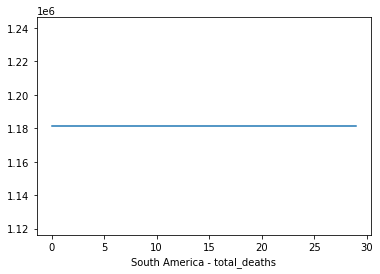

Input: [5.76352271e+08 5.78206466e+08 5.80608385e+08 5.82174369e+08
 5.82892890e+08 5.87442815e+08 5.89483867e+08], Predicted: 588036786.050
Input: [5.78206466e+08 5.80608385e+08 5.82174369e+08 5.82892890e+08
 5.87442815e+08 5.89483867e+08 5.88036786e+08], Predicted: 588036786.050
Input: [5.80608385e+08 5.82174369e+08 5.82892890e+08 5.87442815e+08
 5.89483867e+08 5.88036786e+08 5.88036786e+08], Predicted: 588036786.050
Input: [5.82174369e+08 5.82892890e+08 5.87442815e+08 5.89483867e+08
 5.88036786e+08 5.88036786e+08 5.88036786e+08], Predicted: 588036786.050
Input: [5.82892890e+08 5.87442815e+08 5.89483867e+08 5.88036786e+08
 5.88036786e+08 5.88036786e+08 5.88036786e+08], Predicted: 588036786.050
Input: [5.87442815e+08 5.89483867e+08 5.88036786e+08 5.88036786e+08
 5.88036786e+08 5.88036786e+08 5.88036786e+08], Predicted: 588036786.050
Input: [5.89483867e+08 5.88036786e+08 5.88036786e+08 5.88036786e+08
 5.88036786e+08 5.88036786e+08 5.88036786e+08], Predicted: 588036786.050
[588036786.05

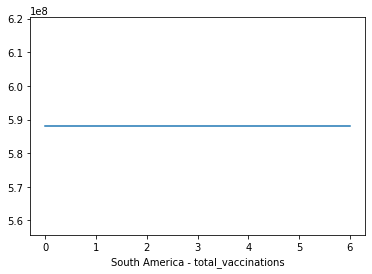

Input: [5.76352271e+08 5.78206466e+08 5.80608385e+08 5.82174369e+08
 5.82892890e+08 5.87442815e+08 5.89483867e+08], Predicted: 587753881.560
Input: [5.78206466e+08 5.80608385e+08 5.82174369e+08 5.82892890e+08
 5.87442815e+08 5.89483867e+08 5.87753882e+08], Predicted: 587753881.560
Input: [5.80608385e+08 5.82174369e+08 5.82892890e+08 5.87442815e+08
 5.89483867e+08 5.87753882e+08 5.87753882e+08], Predicted: 587753881.560
Input: [5.82174369e+08 5.82892890e+08 5.87442815e+08 5.89483867e+08
 5.87753882e+08 5.87753882e+08 5.87753882e+08], Predicted: 587753881.560
Input: [5.82892890e+08 5.87442815e+08 5.89483867e+08 5.87753882e+08
 5.87753882e+08 5.87753882e+08 5.87753882e+08], Predicted: 587753881.560
Input: [5.87442815e+08 5.89483867e+08 5.87753882e+08 5.87753882e+08
 5.87753882e+08 5.87753882e+08 5.87753882e+08], Predicted: 587753881.560
Input: [5.89483867e+08 5.87753882e+08 5.87753882e+08 5.87753882e+08
 5.87753882e+08 5.87753882e+08 5.87753882e+08], Predicted: 587753881.560
Input: [5.877

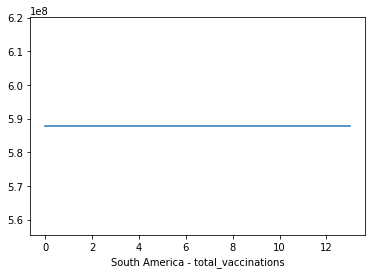

Input: [5.76352271e+08 5.78206466e+08 5.80608385e+08 5.82174369e+08
 5.82892890e+08 5.87442815e+08 5.89483867e+08], Predicted: 588297628.880
Input: [5.78206466e+08 5.80608385e+08 5.82174369e+08 5.82892890e+08
 5.87442815e+08 5.89483867e+08 5.88297629e+08], Predicted: 588297628.880
Input: [5.80608385e+08 5.82174369e+08 5.82892890e+08 5.87442815e+08
 5.89483867e+08 5.88297629e+08 5.88297629e+08], Predicted: 588297628.880
Input: [5.82174369e+08 5.82892890e+08 5.87442815e+08 5.89483867e+08
 5.88297629e+08 5.88297629e+08 5.88297629e+08], Predicted: 588297628.880
Input: [5.82892890e+08 5.87442815e+08 5.89483867e+08 5.88297629e+08
 5.88297629e+08 5.88297629e+08 5.88297629e+08], Predicted: 588297628.880
Input: [5.87442815e+08 5.89483867e+08 5.88297629e+08 5.88297629e+08
 5.88297629e+08 5.88297629e+08 5.88297629e+08], Predicted: 588297628.880
Input: [5.89483867e+08 5.88297629e+08 5.88297629e+08 5.88297629e+08
 5.88297629e+08 5.88297629e+08 5.88297629e+08], Predicted: 588297628.880
Input: [5.882

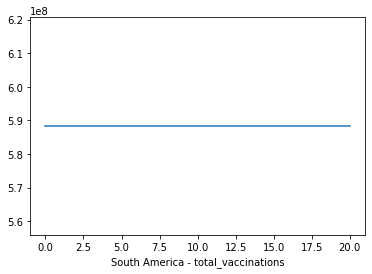

Input: [5.76352271e+08 5.78206466e+08 5.80608385e+08 5.82174369e+08
 5.82892890e+08 5.87442815e+08 5.89483867e+08], Predicted: 587813192.460
Input: [5.78206466e+08 5.80608385e+08 5.82174369e+08 5.82892890e+08
 5.87442815e+08 5.89483867e+08 5.87813192e+08], Predicted: 587813192.460
Input: [5.80608385e+08 5.82174369e+08 5.82892890e+08 5.87442815e+08
 5.89483867e+08 5.87813192e+08 5.87813192e+08], Predicted: 587813192.460
Input: [5.82174369e+08 5.82892890e+08 5.87442815e+08 5.89483867e+08
 5.87813192e+08 5.87813192e+08 5.87813192e+08], Predicted: 587813192.460
Input: [5.82892890e+08 5.87442815e+08 5.89483867e+08 5.87813192e+08
 5.87813192e+08 5.87813192e+08 5.87813192e+08], Predicted: 587813192.460
Input: [5.87442815e+08 5.89483867e+08 5.87813192e+08 5.87813192e+08
 5.87813192e+08 5.87813192e+08 5.87813192e+08], Predicted: 587813192.460
Input: [5.89483867e+08 5.87813192e+08 5.87813192e+08 5.87813192e+08
 5.87813192e+08 5.87813192e+08 5.87813192e+08], Predicted: 587813192.460
Input: [5.878

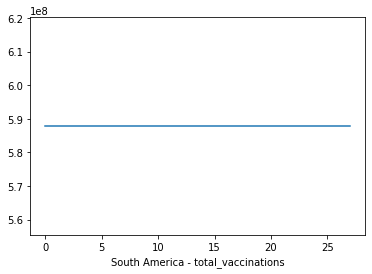

Input: [5.76352271e+08 5.78206466e+08 5.80608385e+08 5.82174369e+08
 5.82892890e+08 5.87442815e+08 5.89483867e+08], Predicted: 587845949.600
Input: [5.78206466e+08 5.80608385e+08 5.82174369e+08 5.82892890e+08
 5.87442815e+08 5.89483867e+08 5.87845950e+08], Predicted: 587845949.600
Input: [5.80608385e+08 5.82174369e+08 5.82892890e+08 5.87442815e+08
 5.89483867e+08 5.87845950e+08 5.87845950e+08], Predicted: 587845949.600
Input: [5.82174369e+08 5.82892890e+08 5.87442815e+08 5.89483867e+08
 5.87845950e+08 5.87845950e+08 5.87845950e+08], Predicted: 587845949.600
Input: [5.82892890e+08 5.87442815e+08 5.89483867e+08 5.87845950e+08
 5.87845950e+08 5.87845950e+08 5.87845950e+08], Predicted: 587845949.600
Input: [5.87442815e+08 5.89483867e+08 5.87845950e+08 5.87845950e+08
 5.87845950e+08 5.87845950e+08 5.87845950e+08], Predicted: 587845949.600
Input: [5.89483867e+08 5.87845950e+08 5.87845950e+08 5.87845950e+08
 5.87845950e+08 5.87845950e+08 5.87845950e+08], Predicted: 587845949.600
Input: [5.878

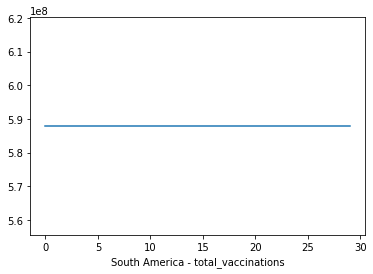

Input: [2.47404091e+08 2.48395678e+08 2.49482760e+08 2.50225642e+08
 2.50597968e+08 2.51892045e+08 2.52973080e+08], Predicted: 252268881.630
Input: [2.48395678e+08 2.49482760e+08 2.50225642e+08 2.50597968e+08
 2.51892045e+08 2.52973080e+08 2.52268882e+08], Predicted: 252268881.630
Input: [2.49482760e+08 2.50225642e+08 2.50597968e+08 2.51892045e+08
 2.52973080e+08 2.52268882e+08 2.52268882e+08], Predicted: 252268881.630
Input: [2.50225642e+08 2.50597968e+08 2.51892045e+08 2.52973080e+08
 2.52268882e+08 2.52268882e+08 2.52268882e+08], Predicted: 252268881.630
Input: [2.50597968e+08 2.51892045e+08 2.52973080e+08 2.52268882e+08
 2.52268882e+08 2.52268882e+08 2.52268882e+08], Predicted: 252268881.630
Input: [2.51892045e+08 2.52973080e+08 2.52268882e+08 2.52268882e+08
 2.52268882e+08 2.52268882e+08 2.52268882e+08], Predicted: 252268881.630
Input: [2.52973080e+08 2.52268882e+08 2.52268882e+08 2.52268882e+08
 2.52268882e+08 2.52268882e+08 2.52268882e+08], Predicted: 252268881.630
[252268881.63

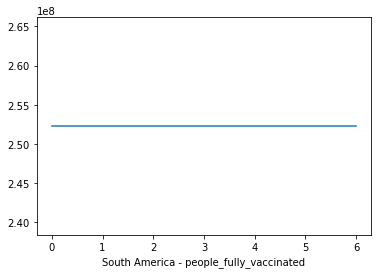

Input: [2.47404091e+08 2.48395678e+08 2.49482760e+08 2.50225642e+08
 2.50597968e+08 2.51892045e+08 2.52973080e+08], Predicted: 252427233.540
Input: [2.48395678e+08 2.49482760e+08 2.50225642e+08 2.50597968e+08
 2.51892045e+08 2.52973080e+08 2.52427234e+08], Predicted: 252427233.540
Input: [2.49482760e+08 2.50225642e+08 2.50597968e+08 2.51892045e+08
 2.52973080e+08 2.52427234e+08 2.52427234e+08], Predicted: 252427233.540
Input: [2.50225642e+08 2.50597968e+08 2.51892045e+08 2.52973080e+08
 2.52427234e+08 2.52427234e+08 2.52427234e+08], Predicted: 252427233.540
Input: [2.50597968e+08 2.51892045e+08 2.52973080e+08 2.52427234e+08
 2.52427234e+08 2.52427234e+08 2.52427234e+08], Predicted: 252427233.540
Input: [2.51892045e+08 2.52973080e+08 2.52427234e+08 2.52427234e+08
 2.52427234e+08 2.52427234e+08 2.52427234e+08], Predicted: 252427233.540
Input: [2.52973080e+08 2.52427234e+08 2.52427234e+08 2.52427234e+08
 2.52427234e+08 2.52427234e+08 2.52427234e+08], Predicted: 252427233.540
Input: [2.524

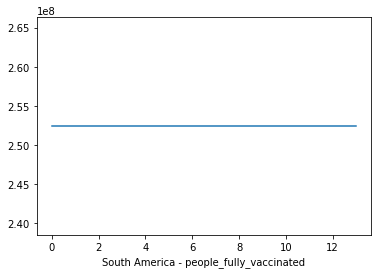

Input: [2.47404091e+08 2.48395678e+08 2.49482760e+08 2.50225642e+08
 2.50597968e+08 2.51892045e+08 2.52973080e+08], Predicted: 252388936.440
Input: [2.48395678e+08 2.49482760e+08 2.50225642e+08 2.50597968e+08
 2.51892045e+08 2.52973080e+08 2.52388936e+08], Predicted: 252388936.440
Input: [2.49482760e+08 2.50225642e+08 2.50597968e+08 2.51892045e+08
 2.52973080e+08 2.52388936e+08 2.52388936e+08], Predicted: 252388936.440
Input: [2.50225642e+08 2.50597968e+08 2.51892045e+08 2.52973080e+08
 2.52388936e+08 2.52388936e+08 2.52388936e+08], Predicted: 252388936.440
Input: [2.50597968e+08 2.51892045e+08 2.52973080e+08 2.52388936e+08
 2.52388936e+08 2.52388936e+08 2.52388936e+08], Predicted: 252388936.440
Input: [2.51892045e+08 2.52973080e+08 2.52388936e+08 2.52388936e+08
 2.52388936e+08 2.52388936e+08 2.52388936e+08], Predicted: 252388936.440
Input: [2.52973080e+08 2.52388936e+08 2.52388936e+08 2.52388936e+08
 2.52388936e+08 2.52388936e+08 2.52388936e+08], Predicted: 252388936.440
Input: [2.523

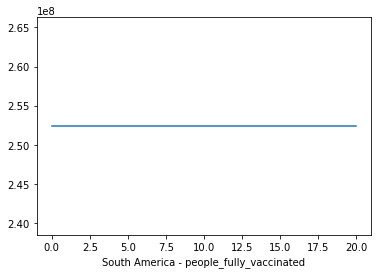

Input: [2.47404091e+08 2.48395678e+08 2.49482760e+08 2.50225642e+08
 2.50597968e+08 2.51892045e+08 2.52973080e+08], Predicted: 252384333.870
Input: [2.48395678e+08 2.49482760e+08 2.50225642e+08 2.50597968e+08
 2.51892045e+08 2.52973080e+08 2.52384334e+08], Predicted: 252384333.870
Input: [2.49482760e+08 2.50225642e+08 2.50597968e+08 2.51892045e+08
 2.52973080e+08 2.52384334e+08 2.52384334e+08], Predicted: 252384333.870
Input: [2.50225642e+08 2.50597968e+08 2.51892045e+08 2.52973080e+08
 2.52384334e+08 2.52384334e+08 2.52384334e+08], Predicted: 252384333.870
Input: [2.50597968e+08 2.51892045e+08 2.52973080e+08 2.52384334e+08
 2.52384334e+08 2.52384334e+08 2.52384334e+08], Predicted: 252384333.870
Input: [2.51892045e+08 2.52973080e+08 2.52384334e+08 2.52384334e+08
 2.52384334e+08 2.52384334e+08 2.52384334e+08], Predicted: 252384333.870
Input: [2.52973080e+08 2.52384334e+08 2.52384334e+08 2.52384334e+08
 2.52384334e+08 2.52384334e+08 2.52384334e+08], Predicted: 252384333.870
Input: [2.523

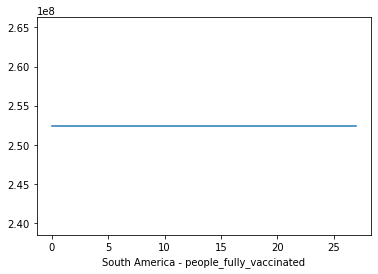

Input: [2.47404091e+08 2.48395678e+08 2.49482760e+08 2.50225642e+08
 2.50597968e+08 2.51892045e+08 2.52973080e+08], Predicted: 252244153.420
Input: [2.48395678e+08 2.49482760e+08 2.50225642e+08 2.50597968e+08
 2.51892045e+08 2.52973080e+08 2.52244153e+08], Predicted: 252244153.420
Input: [2.49482760e+08 2.50225642e+08 2.50597968e+08 2.51892045e+08
 2.52973080e+08 2.52244153e+08 2.52244153e+08], Predicted: 252244153.420
Input: [2.50225642e+08 2.50597968e+08 2.51892045e+08 2.52973080e+08
 2.52244153e+08 2.52244153e+08 2.52244153e+08], Predicted: 252244153.420
Input: [2.50597968e+08 2.51892045e+08 2.52973080e+08 2.52244153e+08
 2.52244153e+08 2.52244153e+08 2.52244153e+08], Predicted: 252244153.420
Input: [2.51892045e+08 2.52973080e+08 2.52244153e+08 2.52244153e+08
 2.52244153e+08 2.52244153e+08 2.52244153e+08], Predicted: 252244153.420
Input: [2.52973080e+08 2.52244153e+08 2.52244153e+08 2.52244153e+08
 2.52244153e+08 2.52244153e+08 2.52244153e+08], Predicted: 252244153.420
Input: [2.522

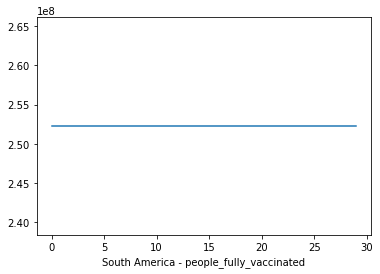

Input: [22523. 25647. 23728. 18634. 13040. 14091. 18769.], Predicted: 22894.370
Input: [25647.   23728.   18634.   13040.   14091.   18769.   22894.37], Predicted: 23235.510
Input: [23728.   18634.   13040.   14091.   18769.   22894.37 23235.51], Predicted: 23396.020
Input: [18634.   13040.   14091.   18769.   22894.37 23235.51 23396.02], Predicted: 19390.490
Input: [13040.   14091.   18769.   22894.37 23235.51 23396.02 19390.49], Predicted: 14043.460
Input: [14091.   18769.   22894.37 23235.51 23396.02 19390.49 14043.46], Predicted: 12979.530
Input: [18769.   22894.37 23235.51 23396.02 19390.49 14043.46 12979.53], Predicted: 18377.540
[22894.37, 23235.51, 23396.02, 19390.49, 14043.46, 12979.53, 18377.54]


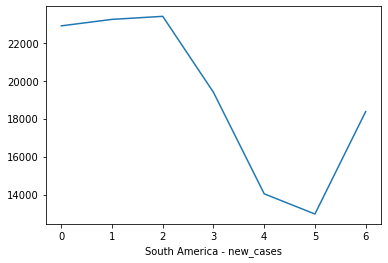

Input: [22523. 25647. 23728. 18634. 13040. 14091. 18769.], Predicted: 23727.730
Input: [25647.   23728.   18634.   13040.   14091.   18769.   23727.73], Predicted: 23286.340
Input: [23728.   18634.   13040.   14091.   18769.   23727.73 23286.34], Predicted: 23406.770
Input: [18634.   13040.   14091.   18769.   23727.73 23286.34 23406.77], Predicted: 19245.850
Input: [13040.   14091.   18769.   23727.73 23286.34 23406.77 19245.85], Predicted: 13874.600
Input: [14091.   18769.   23727.73 23286.34 23406.77 19245.85 13874.6 ], Predicted: 13133.520
Input: [18769.   23727.73 23286.34 23406.77 19245.85 13874.6  13133.52], Predicted: 17444.110
Input: [23727.73 23286.34 23406.77 19245.85 13874.6  13133.52 17444.11], Predicted: 23839.360
Input: [23286.34 23406.77 19245.85 13874.6  13133.52 17444.11 23839.36], Predicted: 24281.450
Input: [23406.77 19245.85 13874.6  13133.52 17444.11 23839.36 24281.45], Predicted: 23597.250
Input: [19245.85 13874.6  13133.52 17444.11 23839.36 24281.45 23597.25], P

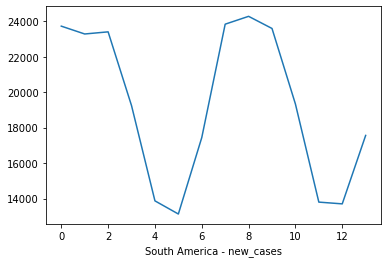

Input: [22523. 25647. 23728. 18634. 13040. 14091. 18769.], Predicted: 22711.930
Input: [25647.   23728.   18634.   13040.   14091.   18769.   22711.93], Predicted: 22818.930
Input: [23728.   18634.   13040.   14091.   18769.   22711.93 22818.93], Predicted: 22756.780
Input: [18634.   13040.   14091.   18769.   22711.93 22818.93 22756.78], Predicted: 19325.190
Input: [13040.   14091.   18769.   22711.93 22818.93 22756.78 19325.19], Predicted: 14261.240
Input: [14091.   18769.   22711.93 22818.93 22756.78 19325.19 14261.24], Predicted: 12859.100
Input: [18769.   22711.93 22818.93 22756.78 19325.19 14261.24 12859.1 ], Predicted: 17011.690
Input: [22711.93 22818.93 22756.78 19325.19 14261.24 12859.1  17011.69], Predicted: 21904.570
Input: [22818.93 22756.78 19325.19 14261.24 12859.1  17011.69 21904.57], Predicted: 24319.790
Input: [22756.78 19325.19 14261.24 12859.1  17011.69 21904.57 24319.79], Predicted: 22923.900
Input: [19325.19 14261.24 12859.1  17011.69 21904.57 24319.79 22923.9 ], P

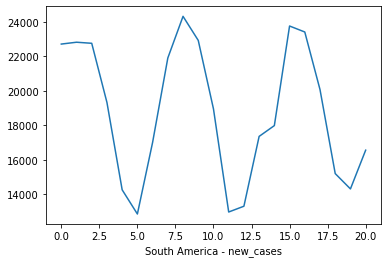

Input: [22523. 25647. 23728. 18634. 13040. 14091. 18769.], Predicted: 23062.170
Input: [25647.   23728.   18634.   13040.   14091.   18769.   23062.17], Predicted: 22805.890
Input: [23728.   18634.   13040.   14091.   18769.   23062.17 22805.89], Predicted: 23294.620
Input: [18634.   13040.   14091.   18769.   23062.17 22805.89 23294.62], Predicted: 18748.490
Input: [13040.   14091.   18769.   23062.17 22805.89 23294.62 18748.49], Predicted: 13981.890
Input: [14091.   18769.   23062.17 22805.89 23294.62 18748.49 13981.89], Predicted: 13323.450
Input: [18769.   23062.17 22805.89 23294.62 18748.49 13981.89 13323.45], Predicted: 18320.100
Input: [23062.17 22805.89 23294.62 18748.49 13981.89 13323.45 18320.1 ], Predicted: 23644.570
Input: [22805.89 23294.62 18748.49 13981.89 13323.45 18320.1  23644.57], Predicted: 24185.030
Input: [23294.62 18748.49 13981.89 13323.45 18320.1  23644.57 24185.03], Predicted: 23973.120
Input: [18748.49 13981.89 13323.45 18320.1  23644.57 24185.03 23973.12], P

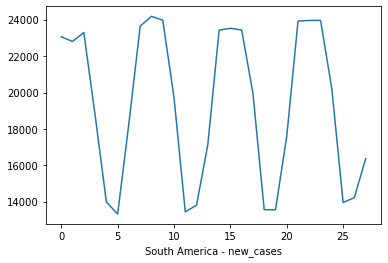

Input: [22523. 25647. 23728. 18634. 13040. 14091. 18769.], Predicted: 22960.940
Input: [25647.   23728.   18634.   13040.   14091.   18769.   22960.94], Predicted: 23113.360
Input: [23728.   18634.   13040.   14091.   18769.   22960.94 23113.36], Predicted: 23329.890
Input: [18634.   13040.   14091.   18769.   22960.94 23113.36 23329.89], Predicted: 18526.800
Input: [13040.   14091.   18769.   22960.94 23113.36 23329.89 18526.8 ], Predicted: 13955.540
Input: [14091.   18769.   22960.94 23113.36 23329.89 18526.8  13955.54], Predicted: 13054.400
Input: [18769.   22960.94 23113.36 23329.89 18526.8  13955.54 13054.4 ], Predicted: 17771.810
Input: [22960.94 23113.36 23329.89 18526.8  13955.54 13054.4  17771.81], Predicted: 23497.640
Input: [23113.36 23329.89 18526.8  13955.54 13054.4  17771.81 23497.64], Predicted: 24034.260
Input: [23329.89 18526.8  13955.54 13054.4  17771.81 23497.64 24034.26], Predicted: 23536.620
Input: [18526.8  13955.54 13054.4  17771.81 23497.64 24034.26 23536.62], P

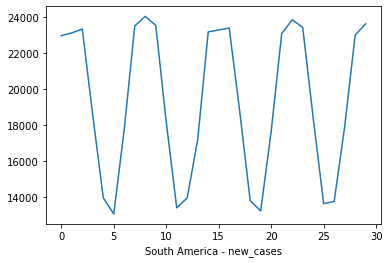

Input: [428. 499. 492. 385. 253. 430. 478.], Predicted: 479.350
Input: [499.   492.   385.   253.   430.   478.   479.35], Predicted: 495.870
Input: [492.   385.   253.   430.   478.   479.35 495.87], Predicted: 468.620
Input: [385.   253.   430.   478.   479.35 495.87 468.62], Predicted: 429.820
Input: [253.   430.   478.   479.35 495.87 468.62 429.82], Predicted: 331.930
Input: [430.   478.   479.35 495.87 468.62 429.82 331.93], Predicted: 413.900
Input: [478.   479.35 495.87 468.62 429.82 331.93 413.9 ], Predicted: 479.560
[479.35, 495.87, 468.62, 429.82, 331.93, 413.9, 479.56]


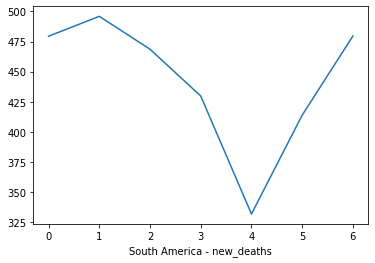

Input: [428. 499. 492. 385. 253. 430. 478.], Predicted: 477.510
Input: [499.   492.   385.   253.   430.   478.   477.51], Predicted: 505.490
Input: [492.   385.   253.   430.   478.   477.51 505.49], Predicted: 461.640
Input: [385.   253.   430.   478.   477.51 505.49 461.64], Predicted: 411.510
Input: [253.   430.   478.   477.51 505.49 461.64 411.51], Predicted: 319.130
Input: [430.   478.   477.51 505.49 461.64 411.51 319.13], Predicted: 441.230
Input: [478.   477.51 505.49 461.64 411.51 319.13 441.23], Predicted: 484.160
Input: [477.51 505.49 461.64 411.51 319.13 441.23 484.16], Predicted: 484.910
Input: [505.49 461.64 411.51 319.13 441.23 484.16 484.91], Predicted: 514.780
Input: [461.64 411.51 319.13 441.23 484.16 484.91 514.78], Predicted: 465.060
Input: [411.51 319.13 441.23 484.16 484.91 514.78 465.06], Predicted: 448.840
Input: [319.13 441.23 484.16 484.91 514.78 465.06 448.84], Predicted: 425.330
Input: [441.23 484.16 484.91 514.78 465.06 448.84 425.33], Predicted: 457.210


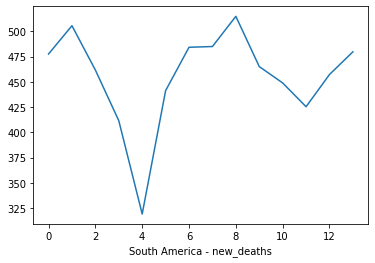

Input: [428. 499. 492. 385. 253. 430. 478.], Predicted: 468.300
Input: [499.  492.  385.  253.  430.  478.  468.3], Predicted: 515.350
Input: [492.   385.   253.   430.   478.   468.3  515.35], Predicted: 482.930
Input: [385.   253.   430.   478.   468.3  515.35 482.93], Predicted: 441.810
Input: [253.   430.   478.   468.3  515.35 482.93 441.81], Predicted: 323.880
Input: [430.   478.   468.3  515.35 482.93 441.81 323.88], Predicted: 422.910
Input: [478.   468.3  515.35 482.93 441.81 323.88 422.91], Predicted: 482.920
Input: [468.3  515.35 482.93 441.81 323.88 422.91 482.92], Predicted: 487.840
Input: [515.35 482.93 441.81 323.88 422.91 482.92 487.84], Predicted: 521.390
Input: [482.93 441.81 323.88 422.91 482.92 487.84 521.39], Predicted: 493.910
Input: [441.81 323.88 422.91 482.92 487.84 521.39 493.91], Predicted: 455.190
Input: [323.88 422.91 482.92 487.84 521.39 493.91 455.19], Predicted: 440.920
Input: [422.91 482.92 487.84 521.39 493.91 455.19 440.92], Predicted: 467.140
Input: 

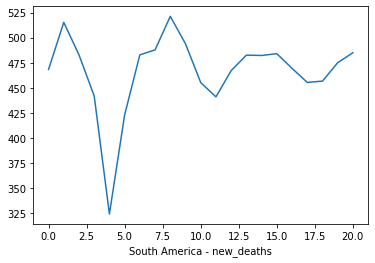

Input: [428. 499. 492. 385. 253. 430. 478.], Predicted: 466.270
Input: [499.   492.   385.   253.   430.   478.   466.27], Predicted: 499.650
Input: [492.   385.   253.   430.   478.   466.27 499.65], Predicted: 471.400
Input: [385.   253.   430.   478.   466.27 499.65 471.4 ], Predicted: 429.930
Input: [253.   430.   478.   466.27 499.65 471.4  429.93], Predicted: 322.830
Input: [430.   478.   466.27 499.65 471.4  429.93 322.83], Predicted: 454.920
Input: [478.   466.27 499.65 471.4  429.93 322.83 454.92], Predicted: 497.350
Input: [466.27 499.65 471.4  429.93 322.83 454.92 497.35], Predicted: 489.140
Input: [499.65 471.4  429.93 322.83 454.92 497.35 489.14], Predicted: 534.220
Input: [471.4  429.93 322.83 454.92 497.35 489.14 534.22], Predicted: 501.860
Input: [429.93 322.83 454.92 497.35 489.14 534.22 501.86], Predicted: 446.690
Input: [322.83 454.92 497.35 489.14 534.22 501.86 446.69], Predicted: 432.960
Input: [454.92 497.35 489.14 534.22 501.86 446.69 432.96], Predicted: 476.680


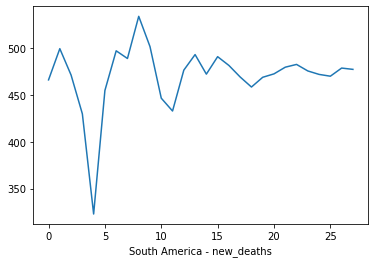

Input: [428. 499. 492. 385. 253. 430. 478.], Predicted: 508.200
Input: [499.  492.  385.  253.  430.  478.  508.2], Predicted: 521.870
Input: [492.   385.   253.   430.   478.   508.2  521.87], Predicted: 485.100
Input: [385.   253.   430.   478.   508.2  521.87 485.1 ], Predicted: 454.990
Input: [253.   430.   478.   508.2  521.87 485.1  454.99], Predicted: 319.030
Input: [430.   478.   508.2  521.87 485.1  454.99 319.03], Predicted: 429.850
Input: [478.   508.2  521.87 485.1  454.99 319.03 429.85], Predicted: 510.750
Input: [508.2  521.87 485.1  454.99 319.03 429.85 510.75], Predicted: 516.020
Input: [521.87 485.1  454.99 319.03 429.85 510.75 516.02], Predicted: 545.610
Input: [485.1  454.99 319.03 429.85 510.75 516.02 545.61], Predicted: 507.220
Input: [454.99 319.03 429.85 510.75 516.02 545.61 507.22], Predicted: 490.660
Input: [319.03 429.85 510.75 516.02 545.61 507.22 490.66], Predicted: 454.530
Input: [429.85 510.75 516.02 545.61 507.22 490.66 454.53], Predicted: 495.470
Input: 

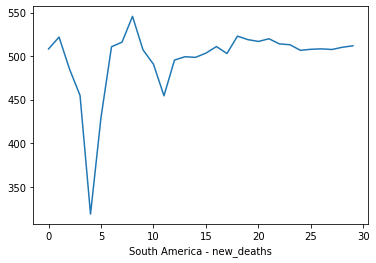

Input: [72548069. 72963939. 73378958. 73693740. 73953818. 74313072. 74697774.], Predicted: 74469593.250
Input: [72963939.   73378958.   73693740.   73953818.   74313072.   74697774.
 74469593.25], Predicted: 74469593.250
Input: [73378958.   73693740.   73953818.   74313072.   74697774.   74469593.25
 74469593.25], Predicted: 74469593.250
Input: [73693740.   73953818.   74313072.   74697774.   74469593.25 74469593.25
 74469593.25], Predicted: 74469593.250
Input: [73953818.   74313072.   74697774.   74469593.25 74469593.25 74469593.25
 74469593.25], Predicted: 74469593.250
Input: [74313072.   74697774.   74469593.25 74469593.25 74469593.25 74469593.25
 74469593.25], Predicted: 74469593.250
Input: [74697774.   74469593.25 74469593.25 74469593.25 74469593.25 74469593.25
 74469593.25], Predicted: 74469593.250
[74469593.25, 74469593.25, 74469593.25, 74469593.25, 74469593.25, 74469593.25, 74469593.25]


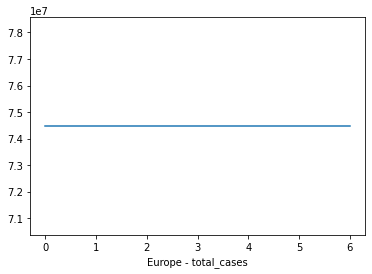

Input: [72548069. 72963939. 73378958. 73693740. 73953818. 74313072. 74697774.], Predicted: 74451860.510
Input: [72963939.   73378958.   73693740.   73953818.   74313072.   74697774.
 74451860.51], Predicted: 74451860.510
Input: [73378958.   73693740.   73953818.   74313072.   74697774.   74451860.51
 74451860.51], Predicted: 74451860.510
Input: [73693740.   73953818.   74313072.   74697774.   74451860.51 74451860.51
 74451860.51], Predicted: 74451860.510
Input: [73953818.   74313072.   74697774.   74451860.51 74451860.51 74451860.51
 74451860.51], Predicted: 74451860.510
Input: [74313072.   74697774.   74451860.51 74451860.51 74451860.51 74451860.51
 74451860.51], Predicted: 74451860.510
Input: [74697774.   74451860.51 74451860.51 74451860.51 74451860.51 74451860.51
 74451860.51], Predicted: 74451860.510
Input: [74451860.51 74451860.51 74451860.51 74451860.51 74451860.51 74451860.51
 74451860.51], Predicted: 74451860.510
Input: [74451860.51 74451860.51 74451860.51 74451860.51 74451860.

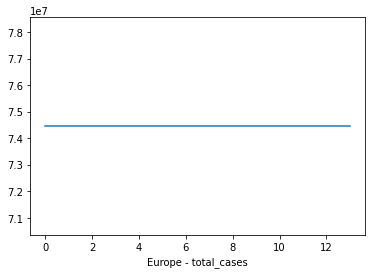

Input: [72548069. 72963939. 73378958. 73693740. 73953818. 74313072. 74697774.], Predicted: 74466853.710
Input: [72963939.   73378958.   73693740.   73953818.   74313072.   74697774.
 74466853.71], Predicted: 74466853.710
Input: [73378958.   73693740.   73953818.   74313072.   74697774.   74466853.71
 74466853.71], Predicted: 74466853.710
Input: [73693740.   73953818.   74313072.   74697774.   74466853.71 74466853.71
 74466853.71], Predicted: 74466853.710
Input: [73953818.   74313072.   74697774.   74466853.71 74466853.71 74466853.71
 74466853.71], Predicted: 74466853.710
Input: [74313072.   74697774.   74466853.71 74466853.71 74466853.71 74466853.71
 74466853.71], Predicted: 74466853.710
Input: [74697774.   74466853.71 74466853.71 74466853.71 74466853.71 74466853.71
 74466853.71], Predicted: 74466853.710
Input: [74466853.71 74466853.71 74466853.71 74466853.71 74466853.71 74466853.71
 74466853.71], Predicted: 74466853.710
Input: [74466853.71 74466853.71 74466853.71 74466853.71 74466853.

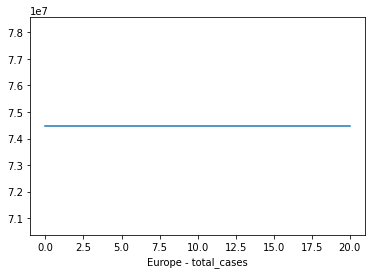

Input: [72548069. 72963939. 73378958. 73693740. 73953818. 74313072. 74697774.], Predicted: 74439148.060
Input: [72963939.   73378958.   73693740.   73953818.   74313072.   74697774.
 74439148.06], Predicted: 74439148.060
Input: [73378958.   73693740.   73953818.   74313072.   74697774.   74439148.06
 74439148.06], Predicted: 74439148.060
Input: [73693740.   73953818.   74313072.   74697774.   74439148.06 74439148.06
 74439148.06], Predicted: 74439148.060
Input: [73953818.   74313072.   74697774.   74439148.06 74439148.06 74439148.06
 74439148.06], Predicted: 74439148.060
Input: [74313072.   74697774.   74439148.06 74439148.06 74439148.06 74439148.06
 74439148.06], Predicted: 74439148.060
Input: [74697774.   74439148.06 74439148.06 74439148.06 74439148.06 74439148.06
 74439148.06], Predicted: 74439148.060
Input: [74439148.06 74439148.06 74439148.06 74439148.06 74439148.06 74439148.06
 74439148.06], Predicted: 74439148.060
Input: [74439148.06 74439148.06 74439148.06 74439148.06 74439148.

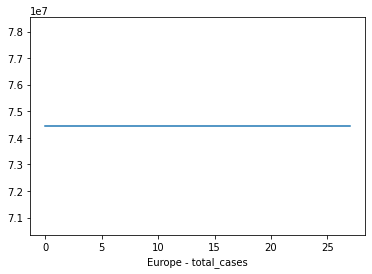

Input: [72548069. 72963939. 73378958. 73693740. 73953818. 74313072. 74697774.], Predicted: 74479641.010
Input: [72963939.   73378958.   73693740.   73953818.   74313072.   74697774.
 74479641.01], Predicted: 74479641.010
Input: [73378958.   73693740.   73953818.   74313072.   74697774.   74479641.01
 74479641.01], Predicted: 74479641.010
Input: [73693740.   73953818.   74313072.   74697774.   74479641.01 74479641.01
 74479641.01], Predicted: 74479641.010
Input: [73953818.   74313072.   74697774.   74479641.01 74479641.01 74479641.01
 74479641.01], Predicted: 74479641.010
Input: [74313072.   74697774.   74479641.01 74479641.01 74479641.01 74479641.01
 74479641.01], Predicted: 74479641.010
Input: [74697774.   74479641.01 74479641.01 74479641.01 74479641.01 74479641.01
 74479641.01], Predicted: 74479641.010
Input: [74479641.01 74479641.01 74479641.01 74479641.01 74479641.01 74479641.01
 74479641.01], Predicted: 74479641.010
Input: [74479641.01 74479641.01 74479641.01 74479641.01 74479641.

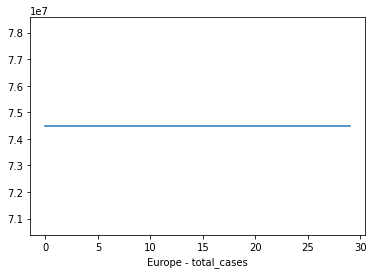

Input: [1397352. 1401647. 1405744. 1409147. 1411842. 1415638. 1420111.], Predicted: 1417964.350
Input: [1401647.   1405744.   1409147.   1411842.   1415638.   1420111.
 1417964.35], Predicted: 1417964.350
Input: [1405744.   1409147.   1411842.   1415638.   1420111.   1417964.35
 1417964.35], Predicted: 1417964.350
Input: [1409147.   1411842.   1415638.   1420111.   1417964.35 1417964.35
 1417964.35], Predicted: 1417964.350
Input: [1411842.   1415638.   1420111.   1417964.35 1417964.35 1417964.35
 1417964.35], Predicted: 1417964.350
Input: [1415638.   1420111.   1417964.35 1417964.35 1417964.35 1417964.35
 1417964.35], Predicted: 1417964.350
Input: [1420111.   1417964.35 1417964.35 1417964.35 1417964.35 1417964.35
 1417964.35], Predicted: 1417964.350
[1417964.35, 1417964.35, 1417964.35, 1417964.35, 1417964.35, 1417964.35, 1417964.35]


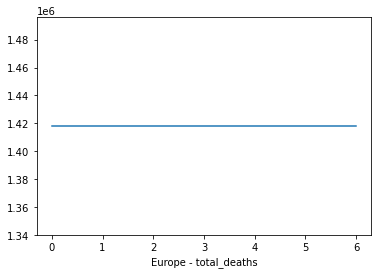

Input: [1397352. 1401647. 1405744. 1409147. 1411842. 1415638. 1420111.], Predicted: 1417780.630
Input: [1401647.   1405744.   1409147.   1411842.   1415638.   1420111.
 1417780.63], Predicted: 1417780.630
Input: [1405744.   1409147.   1411842.   1415638.   1420111.   1417780.63
 1417780.63], Predicted: 1417780.630
Input: [1409147.   1411842.   1415638.   1420111.   1417780.63 1417780.63
 1417780.63], Predicted: 1417780.630
Input: [1411842.   1415638.   1420111.   1417780.63 1417780.63 1417780.63
 1417780.63], Predicted: 1417780.630
Input: [1415638.   1420111.   1417780.63 1417780.63 1417780.63 1417780.63
 1417780.63], Predicted: 1417780.630
Input: [1420111.   1417780.63 1417780.63 1417780.63 1417780.63 1417780.63
 1417780.63], Predicted: 1417780.630
Input: [1417780.63 1417780.63 1417780.63 1417780.63 1417780.63 1417780.63
 1417780.63], Predicted: 1417780.630
Input: [1417780.63 1417780.63 1417780.63 1417780.63 1417780.63 1417780.63
 1417780.63], Predicted: 1417780.630
Input: [1417780.63

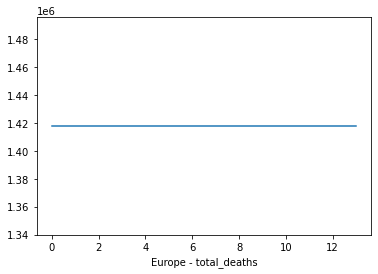

Input: [1397352. 1401647. 1405744. 1409147. 1411842. 1415638. 1420111.], Predicted: 1417278.990
Input: [1401647.   1405744.   1409147.   1411842.   1415638.   1420111.
 1417278.99], Predicted: 1417278.990
Input: [1405744.   1409147.   1411842.   1415638.   1420111.   1417278.99
 1417278.99], Predicted: 1417278.990
Input: [1409147.   1411842.   1415638.   1420111.   1417278.99 1417278.99
 1417278.99], Predicted: 1417278.990
Input: [1411842.   1415638.   1420111.   1417278.99 1417278.99 1417278.99
 1417278.99], Predicted: 1417278.990
Input: [1415638.   1420111.   1417278.99 1417278.99 1417278.99 1417278.99
 1417278.99], Predicted: 1417278.990
Input: [1420111.   1417278.99 1417278.99 1417278.99 1417278.99 1417278.99
 1417278.99], Predicted: 1417278.990
Input: [1417278.99 1417278.99 1417278.99 1417278.99 1417278.99 1417278.99
 1417278.99], Predicted: 1417278.990
Input: [1417278.99 1417278.99 1417278.99 1417278.99 1417278.99 1417278.99
 1417278.99], Predicted: 1417278.990
Input: [1417278.99

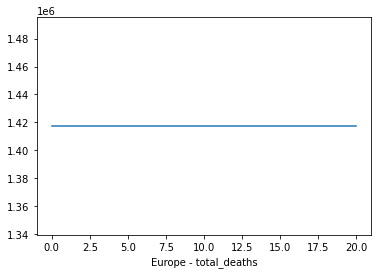

Input: [1397352. 1401647. 1405744. 1409147. 1411842. 1415638. 1420111.], Predicted: 1417408.280
Input: [1401647.   1405744.   1409147.   1411842.   1415638.   1420111.
 1417408.28], Predicted: 1417408.280
Input: [1405744.   1409147.   1411842.   1415638.   1420111.   1417408.28
 1417408.28], Predicted: 1417408.280
Input: [1409147.   1411842.   1415638.   1420111.   1417408.28 1417408.28
 1417408.28], Predicted: 1417408.280
Input: [1411842.   1415638.   1420111.   1417408.28 1417408.28 1417408.28
 1417408.28], Predicted: 1417408.280
Input: [1415638.   1420111.   1417408.28 1417408.28 1417408.28 1417408.28
 1417408.28], Predicted: 1417408.280
Input: [1420111.   1417408.28 1417408.28 1417408.28 1417408.28 1417408.28
 1417408.28], Predicted: 1417408.280
Input: [1417408.28 1417408.28 1417408.28 1417408.28 1417408.28 1417408.28
 1417408.28], Predicted: 1417408.280
Input: [1417408.28 1417408.28 1417408.28 1417408.28 1417408.28 1417408.28
 1417408.28], Predicted: 1417408.280
Input: [1417408.28

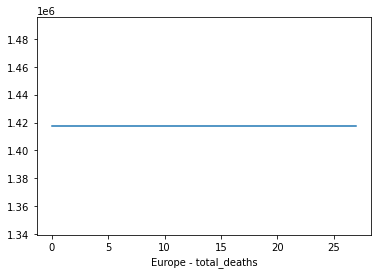

Input: [1397352. 1401647. 1405744. 1409147. 1411842. 1415638. 1420111.], Predicted: 1417961.950
Input: [1401647.   1405744.   1409147.   1411842.   1415638.   1420111.
 1417961.95], Predicted: 1417961.950
Input: [1405744.   1409147.   1411842.   1415638.   1420111.   1417961.95
 1417961.95], Predicted: 1417961.950
Input: [1409147.   1411842.   1415638.   1420111.   1417961.95 1417961.95
 1417961.95], Predicted: 1417961.950
Input: [1411842.   1415638.   1420111.   1417961.95 1417961.95 1417961.95
 1417961.95], Predicted: 1417961.950
Input: [1415638.   1420111.   1417961.95 1417961.95 1417961.95 1417961.95
 1417961.95], Predicted: 1417961.950
Input: [1420111.   1417961.95 1417961.95 1417961.95 1417961.95 1417961.95
 1417961.95], Predicted: 1417961.950
Input: [1417961.95 1417961.95 1417961.95 1417961.95 1417961.95 1417961.95
 1417961.95], Predicted: 1417961.950
Input: [1417961.95 1417961.95 1417961.95 1417961.95 1417961.95 1417961.95
 1417961.95], Predicted: 1417961.950
Input: [1417961.95

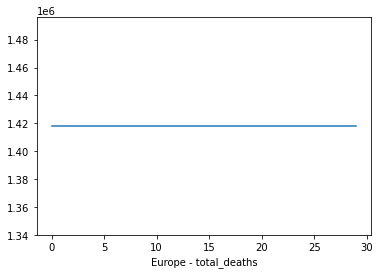

Input: [9.30807520e+08 9.35594789e+08 9.39889588e+08 9.43185524e+08
 9.44935545e+08 9.48999163e+08 9.52554655e+08], Predicted: 950925075.770
Input: [9.35594789e+08 9.39889588e+08 9.43185524e+08 9.44935545e+08
 9.48999163e+08 9.52554655e+08 9.50925076e+08], Predicted: 950925075.770
Input: [9.39889588e+08 9.43185524e+08 9.44935545e+08 9.48999163e+08
 9.52554655e+08 9.50925076e+08 9.50925076e+08], Predicted: 950925075.770
Input: [9.43185524e+08 9.44935545e+08 9.48999163e+08 9.52554655e+08
 9.50925076e+08 9.50925076e+08 9.50925076e+08], Predicted: 950925075.770
Input: [9.44935545e+08 9.48999163e+08 9.52554655e+08 9.50925076e+08
 9.50925076e+08 9.50925076e+08 9.50925076e+08], Predicted: 950925075.770
Input: [9.48999163e+08 9.52554655e+08 9.50925076e+08 9.50925076e+08
 9.50925076e+08 9.50925076e+08 9.50925076e+08], Predicted: 950925075.770
Input: [9.52554655e+08 9.50925076e+08 9.50925076e+08 9.50925076e+08
 9.50925076e+08 9.50925076e+08 9.50925076e+08], Predicted: 950925075.770
[950925075.77

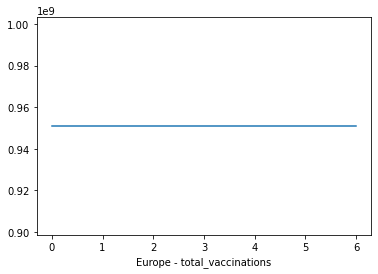

Input: [9.30807520e+08 9.35594789e+08 9.39889588e+08 9.43185524e+08
 9.44935545e+08 9.48999163e+08 9.52554655e+08], Predicted: 950646597.400
Input: [9.35594789e+08 9.39889588e+08 9.43185524e+08 9.44935545e+08
 9.48999163e+08 9.52554655e+08 9.50646597e+08], Predicted: 950646597.400
Input: [9.39889588e+08 9.43185524e+08 9.44935545e+08 9.48999163e+08
 9.52554655e+08 9.50646597e+08 9.50646597e+08], Predicted: 950646597.400
Input: [9.43185524e+08 9.44935545e+08 9.48999163e+08 9.52554655e+08
 9.50646597e+08 9.50646597e+08 9.50646597e+08], Predicted: 950646597.400
Input: [9.44935545e+08 9.48999163e+08 9.52554655e+08 9.50646597e+08
 9.50646597e+08 9.50646597e+08 9.50646597e+08], Predicted: 950646597.400
Input: [9.48999163e+08 9.52554655e+08 9.50646597e+08 9.50646597e+08
 9.50646597e+08 9.50646597e+08 9.50646597e+08], Predicted: 950646597.400
Input: [9.52554655e+08 9.50646597e+08 9.50646597e+08 9.50646597e+08
 9.50646597e+08 9.50646597e+08 9.50646597e+08], Predicted: 950646597.400
Input: [9.506

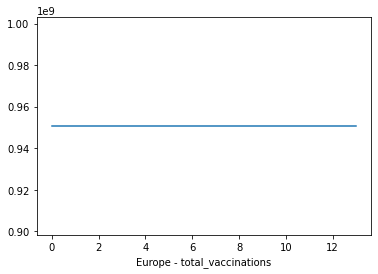

Input: [9.30807520e+08 9.35594789e+08 9.39889588e+08 9.43185524e+08
 9.44935545e+08 9.48999163e+08 9.52554655e+08], Predicted: 950783071.460
Input: [9.35594789e+08 9.39889588e+08 9.43185524e+08 9.44935545e+08
 9.48999163e+08 9.52554655e+08 9.50783071e+08], Predicted: 950783071.460
Input: [9.39889588e+08 9.43185524e+08 9.44935545e+08 9.48999163e+08
 9.52554655e+08 9.50783071e+08 9.50783071e+08], Predicted: 950783071.460
Input: [9.43185524e+08 9.44935545e+08 9.48999163e+08 9.52554655e+08
 9.50783071e+08 9.50783071e+08 9.50783071e+08], Predicted: 950783071.460
Input: [9.44935545e+08 9.48999163e+08 9.52554655e+08 9.50783071e+08
 9.50783071e+08 9.50783071e+08 9.50783071e+08], Predicted: 950783071.460
Input: [9.48999163e+08 9.52554655e+08 9.50783071e+08 9.50783071e+08
 9.50783071e+08 9.50783071e+08 9.50783071e+08], Predicted: 950783071.460
Input: [9.52554655e+08 9.50783071e+08 9.50783071e+08 9.50783071e+08
 9.50783071e+08 9.50783071e+08 9.50783071e+08], Predicted: 950783071.460
Input: [9.507

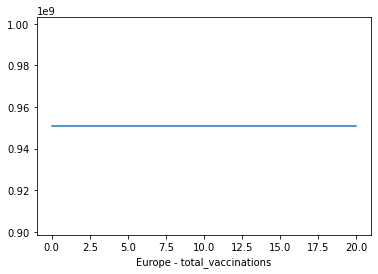

Input: [9.30807520e+08 9.35594789e+08 9.39889588e+08 9.43185524e+08
 9.44935545e+08 9.48999163e+08 9.52554655e+08], Predicted: 950577418.760
Input: [9.35594789e+08 9.39889588e+08 9.43185524e+08 9.44935545e+08
 9.48999163e+08 9.52554655e+08 9.50577419e+08], Predicted: 950577418.760
Input: [9.39889588e+08 9.43185524e+08 9.44935545e+08 9.48999163e+08
 9.52554655e+08 9.50577419e+08 9.50577419e+08], Predicted: 950577418.760
Input: [9.43185524e+08 9.44935545e+08 9.48999163e+08 9.52554655e+08
 9.50577419e+08 9.50577419e+08 9.50577419e+08], Predicted: 950577418.760
Input: [9.44935545e+08 9.48999163e+08 9.52554655e+08 9.50577419e+08
 9.50577419e+08 9.50577419e+08 9.50577419e+08], Predicted: 950577418.760
Input: [9.48999163e+08 9.52554655e+08 9.50577419e+08 9.50577419e+08
 9.50577419e+08 9.50577419e+08 9.50577419e+08], Predicted: 950577418.760
Input: [9.52554655e+08 9.50577419e+08 9.50577419e+08 9.50577419e+08
 9.50577419e+08 9.50577419e+08 9.50577419e+08], Predicted: 950577418.760
Input: [9.505

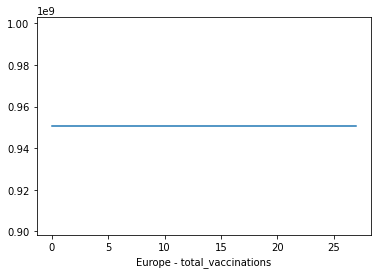

Input: [9.30807520e+08 9.35594789e+08 9.39889588e+08 9.43185524e+08
 9.44935545e+08 9.48999163e+08 9.52554655e+08], Predicted: 950006516.920
Input: [9.35594789e+08 9.39889588e+08 9.43185524e+08 9.44935545e+08
 9.48999163e+08 9.52554655e+08 9.50006517e+08], Predicted: 950006516.920
Input: [9.39889588e+08 9.43185524e+08 9.44935545e+08 9.48999163e+08
 9.52554655e+08 9.50006517e+08 9.50006517e+08], Predicted: 950006516.920
Input: [9.43185524e+08 9.44935545e+08 9.48999163e+08 9.52554655e+08
 9.50006517e+08 9.50006517e+08 9.50006517e+08], Predicted: 950006516.920
Input: [9.44935545e+08 9.48999163e+08 9.52554655e+08 9.50006517e+08
 9.50006517e+08 9.50006517e+08 9.50006517e+08], Predicted: 950006516.920
Input: [9.48999163e+08 9.52554655e+08 9.50006517e+08 9.50006517e+08
 9.50006517e+08 9.50006517e+08 9.50006517e+08], Predicted: 950006516.920
Input: [9.52554655e+08 9.50006517e+08 9.50006517e+08 9.50006517e+08
 9.50006517e+08 9.50006517e+08 9.50006517e+08], Predicted: 950006516.920
Input: [9.500

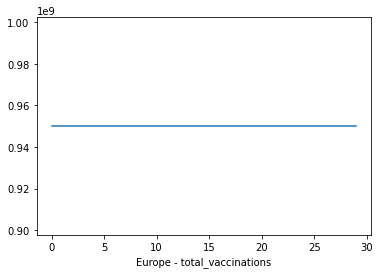

Input: [4.30021371e+08 4.30915366e+08 4.32003236e+08 4.32878527e+08
 4.33236970e+08 4.34322058e+08 4.35171389e+08], Predicted: 434595241.100
Input: [4.30915366e+08 4.32003236e+08 4.32878527e+08 4.33236970e+08
 4.34322058e+08 4.35171389e+08 4.34595241e+08], Predicted: 434595241.100
Input: [4.32003236e+08 4.32878527e+08 4.33236970e+08 4.34322058e+08
 4.35171389e+08 4.34595241e+08 4.34595241e+08], Predicted: 434595241.100
Input: [4.32878527e+08 4.33236970e+08 4.34322058e+08 4.35171389e+08
 4.34595241e+08 4.34595241e+08 4.34595241e+08], Predicted: 434595241.100
Input: [4.33236970e+08 4.34322058e+08 4.35171389e+08 4.34595241e+08
 4.34595241e+08 4.34595241e+08 4.34595241e+08], Predicted: 434595241.100
Input: [4.34322058e+08 4.35171389e+08 4.34595241e+08 4.34595241e+08
 4.34595241e+08 4.34595241e+08 4.34595241e+08], Predicted: 434595241.100
Input: [4.35171389e+08 4.34595241e+08 4.34595241e+08 4.34595241e+08
 4.34595241e+08 4.34595241e+08 4.34595241e+08], Predicted: 434595241.100
[434595241.1,

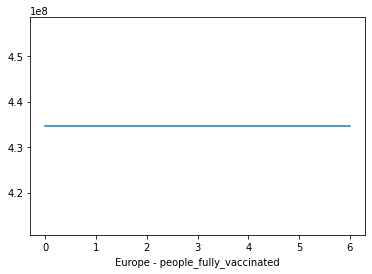

Input: [4.30021371e+08 4.30915366e+08 4.32003236e+08 4.32878527e+08
 4.33236970e+08 4.34322058e+08 4.35171389e+08], Predicted: 434602789.200
Input: [4.30915366e+08 4.32003236e+08 4.32878527e+08 4.33236970e+08
 4.34322058e+08 4.35171389e+08 4.34602789e+08], Predicted: 434602789.200
Input: [4.32003236e+08 4.32878527e+08 4.33236970e+08 4.34322058e+08
 4.35171389e+08 4.34602789e+08 4.34602789e+08], Predicted: 434602789.200
Input: [4.32878527e+08 4.33236970e+08 4.34322058e+08 4.35171389e+08
 4.34602789e+08 4.34602789e+08 4.34602789e+08], Predicted: 434602789.200
Input: [4.33236970e+08 4.34322058e+08 4.35171389e+08 4.34602789e+08
 4.34602789e+08 4.34602789e+08 4.34602789e+08], Predicted: 434602789.200
Input: [4.34322058e+08 4.35171389e+08 4.34602789e+08 4.34602789e+08
 4.34602789e+08 4.34602789e+08 4.34602789e+08], Predicted: 434602789.200
Input: [4.35171389e+08 4.34602789e+08 4.34602789e+08 4.34602789e+08
 4.34602789e+08 4.34602789e+08 4.34602789e+08], Predicted: 434602789.200
Input: [4.346

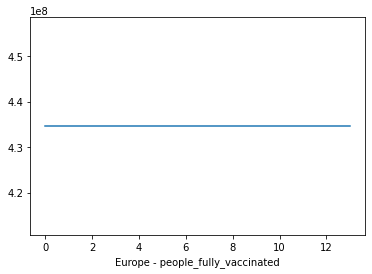

Input: [4.30021371e+08 4.30915366e+08 4.32003236e+08 4.32878527e+08
 4.33236970e+08 4.34322058e+08 4.35171389e+08], Predicted: 434738907.560
Input: [4.30915366e+08 4.32003236e+08 4.32878527e+08 4.33236970e+08
 4.34322058e+08 4.35171389e+08 4.34738908e+08], Predicted: 434738907.560
Input: [4.32003236e+08 4.32878527e+08 4.33236970e+08 4.34322058e+08
 4.35171389e+08 4.34738908e+08 4.34738908e+08], Predicted: 434738907.560
Input: [4.32878527e+08 4.33236970e+08 4.34322058e+08 4.35171389e+08
 4.34738908e+08 4.34738908e+08 4.34738908e+08], Predicted: 434738907.560
Input: [4.33236970e+08 4.34322058e+08 4.35171389e+08 4.34738908e+08
 4.34738908e+08 4.34738908e+08 4.34738908e+08], Predicted: 434738907.560
Input: [4.34322058e+08 4.35171389e+08 4.34738908e+08 4.34738908e+08
 4.34738908e+08 4.34738908e+08 4.34738908e+08], Predicted: 434738907.560
Input: [4.35171389e+08 4.34738908e+08 4.34738908e+08 4.34738908e+08
 4.34738908e+08 4.34738908e+08 4.34738908e+08], Predicted: 434738907.560
Input: [4.347

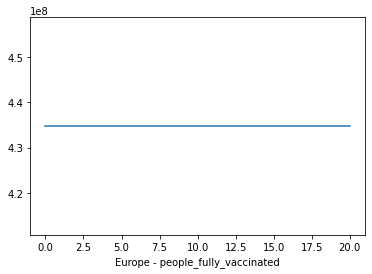

Input: [4.30021371e+08 4.30915366e+08 4.32003236e+08 4.32878527e+08
 4.33236970e+08 4.34322058e+08 4.35171389e+08], Predicted: 434535749.400
Input: [4.30915366e+08 4.32003236e+08 4.32878527e+08 4.33236970e+08
 4.34322058e+08 4.35171389e+08 4.34535749e+08], Predicted: 434535749.400
Input: [4.32003236e+08 4.32878527e+08 4.33236970e+08 4.34322058e+08
 4.35171389e+08 4.34535749e+08 4.34535749e+08], Predicted: 434535749.400
Input: [4.32878527e+08 4.33236970e+08 4.34322058e+08 4.35171389e+08
 4.34535749e+08 4.34535749e+08 4.34535749e+08], Predicted: 434535749.400
Input: [4.33236970e+08 4.34322058e+08 4.35171389e+08 4.34535749e+08
 4.34535749e+08 4.34535749e+08 4.34535749e+08], Predicted: 434535749.400
Input: [4.34322058e+08 4.35171389e+08 4.34535749e+08 4.34535749e+08
 4.34535749e+08 4.34535749e+08 4.34535749e+08], Predicted: 434535749.400
Input: [4.35171389e+08 4.34535749e+08 4.34535749e+08 4.34535749e+08
 4.34535749e+08 4.34535749e+08 4.34535749e+08], Predicted: 434535749.400
Input: [4.345

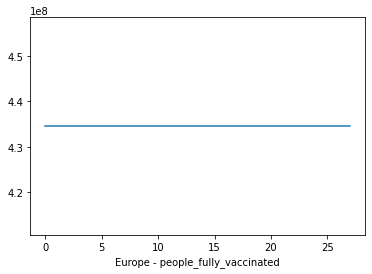

Input: [4.30021371e+08 4.30915366e+08 4.32003236e+08 4.32878527e+08
 4.33236970e+08 4.34322058e+08 4.35171389e+08], Predicted: 434548048.700
Input: [4.30915366e+08 4.32003236e+08 4.32878527e+08 4.33236970e+08
 4.34322058e+08 4.35171389e+08 4.34548049e+08], Predicted: 434548048.700
Input: [4.32003236e+08 4.32878527e+08 4.33236970e+08 4.34322058e+08
 4.35171389e+08 4.34548049e+08 4.34548049e+08], Predicted: 434548048.700
Input: [4.32878527e+08 4.33236970e+08 4.34322058e+08 4.35171389e+08
 4.34548049e+08 4.34548049e+08 4.34548049e+08], Predicted: 434548048.700
Input: [4.33236970e+08 4.34322058e+08 4.35171389e+08 4.34548049e+08
 4.34548049e+08 4.34548049e+08 4.34548049e+08], Predicted: 434548048.700
Input: [4.34322058e+08 4.35171389e+08 4.34548049e+08 4.34548049e+08
 4.34548049e+08 4.34548049e+08 4.34548049e+08], Predicted: 434548048.700
Input: [4.35171389e+08 4.34548049e+08 4.34548049e+08 4.34548049e+08
 4.34548049e+08 4.34548049e+08 4.34548049e+08], Predicted: 434548048.700
Input: [4.345

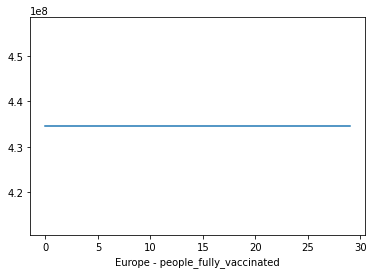

Input: [429348. 415870. 415019. 314782. 260078. 359254. 384702.], Predicted: 403564.400
Input: [415870.  415019.  314782.  260078.  359254.  384702.  403564.4], Predicted: 409715.660
Input: [415019.   314782.   260078.   359254.   384702.   403564.4  409715.66], Predicted: 405247.110
Input: [314782.   260078.   359254.   384702.   403564.4  409715.66 405247.11], Predicted: 334678.740
Input: [260078.   359254.   384702.   403564.4  409715.66 405247.11 334678.74], Predicted: 308350.760
Input: [359254.   384702.   403564.4  409715.66 405247.11 334678.74 308350.76], Predicted: 362255.320
Input: [384702.   403564.4  409715.66 405247.11 334678.74 308350.76 362255.32], Predicted: 393440.340
[403564.4, 409715.66, 405247.11, 334678.74, 308350.76, 362255.32, 393440.34]


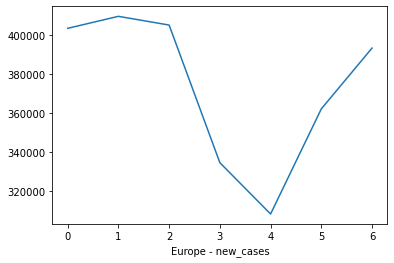

Input: [429348. 415870. 415019. 314782. 260078. 359254. 384702.], Predicted: 415065.870
Input: [415870.   415019.   314782.   260078.   359254.   384702.   415065.87], Predicted: 416439.510
Input: [415019.   314782.   260078.   359254.   384702.   415065.87 416439.51], Predicted: 408867.740
Input: [314782.   260078.   359254.   384702.   415065.87 416439.51 408867.74], Predicted: 326065.470
Input: [260078.   359254.   384702.   415065.87 416439.51 408867.74 326065.47], Predicted: 311123.880
Input: [359254.   384702.   415065.87 416439.51 408867.74 326065.47 311123.88], Predicted: 355123.540
Input: [384702.   415065.87 416439.51 408867.74 326065.47 311123.88 355123.54], Predicted: 395588.990
Input: [415065.87 416439.51 408867.74 326065.47 311123.88 355123.54 395588.99], Predicted: 412352.130
Input: [416439.51 408867.74 326065.47 311123.88 355123.54 395588.99 412352.13], Predicted: 415302.160
Input: [408867.74 326065.47 311123.88 355123.54 395588.99 412352.13 415302.16], Predicted: 40797

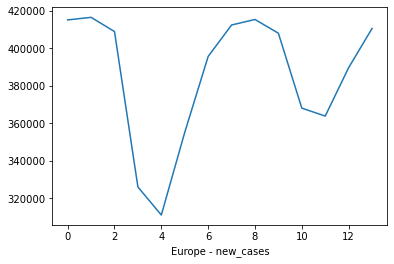

Input: [429348. 415870. 415019. 314782. 260078. 359254. 384702.], Predicted: 406310.920
Input: [415870.   415019.   314782.   260078.   359254.   384702.   406310.92], Predicted: 410650.030
Input: [415019.   314782.   260078.   359254.   384702.   406310.92 410650.03], Predicted: 405627.320
Input: [314782.   260078.   359254.   384702.   406310.92 410650.03 405627.32], Predicted: 335733.740
Input: [260078.   359254.   384702.   406310.92 410650.03 405627.32 335733.74], Predicted: 307577.780
Input: [359254.   384702.   406310.92 410650.03 405627.32 335733.74 307577.78], Predicted: 368044.870
Input: [384702.   406310.92 410650.03 405627.32 335733.74 307577.78 368044.87], Predicted: 390216.520
Input: [406310.92 410650.03 405627.32 335733.74 307577.78 368044.87 390216.52], Predicted: 405256.120
Input: [410650.03 405627.32 335733.74 307577.78 368044.87 390216.52 405256.12], Predicted: 413523.390
Input: [405627.32 335733.74 307577.78 368044.87 390216.52 405256.12 413523.39], Predicted: 40890

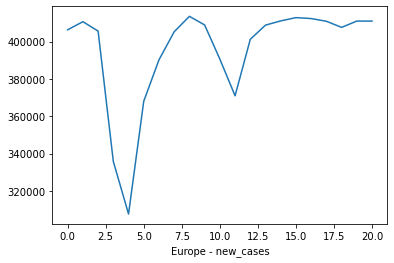

Input: [429348. 415870. 415019. 314782. 260078. 359254. 384702.], Predicted: 411748.150
Input: [415870.   415019.   314782.   260078.   359254.   384702.   411748.15], Predicted: 417259.800
Input: [415019.   314782.   260078.   359254.   384702.   411748.15 417259.8 ], Predicted: 408135.370
Input: [314782.   260078.   359254.   384702.   411748.15 417259.8  408135.37], Predicted: 327101.870
Input: [260078.   359254.   384702.   411748.15 417259.8  408135.37 327101.87], Predicted: 306877.510
Input: [359254.   384702.   411748.15 417259.8  408135.37 327101.87 306877.51], Predicted: 348300.460
Input: [384702.   411748.15 417259.8  408135.37 327101.87 306877.51 348300.46], Predicted: 388617.590
Input: [411748.15 417259.8  408135.37 327101.87 306877.51 348300.46 388617.59], Predicted: 412935.140
Input: [417259.8  408135.37 327101.87 306877.51 348300.46 388617.59 412935.14], Predicted: 417025.440
Input: [408135.37 327101.87 306877.51 348300.46 388617.59 412935.14 417025.44], Predicted: 41335

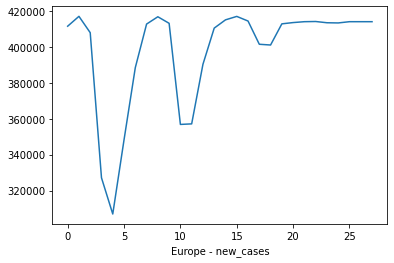

Input: [429348. 415870. 415019. 314782. 260078. 359254. 384702.], Predicted: 402741.830
Input: [415870.   415019.   314782.   260078.   359254.   384702.   402741.83], Predicted: 407026.990
Input: [415019.   314782.   260078.   359254.   384702.   402741.83 407026.99], Predicted: 400583.510
Input: [314782.   260078.   359254.   384702.   402741.83 407026.99 400583.51], Predicted: 331661.680
Input: [260078.   359254.   384702.   402741.83 407026.99 400583.51 331661.68], Predicted: 303633.930
Input: [359254.   384702.   402741.83 407026.99 400583.51 331661.68 303633.93], Predicted: 358420.560
Input: [384702.   402741.83 407026.99 400583.51 331661.68 303633.93 358420.56], Predicted: 385590.750
Input: [402741.83 407026.99 400583.51 331661.68 303633.93 358420.56 385590.75], Predicted: 403520.860
Input: [407026.99 400583.51 331661.68 303633.93 358420.56 385590.75 403520.86], Predicted: 407601.760
Input: [400583.51 331661.68 303633.93 358420.56 385590.75 403520.86 407601.76], Predicted: 40209

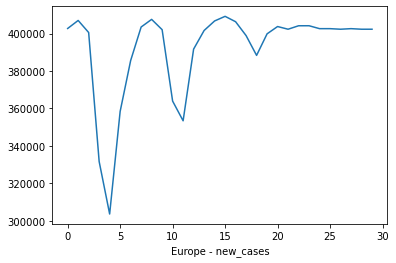

Input: [4487. 4295. 4097. 3403. 2695. 3796. 4473.], Predicted: 4473.750
Input: [4295.   4097.   3403.   2695.   3796.   4473.   4473.75], Predicted: 4209.250
Input: [4097.   3403.   2695.   3796.   4473.   4473.75 4209.25], Predicted: 4088.250
Input: [3403.   2695.   3796.   4473.   4473.75 4209.25 4088.25], Predicted: 3487.150
Input: [2695.   3796.   4473.   4473.75 4209.25 4088.25 3487.15], Predicted: 2811.350
Input: [3796.   4473.   4473.75 4209.25 4088.25 3487.15 2811.35], Predicted: 3951.250
Input: [4473.   4473.75 4209.25 4088.25 3487.15 2811.35 3951.25], Predicted: 4337.980
[4473.75, 4209.25, 4088.25, 3487.15, 2811.35, 3951.25, 4337.98]


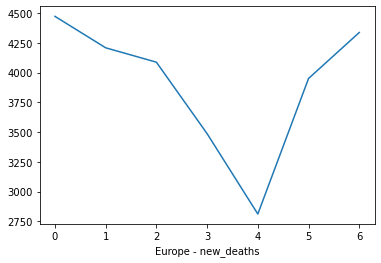

Input: [4487. 4295. 4097. 3403. 2695. 3796. 4473.], Predicted: 4443.300
Input: [4295.  4097.  3403.  2695.  3796.  4473.  4443.3], Predicted: 4106.940
Input: [4097.   3403.   2695.   3796.   4473.   4443.3  4106.94], Predicted: 4062.260
Input: [3403.   2695.   3796.   4473.   4443.3  4106.94 4062.26], Predicted: 3448.560
Input: [2695.   3796.   4473.   4443.3  4106.94 4062.26 3448.56], Predicted: 2810.310
Input: [3796.   4473.   4443.3  4106.94 4062.26 3448.56 2810.31], Predicted: 3935.650
Input: [4473.   4443.3  4106.94 4062.26 3448.56 2810.31 3935.65], Predicted: 4314.390
Input: [4443.3  4106.94 4062.26 3448.56 2810.31 3935.65 4314.39], Predicted: 4273.090
Input: [4106.94 4062.26 3448.56 2810.31 3935.65 4314.39 4273.09], Predicted: 3951.760
Input: [4062.26 3448.56 2810.31 3935.65 4314.39 4273.09 3951.76], Predicted: 3986.010
Input: [3448.56 2810.31 3935.65 4314.39 4273.09 3951.76 3986.01], Predicted: 3494.050
Input: [2810.31 3935.65 4314.39 4273.09 3951.76 3986.01 3494.05], Predicted

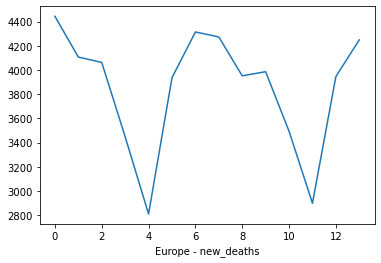

Input: [4487. 4295. 4097. 3403. 2695. 3796. 4473.], Predicted: 4438.440
Input: [4295.   4097.   3403.   2695.   3796.   4473.   4438.44], Predicted: 4188.910
Input: [4097.   3403.   2695.   3796.   4473.   4438.44 4188.91], Predicted: 4041.180
Input: [3403.   2695.   3796.   4473.   4438.44 4188.91 4041.18], Predicted: 3535.140
Input: [2695.   3796.   4473.   4438.44 4188.91 4041.18 3535.14], Predicted: 2847.270
Input: [3796.   4473.   4438.44 4188.91 4041.18 3535.14 2847.27], Predicted: 3948.080
Input: [4473.   4438.44 4188.91 4041.18 3535.14 2847.27 3948.08], Predicted: 4316.430
Input: [4438.44 4188.91 4041.18 3535.14 2847.27 3948.08 4316.43], Predicted: 4253.370
Input: [4188.91 4041.18 3535.14 2847.27 3948.08 4316.43 4253.37], Predicted: 4042.580
Input: [4041.18 3535.14 2847.27 3948.08 4316.43 4253.37 4042.58], Predicted: 3991.720
Input: [3535.14 2847.27 3948.08 4316.43 4253.37 4042.58 3991.72], Predicted: 3517.600
Input: [2847.27 3948.08 4316.43 4253.37 4042.58 3991.72 3517.6 ], Pr

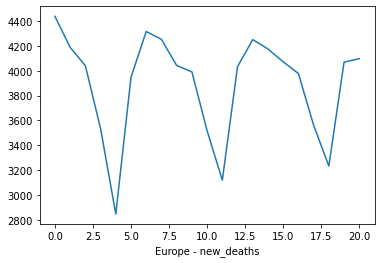

Input: [4487. 4295. 4097. 3403. 2695. 3796. 4473.], Predicted: 4488.270
Input: [4295.   4097.   3403.   2695.   3796.   4473.   4488.27], Predicted: 4146.970
Input: [4097.   3403.   2695.   3796.   4473.   4488.27 4146.97], Predicted: 4021.530
Input: [3403.   2695.   3796.   4473.   4488.27 4146.97 4021.53], Predicted: 3504.180
Input: [2695.   3796.   4473.   4488.27 4146.97 4021.53 3504.18], Predicted: 2799.720
Input: [3796.   4473.   4488.27 4146.97 4021.53 3504.18 2799.72], Predicted: 3871.500
Input: [4473.   4488.27 4146.97 4021.53 3504.18 2799.72 3871.5 ], Predicted: 4370.640
Input: [4488.27 4146.97 4021.53 3504.18 2799.72 3871.5  4370.64], Predicted: 4372.190
Input: [4146.97 4021.53 3504.18 2799.72 3871.5  4370.64 4372.19], Predicted: 4046.630
Input: [4021.53 3504.18 2799.72 3871.5  4370.64 4372.19 4046.63], Predicted: 3994.720
Input: [3504.18 2799.72 3871.5  4370.64 4372.19 4046.63 3994.72], Predicted: 3463.170
Input: [2799.72 3871.5  4370.64 4372.19 4046.63 3994.72 3463.17], Pr

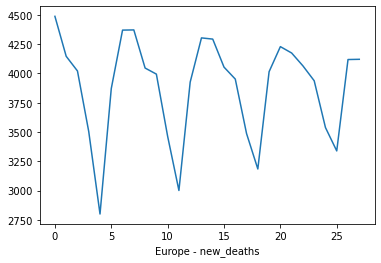

Input: [4487. 4295. 4097. 3403. 2695. 3796. 4473.], Predicted: 4400.410
Input: [4295.   4097.   3403.   2695.   3796.   4473.   4400.41], Predicted: 4113.420
Input: [4097.   3403.   2695.   3796.   4473.   4400.41 4113.42], Predicted: 4046.320
Input: [3403.   2695.   3796.   4473.   4400.41 4113.42 4046.32], Predicted: 3502.070
Input: [2695.   3796.   4473.   4400.41 4113.42 4046.32 3502.07], Predicted: 2797.590
Input: [3796.   4473.   4400.41 4113.42 4046.32 3502.07 2797.59], Predicted: 3930.130
Input: [4473.   4400.41 4113.42 4046.32 3502.07 2797.59 3930.13], Predicted: 4336.890
Input: [4400.41 4113.42 4046.32 3502.07 2797.59 3930.13 4336.89], Predicted: 4308.150
Input: [4113.42 4046.32 3502.07 2797.59 3930.13 4336.89 4308.15], Predicted: 4103.650
Input: [4046.32 3502.07 2797.59 3930.13 4336.89 4308.15 4103.65], Predicted: 4065.810
Input: [3502.07 2797.59 3930.13 4336.89 4308.15 4103.65 4065.81], Predicted: 3537.610
Input: [2797.59 3930.13 4336.89 4308.15 4103.65 4065.81 3537.61], Pr

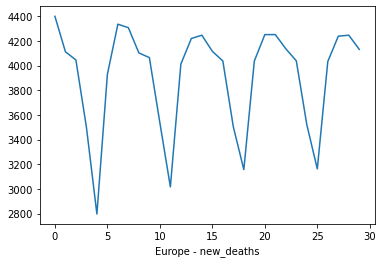

Input: [57579312. 57627691. 57688378. 57717923. 57752998. 57969883. 58091241.], Predicted: 58016228.410
Input: [57627691.   57688378.   57717923.   57752998.   57969883.   58091241.
 58016228.41], Predicted: 58016228.410
Input: [57688378.   57717923.   57752998.   57969883.   58091241.   58016228.41
 58016228.41], Predicted: 58016228.410
Input: [57717923.   57752998.   57969883.   58091241.   58016228.41 58016228.41
 58016228.41], Predicted: 58016228.410
Input: [57752998.   57969883.   58091241.   58016228.41 58016228.41 58016228.41
 58016228.41], Predicted: 58016228.410
Input: [57969883.   58091241.   58016228.41 58016228.41 58016228.41 58016228.41
 58016228.41], Predicted: 58016228.410
Input: [58091241.   58016228.41 58016228.41 58016228.41 58016228.41 58016228.41
 58016228.41], Predicted: 58016228.410
[58016228.41, 58016228.41, 58016228.41, 58016228.41, 58016228.41, 58016228.41, 58016228.41]


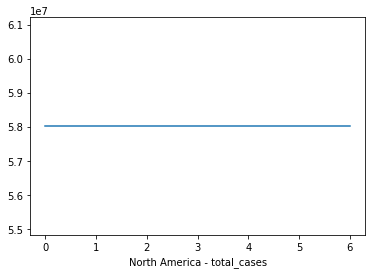

Input: [57579312. 57627691. 57688378. 57717923. 57752998. 57969883. 58091241.], Predicted: 58000963.100
Input: [57627691.  57688378.  57717923.  57752998.  57969883.  58091241.
 58000963.1], Predicted: 58000963.100
Input: [57688378.  57717923.  57752998.  57969883.  58091241.  58000963.1
 58000963.1], Predicted: 58000963.100
Input: [57717923.  57752998.  57969883.  58091241.  58000963.1 58000963.1
 58000963.1], Predicted: 58000963.100
Input: [57752998.  57969883.  58091241.  58000963.1 58000963.1 58000963.1
 58000963.1], Predicted: 58000963.100
Input: [57969883.  58091241.  58000963.1 58000963.1 58000963.1 58000963.1
 58000963.1], Predicted: 58000963.100
Input: [58091241.  58000963.1 58000963.1 58000963.1 58000963.1 58000963.1
 58000963.1], Predicted: 58000963.100
Input: [58000963.1 58000963.1 58000963.1 58000963.1 58000963.1 58000963.1
 58000963.1], Predicted: 58000963.100
Input: [58000963.1 58000963.1 58000963.1 58000963.1 58000963.1 58000963.1
 58000963.1], Predicted: 58000963.100
I

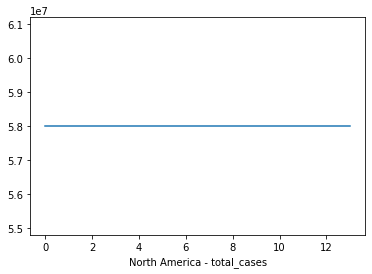

Input: [57579312. 57627691. 57688378. 57717923. 57752998. 57969883. 58091241.], Predicted: 58013377.160
Input: [57627691.   57688378.   57717923.   57752998.   57969883.   58091241.
 58013377.16], Predicted: 58013377.160
Input: [57688378.   57717923.   57752998.   57969883.   58091241.   58013377.16
 58013377.16], Predicted: 58013377.160
Input: [57717923.   57752998.   57969883.   58091241.   58013377.16 58013377.16
 58013377.16], Predicted: 58013377.160
Input: [57752998.   57969883.   58091241.   58013377.16 58013377.16 58013377.16
 58013377.16], Predicted: 58013377.160
Input: [57969883.   58091241.   58013377.16 58013377.16 58013377.16 58013377.16
 58013377.16], Predicted: 58013377.160
Input: [58091241.   58013377.16 58013377.16 58013377.16 58013377.16 58013377.16
 58013377.16], Predicted: 58013377.160
Input: [58013377.16 58013377.16 58013377.16 58013377.16 58013377.16 58013377.16
 58013377.16], Predicted: 58013377.160
Input: [58013377.16 58013377.16 58013377.16 58013377.16 58013377.

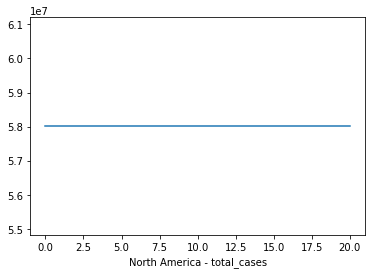

Input: [57579312. 57627691. 57688378. 57717923. 57752998. 57969883. 58091241.], Predicted: 58011901.980
Input: [57627691.   57688378.   57717923.   57752998.   57969883.   58091241.
 58011901.98], Predicted: 58011901.980
Input: [57688378.   57717923.   57752998.   57969883.   58091241.   58011901.98
 58011901.98], Predicted: 58011901.980
Input: [57717923.   57752998.   57969883.   58091241.   58011901.98 58011901.98
 58011901.98], Predicted: 58011901.980
Input: [57752998.   57969883.   58091241.   58011901.98 58011901.98 58011901.98
 58011901.98], Predicted: 58011901.980
Input: [57969883.   58091241.   58011901.98 58011901.98 58011901.98 58011901.98
 58011901.98], Predicted: 58011901.980
Input: [58091241.   58011901.98 58011901.98 58011901.98 58011901.98 58011901.98
 58011901.98], Predicted: 58011901.980
Input: [58011901.98 58011901.98 58011901.98 58011901.98 58011901.98 58011901.98
 58011901.98], Predicted: 58011901.980
Input: [58011901.98 58011901.98 58011901.98 58011901.98 58011901.

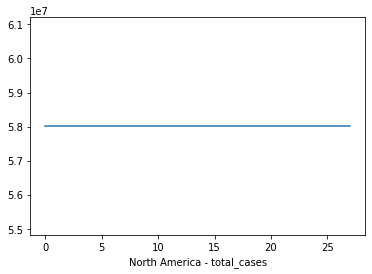

Input: [57579312. 57627691. 57688378. 57717923. 57752998. 57969883. 58091241.], Predicted: 57995153.350
Input: [57627691.   57688378.   57717923.   57752998.   57969883.   58091241.
 57995153.35], Predicted: 57995153.350
Input: [57688378.   57717923.   57752998.   57969883.   58091241.   57995153.35
 57995153.35], Predicted: 57995153.350
Input: [57717923.   57752998.   57969883.   58091241.   57995153.35 57995153.35
 57995153.35], Predicted: 57995153.350
Input: [57752998.   57969883.   58091241.   57995153.35 57995153.35 57995153.35
 57995153.35], Predicted: 57995153.350
Input: [57969883.   58091241.   57995153.35 57995153.35 57995153.35 57995153.35
 57995153.35], Predicted: 57995153.350
Input: [58091241.   57995153.35 57995153.35 57995153.35 57995153.35 57995153.35
 57995153.35], Predicted: 57995153.350
Input: [57995153.35 57995153.35 57995153.35 57995153.35 57995153.35 57995153.35
 57995153.35], Predicted: 57995153.350
Input: [57995153.35 57995153.35 57995153.35 57995153.35 57995153.

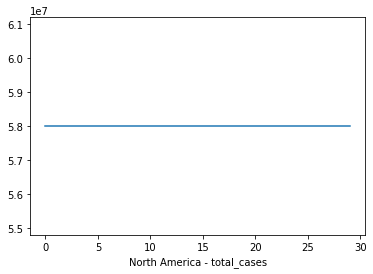

Input: [1162871. 1163920. 1164418. 1164681. 1165076. 1167220. 1168837.], Predicted: 1167931.610
Input: [1163920.   1164418.   1164681.   1165076.   1167220.   1168837.
 1167931.61], Predicted: 1167931.610
Input: [1164418.   1164681.   1165076.   1167220.   1168837.   1167931.61
 1167931.61], Predicted: 1167931.610
Input: [1164681.   1165076.   1167220.   1168837.   1167931.61 1167931.61
 1167931.61], Predicted: 1167931.610
Input: [1165076.   1167220.   1168837.   1167931.61 1167931.61 1167931.61
 1167931.61], Predicted: 1167931.610
Input: [1167220.   1168837.   1167931.61 1167931.61 1167931.61 1167931.61
 1167931.61], Predicted: 1167931.610
Input: [1168837.   1167931.61 1167931.61 1167931.61 1167931.61 1167931.61
 1167931.61], Predicted: 1167931.610
[1167931.61, 1167931.61, 1167931.61, 1167931.61, 1167931.61, 1167931.61, 1167931.61]


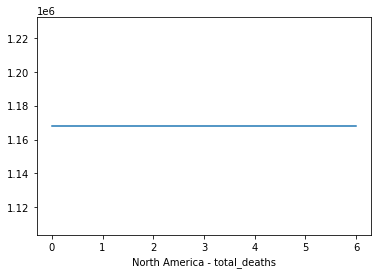

Input: [1162871. 1163920. 1164418. 1164681. 1165076. 1167220. 1168837.], Predicted: 1167968.260
Input: [1163920.   1164418.   1164681.   1165076.   1167220.   1168837.
 1167968.26], Predicted: 1167968.260
Input: [1164418.   1164681.   1165076.   1167220.   1168837.   1167968.26
 1167968.26], Predicted: 1167968.260
Input: [1164681.   1165076.   1167220.   1168837.   1167968.26 1167968.26
 1167968.26], Predicted: 1167968.260
Input: [1165076.   1167220.   1168837.   1167968.26 1167968.26 1167968.26
 1167968.26], Predicted: 1167968.260
Input: [1167220.   1168837.   1167968.26 1167968.26 1167968.26 1167968.26
 1167968.26], Predicted: 1167968.260
Input: [1168837.   1167968.26 1167968.26 1167968.26 1167968.26 1167968.26
 1167968.26], Predicted: 1167968.260
Input: [1167968.26 1167968.26 1167968.26 1167968.26 1167968.26 1167968.26
 1167968.26], Predicted: 1167968.260
Input: [1167968.26 1167968.26 1167968.26 1167968.26 1167968.26 1167968.26
 1167968.26], Predicted: 1167968.260
Input: [1167968.26

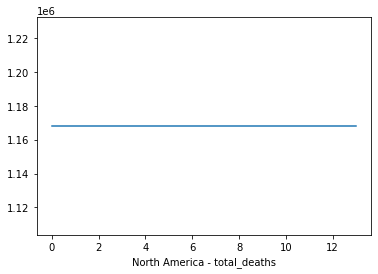

Input: [1162871. 1163920. 1164418. 1164681. 1165076. 1167220. 1168837.], Predicted: 1167862.810
Input: [1163920.   1164418.   1164681.   1165076.   1167220.   1168837.
 1167862.81], Predicted: 1167862.810
Input: [1164418.   1164681.   1165076.   1167220.   1168837.   1167862.81
 1167862.81], Predicted: 1167862.810
Input: [1164681.   1165076.   1167220.   1168837.   1167862.81 1167862.81
 1167862.81], Predicted: 1167862.810
Input: [1165076.   1167220.   1168837.   1167862.81 1167862.81 1167862.81
 1167862.81], Predicted: 1167862.810
Input: [1167220.   1168837.   1167862.81 1167862.81 1167862.81 1167862.81
 1167862.81], Predicted: 1167862.810
Input: [1168837.   1167862.81 1167862.81 1167862.81 1167862.81 1167862.81
 1167862.81], Predicted: 1167862.810
Input: [1167862.81 1167862.81 1167862.81 1167862.81 1167862.81 1167862.81
 1167862.81], Predicted: 1167862.810
Input: [1167862.81 1167862.81 1167862.81 1167862.81 1167862.81 1167862.81
 1167862.81], Predicted: 1167862.810
Input: [1167862.81

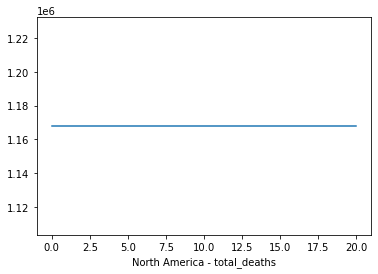

Input: [1162871. 1163920. 1164418. 1164681. 1165076. 1167220. 1168837.], Predicted: 1167884.170
Input: [1163920.   1164418.   1164681.   1165076.   1167220.   1168837.
 1167884.17], Predicted: 1167884.170
Input: [1164418.   1164681.   1165076.   1167220.   1168837.   1167884.17
 1167884.17], Predicted: 1167884.170
Input: [1164681.   1165076.   1167220.   1168837.   1167884.17 1167884.17
 1167884.17], Predicted: 1167884.170
Input: [1165076.   1167220.   1168837.   1167884.17 1167884.17 1167884.17
 1167884.17], Predicted: 1167884.170
Input: [1167220.   1168837.   1167884.17 1167884.17 1167884.17 1167884.17
 1167884.17], Predicted: 1167884.170
Input: [1168837.   1167884.17 1167884.17 1167884.17 1167884.17 1167884.17
 1167884.17], Predicted: 1167884.170
Input: [1167884.17 1167884.17 1167884.17 1167884.17 1167884.17 1167884.17
 1167884.17], Predicted: 1167884.170
Input: [1167884.17 1167884.17 1167884.17 1167884.17 1167884.17 1167884.17
 1167884.17], Predicted: 1167884.170
Input: [1167884.17

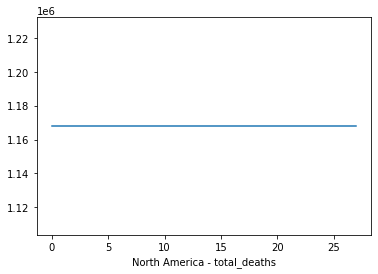

Input: [1162871. 1163920. 1164418. 1164681. 1165076. 1167220. 1168837.], Predicted: 1167997.020
Input: [1163920.   1164418.   1164681.   1165076.   1167220.   1168837.
 1167997.02], Predicted: 1167997.020
Input: [1164418.   1164681.   1165076.   1167220.   1168837.   1167997.02
 1167997.02], Predicted: 1167997.020
Input: [1164681.   1165076.   1167220.   1168837.   1167997.02 1167997.02
 1167997.02], Predicted: 1167997.020
Input: [1165076.   1167220.   1168837.   1167997.02 1167997.02 1167997.02
 1167997.02], Predicted: 1167997.020
Input: [1167220.   1168837.   1167997.02 1167997.02 1167997.02 1167997.02
 1167997.02], Predicted: 1167997.020
Input: [1168837.   1167997.02 1167997.02 1167997.02 1167997.02 1167997.02
 1167997.02], Predicted: 1167997.020
Input: [1167997.02 1167997.02 1167997.02 1167997.02 1167997.02 1167997.02
 1167997.02], Predicted: 1167997.020
Input: [1167997.02 1167997.02 1167997.02 1167997.02 1167997.02 1167997.02
 1167997.02], Predicted: 1167997.020
Input: [1167997.02

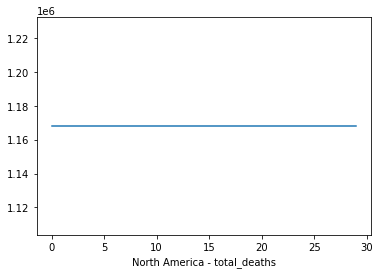

Input: [7.42174273e+08 7.42594005e+08 7.44168409e+08 7.45504052e+08
 7.46112662e+08 7.46748914e+08 7.47115313e+08], Predicted: 746755633.650
Input: [7.42594005e+08 7.44168409e+08 7.45504052e+08 7.46112662e+08
 7.46748914e+08 7.47115313e+08 7.46755634e+08], Predicted: 746755633.650
Input: [7.44168409e+08 7.45504052e+08 7.46112662e+08 7.46748914e+08
 7.47115313e+08 7.46755634e+08 7.46755634e+08], Predicted: 746755633.650
Input: [7.45504052e+08 7.46112662e+08 7.46748914e+08 7.47115313e+08
 7.46755634e+08 7.46755634e+08 7.46755634e+08], Predicted: 746755633.650
Input: [7.46112662e+08 7.46748914e+08 7.47115313e+08 7.46755634e+08
 7.46755634e+08 7.46755634e+08 7.46755634e+08], Predicted: 746755633.650
Input: [7.46748914e+08 7.47115313e+08 7.46755634e+08 7.46755634e+08
 7.46755634e+08 7.46755634e+08 7.46755634e+08], Predicted: 746755633.650
Input: [7.47115313e+08 7.46755634e+08 7.46755634e+08 7.46755634e+08
 7.46755634e+08 7.46755634e+08 7.46755634e+08], Predicted: 746755633.650
[746755633.65

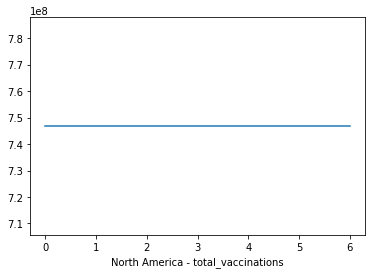

Input: [7.42174273e+08 7.42594005e+08 7.44168409e+08 7.45504052e+08
 7.46112662e+08 7.46748914e+08 7.47115313e+08], Predicted: 746799172.720
Input: [7.42594005e+08 7.44168409e+08 7.45504052e+08 7.46112662e+08
 7.46748914e+08 7.47115313e+08 7.46799173e+08], Predicted: 746799172.720
Input: [7.44168409e+08 7.45504052e+08 7.46112662e+08 7.46748914e+08
 7.47115313e+08 7.46799173e+08 7.46799173e+08], Predicted: 746799172.720
Input: [7.45504052e+08 7.46112662e+08 7.46748914e+08 7.47115313e+08
 7.46799173e+08 7.46799173e+08 7.46799173e+08], Predicted: 746799172.720
Input: [7.46112662e+08 7.46748914e+08 7.47115313e+08 7.46799173e+08
 7.46799173e+08 7.46799173e+08 7.46799173e+08], Predicted: 746799172.720
Input: [7.46748914e+08 7.47115313e+08 7.46799173e+08 7.46799173e+08
 7.46799173e+08 7.46799173e+08 7.46799173e+08], Predicted: 746799172.720
Input: [7.47115313e+08 7.46799173e+08 7.46799173e+08 7.46799173e+08
 7.46799173e+08 7.46799173e+08 7.46799173e+08], Predicted: 746799172.720
Input: [7.467

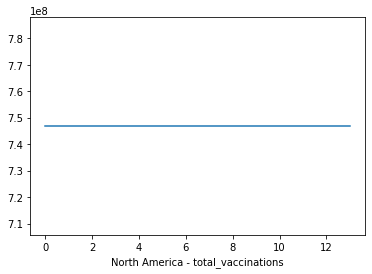

Input: [7.42174273e+08 7.42594005e+08 7.44168409e+08 7.45504052e+08
 7.46112662e+08 7.46748914e+08 7.47115313e+08], Predicted: 746944507.380
Input: [7.42594005e+08 7.44168409e+08 7.45504052e+08 7.46112662e+08
 7.46748914e+08 7.47115313e+08 7.46944507e+08], Predicted: 746944507.380
Input: [7.44168409e+08 7.45504052e+08 7.46112662e+08 7.46748914e+08
 7.47115313e+08 7.46944507e+08 7.46944507e+08], Predicted: 746944507.380
Input: [7.45504052e+08 7.46112662e+08 7.46748914e+08 7.47115313e+08
 7.46944507e+08 7.46944507e+08 7.46944507e+08], Predicted: 746944507.380
Input: [7.46112662e+08 7.46748914e+08 7.47115313e+08 7.46944507e+08
 7.46944507e+08 7.46944507e+08 7.46944507e+08], Predicted: 746944507.380
Input: [7.46748914e+08 7.47115313e+08 7.46944507e+08 7.46944507e+08
 7.46944507e+08 7.46944507e+08 7.46944507e+08], Predicted: 746944507.380
Input: [7.47115313e+08 7.46944507e+08 7.46944507e+08 7.46944507e+08
 7.46944507e+08 7.46944507e+08 7.46944507e+08], Predicted: 746944507.380
Input: [7.469

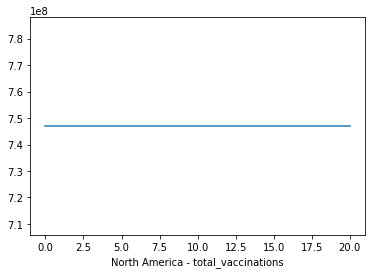

Input: [7.42174273e+08 7.42594005e+08 7.44168409e+08 7.45504052e+08
 7.46112662e+08 7.46748914e+08 7.47115313e+08], Predicted: 746849950.260
Input: [7.42594005e+08 7.44168409e+08 7.45504052e+08 7.46112662e+08
 7.46748914e+08 7.47115313e+08 7.46849950e+08], Predicted: 746849950.260
Input: [7.44168409e+08 7.45504052e+08 7.46112662e+08 7.46748914e+08
 7.47115313e+08 7.46849950e+08 7.46849950e+08], Predicted: 746849950.260
Input: [7.45504052e+08 7.46112662e+08 7.46748914e+08 7.47115313e+08
 7.46849950e+08 7.46849950e+08 7.46849950e+08], Predicted: 746849950.260
Input: [7.46112662e+08 7.46748914e+08 7.47115313e+08 7.46849950e+08
 7.46849950e+08 7.46849950e+08 7.46849950e+08], Predicted: 746849950.260
Input: [7.46748914e+08 7.47115313e+08 7.46849950e+08 7.46849950e+08
 7.46849950e+08 7.46849950e+08 7.46849950e+08], Predicted: 746849950.260
Input: [7.47115313e+08 7.46849950e+08 7.46849950e+08 7.46849950e+08
 7.46849950e+08 7.46849950e+08 7.46849950e+08], Predicted: 746849950.260
Input: [7.468

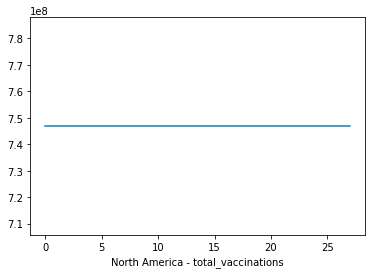

Input: [7.42174273e+08 7.42594005e+08 7.44168409e+08 7.45504052e+08
 7.46112662e+08 7.46748914e+08 7.47115313e+08], Predicted: 746854487.560
Input: [7.42594005e+08 7.44168409e+08 7.45504052e+08 7.46112662e+08
 7.46748914e+08 7.47115313e+08 7.46854488e+08], Predicted: 746854487.560
Input: [7.44168409e+08 7.45504052e+08 7.46112662e+08 7.46748914e+08
 7.47115313e+08 7.46854488e+08 7.46854488e+08], Predicted: 746854487.560
Input: [7.45504052e+08 7.46112662e+08 7.46748914e+08 7.47115313e+08
 7.46854488e+08 7.46854488e+08 7.46854488e+08], Predicted: 746854487.560
Input: [7.46112662e+08 7.46748914e+08 7.47115313e+08 7.46854488e+08
 7.46854488e+08 7.46854488e+08 7.46854488e+08], Predicted: 746854487.560
Input: [7.46748914e+08 7.47115313e+08 7.46854488e+08 7.46854488e+08
 7.46854488e+08 7.46854488e+08 7.46854488e+08], Predicted: 746854487.560
Input: [7.47115313e+08 7.46854488e+08 7.46854488e+08 7.46854488e+08
 7.46854488e+08 7.46854488e+08 7.46854488e+08], Predicted: 746854487.560
Input: [7.468

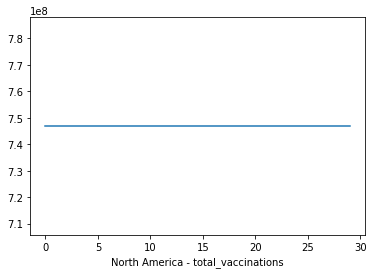

Input: [3.25199417e+08 3.25392785e+08 3.25667037e+08 3.26074429e+08
 3.26264818e+08 3.26483693e+08 3.26579143e+08], Predicted: 326526336.940
Input: [3.25392785e+08 3.25667037e+08 3.26074429e+08 3.26264818e+08
 3.26483693e+08 3.26579143e+08 3.26526337e+08], Predicted: 326526336.940
Input: [3.25667037e+08 3.26074429e+08 3.26264818e+08 3.26483693e+08
 3.26579143e+08 3.26526337e+08 3.26526337e+08], Predicted: 326526336.940
Input: [3.26074429e+08 3.26264818e+08 3.26483693e+08 3.26579143e+08
 3.26526337e+08 3.26526337e+08 3.26526337e+08], Predicted: 326526336.940
Input: [3.26264818e+08 3.26483693e+08 3.26579143e+08 3.26526337e+08
 3.26526337e+08 3.26526337e+08 3.26526337e+08], Predicted: 326526336.940
Input: [3.26483693e+08 3.26579143e+08 3.26526337e+08 3.26526337e+08
 3.26526337e+08 3.26526337e+08 3.26526337e+08], Predicted: 326526336.940
Input: [3.26579143e+08 3.26526337e+08 3.26526337e+08 3.26526337e+08
 3.26526337e+08 3.26526337e+08 3.26526337e+08], Predicted: 326526336.940
[326526336.94

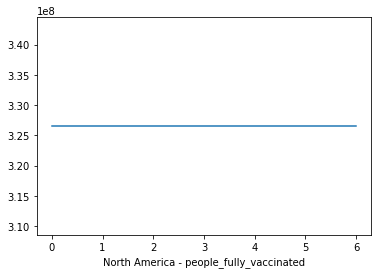

Input: [3.25199417e+08 3.25392785e+08 3.25667037e+08 3.26074429e+08
 3.26264818e+08 3.26483693e+08 3.26579143e+08], Predicted: 326471755.500
Input: [3.25392785e+08 3.25667037e+08 3.26074429e+08 3.26264818e+08
 3.26483693e+08 3.26579143e+08 3.26471756e+08], Predicted: 326471755.500
Input: [3.25667037e+08 3.26074429e+08 3.26264818e+08 3.26483693e+08
 3.26579143e+08 3.26471756e+08 3.26471756e+08], Predicted: 326471755.500
Input: [3.26074429e+08 3.26264818e+08 3.26483693e+08 3.26579143e+08
 3.26471756e+08 3.26471756e+08 3.26471756e+08], Predicted: 326471755.500
Input: [3.26264818e+08 3.26483693e+08 3.26579143e+08 3.26471756e+08
 3.26471756e+08 3.26471756e+08 3.26471756e+08], Predicted: 326471755.500
Input: [3.26483693e+08 3.26579143e+08 3.26471756e+08 3.26471756e+08
 3.26471756e+08 3.26471756e+08 3.26471756e+08], Predicted: 326471755.500
Input: [3.26579143e+08 3.26471756e+08 3.26471756e+08 3.26471756e+08
 3.26471756e+08 3.26471756e+08 3.26471756e+08], Predicted: 326471755.500
Input: [3.264

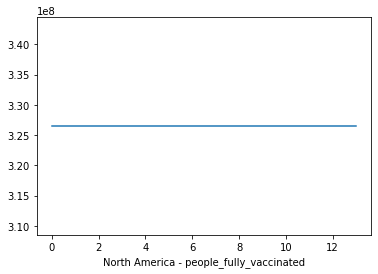

Input: [3.25199417e+08 3.25392785e+08 3.25667037e+08 3.26074429e+08
 3.26264818e+08 3.26483693e+08 3.26579143e+08], Predicted: 326472252.260
Input: [3.25392785e+08 3.25667037e+08 3.26074429e+08 3.26264818e+08
 3.26483693e+08 3.26579143e+08 3.26472252e+08], Predicted: 326472252.260
Input: [3.25667037e+08 3.26074429e+08 3.26264818e+08 3.26483693e+08
 3.26579143e+08 3.26472252e+08 3.26472252e+08], Predicted: 326472252.260
Input: [3.26074429e+08 3.26264818e+08 3.26483693e+08 3.26579143e+08
 3.26472252e+08 3.26472252e+08 3.26472252e+08], Predicted: 326472252.260
Input: [3.26264818e+08 3.26483693e+08 3.26579143e+08 3.26472252e+08
 3.26472252e+08 3.26472252e+08 3.26472252e+08], Predicted: 326472252.260
Input: [3.26483693e+08 3.26579143e+08 3.26472252e+08 3.26472252e+08
 3.26472252e+08 3.26472252e+08 3.26472252e+08], Predicted: 326472252.260
Input: [3.26579143e+08 3.26472252e+08 3.26472252e+08 3.26472252e+08
 3.26472252e+08 3.26472252e+08 3.26472252e+08], Predicted: 326472252.260
Input: [3.264

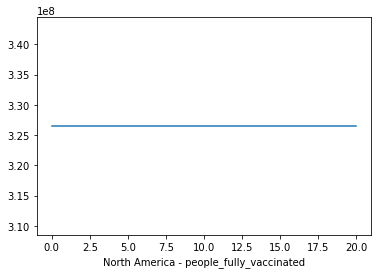

Input: [3.25199417e+08 3.25392785e+08 3.25667037e+08 3.26074429e+08
 3.26264818e+08 3.26483693e+08 3.26579143e+08], Predicted: 326516646.780
Input: [3.25392785e+08 3.25667037e+08 3.26074429e+08 3.26264818e+08
 3.26483693e+08 3.26579143e+08 3.26516647e+08], Predicted: 326516646.780
Input: [3.25667037e+08 3.26074429e+08 3.26264818e+08 3.26483693e+08
 3.26579143e+08 3.26516647e+08 3.26516647e+08], Predicted: 326516646.780
Input: [3.26074429e+08 3.26264818e+08 3.26483693e+08 3.26579143e+08
 3.26516647e+08 3.26516647e+08 3.26516647e+08], Predicted: 326516646.780
Input: [3.26264818e+08 3.26483693e+08 3.26579143e+08 3.26516647e+08
 3.26516647e+08 3.26516647e+08 3.26516647e+08], Predicted: 326516646.780
Input: [3.26483693e+08 3.26579143e+08 3.26516647e+08 3.26516647e+08
 3.26516647e+08 3.26516647e+08 3.26516647e+08], Predicted: 326516646.780
Input: [3.26579143e+08 3.26516647e+08 3.26516647e+08 3.26516647e+08
 3.26516647e+08 3.26516647e+08 3.26516647e+08], Predicted: 326516646.780
Input: [3.265

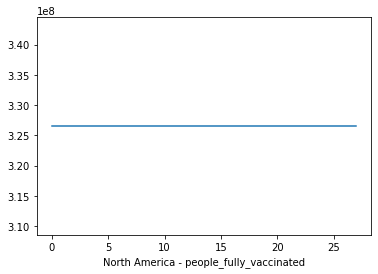

Input: [3.25199417e+08 3.25392785e+08 3.25667037e+08 3.26074429e+08
 3.26264818e+08 3.26483693e+08 3.26579143e+08], Predicted: 326457480.800
Input: [3.25392785e+08 3.25667037e+08 3.26074429e+08 3.26264818e+08
 3.26483693e+08 3.26579143e+08 3.26457481e+08], Predicted: 326457480.800
Input: [3.25667037e+08 3.26074429e+08 3.26264818e+08 3.26483693e+08
 3.26579143e+08 3.26457481e+08 3.26457481e+08], Predicted: 326457480.800
Input: [3.26074429e+08 3.26264818e+08 3.26483693e+08 3.26579143e+08
 3.26457481e+08 3.26457481e+08 3.26457481e+08], Predicted: 326457480.800
Input: [3.26264818e+08 3.26483693e+08 3.26579143e+08 3.26457481e+08
 3.26457481e+08 3.26457481e+08 3.26457481e+08], Predicted: 326457480.800
Input: [3.26483693e+08 3.26579143e+08 3.26457481e+08 3.26457481e+08
 3.26457481e+08 3.26457481e+08 3.26457481e+08], Predicted: 326457480.800
Input: [3.26579143e+08 3.26457481e+08 3.26457481e+08 3.26457481e+08
 3.26457481e+08 3.26457481e+08 3.26457481e+08], Predicted: 326457480.800
Input: [3.264

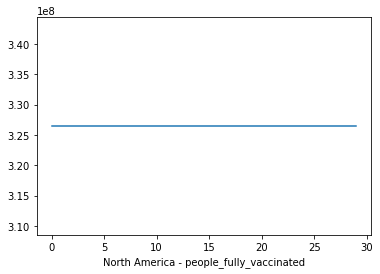

Input: [120991.  48379.  60687.  29545.  35075. 216885. 121358.], Predicted: 103555.690
Input: [ 48379.    60687.    29545.    35075.   216885.   121358.   103555.69], Predicted: 56047.050
Input: [ 60687.    29545.    35075.   216885.   121358.   103555.69  56047.05], Predicted: 57692.620
Input: [ 29545.    35075.   216885.   121358.   103555.69  56047.05  57692.62], Predicted: 38113.880
Input: [ 35075.   216885.   121358.   103555.69  56047.05  57692.62  38113.88], Predicted: 30630.580
Input: [216885.   121358.   103555.69  56047.05  57692.62  38113.88  30630.58], Predicted: 209717.890
Input: [121358.   103555.69  56047.05  57692.62  38113.88  30630.58 209717.89], Predicted: 118552.870
[103555.69, 56047.05, 57692.62, 38113.88, 30630.58, 209717.89, 118552.87]


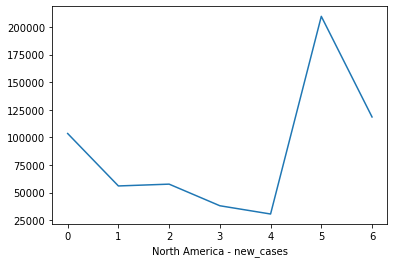

Input: [120991.  48379.  60687.  29545.  35075. 216885. 121358.], Predicted: 107277.580
Input: [ 48379.    60687.    29545.    35075.   216885.   121358.   107277.58], Predicted: 53912.660
Input: [ 60687.    29545.    35075.   216885.   121358.   107277.58  53912.66], Predicted: 52982.710
Input: [ 29545.    35075.   216885.   121358.   107277.58  53912.66  52982.71], Predicted: 37542.510
Input: [ 35075.   216885.   121358.   107277.58  53912.66  52982.71  37542.51], Predicted: 32323.480
Input: [216885.   121358.   107277.58  53912.66  52982.71  37542.51  32323.48], Predicted: 213541.340
Input: [121358.   107277.58  53912.66  52982.71  37542.51  32323.48 213541.34], Predicted: 112460.100
Input: [107277.58  53912.66  52982.71  37542.51  32323.48 213541.34 112460.1 ], Predicted: 107189.670
Input: [ 53912.66  52982.71  37542.51  32323.48 213541.34 112460.1  107189.67], Predicted: 57764.990
Input: [ 52982.71  37542.51  32323.48 213541.34 112460.1  107189.67  57764.99], Predicted: 48793.000


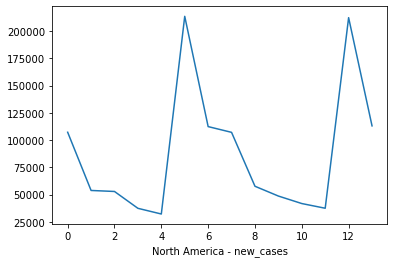

Input: [120991.  48379.  60687.  29545.  35075. 216885. 121358.], Predicted: 108019.080
Input: [ 48379.    60687.    29545.    35075.   216885.   121358.   108019.08], Predicted: 57099.250
Input: [ 60687.    29545.    35075.   216885.   121358.   108019.08  57099.25], Predicted: 55603.060
Input: [ 29545.    35075.   216885.   121358.   108019.08  57099.25  55603.06], Predicted: 37897.520
Input: [ 35075.   216885.   121358.   108019.08  57099.25  55603.06  37897.52], Predicted: 32340.670
Input: [216885.   121358.   108019.08  57099.25  55603.06  37897.52  32340.67], Predicted: 202851.500
Input: [121358.   108019.08  57099.25  55603.06  37897.52  32340.67 202851.5 ], Predicted: 120459.410
Input: [108019.08  57099.25  55603.06  37897.52  32340.67 202851.5  120459.41], Predicted: 105301.160
Input: [ 57099.25  55603.06  37897.52  32340.67 202851.5  120459.41 105301.16], Predicted: 69103.890
Input: [ 55603.06  37897.52  32340.67 202851.5  120459.41 105301.16  69103.89], Predicted: 51308.160


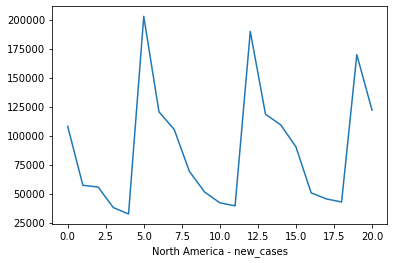

Input: [120991.  48379.  60687.  29545.  35075. 216885. 121358.], Predicted: 111108.740
Input: [ 48379.    60687.    29545.    35075.   216885.   121358.   111108.74], Predicted: 56853.190
Input: [ 60687.    29545.    35075.   216885.   121358.   111108.74  56853.19], Predicted: 55560.140
Input: [ 29545.    35075.   216885.   121358.   111108.74  56853.19  55560.14], Predicted: 36873.030
Input: [ 35075.   216885.   121358.   111108.74  56853.19  55560.14  36873.03], Predicted: 34479.150
Input: [216885.   121358.   111108.74  56853.19  55560.14  36873.03  34479.15], Predicted: 215199.230
Input: [121358.   111108.74  56853.19  55560.14  36873.03  34479.15 215199.23], Predicted: 115959.120
Input: [111108.74  56853.19  55560.14  36873.03  34479.15 215199.23 115959.12], Predicted: 109033.530
Input: [ 56853.19  55560.14  36873.03  34479.15 215199.23 115959.12 109033.53], Predicted: 70107.390
Input: [ 55560.14  36873.03  34479.15 215199.23 115959.12 109033.53  70107.39], Predicted: 52156.050


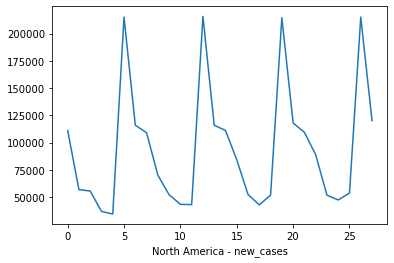

Input: [120991.  48379.  60687.  29545.  35075. 216885. 121358.], Predicted: 104111.860
Input: [ 48379.    60687.    29545.    35075.   216885.   121358.   104111.86], Predicted: 58732.650
Input: [ 60687.    29545.    35075.   216885.   121358.   104111.86  58732.65], Predicted: 54849.770
Input: [ 29545.    35075.   216885.   121358.   104111.86  58732.65  54849.77], Predicted: 38314.590
Input: [ 35075.   216885.   121358.   104111.86  58732.65  54849.77  38314.59], Predicted: 32285.790
Input: [216885.   121358.   104111.86  58732.65  54849.77  38314.59  32285.79], Predicted: 219739.360
Input: [121358.   104111.86  58732.65  54849.77  38314.59  32285.79 219739.36], Predicted: 120301.150
Input: [104111.86  58732.65  54849.77  38314.59  32285.79 219739.36 120301.15], Predicted: 104324.390
Input: [ 58732.65  54849.77  38314.59  32285.79 219739.36 120301.15 104324.39], Predicted: 71781.200
Input: [ 54849.77  38314.59  32285.79 219739.36 120301.15 104324.39  71781.2 ], Predicted: 52906.030


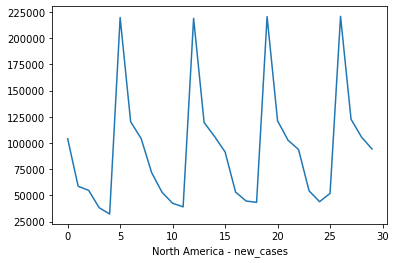

Input: [2078. 1049.  498.  263.  395. 2144. 1617.], Predicted: 1989.230
Input: [1049.    498.    263.    395.   2144.   1617.   1989.23], Predicted: 1416.220
Input: [ 498.    263.    395.   2144.   1617.   1989.23 1416.22], Predicted: 775.480
Input: [ 263.    395.   2144.   1617.   1989.23 1416.22  775.48], Predicted: 357.740
Input: [ 395.   2144.   1617.   1989.23 1416.22  775.48  357.74], Predicted: 437.620
Input: [2144.   1617.   1989.23 1416.22  775.48  357.74  437.62], Predicted: 1759.410
Input: [1617.   1989.23 1416.22  775.48  357.74  437.62 1759.41], Predicted: 1868.730
[1989.23, 1416.22, 775.48, 357.74, 437.62, 1759.41, 1868.73]


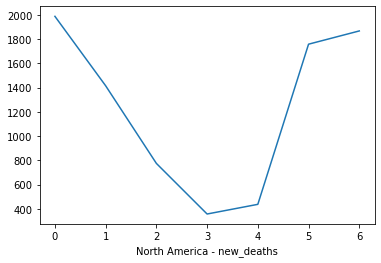

Input: [2078. 1049.  498.  263.  395. 2144. 1617.], Predicted: 1934.970
Input: [1049.    498.    263.    395.   2144.   1617.   1934.97], Predicted: 1387.770
Input: [ 498.    263.    395.   2144.   1617.   1934.97 1387.77], Predicted: 744.300
Input: [ 263.    395.   2144.   1617.   1934.97 1387.77  744.3 ], Predicted: 407.200
Input: [ 395.   2144.   1617.   1934.97 1387.77  744.3   407.2 ], Predicted: 453.380
Input: [2144.   1617.   1934.97 1387.77  744.3   407.2   453.38], Predicted: 1697.860
Input: [1617.   1934.97 1387.77  744.3   407.2   453.38 1697.86], Predicted: 1924.210
Input: [1934.97 1387.77  744.3   407.2   453.38 1697.86 1924.21], Predicted: 1845.990
Input: [1387.77  744.3   407.2   453.38 1697.86 1924.21 1845.99], Predicted: 1531.760
Input: [ 744.3   407.2   453.38 1697.86 1924.21 1845.99 1531.76], Predicted: 1290.520
Input: [ 407.2   453.38 1697.86 1924.21 1845.99 1531.76 1290.52], Predicted: 500.300
Input: [ 453.38 1697.86 1924.21 1845.99 1531.76 1290.52  500.3 ], Predic

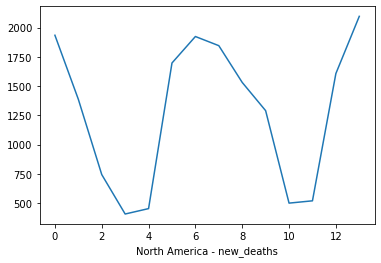

Input: [2078. 1049.  498.  263.  395. 2144. 1617.], Predicted: 1948.670
Input: [1049.    498.    263.    395.   2144.   1617.   1948.67], Predicted: 1371.720
Input: [ 498.    263.    395.   2144.   1617.   1948.67 1371.72], Predicted: 789.690
Input: [ 263.    395.   2144.   1617.   1948.67 1371.72  789.69], Predicted: 379.950
Input: [ 395.   2144.   1617.   1948.67 1371.72  789.69  379.95], Predicted: 486.660
Input: [2144.   1617.   1948.67 1371.72  789.69  379.95  486.66], Predicted: 1753.830
Input: [1617.   1948.67 1371.72  789.69  379.95  486.66 1753.83], Predicted: 1970.470
Input: [1948.67 1371.72  789.69  379.95  486.66 1753.83 1970.47], Predicted: 1867.150
Input: [1371.72  789.69  379.95  486.66 1753.83 1970.47 1867.15], Predicted: 1553.920
Input: [ 789.69  379.95  486.66 1753.83 1970.47 1867.15 1553.92], Predicted: 1146.420
Input: [ 379.95  486.66 1753.83 1970.47 1867.15 1553.92 1146.42], Predicted: 491.010
Input: [ 486.66 1753.83 1970.47 1867.15 1553.92 1146.42  491.01], Predic

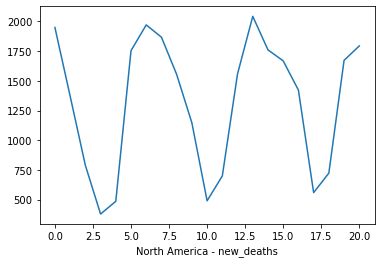

Input: [2078. 1049.  498.  263.  395. 2144. 1617.], Predicted: 1925.280
Input: [1049.    498.    263.    395.   2144.   1617.   1925.28], Predicted: 1376.710
Input: [ 498.    263.    395.   2144.   1617.   1925.28 1376.71], Predicted: 773.040
Input: [ 263.    395.   2144.   1617.   1925.28 1376.71  773.04], Predicted: 365.570
Input: [ 395.   2144.   1617.   1925.28 1376.71  773.04  365.57], Predicted: 416.270
Input: [2144.   1617.   1925.28 1376.71  773.04  365.57  416.27], Predicted: 1678.330
Input: [1617.   1925.28 1376.71  773.04  365.57  416.27 1678.33], Predicted: 1871.360
Input: [1925.28 1376.71  773.04  365.57  416.27 1678.33 1871.36], Predicted: 1815.960
Input: [1376.71  773.04  365.57  416.27 1678.33 1871.36 1815.96], Predicted: 1424.570
Input: [ 773.04  365.57  416.27 1678.33 1871.36 1815.96 1424.57], Predicted: 1089.040
Input: [ 365.57  416.27 1678.33 1871.36 1815.96 1424.57 1089.04], Predicted: 473.950
Input: [ 416.27 1678.33 1871.36 1815.96 1424.57 1089.04  473.95], Predic

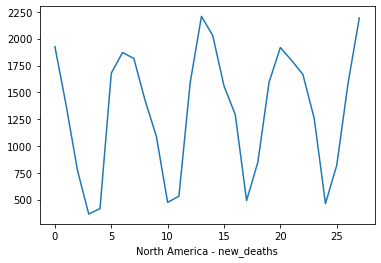

Input: [2078. 1049.  498.  263.  395. 2144. 1617.], Predicted: 1897.130
Input: [1049.    498.    263.    395.   2144.   1617.   1897.13], Predicted: 1356.480
Input: [ 498.    263.    395.   2144.   1617.   1897.13 1356.48], Predicted: 706.950
Input: [ 263.    395.   2144.   1617.   1897.13 1356.48  706.95], Predicted: 366.370
Input: [ 395.   2144.   1617.   1897.13 1356.48  706.95  366.37], Predicted: 412.970
Input: [2144.   1617.   1897.13 1356.48  706.95  366.37  412.97], Predicted: 1709.430
Input: [1617.   1897.13 1356.48  706.95  366.37  412.97 1709.43], Predicted: 1703.380
Input: [1897.13 1356.48  706.95  366.37  412.97 1709.43 1703.38], Predicted: 1655.120
Input: [1356.48  706.95  366.37  412.97 1709.43 1703.38 1655.12], Predicted: 1300.380
Input: [ 706.95  366.37  412.97 1709.43 1703.38 1655.12 1300.38], Predicted: 785.250
Input: [ 366.37  412.97 1709.43 1703.38 1655.12 1300.38  785.25], Predicted: 368.360
Input: [ 412.97 1709.43 1703.38 1655.12 1300.38  785.25  368.36], Predict

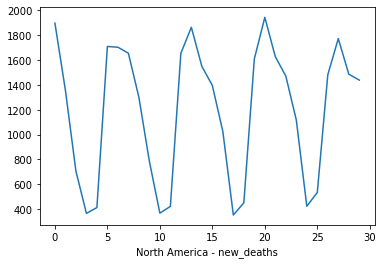

Input: [301658. 303601. 305309. 306690. 308152. 309456. 311109.], Predicted: 310335.880
Input: [303601.   305309.   306690.   308152.   309456.   311109.   310335.88], Predicted: 310335.880
Input: [305309.   306690.   308152.   309456.   311109.   310335.88 310335.88], Predicted: 310335.880
Input: [306690.   308152.   309456.   311109.   310335.88 310335.88 310335.88], Predicted: 310335.880
Input: [308152.   309456.   311109.   310335.88 310335.88 310335.88 310335.88], Predicted: 310335.880
Input: [309456.   311109.   310335.88 310335.88 310335.88 310335.88 310335.88], Predicted: 310335.880
Input: [311109.   310335.88 310335.88 310335.88 310335.88 310335.88 310335.88], Predicted: 310335.880
[310335.88, 310335.88, 310335.88, 310335.88, 310335.88, 310335.88, 310335.88]


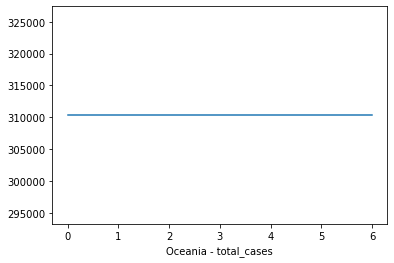

Input: [301658. 303601. 305309. 306690. 308152. 309456. 311109.], Predicted: 310353.950
Input: [303601.   305309.   306690.   308152.   309456.   311109.   310353.95], Predicted: 310353.950
Input: [305309.   306690.   308152.   309456.   311109.   310353.95 310353.95], Predicted: 310353.950
Input: [306690.   308152.   309456.   311109.   310353.95 310353.95 310353.95], Predicted: 310353.950
Input: [308152.   309456.   311109.   310353.95 310353.95 310353.95 310353.95], Predicted: 310353.950
Input: [309456.   311109.   310353.95 310353.95 310353.95 310353.95 310353.95], Predicted: 310353.950
Input: [311109.   310353.95 310353.95 310353.95 310353.95 310353.95 310353.95], Predicted: 310353.950
Input: [310353.95 310353.95 310353.95 310353.95 310353.95 310353.95 310353.95], Predicted: 310353.950
Input: [310353.95 310353.95 310353.95 310353.95 310353.95 310353.95 310353.95], Predicted: 310353.950
Input: [310353.95 310353.95 310353.95 310353.95 310353.95 310353.95 310353.95], Predicted: 31035

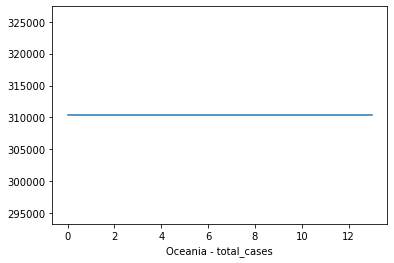

Input: [301658. 303601. 305309. 306690. 308152. 309456. 311109.], Predicted: 310248.860
Input: [303601.   305309.   306690.   308152.   309456.   311109.   310248.86], Predicted: 310248.860
Input: [305309.   306690.   308152.   309456.   311109.   310248.86 310248.86], Predicted: 310248.860
Input: [306690.   308152.   309456.   311109.   310248.86 310248.86 310248.86], Predicted: 310248.860
Input: [308152.   309456.   311109.   310248.86 310248.86 310248.86 310248.86], Predicted: 310248.860
Input: [309456.   311109.   310248.86 310248.86 310248.86 310248.86 310248.86], Predicted: 310248.860
Input: [311109.   310248.86 310248.86 310248.86 310248.86 310248.86 310248.86], Predicted: 310248.860
Input: [310248.86 310248.86 310248.86 310248.86 310248.86 310248.86 310248.86], Predicted: 310248.860
Input: [310248.86 310248.86 310248.86 310248.86 310248.86 310248.86 310248.86], Predicted: 310248.860
Input: [310248.86 310248.86 310248.86 310248.86 310248.86 310248.86 310248.86], Predicted: 31024

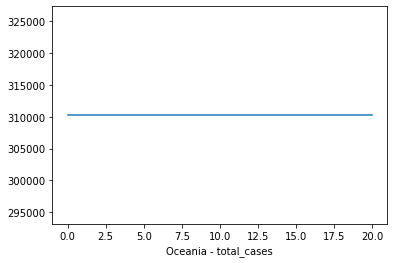

Input: [301658. 303601. 305309. 306690. 308152. 309456. 311109.], Predicted: 309881.640
Input: [303601.   305309.   306690.   308152.   309456.   311109.   309881.64], Predicted: 309881.640
Input: [305309.   306690.   308152.   309456.   311109.   309881.64 309881.64], Predicted: 309881.640
Input: [306690.   308152.   309456.   311109.   309881.64 309881.64 309881.64], Predicted: 309881.640
Input: [308152.   309456.   311109.   309881.64 309881.64 309881.64 309881.64], Predicted: 309881.640
Input: [309456.   311109.   309881.64 309881.64 309881.64 309881.64 309881.64], Predicted: 309881.640
Input: [311109.   309881.64 309881.64 309881.64 309881.64 309881.64 309881.64], Predicted: 309881.640
Input: [309881.64 309881.64 309881.64 309881.64 309881.64 309881.64 309881.64], Predicted: 309881.640
Input: [309881.64 309881.64 309881.64 309881.64 309881.64 309881.64 309881.64], Predicted: 309881.640
Input: [309881.64 309881.64 309881.64 309881.64 309881.64 309881.64 309881.64], Predicted: 30988

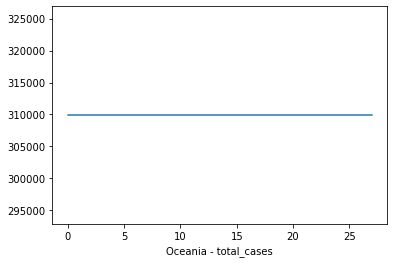

Input: [301658. 303601. 305309. 306690. 308152. 309456. 311109.], Predicted: 310371.550
Input: [303601.   305309.   306690.   308152.   309456.   311109.   310371.55], Predicted: 310371.550
Input: [305309.   306690.   308152.   309456.   311109.   310371.55 310371.55], Predicted: 310371.550
Input: [306690.   308152.   309456.   311109.   310371.55 310371.55 310371.55], Predicted: 310371.550
Input: [308152.   309456.   311109.   310371.55 310371.55 310371.55 310371.55], Predicted: 310371.550
Input: [309456.   311109.   310371.55 310371.55 310371.55 310371.55 310371.55], Predicted: 310371.550
Input: [311109.   310371.55 310371.55 310371.55 310371.55 310371.55 310371.55], Predicted: 310371.550
Input: [310371.55 310371.55 310371.55 310371.55 310371.55 310371.55 310371.55], Predicted: 310371.550
Input: [310371.55 310371.55 310371.55 310371.55 310371.55 310371.55 310371.55], Predicted: 310371.550
Input: [310371.55 310371.55 310371.55 310371.55 310371.55 310371.55 310371.55], Predicted: 31037

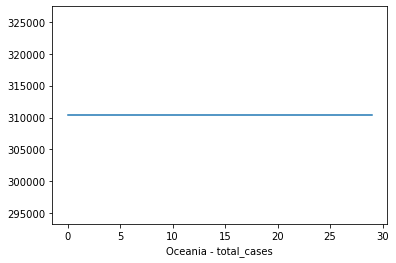

Input: [3257. 3265. 3271. 3276. 3282. 3292. 3298.], Predicted: 3294.000
Input: [3265. 3271. 3276. 3282. 3292. 3298. 3294.], Predicted: 3294.000
Input: [3271. 3276. 3282. 3292. 3298. 3294. 3294.], Predicted: 3294.000
Input: [3276. 3282. 3292. 3298. 3294. 3294. 3294.], Predicted: 3294.000
Input: [3282. 3292. 3298. 3294. 3294. 3294. 3294.], Predicted: 3294.000
Input: [3292. 3298. 3294. 3294. 3294. 3294. 3294.], Predicted: 3294.000
Input: [3298. 3294. 3294. 3294. 3294. 3294. 3294.], Predicted: 3294.000
[3294.0, 3294.0, 3294.0, 3294.0, 3294.0, 3294.0, 3294.0]


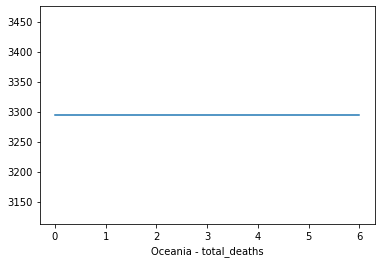

Input: [3257. 3265. 3271. 3276. 3282. 3292. 3298.], Predicted: 3293.350
Input: [3265.   3271.   3276.   3282.   3292.   3298.   3293.35], Predicted: 3293.350
Input: [3271.   3276.   3282.   3292.   3298.   3293.35 3293.35], Predicted: 3293.350
Input: [3276.   3282.   3292.   3298.   3293.35 3293.35 3293.35], Predicted: 3293.350
Input: [3282.   3292.   3298.   3293.35 3293.35 3293.35 3293.35], Predicted: 3293.350
Input: [3292.   3298.   3293.35 3293.35 3293.35 3293.35 3293.35], Predicted: 3293.350
Input: [3298.   3293.35 3293.35 3293.35 3293.35 3293.35 3293.35], Predicted: 3293.350
Input: [3293.35 3293.35 3293.35 3293.35 3293.35 3293.35 3293.35], Predicted: 3293.350
Input: [3293.35 3293.35 3293.35 3293.35 3293.35 3293.35 3293.35], Predicted: 3293.350
Input: [3293.35 3293.35 3293.35 3293.35 3293.35 3293.35 3293.35], Predicted: 3293.350
Input: [3293.35 3293.35 3293.35 3293.35 3293.35 3293.35 3293.35], Predicted: 3293.350
Input: [3293.35 3293.35 3293.35 3293.35 3293.35 3293.35 3293.35], Pr

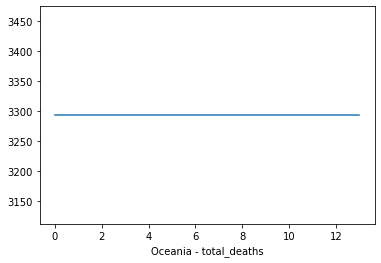

Input: [3257. 3265. 3271. 3276. 3282. 3292. 3298.], Predicted: 3293.820
Input: [3265.   3271.   3276.   3282.   3292.   3298.   3293.82], Predicted: 3293.820
Input: [3271.   3276.   3282.   3292.   3298.   3293.82 3293.82], Predicted: 3293.820
Input: [3276.   3282.   3292.   3298.   3293.82 3293.82 3293.82], Predicted: 3293.820
Input: [3282.   3292.   3298.   3293.82 3293.82 3293.82 3293.82], Predicted: 3293.820
Input: [3292.   3298.   3293.82 3293.82 3293.82 3293.82 3293.82], Predicted: 3293.820
Input: [3298.   3293.82 3293.82 3293.82 3293.82 3293.82 3293.82], Predicted: 3293.820
Input: [3293.82 3293.82 3293.82 3293.82 3293.82 3293.82 3293.82], Predicted: 3293.820
Input: [3293.82 3293.82 3293.82 3293.82 3293.82 3293.82 3293.82], Predicted: 3293.820
Input: [3293.82 3293.82 3293.82 3293.82 3293.82 3293.82 3293.82], Predicted: 3293.820
Input: [3293.82 3293.82 3293.82 3293.82 3293.82 3293.82 3293.82], Predicted: 3293.820
Input: [3293.82 3293.82 3293.82 3293.82 3293.82 3293.82 3293.82], Pr

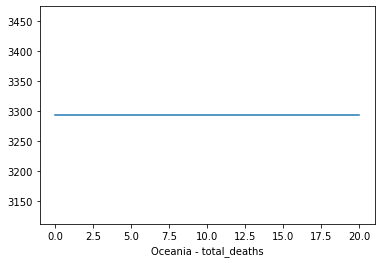

Input: [3257. 3265. 3271. 3276. 3282. 3292. 3298.], Predicted: 3293.900
Input: [3265.  3271.  3276.  3282.  3292.  3298.  3293.9], Predicted: 3293.900
Input: [3271.  3276.  3282.  3292.  3298.  3293.9 3293.9], Predicted: 3293.900
Input: [3276.  3282.  3292.  3298.  3293.9 3293.9 3293.9], Predicted: 3293.900
Input: [3282.  3292.  3298.  3293.9 3293.9 3293.9 3293.9], Predicted: 3293.900
Input: [3292.  3298.  3293.9 3293.9 3293.9 3293.9 3293.9], Predicted: 3293.900
Input: [3298.  3293.9 3293.9 3293.9 3293.9 3293.9 3293.9], Predicted: 3293.900
Input: [3293.9 3293.9 3293.9 3293.9 3293.9 3293.9 3293.9], Predicted: 3293.900
Input: [3293.9 3293.9 3293.9 3293.9 3293.9 3293.9 3293.9], Predicted: 3293.900
Input: [3293.9 3293.9 3293.9 3293.9 3293.9 3293.9 3293.9], Predicted: 3293.900
Input: [3293.9 3293.9 3293.9 3293.9 3293.9 3293.9 3293.9], Predicted: 3293.900
Input: [3293.9 3293.9 3293.9 3293.9 3293.9 3293.9 3293.9], Predicted: 3293.900
Input: [3293.9 3293.9 3293.9 3293.9 3293.9 3293.9 3293.9], 

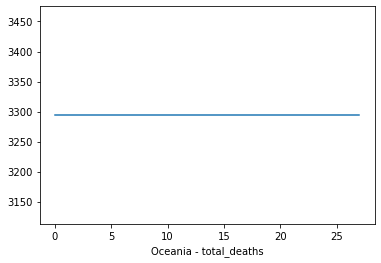

Input: [3257. 3265. 3271. 3276. 3282. 3292. 3298.], Predicted: 3293.860
Input: [3265.   3271.   3276.   3282.   3292.   3298.   3293.86], Predicted: 3293.860
Input: [3271.   3276.   3282.   3292.   3298.   3293.86 3293.86], Predicted: 3293.860
Input: [3276.   3282.   3292.   3298.   3293.86 3293.86 3293.86], Predicted: 3293.860
Input: [3282.   3292.   3298.   3293.86 3293.86 3293.86 3293.86], Predicted: 3293.860
Input: [3292.   3298.   3293.86 3293.86 3293.86 3293.86 3293.86], Predicted: 3293.860
Input: [3298.   3293.86 3293.86 3293.86 3293.86 3293.86 3293.86], Predicted: 3293.860
Input: [3293.86 3293.86 3293.86 3293.86 3293.86 3293.86 3293.86], Predicted: 3293.860
Input: [3293.86 3293.86 3293.86 3293.86 3293.86 3293.86 3293.86], Predicted: 3293.860
Input: [3293.86 3293.86 3293.86 3293.86 3293.86 3293.86 3293.86], Predicted: 3293.860
Input: [3293.86 3293.86 3293.86 3293.86 3293.86 3293.86 3293.86], Predicted: 3293.860
Input: [3293.86 3293.86 3293.86 3293.86 3293.86 3293.86 3293.86], Pr

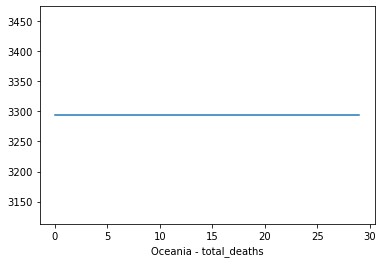

Input: [49302398. 49408304. 49512625. 49564184. 49596918. 49843216. 50048038.], Predicted: 49951480.580
Input: [49408304.   49512625.   49564184.   49596918.   49843216.   50048038.
 49951480.58], Predicted: 49951480.580
Input: [49512625.   49564184.   49596918.   49843216.   50048038.   49951480.58
 49951480.58], Predicted: 49951480.580
Input: [49564184.   49596918.   49843216.   50048038.   49951480.58 49951480.58
 49951480.58], Predicted: 49951480.580
Input: [49596918.   49843216.   50048038.   49951480.58 49951480.58 49951480.58
 49951480.58], Predicted: 49951480.580
Input: [49843216.   50048038.   49951480.58 49951480.58 49951480.58 49951480.58
 49951480.58], Predicted: 49951480.580
Input: [50048038.   49951480.58 49951480.58 49951480.58 49951480.58 49951480.58
 49951480.58], Predicted: 49951480.580
[49951480.58, 49951480.58, 49951480.58, 49951480.58, 49951480.58, 49951480.58, 49951480.58]


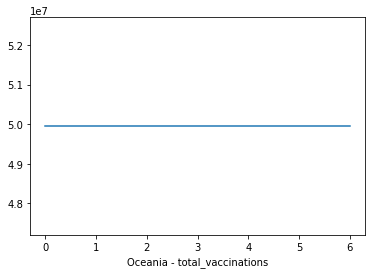

Input: [49302398. 49408304. 49512625. 49564184. 49596918. 49843216. 50048038.], Predicted: 49930106.560
Input: [49408304.   49512625.   49564184.   49596918.   49843216.   50048038.
 49930106.56], Predicted: 49930106.560
Input: [49512625.   49564184.   49596918.   49843216.   50048038.   49930106.56
 49930106.56], Predicted: 49930106.560
Input: [49564184.   49596918.   49843216.   50048038.   49930106.56 49930106.56
 49930106.56], Predicted: 49930106.560
Input: [49596918.   49843216.   50048038.   49930106.56 49930106.56 49930106.56
 49930106.56], Predicted: 49930106.560
Input: [49843216.   50048038.   49930106.56 49930106.56 49930106.56 49930106.56
 49930106.56], Predicted: 49930106.560
Input: [50048038.   49930106.56 49930106.56 49930106.56 49930106.56 49930106.56
 49930106.56], Predicted: 49930106.560
Input: [49930106.56 49930106.56 49930106.56 49930106.56 49930106.56 49930106.56
 49930106.56], Predicted: 49930106.560
Input: [49930106.56 49930106.56 49930106.56 49930106.56 49930106.

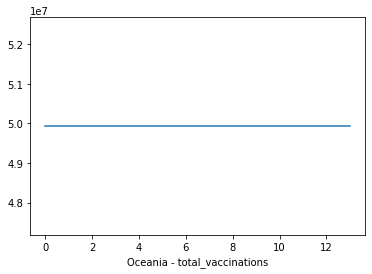

Input: [49302398. 49408304. 49512625. 49564184. 49596918. 49843216. 50048038.], Predicted: 49961708.920
Input: [49408304.   49512625.   49564184.   49596918.   49843216.   50048038.
 49961708.92], Predicted: 49961708.920
Input: [49512625.   49564184.   49596918.   49843216.   50048038.   49961708.92
 49961708.92], Predicted: 49961708.920
Input: [49564184.   49596918.   49843216.   50048038.   49961708.92 49961708.92
 49961708.92], Predicted: 49961708.920
Input: [49596918.   49843216.   50048038.   49961708.92 49961708.92 49961708.92
 49961708.92], Predicted: 49961708.920
Input: [49843216.   50048038.   49961708.92 49961708.92 49961708.92 49961708.92
 49961708.92], Predicted: 49961708.920
Input: [50048038.   49961708.92 49961708.92 49961708.92 49961708.92 49961708.92
 49961708.92], Predicted: 49961708.920
Input: [49961708.92 49961708.92 49961708.92 49961708.92 49961708.92 49961708.92
 49961708.92], Predicted: 49961708.920
Input: [49961708.92 49961708.92 49961708.92 49961708.92 49961708.

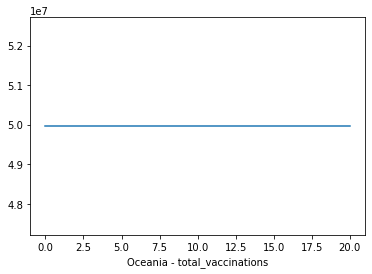

Input: [49302398. 49408304. 49512625. 49564184. 49596918. 49843216. 50048038.], Predicted: 49953803.740
Input: [49408304.   49512625.   49564184.   49596918.   49843216.   50048038.
 49953803.74], Predicted: 49953803.740
Input: [49512625.   49564184.   49596918.   49843216.   50048038.   49953803.74
 49953803.74], Predicted: 49953803.740
Input: [49564184.   49596918.   49843216.   50048038.   49953803.74 49953803.74
 49953803.74], Predicted: 49953803.740
Input: [49596918.   49843216.   50048038.   49953803.74 49953803.74 49953803.74
 49953803.74], Predicted: 49953803.740
Input: [49843216.   50048038.   49953803.74 49953803.74 49953803.74 49953803.74
 49953803.74], Predicted: 49953803.740
Input: [50048038.   49953803.74 49953803.74 49953803.74 49953803.74 49953803.74
 49953803.74], Predicted: 49953803.740
Input: [49953803.74 49953803.74 49953803.74 49953803.74 49953803.74 49953803.74
 49953803.74], Predicted: 49953803.740
Input: [49953803.74 49953803.74 49953803.74 49953803.74 49953803.

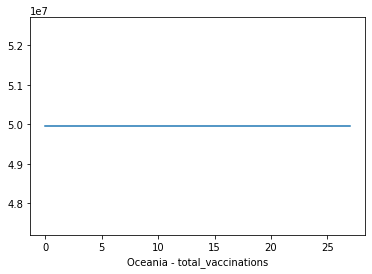

Input: [49302398. 49408304. 49512625. 49564184. 49596918. 49843216. 50048038.], Predicted: 49925152.300
Input: [49408304.  49512625.  49564184.  49596918.  49843216.  50048038.
 49925152.3], Predicted: 49925152.300
Input: [49512625.  49564184.  49596918.  49843216.  50048038.  49925152.3
 49925152.3], Predicted: 49925152.300
Input: [49564184.  49596918.  49843216.  50048038.  49925152.3 49925152.3
 49925152.3], Predicted: 49925152.300
Input: [49596918.  49843216.  50048038.  49925152.3 49925152.3 49925152.3
 49925152.3], Predicted: 49925152.300
Input: [49843216.  50048038.  49925152.3 49925152.3 49925152.3 49925152.3
 49925152.3], Predicted: 49925152.300
Input: [50048038.  49925152.3 49925152.3 49925152.3 49925152.3 49925152.3
 49925152.3], Predicted: 49925152.300
Input: [49925152.3 49925152.3 49925152.3 49925152.3 49925152.3 49925152.3
 49925152.3], Predicted: 49925152.300
Input: [49925152.3 49925152.3 49925152.3 49925152.3 49925152.3 49925152.3
 49925152.3], Predicted: 49925152.300
I

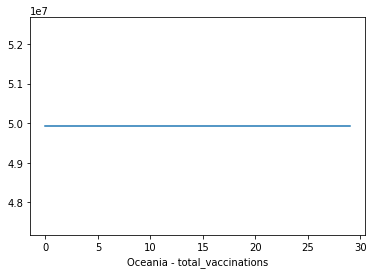

Input: [23409338. 23470295. 23531265. 23561782. 23580938. 23706859. 23817965.], Predicted: 23765344.190
Input: [23470295.   23531265.   23561782.   23580938.   23706859.   23817965.
 23765344.19], Predicted: 23765344.190
Input: [23531265.   23561782.   23580938.   23706859.   23817965.   23765344.19
 23765344.19], Predicted: 23765344.190
Input: [23561782.   23580938.   23706859.   23817965.   23765344.19 23765344.19
 23765344.19], Predicted: 23765344.190
Input: [23580938.   23706859.   23817965.   23765344.19 23765344.19 23765344.19
 23765344.19], Predicted: 23765344.190
Input: [23706859.   23817965.   23765344.19 23765344.19 23765344.19 23765344.19
 23765344.19], Predicted: 23765344.190
Input: [23817965.   23765344.19 23765344.19 23765344.19 23765344.19 23765344.19
 23765344.19], Predicted: 23765344.190
[23765344.19, 23765344.19, 23765344.19, 23765344.19, 23765344.19, 23765344.19, 23765344.19]


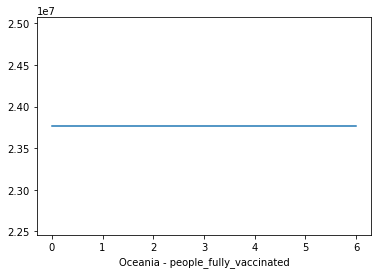

Input: [23409338. 23470295. 23531265. 23561782. 23580938. 23706859. 23817965.], Predicted: 23760926.790
Input: [23470295.   23531265.   23561782.   23580938.   23706859.   23817965.
 23760926.79], Predicted: 23760926.790
Input: [23531265.   23561782.   23580938.   23706859.   23817965.   23760926.79
 23760926.79], Predicted: 23760926.790
Input: [23561782.   23580938.   23706859.   23817965.   23760926.79 23760926.79
 23760926.79], Predicted: 23760926.790
Input: [23580938.   23706859.   23817965.   23760926.79 23760926.79 23760926.79
 23760926.79], Predicted: 23760926.790
Input: [23706859.   23817965.   23760926.79 23760926.79 23760926.79 23760926.79
 23760926.79], Predicted: 23760926.790
Input: [23817965.   23760926.79 23760926.79 23760926.79 23760926.79 23760926.79
 23760926.79], Predicted: 23760926.790
Input: [23760926.79 23760926.79 23760926.79 23760926.79 23760926.79 23760926.79
 23760926.79], Predicted: 23760926.790
Input: [23760926.79 23760926.79 23760926.79 23760926.79 23760926.

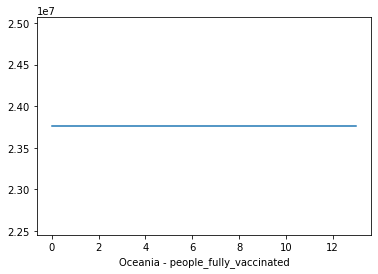

Input: [23409338. 23470295. 23531265. 23561782. 23580938. 23706859. 23817965.], Predicted: 23765432.540
Input: [23470295.   23531265.   23561782.   23580938.   23706859.   23817965.
 23765432.54], Predicted: 23765432.540
Input: [23531265.   23561782.   23580938.   23706859.   23817965.   23765432.54
 23765432.54], Predicted: 23765432.540
Input: [23561782.   23580938.   23706859.   23817965.   23765432.54 23765432.54
 23765432.54], Predicted: 23765432.540
Input: [23580938.   23706859.   23817965.   23765432.54 23765432.54 23765432.54
 23765432.54], Predicted: 23765432.540
Input: [23706859.   23817965.   23765432.54 23765432.54 23765432.54 23765432.54
 23765432.54], Predicted: 23765432.540
Input: [23817965.   23765432.54 23765432.54 23765432.54 23765432.54 23765432.54
 23765432.54], Predicted: 23765432.540
Input: [23765432.54 23765432.54 23765432.54 23765432.54 23765432.54 23765432.54
 23765432.54], Predicted: 23765432.540
Input: [23765432.54 23765432.54 23765432.54 23765432.54 23765432.

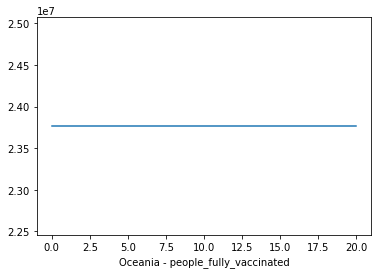

Input: [23409338. 23470295. 23531265. 23561782. 23580938. 23706859. 23817965.], Predicted: 23763087.530
Input: [23470295.   23531265.   23561782.   23580938.   23706859.   23817965.
 23763087.53], Predicted: 23763087.530
Input: [23531265.   23561782.   23580938.   23706859.   23817965.   23763087.53
 23763087.53], Predicted: 23763087.530
Input: [23561782.   23580938.   23706859.   23817965.   23763087.53 23763087.53
 23763087.53], Predicted: 23763087.530
Input: [23580938.   23706859.   23817965.   23763087.53 23763087.53 23763087.53
 23763087.53], Predicted: 23763087.530
Input: [23706859.   23817965.   23763087.53 23763087.53 23763087.53 23763087.53
 23763087.53], Predicted: 23763087.530
Input: [23817965.   23763087.53 23763087.53 23763087.53 23763087.53 23763087.53
 23763087.53], Predicted: 23763087.530
Input: [23763087.53 23763087.53 23763087.53 23763087.53 23763087.53 23763087.53
 23763087.53], Predicted: 23763087.530
Input: [23763087.53 23763087.53 23763087.53 23763087.53 23763087.

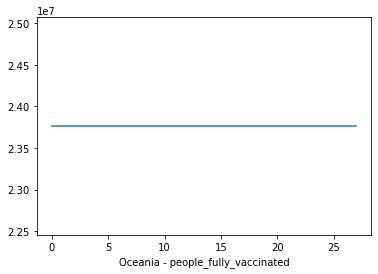

Input: [23409338. 23470295. 23531265. 23561782. 23580938. 23706859. 23817965.], Predicted: 23759414.640
Input: [23470295.   23531265.   23561782.   23580938.   23706859.   23817965.
 23759414.64], Predicted: 23759414.640
Input: [23531265.   23561782.   23580938.   23706859.   23817965.   23759414.64
 23759414.64], Predicted: 23759414.640
Input: [23561782.   23580938.   23706859.   23817965.   23759414.64 23759414.64
 23759414.64], Predicted: 23759414.640
Input: [23580938.   23706859.   23817965.   23759414.64 23759414.64 23759414.64
 23759414.64], Predicted: 23759414.640
Input: [23706859.   23817965.   23759414.64 23759414.64 23759414.64 23759414.64
 23759414.64], Predicted: 23759414.640
Input: [23817965.   23759414.64 23759414.64 23759414.64 23759414.64 23759414.64
 23759414.64], Predicted: 23759414.640
Input: [23759414.64 23759414.64 23759414.64 23759414.64 23759414.64 23759414.64
 23759414.64], Predicted: 23759414.640
Input: [23759414.64 23759414.64 23759414.64 23759414.64 23759414.

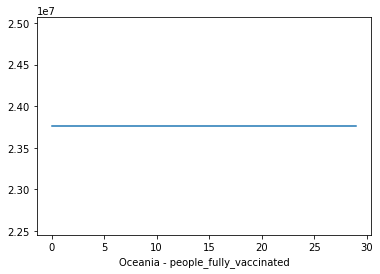

Input: [1815. 1943. 1708. 1381. 1462. 1304. 1653.], Predicted: 1743.240
Input: [1943.   1708.   1381.   1462.   1304.   1653.   1743.24], Predicted: 1914.250
Input: [1708.   1381.   1462.   1304.   1653.   1743.24 1914.25], Predicted: 1793.620
Input: [1381.   1462.   1304.   1653.   1743.24 1914.25 1793.62], Predicted: 1667.700
Input: [1462.   1304.   1653.   1743.24 1914.25 1793.62 1667.7 ], Predicted: 1807.660
Input: [1304.   1653.   1743.24 1914.25 1793.62 1667.7  1807.66], Predicted: 1548.470
Input: [1653.   1743.24 1914.25 1793.62 1667.7  1807.66 1548.47], Predicted: 1638.600
[1743.24, 1914.25, 1793.62, 1667.7, 1807.66, 1548.47, 1638.6]


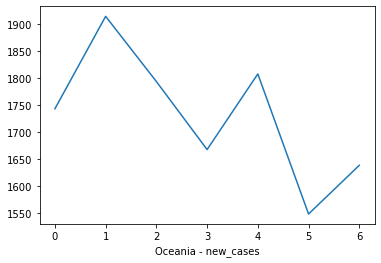

Input: [1815. 1943. 1708. 1381. 1462. 1304. 1653.], Predicted: 1741.780
Input: [1943.   1708.   1381.   1462.   1304.   1653.   1741.78], Predicted: 1870.840
Input: [1708.   1381.   1462.   1304.   1653.   1741.78 1870.84], Predicted: 1809.440
Input: [1381.   1462.   1304.   1653.   1741.78 1870.84 1809.44], Predicted: 1644.470
Input: [1462.   1304.   1653.   1741.78 1870.84 1809.44 1644.47], Predicted: 1776.090
Input: [1304.   1653.   1741.78 1870.84 1809.44 1644.47 1776.09], Predicted: 1580.190
Input: [1653.   1741.78 1870.84 1809.44 1644.47 1776.09 1580.19], Predicted: 1772.370
Input: [1741.78 1870.84 1809.44 1644.47 1776.09 1580.19 1772.37], Predicted: 1719.680
Input: [1870.84 1809.44 1644.47 1776.09 1580.19 1772.37 1719.68], Predicted: 1874.970
Input: [1809.44 1644.47 1776.09 1580.19 1772.37 1719.68 1874.97], Predicted: 1824.430
Input: [1644.47 1776.09 1580.19 1772.37 1719.68 1874.97 1824.43], Predicted: 1785.720
Input: [1776.09 1580.19 1772.37 1719.68 1874.97 1824.43 1785.72], Pr

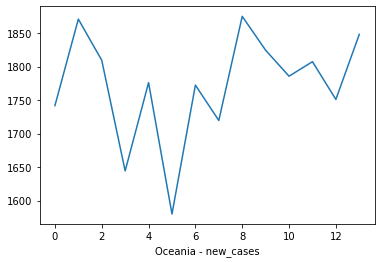

Input: [1815. 1943. 1708. 1381. 1462. 1304. 1653.], Predicted: 1707.200
Input: [1943.  1708.  1381.  1462.  1304.  1653.  1707.2], Predicted: 1896.560
Input: [1708.   1381.   1462.   1304.   1653.   1707.2  1896.56], Predicted: 1658.690
Input: [1381.   1462.   1304.   1653.   1707.2  1896.56 1658.69], Predicted: 1659.540
Input: [1462.   1304.   1653.   1707.2  1896.56 1658.69 1659.54], Predicted: 1617.030
Input: [1304.   1653.   1707.2  1896.56 1658.69 1659.54 1617.03], Predicted: 1578.420
Input: [1653.   1707.2  1896.56 1658.69 1659.54 1617.03 1578.42], Predicted: 1644.110
Input: [1707.2  1896.56 1658.69 1659.54 1617.03 1578.42 1644.11], Predicted: 1691.290
Input: [1896.56 1658.69 1659.54 1617.03 1578.42 1644.11 1691.29], Predicted: 1709.580
Input: [1658.69 1659.54 1617.03 1578.42 1644.11 1691.29 1709.58], Predicted: 1710.950
Input: [1659.54 1617.03 1578.42 1644.11 1691.29 1709.58 1710.95], Predicted: 1693.570
Input: [1617.03 1578.42 1644.11 1691.29 1709.58 1710.95 1693.57], Predicted

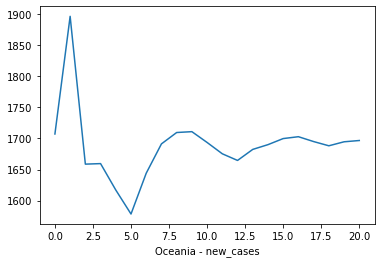

Input: [1815. 1943. 1708. 1381. 1462. 1304. 1653.], Predicted: 1708.850
Input: [1943.   1708.   1381.   1462.   1304.   1653.   1708.85], Predicted: 1817.690
Input: [1708.   1381.   1462.   1304.   1653.   1708.85 1817.69], Predicted: 1660.880
Input: [1381.   1462.   1304.   1653.   1708.85 1817.69 1660.88], Predicted: 1668.440
Input: [1462.   1304.   1653.   1708.85 1817.69 1660.88 1668.44], Predicted: 1630.010
Input: [1304.   1653.   1708.85 1817.69 1660.88 1668.44 1630.01], Predicted: 1672.140
Input: [1653.   1708.85 1817.69 1660.88 1668.44 1630.01 1672.14], Predicted: 1707.640
Input: [1708.85 1817.69 1660.88 1668.44 1630.01 1672.14 1707.64], Predicted: 1723.120
Input: [1817.69 1660.88 1668.44 1630.01 1672.14 1707.64 1723.12], Predicted: 1729.580
Input: [1660.88 1668.44 1630.01 1672.14 1707.64 1723.12 1729.58], Predicted: 1794.710
Input: [1668.44 1630.01 1672.14 1707.64 1723.12 1729.58 1794.71], Predicted: 1804.430
Input: [1630.01 1672.14 1707.64 1723.12 1729.58 1794.71 1804.43], Pr

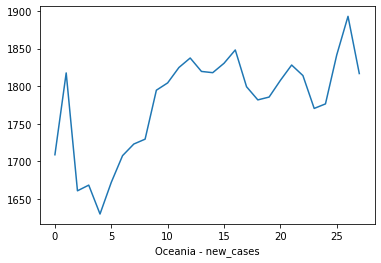

Input: [1815. 1943. 1708. 1381. 1462. 1304. 1653.], Predicted: 1746.160
Input: [1943.   1708.   1381.   1462.   1304.   1653.   1746.16], Predicted: 1844.590
Input: [1708.   1381.   1462.   1304.   1653.   1746.16 1844.59], Predicted: 1834.420
Input: [1381.   1462.   1304.   1653.   1746.16 1844.59 1834.42], Predicted: 1665.840
Input: [1462.   1304.   1653.   1746.16 1844.59 1834.42 1665.84], Predicted: 1755.550
Input: [1304.   1653.   1746.16 1844.59 1834.42 1665.84 1755.55], Predicted: 1633.880
Input: [1653.   1746.16 1844.59 1834.42 1665.84 1755.55 1633.88], Predicted: 1825.840
Input: [1746.16 1844.59 1834.42 1665.84 1755.55 1633.88 1825.84], Predicted: 1731.820
Input: [1844.59 1834.42 1665.84 1755.55 1633.88 1825.84 1731.82], Predicted: 1851.390
Input: [1834.42 1665.84 1755.55 1633.88 1825.84 1731.82 1851.39], Predicted: 1786.150
Input: [1665.84 1755.55 1633.88 1825.84 1731.82 1851.39 1786.15], Predicted: 1816.100
Input: [1755.55 1633.88 1825.84 1731.82 1851.39 1786.15 1816.1 ], Pr

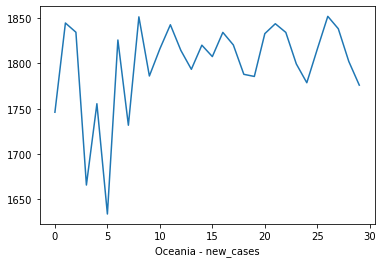

Input: [19.  8.  6.  5.  6. 10.  6.], Predicted: 8.140
Input: [ 8.    6.    5.    6.   10.    6.    8.14], Predicted: 7.700
Input: [ 6.    5.    6.   10.    6.    8.14  7.7 ], Predicted: 8.880
Input: [ 5.    6.   10.    6.    8.14  7.7   8.88], Predicted: 8.070
Input: [ 6.   10.    6.    8.14  7.7   8.88  8.07], Predicted: 7.410
Input: [10.    6.    8.14  7.7   8.88  8.07  7.41], Predicted: 7.290
Input: [6.   8.14 7.7  8.88 8.07 7.41 7.29], Predicted: 6.810
[8.14, 7.7, 8.88, 8.07, 7.41, 7.29, 6.81]


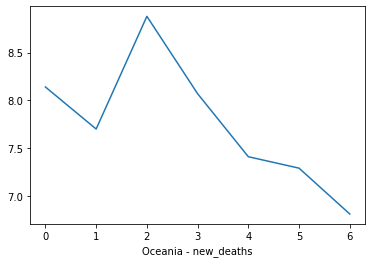

Input: [19.  8.  6.  5.  6. 10.  6.], Predicted: 7.510
Input: [ 8.    6.    5.    6.   10.    6.    7.51], Predicted: 7.020
Input: [ 6.    5.    6.   10.    6.    7.51  7.02], Predicted: 7.580
Input: [ 5.    6.   10.    6.    7.51  7.02  7.58], Predicted: 7.470
Input: [ 6.   10.    6.    7.51  7.02  7.58  7.47], Predicted: 7.140
Input: [10.    6.    7.51  7.02  7.58  7.47  7.14], Predicted: 7.020
Input: [6.   7.51 7.02 7.58 7.47 7.14 7.02], Predicted: 7.020
Input: [7.51 7.02 7.58 7.47 7.14 7.02 7.02], Predicted: 4.680
Input: [7.02 7.58 7.47 7.14 7.02 7.02 4.68], Predicted: 5.340
Input: [7.58 7.47 7.14 7.02 7.02 4.68 5.34], Predicted: 4.790
Input: [7.47 7.14 7.02 7.02 4.68 5.34 4.79], Predicted: 4.000
Input: [7.14 7.02 7.02 4.68 5.34 4.79 4.  ], Predicted: 3.280
Input: [7.02 7.02 4.68 5.34 4.79 4.   3.28], Predicted: 3.640
Input: [7.02 4.68 5.34 4.79 4.   3.28 3.64], Predicted: 3.240
[7.51, 7.02, 7.58, 7.47, 7.14, 7.02, 7.02, 4.68, 5.34, 4.79, 4.0, 3.28, 3.64, 3.24]


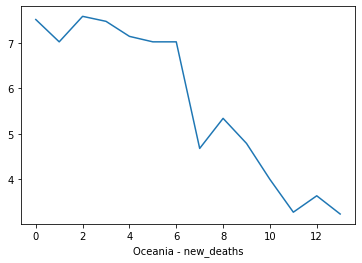

Input: [19.  8.  6.  5.  6. 10.  6.], Predicted: 8.730
Input: [ 8.    6.    5.    6.   10.    6.    8.73], Predicted: 8.050
Input: [ 6.    5.    6.   10.    6.    8.73  8.05], Predicted: 8.380
Input: [ 5.    6.   10.    6.    8.73  8.05  8.38], Predicted: 7.750
Input: [ 6.   10.    6.    8.73  8.05  8.38  7.75], Predicted: 7.730
Input: [10.    6.    8.73  8.05  8.38  7.75  7.73], Predicted: 7.850
Input: [6.   8.73 8.05 8.38 7.75 7.73 7.85], Predicted: 7.910
Input: [8.73 8.05 8.38 7.75 7.73 7.85 7.91], Predicted: 8.340
Input: [8.05 8.38 7.75 7.73 7.85 7.91 8.34], Predicted: 7.340
Input: [8.38 7.75 7.73 7.85 7.91 8.34 7.34], Predicted: 6.020
Input: [7.75 7.73 7.85 7.91 8.34 7.34 6.02], Predicted: 5.920
Input: [7.73 7.85 7.91 8.34 7.34 6.02 5.92], Predicted: 6.190
Input: [7.85 7.91 8.34 7.34 6.02 5.92 6.19], Predicted: 5.420
Input: [7.91 8.34 7.34 6.02 5.92 6.19 5.42], Predicted: 4.290
Input: [8.34 7.34 6.02 5.92 6.19 5.42 4.29], Predicted: 4.300
Input: [7.34 6.02 5.92 6.19 5.42 4.29 4.3 

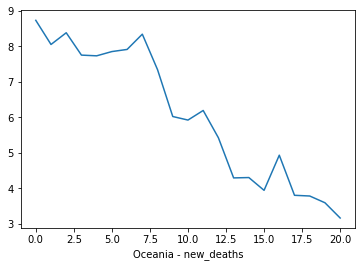

Input: [19.  8.  6.  5.  6. 10.  6.], Predicted: 9.010
Input: [ 8.    6.    5.    6.   10.    6.    9.01], Predicted: 8.530
Input: [ 6.    5.    6.   10.    6.    9.01  8.53], Predicted: 10.370
Input: [ 5.    6.   10.    6.    9.01  8.53 10.37], Predicted: 8.190
Input: [ 6.   10.    6.    9.01  8.53 10.37  8.19], Predicted: 7.470
Input: [10.    6.    9.01  8.53 10.37  8.19  7.47], Predicted: 7.380
Input: [ 6.    9.01  8.53 10.37  8.19  7.47  7.38], Predicted: 8.600
Input: [ 9.01  8.53 10.37  8.19  7.47  7.38  8.6 ], Predicted: 9.470
Input: [ 8.53 10.37  8.19  7.47  7.38  8.6   9.47], Predicted: 9.840
Input: [10.37  8.19  7.47  7.38  8.6   9.47  9.84], Predicted: 9.170
Input: [8.19 7.47 7.38 8.6  9.47 9.84 9.17], Predicted: 8.530
Input: [7.47 7.38 8.6  9.47 9.84 9.17 8.53], Predicted: 8.590
Input: [7.38 8.6  9.47 9.84 9.17 8.53 8.59], Predicted: 9.390
Input: [8.6  9.47 9.84 9.17 8.53 8.59 9.39], Predicted: 9.650
Input: [9.47 9.84 9.17 8.53 8.59 9.39 9.65], Predicted: 9.900
Input: [9.84 

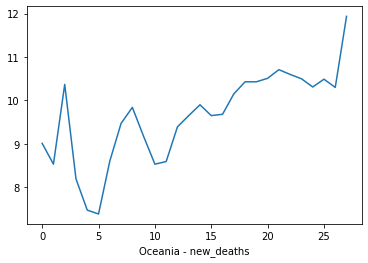

Input: [19.  8.  6.  5.  6. 10.  6.], Predicted: 7.640
Input: [ 8.    6.    5.    6.   10.    6.    7.64], Predicted: 8.180
Input: [ 6.    5.    6.   10.    6.    7.64  8.18], Predicted: 8.400
Input: [ 5.    6.   10.    6.    7.64  8.18  8.4 ], Predicted: 7.340
Input: [ 6.   10.    6.    7.64  8.18  8.4   7.34], Predicted: 7.310
Input: [10.    6.    7.64  8.18  8.4   7.34  7.31], Predicted: 7.780
Input: [6.   7.64 8.18 8.4  7.34 7.31 7.78], Predicted: 7.530
Input: [7.64 8.18 8.4  7.34 7.31 7.78 7.53], Predicted: 6.020
Input: [8.18 8.4  7.34 7.31 7.78 7.53 6.02], Predicted: 5.210
Input: [8.4  7.34 7.31 7.78 7.53 6.02 5.21], Predicted: 5.870
Input: [7.34 7.31 7.78 7.53 6.02 5.21 5.87], Predicted: 4.650
Input: [7.31 7.78 7.53 6.02 5.21 5.87 4.65], Predicted: 4.300
Input: [7.78 7.53 6.02 5.21 5.87 4.65 4.3 ], Predicted: 3.300
Input: [7.53 6.02 5.21 5.87 4.65 4.3  3.3 ], Predicted: 3.410
Input: [6.02 5.21 5.87 4.65 4.3  3.3  3.41], Predicted: 5.340
Input: [5.21 5.87 4.65 4.3  3.3  3.41 5.34

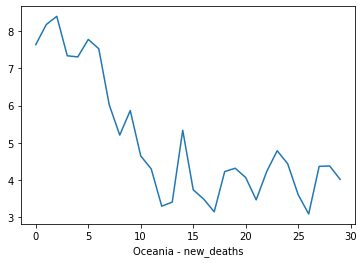

Input: [8613527. 8619243. 8626907. 8632315. 8637754. 8644381. 8652562.], Predicted: 8648962.360
Input: [8619243.   8626907.   8632315.   8637754.   8644381.   8652562.
 8648962.36], Predicted: 8648962.360
Input: [8626907.   8632315.   8637754.   8644381.   8652562.   8648962.36
 8648962.36], Predicted: 8648962.360
Input: [8632315.   8637754.   8644381.   8652562.   8648962.36 8648962.36
 8648962.36], Predicted: 8648962.360
Input: [8637754.   8644381.   8652562.   8648962.36 8648962.36 8648962.36
 8648962.36], Predicted: 8648962.360
Input: [8644381.   8652562.   8648962.36 8648962.36 8648962.36 8648962.36
 8648962.36], Predicted: 8648962.360
Input: [8652562.   8648962.36 8648962.36 8648962.36 8648962.36 8648962.36
 8648962.36], Predicted: 8648962.360
[8648962.36, 8648962.36, 8648962.36, 8648962.36, 8648962.36, 8648962.36, 8648962.36]


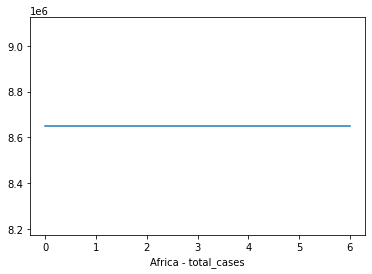

Input: [8613527. 8619243. 8626907. 8632315. 8637754. 8644381. 8652562.], Predicted: 8648605.410
Input: [8619243.   8626907.   8632315.   8637754.   8644381.   8652562.
 8648605.41], Predicted: 8648605.410
Input: [8626907.   8632315.   8637754.   8644381.   8652562.   8648605.41
 8648605.41], Predicted: 8648605.410
Input: [8632315.   8637754.   8644381.   8652562.   8648605.41 8648605.41
 8648605.41], Predicted: 8648605.410
Input: [8637754.   8644381.   8652562.   8648605.41 8648605.41 8648605.41
 8648605.41], Predicted: 8648605.410
Input: [8644381.   8652562.   8648605.41 8648605.41 8648605.41 8648605.41
 8648605.41], Predicted: 8648605.410
Input: [8652562.   8648605.41 8648605.41 8648605.41 8648605.41 8648605.41
 8648605.41], Predicted: 8648605.410
Input: [8648605.41 8648605.41 8648605.41 8648605.41 8648605.41 8648605.41
 8648605.41], Predicted: 8648605.410
Input: [8648605.41 8648605.41 8648605.41 8648605.41 8648605.41 8648605.41
 8648605.41], Predicted: 8648605.410
Input: [8648605.41

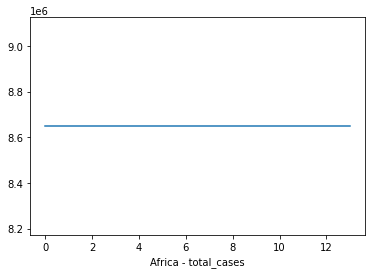

Input: [8613527. 8619243. 8626907. 8632315. 8637754. 8644381. 8652562.], Predicted: 8647167.720
Input: [8619243.   8626907.   8632315.   8637754.   8644381.   8652562.
 8647167.72], Predicted: 8647167.720
Input: [8626907.   8632315.   8637754.   8644381.   8652562.   8647167.72
 8647167.72], Predicted: 8647167.720
Input: [8632315.   8637754.   8644381.   8652562.   8647167.72 8647167.72
 8647167.72], Predicted: 8647167.720
Input: [8637754.   8644381.   8652562.   8647167.72 8647167.72 8647167.72
 8647167.72], Predicted: 8647167.720
Input: [8644381.   8652562.   8647167.72 8647167.72 8647167.72 8647167.72
 8647167.72], Predicted: 8647167.720
Input: [8652562.   8647167.72 8647167.72 8647167.72 8647167.72 8647167.72
 8647167.72], Predicted: 8647167.720
Input: [8647167.72 8647167.72 8647167.72 8647167.72 8647167.72 8647167.72
 8647167.72], Predicted: 8647167.720
Input: [8647167.72 8647167.72 8647167.72 8647167.72 8647167.72 8647167.72
 8647167.72], Predicted: 8647167.720
Input: [8647167.72

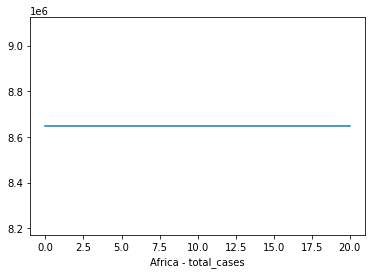

Input: [8613527. 8619243. 8626907. 8632315. 8637754. 8644381. 8652562.], Predicted: 8649036.150
Input: [8619243.   8626907.   8632315.   8637754.   8644381.   8652562.
 8649036.15], Predicted: 8649036.150
Input: [8626907.   8632315.   8637754.   8644381.   8652562.   8649036.15
 8649036.15], Predicted: 8649036.150
Input: [8632315.   8637754.   8644381.   8652562.   8649036.15 8649036.15
 8649036.15], Predicted: 8649036.150
Input: [8637754.   8644381.   8652562.   8649036.15 8649036.15 8649036.15
 8649036.15], Predicted: 8649036.150
Input: [8644381.   8652562.   8649036.15 8649036.15 8649036.15 8649036.15
 8649036.15], Predicted: 8649036.150
Input: [8652562.   8649036.15 8649036.15 8649036.15 8649036.15 8649036.15
 8649036.15], Predicted: 8649036.150
Input: [8649036.15 8649036.15 8649036.15 8649036.15 8649036.15 8649036.15
 8649036.15], Predicted: 8649036.150
Input: [8649036.15 8649036.15 8649036.15 8649036.15 8649036.15 8649036.15
 8649036.15], Predicted: 8649036.150
Input: [8649036.15

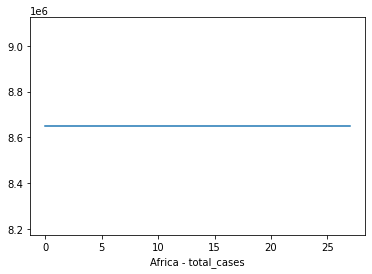

Input: [8613527. 8619243. 8626907. 8632315. 8637754. 8644381. 8652562.], Predicted: 8647914.050
Input: [8619243.   8626907.   8632315.   8637754.   8644381.   8652562.
 8647914.05], Predicted: 8647914.050
Input: [8626907.   8632315.   8637754.   8644381.   8652562.   8647914.05
 8647914.05], Predicted: 8647914.050
Input: [8632315.   8637754.   8644381.   8652562.   8647914.05 8647914.05
 8647914.05], Predicted: 8647914.050
Input: [8637754.   8644381.   8652562.   8647914.05 8647914.05 8647914.05
 8647914.05], Predicted: 8647914.050
Input: [8644381.   8652562.   8647914.05 8647914.05 8647914.05 8647914.05
 8647914.05], Predicted: 8647914.050
Input: [8652562.   8647914.05 8647914.05 8647914.05 8647914.05 8647914.05
 8647914.05], Predicted: 8647914.050
Input: [8647914.05 8647914.05 8647914.05 8647914.05 8647914.05 8647914.05
 8647914.05], Predicted: 8647914.050
Input: [8647914.05 8647914.05 8647914.05 8647914.05 8647914.05 8647914.05
 8647914.05], Predicted: 8647914.050
Input: [8647914.05

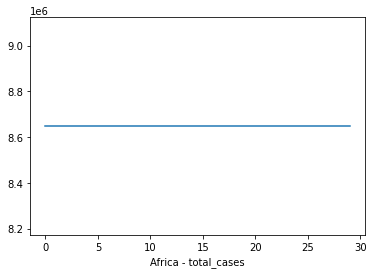

Input: [222043. 222259. 222380. 222501. 222573. 222738. 222881.], Predicted: 222824.830
Input: [222259.   222380.   222501.   222573.   222738.   222881.   222824.83], Predicted: 222824.830
Input: [222380.   222501.   222573.   222738.   222881.   222824.83 222824.83], Predicted: 222824.830
Input: [222501.   222573.   222738.   222881.   222824.83 222824.83 222824.83], Predicted: 222824.830
Input: [222573.   222738.   222881.   222824.83 222824.83 222824.83 222824.83], Predicted: 222824.830
Input: [222738.   222881.   222824.83 222824.83 222824.83 222824.83 222824.83], Predicted: 222824.830
Input: [222881.   222824.83 222824.83 222824.83 222824.83 222824.83 222824.83], Predicted: 222824.830
[222824.83, 222824.83, 222824.83, 222824.83, 222824.83, 222824.83, 222824.83]


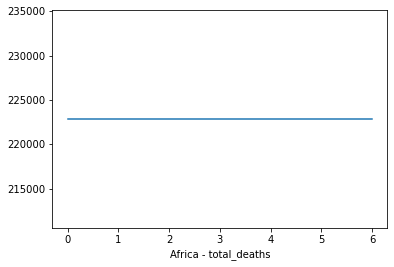

Input: [222043. 222259. 222380. 222501. 222573. 222738. 222881.], Predicted: 222792.180
Input: [222259.   222380.   222501.   222573.   222738.   222881.   222792.18], Predicted: 222792.180
Input: [222380.   222501.   222573.   222738.   222881.   222792.18 222792.18], Predicted: 222792.180
Input: [222501.   222573.   222738.   222881.   222792.18 222792.18 222792.18], Predicted: 222792.180
Input: [222573.   222738.   222881.   222792.18 222792.18 222792.18 222792.18], Predicted: 222792.180
Input: [222738.   222881.   222792.18 222792.18 222792.18 222792.18 222792.18], Predicted: 222792.180
Input: [222881.   222792.18 222792.18 222792.18 222792.18 222792.18 222792.18], Predicted: 222792.180
Input: [222792.18 222792.18 222792.18 222792.18 222792.18 222792.18 222792.18], Predicted: 222792.180
Input: [222792.18 222792.18 222792.18 222792.18 222792.18 222792.18 222792.18], Predicted: 222792.180
Input: [222792.18 222792.18 222792.18 222792.18 222792.18 222792.18 222792.18], Predicted: 22279

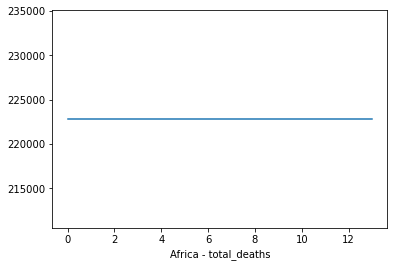

Input: [222043. 222259. 222380. 222501. 222573. 222738. 222881.], Predicted: 222800.900
Input: [222259.  222380.  222501.  222573.  222738.  222881.  222800.9], Predicted: 222800.900
Input: [222380.  222501.  222573.  222738.  222881.  222800.9 222800.9], Predicted: 222800.900
Input: [222501.  222573.  222738.  222881.  222800.9 222800.9 222800.9], Predicted: 222800.900
Input: [222573.  222738.  222881.  222800.9 222800.9 222800.9 222800.9], Predicted: 222800.900
Input: [222738.  222881.  222800.9 222800.9 222800.9 222800.9 222800.9], Predicted: 222800.900
Input: [222881.  222800.9 222800.9 222800.9 222800.9 222800.9 222800.9], Predicted: 222800.900
Input: [222800.9 222800.9 222800.9 222800.9 222800.9 222800.9 222800.9], Predicted: 222800.900
Input: [222800.9 222800.9 222800.9 222800.9 222800.9 222800.9 222800.9], Predicted: 222800.900
Input: [222800.9 222800.9 222800.9 222800.9 222800.9 222800.9 222800.9], Predicted: 222800.900
Input: [222800.9 222800.9 222800.9 222800.9 222800.9 2228

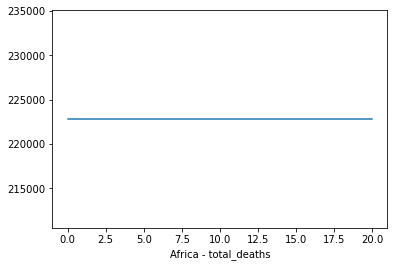

Input: [222043. 222259. 222380. 222501. 222573. 222738. 222881.], Predicted: 222797.900
Input: [222259.  222380.  222501.  222573.  222738.  222881.  222797.9], Predicted: 222797.900
Input: [222380.  222501.  222573.  222738.  222881.  222797.9 222797.9], Predicted: 222797.900
Input: [222501.  222573.  222738.  222881.  222797.9 222797.9 222797.9], Predicted: 222797.900
Input: [222573.  222738.  222881.  222797.9 222797.9 222797.9 222797.9], Predicted: 222797.900
Input: [222738.  222881.  222797.9 222797.9 222797.9 222797.9 222797.9], Predicted: 222797.900
Input: [222881.  222797.9 222797.9 222797.9 222797.9 222797.9 222797.9], Predicted: 222797.900
Input: [222797.9 222797.9 222797.9 222797.9 222797.9 222797.9 222797.9], Predicted: 222797.900
Input: [222797.9 222797.9 222797.9 222797.9 222797.9 222797.9 222797.9], Predicted: 222797.900
Input: [222797.9 222797.9 222797.9 222797.9 222797.9 222797.9 222797.9], Predicted: 222797.900
Input: [222797.9 222797.9 222797.9 222797.9 222797.9 2227

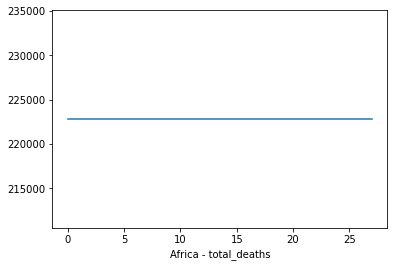

Input: [222043. 222259. 222380. 222501. 222573. 222738. 222881.], Predicted: 222809.210
Input: [222259.   222380.   222501.   222573.   222738.   222881.   222809.21], Predicted: 222809.210
Input: [222380.   222501.   222573.   222738.   222881.   222809.21 222809.21], Predicted: 222809.210
Input: [222501.   222573.   222738.   222881.   222809.21 222809.21 222809.21], Predicted: 222809.210
Input: [222573.   222738.   222881.   222809.21 222809.21 222809.21 222809.21], Predicted: 222809.210
Input: [222738.   222881.   222809.21 222809.21 222809.21 222809.21 222809.21], Predicted: 222809.210
Input: [222881.   222809.21 222809.21 222809.21 222809.21 222809.21 222809.21], Predicted: 222809.210
Input: [222809.21 222809.21 222809.21 222809.21 222809.21 222809.21 222809.21], Predicted: 222809.210
Input: [222809.21 222809.21 222809.21 222809.21 222809.21 222809.21 222809.21], Predicted: 222809.210
Input: [222809.21 222809.21 222809.21 222809.21 222809.21 222809.21 222809.21], Predicted: 22280

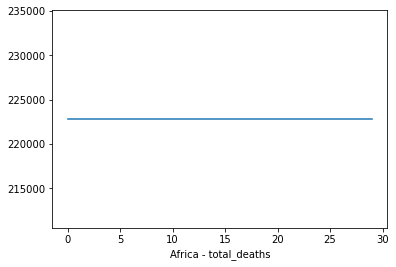

Input: [2.33095908e+08 2.34096492e+08 2.35383412e+08 2.35962847e+08
 2.39645669e+08 2.40793490e+08 2.41460393e+08], Predicted: 240816561.920
Input: [2.34096492e+08 2.35383412e+08 2.35962847e+08 2.39645669e+08
 2.40793490e+08 2.41460393e+08 2.40816562e+08], Predicted: 240816561.920
Input: [2.35383412e+08 2.35962847e+08 2.39645669e+08 2.40793490e+08
 2.41460393e+08 2.40816562e+08 2.40816562e+08], Predicted: 240816561.920
Input: [2.35962847e+08 2.39645669e+08 2.40793490e+08 2.41460393e+08
 2.40816562e+08 2.40816562e+08 2.40816562e+08], Predicted: 240816561.920
Input: [2.39645669e+08 2.40793490e+08 2.41460393e+08 2.40816562e+08
 2.40816562e+08 2.40816562e+08 2.40816562e+08], Predicted: 240816561.920
Input: [2.40793490e+08 2.41460393e+08 2.40816562e+08 2.40816562e+08
 2.40816562e+08 2.40816562e+08 2.40816562e+08], Predicted: 240816561.920
Input: [2.41460393e+08 2.40816562e+08 2.40816562e+08 2.40816562e+08
 2.40816562e+08 2.40816562e+08 2.40816562e+08], Predicted: 240816561.920
[240816561.92

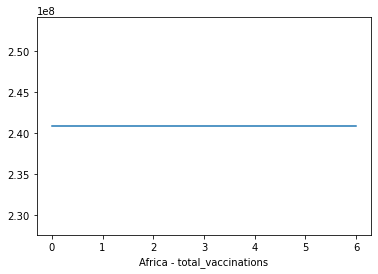

Input: [2.33095908e+08 2.34096492e+08 2.35383412e+08 2.35962847e+08
 2.39645669e+08 2.40793490e+08 2.41460393e+08], Predicted: 240738862.270
Input: [2.34096492e+08 2.35383412e+08 2.35962847e+08 2.39645669e+08
 2.40793490e+08 2.41460393e+08 2.40738862e+08], Predicted: 240738862.270
Input: [2.35383412e+08 2.35962847e+08 2.39645669e+08 2.40793490e+08
 2.41460393e+08 2.40738862e+08 2.40738862e+08], Predicted: 240738862.270
Input: [2.35962847e+08 2.39645669e+08 2.40793490e+08 2.41460393e+08
 2.40738862e+08 2.40738862e+08 2.40738862e+08], Predicted: 240738862.270
Input: [2.39645669e+08 2.40793490e+08 2.41460393e+08 2.40738862e+08
 2.40738862e+08 2.40738862e+08 2.40738862e+08], Predicted: 240738862.270
Input: [2.40793490e+08 2.41460393e+08 2.40738862e+08 2.40738862e+08
 2.40738862e+08 2.40738862e+08 2.40738862e+08], Predicted: 240738862.270
Input: [2.41460393e+08 2.40738862e+08 2.40738862e+08 2.40738862e+08
 2.40738862e+08 2.40738862e+08 2.40738862e+08], Predicted: 240738862.270
Input: [2.407

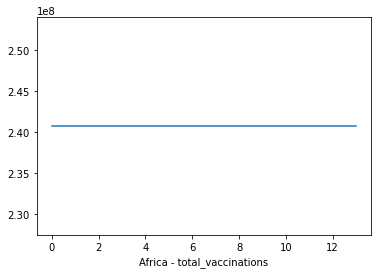

Input: [2.33095908e+08 2.34096492e+08 2.35383412e+08 2.35962847e+08
 2.39645669e+08 2.40793490e+08 2.41460393e+08], Predicted: 240998865.170
Input: [2.34096492e+08 2.35383412e+08 2.35962847e+08 2.39645669e+08
 2.40793490e+08 2.41460393e+08 2.40998865e+08], Predicted: 240998865.170
Input: [2.35383412e+08 2.35962847e+08 2.39645669e+08 2.40793490e+08
 2.41460393e+08 2.40998865e+08 2.40998865e+08], Predicted: 240998865.170
Input: [2.35962847e+08 2.39645669e+08 2.40793490e+08 2.41460393e+08
 2.40998865e+08 2.40998865e+08 2.40998865e+08], Predicted: 240998865.170
Input: [2.39645669e+08 2.40793490e+08 2.41460393e+08 2.40998865e+08
 2.40998865e+08 2.40998865e+08 2.40998865e+08], Predicted: 240998865.170
Input: [2.40793490e+08 2.41460393e+08 2.40998865e+08 2.40998865e+08
 2.40998865e+08 2.40998865e+08 2.40998865e+08], Predicted: 240998865.170
Input: [2.41460393e+08 2.40998865e+08 2.40998865e+08 2.40998865e+08
 2.40998865e+08 2.40998865e+08 2.40998865e+08], Predicted: 240998865.170
Input: [2.409

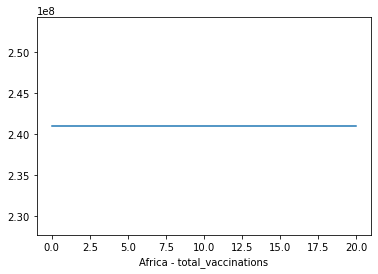

Input: [2.33095908e+08 2.34096492e+08 2.35383412e+08 2.35962847e+08
 2.39645669e+08 2.40793490e+08 2.41460393e+08], Predicted: 240784062.340
Input: [2.34096492e+08 2.35383412e+08 2.35962847e+08 2.39645669e+08
 2.40793490e+08 2.41460393e+08 2.40784062e+08], Predicted: 240784062.340
Input: [2.35383412e+08 2.35962847e+08 2.39645669e+08 2.40793490e+08
 2.41460393e+08 2.40784062e+08 2.40784062e+08], Predicted: 240784062.340
Input: [2.35962847e+08 2.39645669e+08 2.40793490e+08 2.41460393e+08
 2.40784062e+08 2.40784062e+08 2.40784062e+08], Predicted: 240784062.340
Input: [2.39645669e+08 2.40793490e+08 2.41460393e+08 2.40784062e+08
 2.40784062e+08 2.40784062e+08 2.40784062e+08], Predicted: 240784062.340
Input: [2.40793490e+08 2.41460393e+08 2.40784062e+08 2.40784062e+08
 2.40784062e+08 2.40784062e+08 2.40784062e+08], Predicted: 240784062.340
Input: [2.41460393e+08 2.40784062e+08 2.40784062e+08 2.40784062e+08
 2.40784062e+08 2.40784062e+08 2.40784062e+08], Predicted: 240784062.340
Input: [2.407

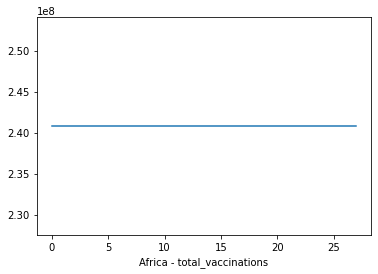

Input: [2.33095908e+08 2.34096492e+08 2.35383412e+08 2.35962847e+08
 2.39645669e+08 2.40793490e+08 2.41460393e+08], Predicted: 240888573.310
Input: [2.34096492e+08 2.35383412e+08 2.35962847e+08 2.39645669e+08
 2.40793490e+08 2.41460393e+08 2.40888573e+08], Predicted: 240888573.310
Input: [2.35383412e+08 2.35962847e+08 2.39645669e+08 2.40793490e+08
 2.41460393e+08 2.40888573e+08 2.40888573e+08], Predicted: 240888573.310
Input: [2.35962847e+08 2.39645669e+08 2.40793490e+08 2.41460393e+08
 2.40888573e+08 2.40888573e+08 2.40888573e+08], Predicted: 240888573.310
Input: [2.39645669e+08 2.40793490e+08 2.41460393e+08 2.40888573e+08
 2.40888573e+08 2.40888573e+08 2.40888573e+08], Predicted: 240888573.310
Input: [2.40793490e+08 2.41460393e+08 2.40888573e+08 2.40888573e+08
 2.40888573e+08 2.40888573e+08 2.40888573e+08], Predicted: 240888573.310
Input: [2.41460393e+08 2.40888573e+08 2.40888573e+08 2.40888573e+08
 2.40888573e+08 2.40888573e+08 2.40888573e+08], Predicted: 240888573.310
Input: [2.408

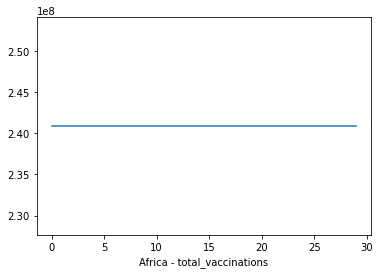

Input: [9.78871110e+07 9.80368250e+07 9.84319670e+07 9.84871260e+07
 9.98963570e+07 1.00460692e+08 1.00646226e+08], Predicted: 100415000.060
Input: [9.80368250e+07 9.84319670e+07 9.84871260e+07 9.98963570e+07
 1.00460692e+08 1.00646226e+08 1.00415000e+08], Predicted: 100415000.060
Input: [9.84319670e+07 9.84871260e+07 9.98963570e+07 1.00460692e+08
 1.00646226e+08 1.00415000e+08 1.00415000e+08], Predicted: 100415000.060
Input: [9.84871260e+07 9.98963570e+07 1.00460692e+08 1.00646226e+08
 1.00415000e+08 1.00415000e+08 1.00415000e+08], Predicted: 100415000.060
Input: [9.98963570e+07 1.00460692e+08 1.00646226e+08 1.00415000e+08
 1.00415000e+08 1.00415000e+08 1.00415000e+08], Predicted: 100415000.060
Input: [1.00460692e+08 1.00646226e+08 1.00415000e+08 1.00415000e+08
 1.00415000e+08 1.00415000e+08 1.00415000e+08], Predicted: 100415000.060
Input: [1.00646226e+08 1.00415000e+08 1.00415000e+08 1.00415000e+08
 1.00415000e+08 1.00415000e+08 1.00415000e+08], Predicted: 100415000.060
[100415000.06

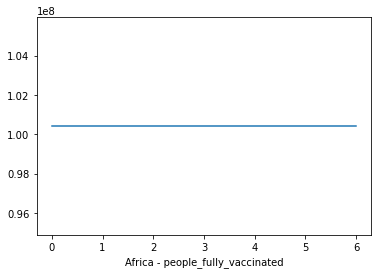

Input: [9.78871110e+07 9.80368250e+07 9.84319670e+07 9.84871260e+07
 9.98963570e+07 1.00460692e+08 1.00646226e+08], Predicted: 100370131.160
Input: [9.80368250e+07 9.84319670e+07 9.84871260e+07 9.98963570e+07
 1.00460692e+08 1.00646226e+08 1.00370131e+08], Predicted: 100370131.160
Input: [9.84319670e+07 9.84871260e+07 9.98963570e+07 1.00460692e+08
 1.00646226e+08 1.00370131e+08 1.00370131e+08], Predicted: 100370131.160
Input: [9.84871260e+07 9.98963570e+07 1.00460692e+08 1.00646226e+08
 1.00370131e+08 1.00370131e+08 1.00370131e+08], Predicted: 100370131.160
Input: [9.98963570e+07 1.00460692e+08 1.00646226e+08 1.00370131e+08
 1.00370131e+08 1.00370131e+08 1.00370131e+08], Predicted: 100370131.160
Input: [1.00460692e+08 1.00646226e+08 1.00370131e+08 1.00370131e+08
 1.00370131e+08 1.00370131e+08 1.00370131e+08], Predicted: 100370131.160
Input: [1.00646226e+08 1.00370131e+08 1.00370131e+08 1.00370131e+08
 1.00370131e+08 1.00370131e+08 1.00370131e+08], Predicted: 100370131.160
Input: [1.003

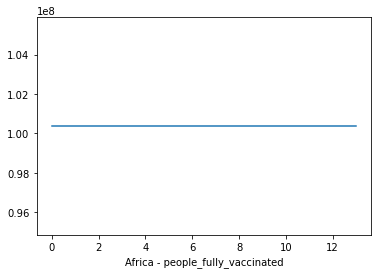

Input: [9.78871110e+07 9.80368250e+07 9.84319670e+07 9.84871260e+07
 9.98963570e+07 1.00460692e+08 1.00646226e+08], Predicted: 100449660.800
Input: [9.80368250e+07 9.84319670e+07 9.84871260e+07 9.98963570e+07
 1.00460692e+08 1.00646226e+08 1.00449661e+08], Predicted: 100449660.800
Input: [9.84319670e+07 9.84871260e+07 9.98963570e+07 1.00460692e+08
 1.00646226e+08 1.00449661e+08 1.00449661e+08], Predicted: 100449660.800
Input: [9.84871260e+07 9.98963570e+07 1.00460692e+08 1.00646226e+08
 1.00449661e+08 1.00449661e+08 1.00449661e+08], Predicted: 100449660.800
Input: [9.98963570e+07 1.00460692e+08 1.00646226e+08 1.00449661e+08
 1.00449661e+08 1.00449661e+08 1.00449661e+08], Predicted: 100449660.800
Input: [1.00460692e+08 1.00646226e+08 1.00449661e+08 1.00449661e+08
 1.00449661e+08 1.00449661e+08 1.00449661e+08], Predicted: 100449660.800
Input: [1.00646226e+08 1.00449661e+08 1.00449661e+08 1.00449661e+08
 1.00449661e+08 1.00449661e+08 1.00449661e+08], Predicted: 100449660.800
Input: [1.004

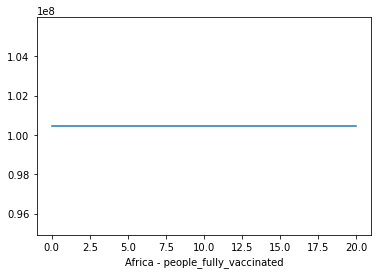

Input: [9.78871110e+07 9.80368250e+07 9.84319670e+07 9.84871260e+07
 9.98963570e+07 1.00460692e+08 1.00646226e+08], Predicted: 100371311.670
Input: [9.80368250e+07 9.84319670e+07 9.84871260e+07 9.98963570e+07
 1.00460692e+08 1.00646226e+08 1.00371312e+08], Predicted: 100371311.670
Input: [9.84319670e+07 9.84871260e+07 9.98963570e+07 1.00460692e+08
 1.00646226e+08 1.00371312e+08 1.00371312e+08], Predicted: 100371311.670
Input: [9.84871260e+07 9.98963570e+07 1.00460692e+08 1.00646226e+08
 1.00371312e+08 1.00371312e+08 1.00371312e+08], Predicted: 100371311.670
Input: [9.98963570e+07 1.00460692e+08 1.00646226e+08 1.00371312e+08
 1.00371312e+08 1.00371312e+08 1.00371312e+08], Predicted: 100371311.670
Input: [1.00460692e+08 1.00646226e+08 1.00371312e+08 1.00371312e+08
 1.00371312e+08 1.00371312e+08 1.00371312e+08], Predicted: 100371311.670
Input: [1.00646226e+08 1.00371312e+08 1.00371312e+08 1.00371312e+08
 1.00371312e+08 1.00371312e+08 1.00371312e+08], Predicted: 100371311.670
Input: [1.003

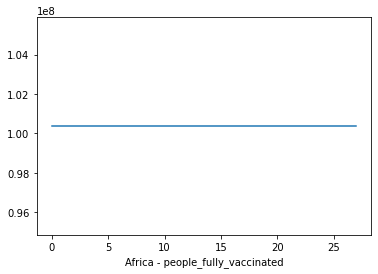

Input: [9.78871110e+07 9.80368250e+07 9.84319670e+07 9.84871260e+07
 9.98963570e+07 1.00460692e+08 1.00646226e+08], Predicted: 100416095.300
Input: [9.80368250e+07 9.84319670e+07 9.84871260e+07 9.98963570e+07
 1.00460692e+08 1.00646226e+08 1.00416095e+08], Predicted: 100416095.300
Input: [9.84319670e+07 9.84871260e+07 9.98963570e+07 1.00460692e+08
 1.00646226e+08 1.00416095e+08 1.00416095e+08], Predicted: 100416095.300
Input: [9.84871260e+07 9.98963570e+07 1.00460692e+08 1.00646226e+08
 1.00416095e+08 1.00416095e+08 1.00416095e+08], Predicted: 100416095.300
Input: [9.98963570e+07 1.00460692e+08 1.00646226e+08 1.00416095e+08
 1.00416095e+08 1.00416095e+08 1.00416095e+08], Predicted: 100416095.300
Input: [1.00460692e+08 1.00646226e+08 1.00416095e+08 1.00416095e+08
 1.00416095e+08 1.00416095e+08 1.00416095e+08], Predicted: 100416095.300
Input: [1.00646226e+08 1.00416095e+08 1.00416095e+08 1.00416095e+08
 1.00416095e+08 1.00416095e+08 1.00416095e+08], Predicted: 100416095.300
Input: [1.004

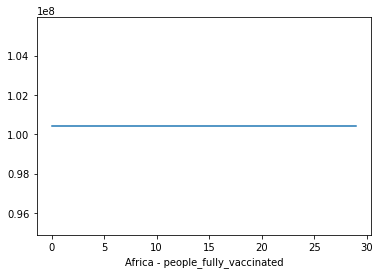

Input: [4686. 5716. 7664. 5408. 5439. 6627. 8181.], Predicted: 6318.510
Input: [5716.   7664.   5408.   5439.   6627.   8181.   6318.51], Predicted: 6309.760
Input: [7664.   5408.   5439.   6627.   8181.   6318.51 6309.76], Predicted: 6848.740
Input: [5408.   5439.   6627.   8181.   6318.51 6309.76 6848.74], Predicted: 6664.140
Input: [5439.   6627.   8181.   6318.51 6309.76 6848.74 6664.14], Predicted: 6314.670
Input: [6627.   8181.   6318.51 6309.76 6848.74 6664.14 6314.67], Predicted: 7247.920
Input: [8181.   6318.51 6309.76 6848.74 6664.14 6314.67 7247.92], Predicted: 7822.150
[6318.51, 6309.76, 6848.74, 6664.14, 6314.67, 7247.92, 7822.15]


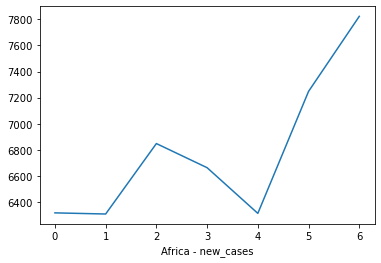

Input: [4686. 5716. 7664. 5408. 5439. 6627. 8181.], Predicted: 6307.950
Input: [5716.   7664.   5408.   5439.   6627.   8181.   6307.95], Predicted: 6388.600
Input: [7664.   5408.   5439.   6627.   8181.   6307.95 6388.6 ], Predicted: 6720.710
Input: [5408.   5439.   6627.   8181.   6307.95 6388.6  6720.71], Predicted: 6478.830
Input: [5439.   6627.   8181.   6307.95 6388.6  6720.71 6478.83], Predicted: 6304.700
Input: [6627.   8181.   6307.95 6388.6  6720.71 6478.83 6304.7 ], Predicted: 7099.360
Input: [8181.   6307.95 6388.6  6720.71 6478.83 6304.7  7099.36], Predicted: 7823.640
Input: [6307.95 6388.6  6720.71 6478.83 6304.7  7099.36 7823.64], Predicted: 7613.280
Input: [6388.6  6720.71 6478.83 6304.7  7099.36 7823.64 7613.28], Predicted: 8151.300
Input: [6720.71 6478.83 6304.7  7099.36 7823.64 7613.28 8151.3 ], Predicted: 8085.980
Input: [6478.83 6304.7  7099.36 7823.64 7613.28 8151.3  8085.98], Predicted: 7537.380
Input: [6304.7  7099.36 7823.64 7613.28 8151.3  8085.98 7537.38], Pr

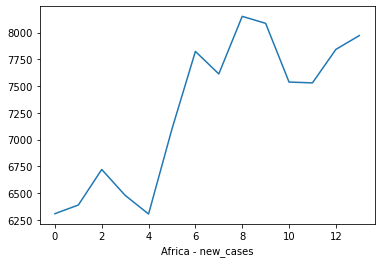

Input: [4686. 5716. 7664. 5408. 5439. 6627. 8181.], Predicted: 6218.520
Input: [5716.   7664.   5408.   5439.   6627.   8181.   6218.52], Predicted: 6227.590
Input: [7664.   5408.   5439.   6627.   8181.   6218.52 6227.59], Predicted: 6655.460
Input: [5408.   5439.   6627.   8181.   6218.52 6227.59 6655.46], Predicted: 6403.370
Input: [5439.   6627.   8181.   6218.52 6227.59 6655.46 6403.37], Predicted: 6434.000
Input: [6627.   8181.   6218.52 6227.59 6655.46 6403.37 6434.  ], Predicted: 7319.580
Input: [8181.   6218.52 6227.59 6655.46 6403.37 6434.   7319.58], Predicted: 7657.160
Input: [6218.52 6227.59 6655.46 6403.37 6434.   7319.58 7657.16], Predicted: 7418.770
Input: [6227.59 6655.46 6403.37 6434.   7319.58 7657.16 7418.77], Predicted: 7690.790
Input: [6655.46 6403.37 6434.   7319.58 7657.16 7418.77 7690.79], Predicted: 8271.760
Input: [6403.37 6434.   7319.58 7657.16 7418.77 7690.79 8271.76], Predicted: 7461.330
Input: [6434.   7319.58 7657.16 7418.77 7690.79 8271.76 7461.33], Pr

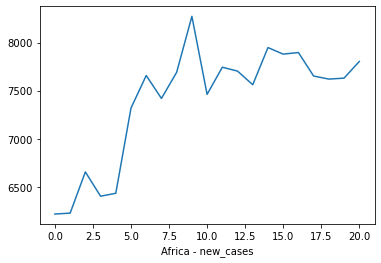

Input: [4686. 5716. 7664. 5408. 5439. 6627. 8181.], Predicted: 6321.590
Input: [5716.   7664.   5408.   5439.   6627.   8181.   6321.59], Predicted: 6400.920
Input: [7664.   5408.   5439.   6627.   8181.   6321.59 6400.92], Predicted: 7113.040
Input: [5408.   5439.   6627.   8181.   6321.59 6400.92 7113.04], Predicted: 6356.840
Input: [5439.   6627.   8181.   6321.59 6400.92 7113.04 6356.84], Predicted: 6317.930
Input: [6627.   8181.   6321.59 6400.92 7113.04 6356.84 6317.93], Predicted: 7306.490
Input: [8181.   6321.59 6400.92 7113.04 6356.84 6317.93 7306.49], Predicted: 7953.080
Input: [6321.59 6400.92 7113.04 6356.84 6317.93 7306.49 7953.08], Predicted: 7697.170
Input: [6400.92 7113.04 6356.84 6317.93 7306.49 7953.08 7697.17], Predicted: 7913.950
Input: [7113.04 6356.84 6317.93 7306.49 7953.08 7697.17 7913.95], Predicted: 8230.450
Input: [6356.84 6317.93 7306.49 7953.08 7697.17 7913.95 8230.45], Predicted: 7652.870
Input: [6317.93 7306.49 7953.08 7697.17 7913.95 8230.45 7652.87], Pr

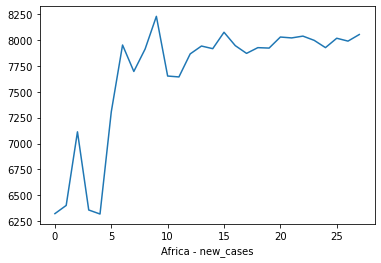

Input: [4686. 5716. 7664. 5408. 5439. 6627. 8181.], Predicted: 6247.770
Input: [5716.   7664.   5408.   5439.   6627.   8181.   6247.77], Predicted: 6307.270
Input: [7664.   5408.   5439.   6627.   8181.   6247.77 6307.27], Predicted: 6804.910
Input: [5408.   5439.   6627.   8181.   6247.77 6307.27 6804.91], Predicted: 6277.550
Input: [5439.   6627.   8181.   6247.77 6307.27 6804.91 6277.55], Predicted: 6268.620
Input: [6627.   8181.   6247.77 6307.27 6804.91 6277.55 6268.62], Predicted: 7294.410
Input: [8181.   6247.77 6307.27 6804.91 6277.55 6268.62 7294.41], Predicted: 7798.890
Input: [6247.77 6307.27 6804.91 6277.55 6268.62 7294.41 7798.89], Predicted: 7462.120
Input: [6307.27 6804.91 6277.55 6268.62 7294.41 7798.89 7462.12], Predicted: 7878.600
Input: [6804.91 6277.55 6268.62 7294.41 7798.89 7462.12 7878.6 ], Predicted: 8125.690
Input: [6277.55 6268.62 7294.41 7798.89 7462.12 7878.6  8125.69], Predicted: 7493.340
Input: [6268.62 7294.41 7798.89 7462.12 7878.6  8125.69 7493.34], Pr

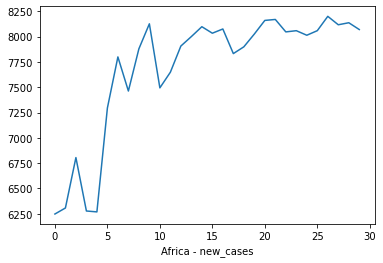

Input: [142. 216. 121. 121.  72. 165. 143.], Predicted: 173.440
Input: [216.   121.   121.    72.   165.   143.   173.44], Predicted: 173.200
Input: [121.   121.    72.   165.   143.   173.44 173.2 ], Predicted: 174.870
Input: [121.    72.   165.   143.   173.44 173.2  174.87], Predicted: 160.290
Input: [ 72.   165.   143.   173.44 173.2  174.87 160.29], Predicted: 175.520
Input: [165.   143.   173.44 173.2  174.87 160.29 175.52], Predicted: 193.180
Input: [143.   173.44 173.2  174.87 160.29 175.52 193.18], Predicted: 201.230
[173.44, 173.2, 174.87, 160.29, 175.52, 193.18, 201.23]


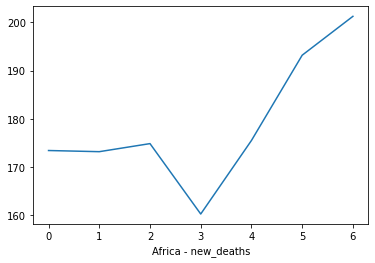

Input: [142. 216. 121. 121.  72. 165. 143.], Predicted: 183.860
Input: [216.   121.   121.    72.   165.   143.   183.86], Predicted: 181.810
Input: [121.   121.    72.   165.   143.   183.86 181.81], Predicted: 186.680
Input: [121.    72.   165.   143.   183.86 181.81 186.68], Predicted: 172.840
Input: [ 72.   165.   143.   183.86 181.81 186.68 172.84], Predicted: 167.810
Input: [165.   143.   183.86 181.81 186.68 172.84 167.81], Predicted: 179.890
Input: [143.   183.86 181.81 186.68 172.84 167.81 179.89], Predicted: 180.180
Input: [183.86 181.81 186.68 172.84 167.81 179.89 180.18], Predicted: 186.190
Input: [181.81 186.68 172.84 167.81 179.89 180.18 186.19], Predicted: 189.940
Input: [186.68 172.84 167.81 179.89 180.18 186.19 189.94], Predicted: 189.900
Input: [172.84 167.81 179.89 180.18 186.19 189.94 189.9 ], Predicted: 190.740
Input: [167.81 179.89 180.18 186.19 189.94 189.9  190.74], Predicted: 192.230
Input: [179.89 180.18 186.19 189.94 189.9  190.74 192.23], Predicted: 191.770


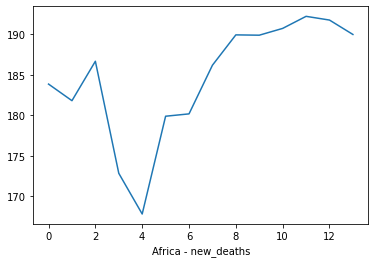

Input: [142. 216. 121. 121.  72. 165. 143.], Predicted: 187.570
Input: [216.   121.   121.    72.   165.   143.   187.57], Predicted: 186.100
Input: [121.   121.    72.   165.   143.   187.57 186.1 ], Predicted: 186.210
Input: [121.    72.   165.   143.   187.57 186.1  186.21], Predicted: 169.040
Input: [ 72.   165.   143.   187.57 186.1  186.21 169.04], Predicted: 177.030
Input: [165.   143.   187.57 186.1  186.21 169.04 177.03], Predicted: 184.260
Input: [143.   187.57 186.1  186.21 169.04 177.03 184.26], Predicted: 191.040
Input: [187.57 186.1  186.21 169.04 177.03 184.26 191.04], Predicted: 197.760
Input: [186.1  186.21 169.04 177.03 184.26 191.04 197.76], Predicted: 196.510
Input: [186.21 169.04 177.03 184.26 191.04 197.76 196.51], Predicted: 195.360
Input: [169.04 177.03 184.26 191.04 197.76 196.51 195.36], Predicted: 204.640
Input: [177.03 184.26 191.04 197.76 196.51 195.36 204.64], Predicted: 200.760
Input: [184.26 191.04 197.76 196.51 195.36 204.64 200.76], Predicted: 206.540


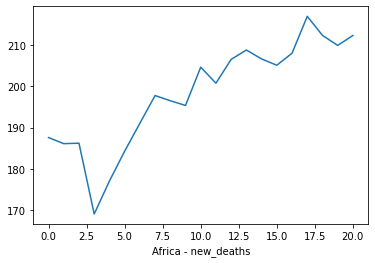

Input: [142. 216. 121. 121.  72. 165. 143.], Predicted: 188.530
Input: [216.   121.   121.    72.   165.   143.   188.53], Predicted: 185.420
Input: [121.   121.    72.   165.   143.   188.53 185.42], Predicted: 177.650
Input: [121.    72.   165.   143.   188.53 185.42 177.65], Predicted: 167.950
Input: [ 72.   165.   143.   188.53 185.42 177.65 167.95], Predicted: 167.280
Input: [165.   143.   188.53 185.42 177.65 167.95 167.28], Predicted: 175.790
Input: [143.   188.53 185.42 177.65 167.95 167.28 175.79], Predicted: 176.830
Input: [188.53 185.42 177.65 167.95 167.28 175.79 176.83], Predicted: 183.620
Input: [185.42 177.65 167.95 167.28 175.79 176.83 183.62], Predicted: 190.560
Input: [177.65 167.95 167.28 175.79 176.83 183.62 190.56], Predicted: 203.190
Input: [167.95 167.28 175.79 176.83 183.62 190.56 203.19], Predicted: 200.130
Input: [167.28 175.79 176.83 183.62 190.56 203.19 200.13], Predicted: 213.790
Input: [175.79 176.83 183.62 190.56 203.19 200.13 213.79], Predicted: 217.170


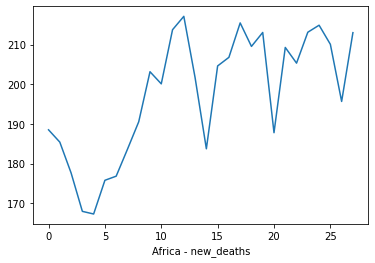

Input: [142. 216. 121. 121.  72. 165. 143.], Predicted: 176.490
Input: [216.   121.   121.    72.   165.   143.   176.49], Predicted: 170.430
Input: [121.   121.    72.   165.   143.   176.49 170.43], Predicted: 175.270
Input: [121.    72.   165.   143.   176.49 170.43 175.27], Predicted: 160.320
Input: [ 72.   165.   143.   176.49 170.43 175.27 160.32], Predicted: 181.060
Input: [165.   143.   176.49 170.43 175.27 160.32 181.06], Predicted: 189.730
Input: [143.   176.49 170.43 175.27 160.32 181.06 189.73], Predicted: 193.900
Input: [176.49 170.43 175.27 160.32 181.06 189.73 193.9 ], Predicted: 188.550
Input: [170.43 175.27 160.32 181.06 189.73 193.9  188.55], Predicted: 189.030
Input: [175.27 160.32 181.06 189.73 193.9  188.55 189.03], Predicted: 183.220
Input: [160.32 181.06 189.73 193.9  188.55 189.03 183.22], Predicted: 174.050
Input: [181.06 189.73 193.9  188.55 189.03 183.22 174.05], Predicted: 181.120
Input: [189.73 193.9  188.55 189.03 183.22 174.05 181.12], Predicted: 181.560


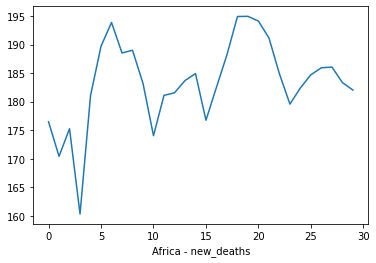

Input: [81596082. 81694369. 81782455. 81863212. 81941193. 82020945. 82111023.], Predicted: 82059572.220
Input: [81694369.   81782455.   81863212.   81941193.   82020945.   82111023.
 82059572.22], Predicted: 82059572.220
Input: [81782455.   81863212.   81941193.   82020945.   82111023.   82059572.22
 82059572.22], Predicted: 82059572.220
Input: [81863212.   81941193.   82020945.   82111023.   82059572.22 82059572.22
 82059572.22], Predicted: 82059572.220
Input: [81941193.   82020945.   82111023.   82059572.22 82059572.22 82059572.22
 82059572.22], Predicted: 82059572.220
Input: [82020945.   82111023.   82059572.22 82059572.22 82059572.22 82059572.22
 82059572.22], Predicted: 82059572.220
Input: [82111023.   82059572.22 82059572.22 82059572.22 82059572.22 82059572.22
 82059572.22], Predicted: 82059572.220
[82059572.22, 82059572.22, 82059572.22, 82059572.22, 82059572.22, 82059572.22, 82059572.22]


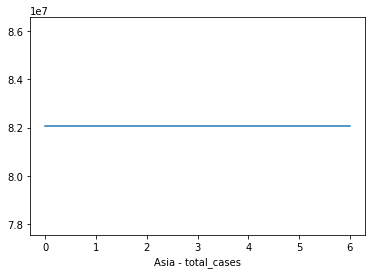

Input: [81596082. 81694369. 81782455. 81863212. 81941193. 82020945. 82111023.], Predicted: 82073581.710
Input: [81694369.   81782455.   81863212.   81941193.   82020945.   82111023.
 82073581.71], Predicted: 82073581.710
Input: [81782455.   81863212.   81941193.   82020945.   82111023.   82073581.71
 82073581.71], Predicted: 82073581.710
Input: [81863212.   81941193.   82020945.   82111023.   82073581.71 82073581.71
 82073581.71], Predicted: 82073581.710
Input: [81941193.   82020945.   82111023.   82073581.71 82073581.71 82073581.71
 82073581.71], Predicted: 82073581.710
Input: [82020945.   82111023.   82073581.71 82073581.71 82073581.71 82073581.71
 82073581.71], Predicted: 82073581.710
Input: [82111023.   82073581.71 82073581.71 82073581.71 82073581.71 82073581.71
 82073581.71], Predicted: 82073581.710
Input: [82073581.71 82073581.71 82073581.71 82073581.71 82073581.71 82073581.71
 82073581.71], Predicted: 82073581.710
Input: [82073581.71 82073581.71 82073581.71 82073581.71 82073581.

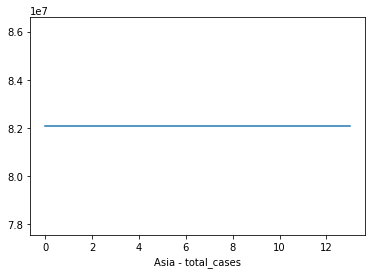

Input: [81596082. 81694369. 81782455. 81863212. 81941193. 82020945. 82111023.], Predicted: 82062177.310
Input: [81694369.   81782455.   81863212.   81941193.   82020945.   82111023.
 82062177.31], Predicted: 82062177.310
Input: [81782455.   81863212.   81941193.   82020945.   82111023.   82062177.31
 82062177.31], Predicted: 82062177.310
Input: [81863212.   81941193.   82020945.   82111023.   82062177.31 82062177.31
 82062177.31], Predicted: 82062177.310
Input: [81941193.   82020945.   82111023.   82062177.31 82062177.31 82062177.31
 82062177.31], Predicted: 82062177.310
Input: [82020945.   82111023.   82062177.31 82062177.31 82062177.31 82062177.31
 82062177.31], Predicted: 82062177.310
Input: [82111023.   82062177.31 82062177.31 82062177.31 82062177.31 82062177.31
 82062177.31], Predicted: 82062177.310
Input: [82062177.31 82062177.31 82062177.31 82062177.31 82062177.31 82062177.31
 82062177.31], Predicted: 82062177.310
Input: [82062177.31 82062177.31 82062177.31 82062177.31 82062177.

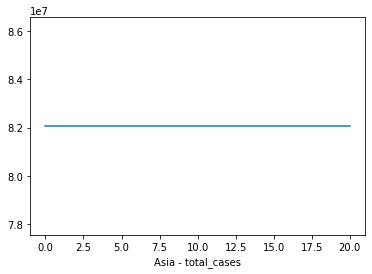

Input: [81596082. 81694369. 81782455. 81863212. 81941193. 82020945. 82111023.], Predicted: 82075194.460
Input: [81694369.   81782455.   81863212.   81941193.   82020945.   82111023.
 82075194.46], Predicted: 82075194.460
Input: [81782455.   81863212.   81941193.   82020945.   82111023.   82075194.46
 82075194.46], Predicted: 82075194.460
Input: [81863212.   81941193.   82020945.   82111023.   82075194.46 82075194.46
 82075194.46], Predicted: 82075194.460
Input: [81941193.   82020945.   82111023.   82075194.46 82075194.46 82075194.46
 82075194.46], Predicted: 82075194.460
Input: [82020945.   82111023.   82075194.46 82075194.46 82075194.46 82075194.46
 82075194.46], Predicted: 82075194.460
Input: [82111023.   82075194.46 82075194.46 82075194.46 82075194.46 82075194.46
 82075194.46], Predicted: 82075194.460
Input: [82075194.46 82075194.46 82075194.46 82075194.46 82075194.46 82075194.46
 82075194.46], Predicted: 82075194.460
Input: [82075194.46 82075194.46 82075194.46 82075194.46 82075194.

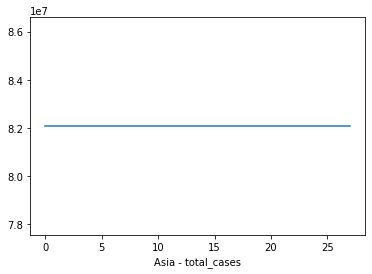

Input: [81596082. 81694369. 81782455. 81863212. 81941193. 82020945. 82111023.], Predicted: 82067474.930
Input: [81694369.   81782455.   81863212.   81941193.   82020945.   82111023.
 82067474.93], Predicted: 82067474.930
Input: [81782455.   81863212.   81941193.   82020945.   82111023.   82067474.93
 82067474.93], Predicted: 82067474.930
Input: [81863212.   81941193.   82020945.   82111023.   82067474.93 82067474.93
 82067474.93], Predicted: 82067474.930
Input: [81941193.   82020945.   82111023.   82067474.93 82067474.93 82067474.93
 82067474.93], Predicted: 82067474.930
Input: [82020945.   82111023.   82067474.93 82067474.93 82067474.93 82067474.93
 82067474.93], Predicted: 82067474.930
Input: [82111023.   82067474.93 82067474.93 82067474.93 82067474.93 82067474.93
 82067474.93], Predicted: 82067474.930
Input: [82067474.93 82067474.93 82067474.93 82067474.93 82067474.93 82067474.93
 82067474.93], Predicted: 82067474.930
Input: [82067474.93 82067474.93 82067474.93 82067474.93 82067474.

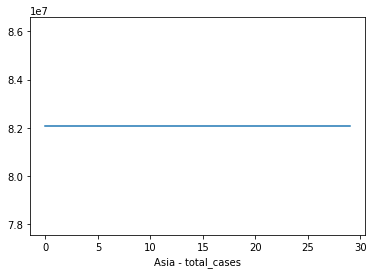

Input: [1210362. 1212025. 1213483. 1215062. 1216288. 1217513. 1218767.], Predicted: 1217730.300
Input: [1212025.  1213483.  1215062.  1216288.  1217513.  1218767.  1217730.3], Predicted: 1217730.300
Input: [1213483.  1215062.  1216288.  1217513.  1218767.  1217730.3 1217730.3], Predicted: 1217730.300
Input: [1215062.  1216288.  1217513.  1218767.  1217730.3 1217730.3 1217730.3], Predicted: 1217730.300
Input: [1216288.  1217513.  1218767.  1217730.3 1217730.3 1217730.3 1217730.3], Predicted: 1217730.300
Input: [1217513.  1218767.  1217730.3 1217730.3 1217730.3 1217730.3 1217730.3], Predicted: 1217730.300
Input: [1218767.  1217730.3 1217730.3 1217730.3 1217730.3 1217730.3 1217730.3], Predicted: 1217730.300
[1217730.3, 1217730.3, 1217730.3, 1217730.3, 1217730.3, 1217730.3, 1217730.3]


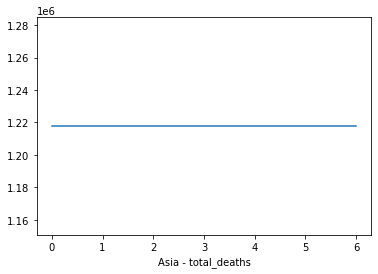

Input: [1210362. 1212025. 1213483. 1215062. 1216288. 1217513. 1218767.], Predicted: 1218015.910
Input: [1212025.   1213483.   1215062.   1216288.   1217513.   1218767.
 1218015.91], Predicted: 1218015.910
Input: [1213483.   1215062.   1216288.   1217513.   1218767.   1218015.91
 1218015.91], Predicted: 1218015.910
Input: [1215062.   1216288.   1217513.   1218767.   1218015.91 1218015.91
 1218015.91], Predicted: 1218015.910
Input: [1216288.   1217513.   1218767.   1218015.91 1218015.91 1218015.91
 1218015.91], Predicted: 1218015.910
Input: [1217513.   1218767.   1218015.91 1218015.91 1218015.91 1218015.91
 1218015.91], Predicted: 1218015.910
Input: [1218767.   1218015.91 1218015.91 1218015.91 1218015.91 1218015.91
 1218015.91], Predicted: 1218015.910
Input: [1218015.91 1218015.91 1218015.91 1218015.91 1218015.91 1218015.91
 1218015.91], Predicted: 1218015.910
Input: [1218015.91 1218015.91 1218015.91 1218015.91 1218015.91 1218015.91
 1218015.91], Predicted: 1218015.910
Input: [1218015.91

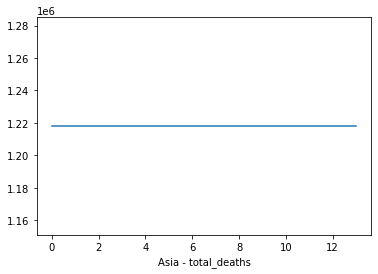

Input: [1210362. 1212025. 1213483. 1215062. 1216288. 1217513. 1218767.], Predicted: 1218068.410
Input: [1212025.   1213483.   1215062.   1216288.   1217513.   1218767.
 1218068.41], Predicted: 1218068.410
Input: [1213483.   1215062.   1216288.   1217513.   1218767.   1218068.41
 1218068.41], Predicted: 1218068.410
Input: [1215062.   1216288.   1217513.   1218767.   1218068.41 1218068.41
 1218068.41], Predicted: 1218068.410
Input: [1216288.   1217513.   1218767.   1218068.41 1218068.41 1218068.41
 1218068.41], Predicted: 1218068.410
Input: [1217513.   1218767.   1218068.41 1218068.41 1218068.41 1218068.41
 1218068.41], Predicted: 1218068.410
Input: [1218767.   1218068.41 1218068.41 1218068.41 1218068.41 1218068.41
 1218068.41], Predicted: 1218068.410
Input: [1218068.41 1218068.41 1218068.41 1218068.41 1218068.41 1218068.41
 1218068.41], Predicted: 1218068.410
Input: [1218068.41 1218068.41 1218068.41 1218068.41 1218068.41 1218068.41
 1218068.41], Predicted: 1218068.410
Input: [1218068.41

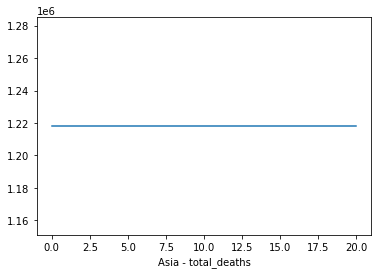

Input: [1210362. 1212025. 1213483. 1215062. 1216288. 1217513. 1218767.], Predicted: 1217992.580
Input: [1212025.   1213483.   1215062.   1216288.   1217513.   1218767.
 1217992.58], Predicted: 1217992.580
Input: [1213483.   1215062.   1216288.   1217513.   1218767.   1217992.58
 1217992.58], Predicted: 1217992.580
Input: [1215062.   1216288.   1217513.   1218767.   1217992.58 1217992.58
 1217992.58], Predicted: 1217992.580
Input: [1216288.   1217513.   1218767.   1217992.58 1217992.58 1217992.58
 1217992.58], Predicted: 1217992.580
Input: [1217513.   1218767.   1217992.58 1217992.58 1217992.58 1217992.58
 1217992.58], Predicted: 1217992.580
Input: [1218767.   1217992.58 1217992.58 1217992.58 1217992.58 1217992.58
 1217992.58], Predicted: 1217992.580
Input: [1217992.58 1217992.58 1217992.58 1217992.58 1217992.58 1217992.58
 1217992.58], Predicted: 1217992.580
Input: [1217992.58 1217992.58 1217992.58 1217992.58 1217992.58 1217992.58
 1217992.58], Predicted: 1217992.580
Input: [1217992.58

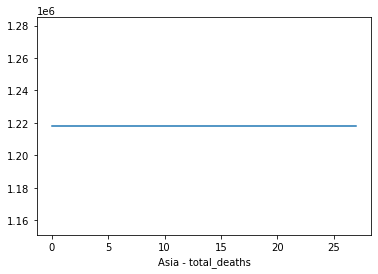

Input: [1210362. 1212025. 1213483. 1215062. 1216288. 1217513. 1218767.], Predicted: 1218169.080
Input: [1212025.   1213483.   1215062.   1216288.   1217513.   1218767.
 1218169.08], Predicted: 1218169.080
Input: [1213483.   1215062.   1216288.   1217513.   1218767.   1218169.08
 1218169.08], Predicted: 1218169.080
Input: [1215062.   1216288.   1217513.   1218767.   1218169.08 1218169.08
 1218169.08], Predicted: 1218169.080
Input: [1216288.   1217513.   1218767.   1218169.08 1218169.08 1218169.08
 1218169.08], Predicted: 1218169.080
Input: [1217513.   1218767.   1218169.08 1218169.08 1218169.08 1218169.08
 1218169.08], Predicted: 1218169.080
Input: [1218767.   1218169.08 1218169.08 1218169.08 1218169.08 1218169.08
 1218169.08], Predicted: 1218169.080
Input: [1218169.08 1218169.08 1218169.08 1218169.08 1218169.08 1218169.08
 1218169.08], Predicted: 1218169.080
Input: [1218169.08 1218169.08 1218169.08 1218169.08 1218169.08 1218169.08
 1218169.08], Predicted: 1218169.080
Input: [1218169.08

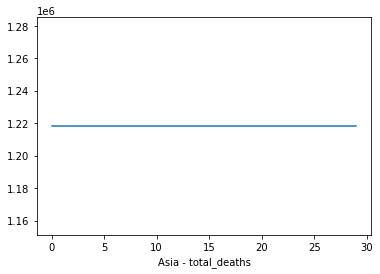

Input: [5.30380735e+09 5.32423868e+09 5.34947113e+09 5.36980333e+09
 5.39963786e+09 5.41809163e+09 5.44611788e+09], Predicted: 5428923485.100
Input: [5.32423868e+09 5.34947113e+09 5.36980333e+09 5.39963786e+09
 5.41809163e+09 5.44611788e+09 5.42892349e+09], Predicted: 5428923485.100
Input: [5.34947113e+09 5.36980333e+09 5.39963786e+09 5.41809163e+09
 5.44611788e+09 5.42892349e+09 5.42892349e+09], Predicted: 5428923485.100
Input: [5.36980333e+09 5.39963786e+09 5.41809163e+09 5.44611788e+09
 5.42892349e+09 5.42892349e+09 5.42892349e+09], Predicted: 5428923485.100
Input: [5.39963786e+09 5.41809163e+09 5.44611788e+09 5.42892349e+09
 5.42892349e+09 5.42892349e+09 5.42892349e+09], Predicted: 5428923485.100
Input: [5.41809163e+09 5.44611788e+09 5.42892349e+09 5.42892349e+09
 5.42892349e+09 5.42892349e+09 5.42892349e+09], Predicted: 5428923485.100
Input: [5.44611788e+09 5.42892349e+09 5.42892349e+09 5.42892349e+09
 5.42892349e+09 5.42892349e+09 5.42892349e+09], Predicted: 5428923485.100
[54289

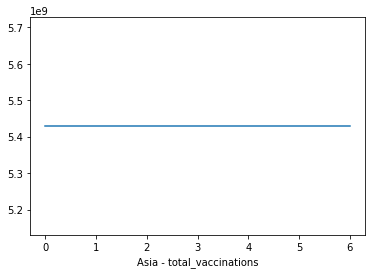

Input: [5.30380735e+09 5.32423868e+09 5.34947113e+09 5.36980333e+09
 5.39963786e+09 5.41809163e+09 5.44611788e+09], Predicted: 5431522240.140
Input: [5.32423868e+09 5.34947113e+09 5.36980333e+09 5.39963786e+09
 5.41809163e+09 5.44611788e+09 5.43152224e+09], Predicted: 5431522240.140
Input: [5.34947113e+09 5.36980333e+09 5.39963786e+09 5.41809163e+09
 5.44611788e+09 5.43152224e+09 5.43152224e+09], Predicted: 5431522240.140
Input: [5.36980333e+09 5.39963786e+09 5.41809163e+09 5.44611788e+09
 5.43152224e+09 5.43152224e+09 5.43152224e+09], Predicted: 5431522240.140
Input: [5.39963786e+09 5.41809163e+09 5.44611788e+09 5.43152224e+09
 5.43152224e+09 5.43152224e+09 5.43152224e+09], Predicted: 5431522240.140
Input: [5.41809163e+09 5.44611788e+09 5.43152224e+09 5.43152224e+09
 5.43152224e+09 5.43152224e+09 5.43152224e+09], Predicted: 5431522240.140
Input: [5.44611788e+09 5.43152224e+09 5.43152224e+09 5.43152224e+09
 5.43152224e+09 5.43152224e+09 5.43152224e+09], Predicted: 5431522240.140
Input:

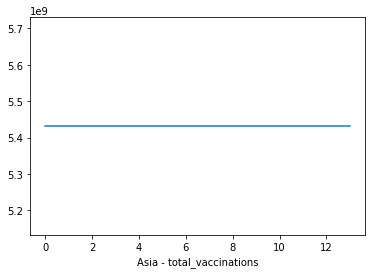

Input: [5.30380735e+09 5.32423868e+09 5.34947113e+09 5.36980333e+09
 5.39963786e+09 5.41809163e+09 5.44611788e+09], Predicted: 5431198483.930
Input: [5.32423868e+09 5.34947113e+09 5.36980333e+09 5.39963786e+09
 5.41809163e+09 5.44611788e+09 5.43119848e+09], Predicted: 5431198483.930
Input: [5.34947113e+09 5.36980333e+09 5.39963786e+09 5.41809163e+09
 5.44611788e+09 5.43119848e+09 5.43119848e+09], Predicted: 5431198483.930
Input: [5.36980333e+09 5.39963786e+09 5.41809163e+09 5.44611788e+09
 5.43119848e+09 5.43119848e+09 5.43119848e+09], Predicted: 5431198483.930
Input: [5.39963786e+09 5.41809163e+09 5.44611788e+09 5.43119848e+09
 5.43119848e+09 5.43119848e+09 5.43119848e+09], Predicted: 5431198483.930
Input: [5.41809163e+09 5.44611788e+09 5.43119848e+09 5.43119848e+09
 5.43119848e+09 5.43119848e+09 5.43119848e+09], Predicted: 5431198483.930
Input: [5.44611788e+09 5.43119848e+09 5.43119848e+09 5.43119848e+09
 5.43119848e+09 5.43119848e+09 5.43119848e+09], Predicted: 5431198483.930
Input:

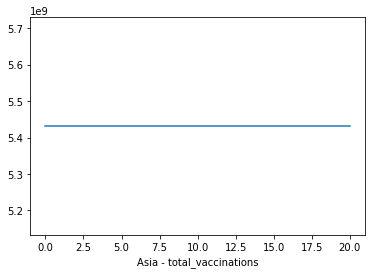

Input: [5.30380735e+09 5.32423868e+09 5.34947113e+09 5.36980333e+09
 5.39963786e+09 5.41809163e+09 5.44611788e+09], Predicted: 5430585509.800
Input: [5.32423868e+09 5.34947113e+09 5.36980333e+09 5.39963786e+09
 5.41809163e+09 5.44611788e+09 5.43058551e+09], Predicted: 5430585509.800
Input: [5.34947113e+09 5.36980333e+09 5.39963786e+09 5.41809163e+09
 5.44611788e+09 5.43058551e+09 5.43058551e+09], Predicted: 5430585509.800
Input: [5.36980333e+09 5.39963786e+09 5.41809163e+09 5.44611788e+09
 5.43058551e+09 5.43058551e+09 5.43058551e+09], Predicted: 5430585509.800
Input: [5.39963786e+09 5.41809163e+09 5.44611788e+09 5.43058551e+09
 5.43058551e+09 5.43058551e+09 5.43058551e+09], Predicted: 5430585509.800
Input: [5.41809163e+09 5.44611788e+09 5.43058551e+09 5.43058551e+09
 5.43058551e+09 5.43058551e+09 5.43058551e+09], Predicted: 5430585509.800
Input: [5.44611788e+09 5.43058551e+09 5.43058551e+09 5.43058551e+09
 5.43058551e+09 5.43058551e+09 5.43058551e+09], Predicted: 5430585509.800
Input:

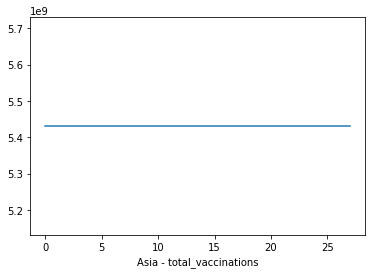

Input: [5.30380735e+09 5.32423868e+09 5.34947113e+09 5.36980333e+09
 5.39963786e+09 5.41809163e+09 5.44611788e+09], Predicted: 5430922906.060
Input: [5.32423868e+09 5.34947113e+09 5.36980333e+09 5.39963786e+09
 5.41809163e+09 5.44611788e+09 5.43092291e+09], Predicted: 5430922906.060
Input: [5.34947113e+09 5.36980333e+09 5.39963786e+09 5.41809163e+09
 5.44611788e+09 5.43092291e+09 5.43092291e+09], Predicted: 5430922906.060
Input: [5.36980333e+09 5.39963786e+09 5.41809163e+09 5.44611788e+09
 5.43092291e+09 5.43092291e+09 5.43092291e+09], Predicted: 5430922906.060
Input: [5.39963786e+09 5.41809163e+09 5.44611788e+09 5.43092291e+09
 5.43092291e+09 5.43092291e+09 5.43092291e+09], Predicted: 5430922906.060
Input: [5.41809163e+09 5.44611788e+09 5.43092291e+09 5.43092291e+09
 5.43092291e+09 5.43092291e+09 5.43092291e+09], Predicted: 5430922906.060
Input: [5.44611788e+09 5.43092291e+09 5.43092291e+09 5.43092291e+09
 5.43092291e+09 5.43092291e+09 5.43092291e+09], Predicted: 5430922906.060
Input:

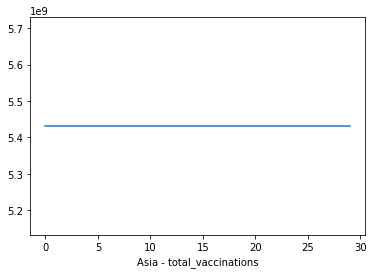

Input: [2.20887930e+09 2.21662987e+09 2.22678335e+09 2.23242877e+09
 2.24355122e+09 2.28406833e+09 2.29364673e+09], Predicted: 2283799613.280
Input: [2.21662987e+09 2.22678335e+09 2.23242877e+09 2.24355122e+09
 2.28406833e+09 2.29364673e+09 2.28379961e+09], Predicted: 2283799613.280
Input: [2.22678335e+09 2.23242877e+09 2.24355122e+09 2.28406833e+09
 2.29364673e+09 2.28379961e+09 2.28379961e+09], Predicted: 2283799613.280
Input: [2.23242877e+09 2.24355122e+09 2.28406833e+09 2.29364673e+09
 2.28379961e+09 2.28379961e+09 2.28379961e+09], Predicted: 2283799613.280
Input: [2.24355122e+09 2.28406833e+09 2.29364673e+09 2.28379961e+09
 2.28379961e+09 2.28379961e+09 2.28379961e+09], Predicted: 2283799613.280
Input: [2.28406833e+09 2.29364673e+09 2.28379961e+09 2.28379961e+09
 2.28379961e+09 2.28379961e+09 2.28379961e+09], Predicted: 2283799613.280
Input: [2.29364673e+09 2.28379961e+09 2.28379961e+09 2.28379961e+09
 2.28379961e+09 2.28379961e+09 2.28379961e+09], Predicted: 2283799613.280
[22837

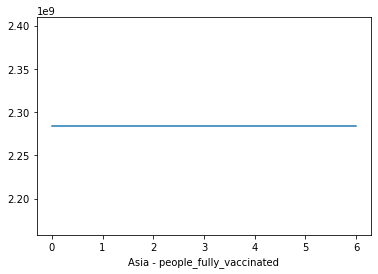

Input: [2.20887930e+09 2.21662987e+09 2.22678335e+09 2.23242877e+09
 2.24355122e+09 2.28406833e+09 2.29364673e+09], Predicted: 2284821909.390
Input: [2.21662987e+09 2.22678335e+09 2.23242877e+09 2.24355122e+09
 2.28406833e+09 2.29364673e+09 2.28482191e+09], Predicted: 2284821909.390
Input: [2.22678335e+09 2.23242877e+09 2.24355122e+09 2.28406833e+09
 2.29364673e+09 2.28482191e+09 2.28482191e+09], Predicted: 2284821909.390
Input: [2.23242877e+09 2.24355122e+09 2.28406833e+09 2.29364673e+09
 2.28482191e+09 2.28482191e+09 2.28482191e+09], Predicted: 2284821909.390
Input: [2.24355122e+09 2.28406833e+09 2.29364673e+09 2.28482191e+09
 2.28482191e+09 2.28482191e+09 2.28482191e+09], Predicted: 2284821909.390
Input: [2.28406833e+09 2.29364673e+09 2.28482191e+09 2.28482191e+09
 2.28482191e+09 2.28482191e+09 2.28482191e+09], Predicted: 2284821909.390
Input: [2.29364673e+09 2.28482191e+09 2.28482191e+09 2.28482191e+09
 2.28482191e+09 2.28482191e+09 2.28482191e+09], Predicted: 2284821909.390
Input:

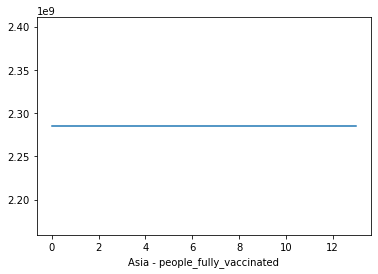

Input: [2.20887930e+09 2.21662987e+09 2.22678335e+09 2.23242877e+09
 2.24355122e+09 2.28406833e+09 2.29364673e+09], Predicted: 2283341525.980
Input: [2.21662987e+09 2.22678335e+09 2.23242877e+09 2.24355122e+09
 2.28406833e+09 2.29364673e+09 2.28334153e+09], Predicted: 2283341525.980
Input: [2.22678335e+09 2.23242877e+09 2.24355122e+09 2.28406833e+09
 2.29364673e+09 2.28334153e+09 2.28334153e+09], Predicted: 2283341525.980
Input: [2.23242877e+09 2.24355122e+09 2.28406833e+09 2.29364673e+09
 2.28334153e+09 2.28334153e+09 2.28334153e+09], Predicted: 2283341525.980
Input: [2.24355122e+09 2.28406833e+09 2.29364673e+09 2.28334153e+09
 2.28334153e+09 2.28334153e+09 2.28334153e+09], Predicted: 2283341525.980
Input: [2.28406833e+09 2.29364673e+09 2.28334153e+09 2.28334153e+09
 2.28334153e+09 2.28334153e+09 2.28334153e+09], Predicted: 2283341525.980
Input: [2.29364673e+09 2.28334153e+09 2.28334153e+09 2.28334153e+09
 2.28334153e+09 2.28334153e+09 2.28334153e+09], Predicted: 2283341525.980
Input:

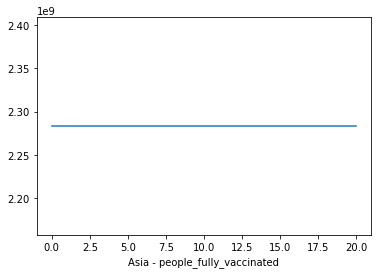

Input: [2.20887930e+09 2.21662987e+09 2.22678335e+09 2.23242877e+09
 2.24355122e+09 2.28406833e+09 2.29364673e+09], Predicted: 2286148647.120
Input: [2.21662987e+09 2.22678335e+09 2.23242877e+09 2.24355122e+09
 2.28406833e+09 2.29364673e+09 2.28614865e+09], Predicted: 2286148647.120
Input: [2.22678335e+09 2.23242877e+09 2.24355122e+09 2.28406833e+09
 2.29364673e+09 2.28614865e+09 2.28614865e+09], Predicted: 2286148647.120
Input: [2.23242877e+09 2.24355122e+09 2.28406833e+09 2.29364673e+09
 2.28614865e+09 2.28614865e+09 2.28614865e+09], Predicted: 2286148647.120
Input: [2.24355122e+09 2.28406833e+09 2.29364673e+09 2.28614865e+09
 2.28614865e+09 2.28614865e+09 2.28614865e+09], Predicted: 2286148647.120
Input: [2.28406833e+09 2.29364673e+09 2.28614865e+09 2.28614865e+09
 2.28614865e+09 2.28614865e+09 2.28614865e+09], Predicted: 2286148647.120
Input: [2.29364673e+09 2.28614865e+09 2.28614865e+09 2.28614865e+09
 2.28614865e+09 2.28614865e+09 2.28614865e+09], Predicted: 2286148647.120
Input:

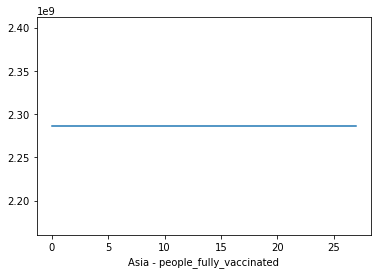

Input: [2.20887930e+09 2.21662987e+09 2.22678335e+09 2.23242877e+09
 2.24355122e+09 2.28406833e+09 2.29364673e+09], Predicted: 2286712650.970
Input: [2.21662987e+09 2.22678335e+09 2.23242877e+09 2.24355122e+09
 2.28406833e+09 2.29364673e+09 2.28671265e+09], Predicted: 2286712650.970
Input: [2.22678335e+09 2.23242877e+09 2.24355122e+09 2.28406833e+09
 2.29364673e+09 2.28671265e+09 2.28671265e+09], Predicted: 2286712650.970
Input: [2.23242877e+09 2.24355122e+09 2.28406833e+09 2.29364673e+09
 2.28671265e+09 2.28671265e+09 2.28671265e+09], Predicted: 2286712650.970
Input: [2.24355122e+09 2.28406833e+09 2.29364673e+09 2.28671265e+09
 2.28671265e+09 2.28671265e+09 2.28671265e+09], Predicted: 2286712650.970
Input: [2.28406833e+09 2.29364673e+09 2.28671265e+09 2.28671265e+09
 2.28671265e+09 2.28671265e+09 2.28671265e+09], Predicted: 2286712650.970
Input: [2.29364673e+09 2.28671265e+09 2.28671265e+09 2.28671265e+09
 2.28671265e+09 2.28671265e+09 2.28671265e+09], Predicted: 2286712650.970
Input:

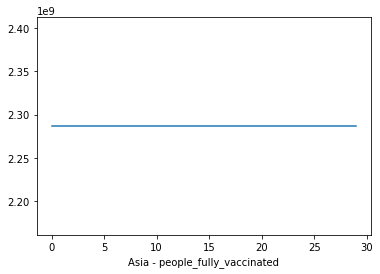

Input: [93253. 98287. 88086. 80757. 77981. 79752. 90078.], Predicted: 92553.770
Input: [98287.   88086.   80757.   77981.   79752.   90078.   92553.77], Predicted: 91760.150
Input: [88086.   80757.   77981.   79752.   90078.   92553.77 91760.15], Predicted: 91986.920
Input: [80757.   77981.   79752.   90078.   92553.77 91760.15 91986.92], Predicted: 89724.520
Input: [77981.   79752.   90078.   92553.77 91760.15 91986.92 89724.52], Predicted: 90613.400
Input: [79752.   90078.   92553.77 91760.15 91986.92 89724.52 90613.4 ], Predicted: 93530.240
Input: [90078.   92553.77 91760.15 91986.92 89724.52 90613.4  93530.24], Predicted: 96440.430
[92553.77, 91760.15, 91986.92, 89724.52, 90613.4, 93530.24, 96440.43]


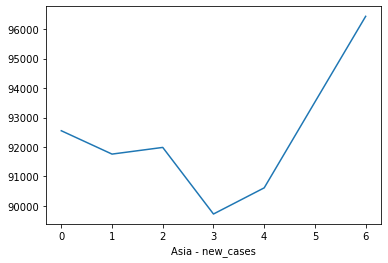

Input: [93253. 98287. 88086. 80757. 77981. 79752. 90078.], Predicted: 93027.510
Input: [98287.   88086.   80757.   77981.   79752.   90078.   93027.51], Predicted: 91656.420
Input: [88086.   80757.   77981.   79752.   90078.   93027.51 91656.42], Predicted: 91701.920
Input: [80757.   77981.   79752.   90078.   93027.51 91656.42 91701.92], Predicted: 90143.430
Input: [77981.   79752.   90078.   93027.51 91656.42 91701.92 90143.43], Predicted: 90776.850
Input: [79752.   90078.   93027.51 91656.42 91701.92 90143.43 90776.85], Predicted: 93161.320
Input: [90078.   93027.51 91656.42 91701.92 90143.43 90776.85 93161.32], Predicted: 95344.560
Input: [93027.51 91656.42 91701.92 90143.43 90776.85 93161.32 95344.56], Predicted: 96283.060
Input: [91656.42 91701.92 90143.43 90776.85 93161.32 95344.56 96283.06], Predicted: 96993.710
Input: [91701.92 90143.43 90776.85 93161.32 95344.56 96283.06 96993.71], Predicted: 94608.130
Input: [90143.43 90776.85 93161.32 95344.56 96283.06 96993.71 94608.13], P

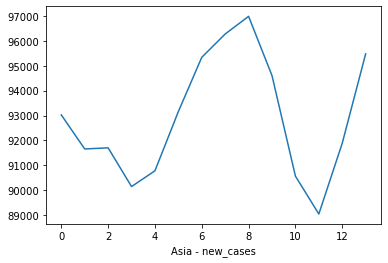

Input: [93253. 98287. 88086. 80757. 77981. 79752. 90078.], Predicted: 94206.120
Input: [98287.   88086.   80757.   77981.   79752.   90078.   94206.12], Predicted: 92296.590
Input: [88086.   80757.   77981.   79752.   90078.   94206.12 92296.59], Predicted: 91351.690
Input: [80757.   77981.   79752.   90078.   94206.12 92296.59 91351.69], Predicted: 88933.610
Input: [77981.   79752.   90078.   94206.12 92296.59 91351.69 88933.61], Predicted: 87538.060
Input: [79752.   90078.   94206.12 92296.59 91351.69 88933.61 87538.06], Predicted: 86312.210
Input: [90078.   94206.12 92296.59 91351.69 88933.61 87538.06 86312.21], Predicted: 91460.430
Input: [94206.12 92296.59 91351.69 88933.61 87538.06 86312.21 91460.43], Predicted: 94409.410
Input: [92296.59 91351.69 88933.61 87538.06 86312.21 91460.43 94409.41], Predicted: 96390.230
Input: [91351.69 88933.61 87538.06 86312.21 91460.43 94409.41 96390.23], Predicted: 97519.500
Input: [88933.61 87538.06 86312.21 91460.43 94409.41 96390.23 97519.5 ], P

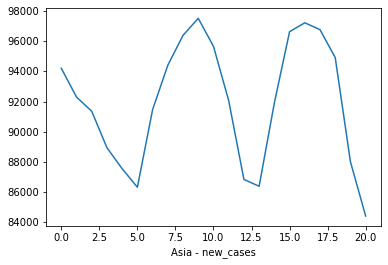

Input: [93253. 98287. 88086. 80757. 77981. 79752. 90078.], Predicted: 92155.320
Input: [98287.   88086.   80757.   77981.   79752.   90078.   92155.32], Predicted: 91810.090
Input: [88086.   80757.   77981.   79752.   90078.   92155.32 91810.09], Predicted: 90068.950
Input: [80757.   77981.   79752.   90078.   92155.32 91810.09 90068.95], Predicted: 88519.440
Input: [77981.   79752.   90078.   92155.32 91810.09 90068.95 88519.44], Predicted: 85493.860
Input: [79752.   90078.   92155.32 91810.09 90068.95 88519.44 85493.86], Predicted: 84217.650
Input: [90078.   92155.32 91810.09 90068.95 88519.44 85493.86 84217.65], Predicted: 91377.550
Input: [92155.32 91810.09 90068.95 88519.44 85493.86 84217.65 91377.55], Predicted: 93958.280
Input: [91810.09 90068.95 88519.44 85493.86 84217.65 91377.55 93958.28], Predicted: 95415.220
Input: [90068.95 88519.44 85493.86 84217.65 91377.55 93958.28 95415.22], Predicted: 92952.700
Input: [88519.44 85493.86 84217.65 91377.55 93958.28 95415.22 92952.7 ], P

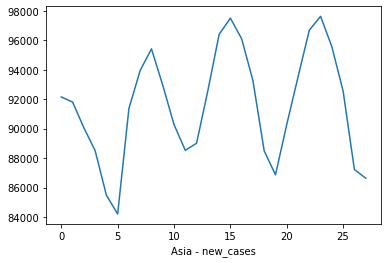

Input: [93253. 98287. 88086. 80757. 77981. 79752. 90078.], Predicted: 94450.200
Input: [98287.  88086.  80757.  77981.  79752.  90078.  94450.2], Predicted: 92797.780
Input: [88086.   80757.   77981.   79752.   90078.   94450.2  92797.78], Predicted: 92096.950
Input: [80757.   77981.   79752.   90078.   94450.2  92797.78 92096.95], Predicted: 88829.450
Input: [77981.   79752.   90078.   94450.2  92797.78 92096.95 88829.45], Predicted: 88623.310
Input: [79752.   90078.   94450.2  92797.78 92096.95 88829.45 88623.31], Predicted: 87059.170
Input: [90078.   94450.2  92797.78 92096.95 88829.45 88623.31 87059.17], Predicted: 90693.710
Input: [94450.2  92797.78 92096.95 88829.45 88623.31 87059.17 90693.71], Predicted: 93949.300
Input: [92797.78 92096.95 88829.45 88623.31 87059.17 90693.71 93949.3 ], Predicted: 96304.640
Input: [92096.95 88829.45 88623.31 87059.17 90693.71 93949.3  96304.64], Predicted: 96827.580
Input: [88829.45 88623.31 87059.17 90693.71 93949.3  96304.64 96827.58], Predicte

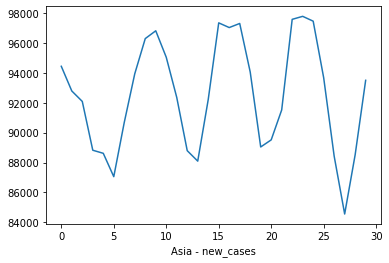

Input: [1437. 1663. 1458. 1579. 1226. 1225. 1254.], Predicted: 1355.850
Input: [1663.   1458.   1579.   1226.   1225.   1254.   1355.85], Predicted: 1407.000
Input: [1458.   1579.   1226.   1225.   1254.   1355.85 1407.  ], Predicted: 1405.350
Input: [1579.   1226.   1225.   1254.   1355.85 1407.   1405.35], Predicted: 1412.740
Input: [1226.   1225.   1254.   1355.85 1407.   1405.35 1412.74], Predicted: 1326.790
Input: [1225.   1254.   1355.85 1407.   1405.35 1412.74 1326.79], Predicted: 1299.460
Input: [1254.   1355.85 1407.   1405.35 1412.74 1326.79 1299.46], Predicted: 1322.500
[1355.85, 1407.0, 1405.35, 1412.74, 1326.79, 1299.46, 1322.5]


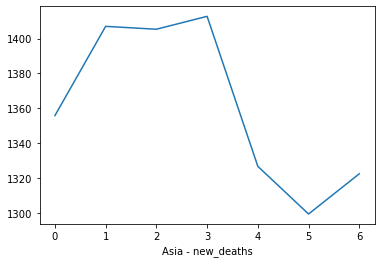

Input: [1437. 1663. 1458. 1579. 1226. 1225. 1254.], Predicted: 1383.120
Input: [1663.   1458.   1579.   1226.   1225.   1254.   1383.12], Predicted: 1410.470
Input: [1458.   1579.   1226.   1225.   1254.   1383.12 1410.47], Predicted: 1402.510
Input: [1579.   1226.   1225.   1254.   1383.12 1410.47 1402.51], Predicted: 1436.250
Input: [1226.   1225.   1254.   1383.12 1410.47 1402.51 1436.25], Predicted: 1377.990
Input: [1225.   1254.   1383.12 1410.47 1402.51 1436.25 1377.99], Predicted: 1297.990
Input: [1254.   1383.12 1410.47 1402.51 1436.25 1377.99 1297.99], Predicted: 1328.580
Input: [1383.12 1410.47 1402.51 1436.25 1377.99 1297.99 1328.58], Predicted: 1365.940
Input: [1410.47 1402.51 1436.25 1377.99 1297.99 1328.58 1365.94], Predicted: 1381.610
Input: [1402.51 1436.25 1377.99 1297.99 1328.58 1365.94 1381.61], Predicted: 1389.800
Input: [1436.25 1377.99 1297.99 1328.58 1365.94 1381.61 1389.8 ], Predicted: 1412.110
Input: [1377.99 1297.99 1328.58 1365.94 1381.61 1389.8  1412.11], Pr

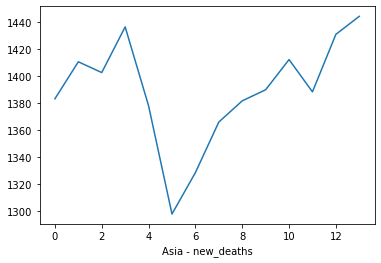

Input: [1437. 1663. 1458. 1579. 1226. 1225. 1254.], Predicted: 1401.360
Input: [1663.   1458.   1579.   1226.   1225.   1254.   1401.36], Predicted: 1372.700
Input: [1458.   1579.   1226.   1225.   1254.   1401.36 1372.7 ], Predicted: 1460.820
Input: [1579.   1226.   1225.   1254.   1401.36 1372.7  1460.82], Predicted: 1494.100
Input: [1226.   1225.   1254.   1401.36 1372.7  1460.82 1494.1 ], Predicted: 1510.100
Input: [1225.   1254.   1401.36 1372.7  1460.82 1494.1  1510.1 ], Predicted: 1487.900
Input: [1254.   1401.36 1372.7  1460.82 1494.1  1510.1  1487.9 ], Predicted: 1577.830
Input: [1401.36 1372.7  1460.82 1494.1  1510.1  1487.9  1577.83], Predicted: 1491.680
Input: [1372.7  1460.82 1494.1  1510.1  1487.9  1577.83 1491.68], Predicted: 1523.220
Input: [1460.82 1494.1  1510.1  1487.9  1577.83 1491.68 1523.22], Predicted: 1512.590
Input: [1494.1  1510.1  1487.9  1577.83 1491.68 1523.22 1512.59], Predicted: 1533.900
Input: [1510.1  1487.9  1577.83 1491.68 1523.22 1512.59 1533.9 ], Pr

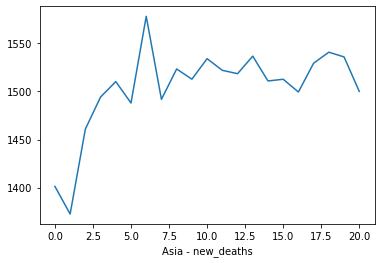

Input: [1437. 1663. 1458. 1579. 1226. 1225. 1254.], Predicted: 1385.100
Input: [1663.  1458.  1579.  1226.  1225.  1254.  1385.1], Predicted: 1362.030
Input: [1458.   1579.   1226.   1225.   1254.   1385.1  1362.03], Predicted: 1471.300
Input: [1579.   1226.   1225.   1254.   1385.1  1362.03 1471.3 ], Predicted: 1498.330
Input: [1226.   1225.   1254.   1385.1  1362.03 1471.3  1498.33], Predicted: 1461.710
Input: [1225.   1254.   1385.1  1362.03 1471.3  1498.33 1461.71], Predicted: 1437.210
Input: [1254.   1385.1  1362.03 1471.3  1498.33 1461.71 1437.21], Predicted: 1401.530
Input: [1385.1  1362.03 1471.3  1498.33 1461.71 1437.21 1401.53], Predicted: 1408.520
Input: [1362.03 1471.3  1498.33 1461.71 1437.21 1401.53 1408.52], Predicted: 1403.240
Input: [1471.3  1498.33 1461.71 1437.21 1401.53 1408.52 1403.24], Predicted: 1437.460
Input: [1498.33 1461.71 1437.21 1401.53 1408.52 1403.24 1437.46], Predicted: 1440.930
Input: [1461.71 1437.21 1401.53 1408.52 1403.24 1437.46 1440.93], Predicted

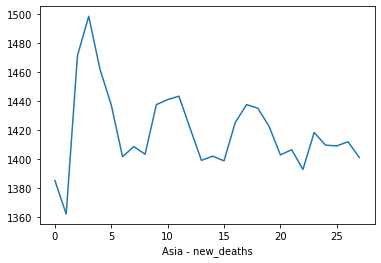

Input: [1437. 1663. 1458. 1579. 1226. 1225. 1254.], Predicted: 1382.670
Input: [1663.   1458.   1579.   1226.   1225.   1254.   1382.67], Predicted: 1389.080
Input: [1458.   1579.   1226.   1225.   1254.   1382.67 1389.08], Predicted: 1377.320
Input: [1579.   1226.   1225.   1254.   1382.67 1389.08 1377.32], Predicted: 1415.550
Input: [1226.   1225.   1254.   1382.67 1389.08 1377.32 1415.55], Predicted: 1343.460
Input: [1225.   1254.   1382.67 1389.08 1377.32 1415.55 1343.46], Predicted: 1357.460
Input: [1254.   1382.67 1389.08 1377.32 1415.55 1343.46 1357.46], Predicted: 1393.960
Input: [1382.67 1389.08 1377.32 1415.55 1343.46 1357.46 1393.96], Predicted: 1369.320
Input: [1389.08 1377.32 1415.55 1343.46 1357.46 1393.96 1369.32], Predicted: 1430.110
Input: [1377.32 1415.55 1343.46 1357.46 1393.96 1369.32 1430.11], Predicted: 1424.480
Input: [1415.55 1343.46 1357.46 1393.96 1369.32 1430.11 1424.48], Predicted: 1429.190
Input: [1343.46 1357.46 1393.96 1369.32 1430.11 1424.48 1429.19], Pr

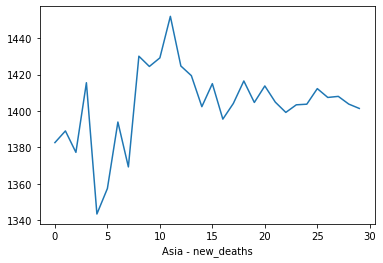

In [47]:
days = [7,14,21,28,30]
continents = {'Africa', 'Asia', 'Europe', 'North America', 'Oceania', 'South America'}
for continent in continents:
    for target in ['total_cases','total_deaths','total_vaccinations','people_fully_vaccinated','new_cases','new_deaths']:
        for day in days:
            future_randomforrest(continent, target, day)

In [ ]:
def future_decisiontree(country,target,day):
    forecasts=[]
    train_df = df[df.location==country].copy()
    train_df = train_df[[target]]
    # load the dataset
    values = train_df.values
    # transform the time series data into supervised learning
    train = series_to_supervised(values, n_in=7)
    # split into input and output columns
    trainX, trainy = train[:, :-1], train[:, -1]
    # fit model
    model = DecisionTreeRegressor()
    model.fit(trainX, trainy)

    for i in range(day):
        # construct an input for a new prediction
        row = values[-7:].flatten()
        # make a one-step prediction
        yhat = model.predict(asarray([row]))
        forecasts.append(yhat.tolist()[0])
        values= np.append(values,yhat)
        print('Input: %s, Predicted: %.3f' % (row, yhat))
    print(forecasts)
    plt.plot(forecasts)
    plt.xlabel(f'{country} - {target}')
    plt.show()

In [ ]:
days = [7,14,21,28,30]
for country in set(required_countries):
    for target in ['total_cases','total_deaths','total_vaccinations','people_fully_vaccinated','new_cases','new_deaths']:
        for day in days:
            future_decisiontree(country, target, day)

In [ ]:
days = [7,14,21,28,30]
continents = {'Africa', 'Asia', 'Europe', 'North America', 'Oceania', 'South America'}
for continent in continents:
    for target in ['total_cases','total_deaths','total_vaccinations','people_fully_vaccinated','new_cases','new_deaths']:
        for day in days:
            future_decisiontree(continent, target, day)

In [24]:
import numpy as np
import math
from keras.models import Sequential
from keras.layers import Dense
from keras.layers import LSTM, Flatten, Dropout, Activation
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error
from keras.layers import ConvLSTM2D

from keras.preprocessing.sequence import TimeseriesGenerator

In [55]:
def lstm_forecast(country, target, day):

    #Total COVID confirmed cases
    df_confirmed = df.copy()
    df_confirmed_country = df_confirmed[df_confirmed["location"] == country]
    df_confirmed_country = df_confirmed_country[['date',target]]
    df_confirmed_country.index = pd.to_datetime(df_confirmed_country.date, format='%Y/%m/%d')
    df_confirmed_country.drop('date',axis=1,inplace=True)

    # df_confirmed_country.plot(figsize=(10,5),title=f"COVID {country} {target}")
#     print(df_confirmed_country.tail())

#     print("Total days in the dataset", len(df_confirmed_country))

    #Use data until 14 days before as training
    x = len(df_confirmed_country)-100

    train= df_confirmed_country.iloc[:x]
    test = df_confirmed_country.iloc[x:]

    # ##scale or normalize data as the data is too skewed
    scaler = MinMaxScaler()
    scaler.fit(train) 

    train_scaled = scaler.transform(train)
    test_scaled = scaler.transform(test)

    ## Use TimeSeriestrain_generator to generate data in sequences.
    #Alternatively we can create our own sequences. 



    # #Sequence size has an impact on prediction, especially since COVID is unpredictable!

    seq_size = 7  ## number of steps (lookback)
    n_features = 1 ## number of features. This dataset is univariate so it is 1
    train_generator = TimeseriesGenerator(train_scaled, train_scaled, length = seq_size, batch_size=1)
    print("Total number of samples in the original training data = ", len(train)) # 271
    print("Total number of samples in the generated data = ", len(train_generator)) # 264 with seq_size=7

    #Check data shape from generator
    x,y = train_generator[10]  #Check train_generator
    #Takes 7 days as x and 8th day as y (for seq_size=7)

    #Also generate test data
    test_generator = TimeseriesGenerator(test_scaled, test_scaled, length=seq_size, batch_size=1)
    print("Total number of samples in the original training data = ", len(test)) # 14 as we're using last 14 days for test
    print("Total number of samples in the generated data = ", len(test_generator)) # 7
    #Check data shape from generator
    x,y = test_generator[0]



    #Define Model 
    model = Sequential()
    model.add(LSTM(150, activation='relu', return_sequences=True, input_shape=(seq_size, n_features)))
    model.add(LSTM(64, activation='relu'))
    model.add(Dense(64))
    model.add(Dense(1))
    model.compile(optimizer='adam', loss='mean_squared_error')

    model.summary()
    print('Train...')
    ##########################

    history = model.fit_generator(train_generator, 
                                  validation_data=test_generator, 
                                  epochs=50, steps_per_epoch=10)


    #plot the training and validation accuracy and loss at each epoch
    loss = history.history['loss']
    val_loss = history.history['val_loss']
    epochs = range(1, len(loss) + 1)
    plt.plot(epochs, loss, 'y', label='Training loss')
    plt.plot(epochs, val_loss, 'r', label='Validation loss')
    plt.title('Training and validation loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
    plt.show()


    #forecast
    prediction = [] #Empty list to populate later with predictions

    current_batch = train_scaled[-seq_size:] #Final data points in train 
    current_batch = current_batch.reshape(1, seq_size, n_features) #Reshape

    ## Predict future, beyond test dates
    future = day #Days
    for i in range(len(test) + future):
        current_pred = model.predict(current_batch)[0]
        prediction.append(current_pred)
        current_batch = np.append(current_batch[:,1:,:],[[current_pred]],axis=1)

    ### Inverse transform to before scaling so we get actual numbers
    rescaled_prediction = scaler.inverse_transform(prediction)

    time_series_array = test.index  #Get dates for test data

    #Add new dates for the forecast period
    for k in range(0, future):
        time_series_array = time_series_array.append(time_series_array[-1:] + pd.DateOffset(1))

    #Create a dataframe to capture the forecast data
    df_forecast = pd.DataFrame(columns=[f"actual_{target}","predicted"], index=time_series_array)

    df_forecast.loc[:,"predicted"] = rescaled_prediction[:,0]
    df_forecast.loc[:,f"actual_{target}"] = test[target]

    #Plot
    df_forecast.plot(title=f"Predictions for next {day} days")
    plt.show()
 
    
    




Total number of samples in the original training data =  548
Total number of samples in the generated data =  541
Total number of samples in the original training data =  100
Total number of samples in the generated data =  93
Model: "sequential_6"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_12 (LSTM)               (None, 7, 150)            91200     
_________________________________________________________________
lstm_13 (LSTM)               (None, 64)                55040     
_________________________________________________________________
dense_12 (Dense)             (None, 64)                4160      
_________________________________________________________________
dense_13 (Dense)             (None, 1)                 65        
Total params: 150,465
Trainable params: 150,465
Non-trainable params: 0
_________________________________________________________________
Train...
Epoch 1/50

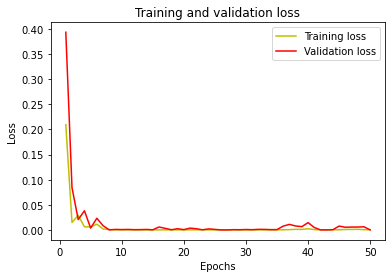

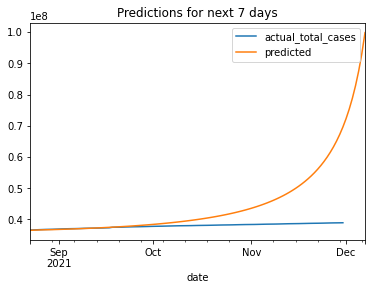

Total number of samples in the original training data =  548
Total number of samples in the generated data =  541
Total number of samples in the original training data =  100
Total number of samples in the generated data =  93
Model: "sequential_7"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_14 (LSTM)               (None, 7, 150)            91200     
_________________________________________________________________
lstm_15 (LSTM)               (None, 64)                55040     
_________________________________________________________________
dense_14 (Dense)             (None, 64)                4160      
_________________________________________________________________
dense_15 (Dense)             (None, 1)                 65        
Total params: 150,465
Trainable params: 150,465
Non-trainable params: 0
_________________________________________________________________
Train...
Epoch 1/50

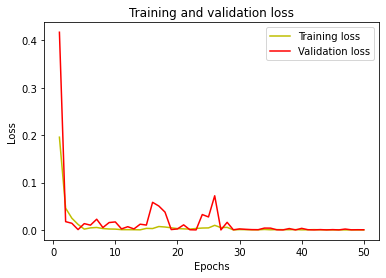

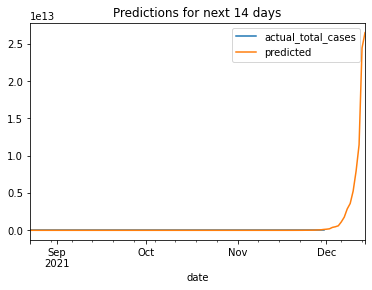

Total number of samples in the original training data =  548
Total number of samples in the generated data =  541
Total number of samples in the original training data =  100
Total number of samples in the generated data =  93
Model: "sequential_8"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_16 (LSTM)               (None, 7, 150)            91200     
_________________________________________________________________
lstm_17 (LSTM)               (None, 64)                55040     
_________________________________________________________________
dense_16 (Dense)             (None, 64)                4160      
_________________________________________________________________
dense_17 (Dense)             (None, 1)                 65        
Total params: 150,465
Trainable params: 150,465
Non-trainable params: 0
_________________________________________________________________
Train...
Epoch 1/50

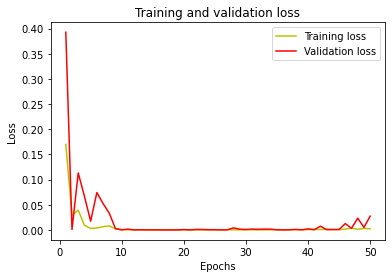

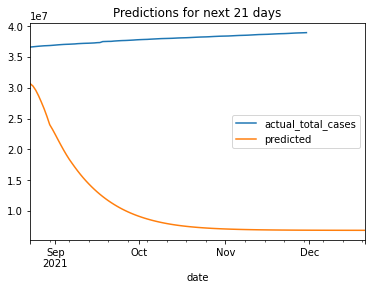

Total number of samples in the original training data =  548
Total number of samples in the generated data =  541
Total number of samples in the original training data =  100
Total number of samples in the generated data =  93
Model: "sequential_9"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_18 (LSTM)               (None, 7, 150)            91200     
_________________________________________________________________
lstm_19 (LSTM)               (None, 64)                55040     
_________________________________________________________________
dense_18 (Dense)             (None, 64)                4160      
_________________________________________________________________
dense_19 (Dense)             (None, 1)                 65        
Total params: 150,465
Trainable params: 150,465
Non-trainable params: 0
_________________________________________________________________
Train...
Epoch 1/50

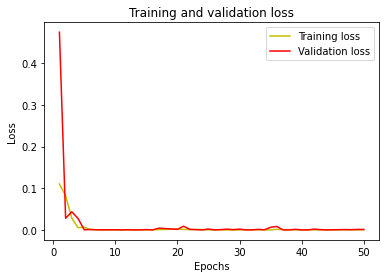

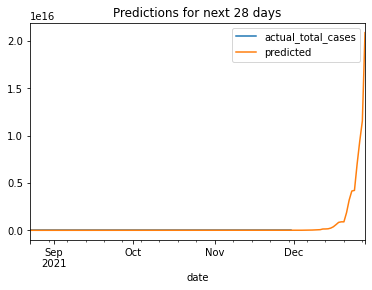

Total number of samples in the original training data =  548
Total number of samples in the generated data =  541
Total number of samples in the original training data =  100
Total number of samples in the generated data =  93
Model: "sequential_10"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_20 (LSTM)               (None, 7, 150)            91200     
_________________________________________________________________
lstm_21 (LSTM)               (None, 64)                55040     
_________________________________________________________________
dense_20 (Dense)             (None, 64)                4160      
_________________________________________________________________
dense_21 (Dense)             (None, 1)                 65        
Total params: 150,465
Trainable params: 150,465
Non-trainable params: 0
_________________________________________________________________
Train...
Epoch 1/5

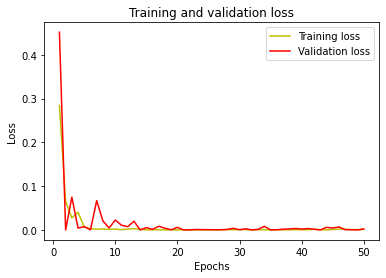

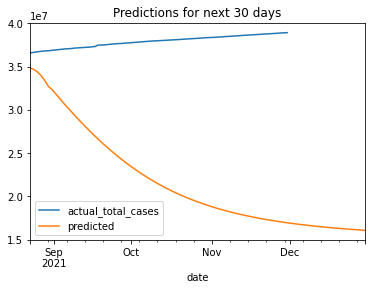

Total number of samples in the original training data =  548
Total number of samples in the generated data =  541
Total number of samples in the original training data =  100
Total number of samples in the generated data =  93
Model: "sequential_11"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_22 (LSTM)               (None, 7, 150)            91200     
_________________________________________________________________
lstm_23 (LSTM)               (None, 64)                55040     
_________________________________________________________________
dense_22 (Dense)             (None, 64)                4160      
_________________________________________________________________
dense_23 (Dense)             (None, 1)                 65        
Total params: 150,465
Trainable params: 150,465
Non-trainable params: 0
_________________________________________________________________
Train...
Epoch 1/5

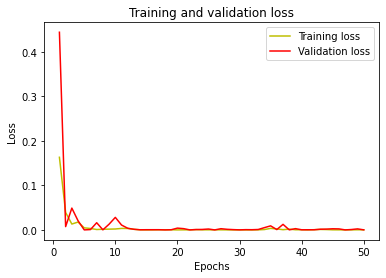

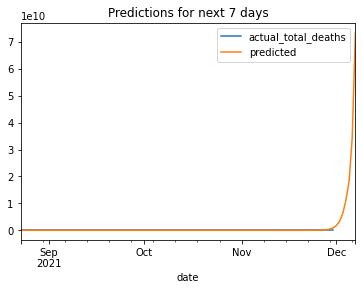

Total number of samples in the original training data =  548
Total number of samples in the generated data =  541
Total number of samples in the original training data =  100
Total number of samples in the generated data =  93
Model: "sequential_12"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_24 (LSTM)               (None, 7, 150)            91200     
_________________________________________________________________
lstm_25 (LSTM)               (None, 64)                55040     
_________________________________________________________________
dense_24 (Dense)             (None, 64)                4160      
_________________________________________________________________
dense_25 (Dense)             (None, 1)                 65        
Total params: 150,465
Trainable params: 150,465
Non-trainable params: 0
_________________________________________________________________
Train...
Epoch 1/5

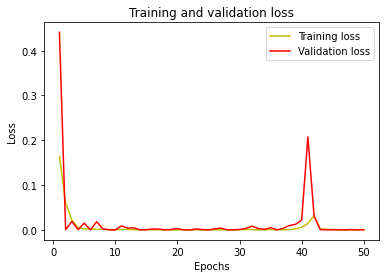

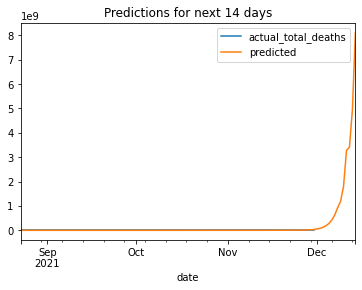

Total number of samples in the original training data =  548
Total number of samples in the generated data =  541
Total number of samples in the original training data =  100
Total number of samples in the generated data =  93
Model: "sequential_13"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_26 (LSTM)               (None, 7, 150)            91200     
_________________________________________________________________
lstm_27 (LSTM)               (None, 64)                55040     
_________________________________________________________________
dense_26 (Dense)             (None, 64)                4160      
_________________________________________________________________
dense_27 (Dense)             (None, 1)                 65        
Total params: 150,465
Trainable params: 150,465
Non-trainable params: 0
_________________________________________________________________
Train...
Epoch 1/5

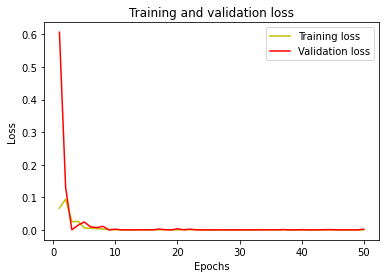

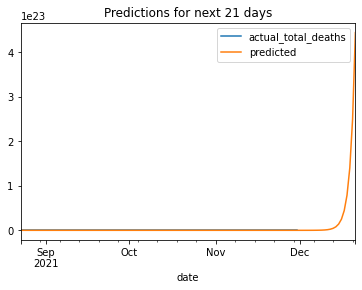

Total number of samples in the original training data =  548
Total number of samples in the generated data =  541
Total number of samples in the original training data =  100
Total number of samples in the generated data =  93
Model: "sequential_14"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_28 (LSTM)               (None, 7, 150)            91200     
_________________________________________________________________
lstm_29 (LSTM)               (None, 64)                55040     
_________________________________________________________________
dense_28 (Dense)             (None, 64)                4160      
_________________________________________________________________
dense_29 (Dense)             (None, 1)                 65        
Total params: 150,465
Trainable params: 150,465
Non-trainable params: 0
_________________________________________________________________
Train...
Epoch 1/5

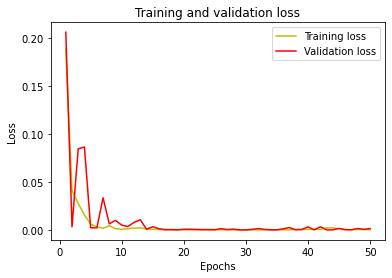

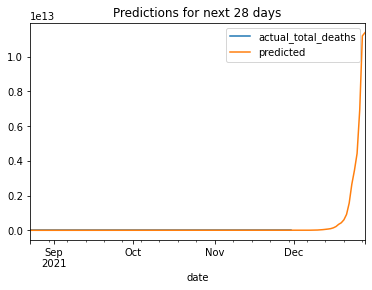

Total number of samples in the original training data =  548
Total number of samples in the generated data =  541
Total number of samples in the original training data =  100
Total number of samples in the generated data =  93
Model: "sequential_15"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_30 (LSTM)               (None, 7, 150)            91200     
_________________________________________________________________
lstm_31 (LSTM)               (None, 64)                55040     
_________________________________________________________________
dense_30 (Dense)             (None, 64)                4160      
_________________________________________________________________
dense_31 (Dense)             (None, 1)                 65        
Total params: 150,465
Trainable params: 150,465
Non-trainable params: 0
_________________________________________________________________
Train...
Epoch 1/5

In [ ]:
days = [7,14,21,28,30]
continents = {'Africa', 'Asia', 'Europe', 'North America', 'Oceania', 'South America'}
for continent in continents:
    for target in ['total_cases','total_deaths','total_vaccinations','people_fully_vaccinated','new_cases','new_deaths']:
        for day in days:
            lstm_forecast(continent, target, day)